In [1]:
import torch
from torch.utils.data import DataLoader
from datetime import datetime
from actor import PtrNet1
from critic import PtrNet2
from config import Config
from data import Generator
from env_v2 import Env_tsp
import torch.nn as nn
from time import time

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim

class AE(nn.Module):
    def __init__(self, **kwargs):
        super().__init__()
        self.encoder_hidden_layer = nn.Linear(
            in_features=kwargs["input_shape"], out_features=32
        )
        self.encoder_output_layer = nn.Linear(
            in_features=32, out_features=32
        )
        self.decoder_hidden_layer = nn.Linear(
            in_features=32, out_features=32
        )
        self.decoder_output_layer = nn.Linear(
            in_features=32, out_features=kwargs["input_shape"]
        )
        
    def encode(self, x):
        activation = self.encoder_hidden_layer(x)
        activation = torch.relu(activation)
        code = self.encoder_output_layer(activation)
        code = torch.relu(code)
        return code
    
    def decode(self, code):
        activation = self.decoder_hidden_layer(code)
        activation = torch.relu(activation)
        activation = self.decoder_output_layer(activation)
        reconstructed = torch.relu(activation)
        return reconstructed

    def forward(self, features):
        tmp = self.encode(features)
        reconstructed = self.decode(tmp)
        return reconstructed

In [3]:
!jupyter kernelspec list



Available kernels:
  ir                 /opt/anaconda3/envs/bigdatalab_cpu_202101/share/jupyter/kernels/ir
  octave             /opt/anaconda3/envs/bigdatalab_cpu_202101/share/jupyter/kernels/octave
  python3            /opt/anaconda3/envs/bigdatalab_cpu_202101/share/jupyter/kernels/python3
  graphframe_yarn    /usr/local/share/jupyter/kernels/graphframe_yarn
  pyspark_local      /usr/local/share/jupyter/kernels/pyspark_local
  pyspark_yarn       /usr/local/share/jupyter/kernels/pyspark_yarn


In [5]:
cfg = Config()
env = Env_tsp(cfg)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model = AE(input_shape=2).to(device)

model.load_state_dict(torch.load("model/vanilla_20_nodes.pt"))
model.eval()

batch = env.get_batch_nodes(10)
print(batch.shape)



cpu
torch.Size([10, 20, 2])


In [6]:
def generate_encoding(batch):
    res = []
    for graph in batch:
        emb = model.encode(graph)
        res.append(emb)
        
    res_tens = torch.stack(res)
    return res_tens

def generate_embeddings(batch):
    
    res = []
    
    for graph in batch:
        g = dgl.graph((l1,l2), num_nodes=10)
        g.ndata['h'] = graph
        tmp_edges = []
        for i in range(n_nodes*(n_nodes-1)):
                n1 = l1[i]
                n2 = l2[i]
                x1 = torch.FloatTensor( [graph[n1][0]])
                x2 = torch.FloatTensor([graph[n2][0]])
                y1 = torch.FloatTensor([graph[n1][1]])
                y2 = torch.FloatTensor([graph[n2][1]])
                dist = torch.sqrt( torch.pow(x2-x1,2) + torch.pow(y2 - y1, 2) )
                tmp_edges.append(dist)
            
        edges_tens = torch.FloatTensor(tmp_edges)
        g.edata['a'] = edges_tens
        z = gae(g)
        res.append(z)
        
    res_tens = torch.stack(res)
    return res_tens
        



In [7]:
torch.backends.cudnn.benchmark = True

def train_model(cfg, env, log_path = None):
    try:    
        date = datetime.now().strftime('%m%d_%H_%M')

        torch.no_grad()
        act_model = PtrNet1(cfg)



        if cfg.optim == 'Adam':
            act_optim = torch.optim.Adam(act_model.parameters(), lr = 0.002)
        if cfg.is_lr_decay:
            act_lr_scheduler = torch.optim.lr_scheduler.StepLR(act_optim, 
                            step_size=cfg.lr_decay_step, gamma=cfg.lr_decay)
        device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        act_model = act_model.to(device)

        if cfg.mode == 'train':
            cri_model = PtrNet2(cfg)
            if cfg.optim == 'Adam':
                cri_optim = torch.optim.Adam(cri_model.parameters(), lr = 0.002)
            if cfg.is_lr_decay:
                cri_lr_scheduler = torch.optim.lr_scheduler.StepLR(cri_optim, 
                            step_size = cfg.lr_decay_step, gamma = cfg.lr_decay)
            cri_model = cri_model.to(device)
            ave_cri_loss = 0.

        mse_loss = nn.MSELoss()
        dataset = Generator(cfg, env)
        dataloader = DataLoader(dataset, batch_size = cfg.batch, shuffle = True)

        ave_act_loss, ave_L = 0., 0.
        min_L, cnt = 1e7, 0
        t1 = time()
        # for i, inputs in tqdm(enumerate(dataloader)):
        #for i, inputs in enumerate(dataloader):
        for i, inputs in enumerate(dataloader):
            inputs = inputs.to(device)
            #now instead of the inputs (a batch of node coordinates), give extract the embedding from the nodes
            embed = generate_encoding(inputs)  
            pred_tour, ll = act_model(embed, device)
            real_l = env.stack_l_fast(inputs, pred_tour)

            if cfg.mode == 'train':
                embed = generate_encoding(inputs)  
                pred_l = cri_model(embed, device)
                cri_loss = mse_loss(pred_l, real_l.detach())
                cri_optim.zero_grad()
                cri_loss.backward(retain_graph=True)
                nn.utils.clip_grad_norm_(cri_model.parameters(), max_norm = 1., norm_type = 2)
                cri_optim.step()
                if cfg.is_lr_decay:
                    cri_lr_scheduler.step()

            adv = real_l.detach() - pred_l.detach()
            act_loss = (adv * ll).mean()
            act_optim.zero_grad()
            act_loss.backward( )
            nn.utils.clip_grad_norm_(act_model.parameters(), max_norm = 1., norm_type = 2)
            act_optim.step()
            if cfg.is_lr_decay:
                act_lr_scheduler.step()

            ave_act_loss += act_loss.item()
            if cfg.mode == 'train':
                ave_cri_loss += cri_loss.item()
            ave_L += real_l.mean().item()

            if i % 5 == 0:
                env.show(inputs[0], pred_tour[0])
                #print(pred_tour[''])

            if i % cfg.log_step == 0:
                t2 = time()
                if cfg.mode == 'train':	
                    print('step:%d/%d, actic loss:%1.3f, critic loss:%1.3f, L:%1.3f, %dmin%dsec'%(i, cfg.steps, ave_act_loss/(i+1), ave_cri_loss/(i+1), ave_L/(i+1), (t2-t1)//60, (t2-t1)%60))
                    if cfg.islogger:
                        if log_path is None:
                            log_path = cfg.log_dir + '%s_%s_train.csv'%(date, cfg.task)#cfg.log_dir = ./Csv/
                            with open(log_path, 'w') as f:
                                f.write('step,actic loss,critic loss,average distance,time\n')
                        else:
                            with open(log_path, 'a') as f:
                                f.write('%d,%1.4f,%1.4f,%1.4f,%dmin%dsec\n'%(i, ave_act_loss/(i+1), ave_cri_loss/(i+1), ave_L/(i+1), (t2-t1)//60, (t2-t1)%60))


                if(ave_L/(i+1) < min_L):
                    min_L = ave_L/(i+1)
                if(ave_L/(i+1) < 3.6):
                    torch.save(act_model.state_dict(), cfg.model_dir + '%s_%s_step%d_act.pt'%(cfg.task, date, i))#'cfg.model_dir = ./Pt/'

                # else:
                # 	cnt += 1
                # 	print(f'cnt: {cnt}/20')
                # 	if(cnt >= 20):
                # 		print('early stop, average cost cant decrease anymore')
                # 		if log_path is not None:
                # 			with open(log_path, 'a') as f:
                # 				f.write('\nearly stop')
                # 		break
                t1 = time()
        if cfg.issaver:		
            torch.save(act_model.state_dict(), cfg.model_dir + '%s_%s_step%d_act.pt'%(cfg.task, date, i))#'cfg.model_dir = ./Pt/'
            print('save model...')
    except KeyboardInterrupt:
        torch.save(act_model.state_dict(), cfg.model_dir + '%s_%s_step%d_act.pt'%(cfg.task, date, i))#'cfg.model_dir = ./Pt/'
        

distance:9.574
tensor([ 1, 18,  0, 10,  4,  5, 19,  7, 16,  3,  2, 13, 11,  8, 12,  6, 14, 17,
         9, 15])


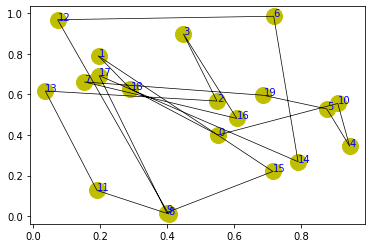

step:0/5000, actic loss:-435.121, critic loss:107.595, L:10.324, 0min7sec
step:1/5000, actic loss:-402.300, critic loss:105.286, L:10.387, 0min5sec
step:2/5000, actic loss:-382.001, critic loss:97.794, L:10.363, 0min4sec
step:3/5000, actic loss:-341.630, critic loss:83.456, L:10.359, 0min5sec
step:4/5000, actic loss:-273.130, critic loss:67.005, L:10.336, 0min2sec
distance:7.781
tensor([ 8,  2,  4,  1, 13, 17,  7, 16,  0, 18, 11, 10, 19, 14, 15,  9,  6, 12,
         5,  3])


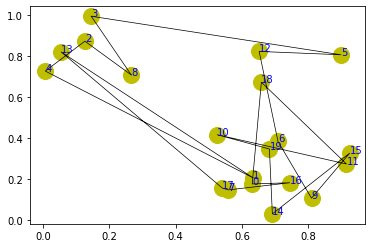

step:5/5000, actic loss:-212.334, critic loss:56.920, L:10.317, 0min3sec
step:6/5000, actic loss:-170.769, critic loss:49.570, L:10.293, 0min3sec
step:7/5000, actic loss:-147.511, critic loss:43.574, L:10.250, 0min2sec
step:8/5000, actic loss:-137.249, critic loss:39.140, L:10.184, 0min2sec
step:9/5000, actic loss:-130.265, critic loss:35.796, L:10.139, 0min0sec
distance:9.766
tensor([16,  5,  8, 17, 13, 18, 10,  4,  6,  7, 19, 14, 12,  9, 11, 15,  3,  2,
         0,  1])


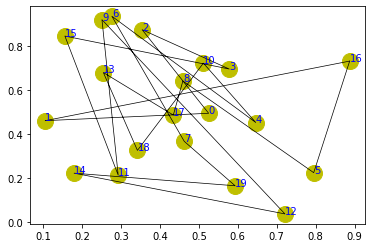

step:10/5000, actic loss:-122.674, critic loss:32.880, L:10.104, 0min0sec
step:11/5000, actic loss:-112.990, critic loss:30.266, L:10.056, 0min0sec
step:12/5000, actic loss:-100.695, critic loss:28.351, L:9.995, 0min1sec
step:13/5000, actic loss:-88.637, critic loss:27.108, L:9.932, 0min0sec
step:14/5000, actic loss:-78.331, critic loss:26.135, L:9.866, 0min0sec
distance:9.457
tensor([19, 17,  4,  3, 11,  7, 13,  6, 12,  2,  5, 16,  8, 15, 14,  0, 10,  9,
        18,  1])


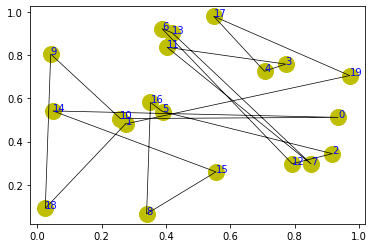

step:15/5000, actic loss:-69.961, critic loss:25.132, L:9.784, 0min1sec
step:16/5000, actic loss:-63.666, critic loss:23.994, L:9.689, 0min0sec
step:17/5000, actic loss:-59.470, critic loss:22.766, L:9.593, 0min1sec
step:18/5000, actic loss:-56.892, critic loss:21.660, L:9.491, 0min1sec
step:19/5000, actic loss:-55.102, critic loss:20.747, L:9.398, 0min0sec
distance:7.894
tensor([13, 15,  4, 11, 19, 14, 12,  0,  1,  6, 17, 18,  7,  8, 16, 10,  2,  5,
         3,  9])


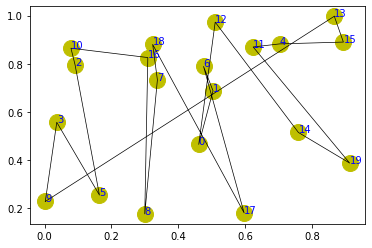

step:20/5000, actic loss:-53.597, critic loss:19.973, L:9.318, 0min1sec
step:21/5000, actic loss:-52.011, critic loss:19.240, L:9.249, 0min0sec
step:22/5000, actic loss:-50.194, critic loss:18.501, L:9.179, 0min0sec
step:23/5000, actic loss:-48.015, critic loss:17.782, L:9.109, 0min0sec
step:24/5000, actic loss:-45.911, critic loss:17.134, L:9.051, 0min0sec
distance:7.050
tensor([19,  2, 13,  4,  0, 15, 12, 16,  9,  5, 11,  7, 17,  8,  3, 18, 10,  1,
        14,  6])


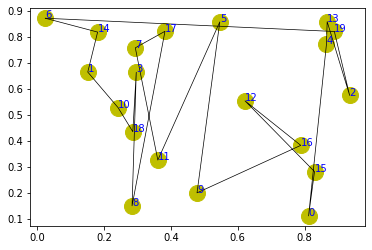

step:25/5000, actic loss:-43.965, critic loss:16.536, L:8.995, 0min1sec
step:26/5000, actic loss:-42.284, critic loss:15.963, L:8.943, 0min0sec
step:27/5000, actic loss:-40.869, critic loss:15.434, L:8.889, 0min0sec
step:28/5000, actic loss:-39.629, critic loss:14.953, L:8.839, 0min0sec
step:29/5000, actic loss:-38.401, critic loss:14.494, L:8.792, 0min0sec
distance:7.223
tensor([ 6, 15, 14, 10, 18,  3,  0,  7, 16, 11, 12,  2,  9,  1, 19,  5,  4, 13,
         8, 17])


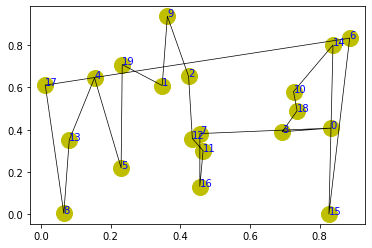

step:30/5000, actic loss:-37.240, critic loss:14.067, L:8.760, 0min1sec
step:31/5000, actic loss:-36.062, critic loss:13.665, L:8.744, 0min0sec
step:32/5000, actic loss:-34.704, critic loss:13.327, L:8.729, 0min0sec
step:33/5000, actic loss:-33.215, critic loss:13.085, L:8.708, 0min0sec
step:34/5000, actic loss:-31.805, critic loss:12.862, L:8.694, 0min1sec
distance:8.169
tensor([19, 18, 14, 16, 11,  7,  6, 12,  9, 15, 13, 17, 10,  3,  5,  8,  4,  0,
         2,  1])


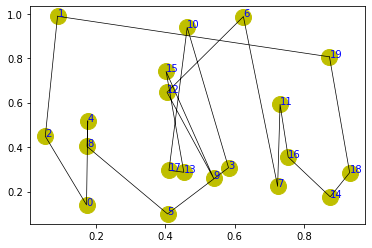

step:35/5000, actic loss:-30.487, critic loss:12.648, L:8.672, 0min1sec
step:36/5000, actic loss:-29.350, critic loss:12.407, L:8.649, 0min0sec
step:37/5000, actic loss:-28.402, critic loss:12.131, L:8.622, 0min0sec
step:38/5000, actic loss:-27.677, critic loss:11.852, L:8.595, 0min1sec
step:39/5000, actic loss:-27.056, critic loss:11.591, L:8.566, 0min0sec
distance:8.345
tensor([ 6, 16,  1,  5,  2,  0, 15, 10, 18, 17, 11, 13,  8, 14,  3,  9,  7, 12,
        19,  4])


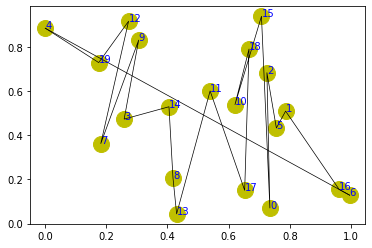

step:40/5000, actic loss:-26.518, critic loss:11.349, L:8.541, 0min1sec
step:41/5000, actic loss:-25.950, critic loss:11.107, L:8.514, 0min1sec
step:42/5000, actic loss:-25.362, critic loss:10.875, L:8.491, 0min0sec
step:43/5000, actic loss:-24.718, critic loss:10.656, L:8.469, 0min0sec
step:44/5000, actic loss:-24.076, critic loss:10.459, L:8.450, 0min0sec
distance:7.351
tensor([ 0,  4, 10, 19, 15, 12,  7, 11,  6,  3,  2, 14, 17,  9, 13, 18,  5,  1,
        16,  8])


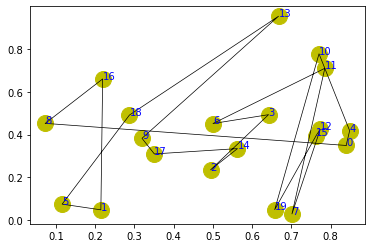

step:45/5000, actic loss:-23.509, critic loss:10.259, L:8.441, 0min1sec
step:46/5000, actic loss:-23.021, critic loss:10.064, L:8.435, 0min0sec
step:47/5000, actic loss:-22.543, critic loss:9.885, L:8.428, 0min1sec
step:48/5000, actic loss:-22.085, critic loss:9.710, L:8.425, 0min0sec
step:49/5000, actic loss:-21.648, critic loss:9.537, L:8.421, 0min0sec
distance:7.925
tensor([14, 10,  6, 12,  8, 17,  4,  0,  1, 16,  2, 15, 18,  5,  7, 19,  3,  9,
        11, 13])


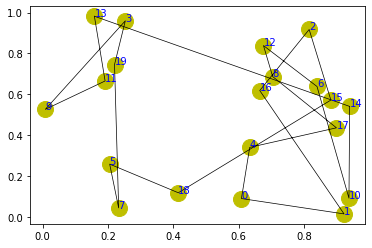

step:50/5000, actic loss:-21.271, critic loss:9.372, L:8.419, 0min1sec
step:51/5000, actic loss:-20.869, critic loss:9.209, L:8.414, 0min0sec
step:52/5000, actic loss:-20.427, critic loss:9.061, L:8.409, 0min0sec
step:53/5000, actic loss:-19.980, critic loss:8.929, L:8.400, 0min1sec
step:54/5000, actic loss:-19.566, critic loss:8.789, L:8.388, 0min1sec
distance:8.969
tensor([ 6,  0, 10,  8, 19, 12,  2, 13, 14, 18,  7, 15,  3,  9, 11, 16, 17,  1,
         4,  5])


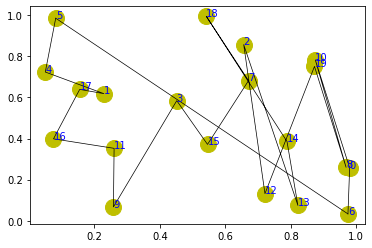

step:55/5000, actic loss:-19.199, critic loss:8.655, L:8.374, 0min1sec
step:56/5000, actic loss:-18.912, critic loss:8.525, L:8.359, 0min1sec
step:57/5000, actic loss:-18.671, critic loss:8.410, L:8.345, 0min1sec
step:58/5000, actic loss:-18.450, critic loss:8.303, L:8.331, 0min1sec
step:59/5000, actic loss:-18.208, critic loss:8.195, L:8.319, 0min0sec
distance:6.288
tensor([19,  3,  4, 12,  8, 15, 16,  5,  1,  9,  2,  6, 13, 14, 17, 18, 11,  0,
        10,  7])


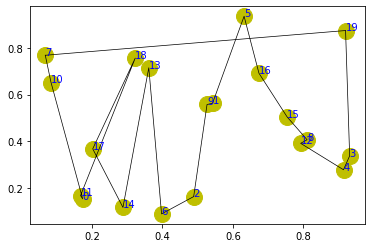

step:60/5000, actic loss:-17.894, critic loss:8.078, L:8.302, 0min1sec
step:61/5000, actic loss:-17.597, critic loss:7.968, L:8.288, 0min1sec
step:62/5000, actic loss:-17.325, critic loss:7.860, L:8.275, 0min1sec
step:63/5000, actic loss:-17.019, critic loss:7.755, L:8.259, 0min0sec
step:64/5000, actic loss:-16.763, critic loss:7.653, L:8.249, 0min0sec
distance:7.228
tensor([17,  9,  6, 12, 15,  1,  4, 18,  0, 13,  7,  5,  2, 10,  3, 19,  8, 16,
        14, 11])


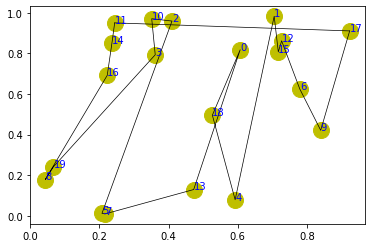

step:65/5000, actic loss:-16.473, critic loss:7.554, L:8.234, 0min1sec
step:66/5000, actic loss:-16.239, critic loss:7.461, L:8.224, 0min1sec
step:67/5000, actic loss:-15.977, critic loss:7.374, L:8.210, 0min0sec
step:68/5000, actic loss:-15.734, critic loss:7.283, L:8.198, 0min1sec
step:69/5000, actic loss:-15.533, critic loss:7.196, L:8.187, 0min0sec
distance:5.498
tensor([ 6, 16,  9,  7, 18,  4,  8,  3,  0, 13, 14, 17, 19,  5, 11,  2,  1, 15,
        10, 12])


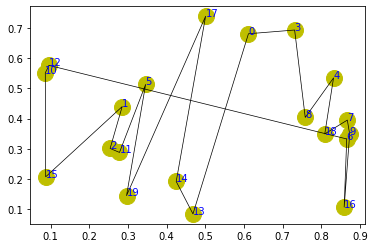

step:70/5000, actic loss:-15.334, critic loss:7.112, L:8.176, 0min1sec
step:71/5000, actic loss:-15.145, critic loss:7.030, L:8.167, 0min0sec
step:72/5000, actic loss:-14.915, critic loss:6.951, L:8.157, 0min1sec
step:73/5000, actic loss:-14.692, critic loss:6.874, L:8.148, 0min1sec
step:74/5000, actic loss:-14.481, critic loss:6.799, L:8.140, 0min1sec
distance:8.322
tensor([ 5, 13, 19,  9, 16,  3, 17, 18,  7,  6,  8,  4, 15, 14, 10,  0,  1, 12,
        11,  2])


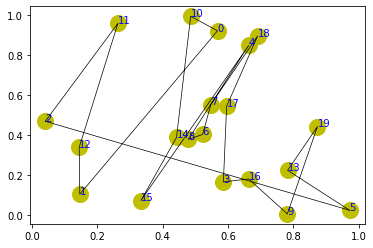

step:75/5000, actic loss:-14.302, critic loss:6.722, L:8.131, 0min1sec
step:76/5000, actic loss:-14.135, critic loss:6.651, L:8.123, 0min1sec
step:77/5000, actic loss:-13.972, critic loss:6.581, L:8.118, 0min1sec
step:78/5000, actic loss:-13.782, critic loss:6.515, L:8.111, 0min1sec
step:79/5000, actic loss:-13.585, critic loss:6.454, L:8.104, 0min1sec
distance:7.195
tensor([ 1, 14,  8,  3, 18,  5, 15, 16,  4,  2,  6, 17,  9, 19,  7, 11, 12, 10,
         0, 13])


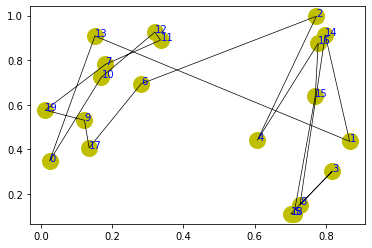

step:80/5000, actic loss:-13.398, critic loss:6.388, L:8.097, 0min1sec
step:81/5000, actic loss:-13.246, critic loss:6.323, L:8.090, 0min0sec
step:82/5000, actic loss:-13.108, critic loss:6.263, L:8.084, 0min1sec
step:83/5000, actic loss:-12.971, critic loss:6.207, L:8.080, 0min1sec
step:84/5000, actic loss:-12.776, critic loss:6.156, L:8.073, 0min1sec
distance:9.183
tensor([14, 12, 10,  2, 19,  5, 17, 16, 18,  8,  6, 11,  7,  4, 13,  0, 15,  3,
         9,  1])


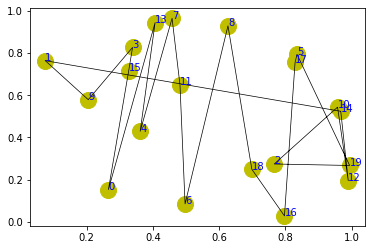

step:85/5000, actic loss:-12.584, critic loss:6.105, L:8.067, 0min1sec
step:86/5000, actic loss:-12.421, critic loss:6.049, L:8.062, 0min1sec
step:87/5000, actic loss:-12.281, critic loss:5.994, L:8.056, 0min1sec
step:88/5000, actic loss:-12.165, critic loss:5.939, L:8.051, 0min0sec
step:89/5000, actic loss:-12.042, critic loss:5.884, L:8.045, 0min1sec
distance:9.056
tensor([ 0,  2, 17, 14,  8,  5, 13, 19, 10, 12,  3, 11, 16,  7, 18,  1,  9,  4,
        15,  6])


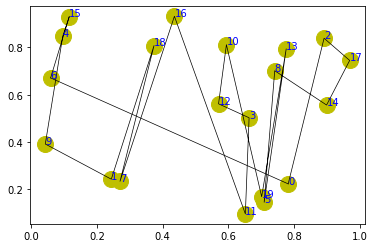

step:90/5000, actic loss:-11.901, critic loss:5.832, L:8.041, 0min1sec
step:91/5000, actic loss:-11.747, critic loss:5.782, L:8.033, 0min1sec
step:92/5000, actic loss:-11.622, critic loss:5.733, L:8.029, 0min1sec
step:93/5000, actic loss:-11.499, critic loss:5.683, L:8.025, 0min1sec
step:94/5000, actic loss:-11.335, critic loss:5.638, L:8.018, 0min1sec
distance:8.803
tensor([ 1,  2,  7, 18, 19,  8, 10,  0, 17, 14,  9, 16,  6,  3, 13, 11, 15, 12,
         4,  5])


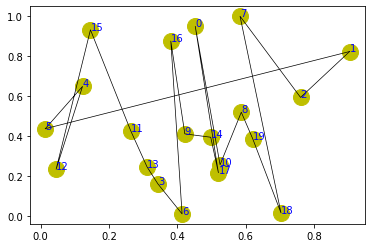

step:95/5000, actic loss:-11.201, critic loss:5.590, L:8.014, 0min1sec
step:96/5000, actic loss:-11.064, critic loss:5.547, L:8.007, 0min1sec
step:97/5000, actic loss:-10.974, critic loss:5.502, L:8.001, 0min1sec
step:98/5000, actic loss:-10.902, critic loss:5.460, L:7.996, 0min1sec
step:99/5000, actic loss:-10.835, critic loss:5.420, L:7.992, 0min1sec
distance:7.380
tensor([ 6, 15, 17,  2, 11,  1,  4,  3, 13, 19,  0, 10, 12, 16, 18, 14,  8,  9,
         5,  7])


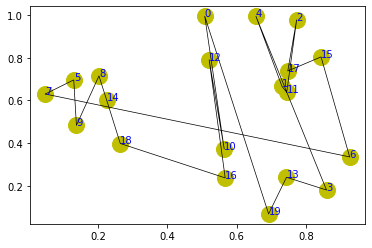

step:100/5000, actic loss:-10.733, critic loss:5.378, L:7.987, 0min1sec
step:101/5000, actic loss:-10.599, critic loss:5.339, L:7.981, 0min1sec
step:102/5000, actic loss:-10.480, critic loss:5.303, L:7.977, 0min1sec
step:103/5000, actic loss:-10.373, critic loss:5.262, L:7.971, 0min1sec
step:104/5000, actic loss:-10.299, critic loss:5.223, L:7.966, 0min1sec
distance:8.491
tensor([ 9, 12,  4, 17, 11, 19,  7,  5,  2, 18,  1,  6, 10, 16, 14,  0,  3,  8,
        13, 15])


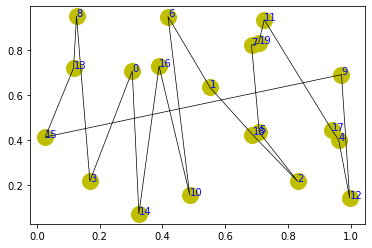

step:105/5000, actic loss:-10.231, critic loss:5.187, L:7.961, 0min1sec
step:106/5000, actic loss:-10.157, critic loss:5.150, L:7.955, 0min1sec
step:107/5000, actic loss:-10.069, critic loss:5.112, L:7.951, 0min1sec
step:108/5000, actic loss:-9.948, critic loss:5.079, L:7.946, 0min1sec
step:109/5000, actic loss:-9.816, critic loss:5.050, L:7.941, 0min1sec
distance:5.839
tensor([17,  2,  8, 15,  3,  5,  4,  0, 16,  1,  9, 12, 13, 14,  7, 19,  6, 10,
        11, 18])


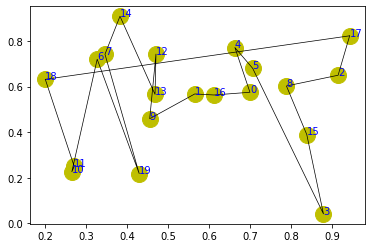

step:110/5000, actic loss:-9.690, critic loss:5.025, L:7.935, 0min1sec
step:111/5000, actic loss:-9.587, critic loss:4.993, L:7.931, 0min1sec
step:112/5000, actic loss:-9.503, critic loss:4.958, L:7.927, 0min1sec
step:113/5000, actic loss:-9.426, critic loss:4.923, L:7.922, 0min1sec
step:114/5000, actic loss:-9.351, critic loss:4.893, L:7.918, 0min1sec
distance:7.956
tensor([ 0, 15,  8,  4,  3,  7, 14, 19, 11, 16, 10, 18,  6, 12, 17,  5,  2, 13,
         9,  1])


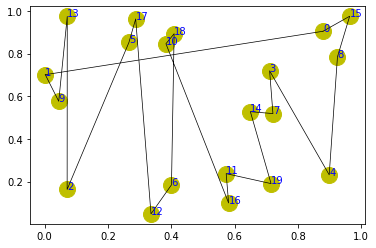

step:115/5000, actic loss:-9.256, critic loss:4.861, L:7.913, 0min1sec
step:116/5000, actic loss:-9.167, critic loss:4.831, L:7.909, 0min1sec
step:117/5000, actic loss:-9.092, critic loss:4.801, L:7.905, 0min1sec
step:118/5000, actic loss:-9.020, critic loss:4.769, L:7.901, 0min1sec
step:119/5000, actic loss:-8.944, critic loss:4.738, L:7.897, 0min1sec
distance:6.859
tensor([19, 12,  9, 14,  4,  0,  5, 15, 11, 17, 10, 16, 13,  6,  2,  8,  7, 18,
         1,  3])


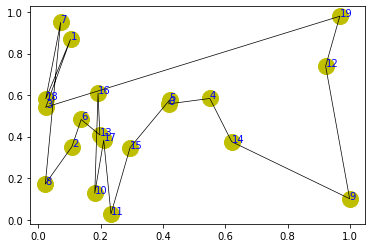

step:120/5000, actic loss:-8.876, critic loss:4.709, L:7.893, 0min1sec
step:121/5000, actic loss:-8.805, critic loss:4.681, L:7.889, 0min1sec
step:122/5000, actic loss:-8.723, critic loss:4.654, L:7.885, 0min1sec
step:123/5000, actic loss:-8.644, critic loss:4.628, L:7.880, 0min1sec
step:124/5000, actic loss:-8.569, critic loss:4.600, L:7.874, 0min1sec
distance:7.825
tensor([13,  5, 11,  0, 16,  7,  9,  6, 19, 17,  4, 15, 14,  3, 12,  2,  8, 10,
        18,  1])


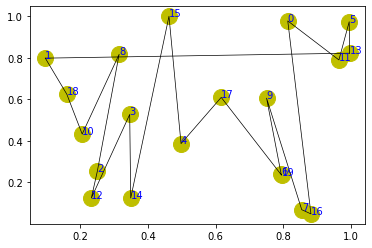

step:125/5000, actic loss:-8.513, critic loss:4.575, L:7.870, 0min1sec
step:126/5000, actic loss:-8.460, critic loss:4.551, L:7.866, 0min1sec
step:127/5000, actic loss:-8.407, critic loss:4.526, L:7.861, 0min1sec
step:128/5000, actic loss:-8.351, critic loss:4.500, L:7.858, 0min1sec
step:129/5000, actic loss:-8.278, critic loss:4.475, L:7.854, 0min1sec
distance:6.405
tensor([ 2,  1,  5,  8, 16, 18,  7, 13, 19, 12, 14,  4,  6, 17,  9, 15, 10, 11,
         3,  0])


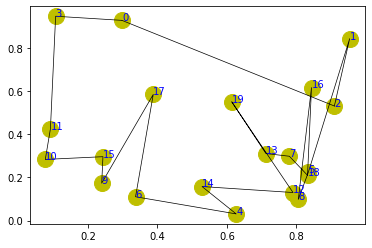

step:130/5000, actic loss:-8.205, critic loss:4.450, L:7.851, 0min1sec
step:131/5000, actic loss:-8.137, critic loss:4.425, L:7.849, 0min1sec
step:132/5000, actic loss:-8.072, critic loss:4.399, L:7.846, 0min1sec
step:133/5000, actic loss:-8.022, critic loss:4.375, L:7.843, 0min1sec
step:134/5000, actic loss:-7.976, critic loss:4.356, L:7.841, 0min1sec
distance:6.715
tensor([ 2, 14,  7,  9, 19, 17, 12,  5,  1, 16, 18,  6, 13,  3, 11, 15, 10,  8,
         0,  4])


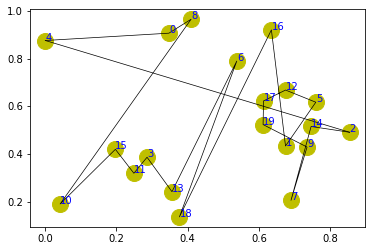

step:135/5000, actic loss:-7.934, critic loss:4.335, L:7.840, 0min1sec
step:136/5000, actic loss:-7.886, critic loss:4.312, L:7.838, 0min1sec
step:137/5000, actic loss:-7.822, critic loss:4.288, L:7.837, 0min1sec
step:138/5000, actic loss:-7.753, critic loss:4.266, L:7.834, 0min2sec
step:139/5000, actic loss:-7.693, critic loss:4.242, L:7.835, 0min1sec
distance:8.103
tensor([15,  5,  6,  4, 14, 12,  2, 11,  7, 18, 19, 13, 16, 17, 10,  8,  1,  3,
         9,  0])


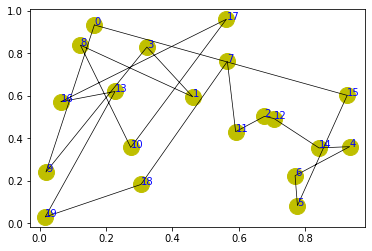

step:140/5000, actic loss:-7.638, critic loss:4.220, L:7.834, 0min2sec
step:141/5000, actic loss:-7.594, critic loss:4.199, L:7.835, 0min1sec
step:142/5000, actic loss:-7.543, critic loss:4.177, L:7.834, 0min1sec
step:143/5000, actic loss:-7.482, critic loss:4.156, L:7.834, 0min1sec
step:144/5000, actic loss:-7.419, critic loss:4.136, L:7.834, 0min1sec
distance:9.392
tensor([13,  1, 10,  6, 18, 12,  3,  2, 19,  5, 17, 11, 16,  4,  0,  8,  7, 15,
         9, 14])


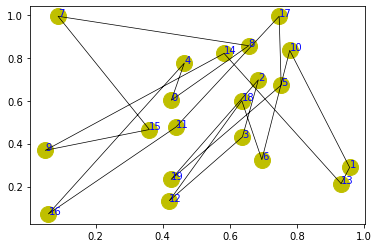

step:145/5000, actic loss:-7.386, critic loss:4.118, L:7.836, 0min1sec
step:146/5000, actic loss:-7.337, critic loss:4.097, L:7.838, 0min1sec
step:147/5000, actic loss:-7.265, critic loss:4.080, L:7.839, 0min1sec
step:148/5000, actic loss:-7.189, critic loss:4.062, L:7.839, 0min1sec
step:149/5000, actic loss:-7.132, critic loss:4.044, L:7.839, 0min1sec
distance:7.028
tensor([ 6, 16, 15,  7, 12, 10, 14, 18,  8,  2,  0,  4, 19, 13, 17,  9,  1, 11,
         3,  5])


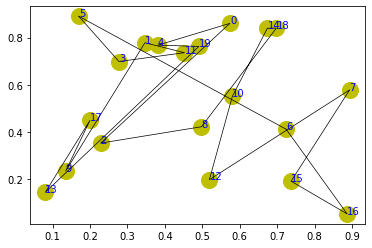

step:150/5000, actic loss:-7.085, critic loss:4.024, L:7.838, 0min1sec
step:151/5000, actic loss:-7.051, critic loss:4.006, L:7.837, 0min1sec
step:152/5000, actic loss:-7.029, critic loss:3.990, L:7.837, 0min1sec
step:153/5000, actic loss:-6.990, critic loss:3.973, L:7.835, 0min1sec
step:154/5000, actic loss:-6.945, critic loss:3.954, L:7.835, 0min1sec
distance:9.380
tensor([ 4,  9, 10,  2, 16, 13, 11,  3, 18, 12, 14, 15,  6,  7,  1,  0,  8, 17,
         5, 19])


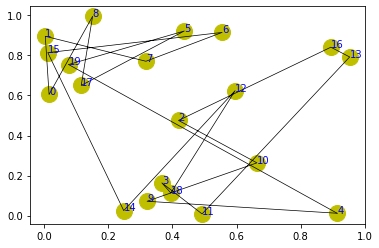

step:155/5000, actic loss:-6.893, critic loss:3.936, L:7.834, 0min1sec
step:156/5000, actic loss:-6.847, critic loss:3.918, L:7.833, 0min1sec
step:157/5000, actic loss:-6.816, critic loss:3.902, L:7.833, 0min1sec
step:158/5000, actic loss:-6.783, critic loss:3.887, L:7.833, 0min1sec
step:159/5000, actic loss:-6.746, critic loss:3.871, L:7.832, 0min1sec
distance:7.425
tensor([17,  2, 10, 11,  9, 16,  6, 12,  1, 13, 14, 15, 18,  5,  0,  7, 19,  4,
         8,  3])


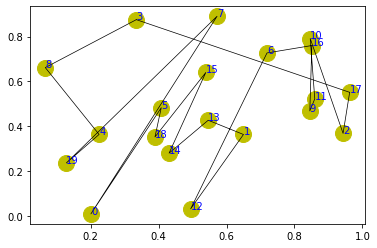

step:160/5000, actic loss:-6.697, critic loss:3.853, L:7.832, 0min1sec
step:161/5000, actic loss:-6.644, critic loss:3.838, L:7.831, 0min1sec
step:162/5000, actic loss:-6.595, critic loss:3.821, L:7.830, 0min1sec
step:163/5000, actic loss:-6.557, critic loss:3.804, L:7.829, 0min1sec
step:164/5000, actic loss:-6.522, critic loss:3.788, L:7.828, 0min1sec
distance:8.825
tensor([10,  4,  7, 19, 11,  3,  6, 15,  9,  0, 16, 14, 18, 12,  5,  1, 17, 13,
         2,  8])


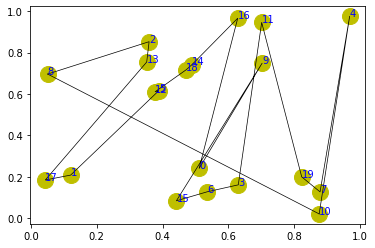

step:165/5000, actic loss:-6.478, critic loss:3.772, L:7.826, 0min2sec
step:166/5000, actic loss:-6.437, critic loss:3.756, L:7.824, 0min1sec
step:167/5000, actic loss:-6.405, critic loss:3.741, L:7.822, 0min1sec
step:168/5000, actic loss:-6.372, critic loss:3.727, L:7.820, 0min1sec
step:169/5000, actic loss:-6.334, critic loss:3.710, L:7.818, 0min1sec
distance:6.009
tensor([ 4, 12, 10,  1,  9, 15, 14, 18, 13, 11,  6, 16, 17,  5,  8, 19,  7,  0,
         2,  3])


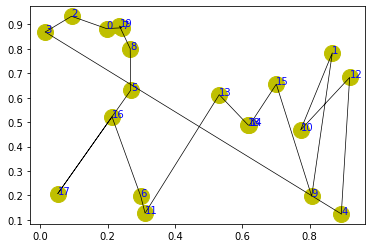

step:170/5000, actic loss:-6.297, critic loss:3.694, L:7.816, 0min2sec
step:171/5000, actic loss:-6.261, critic loss:3.681, L:7.815, 0min1sec
step:172/5000, actic loss:-6.222, critic loss:3.665, L:7.812, 0min2sec
step:173/5000, actic loss:-6.193, critic loss:3.651, L:7.810, 0min1sec
step:174/5000, actic loss:-6.166, critic loss:3.637, L:7.808, 0min1sec
distance:7.212
tensor([17,  0, 19,  8,  6,  3,  1,  5,  4, 13,  2, 18, 12, 11, 14,  9, 15, 16,
         7, 10])


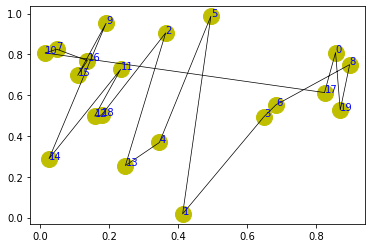

step:175/5000, actic loss:-6.133, critic loss:3.622, L:7.805, 0min2sec
step:176/5000, actic loss:-6.095, critic loss:3.608, L:7.801, 0min1sec
step:177/5000, actic loss:-6.064, critic loss:3.595, L:7.799, 0min1sec
step:178/5000, actic loss:-6.030, critic loss:3.581, L:7.796, 0min1sec
step:179/5000, actic loss:-6.001, critic loss:3.568, L:7.794, 0min1sec
distance:8.223
tensor([ 5,  9,  6, 19, 13, 12,  2,  8,  4, 10,  1, 14, 16,  3,  7,  0, 17, 15,
        11, 18])


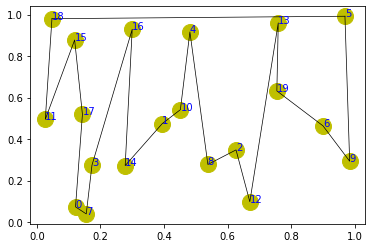

step:180/5000, actic loss:-5.964, critic loss:3.554, L:7.791, 0min2sec
step:181/5000, actic loss:-5.933, critic loss:3.540, L:7.788, 0min1sec
step:182/5000, actic loss:-5.901, critic loss:3.526, L:7.786, 0min1sec
step:183/5000, actic loss:-5.867, critic loss:3.513, L:7.782, 0min1sec
step:184/5000, actic loss:-5.844, critic loss:3.502, L:7.780, 0min1sec
distance:8.136
tensor([ 1,  0,  6,  4,  3, 19, 18,  9,  8, 10, 12, 16, 15,  2, 14, 17, 11,  5,
         7, 13])


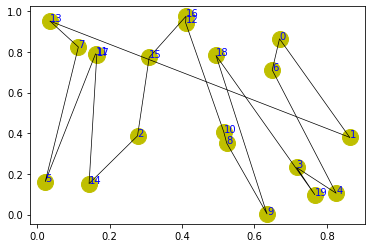

step:185/5000, actic loss:-5.822, critic loss:3.493, L:7.778, 0min1sec
step:186/5000, actic loss:-5.797, critic loss:3.481, L:7.776, 0min1sec
step:187/5000, actic loss:-5.758, critic loss:3.469, L:7.774, 0min1sec
step:188/5000, actic loss:-5.714, critic loss:3.462, L:7.771, 0min1sec
step:189/5000, actic loss:-5.673, critic loss:3.451, L:7.769, 0min1sec
distance:6.747
tensor([13, 14, 12, 16, 11,  7,  0,  9, 17,  4,  6,  8, 10,  1, 19,  3,  2, 15,
         5, 18])


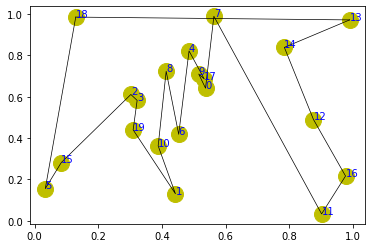

step:190/5000, actic loss:-5.645, critic loss:3.438, L:7.767, 0min1sec
step:191/5000, actic loss:-5.619, critic loss:3.425, L:7.765, 0min1sec
step:192/5000, actic loss:-5.588, critic loss:3.413, L:7.763, 0min1sec
step:193/5000, actic loss:-5.555, critic loss:3.401, L:7.759, 0min1sec
step:194/5000, actic loss:-5.535, critic loss:3.391, L:7.758, 0min1sec
distance:7.910
tensor([16, 12, 11,  2, 10, 14,  1,  9,  8, 19,  4,  6,  0, 18,  7, 13,  3,  5,
        15, 17])


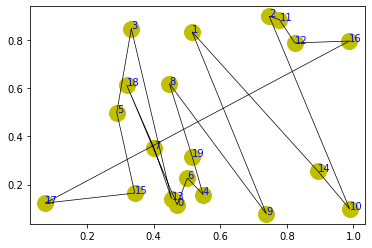

step:195/5000, actic loss:-5.519, critic loss:3.381, L:7.756, 0min2sec
step:196/5000, actic loss:-5.491, critic loss:3.368, L:7.753, 0min1sec
step:197/5000, actic loss:-5.452, critic loss:3.357, L:7.750, 0min1sec
step:198/5000, actic loss:-5.411, critic loss:3.348, L:7.748, 0min1sec
step:199/5000, actic loss:-5.374, critic loss:3.339, L:7.746, 0min1sec
distance:7.135
tensor([ 5, 12,  6,  7,  9, 17,  2, 11,  0, 13,  3,  8, 10, 16,  4,  1, 15, 19,
        18, 14])


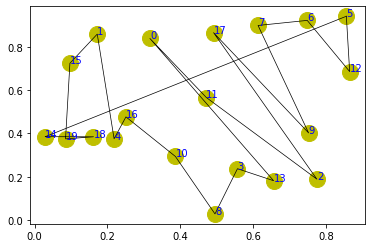

step:200/5000, actic loss:-5.347, critic loss:3.328, L:7.743, 0min2sec
step:201/5000, actic loss:-5.337, critic loss:3.320, L:7.741, 0min1sec
step:202/5000, actic loss:-5.338, critic loss:3.317, L:7.740, 0min1sec
step:203/5000, actic loss:-5.334, critic loss:3.312, L:7.738, 0min1sec
step:204/5000, actic loss:-5.323, critic loss:3.303, L:7.736, 0min1sec
distance:6.058
tensor([11, 19,  1,  4,  0, 17, 12,  7,  5,  3, 15,  6, 13, 16,  9,  2, 18, 14,
         8, 10])


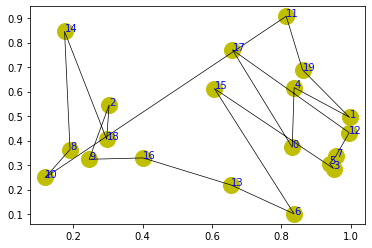

step:205/5000, actic loss:-5.295, critic loss:3.292, L:7.733, 0min1sec
step:206/5000, actic loss:-5.259, critic loss:3.282, L:7.731, 0min1sec
step:207/5000, actic loss:-5.227, critic loss:3.270, L:7.728, 0min1sec
step:208/5000, actic loss:-5.211, critic loss:3.260, L:7.726, 0min1sec
step:209/5000, actic loss:-5.192, critic loss:3.250, L:7.723, 0min1sec
distance:6.928
tensor([17,  3,  9, 15,  2, 19,  6,  0,  7, 10,  4,  5, 11, 16,  1, 14,  8, 13,
        12, 18])


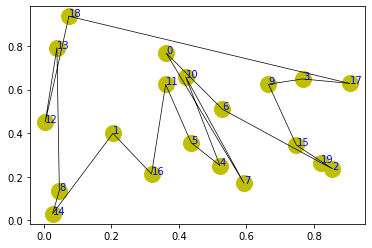

step:210/5000, actic loss:-5.167, critic loss:3.239, L:7.720, 0min2sec
step:211/5000, actic loss:-5.141, critic loss:3.228, L:7.716, 0min1sec
step:212/5000, actic loss:-5.124, critic loss:3.218, L:7.714, 0min1sec
step:213/5000, actic loss:-5.107, critic loss:3.210, L:7.711, 0min1sec
step:214/5000, actic loss:-5.082, critic loss:3.200, L:7.706, 0min1sec
distance:6.392
tensor([ 0, 19, 12, 16, 17, 10,  3,  4,  9,  8,  5, 15, 13,  1,  7,  2, 14,  6,
        11, 18])


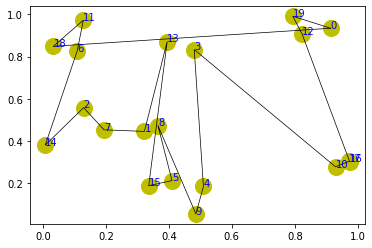

step:215/5000, actic loss:-5.059, critic loss:3.190, L:7.703, 0min1sec
step:216/5000, actic loss:-5.033, critic loss:3.180, L:7.699, 0min1sec
step:217/5000, actic loss:-5.006, critic loss:3.171, L:7.695, 0min1sec
step:218/5000, actic loss:-4.984, critic loss:3.160, L:7.691, 0min1sec
step:219/5000, actic loss:-4.965, critic loss:3.150, L:7.687, 0min1sec
distance:6.031
tensor([ 2, 10, 15, 14, 19,  8,  1, 11,  4,  3, 18, 13,  6,  7, 17,  0,  5,  9,
        16, 12])


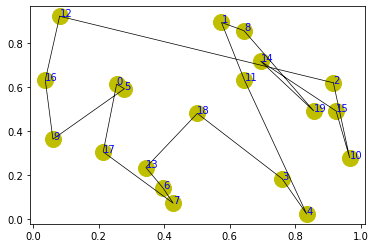

step:220/5000, actic loss:-4.944, critic loss:3.139, L:7.684, 0min2sec
step:221/5000, actic loss:-4.915, critic loss:3.131, L:7.680, 0min1sec
step:222/5000, actic loss:-4.884, critic loss:3.123, L:7.678, 0min1sec
step:223/5000, actic loss:-4.858, critic loss:3.115, L:7.676, 0min1sec
step:224/5000, actic loss:-4.837, critic loss:3.105, L:7.674, 0min1sec
distance:8.842
tensor([15,  4,  8,  9, 19,  2, 17, 11, 12, 13,  3,  1,  5,  6,  7, 16,  0, 14,
        18, 10])


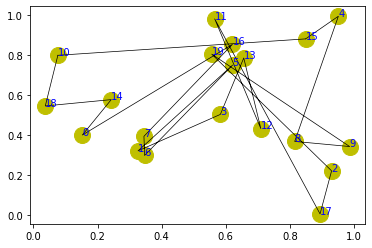

step:225/5000, actic loss:-4.820, critic loss:3.096, L:7.674, 0min2sec
step:226/5000, actic loss:-4.800, critic loss:3.086, L:7.673, 0min1sec
step:227/5000, actic loss:-4.774, critic loss:3.079, L:7.672, 0min1sec
step:228/5000, actic loss:-4.747, critic loss:3.072, L:7.670, 0min2sec
step:229/5000, actic loss:-4.722, critic loss:3.063, L:7.670, 0min1sec
distance:7.225
tensor([13,  8,  0,  4,  5,  6, 14, 17, 15, 10,  2, 19,  1,  7,  3, 12,  9, 16,
        11, 18])


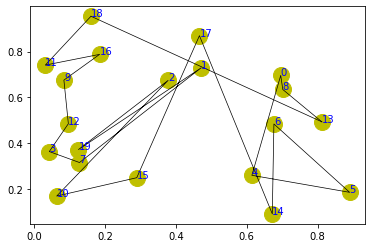

step:230/5000, actic loss:-4.701, critic loss:3.054, L:7.668, 0min2sec
step:231/5000, actic loss:-4.686, critic loss:3.047, L:7.666, 0min1sec
step:232/5000, actic loss:-4.673, critic loss:3.041, L:7.663, 0min1sec
step:233/5000, actic loss:-4.659, critic loss:3.033, L:7.660, 0min1sec
step:234/5000, actic loss:-4.642, critic loss:3.025, L:7.656, 0min2sec
distance:5.964
tensor([11,  1, 15, 17,  6,  0,  3, 10,  8, 13,  4, 14,  7, 16, 19, 18,  2, 12,
         9,  5])


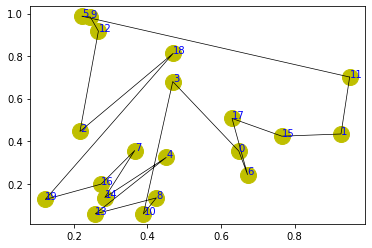

step:235/5000, actic loss:-4.615, critic loss:3.018, L:7.653, 0min2sec
step:236/5000, actic loss:-4.584, critic loss:3.012, L:7.648, 0min1sec
step:237/5000, actic loss:-4.553, critic loss:3.006, L:7.644, 0min2sec
step:238/5000, actic loss:-4.526, critic loss:2.998, L:7.640, 0min1sec
step:239/5000, actic loss:-4.510, critic loss:2.989, L:7.636, 0min1sec
distance:7.642
tensor([11,  2,  7, 17,  8, 15, 14,  6,  3, 10, 18,  1, 13,  4, 16, 12,  9, 19,
         5,  0])


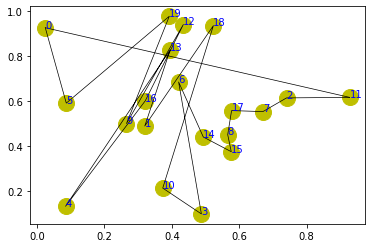

step:240/5000, actic loss:-4.497, critic loss:2.982, L:7.631, 0min2sec
step:241/5000, actic loss:-4.483, critic loss:2.975, L:7.627, 0min1sec
step:242/5000, actic loss:-4.464, critic loss:2.966, L:7.622, 0min2sec
step:243/5000, actic loss:-4.448, critic loss:2.957, L:7.619, 0min2sec
step:244/5000, actic loss:-4.425, critic loss:2.949, L:7.615, 0min1sec
distance:6.258
tensor([ 8, 15,  2, 12, 10, 16,  1, 11, 19,  9,  3,  5,  4, 14, 13, 18, 17,  6,
         0,  7])


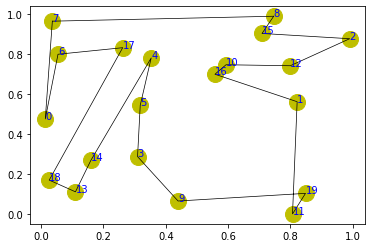

step:245/5000, actic loss:-4.399, critic loss:2.941, L:7.610, 0min2sec
step:246/5000, actic loss:-4.377, critic loss:2.932, L:7.606, 0min1sec
step:247/5000, actic loss:-4.369, critic loss:2.926, L:7.601, 0min2sec
step:248/5000, actic loss:-4.364, critic loss:2.918, L:7.597, 0min1sec
step:249/5000, actic loss:-4.350, critic loss:2.910, L:7.591, 0min2sec
distance:5.686
tensor([12, 13,  4,  8,  2, 11, 17, 19,  9,  0,  1, 14, 10,  3,  6,  7, 18,  5,
        15, 16])


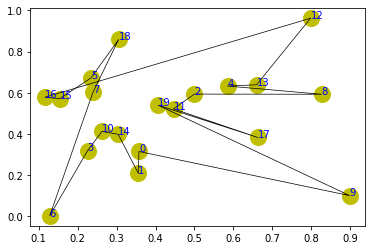

step:250/5000, actic loss:-4.327, critic loss:2.902, L:7.585, 0min2sec
step:251/5000, actic loss:-4.305, critic loss:2.894, L:7.579, 0min1sec
step:252/5000, actic loss:-4.286, critic loss:2.886, L:7.574, 0min1sec
step:253/5000, actic loss:-4.275, critic loss:2.877, L:7.568, 0min1sec
step:254/5000, actic loss:-4.271, critic loss:2.871, L:7.562, 0min1sec
distance:7.382
tensor([ 1,  7,  4, 12,  2,  8, 13, 14, 19,  6, 11,  5, 18,  0, 17, 16,  3,  9,
        10, 15])


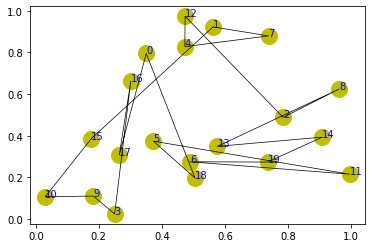

step:255/5000, actic loss:-4.267, critic loss:2.863, L:7.557, 0min1sec
step:256/5000, actic loss:-4.250, critic loss:2.855, L:7.551, 0min1sec
step:257/5000, actic loss:-4.236, critic loss:2.848, L:7.546, 0min1sec
step:258/5000, actic loss:-4.211, critic loss:2.841, L:7.541, 0min1sec
step:259/5000, actic loss:-4.185, critic loss:2.834, L:7.536, 0min2sec
distance:6.591
tensor([ 9,  5,  8, 15,  3, 13, 11, 12,  6, 14, 17,  0, 19,  7,  1,  2, 16, 10,
         4, 18])


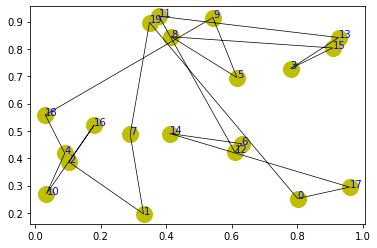

step:260/5000, actic loss:-4.169, critic loss:2.826, L:7.531, 0min2sec
step:261/5000, actic loss:-4.163, critic loss:2.819, L:7.525, 0min1sec
step:262/5000, actic loss:-4.160, critic loss:2.811, L:7.520, 0min2sec
step:263/5000, actic loss:-4.154, critic loss:2.804, L:7.515, 0min1sec
step:264/5000, actic loss:-4.139, critic loss:2.797, L:7.510, 0min1sec
distance:4.661
tensor([ 9, 13,  2,  8, 17, 14, 19, 15, 11,  4,  7,  5,  0,  6, 18, 12, 10,  1,
         3, 16])


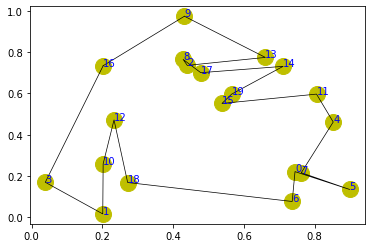

step:265/5000, actic loss:-4.113, critic loss:2.791, L:7.505, 0min2sec
step:266/5000, actic loss:-4.079, critic loss:2.787, L:7.499, 0min1sec
step:267/5000, actic loss:-4.058, critic loss:2.780, L:7.496, 0min1sec
step:268/5000, actic loss:-4.043, critic loss:2.772, L:7.491, 0min1sec
step:269/5000, actic loss:-4.046, critic loss:2.767, L:7.487, 0min2sec
distance:7.413
tensor([12,  4, 10,  3,  1, 15,  2, 11,  8, 19,  7, 16, 17,  0,  9, 14,  5, 18,
        13,  6])


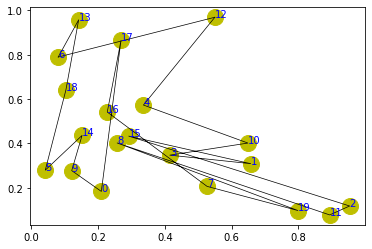

step:270/5000, actic loss:-4.057, critic loss:2.763, L:7.483, 0min2sec
step:271/5000, actic loss:-4.063, critic loss:2.758, L:7.478, 0min1sec
step:272/5000, actic loss:-4.066, critic loss:2.754, L:7.474, 0min2sec
step:273/5000, actic loss:-4.053, critic loss:2.747, L:7.470, 0min2sec
step:274/5000, actic loss:-4.033, critic loss:2.741, L:7.465, 0min1sec
distance:5.804
tensor([ 9, 16,  7, 12,  8, 10, 14, 17,  6,  1,  0,  3, 11,  5,  2, 18, 13, 15,
         4, 19])


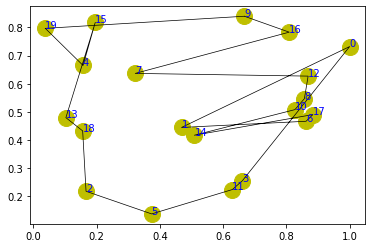

step:275/5000, actic loss:-4.014, critic loss:2.734, L:7.461, 0min1sec
step:276/5000, actic loss:-3.998, critic loss:2.726, L:7.455, 0min1sec
step:277/5000, actic loss:-3.993, critic loss:2.720, L:7.450, 0min2sec
step:278/5000, actic loss:-3.990, critic loss:2.714, L:7.445, 0min1sec
step:279/5000, actic loss:-3.984, critic loss:2.709, L:7.440, 0min2sec
distance:6.492
tensor([12,  1, 16, 18,  4,  8,  6,  5,  0, 15,  9,  2, 14, 11, 10, 13,  7, 17,
        19,  3])


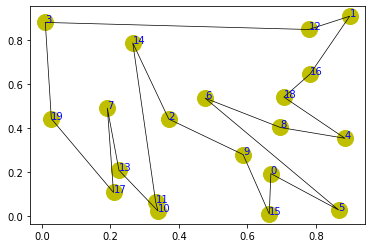

step:280/5000, actic loss:-3.975, critic loss:2.702, L:7.435, 0min2sec
step:281/5000, actic loss:-3.961, critic loss:2.695, L:7.430, 0min1sec
step:282/5000, actic loss:-3.942, critic loss:2.689, L:7.425, 0min1sec
step:283/5000, actic loss:-3.925, critic loss:2.682, L:7.421, 0min1sec
step:284/5000, actic loss:-3.910, critic loss:2.675, L:7.415, 0min1sec
distance:6.262
tensor([ 3, 19, 17, 11,  0,  1, 18,  9,  6, 13,  8,  4, 16, 10, 14,  5,  7,  2,
        15, 12])


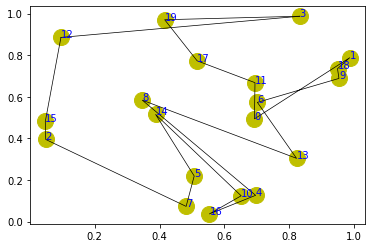

step:285/5000, actic loss:-3.906, critic loss:2.668, L:7.411, 0min2sec
step:286/5000, actic loss:-3.906, critic loss:2.663, L:7.406, 0min1sec
step:287/5000, actic loss:-3.908, critic loss:2.658, L:7.402, 0min2sec
step:288/5000, actic loss:-3.907, critic loss:2.652, L:7.398, 0min2sec
step:289/5000, actic loss:-3.896, critic loss:2.645, L:7.394, 0min1sec
distance:7.106
tensor([14,  4,  2, 18, 15,  6,  1, 19,  0,  9,  7, 10, 12, 16, 11, 13,  8, 17,
         3,  5])


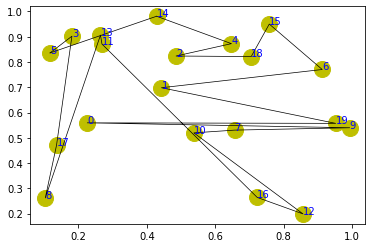

step:290/5000, actic loss:-3.868, critic loss:2.640, L:7.390, 0min2sec
step:291/5000, actic loss:-3.826, critic loss:2.637, L:7.387, 0min1sec
step:292/5000, actic loss:-3.777, critic loss:2.634, L:7.383, 0min1sec
step:293/5000, actic loss:-3.736, critic loss:2.631, L:7.380, 0min2sec
step:294/5000, actic loss:-3.706, critic loss:2.626, L:7.376, 0min1sec
distance:7.262
tensor([10,  4,  1, 12,  9, 13, 15, 17,  5,  2, 18, 14,  7,  8,  6, 16, 19, 11,
         3,  0])


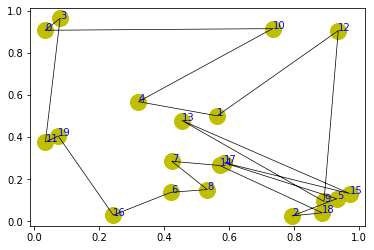

step:295/5000, actic loss:-3.691, critic loss:2.620, L:7.372, 0min2sec
step:296/5000, actic loss:-3.690, critic loss:2.614, L:7.367, 0min2sec
step:297/5000, actic loss:-3.705, critic loss:2.611, L:7.363, 0min1sec
step:298/5000, actic loss:-3.721, critic loss:2.607, L:7.358, 0min1sec
step:299/5000, actic loss:-3.731, critic loss:2.602, L:7.353, 0min1sec
distance:5.196
tensor([18,  9,  2,  6,  8, 10, 16, 11,  4,  7, 19,  5,  3, 15,  1, 14,  0, 12,
        17, 13])


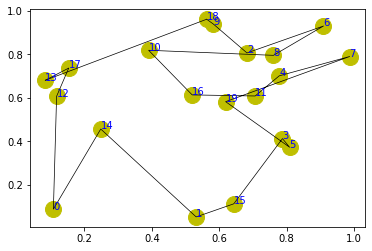

step:300/5000, actic loss:-3.727, critic loss:2.596, L:7.348, 0min2sec
step:301/5000, actic loss:-3.716, critic loss:2.590, L:7.344, 0min2sec
step:302/5000, actic loss:-3.690, critic loss:2.585, L:7.338, 0min2sec
step:303/5000, actic loss:-3.662, critic loss:2.582, L:7.333, 0min1sec
step:304/5000, actic loss:-3.638, critic loss:2.579, L:7.328, 0min2sec
distance:5.335
tensor([12,  0,  2, 14,  3,  8,  9,  1,  7, 10, 19, 18, 15,  6,  4, 13, 16, 17,
        11,  5])


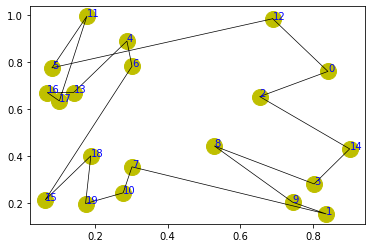

step:305/5000, actic loss:-3.617, critic loss:2.574, L:7.324, 0min1sec
step:306/5000, actic loss:-3.604, critic loss:2.567, L:7.319, 0min1sec
step:307/5000, actic loss:-3.597, critic loss:2.562, L:7.314, 0min2sec
step:308/5000, actic loss:-3.594, critic loss:2.557, L:7.309, 0min1sec
step:309/5000, actic loss:-3.595, critic loss:2.553, L:7.305, 0min2sec
distance:5.998
tensor([10, 15,  0, 12,  9,  7,  6, 18,  3, 16, 17, 13, 14,  1,  2,  8,  4,  5,
        19, 11])


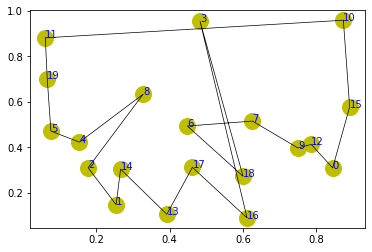

step:310/5000, actic loss:-3.591, critic loss:2.549, L:7.300, 0min2sec
step:311/5000, actic loss:-3.585, critic loss:2.544, L:7.297, 0min1sec
step:312/5000, actic loss:-3.571, critic loss:2.538, L:7.293, 0min1sec
step:313/5000, actic loss:-3.554, critic loss:2.534, L:7.290, 0min2sec
step:314/5000, actic loss:-3.539, critic loss:2.529, L:7.286, 0min2sec
distance:7.073
tensor([ 5,  9,  7, 10,  1, 14, 17,  0,  4, 11,  8, 19,  3,  2, 16, 18, 15,  6,
        12, 13])


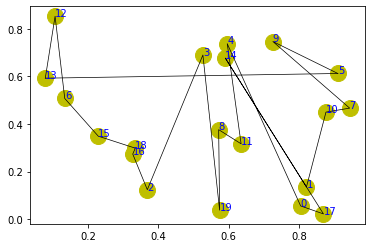

step:315/5000, actic loss:-3.526, critic loss:2.524, L:7.283, 0min2sec
step:316/5000, actic loss:-3.521, critic loss:2.519, L:7.280, 0min2sec
step:317/5000, actic loss:-3.523, critic loss:2.516, L:7.278, 0min1sec
step:318/5000, actic loss:-3.520, critic loss:2.512, L:7.276, 0min2sec
step:319/5000, actic loss:-3.511, critic loss:2.507, L:7.274, 0min4sec
distance:4.141
tensor([ 6,  3, 15,  9, 10, 14,  8, 11, 16,  1,  5, 12, 13, 17,  7, 19,  4,  2,
        18,  0])


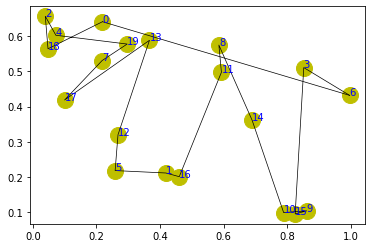

step:320/5000, actic loss:-3.497, critic loss:2.502, L:7.271, 0min2sec
step:321/5000, actic loss:-3.477, critic loss:2.499, L:7.269, 0min1sec
step:322/5000, actic loss:-3.457, critic loss:2.495, L:7.266, 0min1sec
step:323/5000, actic loss:-3.440, critic loss:2.491, L:7.263, 0min3sec
step:324/5000, actic loss:-3.425, critic loss:2.486, L:7.259, 0min3sec
distance:7.167
tensor([ 0, 10,  6, 13, 16, 12,  5, 18,  4,  9, 11, 17, 19,  3,  7,  1,  2, 15,
        14,  8])


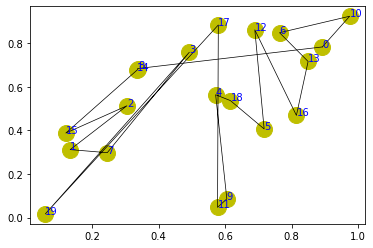

step:325/5000, actic loss:-3.417, critic loss:2.481, L:7.255, 0min2sec
step:326/5000, actic loss:-3.413, critic loss:2.477, L:7.252, 0min1sec
step:327/5000, actic loss:-3.409, critic loss:2.473, L:7.248, 0min1sec
step:328/5000, actic loss:-3.402, critic loss:2.467, L:7.244, 0min2sec
step:329/5000, actic loss:-3.390, critic loss:2.462, L:7.240, 0min1sec
distance:4.814
tensor([10, 16,  8,  5,  0, 19,  7, 18, 17,  6,  2,  4,  1,  9, 11,  3, 12, 13,
        14, 15])


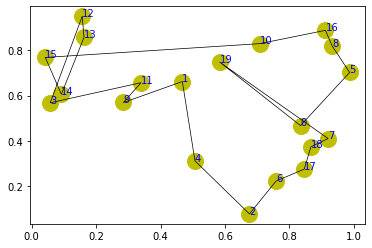

step:330/5000, actic loss:-3.378, critic loss:2.458, L:7.236, 0min2sec
step:331/5000, actic loss:-3.367, critic loss:2.453, L:7.233, 0min2sec
step:332/5000, actic loss:-3.355, critic loss:2.448, L:7.229, 0min1sec
step:333/5000, actic loss:-3.347, critic loss:2.443, L:7.226, 0min1sec
step:334/5000, actic loss:-3.334, critic loss:2.438, L:7.222, 0min2sec
distance:6.938
tensor([ 2,  3, 19, 13, 16, 11, 18, 17, 10, 14,  7, 15,  9,  4,  8, 12,  6,  1,
         5,  0])


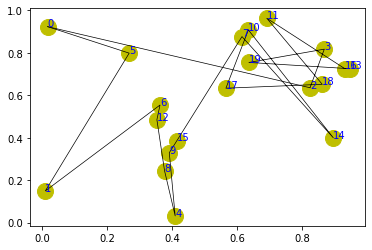

step:335/5000, actic loss:-3.320, critic loss:2.433, L:7.218, 0min2sec
step:336/5000, actic loss:-3.311, critic loss:2.428, L:7.214, 0min2sec
step:337/5000, actic loss:-3.303, critic loss:2.423, L:7.210, 0min3sec
step:338/5000, actic loss:-3.289, critic loss:2.418, L:7.206, 0min1sec
step:339/5000, actic loss:-3.278, critic loss:2.413, L:7.202, 0min2sec
distance:5.084
tensor([ 7, 17,  4, 18,  5, 11,  0,  9, 16, 10, 13,  2, 14,  8,  3, 19,  6,  1,
        15, 12])


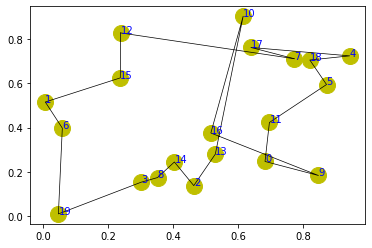

step:340/5000, actic loss:-3.271, critic loss:2.408, L:7.198, 0min2sec
step:341/5000, actic loss:-3.264, critic loss:2.403, L:7.195, 0min1sec
step:342/5000, actic loss:-3.254, critic loss:2.398, L:7.191, 0min2sec
step:343/5000, actic loss:-3.243, critic loss:2.393, L:7.187, 0min1sec
step:344/5000, actic loss:-3.236, critic loss:2.389, L:7.183, 0min2sec
distance:7.239
tensor([ 9,  2, 15, 11,  3,  7,  5, 19,  0, 12, 10, 16, 14,  4,  6, 18, 13,  1,
        17,  8])


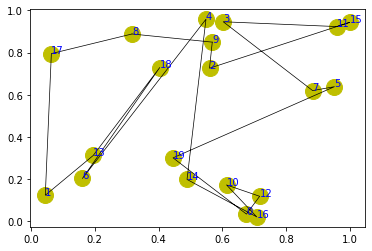

step:345/5000, actic loss:-3.227, critic loss:2.384, L:7.178, 0min2sec
step:346/5000, actic loss:-3.216, critic loss:2.379, L:7.174, 0min2sec
step:347/5000, actic loss:-3.209, critic loss:2.374, L:7.170, 0min2sec
step:348/5000, actic loss:-3.200, critic loss:2.370, L:7.165, 0min1sec
step:349/5000, actic loss:-3.190, critic loss:2.365, L:7.161, 0min2sec
distance:5.589
tensor([ 7, 18, 16,  0, 10,  6,  5, 11,  3, 19,  1, 15, 14,  9,  4, 13,  2, 12,
        17,  8])


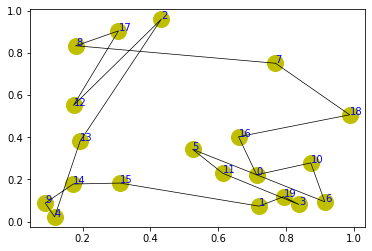

step:350/5000, actic loss:-3.186, critic loss:2.360, L:7.157, 0min2sec
step:351/5000, actic loss:-3.179, critic loss:2.355, L:7.153, 0min2sec
step:352/5000, actic loss:-3.167, critic loss:2.350, L:7.149, 0min2sec
step:353/5000, actic loss:-3.154, critic loss:2.346, L:7.145, 0min2sec
step:354/5000, actic loss:-3.144, critic loss:2.341, L:7.141, 0min2sec
distance:5.433
tensor([11,  4,  8,  0,  5,  2, 17,  9,  1,  3,  7, 12, 14, 16, 10, 15,  6, 19,
        18, 13])


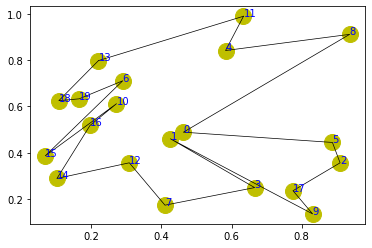

step:355/5000, actic loss:-3.141, critic loss:2.336, L:7.138, 0min2sec
step:356/5000, actic loss:-3.137, critic loss:2.332, L:7.133, 0min2sec
step:357/5000, actic loss:-3.135, critic loss:2.328, L:7.130, 0min1sec
step:358/5000, actic loss:-3.127, critic loss:2.323, L:7.126, 0min2sec
step:359/5000, actic loss:-3.110, critic loss:2.319, L:7.122, 0min1sec
distance:6.456
tensor([ 9,  2, 13, 11, 15, 10, 19, 16, 18,  8,  7, 12,  6,  5,  1,  4, 14,  3,
        17,  0])


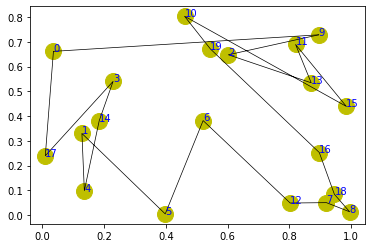

step:360/5000, actic loss:-3.090, critic loss:2.316, L:7.118, 0min2sec
step:361/5000, actic loss:-3.068, critic loss:2.314, L:7.114, 0min1sec
step:362/5000, actic loss:-3.054, critic loss:2.309, L:7.110, 0min1sec
step:363/5000, actic loss:-3.046, critic loss:2.305, L:7.107, 0min1sec
step:364/5000, actic loss:-3.046, critic loss:2.301, L:7.103, 0min2sec
distance:5.500
tensor([10, 19, 14, 15,  1, 17,  6,  3,  7,  4,  0, 18,  9, 16,  5,  8, 13, 11,
        12,  2])


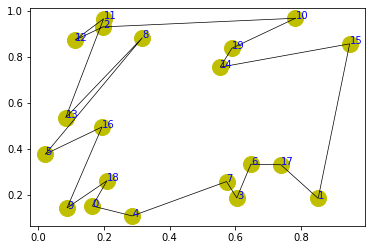

step:365/5000, actic loss:-3.048, critic loss:2.297, L:7.098, 0min2sec
step:366/5000, actic loss:-3.050, critic loss:2.293, L:7.095, 0min2sec
step:367/5000, actic loss:-3.046, critic loss:2.289, L:7.090, 0min2sec
step:368/5000, actic loss:-3.037, critic loss:2.284, L:7.086, 0min1sec
step:369/5000, actic loss:-3.024, critic loss:2.280, L:7.081, 0min2sec
distance:5.623
tensor([19, 11, 14, 10,  1,  9,  8,  2, 15, 16,  5, 17,  6, 12,  7,  3,  0, 13,
         4, 18])


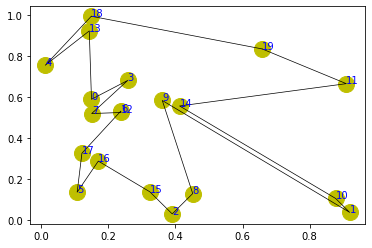

step:370/5000, actic loss:-3.015, critic loss:2.276, L:7.076, 0min2sec
step:371/5000, actic loss:-3.011, critic loss:2.272, L:7.073, 0min2sec
step:372/5000, actic loss:-3.006, critic loss:2.268, L:7.069, 0min1sec
step:373/5000, actic loss:-3.000, critic loss:2.264, L:7.065, 0min2sec
step:374/5000, actic loss:-2.993, critic loss:2.261, L:7.062, 0min2sec
distance:6.627
tensor([16,  3,  5,  4,  1,  8,  2, 15, 12,  6,  0, 10, 14, 19, 17, 13, 18,  9,
        11,  7])


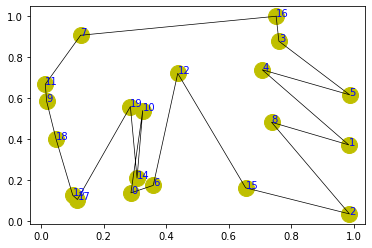

step:375/5000, actic loss:-2.978, critic loss:2.258, L:7.059, 0min2sec
step:376/5000, actic loss:-2.957, critic loss:2.255, L:7.056, 0min3sec
step:377/5000, actic loss:-2.934, critic loss:2.253, L:7.053, 0min2sec
step:378/5000, actic loss:-2.916, critic loss:2.249, L:7.050, 0min1sec
step:379/5000, actic loss:-2.905, critic loss:2.246, L:7.047, 0min2sec
distance:4.809
tensor([ 1,  3,  8, 13, 11,  4, 17,  6, 15,  7, 18,  5, 12,  2, 16,  0,  9, 14,
        10, 19])


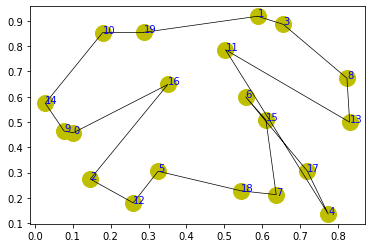

step:380/5000, actic loss:-2.904, critic loss:2.242, L:7.044, 0min2sec
step:381/5000, actic loss:-2.907, critic loss:2.239, L:7.041, 0min1sec
step:382/5000, actic loss:-2.907, critic loss:2.235, L:7.038, 0min1sec
step:383/5000, actic loss:-2.906, critic loss:2.232, L:7.035, 0min2sec
step:384/5000, actic loss:-2.897, critic loss:2.228, L:7.032, 0min1sec
distance:5.836
tensor([ 6, 18, 16,  5,  2, 10, 17, 11,  9, 12, 15,  8,  1,  4,  3, 14,  0, 13,
        19,  7])


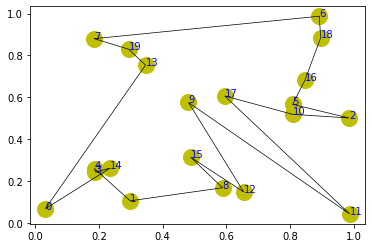

step:385/5000, actic loss:-2.883, critic loss:2.224, L:7.028, 0min2sec
step:386/5000, actic loss:-2.875, critic loss:2.220, L:7.024, 0min2sec
step:387/5000, actic loss:-2.867, critic loss:2.216, L:7.020, 0min2sec
step:388/5000, actic loss:-2.861, critic loss:2.211, L:7.016, 0min2sec
step:389/5000, actic loss:-2.860, critic loss:2.208, L:7.012, 0min2sec
distance:6.634
tensor([ 2,  6, 18,  3, 13, 11, 19,  7, 12, 14,  5,  4,  0, 16,  1, 17, 10,  9,
        15,  8])


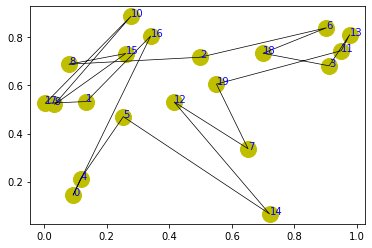

step:390/5000, actic loss:-2.858, critic loss:2.205, L:7.008, 0min2sec
step:391/5000, actic loss:-2.853, critic loss:2.200, L:7.004, 0min2sec
step:392/5000, actic loss:-2.845, critic loss:2.196, L:7.000, 0min1sec
step:393/5000, actic loss:-2.836, critic loss:2.192, L:6.996, 0min2sec
step:394/5000, actic loss:-2.828, critic loss:2.188, L:6.992, 0min2sec
distance:5.205
tensor([16,  0,  2, 10,  7,  5,  9, 11,  8,  3, 19, 18, 12,  4, 17, 13, 14,  1,
        15,  6])


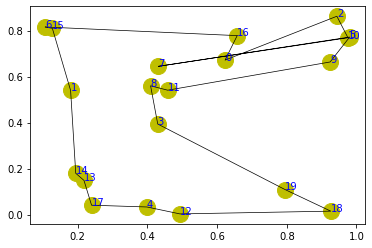

step:395/5000, actic loss:-2.820, critic loss:2.184, L:6.988, 0min3sec
step:396/5000, actic loss:-2.817, critic loss:2.180, L:6.984, 0min2sec
step:397/5000, actic loss:-2.814, critic loss:2.176, L:6.980, 0min2sec
step:398/5000, actic loss:-2.811, critic loss:2.172, L:6.975, 0min2sec
step:399/5000, actic loss:-2.806, critic loss:2.168, L:6.971, 0min3sec
distance:5.090
tensor([18,  6, 19,  4,  5,  8,  0, 17,  1, 14, 16,  2, 15,  7, 13, 11,  9, 10,
        12,  3])


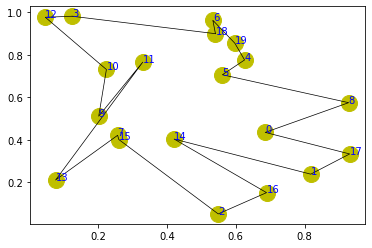

step:400/5000, actic loss:-2.797, critic loss:2.164, L:6.966, 0min3sec
step:401/5000, actic loss:-2.786, critic loss:2.160, L:6.962, 0min2sec
step:402/5000, actic loss:-2.777, critic loss:2.156, L:6.958, 0min2sec
step:403/5000, actic loss:-2.769, critic loss:2.152, L:6.954, 0min3sec
step:404/5000, actic loss:-2.764, critic loss:2.147, L:6.949, 0min2sec
distance:4.794
tensor([15, 19, 18, 11,  0,  5, 16, 13, 17,  3,  9,  1,  7, 12,  6,  2,  4, 10,
         8, 14])


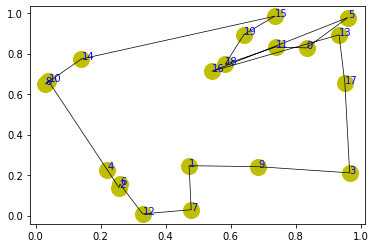

step:405/5000, actic loss:-2.763, critic loss:2.143, L:6.945, 0min3sec
step:406/5000, actic loss:-2.762, critic loss:2.139, L:6.940, 0min3sec
step:407/5000, actic loss:-2.756, critic loss:2.135, L:6.936, 0min2sec
step:408/5000, actic loss:-2.749, critic loss:2.131, L:6.931, 0min2sec
step:409/5000, actic loss:-2.739, critic loss:2.127, L:6.927, 0min2sec
distance:5.494
tensor([ 2, 18,  1, 15,  5, 11, 12, 10, 17,  0,  7,  8,  9, 13,  4, 14, 16,  6,
         3, 19])


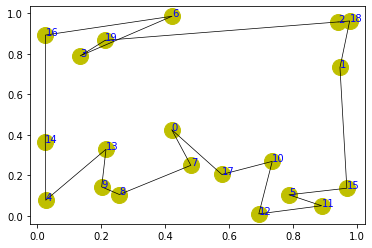

step:410/5000, actic loss:-2.732, critic loss:2.123, L:6.922, 0min1sec
step:411/5000, actic loss:-2.726, critic loss:2.118, L:6.917, 0min3sec
step:412/5000, actic loss:-2.723, critic loss:2.114, L:6.913, 0min3sec
step:413/5000, actic loss:-2.719, critic loss:2.110, L:6.908, 0min3sec
step:414/5000, actic loss:-2.712, critic loss:2.106, L:6.903, 0min2sec
distance:4.825
tensor([ 4, 12,  8, 10, 15, 13, 17,  6,  0, 18, 14,  3, 16, 19,  7,  1,  9,  5,
         2, 11])


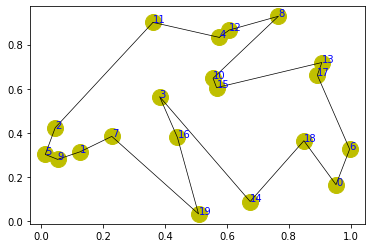

step:415/5000, actic loss:-2.705, critic loss:2.102, L:6.899, 0min4sec
step:416/5000, actic loss:-2.699, critic loss:2.097, L:6.894, 0min2sec
step:417/5000, actic loss:-2.696, critic loss:2.093, L:6.889, 0min2sec
step:418/5000, actic loss:-2.695, critic loss:2.090, L:6.885, 0min2sec
step:419/5000, actic loss:-2.694, critic loss:2.086, L:6.881, 0min2sec
distance:4.467
tensor([ 0,  3, 17, 18,  9, 13,  2,  8, 11, 14,  7, 12, 16,  5, 15,  1,  4, 19,
         6, 10])


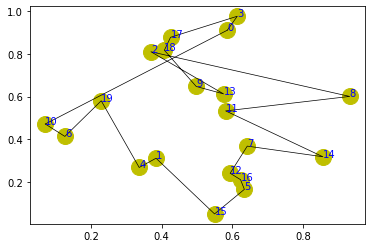

step:420/5000, actic loss:-2.688, critic loss:2.082, L:6.876, 0min3sec
step:421/5000, actic loss:-2.681, critic loss:2.078, L:6.871, 0min3sec
step:422/5000, actic loss:-2.676, critic loss:2.073, L:6.867, 0min2sec
step:423/5000, actic loss:-2.670, critic loss:2.069, L:6.863, 0min2sec
step:424/5000, actic loss:-2.662, critic loss:2.065, L:6.859, 0min2sec
distance:4.756
tensor([ 0,  9,  1, 11, 16, 14,  7, 19, 17,  5, 10,  6,  3, 18, 15,  2,  4,  8,
        12, 13])


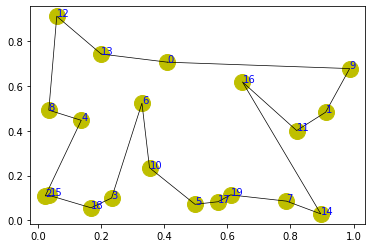

step:425/5000, actic loss:-2.655, critic loss:2.061, L:6.855, 0min3sec
step:426/5000, actic loss:-2.648, critic loss:2.058, L:6.851, 0min2sec
step:427/5000, actic loss:-2.644, critic loss:2.054, L:6.847, 0min3sec
step:428/5000, actic loss:-2.640, critic loss:2.050, L:6.843, 0min2sec
step:429/5000, actic loss:-2.635, critic loss:2.046, L:6.839, 0min2sec
distance:4.584
tensor([ 5,  2, 17,  4,  9, 15, 11, 13, 12,  3, 18, 14,  1,  7, 10, 19,  0,  6,
        16,  8])


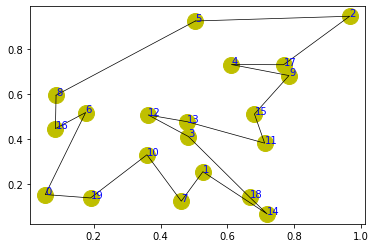

step:430/5000, actic loss:-2.627, critic loss:2.042, L:6.834, 0min4sec
step:431/5000, actic loss:-2.619, critic loss:2.039, L:6.830, 0min3sec
step:432/5000, actic loss:-2.612, critic loss:2.035, L:6.825, 0min2sec
step:433/5000, actic loss:-2.607, critic loss:2.031, L:6.821, 0min3sec
step:434/5000, actic loss:-2.602, critic loss:2.027, L:6.816, 0min3sec
distance:4.162
tensor([12,  2, 15,  9,  1, 16, 13, 18,  7,  4, 19,  6,  5,  0, 14,  8, 11, 10,
        17,  3])


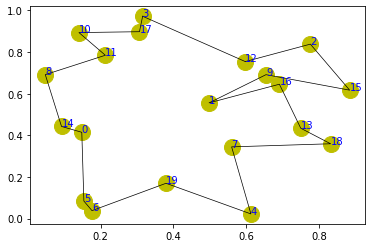

step:435/5000, actic loss:-2.597, critic loss:2.023, L:6.812, 0min3sec
step:436/5000, actic loss:-2.589, critic loss:2.019, L:6.807, 0min2sec
step:437/5000, actic loss:-2.582, critic loss:2.015, L:6.803, 0min2sec
step:438/5000, actic loss:-2.576, critic loss:2.012, L:6.798, 0min4sec
step:439/5000, actic loss:-2.573, critic loss:2.008, L:6.794, 0min3sec
distance:5.372
tensor([ 2, 14, 15, 17, 10,  7,  0, 16, 13,  1,  5,  9, 19, 18,  4, 12,  6,  3,
         8, 11])


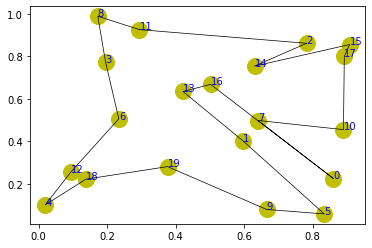

step:440/5000, actic loss:-2.569, critic loss:2.005, L:6.790, 0min3sec
step:441/5000, actic loss:-2.566, critic loss:2.002, L:6.786, 0min3sec
step:442/5000, actic loss:-2.562, critic loss:1.998, L:6.782, 0min3sec
step:443/5000, actic loss:-2.555, critic loss:1.995, L:6.778, 0min3sec
step:444/5000, actic loss:-2.548, critic loss:1.992, L:6.775, 0min3sec
distance:4.468
tensor([ 8,  0,  5,  6, 16, 14,  1,  4, 10, 17, 18, 13,  3,  9,  7, 19,  2, 12,
        15, 11])


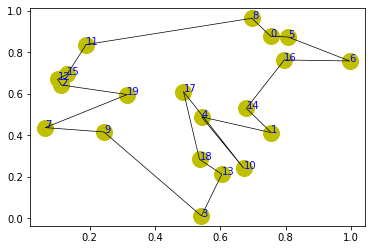

step:445/5000, actic loss:-2.540, critic loss:1.989, L:6.772, 0min3sec
step:446/5000, actic loss:-2.534, critic loss:1.986, L:6.769, 0min2sec
step:447/5000, actic loss:-2.529, critic loss:1.984, L:6.765, 0min5sec
step:448/5000, actic loss:-2.526, critic loss:1.980, L:6.762, 0min4sec
step:449/5000, actic loss:-2.522, critic loss:1.978, L:6.759, 0min3sec
distance:7.041
tensor([ 8, 14,  0,  3,  4,  1,  5, 12, 10,  9, 17, 16, 11,  6, 15,  2,  7, 19,
        13, 18])


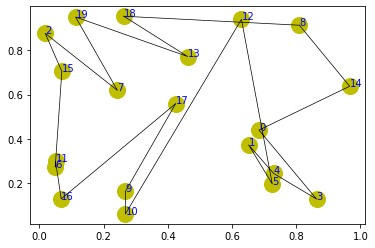

step:450/5000, actic loss:-2.517, critic loss:1.975, L:6.756, 0min5sec
step:451/5000, actic loss:-2.509, critic loss:1.972, L:6.754, 0min3sec
step:452/5000, actic loss:-2.501, critic loss:1.970, L:6.751, 0min3sec
step:453/5000, actic loss:-2.490, critic loss:1.967, L:6.747, 0min4sec
step:454/5000, actic loss:-2.482, critic loss:1.965, L:6.745, 0min3sec
distance:5.446
tensor([13, 10, 11, 18, 14, 16,  4,  8, 15, 19, 12,  1,  3, 17,  0,  2,  9,  6,
         7,  5])


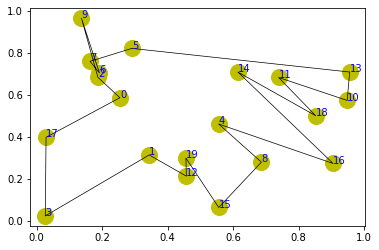

step:455/5000, actic loss:-2.476, critic loss:1.962, L:6.742, 0min5sec
step:456/5000, actic loss:-2.473, critic loss:1.959, L:6.738, 0min5sec
step:457/5000, actic loss:-2.471, critic loss:1.957, L:6.735, 0min4sec
step:458/5000, actic loss:-2.471, critic loss:1.954, L:6.732, 0min4sec
step:459/5000, actic loss:-2.468, critic loss:1.951, L:6.729, 0min4sec
distance:5.827
tensor([ 5, 12,  8, 18, 14,  3,  6,  1, 16,  0, 10, 13, 19,  7, 17,  9,  2, 11,
        15,  4])


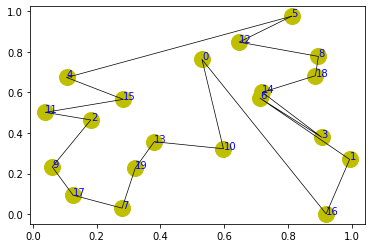

step:460/5000, actic loss:-2.463, critic loss:1.948, L:6.725, 0min4sec
step:461/5000, actic loss:-2.454, critic loss:1.946, L:6.722, 0min4sec
step:462/5000, actic loss:-2.445, critic loss:1.943, L:6.718, 0min4sec
step:463/5000, actic loss:-2.435, critic loss:1.941, L:6.715, 0min4sec
step:464/5000, actic loss:-2.426, critic loss:1.938, L:6.711, 0min4sec
distance:4.302
tensor([ 0,  8, 10, 16, 19,  4, 11,  7,  6,  5,  3, 17, 14, 13, 12,  9, 15, 18,
         2,  1])


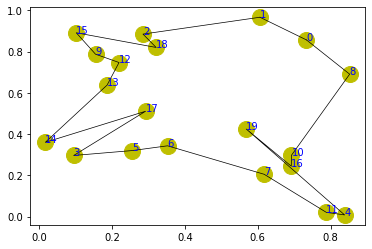

step:465/5000, actic loss:-2.419, critic loss:1.935, L:6.708, 0min4sec
step:466/5000, actic loss:-2.415, critic loss:1.932, L:6.704, 0min3sec
step:467/5000, actic loss:-2.412, critic loss:1.929, L:6.700, 0min5sec
step:468/5000, actic loss:-2.414, critic loss:1.927, L:6.697, 0min5sec
step:469/5000, actic loss:-2.417, critic loss:1.925, L:6.694, 0min2sec
distance:5.459
tensor([ 1,  4, 18,  6,  7,  8,  0, 15, 17, 16,  3, 11, 14, 13,  2, 19, 10, 12,
         9,  5])


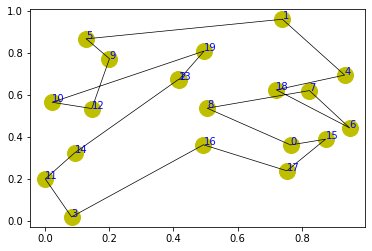

step:470/5000, actic loss:-2.417, critic loss:1.922, L:6.691, 0min3sec
step:471/5000, actic loss:-2.409, critic loss:1.919, L:6.688, 0min3sec
step:472/5000, actic loss:-2.397, critic loss:1.917, L:6.684, 0min3sec
step:473/5000, actic loss:-2.385, critic loss:1.915, L:6.681, 0min4sec
step:474/5000, actic loss:-2.373, critic loss:1.912, L:6.677, 0min4sec
distance:4.462
tensor([16, 14, 19,  9, 10, 17, 11,  4, 13,  6,  3,  8, 15,  2,  0,  7,  1, 18,
         5, 12])


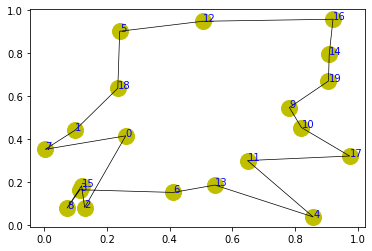

step:475/5000, actic loss:-2.366, critic loss:1.909, L:6.674, 0min4sec
step:476/5000, actic loss:-2.364, critic loss:1.906, L:6.670, 0min3sec
step:477/5000, actic loss:-2.363, critic loss:1.903, L:6.667, 0min3sec
step:478/5000, actic loss:-2.364, critic loss:1.900, L:6.663, 0min0sec
step:479/5000, actic loss:-2.364, critic loss:1.898, L:6.660, 0min0sec
distance:5.180
tensor([14,  5, 17,  8,  4,  7,  2,  6, 12, 19,  1, 13, 16, 11, 10,  3,  9, 15,
        18,  0])


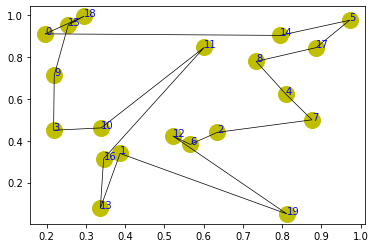

step:480/5000, actic loss:-2.359, critic loss:1.895, L:6.657, 0min3sec
step:481/5000, actic loss:-2.352, critic loss:1.892, L:6.654, 0min0sec
step:482/5000, actic loss:-2.345, critic loss:1.889, L:6.650, 0min0sec
step:483/5000, actic loss:-2.338, critic loss:1.886, L:6.647, 0min1sec
step:484/5000, actic loss:-2.334, critic loss:1.883, L:6.643, 0min0sec
distance:6.055
tensor([ 5, 18, 13, 11, 15, 10, 14,  0,  8,  9, 12,  6,  7,  2, 16,  4, 17,  3,
         1, 19])


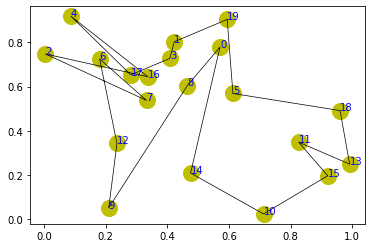

step:485/5000, actic loss:-2.332, critic loss:1.881, L:6.640, 0min1sec
step:486/5000, actic loss:-2.329, critic loss:1.878, L:6.637, 0min1sec
step:487/5000, actic loss:-2.326, critic loss:1.875, L:6.633, 0min1sec
step:488/5000, actic loss:-2.321, critic loss:1.872, L:6.630, 0min1sec
step:489/5000, actic loss:-2.315, critic loss:1.870, L:6.627, 0min1sec
distance:5.646
tensor([12,  4,  0, 17,  3, 19, 14,  1, 16, 10,  6,  5,  9, 11,  2, 15, 13, 18,
         8,  7])


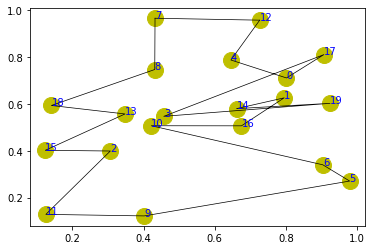

step:490/5000, actic loss:-2.310, critic loss:1.867, L:6.624, 0min1sec
step:491/5000, actic loss:-2.305, critic loss:1.864, L:6.621, 0min1sec
step:492/5000, actic loss:-2.302, critic loss:1.862, L:6.618, 0min0sec
step:493/5000, actic loss:-2.300, critic loss:1.859, L:6.614, 0min1sec
step:494/5000, actic loss:-2.297, critic loss:1.857, L:6.611, 0min1sec
distance:5.946
tensor([13, 12,  2,  7,  9,  3, 17, 11,  6, 14, 16, 10,  0,  5, 19,  8, 18, 15,
         1,  4])


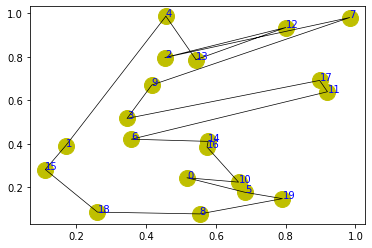

step:495/5000, actic loss:-2.294, critic loss:1.854, L:6.608, 0min1sec
step:496/5000, actic loss:-2.290, critic loss:1.851, L:6.605, 0min0sec
step:497/5000, actic loss:-2.288, critic loss:1.849, L:6.602, 0min0sec
step:498/5000, actic loss:-2.285, critic loss:1.846, L:6.600, 0min1sec
step:499/5000, actic loss:-2.280, critic loss:1.844, L:6.596, 0min0sec
distance:4.354
tensor([ 7, 17,  5, 13,  2,  3, 16,  0,  9,  1, 10, 19,  4,  8, 11, 15,  6, 12,
        18, 14])


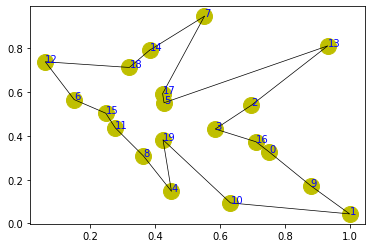

step:500/5000, actic loss:-2.273, critic loss:1.841, L:6.593, 0min1sec
step:501/5000, actic loss:-2.269, critic loss:1.838, L:6.589, 0min0sec
step:502/5000, actic loss:-2.267, critic loss:1.835, L:6.586, 0min1sec
step:503/5000, actic loss:-2.265, critic loss:1.832, L:6.582, 0min0sec
step:504/5000, actic loss:-2.263, critic loss:1.830, L:6.578, 0min1sec
distance:4.211
tensor([10,  0,  6, 13,  2,  3, 12,  7,  8,  4, 19,  5,  1,  9, 16, 18, 17, 14,
        11, 15])


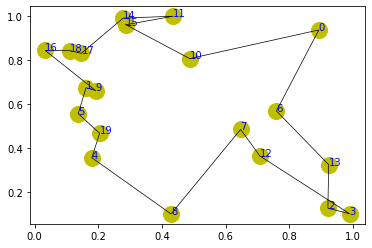

step:505/5000, actic loss:-2.259, critic loss:1.827, L:6.575, 0min1sec
step:506/5000, actic loss:-2.254, critic loss:1.824, L:6.571, 0min1sec
step:507/5000, actic loss:-2.247, critic loss:1.821, L:6.568, 0min0sec
step:508/5000, actic loss:-2.240, critic loss:1.818, L:6.564, 0min0sec
step:509/5000, actic loss:-2.237, critic loss:1.815, L:6.561, 0min1sec
distance:4.952
tensor([19, 17,  0,  4,  5,  7, 11,  6,  1,  2, 15, 13,  8, 10, 16, 14,  3,  9,
        18, 12])


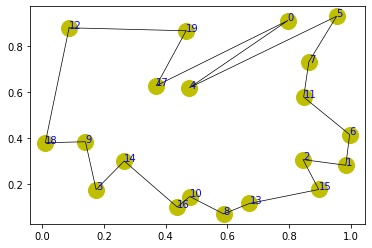

step:510/5000, actic loss:-2.233, critic loss:1.812, L:6.557, 0min2sec
step:511/5000, actic loss:-2.231, critic loss:1.809, L:6.553, 0min0sec
step:512/5000, actic loss:-2.228, critic loss:1.806, L:6.549, 0min1sec
step:513/5000, actic loss:-2.224, critic loss:1.803, L:6.546, 0min1sec
step:514/5000, actic loss:-2.220, critic loss:1.800, L:6.543, 0min1sec
distance:4.732
tensor([15, 11,  7, 12, 10,  9,  3, 13,  0, 17,  8, 18,  5, 14,  2,  6,  1,  4,
        16, 19])


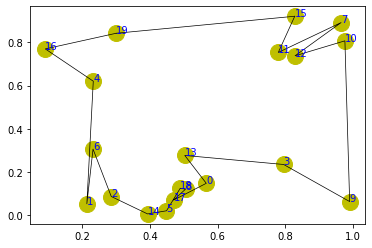

step:515/5000, actic loss:-2.217, critic loss:1.798, L:6.539, 0min1sec
step:516/5000, actic loss:-2.214, critic loss:1.795, L:6.536, 0min1sec
step:517/5000, actic loss:-2.210, critic loss:1.792, L:6.532, 0min0sec
step:518/5000, actic loss:-2.207, critic loss:1.789, L:6.528, 0min0sec
step:519/5000, actic loss:-2.202, critic loss:1.786, L:6.525, 0min0sec
distance:6.141
tensor([ 4,  0, 19,  1,  7, 15, 10, 12,  3,  8,  2, 11, 13, 17,  9, 14,  5, 18,
        16,  6])


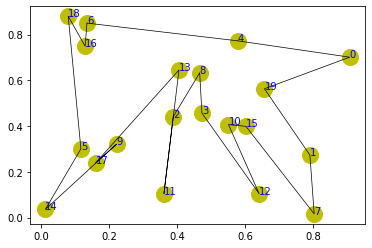

step:520/5000, actic loss:-2.197, critic loss:1.783, L:6.521, 0min1sec
step:521/5000, actic loss:-2.192, critic loss:1.781, L:6.518, 0min0sec
step:522/5000, actic loss:-2.191, critic loss:1.778, L:6.514, 0min1sec
step:523/5000, actic loss:-2.189, critic loss:1.775, L:6.510, 0min1sec
step:524/5000, actic loss:-2.187, critic loss:1.772, L:6.507, 0min0sec
distance:3.479
tensor([ 3,  7, 11,  2,  8, 19,  9, 15, 10, 13, 16,  1,  0,  6, 14, 17,  5, 18,
        12,  4])


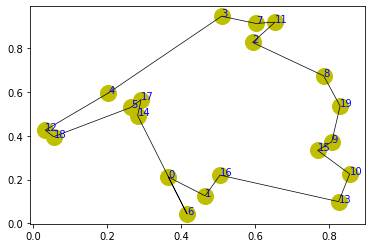

step:525/5000, actic loss:-2.184, critic loss:1.769, L:6.503, 0min1sec
step:526/5000, actic loss:-2.179, critic loss:1.767, L:6.499, 0min0sec
step:527/5000, actic loss:-2.173, critic loss:1.764, L:6.496, 0min1sec
step:528/5000, actic loss:-2.167, critic loss:1.761, L:6.492, 0min0sec
step:529/5000, actic loss:-2.162, critic loss:1.759, L:6.489, 0min0sec
distance:4.948
tensor([15,  0,  8, 11,  2, 18, 13, 10,  7,  5,  6,  1, 17,  3,  9, 19, 12, 14,
        16,  4])


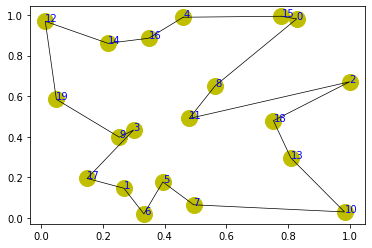

step:530/5000, actic loss:-2.160, critic loss:1.756, L:6.485, 0min1sec
step:531/5000, actic loss:-2.157, critic loss:1.753, L:6.482, 0min1sec
step:532/5000, actic loss:-2.155, critic loss:1.750, L:6.478, 0min1sec
step:533/5000, actic loss:-2.151, critic loss:1.748, L:6.475, 0min1sec
step:534/5000, actic loss:-2.147, critic loss:1.745, L:6.471, 0min0sec
distance:4.450
tensor([ 2, 17,  7, 14, 16, 11, 13, 10, 15,  0,  6,  3, 12,  1, 18, 19,  5,  9,
         4,  8])


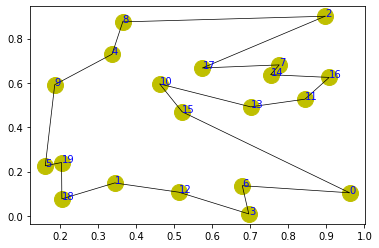

step:535/5000, actic loss:-2.144, critic loss:1.742, L:6.468, 0min1sec
step:536/5000, actic loss:-2.140, critic loss:1.739, L:6.464, 0min1sec
step:537/5000, actic loss:-2.135, critic loss:1.737, L:6.461, 0min1sec
step:538/5000, actic loss:-2.130, critic loss:1.734, L:6.458, 0min1sec
step:539/5000, actic loss:-2.125, critic loss:1.731, L:6.454, 0min1sec
distance:4.800
tensor([10,  2, 16,  5,  0,  4,  3,  7, 14, 19,  1, 17, 11,  6, 15, 13, 12,  9,
        18,  8])


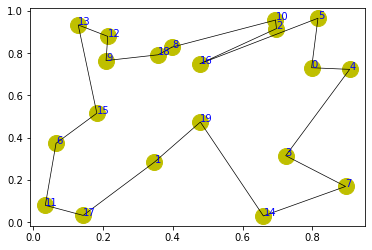

step:540/5000, actic loss:-2.122, critic loss:1.729, L:6.450, 0min1sec
step:541/5000, actic loss:-2.119, critic loss:1.726, L:6.447, 0min1sec
step:542/5000, actic loss:-2.117, critic loss:1.723, L:6.443, 0min1sec
step:543/5000, actic loss:-2.113, critic loss:1.721, L:6.440, 0min1sec
step:544/5000, actic loss:-2.109, critic loss:1.718, L:6.436, 0min1sec
distance:4.125
tensor([16,  0,  4, 10, 13,  3,  8,  6, 14,  7,  5, 15,  9, 18, 11,  2, 17, 19,
        12,  1])


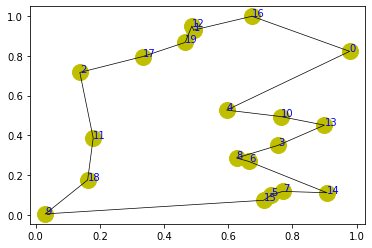

step:545/5000, actic loss:-2.105, critic loss:1.715, L:6.433, 0min1sec
step:546/5000, actic loss:-2.102, critic loss:1.712, L:6.429, 0min1sec
step:547/5000, actic loss:-2.099, critic loss:1.710, L:6.426, 0min1sec
step:548/5000, actic loss:-2.095, critic loss:1.707, L:6.423, 0min1sec
step:549/5000, actic loss:-2.090, critic loss:1.705, L:6.419, 0min1sec
distance:4.456
tensor([ 8, 10, 12, 19, 18,  5,  1, 16,  4, 15,  6,  2, 17,  9,  0,  7, 13, 14,
        11,  3])


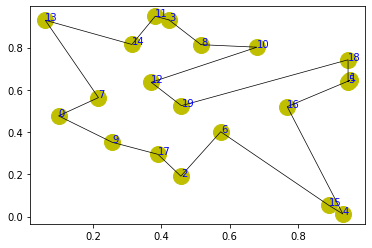

step:550/5000, actic loss:-2.086, critic loss:1.702, L:6.416, 0min1sec
step:551/5000, actic loss:-2.085, critic loss:1.699, L:6.412, 0min1sec
step:552/5000, actic loss:-2.084, critic loss:1.697, L:6.408, 0min1sec
step:553/5000, actic loss:-2.084, critic loss:1.694, L:6.405, 0min1sec
step:554/5000, actic loss:-2.082, critic loss:1.692, L:6.402, 0min1sec
distance:4.585
tensor([12,  5,  7,  6,  2,  8,  0, 16, 15,  1,  3, 13, 19, 14, 11,  9,  4, 18,
        10, 17])


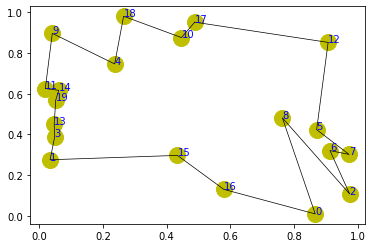

step:555/5000, actic loss:-2.077, critic loss:1.689, L:6.398, 0min1sec
step:556/5000, actic loss:-2.072, critic loss:1.687, L:6.394, 0min1sec
step:557/5000, actic loss:-2.067, critic loss:1.684, L:6.391, 0min1sec
step:558/5000, actic loss:-2.062, critic loss:1.682, L:6.387, 0min1sec
step:559/5000, actic loss:-2.061, critic loss:1.679, L:6.384, 0min1sec
distance:4.710
tensor([ 4, 14, 18,  3, 11, 17,  6,  8,  7, 15, 10,  9,  5,  1, 12,  2, 13, 16,
        19,  0])


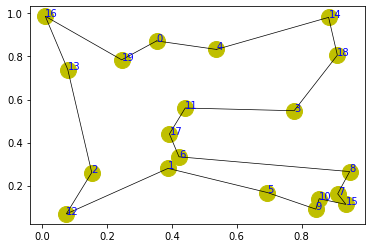

step:560/5000, actic loss:-2.060, critic loss:1.677, L:6.380, 0min1sec
step:561/5000, actic loss:-2.058, critic loss:1.674, L:6.377, 0min1sec
step:562/5000, actic loss:-2.056, critic loss:1.671, L:6.373, 0min1sec
step:563/5000, actic loss:-2.052, critic loss:1.669, L:6.370, 0min1sec
step:564/5000, actic loss:-2.046, critic loss:1.666, L:6.367, 0min1sec
distance:4.353
tensor([19, 11, 12,  3,  6, 13, 16, 15,  0,  9,  8,  2,  5, 17, 10,  1, 14, 18,
         7,  4])


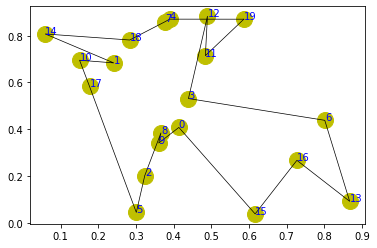

step:565/5000, actic loss:-2.041, critic loss:1.664, L:6.363, 0min1sec
step:566/5000, actic loss:-2.037, critic loss:1.661, L:6.360, 0min1sec
step:567/5000, actic loss:-2.036, critic loss:1.659, L:6.356, 0min1sec
step:568/5000, actic loss:-2.034, critic loss:1.656, L:6.353, 0min1sec
step:569/5000, actic loss:-2.033, critic loss:1.654, L:6.350, 0min1sec
distance:4.310
tensor([11, 16, 13,  3, 17,  8,  7,  4,  1,  6,  2,  0, 12,  9, 10, 14, 18, 19,
         5, 15])


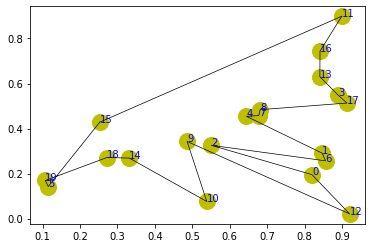

step:570/5000, actic loss:-2.031, critic loss:1.652, L:6.346, 0min1sec
step:571/5000, actic loss:-2.027, critic loss:1.649, L:6.343, 0min1sec
step:572/5000, actic loss:-2.022, critic loss:1.647, L:6.340, 0min1sec
step:573/5000, actic loss:-2.018, critic loss:1.644, L:6.337, 0min1sec
step:574/5000, actic loss:-2.015, critic loss:1.642, L:6.334, 0min1sec
distance:4.402
tensor([ 7,  4, 16, 11, 14,  1,  0, 13, 15, 18, 12,  5,  8,  3, 19,  6,  2,  9,
        10, 17])


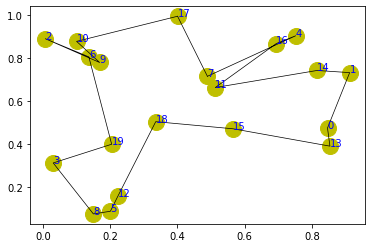

step:575/5000, actic loss:-2.013, critic loss:1.639, L:6.330, 0min1sec
step:576/5000, actic loss:-2.012, critic loss:1.637, L:6.328, 0min1sec
step:577/5000, actic loss:-2.009, critic loss:1.635, L:6.325, 0min1sec
step:578/5000, actic loss:-2.004, critic loss:1.632, L:6.321, 0min1sec
step:579/5000, actic loss:-2.000, critic loss:1.630, L:6.318, 0min1sec
distance:4.454
tensor([19,  2, 10, 16,  9,  8, 13, 17,  4,  0,  3,  5,  1, 11, 12, 15,  6,  7,
        18, 14])


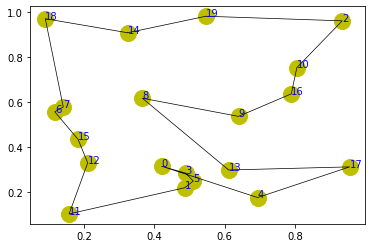

step:580/5000, actic loss:-1.997, critic loss:1.628, L:6.315, 0min1sec
step:581/5000, actic loss:-1.995, critic loss:1.625, L:6.312, 0min1sec
step:582/5000, actic loss:-1.994, critic loss:1.623, L:6.309, 0min1sec
step:583/5000, actic loss:-1.992, critic loss:1.621, L:6.306, 0min1sec
step:584/5000, actic loss:-1.989, critic loss:1.618, L:6.303, 0min1sec
distance:4.632
tensor([ 4,  1,  3,  0, 13, 11, 10, 15, 18, 19,  6, 16, 17,  7,  8, 14, 12,  5,
         2,  9])


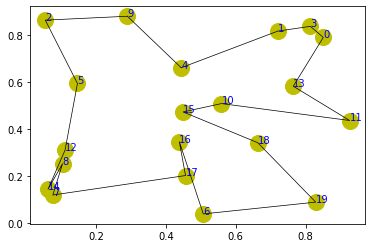

step:585/5000, actic loss:-1.984, critic loss:1.616, L:6.300, 0min1sec
step:586/5000, actic loss:-1.980, critic loss:1.614, L:6.297, 0min1sec
step:587/5000, actic loss:-1.974, critic loss:1.612, L:6.294, 0min1sec
step:588/5000, actic loss:-1.969, critic loss:1.610, L:6.291, 0min1sec
step:589/5000, actic loss:-1.965, critic loss:1.607, L:6.288, 0min1sec
distance:4.290
tensor([ 0, 11,  7,  1, 19,  6, 18,  3,  9, 15, 10, 13,  8, 12,  2,  4, 17, 16,
         5, 14])


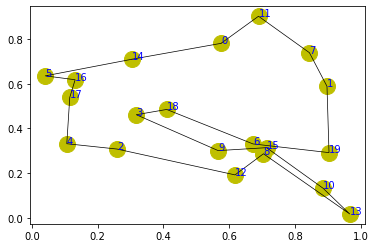

step:590/5000, actic loss:-1.964, critic loss:1.605, L:6.284, 0min1sec
step:591/5000, actic loss:-1.963, critic loss:1.603, L:6.281, 0min1sec
step:592/5000, actic loss:-1.962, critic loss:1.601, L:6.278, 0min1sec
step:593/5000, actic loss:-1.961, critic loss:1.599, L:6.275, 0min1sec
step:594/5000, actic loss:-1.959, critic loss:1.597, L:6.272, 0min1sec
distance:4.821
tensor([ 9,  4,  1, 18, 16,  7, 12,  0, 15,  8, 19,  2, 13,  5, 17,  3, 10,  6,
        14, 11])


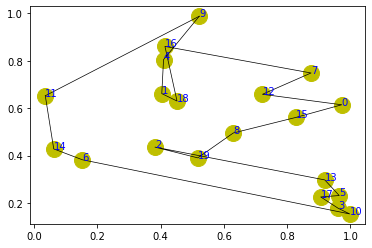

step:595/5000, actic loss:-1.955, critic loss:1.594, L:6.269, 0min1sec
step:596/5000, actic loss:-1.951, critic loss:1.592, L:6.266, 0min1sec
step:597/5000, actic loss:-1.947, critic loss:1.590, L:6.263, 0min1sec
step:598/5000, actic loss:-1.944, critic loss:1.588, L:6.260, 0min1sec
step:599/5000, actic loss:-1.942, critic loss:1.586, L:6.257, 0min1sec
distance:3.377
tensor([ 2,  7,  3,  4, 17, 13,  8,  6, 18, 15,  5, 14,  1, 16, 12, 11, 19,  9,
         0, 10])


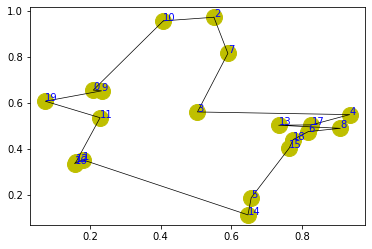

step:600/5000, actic loss:-1.939, critic loss:1.583, L:6.254, 0min2sec
step:601/5000, actic loss:-1.936, critic loss:1.581, L:6.251, 0min1sec
step:602/5000, actic loss:-1.932, critic loss:1.579, L:6.248, 0min1sec
step:603/5000, actic loss:-1.928, critic loss:1.577, L:6.246, 0min1sec
step:604/5000, actic loss:-1.924, critic loss:1.575, L:6.243, 0min1sec
distance:4.354
tensor([ 3, 13, 18, 15, 14, 19, 17,  1,  9,  6,  8, 10,  2,  5,  4, 16,  0,  7,
        11, 12])


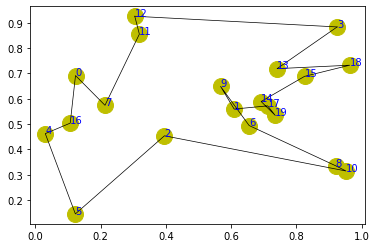

step:605/5000, actic loss:-1.921, critic loss:1.572, L:6.240, 0min1sec
step:606/5000, actic loss:-1.919, critic loss:1.570, L:6.237, 0min1sec
step:607/5000, actic loss:-1.918, critic loss:1.568, L:6.234, 0min1sec
step:608/5000, actic loss:-1.917, critic loss:1.566, L:6.231, 0min1sec
step:609/5000, actic loss:-1.914, critic loss:1.564, L:6.228, 0min1sec
distance:4.041
tensor([15, 12, 11,  3, 19,  0,  1, 16, 18,  2,  7,  6,  5, 17, 13, 14, 10,  4,
         8,  9])


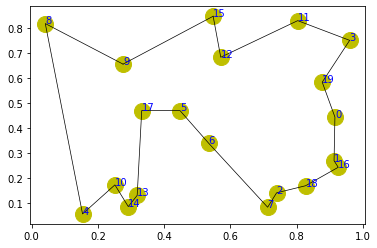

step:610/5000, actic loss:-1.911, critic loss:1.562, L:6.225, 0min1sec
step:611/5000, actic loss:-1.906, critic loss:1.560, L:6.223, 0min1sec
step:612/5000, actic loss:-1.902, critic loss:1.557, L:6.220, 0min1sec
step:613/5000, actic loss:-1.898, critic loss:1.555, L:6.217, 0min1sec
step:614/5000, actic loss:-1.896, critic loss:1.553, L:6.214, 0min1sec
distance:4.236
tensor([ 5,  2,  0, 13, 12, 14,  6, 10, 11,  4, 17,  8, 15,  3, 19,  7,  9, 16,
        18,  1])


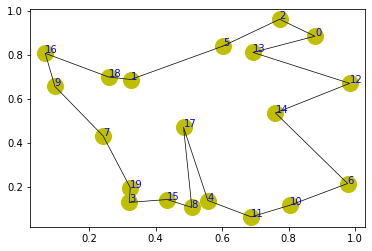

step:615/5000, actic loss:-1.894, critic loss:1.551, L:6.211, 0min2sec
step:616/5000, actic loss:-1.892, critic loss:1.549, L:6.208, 0min1sec
step:617/5000, actic loss:-1.889, critic loss:1.547, L:6.206, 0min1sec
step:618/5000, actic loss:-1.885, critic loss:1.545, L:6.203, 0min1sec
step:619/5000, actic loss:-1.881, critic loss:1.543, L:6.200, 0min1sec
distance:5.005
tensor([17, 15, 10,  9, 19,  1,  7, 14, 18, 12,  6,  0,  5,  8,  4,  3, 16,  2,
        13, 11])


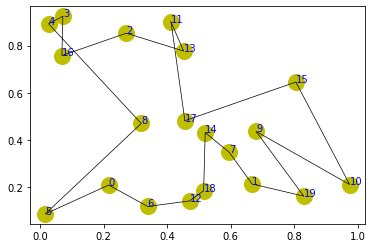

step:620/5000, actic loss:-1.876, critic loss:1.541, L:6.197, 0min2sec
step:621/5000, actic loss:-1.872, critic loss:1.539, L:6.194, 0min1sec
step:622/5000, actic loss:-1.869, critic loss:1.537, L:6.191, 0min1sec
step:623/5000, actic loss:-1.867, critic loss:1.535, L:6.188, 0min1sec
step:624/5000, actic loss:-1.865, critic loss:1.533, L:6.186, 0min1sec
distance:5.179
tensor([ 5,  2, 15, 11, 18,  4, 17,  1,  0, 13, 16,  6,  9,  8, 12, 19, 10,  7,
        14,  3])


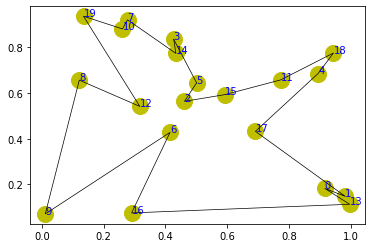

step:625/5000, actic loss:-1.862, critic loss:1.530, L:6.183, 0min1sec
step:626/5000, actic loss:-1.859, critic loss:1.528, L:6.180, 0min1sec
step:627/5000, actic loss:-1.857, critic loss:1.526, L:6.177, 0min1sec
step:628/5000, actic loss:-1.855, critic loss:1.524, L:6.174, 0min1sec
step:629/5000, actic loss:-1.852, critic loss:1.522, L:6.172, 0min1sec
distance:4.536
tensor([10,  8,  0,  3,  5,  4,  9,  7, 14, 12, 17,  6,  1, 18, 15, 11, 19, 16,
        13,  2])


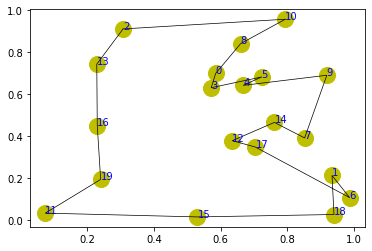

step:630/5000, actic loss:-1.848, critic loss:1.520, L:6.169, 0min2sec
step:631/5000, actic loss:-1.846, critic loss:1.518, L:6.166, 0min1sec
step:632/5000, actic loss:-1.843, critic loss:1.516, L:6.164, 0min1sec
step:633/5000, actic loss:-1.840, critic loss:1.514, L:6.161, 0min1sec
step:634/5000, actic loss:-1.836, critic loss:1.512, L:6.158, 0min1sec
distance:4.293
tensor([13, 19,  5, 15,  3,  6, 11,  1, 14,  8, 16,  4, 10, 18,  0,  7,  2,  9,
        17, 12])


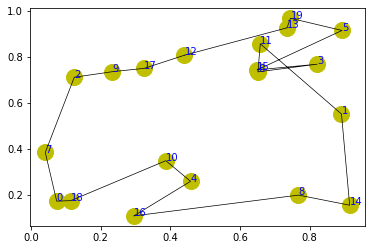

step:635/5000, actic loss:-1.834, critic loss:1.510, L:6.156, 0min1sec
step:636/5000, actic loss:-1.832, critic loss:1.508, L:6.153, 0min1sec
step:637/5000, actic loss:-1.829, critic loss:1.506, L:6.151, 0min1sec
step:638/5000, actic loss:-1.826, critic loss:1.504, L:6.148, 0min1sec
step:639/5000, actic loss:-1.824, critic loss:1.502, L:6.146, 0min1sec
distance:4.485
tensor([13, 19, 10, 15,  6, 18, 17, 11, 12,  7, 16,  4,  2,  3,  8,  0,  1,  9,
         5, 14])


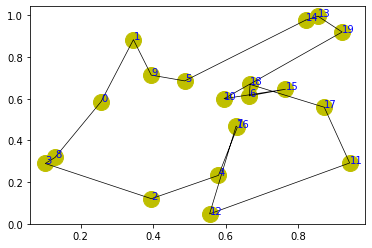

step:640/5000, actic loss:-1.822, critic loss:1.500, L:6.143, 0min1sec
step:641/5000, actic loss:-1.819, critic loss:1.498, L:6.140, 0min1sec
step:642/5000, actic loss:-1.817, critic loss:1.496, L:6.138, 0min1sec
step:643/5000, actic loss:-1.814, critic loss:1.494, L:6.135, 0min1sec
step:644/5000, actic loss:-1.812, critic loss:1.493, L:6.133, 0min1sec
distance:4.995
tensor([ 1, 10, 12, 18, 19,  8, 11,  9,  5,  6, 17,  4,  0,  3, 14, 15, 16, 13,
         2,  7])


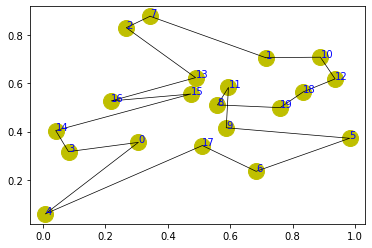

step:645/5000, actic loss:-1.810, critic loss:1.491, L:6.131, 0min1sec
step:646/5000, actic loss:-1.808, critic loss:1.489, L:6.128, 0min1sec
step:647/5000, actic loss:-1.804, critic loss:1.487, L:6.126, 0min1sec
step:648/5000, actic loss:-1.800, critic loss:1.485, L:6.123, 0min1sec
step:649/5000, actic loss:-1.796, critic loss:1.484, L:6.121, 0min1sec
distance:3.936
tensor([14,  1,  4, 12,  6,  3, 11, 16,  7, 19,  2, 15,  9,  5, 17, 10, 13, 18,
         8,  0])


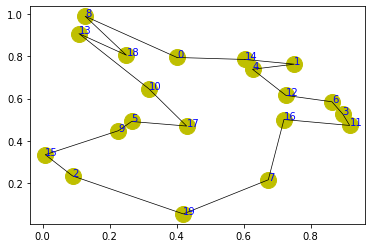

step:650/5000, actic loss:-1.793, critic loss:1.482, L:6.118, 0min2sec
step:651/5000, actic loss:-1.791, critic loss:1.480, L:6.116, 0min2sec
step:652/5000, actic loss:-1.791, critic loss:1.478, L:6.113, 0min1sec
step:653/5000, actic loss:-1.790, critic loss:1.477, L:6.111, 0min2sec
step:654/5000, actic loss:-1.788, critic loss:1.475, L:6.108, 0min1sec
distance:4.231
tensor([ 6, 16, 14,  2, 13, 18, 10,  9,  4,  5, 12, 15,  7,  8, 19,  0, 11,  1,
         3, 17])


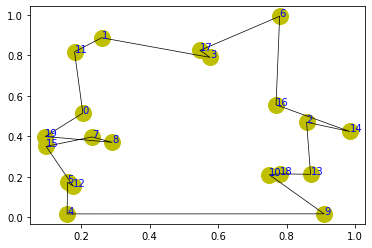

step:655/5000, actic loss:-1.786, critic loss:1.473, L:6.106, 0min2sec
step:656/5000, actic loss:-1.782, critic loss:1.471, L:6.103, 0min1sec
step:657/5000, actic loss:-1.776, critic loss:1.470, L:6.101, 0min1sec
step:658/5000, actic loss:-1.772, critic loss:1.468, L:6.098, 0min1sec
step:659/5000, actic loss:-1.767, critic loss:1.467, L:6.096, 0min1sec
distance:4.215
tensor([ 1, 10,  5, 11, 14,  7, 19, 15,  3, 17,  0, 12,  2,  6,  8, 16, 13,  4,
        18,  9])


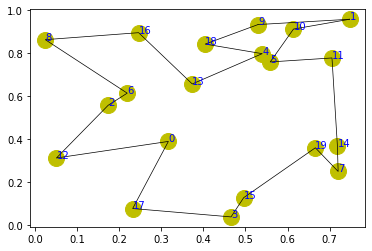

step:660/5000, actic loss:-1.763, critic loss:1.465, L:6.093, 0min2sec
step:661/5000, actic loss:-1.761, critic loss:1.463, L:6.091, 0min1sec
step:662/5000, actic loss:-1.760, critic loss:1.461, L:6.088, 0min1sec
step:663/5000, actic loss:-1.758, critic loss:1.459, L:6.086, 0min1sec
step:664/5000, actic loss:-1.756, critic loss:1.457, L:6.083, 0min1sec
distance:4.876
tensor([14,  7, 12,  1, 10, 19,  5,  3, 13,  4,  2, 16, 11,  9,  6, 15, 17,  0,
         8, 18])


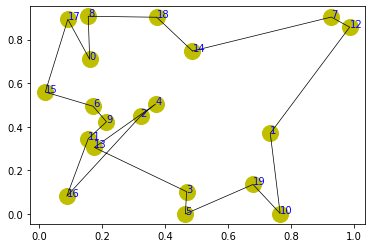

step:665/5000, actic loss:-1.753, critic loss:1.456, L:6.080, 0min2sec
step:666/5000, actic loss:-1.750, critic loss:1.454, L:6.078, 0min1sec
step:667/5000, actic loss:-1.746, critic loss:1.452, L:6.075, 0min1sec
step:668/5000, actic loss:-1.742, critic loss:1.450, L:6.073, 0min1sec
step:669/5000, actic loss:-1.739, critic loss:1.448, L:6.071, 0min1sec
distance:5.034
tensor([11,  9, 15, 10, 16,  5,  2,  4,  8, 19,  0, 17,  3, 13,  6, 12, 14,  7,
        18,  1])


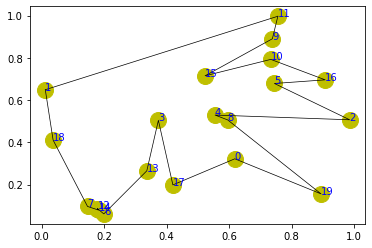

step:670/5000, actic loss:-1.738, critic loss:1.446, L:6.068, 0min2sec
step:671/5000, actic loss:-1.737, critic loss:1.445, L:6.066, 0min1sec
step:672/5000, actic loss:-1.735, critic loss:1.443, L:6.063, 0min2sec
step:673/5000, actic loss:-1.734, critic loss:1.441, L:6.061, 0min2sec
step:674/5000, actic loss:-1.731, critic loss:1.439, L:6.058, 0min1sec
distance:4.439
tensor([15, 16,  9, 17,  0,  5,  7, 10,  3,  6, 13, 18, 19,  8,  1, 14, 12, 11,
         4,  2])


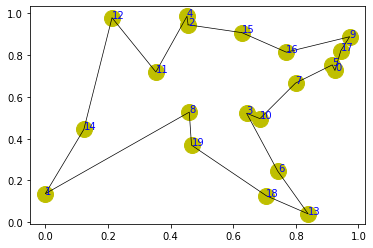

step:675/5000, actic loss:-1.727, critic loss:1.438, L:6.056, 0min2sec
step:676/5000, actic loss:-1.722, critic loss:1.436, L:6.054, 0min1sec
step:677/5000, actic loss:-1.718, critic loss:1.435, L:6.051, 0min2sec
step:678/5000, actic loss:-1.715, critic loss:1.433, L:6.049, 0min2sec
step:679/5000, actic loss:-1.712, critic loss:1.431, L:6.046, 0min1sec
distance:4.300
tensor([11, 15, 18,  2,  0,  1,  4, 14,  5,  7, 12, 16,  8, 13,  3,  6,  9, 19,
        10, 17])


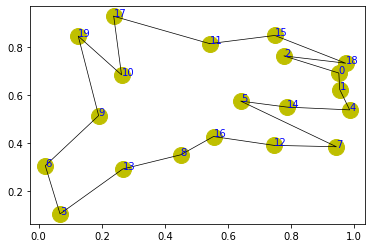

step:680/5000, actic loss:-1.711, critic loss:1.429, L:6.044, 0min2sec
step:681/5000, actic loss:-1.710, critic loss:1.428, L:6.042, 0min1sec
step:682/5000, actic loss:-1.709, critic loss:1.426, L:6.040, 0min2sec
step:683/5000, actic loss:-1.707, critic loss:1.424, L:6.037, 0min1sec
step:684/5000, actic loss:-1.704, critic loss:1.423, L:6.035, 0min2sec
distance:4.122
tensor([ 5, 12, 10, 11,  8,  9,  3,  6, 15, 18,  7,  2, 16, 13, 19,  1,  4, 17,
        14,  0])


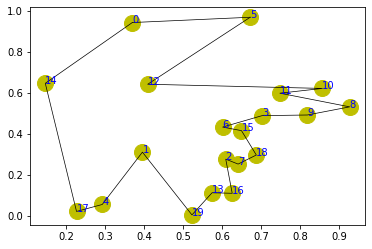

step:685/5000, actic loss:-1.701, critic loss:1.421, L:6.033, 0min2sec
step:686/5000, actic loss:-1.698, critic loss:1.419, L:6.030, 0min2sec
step:687/5000, actic loss:-1.695, critic loss:1.418, L:6.028, 0min2sec
step:688/5000, actic loss:-1.694, critic loss:1.416, L:6.026, 0min1sec
step:689/5000, actic loss:-1.692, critic loss:1.414, L:6.024, 0min2sec
distance:4.653
tensor([12, 17, 15,  8, 14, 13, 16,  0,  7,  3, 18, 11,  4,  5,  2,  1, 19,  6,
         9, 10])


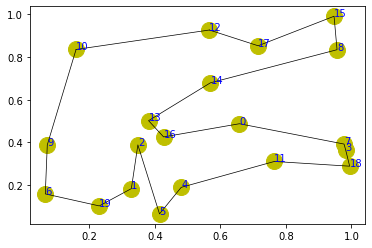

step:690/5000, actic loss:-1.691, critic loss:1.412, L:6.021, 0min2sec
step:691/5000, actic loss:-1.689, critic loss:1.411, L:6.019, 0min1sec
step:692/5000, actic loss:-1.685, critic loss:1.409, L:6.017, 0min1sec
step:693/5000, actic loss:-1.682, critic loss:1.407, L:6.015, 0min2sec
step:694/5000, actic loss:-1.678, critic loss:1.406, L:6.012, 0min2sec
distance:4.979
tensor([ 5, 15, 14,  3, 16,  2,  0, 13, 11, 10,  8,  1,  6, 18, 19,  4,  9, 17,
        12,  7])


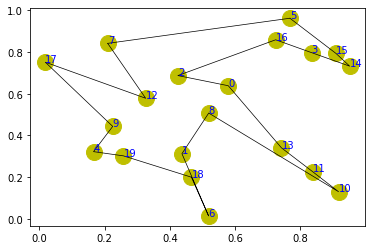

step:695/5000, actic loss:-1.675, critic loss:1.404, L:6.010, 0min1sec
step:696/5000, actic loss:-1.673, critic loss:1.402, L:6.008, 0min1sec
step:697/5000, actic loss:-1.671, critic loss:1.400, L:6.005, 0min2sec
step:698/5000, actic loss:-1.669, critic loss:1.399, L:6.003, 0min2sec
step:699/5000, actic loss:-1.666, critic loss:1.397, L:6.001, 0min2sec
distance:3.721
tensor([10,  8,  6, 13,  4, 18,  3, 16,  5, 11, 17,  2, 15, 14,  1, 19,  9, 12,
         0,  7])


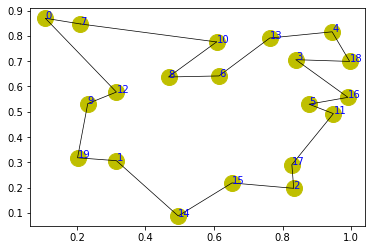

step:700/5000, actic loss:-1.664, critic loss:1.395, L:5.998, 0min2sec
step:701/5000, actic loss:-1.661, critic loss:1.393, L:5.996, 0min1sec
step:702/5000, actic loss:-1.660, critic loss:1.392, L:5.994, 0min2sec
step:703/5000, actic loss:-1.658, critic loss:1.390, L:5.991, 0min1sec
step:704/5000, actic loss:-1.656, critic loss:1.388, L:5.989, 0min2sec
distance:4.695
tensor([ 3,  2, 13,  1,  6, 16,  5, 12, 10, 11,  8, 17, 18,  4,  7,  9, 15, 19,
         0, 14])


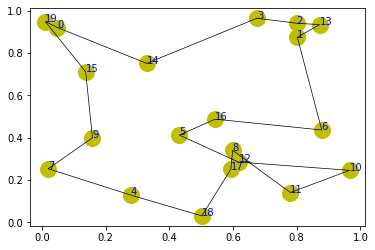

step:705/5000, actic loss:-1.653, critic loss:1.387, L:5.987, 0min2sec
step:706/5000, actic loss:-1.651, critic loss:1.385, L:5.984, 0min1sec
step:707/5000, actic loss:-1.649, critic loss:1.383, L:5.982, 0min2sec
step:708/5000, actic loss:-1.647, critic loss:1.382, L:5.980, 0min1sec
step:709/5000, actic loss:-1.644, critic loss:1.380, L:5.978, 0min2sec
distance:3.988
tensor([ 5,  4, 10,  6, 14,  1,  0, 19, 12, 11, 15, 17, 13,  2,  8,  3, 16, 18,
         7,  9])


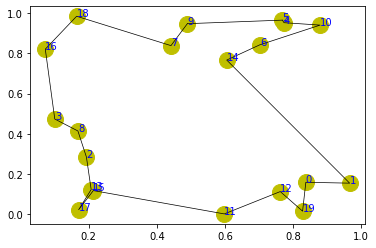

step:710/5000, actic loss:-1.642, critic loss:1.378, L:5.976, 0min3sec
step:711/5000, actic loss:-1.640, critic loss:1.377, L:5.973, 0min1sec
step:712/5000, actic loss:-1.638, critic loss:1.375, L:5.971, 0min1sec
step:713/5000, actic loss:-1.635, critic loss:1.373, L:5.969, 0min2sec
step:714/5000, actic loss:-1.633, critic loss:1.372, L:5.967, 0min1sec
distance:4.560
tensor([11, 16,  4, 19,  0, 12,  3,  7, 18, 10, 17,  6, 15, 13,  5,  9,  8, 14,
         1,  2])


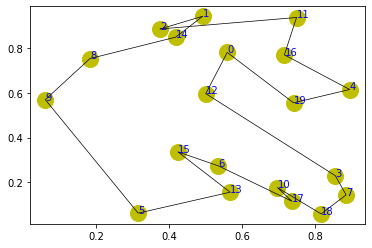

step:715/5000, actic loss:-1.631, critic loss:1.370, L:5.965, 0min2sec
step:716/5000, actic loss:-1.629, critic loss:1.369, L:5.963, 0min1sec
step:717/5000, actic loss:-1.627, critic loss:1.367, L:5.961, 0min2sec
step:718/5000, actic loss:-1.625, critic loss:1.365, L:5.959, 0min2sec
step:719/5000, actic loss:-1.623, critic loss:1.364, L:5.957, 0min1sec
distance:4.277
tensor([ 2, 15, 12,  0,  9,  3, 10, 17, 11, 19,  8,  5, 16,  1,  4, 14,  6,  7,
        13, 18])


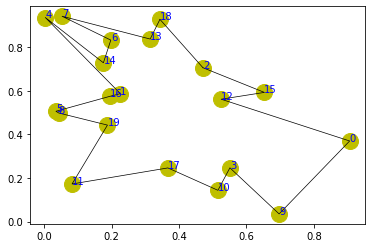

step:720/5000, actic loss:-1.621, critic loss:1.362, L:5.955, 0min2sec
step:721/5000, actic loss:-1.619, critic loss:1.361, L:5.953, 0min2sec
step:722/5000, actic loss:-1.616, critic loss:1.359, L:5.951, 0min2sec
step:723/5000, actic loss:-1.613, critic loss:1.358, L:5.948, 0min1sec
step:724/5000, actic loss:-1.612, critic loss:1.356, L:5.946, 0min2sec
distance:4.397
tensor([ 6,  2, 18,  9, 19, 13, 12, 10,  4,  7, 16, 15, 11, 14,  3,  0,  1, 17,
         5,  8])


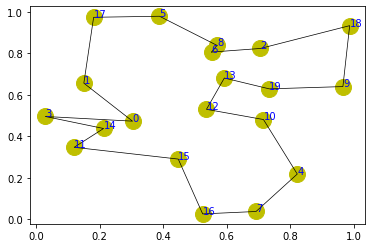

step:725/5000, actic loss:-1.611, critic loss:1.355, L:5.944, 0min2sec
step:726/5000, actic loss:-1.609, critic loss:1.353, L:5.942, 0min2sec
step:727/5000, actic loss:-1.608, critic loss:1.351, L:5.940, 0min2sec
step:728/5000, actic loss:-1.605, critic loss:1.350, L:5.938, 0min1sec
step:729/5000, actic loss:-1.602, critic loss:1.349, L:5.936, 0min2sec
distance:4.284
tensor([ 2, 19,  3, 12, 17, 11,  0,  9,  5, 13, 15,  6, 18,  4,  1, 16, 10,  7,
        14,  8])


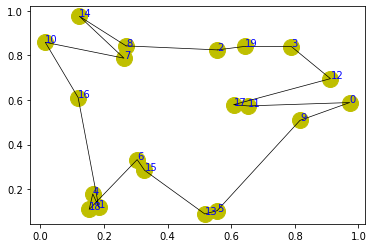

step:730/5000, actic loss:-1.599, critic loss:1.347, L:5.934, 0min2sec
step:731/5000, actic loss:-1.596, critic loss:1.346, L:5.931, 0min2sec
step:732/5000, actic loss:-1.594, critic loss:1.344, L:5.929, 0min2sec
step:733/5000, actic loss:-1.593, critic loss:1.343, L:5.927, 0min2sec
step:734/5000, actic loss:-1.591, critic loss:1.341, L:5.925, 0min2sec
distance:4.553
tensor([ 4,  9,  2,  3, 14, 17,  5, 10,  1,  6,  0, 16,  7, 18, 12, 19, 15, 11,
        13,  8])


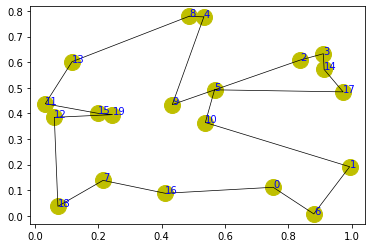

step:735/5000, actic loss:-1.589, critic loss:1.340, L:5.923, 0min2sec
step:736/5000, actic loss:-1.587, critic loss:1.338, L:5.921, 0min1sec
step:737/5000, actic loss:-1.584, critic loss:1.336, L:5.919, 0min2sec
step:738/5000, actic loss:-1.583, critic loss:1.335, L:5.917, 0min1sec
step:739/5000, actic loss:-1.580, critic loss:1.333, L:5.914, 0min2sec
distance:5.462
tensor([17, 18,  2, 12, 19,  0, 11,  1,  3,  9,  7,  8, 16,  4,  6,  5, 10, 15,
        13, 14])


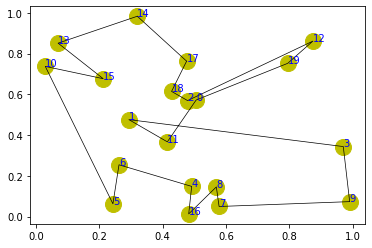

step:740/5000, actic loss:-1.579, critic loss:1.332, L:5.912, 0min2sec
step:741/5000, actic loss:-1.577, critic loss:1.330, L:5.910, 0min2sec
step:742/5000, actic loss:-1.574, critic loss:1.329, L:5.908, 0min2sec
step:743/5000, actic loss:-1.573, critic loss:1.327, L:5.906, 0min2sec
step:744/5000, actic loss:-1.571, critic loss:1.326, L:5.904, 0min2sec
distance:4.559
tensor([15, 16,  9,  8, 14,  7,  6, 13, 12, 17,  2,  4,  5, 19, 11, 10, 18,  1,
         3,  0])


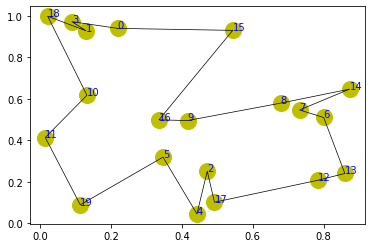

step:745/5000, actic loss:-1.569, critic loss:1.325, L:5.902, 0min2sec
step:746/5000, actic loss:-1.568, critic loss:1.324, L:5.901, 0min2sec
step:747/5000, actic loss:-1.566, critic loss:1.322, L:5.899, 0min1sec
step:748/5000, actic loss:-1.565, critic loss:1.321, L:5.897, 0min1sec
step:749/5000, actic loss:-1.563, critic loss:1.320, L:5.895, 0min2sec
distance:4.666
tensor([13, 11, 16, 19,  6,  0, 18, 12, 10,  2,  8,  9,  4,  5, 14,  3, 17, 15,
         7,  1])


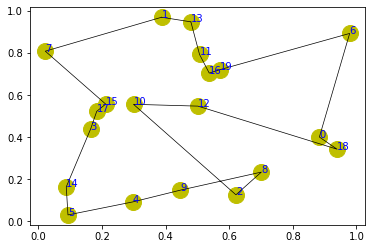

step:750/5000, actic loss:-1.561, critic loss:1.318, L:5.894, 0min2sec
step:751/5000, actic loss:-1.559, critic loss:1.317, L:5.892, 0min2sec
step:752/5000, actic loss:-1.558, critic loss:1.315, L:5.890, 0min2sec
step:753/5000, actic loss:-1.556, critic loss:1.314, L:5.888, 0min2sec
step:754/5000, actic loss:-1.554, critic loss:1.313, L:5.887, 0min1sec
distance:4.323
tensor([ 7, 14,  2,  3,  1, 15,  8, 13,  0, 10, 17, 11,  4,  5,  9, 19, 12, 16,
        18,  6])


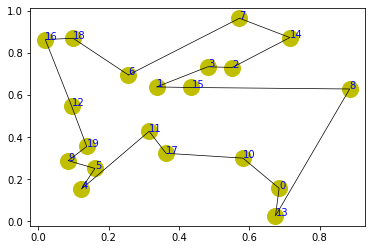

step:755/5000, actic loss:-1.552, critic loss:1.311, L:5.885, 0min3sec
step:756/5000, actic loss:-1.550, critic loss:1.310, L:5.883, 0min3sec
step:757/5000, actic loss:-1.549, critic loss:1.308, L:5.881, 0min2sec
step:758/5000, actic loss:-1.548, critic loss:1.307, L:5.879, 0min1sec
step:759/5000, actic loss:-1.546, critic loss:1.305, L:5.877, 0min2sec
distance:4.727
tensor([ 3, 16,  5, 19, 12, 15, 18,  7,  2, 10, 14,  4,  6,  8,  1,  0, 11, 13,
         9, 17])


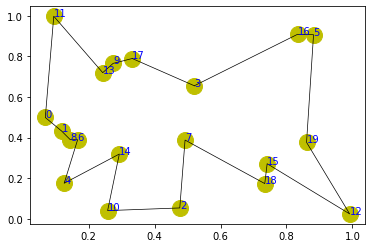

step:760/5000, actic loss:-1.544, critic loss:1.304, L:5.876, 0min2sec
step:761/5000, actic loss:-1.541, critic loss:1.303, L:5.874, 0min2sec
step:762/5000, actic loss:-1.538, critic loss:1.301, L:5.872, 0min2sec
step:763/5000, actic loss:-1.536, critic loss:1.300, L:5.870, 0min1sec
step:764/5000, actic loss:-1.535, critic loss:1.299, L:5.868, 0min1sec
distance:5.046
tensor([10,  2, 16, 14, 11,  3, 17,  8, 19,  7,  6,  5,  9, 18,  1,  0, 15, 13,
        12,  4])


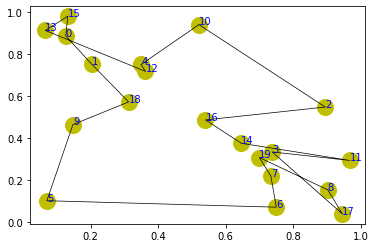

step:765/5000, actic loss:-1.534, critic loss:1.297, L:5.866, 0min2sec
step:766/5000, actic loss:-1.533, critic loss:1.296, L:5.864, 0min1sec
step:767/5000, actic loss:-1.533, critic loss:1.295, L:5.863, 0min2sec
step:768/5000, actic loss:-1.531, critic loss:1.293, L:5.861, 0min2sec
step:769/5000, actic loss:-1.528, critic loss:1.292, L:5.859, 0min2sec
distance:5.096
tensor([ 7, 18, 19,  8,  9, 12,  1, 13, 16, 14,  2,  0, 10, 11,  5,  3,  6, 15,
         4, 17])


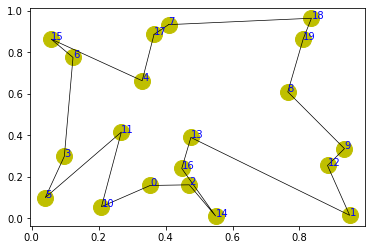

step:770/5000, actic loss:-1.525, critic loss:1.291, L:5.858, 0min2sec
step:771/5000, actic loss:-1.522, critic loss:1.290, L:5.856, 0min2sec
step:772/5000, actic loss:-1.519, critic loss:1.289, L:5.854, 0min2sec
step:773/5000, actic loss:-1.516, critic loss:1.288, L:5.853, 0min1sec
step:774/5000, actic loss:-1.515, critic loss:1.286, L:5.851, 0min2sec
distance:3.439
tensor([11, 18, 14,  5, 13,  8, 15,  4,  0, 10, 17, 16,  6, 19,  3,  9,  7,  2,
        12,  1])


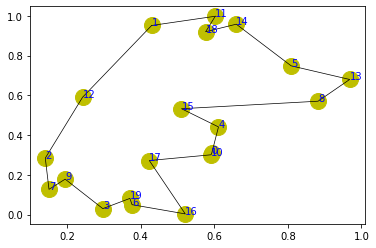

step:775/5000, actic loss:-1.514, critic loss:1.285, L:5.849, 0min2sec
step:776/5000, actic loss:-1.513, critic loss:1.284, L:5.847, 0min2sec
step:777/5000, actic loss:-1.512, critic loss:1.282, L:5.846, 0min2sec
step:778/5000, actic loss:-1.509, critic loss:1.281, L:5.844, 0min2sec
step:779/5000, actic loss:-1.507, critic loss:1.280, L:5.842, 0min1sec
distance:4.595
tensor([11,  1,  0, 16,  4, 10, 18,  3, 15, 14, 12,  6,  8, 19, 17,  7,  2, 13,
         5,  9])


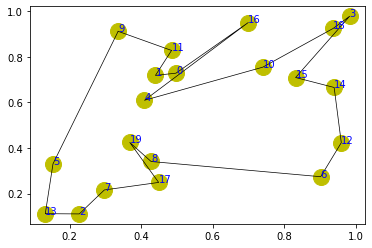

step:780/5000, actic loss:-1.504, critic loss:1.278, L:5.840, 0min2sec
step:781/5000, actic loss:-1.502, critic loss:1.277, L:5.839, 0min2sec
step:782/5000, actic loss:-1.501, critic loss:1.276, L:5.837, 0min2sec
step:783/5000, actic loss:-1.500, critic loss:1.274, L:5.835, 0min2sec
step:784/5000, actic loss:-1.499, critic loss:1.273, L:5.833, 0min2sec
distance:4.360
tensor([17,  7,  1, 14,  6, 16, 10, 12,  4, 11, 19,  2,  0, 18,  5,  9, 15, 13,
         3,  8])


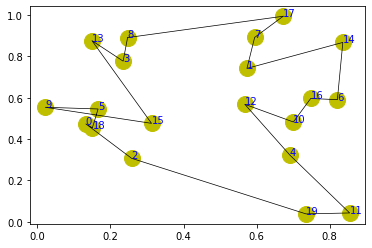

step:785/5000, actic loss:-1.498, critic loss:1.272, L:5.831, 0min2sec
step:786/5000, actic loss:-1.496, critic loss:1.270, L:5.830, 0min2sec
step:787/5000, actic loss:-1.493, critic loss:1.269, L:5.828, 0min1sec
step:788/5000, actic loss:-1.490, critic loss:1.268, L:5.826, 0min2sec
step:789/5000, actic loss:-1.488, critic loss:1.267, L:5.824, 0min2sec
distance:4.214
tensor([13,  9, 10,  3,  5,  6,  0, 14, 19, 17, 11,  4, 12,  2,  1, 18,  7,  8,
        15, 16])


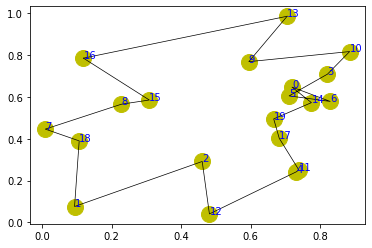

step:790/5000, actic loss:-1.487, critic loss:1.265, L:5.822, 0min2sec
step:791/5000, actic loss:-1.485, critic loss:1.264, L:5.820, 0min2sec
step:792/5000, actic loss:-1.484, critic loss:1.263, L:5.818, 0min2sec
step:793/5000, actic loss:-1.483, critic loss:1.261, L:5.816, 0min2sec
step:794/5000, actic loss:-1.481, critic loss:1.260, L:5.814, 0min2sec
distance:4.484
tensor([ 6, 19, 13,  9, 18,  0, 11,  1,  8,  3,  5, 14,  2,  4, 12, 17, 16, 10,
        15,  7])


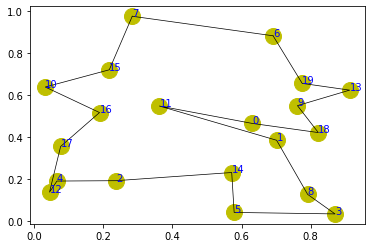

step:795/5000, actic loss:-1.478, critic loss:1.259, L:5.813, 0min3sec
step:796/5000, actic loss:-1.476, critic loss:1.257, L:5.811, 0min2sec
step:797/5000, actic loss:-1.474, critic loss:1.256, L:5.809, 0min2sec
step:798/5000, actic loss:-1.473, critic loss:1.255, L:5.807, 0min1sec
step:799/5000, actic loss:-1.471, critic loss:1.253, L:5.805, 0min1sec
distance:4.306
tensor([ 5, 19, 11,  0,  4, 14, 15, 18, 10,  9,  8,  3, 13, 16,  7, 17,  6, 12,
         1,  2])


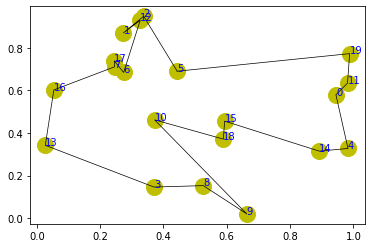

step:800/5000, actic loss:-1.469, critic loss:1.252, L:5.804, 0min2sec
step:801/5000, actic loss:-1.468, critic loss:1.251, L:5.802, 0min2sec
step:802/5000, actic loss:-1.467, critic loss:1.250, L:5.800, 0min1sec
step:803/5000, actic loss:-1.467, critic loss:1.248, L:5.798, 0min2sec
step:804/5000, actic loss:-1.466, critic loss:1.247, L:5.797, 0min1sec
distance:4.626
tensor([ 8, 13, 19,  1,  6, 15, 17,  5,  7, 18, 14,  9, 10, 11, 12,  0,  4, 16,
         2,  3])


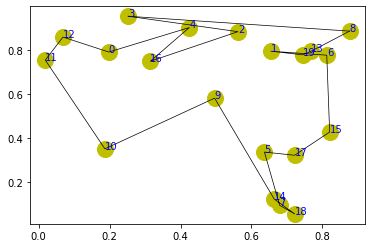

step:805/5000, actic loss:-1.464, critic loss:1.246, L:5.796, 0min2sec
step:806/5000, actic loss:-1.462, critic loss:1.245, L:5.794, 0min3sec
step:807/5000, actic loss:-1.459, critic loss:1.244, L:5.793, 0min2sec
step:808/5000, actic loss:-1.457, critic loss:1.243, L:5.791, 0min2sec
step:809/5000, actic loss:-1.456, critic loss:1.242, L:5.790, 0min1sec
distance:4.256
tensor([ 8, 18, 15,  6, 19, 13,  9,  3, 17,  5,  1,  7,  4, 11,  2, 14, 16, 12,
         0, 10])


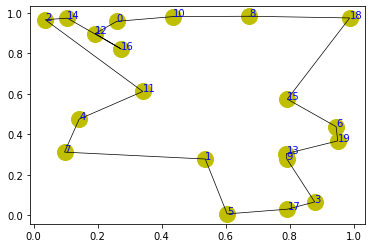

step:810/5000, actic loss:-1.454, critic loss:1.240, L:5.788, 0min2sec
step:811/5000, actic loss:-1.453, critic loss:1.239, L:5.786, 0min2sec
step:812/5000, actic loss:-1.451, critic loss:1.238, L:5.785, 0min1sec
step:813/5000, actic loss:-1.449, critic loss:1.237, L:5.783, 0min2sec
step:814/5000, actic loss:-1.448, critic loss:1.235, L:5.781, 0min2sec
distance:3.997
tensor([ 2,  3, 17,  9, 16,  0,  1, 10,  6,  4,  8, 15, 14, 18, 11, 19, 13,  7,
         5, 12])


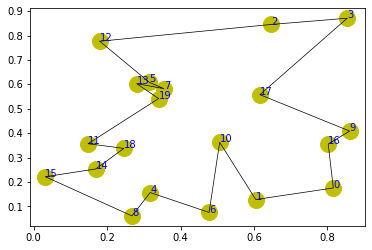

step:815/5000, actic loss:-1.447, critic loss:1.234, L:5.779, 0min2sec
step:816/5000, actic loss:-1.445, critic loss:1.233, L:5.778, 0min1sec
step:817/5000, actic loss:-1.443, critic loss:1.232, L:5.776, 0min2sec
step:818/5000, actic loss:-1.441, critic loss:1.230, L:5.774, 0min2sec
step:819/5000, actic loss:-1.439, critic loss:1.229, L:5.773, 0min2sec
distance:4.477
tensor([11, 19, 15,  8, 18,  0, 16,  9,  7, 10,  5, 17,  2, 12, 14,  1,  3,  6,
         4, 13])


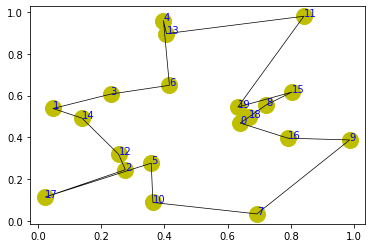

step:820/5000, actic loss:-1.438, critic loss:1.228, L:5.771, 0min2sec
step:821/5000, actic loss:-1.437, critic loss:1.227, L:5.769, 0min1sec
step:822/5000, actic loss:-1.436, critic loss:1.226, L:5.768, 0min2sec
step:823/5000, actic loss:-1.434, critic loss:1.224, L:5.766, 0min2sec
step:824/5000, actic loss:-1.431, critic loss:1.223, L:5.764, 0min2sec
distance:4.817
tensor([ 2,  5, 12, 17,  0, 15, 13,  7, 19, 14, 10,  1, 16,  9,  4,  3,  6, 11,
         8, 18])


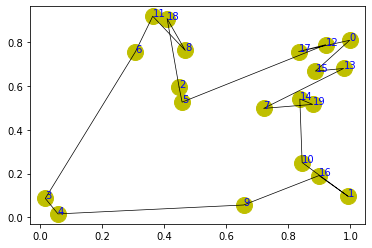

step:825/5000, actic loss:-1.429, critic loss:1.222, L:5.763, 0min2sec
step:826/5000, actic loss:-1.427, critic loss:1.221, L:5.761, 0min2sec
step:827/5000, actic loss:-1.426, critic loss:1.220, L:5.759, 0min2sec
step:828/5000, actic loss:-1.426, critic loss:1.219, L:5.758, 0min2sec
step:829/5000, actic loss:-1.426, critic loss:1.217, L:5.756, 0min2sec
distance:3.672
tensor([ 9, 19,  5,  3, 15, 13,  2,  7,  6,  0, 10,  1, 16, 12, 18, 17, 14, 11,
         8,  4])


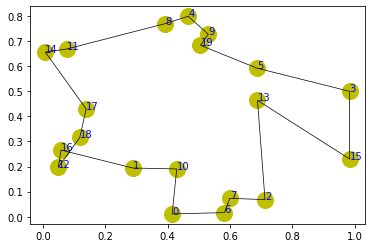

step:830/5000, actic loss:-1.425, critic loss:1.216, L:5.754, 0min2sec
step:831/5000, actic loss:-1.424, critic loss:1.215, L:5.753, 0min2sec
step:832/5000, actic loss:-1.421, critic loss:1.214, L:5.751, 0min3sec
step:833/5000, actic loss:-1.418, critic loss:1.213, L:5.749, 0min2sec
step:834/5000, actic loss:-1.415, critic loss:1.212, L:5.748, 0min2sec
distance:4.887
tensor([10, 11,  2,  7,  0, 14,  8, 13,  4,  3,  9, 17, 15,  6,  1, 12, 18, 19,
         5, 16])


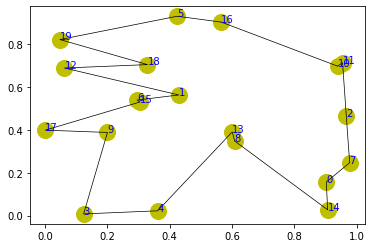

step:835/5000, actic loss:-1.413, critic loss:1.211, L:5.747, 0min2sec
step:836/5000, actic loss:-1.412, critic loss:1.210, L:5.745, 0min2sec
step:837/5000, actic loss:-1.411, critic loss:1.208, L:5.744, 0min3sec
step:838/5000, actic loss:-1.410, critic loss:1.207, L:5.742, 0min2sec
step:839/5000, actic loss:-1.408, critic loss:1.206, L:5.741, 0min2sec
distance:4.620
tensor([ 5,  8, 16,  3, 19, 11,  2, 18, 14,  4, 12,  0,  6, 13, 10,  7,  1, 17,
         9, 15])


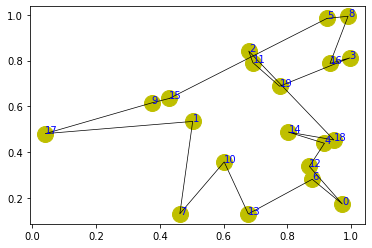

step:840/5000, actic loss:-1.406, critic loss:1.205, L:5.739, 0min2sec
step:841/5000, actic loss:-1.404, critic loss:1.204, L:5.738, 0min3sec
step:842/5000, actic loss:-1.403, critic loss:1.203, L:5.737, 0min2sec
step:843/5000, actic loss:-1.401, critic loss:1.202, L:5.735, 0min2sec
step:844/5000, actic loss:-1.399, critic loss:1.201, L:5.734, 0min2sec
distance:4.137
tensor([11,  3, 15, 12, 17, 13, 16,  0, 18,  5,  8,  6,  7,  2, 10, 14,  4,  1,
        19,  9])


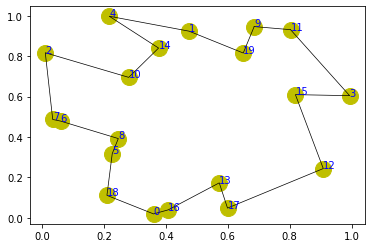

step:845/5000, actic loss:-1.398, critic loss:1.200, L:5.733, 0min3sec
step:846/5000, actic loss:-1.397, critic loss:1.199, L:5.731, 0min3sec
step:847/5000, actic loss:-1.396, critic loss:1.198, L:5.730, 0min2sec
step:848/5000, actic loss:-1.394, critic loss:1.197, L:5.728, 0min2sec
step:849/5000, actic loss:-1.392, critic loss:1.195, L:5.727, 0min2sec
distance:4.857
tensor([ 0, 19, 11,  3,  2, 18,  5, 15, 10,  7,  8,  9,  1, 13, 12,  6,  4, 14,
        16, 17])


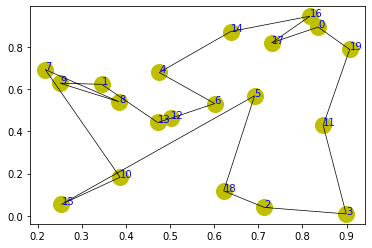

step:850/5000, actic loss:-1.391, critic loss:1.194, L:5.725, 0min3sec
step:851/5000, actic loss:-1.390, critic loss:1.193, L:5.724, 0min2sec
step:852/5000, actic loss:-1.390, critic loss:1.192, L:5.723, 0min2sec
step:853/5000, actic loss:-1.389, critic loss:1.191, L:5.722, 0min2sec
step:854/5000, actic loss:-1.386, critic loss:1.190, L:5.720, 0min3sec
distance:5.016
tensor([ 4,  3,  8, 14,  5, 10,  2,  9, 13, 11, 19, 18,  7,  6, 12,  0, 17, 15,
        16,  1])


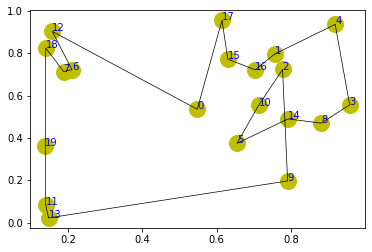

step:855/5000, actic loss:-1.384, critic loss:1.190, L:5.719, 0min3sec
step:856/5000, actic loss:-1.382, critic loss:1.189, L:5.718, 0min3sec
step:857/5000, actic loss:-1.380, critic loss:1.188, L:5.717, 0min2sec
step:858/5000, actic loss:-1.380, critic loss:1.187, L:5.716, 0min2sec
step:859/5000, actic loss:-1.380, critic loss:1.186, L:5.715, 0min2sec
distance:5.503
tensor([12, 18, 16, 14,  5,  2, 13, 10, 19,  3,  8,  9,  7,  6,  1, 17,  4,  0,
        15, 11])


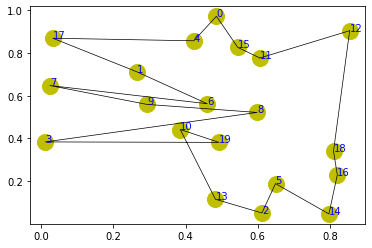

step:860/5000, actic loss:-1.380, critic loss:1.185, L:5.714, 0min3sec
step:861/5000, actic loss:-1.379, critic loss:1.184, L:5.712, 0min2sec
step:862/5000, actic loss:-1.378, critic loss:1.183, L:5.711, 0min2sec
step:863/5000, actic loss:-1.375, critic loss:1.182, L:5.710, 0min3sec
step:864/5000, actic loss:-1.372, critic loss:1.182, L:5.709, 0min2sec
distance:4.891
tensor([ 4, 13, 15,  8, 19,  2, 18, 17, 14,  1, 10,  7, 16, 11,  6,  0,  9,  5,
         3, 12])


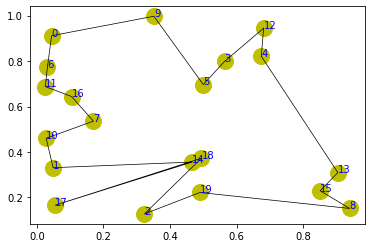

step:865/5000, actic loss:-1.370, critic loss:1.181, L:5.707, 0min3sec
step:866/5000, actic loss:-1.368, critic loss:1.179, L:5.706, 0min2sec
step:867/5000, actic loss:-1.368, critic loss:1.178, L:5.704, 0min2sec
step:868/5000, actic loss:-1.368, critic loss:1.178, L:5.703, 0min2sec
step:869/5000, actic loss:-1.368, critic loss:1.177, L:5.702, 0min3sec
distance:4.500
tensor([10,  5, 18,  6, 15,  4,  9, 12,  8, 16, 11, 14, 13, 17,  2, 19,  7,  3,
         0,  1])


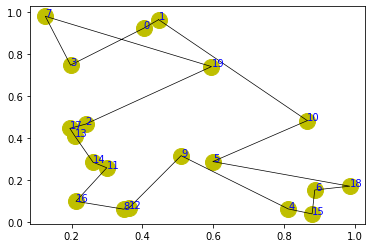

step:870/5000, actic loss:-1.368, critic loss:1.176, L:5.700, 0min3sec
step:871/5000, actic loss:-1.368, critic loss:1.175, L:5.699, 0min3sec
step:872/5000, actic loss:-1.367, critic loss:1.174, L:5.698, 0min3sec
step:873/5000, actic loss:-1.364, critic loss:1.173, L:5.697, 0min3sec
step:874/5000, actic loss:-1.361, critic loss:1.173, L:5.695, 0min3sec
distance:3.958
tensor([10, 19,  1,  8,  3, 14,  2,  6, 12,  9,  0, 15, 17,  7,  5, 11, 16,  4,
        18, 13])


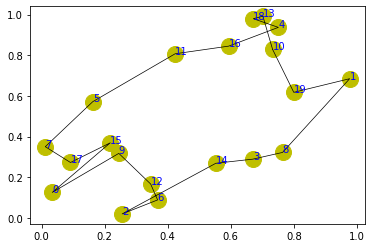

step:875/5000, actic loss:-1.357, critic loss:1.172, L:5.694, 0min3sec
step:876/5000, actic loss:-1.354, critic loss:1.172, L:5.692, 0min2sec
step:877/5000, actic loss:-1.351, critic loss:1.171, L:5.691, 0min3sec
step:878/5000, actic loss:-1.349, critic loss:1.170, L:5.690, 0min2sec
step:879/5000, actic loss:-1.348, critic loss:1.169, L:5.688, 0min4sec
distance:4.758
tensor([ 9, 11, 14, 10,  2,  4, 18, 16, 12,  8,  5,  1,  6, 15,  3, 19,  0, 17,
         7, 13])


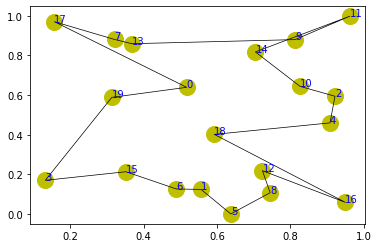

step:880/5000, actic loss:-1.348, critic loss:1.168, L:5.687, 0min3sec
step:881/5000, actic loss:-1.347, critic loss:1.167, L:5.686, 0min3sec
step:882/5000, actic loss:-1.347, critic loss:1.166, L:5.684, 0min2sec
step:883/5000, actic loss:-1.346, critic loss:1.165, L:5.683, 0min3sec
step:884/5000, actic loss:-1.345, critic loss:1.164, L:5.682, 0min3sec
distance:4.320
tensor([10,  8,  1, 19,  6,  7,  2,  9, 15, 14, 13, 16,  4, 17,  0,  5, 12, 18,
        11,  3])


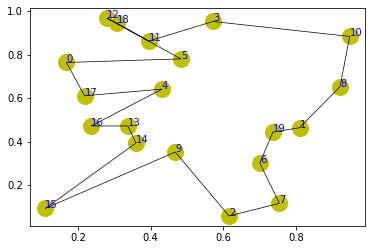

step:885/5000, actic loss:-1.343, critic loss:1.163, L:5.681, 0min3sec
step:886/5000, actic loss:-1.342, critic loss:1.162, L:5.680, 0min3sec
step:887/5000, actic loss:-1.341, critic loss:1.162, L:5.679, 0min3sec
step:888/5000, actic loss:-1.339, critic loss:1.161, L:5.678, 0min3sec
step:889/5000, actic loss:-1.338, critic loss:1.160, L:5.677, 0min3sec
distance:4.190
tensor([11,  2,  6, 15, 17, 12,  7, 14, 18, 19,  0,  9,  4,  3,  8,  5,  1, 13,
        16, 10])


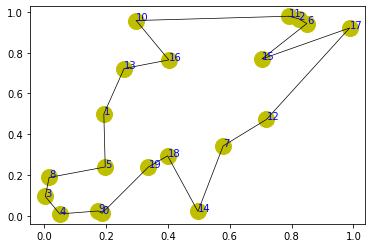

step:890/5000, actic loss:-1.336, critic loss:1.159, L:5.676, 0min3sec
step:891/5000, actic loss:-1.335, critic loss:1.159, L:5.675, 0min2sec
step:892/5000, actic loss:-1.333, critic loss:1.158, L:5.673, 0min4sec
step:893/5000, actic loss:-1.332, critic loss:1.157, L:5.672, 0min3sec
step:894/5000, actic loss:-1.331, critic loss:1.156, L:5.671, 0min3sec
distance:5.029
tensor([14,  7,  2,  0,  6,  1, 12,  9, 11, 15,  3, 10, 19, 18,  4,  5, 16, 17,
        13,  8])


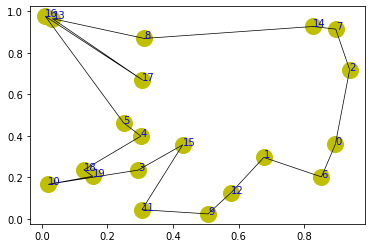

step:895/5000, actic loss:-1.331, critic loss:1.155, L:5.669, 0min4sec
step:896/5000, actic loss:-1.331, critic loss:1.154, L:5.668, 0min3sec
step:897/5000, actic loss:-1.329, critic loss:1.153, L:5.667, 0min3sec
step:898/5000, actic loss:-1.327, critic loss:1.152, L:5.665, 0min4sec
step:899/5000, actic loss:-1.325, critic loss:1.151, L:5.664, 0min4sec
distance:4.616
tensor([ 3,  5, 18,  0, 10, 16, 19, 14,  2, 11,  8,  1,  6, 17,  9, 15, 13,  4,
         7, 12])


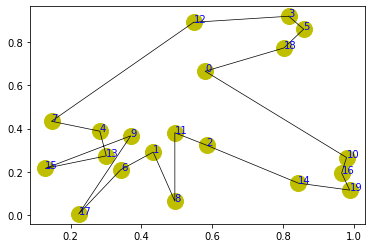

step:900/5000, actic loss:-1.324, critic loss:1.150, L:5.663, 0min4sec
step:901/5000, actic loss:-1.323, critic loss:1.149, L:5.661, 0min3sec
step:902/5000, actic loss:-1.323, critic loss:1.148, L:5.660, 0min3sec
step:903/5000, actic loss:-1.322, critic loss:1.147, L:5.659, 0min3sec
step:904/5000, actic loss:-1.321, critic loss:1.146, L:5.658, 0min3sec
distance:4.914
tensor([ 3,  5,  0,  2,  8, 19,  4, 13, 16, 14, 15, 11, 17, 10,  1,  7,  6, 18,
        12,  9])


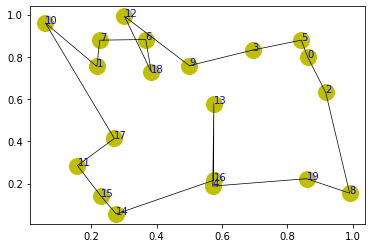

step:905/5000, actic loss:-1.319, critic loss:1.145, L:5.656, 0min2sec
step:906/5000, actic loss:-1.317, critic loss:1.144, L:5.655, 0min2sec
step:907/5000, actic loss:-1.316, critic loss:1.143, L:5.653, 0min2sec
step:908/5000, actic loss:-1.316, critic loss:1.142, L:5.652, 0min3sec
step:909/5000, actic loss:-1.315, critic loss:1.141, L:5.651, 0min3sec
distance:4.093
tensor([ 4, 19,  6,  5,  3, 16, 11,  7,  2, 14, 12, 18,  0, 13,  1, 15, 10, 17,
         8,  9])


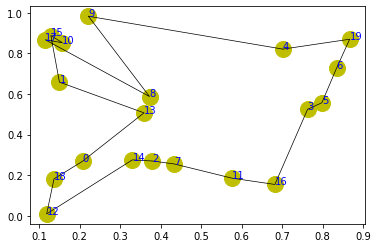

step:910/5000, actic loss:-1.313, critic loss:1.140, L:5.650, 0min2sec
step:911/5000, actic loss:-1.311, critic loss:1.139, L:5.648, 0min2sec
step:912/5000, actic loss:-1.309, critic loss:1.138, L:5.647, 0min2sec
step:913/5000, actic loss:-1.307, critic loss:1.137, L:5.646, 0min3sec
step:914/5000, actic loss:-1.306, critic loss:1.136, L:5.644, 0min2sec
distance:4.120
tensor([15,  6, 10, 18,  3, 11,  0,  7,  2, 17,  4, 19,  8,  5, 14, 12, 16,  1,
        13,  9])


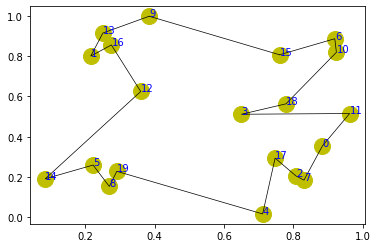

step:915/5000, actic loss:-1.305, critic loss:1.135, L:5.643, 0min3sec
step:916/5000, actic loss:-1.304, critic loss:1.134, L:5.641, 0min3sec
step:917/5000, actic loss:-1.303, critic loss:1.133, L:5.640, 0min3sec
step:918/5000, actic loss:-1.301, critic loss:1.132, L:5.639, 0min2sec
step:919/5000, actic loss:-1.299, critic loss:1.131, L:5.637, 0min2sec
distance:4.958
tensor([14, 19,  5, 13, 16,  4,  1, 17, 10, 15,  3,  9,  2,  7,  6,  8, 11, 12,
        18,  0])


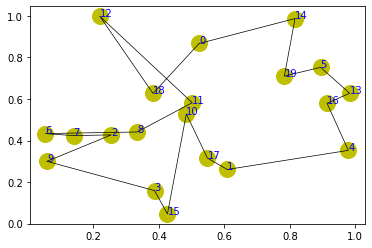

step:920/5000, actic loss:-1.298, critic loss:1.130, L:5.636, 0min3sec
step:921/5000, actic loss:-1.297, critic loss:1.129, L:5.635, 0min3sec
step:922/5000, actic loss:-1.296, critic loss:1.128, L:5.633, 0min2sec
step:923/5000, actic loss:-1.295, critic loss:1.127, L:5.632, 0min3sec
step:924/5000, actic loss:-1.294, critic loss:1.126, L:5.631, 0min3sec
distance:4.591
tensor([ 3, 18, 15, 19,  7, 13,  0, 16, 14, 17, 10,  1,  2,  5, 12, 11,  9,  8,
         4,  6])


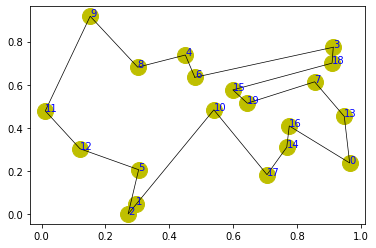

step:925/5000, actic loss:-1.292, critic loss:1.125, L:5.629, 0min3sec
step:926/5000, actic loss:-1.291, critic loss:1.124, L:5.628, 0min2sec
step:927/5000, actic loss:-1.290, critic loss:1.123, L:5.627, 0min2sec
step:928/5000, actic loss:-1.289, critic loss:1.122, L:5.625, 0min3sec
step:929/5000, actic loss:-1.288, critic loss:1.121, L:5.624, 0min2sec
distance:3.835
tensor([ 8, 16, 18,  7,  0, 17,  2, 10, 13, 19,  3,  9, 11,  6,  5,  1, 14,  4,
        15, 12])


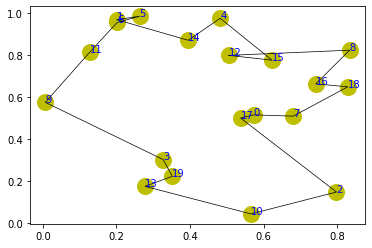

step:930/5000, actic loss:-1.287, critic loss:1.120, L:5.623, 0min4sec
step:931/5000, actic loss:-1.285, critic loss:1.119, L:5.622, 0min2sec
step:932/5000, actic loss:-1.284, critic loss:1.118, L:5.620, 0min3sec
step:933/5000, actic loss:-1.282, critic loss:1.117, L:5.619, 0min1sec
step:934/5000, actic loss:-1.281, critic loss:1.116, L:5.618, 0min1sec
distance:4.884
tensor([16,  5,  6, 19,  2,  9,  1, 18,  3,  4, 12, 17, 14, 13,  8, 11, 10,  7,
         0, 15])


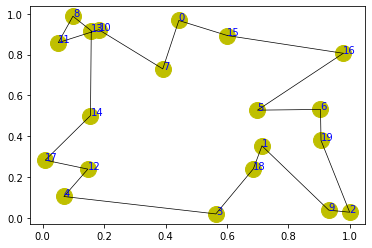

step:935/5000, actic loss:-1.281, critic loss:1.115, L:5.617, 0min3sec
step:936/5000, actic loss:-1.278, critic loss:1.115, L:5.616, 0min2sec
step:937/5000, actic loss:-1.276, critic loss:1.114, L:5.615, 0min1sec
step:938/5000, actic loss:-1.274, critic loss:1.113, L:5.614, 0min1sec
step:939/5000, actic loss:-1.272, critic loss:1.112, L:5.612, 0min1sec
distance:4.534
tensor([ 7,  4, 10, 11, 15,  9, 14, 16, 13, 12, 19,  8,  3,  1,  5,  2, 18, 17,
         6,  0])


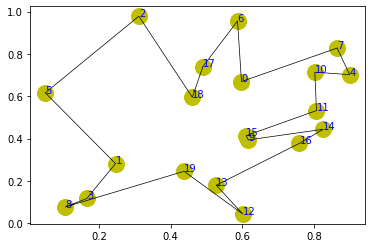

step:940/5000, actic loss:-1.272, critic loss:1.111, L:5.611, 0min1sec
step:941/5000, actic loss:-1.272, critic loss:1.110, L:5.610, 0min0sec
step:942/5000, actic loss:-1.273, critic loss:1.109, L:5.609, 0min1sec
step:943/5000, actic loss:-1.274, critic loss:1.109, L:5.608, 0min1sec
step:944/5000, actic loss:-1.273, critic loss:1.108, L:5.607, 0min1sec
distance:5.052
tensor([ 0,  3, 14, 11,  1,  2, 16,  6, 10,  8, 19,  7, 17,  9, 18, 13, 15, 12,
         4,  5])


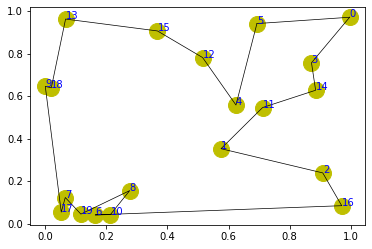

step:945/5000, actic loss:-1.271, critic loss:1.107, L:5.606, 0min1sec
step:946/5000, actic loss:-1.267, critic loss:1.106, L:5.605, 0min1sec
step:947/5000, actic loss:-1.263, critic loss:1.106, L:5.604, 0min1sec
step:948/5000, actic loss:-1.260, critic loss:1.105, L:5.603, 0min1sec
step:949/5000, actic loss:-1.258, critic loss:1.104, L:5.602, 0min1sec
distance:3.645
tensor([ 8,  3,  7,  9,  6, 15, 14, 13,  1, 19, 10, 16, 11, 12,  0, 18,  4, 17,
         2,  5])


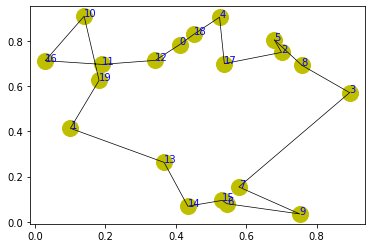

step:950/5000, actic loss:-1.257, critic loss:1.103, L:5.601, 0min1sec
step:951/5000, actic loss:-1.256, critic loss:1.102, L:5.599, 0min1sec
step:952/5000, actic loss:-1.256, critic loss:1.102, L:5.598, 0min1sec
step:953/5000, actic loss:-1.256, critic loss:1.101, L:5.597, 0min1sec
step:954/5000, actic loss:-1.254, critic loss:1.100, L:5.596, 0min1sec
distance:4.128
tensor([19, 13,  1,  9, 17, 15, 11,  2,  5, 16, 14, 18,  8,  6,  0,  7,  4,  3,
        12, 10])


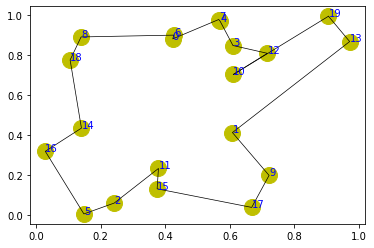

step:955/5000, actic loss:-1.253, critic loss:1.099, L:5.595, 0min1sec
step:956/5000, actic loss:-1.251, critic loss:1.098, L:5.593, 0min1sec
step:957/5000, actic loss:-1.251, critic loss:1.097, L:5.592, 0min1sec
step:958/5000, actic loss:-1.250, critic loss:1.096, L:5.591, 0min1sec
step:959/5000, actic loss:-1.249, critic loss:1.095, L:5.590, 0min1sec
distance:4.335
tensor([17,  3, 15, 13,  2, 12,  4,  9, 11,  1, 14, 19, 18, 16,  5,  7,  0,  6,
         8, 10])


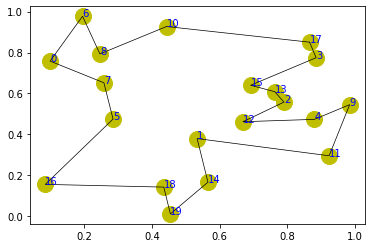

step:960/5000, actic loss:-1.247, critic loss:1.094, L:5.589, 0min1sec
step:961/5000, actic loss:-1.245, critic loss:1.093, L:5.587, 0min1sec
step:962/5000, actic loss:-1.244, critic loss:1.093, L:5.586, 0min1sec
step:963/5000, actic loss:-1.243, critic loss:1.092, L:5.585, 0min1sec
step:964/5000, actic loss:-1.242, critic loss:1.091, L:5.584, 0min1sec
distance:4.459
tensor([ 6,  9, 17, 16,  0,  8,  4, 11, 13, 14, 18,  7, 12,  1, 15, 19, 10,  3,
         2,  5])


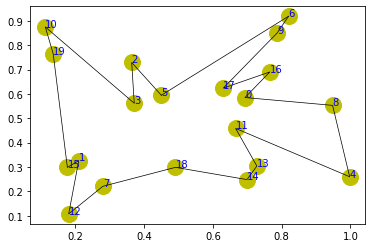

step:965/5000, actic loss:-1.240, critic loss:1.090, L:5.582, 0min1sec
step:966/5000, actic loss:-1.239, critic loss:1.089, L:5.581, 0min1sec
step:967/5000, actic loss:-1.238, critic loss:1.088, L:5.580, 0min0sec
step:968/5000, actic loss:-1.237, critic loss:1.087, L:5.579, 0min1sec
step:969/5000, actic loss:-1.235, critic loss:1.086, L:5.577, 0min1sec
distance:3.502
tensor([10, 18, 17,  6, 13,  7,  4, 15,  8, 14,  3,  2,  1, 12, 19, 11,  5, 16,
         9,  0])


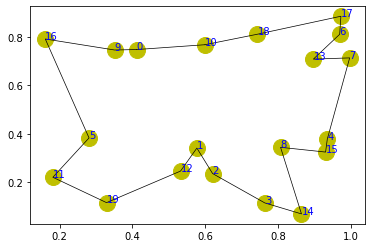

step:970/5000, actic loss:-1.234, critic loss:1.085, L:5.576, 0min1sec
step:971/5000, actic loss:-1.233, critic loss:1.084, L:5.575, 0min1sec
step:972/5000, actic loss:-1.233, critic loss:1.083, L:5.573, 0min1sec
step:973/5000, actic loss:-1.232, critic loss:1.082, L:5.572, 0min0sec
step:974/5000, actic loss:-1.230, critic loss:1.081, L:5.571, 0min1sec
distance:3.538
tensor([ 7,  4, 16, 12, 18, 11,  3, 19,  9, 13,  2, 17, 15,  0,  1, 10,  5,  8,
         6, 14])


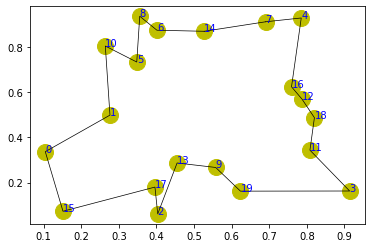

step:975/5000, actic loss:-1.229, critic loss:1.081, L:5.570, 0min1sec
step:976/5000, actic loss:-1.228, critic loss:1.080, L:5.568, 0min1sec
step:977/5000, actic loss:-1.227, critic loss:1.079, L:5.567, 0min0sec
step:978/5000, actic loss:-1.226, critic loss:1.078, L:5.566, 0min1sec
step:979/5000, actic loss:-1.225, critic loss:1.077, L:5.565, 0min1sec
distance:4.177
tensor([ 1,  5, 10,  9,  2, 19,  4, 13,  6, 18, 12, 11, 16, 15, 14,  3,  8,  7,
        17,  0])


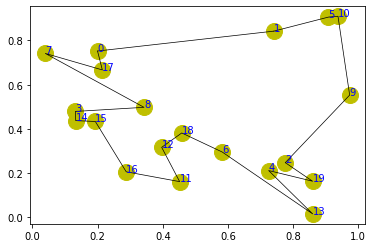

step:980/5000, actic loss:-1.223, critic loss:1.076, L:5.563, 0min1sec
step:981/5000, actic loss:-1.222, critic loss:1.075, L:5.562, 0min1sec
step:982/5000, actic loss:-1.221, critic loss:1.074, L:5.561, 0min1sec
step:983/5000, actic loss:-1.220, critic loss:1.073, L:5.560, 0min1sec
step:984/5000, actic loss:-1.219, critic loss:1.072, L:5.559, 0min1sec
distance:4.889
tensor([ 7,  9, 19,  3, 15, 18,  8, 14,  4, 10, 11, 16, 17, 13,  0,  5,  6, 12,
         2,  1])


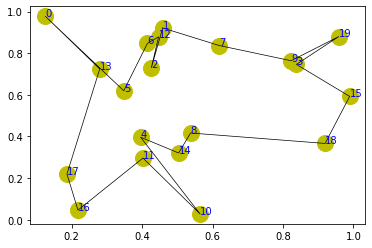

step:985/5000, actic loss:-1.217, critic loss:1.072, L:5.558, 0min1sec
step:986/5000, actic loss:-1.216, critic loss:1.071, L:5.556, 0min1sec
step:987/5000, actic loss:-1.215, critic loss:1.070, L:5.555, 0min1sec
step:988/5000, actic loss:-1.214, critic loss:1.069, L:5.554, 0min1sec
step:989/5000, actic loss:-1.213, critic loss:1.068, L:5.553, 0min1sec
distance:4.069
tensor([ 1,  9,  2, 13, 10,  6, 12,  8, 18, 16, 15,  3, 14,  0,  7, 11,  5,  4,
        17, 19])


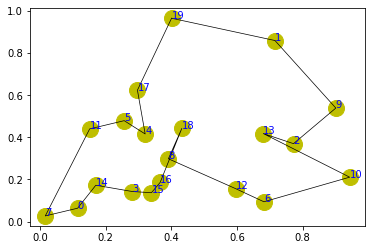

step:990/5000, actic loss:-1.211, critic loss:1.067, L:5.552, 0min1sec
step:991/5000, actic loss:-1.210, critic loss:1.066, L:5.550, 0min1sec
step:992/5000, actic loss:-1.209, critic loss:1.066, L:5.549, 0min1sec
step:993/5000, actic loss:-1.209, critic loss:1.065, L:5.548, 0min1sec
step:994/5000, actic loss:-1.207, critic loss:1.064, L:5.547, 0min1sec
distance:4.427
tensor([16, 19, 13,  3, 14,  5,  1,  4,  8, 15,  9, 12, 10, 17,  2, 18, 11,  6,
         7,  0])


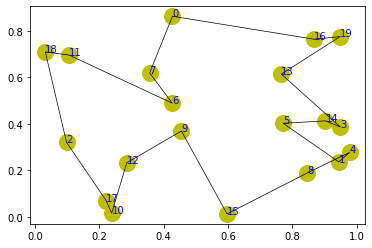

step:995/5000, actic loss:-1.206, critic loss:1.063, L:5.546, 0min1sec
step:996/5000, actic loss:-1.204, critic loss:1.062, L:5.545, 0min1sec
step:997/5000, actic loss:-1.202, critic loss:1.062, L:5.544, 0min1sec
step:998/5000, actic loss:-1.201, critic loss:1.061, L:5.542, 0min1sec
step:999/5000, actic loss:-1.200, critic loss:1.060, L:5.541, 0min1sec
distance:4.510
tensor([ 1, 11,  6, 17,  2,  7, 16, 14, 19, 18, 10,  8,  4,  3,  9, 15,  5, 13,
         0, 12])


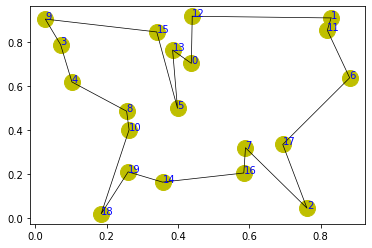

step:1000/5000, actic loss:-1.200, critic loss:1.059, L:5.540, 0min1sec
step:1001/5000, actic loss:-1.199, critic loss:1.058, L:5.539, 0min1sec
step:1002/5000, actic loss:-1.198, critic loss:1.057, L:5.538, 0min1sec
step:1003/5000, actic loss:-1.197, critic loss:1.057, L:5.537, 0min1sec
step:1004/5000, actic loss:-1.195, critic loss:1.056, L:5.536, 0min1sec
distance:4.094
tensor([ 1, 12,  2, 11, 15, 13, 17,  9, 10, 14,  8,  7,  3, 19,  4, 16,  6,  5,
        18,  0])


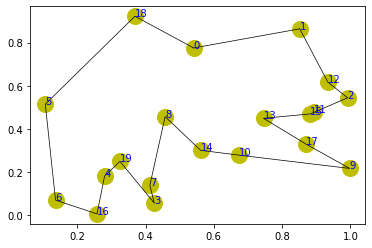

step:1005/5000, actic loss:-1.193, critic loss:1.055, L:5.534, 0min1sec
step:1006/5000, actic loss:-1.192, critic loss:1.054, L:5.533, 0min1sec
step:1007/5000, actic loss:-1.191, critic loss:1.053, L:5.532, 0min1sec
step:1008/5000, actic loss:-1.191, critic loss:1.053, L:5.531, 0min1sec
step:1009/5000, actic loss:-1.190, critic loss:1.052, L:5.530, 0min1sec
distance:4.129
tensor([13, 15, 18, 12,  1,  2,  7,  9,  8, 14, 19, 10, 17,  0,  6,  5, 11, 16,
         4,  3])


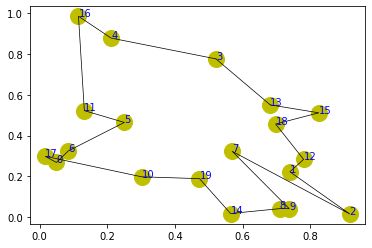

step:1010/5000, actic loss:-1.189, critic loss:1.051, L:5.529, 0min1sec
step:1011/5000, actic loss:-1.188, critic loss:1.050, L:5.528, 0min1sec
step:1012/5000, actic loss:-1.186, critic loss:1.049, L:5.527, 0min1sec
step:1013/5000, actic loss:-1.184, critic loss:1.049, L:5.525, 0min1sec
step:1014/5000, actic loss:-1.183, critic loss:1.048, L:5.524, 0min1sec
distance:3.798
tensor([17,  5,  4,  1,  3, 16, 14,  2, 19, 15, 10,  6, 18, 11,  9,  0, 12,  8,
        13,  7])


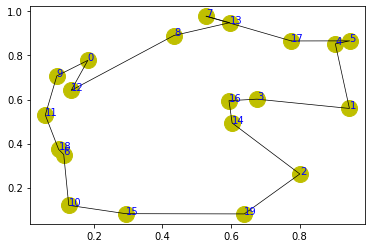

step:1015/5000, actic loss:-1.182, critic loss:1.047, L:5.523, 0min1sec
step:1016/5000, actic loss:-1.182, critic loss:1.046, L:5.522, 0min1sec
step:1017/5000, actic loss:-1.181, critic loss:1.045, L:5.521, 0min1sec
step:1018/5000, actic loss:-1.180, critic loss:1.045, L:5.520, 0min1sec
step:1019/5000, actic loss:-1.179, critic loss:1.044, L:5.519, 0min1sec
distance:4.963
tensor([14,  5,  8, 17, 15, 12, 19,  4,  9, 11,  1,  3, 13,  6,  2,  7, 18, 10,
         0, 16])


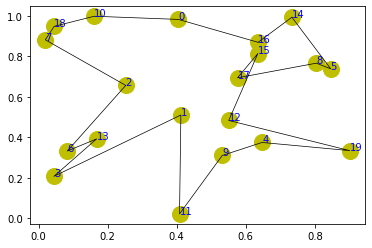

step:1020/5000, actic loss:-1.177, critic loss:1.043, L:5.518, 0min1sec
step:1021/5000, actic loss:-1.177, critic loss:1.042, L:5.517, 0min1sec
step:1022/5000, actic loss:-1.176, critic loss:1.041, L:5.516, 0min1sec
step:1023/5000, actic loss:-1.175, critic loss:1.041, L:5.514, 0min1sec
step:1024/5000, actic loss:-1.173, critic loss:1.040, L:5.513, 0min1sec
distance:4.054
tensor([ 7,  0, 15, 19, 12,  4,  6, 17, 14,  8,  3, 11, 18,  5, 13, 16, 10,  9,
         1,  2])


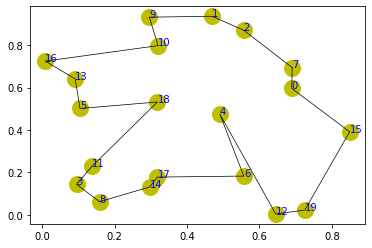

step:1025/5000, actic loss:-1.172, critic loss:1.039, L:5.512, 0min1sec
step:1026/5000, actic loss:-1.171, critic loss:1.038, L:5.511, 0min1sec
step:1027/5000, actic loss:-1.170, critic loss:1.037, L:5.510, 0min1sec
step:1028/5000, actic loss:-1.170, critic loss:1.036, L:5.509, 0min1sec
step:1029/5000, actic loss:-1.169, critic loss:1.035, L:5.507, 0min1sec
distance:4.595
tensor([ 9,  0,  1, 11, 17, 15,  6,  8, 14,  7, 12,  2,  5, 10, 18, 16, 19,  4,
        13,  3])


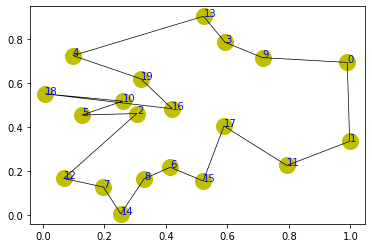

step:1030/5000, actic loss:-1.168, critic loss:1.035, L:5.506, 0min1sec
step:1031/5000, actic loss:-1.166, critic loss:1.034, L:5.505, 0min2sec
step:1032/5000, actic loss:-1.165, critic loss:1.033, L:5.504, 0min1sec
step:1033/5000, actic loss:-1.164, critic loss:1.032, L:5.503, 0min1sec
step:1034/5000, actic loss:-1.163, critic loss:1.032, L:5.502, 0min1sec
distance:3.592
tensor([ 1, 10,  2, 19, 16, 13,  9, 18, 12,  4,  5, 14,  3,  7,  6, 11, 15,  0,
         8, 17])


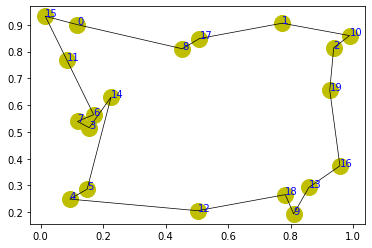

step:1035/5000, actic loss:-1.163, critic loss:1.031, L:5.501, 0min2sec
step:1036/5000, actic loss:-1.161, critic loss:1.030, L:5.500, 0min1sec
step:1037/5000, actic loss:-1.160, critic loss:1.029, L:5.499, 0min1sec
step:1038/5000, actic loss:-1.160, critic loss:1.029, L:5.498, 0min1sec
step:1039/5000, actic loss:-1.159, critic loss:1.028, L:5.497, 0min1sec
distance:4.263
tensor([ 8, 16,  1,  5,  3,  6,  2, 18, 11, 13,  4, 19,  0,  7, 10, 17,  9, 15,
        12, 14])


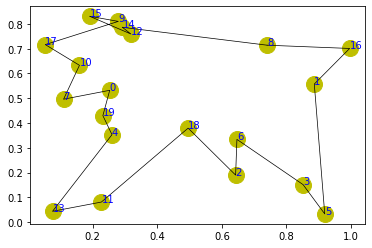

step:1040/5000, actic loss:-1.157, critic loss:1.027, L:5.495, 0min2sec
step:1041/5000, actic loss:-1.156, critic loss:1.026, L:5.494, 0min1sec
step:1042/5000, actic loss:-1.155, critic loss:1.025, L:5.493, 0min1sec
step:1043/5000, actic loss:-1.154, critic loss:1.025, L:5.492, 0min1sec
step:1044/5000, actic loss:-1.154, critic loss:1.024, L:5.491, 0min1sec
distance:4.414
tensor([ 7, 11, 10,  4, 17, 13, 16, 14,  0, 19,  2,  8, 18,  6,  5, 15,  1,  3,
        12,  9])


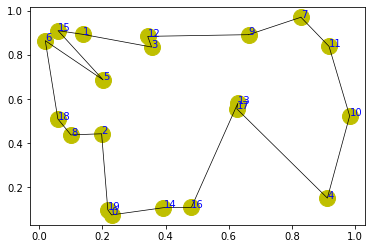

step:1045/5000, actic loss:-1.153, critic loss:1.023, L:5.490, 0min1sec
step:1046/5000, actic loss:-1.153, critic loss:1.022, L:5.489, 0min1sec
step:1047/5000, actic loss:-1.152, critic loss:1.022, L:5.487, 0min1sec
step:1048/5000, actic loss:-1.150, critic loss:1.021, L:5.486, 0min1sec
step:1049/5000, actic loss:-1.149, critic loss:1.020, L:5.485, 0min1sec
distance:4.781
tensor([11, 19, 18, 12,  5,  0, 15,  2,  1,  3,  6, 10, 14,  7,  9,  4,  8, 16,
        13, 17])


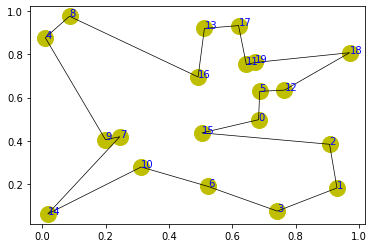

step:1050/5000, actic loss:-1.148, critic loss:1.019, L:5.484, 0min2sec
step:1051/5000, actic loss:-1.147, critic loss:1.019, L:5.483, 0min1sec
step:1052/5000, actic loss:-1.146, critic loss:1.018, L:5.482, 0min1sec
step:1053/5000, actic loss:-1.145, critic loss:1.017, L:5.481, 0min1sec
step:1054/5000, actic loss:-1.144, critic loss:1.016, L:5.480, 0min1sec
distance:3.938
tensor([ 8, 12, 16, 18, 17,  7, 14,  4, 11, 15, 19,  3,  1, 13,  2,  0,  9, 10,
         6,  5])


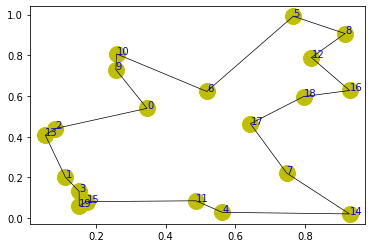

step:1055/5000, actic loss:-1.143, critic loss:1.015, L:5.479, 0min1sec
step:1056/5000, actic loss:-1.142, critic loss:1.015, L:5.477, 0min1sec
step:1057/5000, actic loss:-1.141, critic loss:1.014, L:5.476, 0min1sec
step:1058/5000, actic loss:-1.140, critic loss:1.013, L:5.475, 0min1sec
step:1059/5000, actic loss:-1.139, critic loss:1.012, L:5.474, 0min1sec
distance:5.325
tensor([16, 11,  3, 15,  8,  4, 12,  7, 13, 19, 18,  5,  0,  6,  2, 17, 10, 14,
         9,  1])


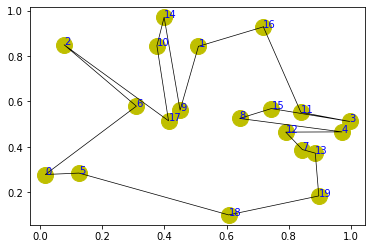

step:1060/5000, actic loss:-1.138, critic loss:1.011, L:5.473, 0min2sec
step:1061/5000, actic loss:-1.138, critic loss:1.011, L:5.472, 0min1sec
step:1062/5000, actic loss:-1.137, critic loss:1.010, L:5.471, 0min1sec
step:1063/5000, actic loss:-1.136, critic loss:1.009, L:5.470, 0min1sec
step:1064/5000, actic loss:-1.135, critic loss:1.008, L:5.468, 0min1sec
distance:3.707
tensor([12, 17,  1,  9,  4,  6, 15, 11,  5,  2, 18,  7, 14, 16,  3, 10,  8, 19,
         0, 13])


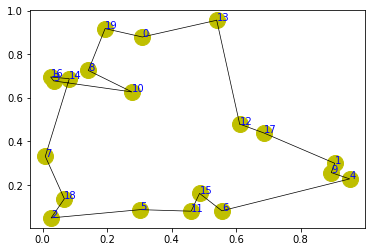

step:1065/5000, actic loss:-1.133, critic loss:1.008, L:5.467, 0min1sec
step:1066/5000, actic loss:-1.132, critic loss:1.007, L:5.466, 0min2sec
step:1067/5000, actic loss:-1.131, critic loss:1.006, L:5.465, 0min2sec
step:1068/5000, actic loss:-1.130, critic loss:1.005, L:5.464, 0min1sec
step:1069/5000, actic loss:-1.130, critic loss:1.005, L:5.463, 0min1sec
distance:4.403
tensor([19, 10, 15, 11,  2, 18,  0,  4, 16, 12, 17,  9,  7,  6,  3, 14,  1,  5,
        13,  8])


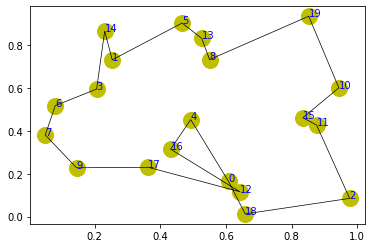

step:1070/5000, actic loss:-1.129, critic loss:1.004, L:5.462, 0min2sec
step:1071/5000, actic loss:-1.128, critic loss:1.003, L:5.461, 0min1sec
step:1072/5000, actic loss:-1.127, critic loss:1.002, L:5.460, 0min1sec
step:1073/5000, actic loss:-1.125, critic loss:1.002, L:5.459, 0min1sec
step:1074/5000, actic loss:-1.124, critic loss:1.001, L:5.458, 0min1sec
distance:4.369
tensor([18,  0, 15, 16,  6, 10,  9, 13,  5, 14, 17,  2,  3,  4,  8,  1, 11,  7,
        12, 19])


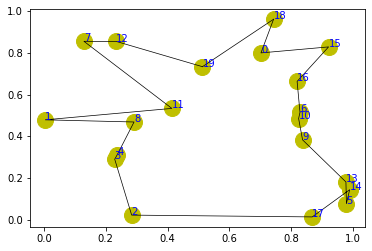

step:1075/5000, actic loss:-1.124, critic loss:1.000, L:5.457, 0min2sec
step:1076/5000, actic loss:-1.124, critic loss:0.999, L:5.455, 0min2sec
step:1077/5000, actic loss:-1.123, critic loss:0.999, L:5.454, 0min2sec
step:1078/5000, actic loss:-1.122, critic loss:0.998, L:5.453, 0min1sec
step:1079/5000, actic loss:-1.121, critic loss:0.997, L:5.452, 0min1sec
distance:3.779
tensor([19,  3, 11,  5, 12,  9,  6,  4,  7, 14,  8, 17, 16,  1, 10,  0, 13,  2,
        18, 15])


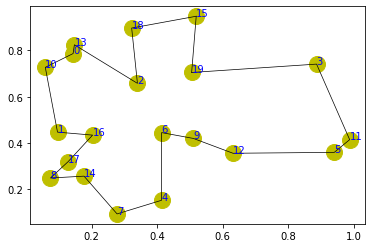

step:1080/5000, actic loss:-1.120, critic loss:0.996, L:5.451, 0min2sec
step:1081/5000, actic loss:-1.118, critic loss:0.996, L:5.450, 0min1sec
step:1082/5000, actic loss:-1.117, critic loss:0.995, L:5.449, 0min2sec
step:1083/5000, actic loss:-1.116, critic loss:0.994, L:5.448, 0min1sec
step:1084/5000, actic loss:-1.115, critic loss:0.993, L:5.447, 0min1sec
distance:4.639
tensor([ 6,  1, 12, 10,  9, 17,  0, 15, 14,  4, 13,  5,  8, 16,  2, 18,  3, 11,
        19,  7])


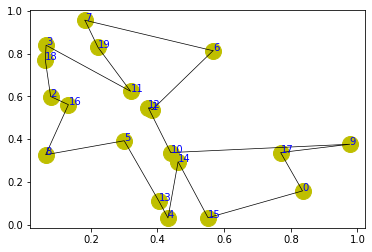

step:1085/5000, actic loss:-1.115, critic loss:0.993, L:5.446, 0min2sec
step:1086/5000, actic loss:-1.114, critic loss:0.992, L:5.445, 0min1sec
step:1087/5000, actic loss:-1.113, critic loss:0.991, L:5.444, 0min1sec
step:1088/5000, actic loss:-1.112, critic loss:0.990, L:5.443, 0min1sec
step:1089/5000, actic loss:-1.111, critic loss:0.990, L:5.442, 0min2sec
distance:3.930
tensor([12,  1,  0,  6, 19, 17,  3, 10,  8, 11, 14,  5, 13, 18,  9,  2, 15,  4,
         7, 16])


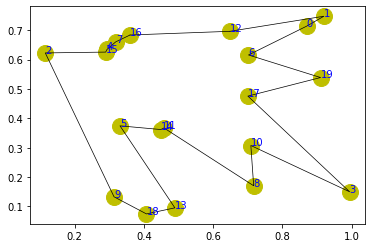

step:1090/5000, actic loss:-1.110, critic loss:0.989, L:5.441, 0min2sec
step:1091/5000, actic loss:-1.109, critic loss:0.988, L:5.440, 0min1sec
step:1092/5000, actic loss:-1.108, critic loss:0.987, L:5.439, 0min1sec
step:1093/5000, actic loss:-1.107, critic loss:0.987, L:5.438, 0min2sec
step:1094/5000, actic loss:-1.106, critic loss:0.986, L:5.437, 0min1sec
distance:4.356
tensor([ 9, 17,  1, 11,  2,  3,  4,  0, 13, 10, 18, 12,  6, 16,  8, 19,  5,  7,
        15, 14])


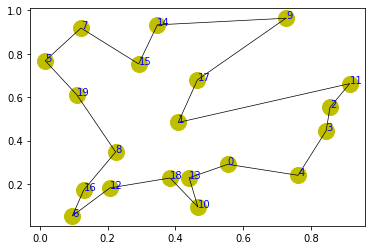

step:1095/5000, actic loss:-1.105, critic loss:0.985, L:5.436, 0min2sec
step:1096/5000, actic loss:-1.104, critic loss:0.984, L:5.435, 0min1sec
step:1097/5000, actic loss:-1.103, critic loss:0.984, L:5.434, 0min2sec
step:1098/5000, actic loss:-1.102, critic loss:0.983, L:5.433, 0min1sec
step:1099/5000, actic loss:-1.101, critic loss:0.982, L:5.432, 0min2sec
distance:4.840
tensor([ 7,  0, 18,  8, 19,  4, 11, 10,  9,  2,  5, 17, 15, 13, 14,  6, 16,  3,
         1, 12])


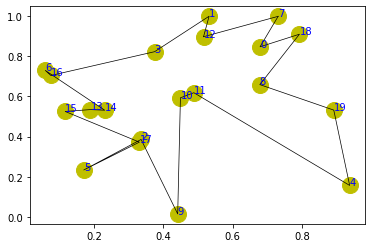

step:1100/5000, actic loss:-1.100, critic loss:0.982, L:5.431, 0min2sec
step:1101/5000, actic loss:-1.100, critic loss:0.981, L:5.430, 0min2sec
step:1102/5000, actic loss:-1.098, critic loss:0.980, L:5.429, 0min1sec
step:1103/5000, actic loss:-1.097, critic loss:0.980, L:5.428, 0min2sec
step:1104/5000, actic loss:-1.096, critic loss:0.979, L:5.427, 0min1sec
distance:4.265
tensor([16,  8, 19,  5, 14, 11, 17, 15, 13,  6,  0,  3,  2,  9, 12, 18,  1,  4,
        10,  7])


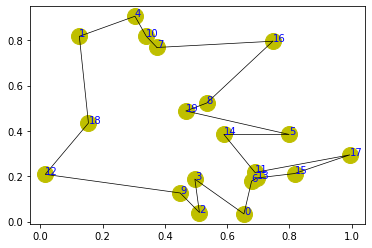

step:1105/5000, actic loss:-1.096, critic loss:0.978, L:5.426, 0min2sec
step:1106/5000, actic loss:-1.095, critic loss:0.977, L:5.425, 0min1sec
step:1107/5000, actic loss:-1.094, critic loss:0.977, L:5.424, 0min2sec
step:1108/5000, actic loss:-1.093, critic loss:0.976, L:5.423, 0min2sec
step:1109/5000, actic loss:-1.092, critic loss:0.975, L:5.422, 0min2sec
distance:4.268
tensor([ 3, 13,  8,  4,  9, 15, 18,  0, 12,  5, 11, 10, 19, 17, 16,  1,  2,  6,
         7, 14])


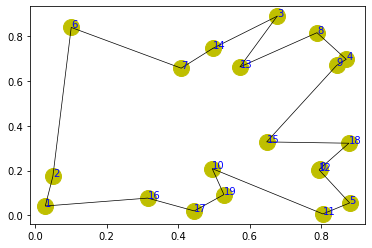

step:1110/5000, actic loss:-1.091, critic loss:0.975, L:5.422, 0min2sec
step:1111/5000, actic loss:-1.090, critic loss:0.974, L:5.421, 0min2sec
step:1112/5000, actic loss:-1.089, critic loss:0.973, L:5.420, 0min2sec
step:1113/5000, actic loss:-1.088, critic loss:0.973, L:5.419, 0min2sec
step:1114/5000, actic loss:-1.087, critic loss:0.972, L:5.418, 0min2sec
distance:4.429
tensor([15, 12,  9,  4, 13,  6, 17,  5, 18, 19,  7, 14, 16, 10,  0,  2,  8, 11,
         3,  1])


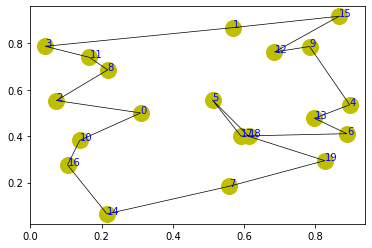

step:1115/5000, actic loss:-1.087, critic loss:0.971, L:5.417, 0min2sec
step:1116/5000, actic loss:-1.086, critic loss:0.971, L:5.416, 0min2sec
step:1117/5000, actic loss:-1.085, critic loss:0.970, L:5.415, 0min2sec
step:1118/5000, actic loss:-1.084, critic loss:0.969, L:5.414, 0min1sec
step:1119/5000, actic loss:-1.083, critic loss:0.969, L:5.413, 0min2sec
distance:4.102
tensor([ 5,  2,  4, 10,  7,  6, 18,  9, 11, 14, 16, 19,  3,  8, 17, 13,  1,  0,
        15, 12])


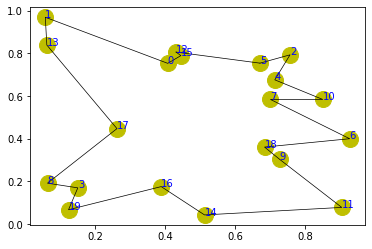

step:1120/5000, actic loss:-1.083, critic loss:0.968, L:5.412, 0min2sec
step:1121/5000, actic loss:-1.082, critic loss:0.967, L:5.411, 0min2sec
step:1122/5000, actic loss:-1.080, critic loss:0.967, L:5.410, 0min2sec
step:1123/5000, actic loss:-1.079, critic loss:0.966, L:5.409, 0min2sec
step:1124/5000, actic loss:-1.078, critic loss:0.965, L:5.408, 0min1sec
distance:4.229
tensor([10, 16, 15,  1, 18, 12, 17,  6, 13, 19,  3,  2,  7, 11,  0,  5,  8, 14,
         9,  4])


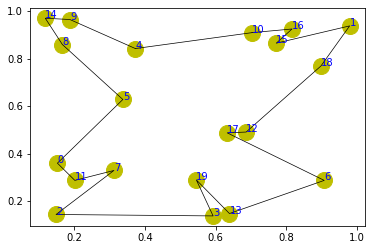

step:1125/5000, actic loss:-1.078, critic loss:0.965, L:5.407, 0min2sec
step:1126/5000, actic loss:-1.077, critic loss:0.964, L:5.406, 0min1sec
step:1127/5000, actic loss:-1.076, critic loss:0.963, L:5.405, 0min2sec
step:1128/5000, actic loss:-1.075, critic loss:0.963, L:5.405, 0min2sec
step:1129/5000, actic loss:-1.074, critic loss:0.962, L:5.404, 0min2sec
distance:4.419
tensor([ 0, 10,  5,  9,  4,  3, 18, 11,  2,  1, 13,  7, 12, 17,  6, 16, 14, 19,
         8, 15])


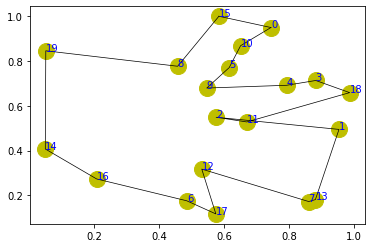

step:1130/5000, actic loss:-1.073, critic loss:0.961, L:5.403, 0min2sec
step:1131/5000, actic loss:-1.073, critic loss:0.961, L:5.402, 0min2sec
step:1132/5000, actic loss:-1.071, critic loss:0.960, L:5.401, 0min2sec
step:1133/5000, actic loss:-1.071, critic loss:0.959, L:5.400, 0min2sec
step:1134/5000, actic loss:-1.070, critic loss:0.958, L:5.399, 0min2sec
distance:3.845
tensor([ 3,  1, 17, 16, 13, 19,  5, 14,  2, 10, 18, 15,  7,  0,  8, 12,  4, 11,
         6,  9])


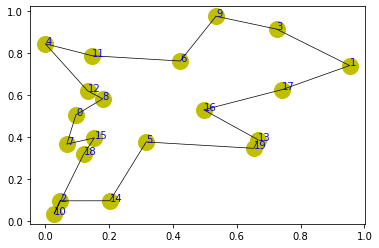

step:1135/5000, actic loss:-1.069, critic loss:0.958, L:5.398, 0min3sec
step:1136/5000, actic loss:-1.068, critic loss:0.957, L:5.397, 0min2sec
step:1137/5000, actic loss:-1.067, critic loss:0.956, L:5.396, 0min2sec
step:1138/5000, actic loss:-1.066, critic loss:0.956, L:5.395, 0min2sec
step:1139/5000, actic loss:-1.065, critic loss:0.955, L:5.395, 0min1sec
distance:4.663
tensor([ 9,  1,  6, 18, 13, 19,  7, 12,  3, 10, 15, 11, 17,  4, 16,  5,  8, 14,
         0,  2])


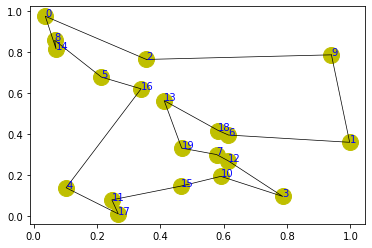

step:1140/5000, actic loss:-1.065, critic loss:0.954, L:5.394, 0min2sec
step:1141/5000, actic loss:-1.064, critic loss:0.954, L:5.393, 0min2sec
step:1142/5000, actic loss:-1.063, critic loss:0.953, L:5.392, 0min2sec
step:1143/5000, actic loss:-1.062, critic loss:0.952, L:5.391, 0min2sec
step:1144/5000, actic loss:-1.061, critic loss:0.952, L:5.390, 0min2sec
distance:4.389
tensor([13, 17,  8,  2,  1,  6, 14,  0, 18,  7, 19, 10,  4, 11, 16, 12,  9,  5,
         3, 15])


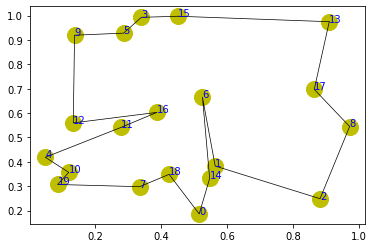

step:1145/5000, actic loss:-1.060, critic loss:0.951, L:5.389, 0min2sec
step:1146/5000, actic loss:-1.059, critic loss:0.950, L:5.388, 0min2sec
step:1147/5000, actic loss:-1.059, critic loss:0.950, L:5.387, 0min2sec
step:1148/5000, actic loss:-1.058, critic loss:0.949, L:5.386, 0min3sec
step:1149/5000, actic loss:-1.057, critic loss:0.948, L:5.385, 0min2sec
distance:3.868
tensor([ 4, 15, 11,  1,  7,  8,  2,  3, 16,  0,  6, 12, 13, 19, 14, 10,  9, 17,
        18,  5])


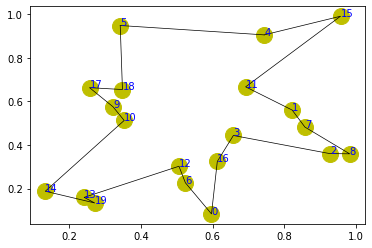

step:1150/5000, actic loss:-1.056, critic loss:0.948, L:5.384, 0min2sec
step:1151/5000, actic loss:-1.055, critic loss:0.947, L:5.383, 0min2sec
step:1152/5000, actic loss:-1.055, critic loss:0.946, L:5.382, 0min2sec
step:1153/5000, actic loss:-1.054, critic loss:0.946, L:5.381, 0min2sec
step:1154/5000, actic loss:-1.053, critic loss:0.945, L:5.380, 0min2sec
distance:4.381
tensor([ 8,  4, 14,  3, 12, 18, 13, 19, 16, 17,  1,  5,  0,  2,  7, 11, 10,  6,
        15,  9])


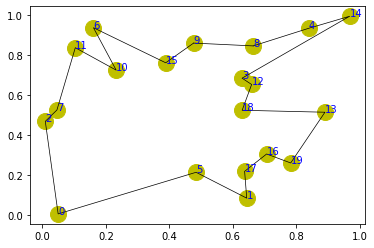

step:1155/5000, actic loss:-1.052, critic loss:0.944, L:5.380, 0min2sec
step:1156/5000, actic loss:-1.051, critic loss:0.944, L:5.379, 0min2sec
step:1157/5000, actic loss:-1.051, critic loss:0.943, L:5.378, 0min1sec
step:1158/5000, actic loss:-1.050, critic loss:0.942, L:5.377, 0min2sec
step:1159/5000, actic loss:-1.049, critic loss:0.942, L:5.376, 0min2sec
distance:4.385
tensor([ 8,  0, 16,  9,  2, 17,  4,  3, 11,  1, 13, 10, 14, 15,  5,  7, 12, 18,
        19,  6])


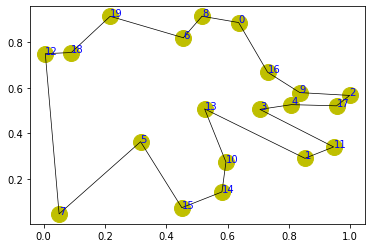

step:1160/5000, actic loss:-1.048, critic loss:0.941, L:5.375, 0min3sec
step:1161/5000, actic loss:-1.047, critic loss:0.940, L:5.374, 0min2sec
step:1162/5000, actic loss:-1.046, critic loss:0.940, L:5.373, 0min2sec
step:1163/5000, actic loss:-1.045, critic loss:0.939, L:5.372, 0min2sec
step:1164/5000, actic loss:-1.044, critic loss:0.938, L:5.371, 0min2sec
distance:3.754
tensor([10,  7,  2,  0, 19, 18, 17,  3,  1, 11, 12, 14,  5, 13,  6,  4, 15,  9,
         8, 16])


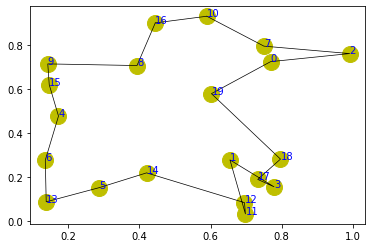

step:1165/5000, actic loss:-1.043, critic loss:0.938, L:5.371, 0min3sec
step:1166/5000, actic loss:-1.043, critic loss:0.937, L:5.370, 0min2sec
step:1167/5000, actic loss:-1.042, critic loss:0.937, L:5.369, 0min2sec
step:1168/5000, actic loss:-1.041, critic loss:0.936, L:5.368, 0min1sec
step:1169/5000, actic loss:-1.040, critic loss:0.935, L:5.367, 0min2sec
distance:3.826
tensor([ 5, 18,  7, 12,  2,  9, 19, 15,  1, 11, 16,  4, 14,  3, 17, 10,  6,  8,
         0, 13])


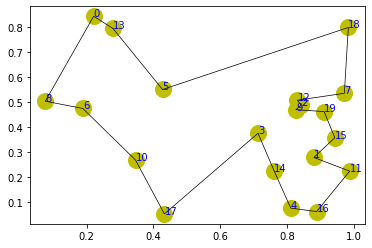

step:1170/5000, actic loss:-1.040, critic loss:0.935, L:5.366, 0min2sec
step:1171/5000, actic loss:-1.039, critic loss:0.934, L:5.366, 0min3sec
step:1172/5000, actic loss:-1.039, critic loss:0.934, L:5.365, 0min3sec
step:1173/5000, actic loss:-1.039, critic loss:0.933, L:5.364, 0min1sec
step:1174/5000, actic loss:-1.038, critic loss:0.932, L:5.364, 0min1sec
distance:5.003
tensor([ 7,  6, 13, 10,  1,  5, 17, 19,  4, 12, 14, 15, 16,  2,  9, 11,  3,  8,
         0, 18])


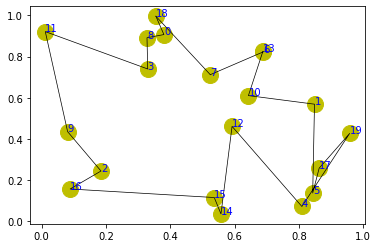

step:1175/5000, actic loss:-1.037, critic loss:0.932, L:5.363, 0min2sec
step:1176/5000, actic loss:-1.036, critic loss:0.931, L:5.362, 0min2sec
step:1177/5000, actic loss:-1.035, critic loss:0.931, L:5.362, 0min1sec
step:1178/5000, actic loss:-1.035, critic loss:0.930, L:5.361, 0min2sec
step:1179/5000, actic loss:-1.034, critic loss:0.929, L:5.360, 0min2sec
distance:3.801
tensor([13, 12,  7, 19,  5,  4,  8,  0, 14, 15,  1, 10, 16,  2, 17,  3,  9,  6,
        11, 18])


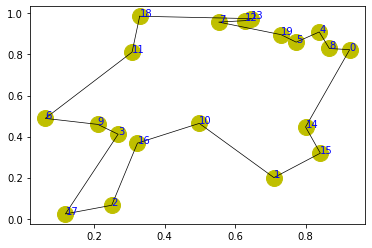

step:1180/5000, actic loss:-1.033, critic loss:0.929, L:5.359, 0min2sec
step:1181/5000, actic loss:-1.032, critic loss:0.928, L:5.359, 0min1sec
step:1182/5000, actic loss:-1.031, critic loss:0.927, L:5.358, 0min1sec
step:1183/5000, actic loss:-1.030, critic loss:0.927, L:5.357, 0min3sec
step:1184/5000, actic loss:-1.030, critic loss:0.926, L:5.356, 0min2sec
distance:4.411
tensor([18,  4,  5,  6, 12, 14, 16,  9,  1, 10, 11,  8, 17,  7, 15, 13, 19,  3,
         2,  0])


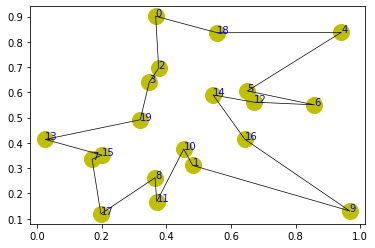

step:1185/5000, actic loss:-1.030, critic loss:0.926, L:5.355, 0min2sec
step:1186/5000, actic loss:-1.029, critic loss:0.925, L:5.354, 0min2sec
step:1187/5000, actic loss:-1.027, critic loss:0.924, L:5.354, 0min2sec
step:1188/5000, actic loss:-1.027, critic loss:0.924, L:5.353, 0min1sec
step:1189/5000, actic loss:-1.026, critic loss:0.923, L:5.352, 0min2sec
distance:4.665
tensor([13,  7, 19, 11,  9,  2,  8, 10, 16, 14, 17,  3,  5,  1,  0, 15, 12,  4,
         6, 18])


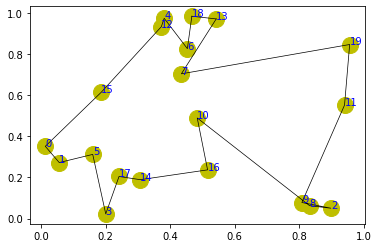

step:1190/5000, actic loss:-1.026, critic loss:0.923, L:5.351, 0min2sec
step:1191/5000, actic loss:-1.025, critic loss:0.922, L:5.350, 0min3sec
step:1192/5000, actic loss:-1.024, critic loss:0.921, L:5.349, 0min3sec
step:1193/5000, actic loss:-1.023, critic loss:0.921, L:5.349, 0min2sec
step:1194/5000, actic loss:-1.022, critic loss:0.920, L:5.348, 0min2sec
distance:5.011
tensor([ 0, 10,  3,  5,  1,  6,  8, 15, 18, 12,  7, 17,  4, 14,  9, 19, 16,  2,
        11, 13])


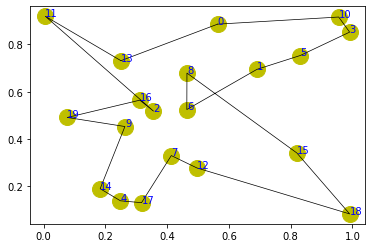

step:1195/5000, actic loss:-1.021, critic loss:0.920, L:5.347, 0min2sec
step:1196/5000, actic loss:-1.021, critic loss:0.919, L:5.346, 0min3sec
step:1197/5000, actic loss:-1.021, critic loss:0.919, L:5.345, 0min3sec
step:1198/5000, actic loss:-1.021, critic loss:0.918, L:5.344, 0min2sec
step:1199/5000, actic loss:-1.020, critic loss:0.917, L:5.344, 0min3sec
distance:4.065
tensor([ 4, 15,  1, 12,  8,  0,  7, 11, 13,  9, 19, 10,  2, 16,  5, 18,  6,  3,
        17, 14])


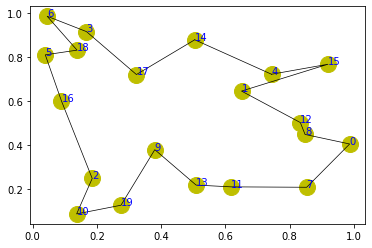

step:1200/5000, actic loss:-1.019, critic loss:0.917, L:5.343, 0min3sec
step:1201/5000, actic loss:-1.017, critic loss:0.916, L:5.342, 0min2sec
step:1202/5000, actic loss:-1.016, critic loss:0.916, L:5.341, 0min3sec
step:1203/5000, actic loss:-1.015, critic loss:0.915, L:5.340, 0min3sec
step:1204/5000, actic loss:-1.014, critic loss:0.915, L:5.339, 0min3sec
distance:4.231
tensor([13, 17,  5,  1, 10, 12,  9,  2,  0,  6,  4, 16,  8, 15, 18,  3, 11, 19,
        14,  7])


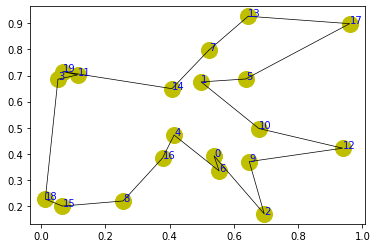

step:1205/5000, actic loss:-1.014, critic loss:0.914, L:5.339, 0min3sec
step:1206/5000, actic loss:-1.013, critic loss:0.914, L:5.338, 0min2sec
step:1207/5000, actic loss:-1.013, critic loss:0.913, L:5.337, 0min1sec
step:1208/5000, actic loss:-1.012, critic loss:0.912, L:5.336, 0min3sec
step:1209/5000, actic loss:-1.011, critic loss:0.912, L:5.335, 0min3sec
distance:4.520
tensor([12,  0, 10,  5,  9,  1, 17, 15, 18,  3,  6, 19,  7,  4, 16,  2, 11,  8,
        14, 13])


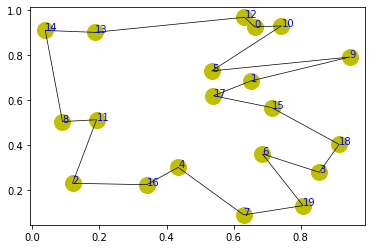

step:1210/5000, actic loss:-1.010, critic loss:0.911, L:5.335, 0min2sec
step:1211/5000, actic loss:-1.010, critic loss:0.911, L:5.334, 0min2sec
step:1212/5000, actic loss:-1.009, critic loss:0.910, L:5.333, 0min1sec
step:1213/5000, actic loss:-1.008, critic loss:0.910, L:5.332, 0min2sec
step:1214/5000, actic loss:-1.007, critic loss:0.909, L:5.332, 0min1sec
distance:4.531
tensor([ 0, 11,  5, 14,  4,  2,  1,  7,  9,  6, 19, 18, 12, 13, 17, 10,  8,  3,
        16, 15])


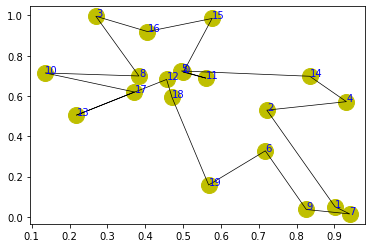

step:1215/5000, actic loss:-1.006, critic loss:0.908, L:5.331, 0min2sec
step:1216/5000, actic loss:-1.005, critic loss:0.908, L:5.330, 0min2sec
step:1217/5000, actic loss:-1.005, critic loss:0.907, L:5.329, 0min2sec
step:1218/5000, actic loss:-1.004, critic loss:0.907, L:5.329, 0min1sec
step:1219/5000, actic loss:-1.004, critic loss:0.906, L:5.328, 0min2sec
distance:3.819
tensor([ 4,  9, 15, 19, 16, 17, 13, 14,  7,  3,  1, 10, 12,  2, 18,  5,  0,  8,
         6, 11])


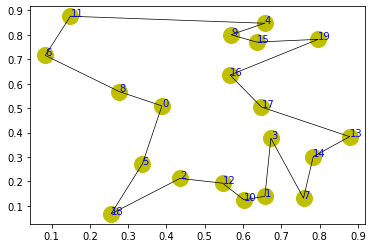

step:1220/5000, actic loss:-1.003, critic loss:0.906, L:5.327, 0min2sec
step:1221/5000, actic loss:-1.002, critic loss:0.905, L:5.327, 0min2sec
step:1222/5000, actic loss:-1.001, critic loss:0.905, L:5.326, 0min2sec
step:1223/5000, actic loss:-0.999, critic loss:0.904, L:5.325, 0min1sec
step:1224/5000, actic loss:-0.999, critic loss:0.904, L:5.324, 0min1sec
distance:4.426
tensor([ 6, 15, 16, 17,  0,  8,  5,  2, 13,  3, 14, 12, 11,  1, 18, 19,  9, 10,
         4,  7])


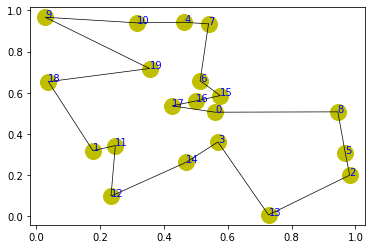

step:1225/5000, actic loss:-0.998, critic loss:0.903, L:5.324, 0min2sec
step:1226/5000, actic loss:-0.998, critic loss:0.903, L:5.323, 0min1sec
step:1227/5000, actic loss:-0.997, critic loss:0.902, L:5.322, 0min1sec
step:1228/5000, actic loss:-0.997, critic loss:0.901, L:5.321, 0min2sec
step:1229/5000, actic loss:-0.996, critic loss:0.901, L:5.320, 0min2sec
distance:3.871
tensor([ 1, 11, 18, 10,  6,  5,  4,  9, 14,  2,  7, 17, 13,  3, 19, 16, 12,  0,
         8, 15])


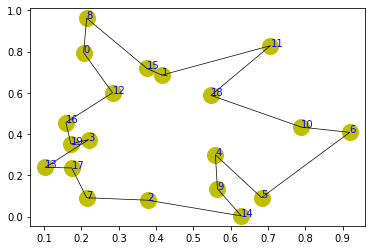

step:1230/5000, actic loss:-0.995, critic loss:0.900, L:5.320, 0min2sec
step:1231/5000, actic loss:-0.994, critic loss:0.900, L:5.319, 0min2sec
step:1232/5000, actic loss:-0.993, critic loss:0.899, L:5.318, 0min2sec
step:1233/5000, actic loss:-0.992, critic loss:0.899, L:5.318, 0min2sec
step:1234/5000, actic loss:-0.991, critic loss:0.898, L:5.317, 0min2sec
distance:5.026
tensor([16, 10,  2,  9,  3, 19, 13,  1, 12,  0, 14, 17, 11,  5, 18,  7,  6, 15,
         4,  8])


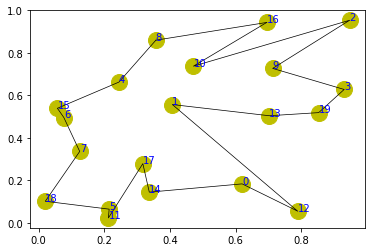

step:1235/5000, actic loss:-0.990, critic loss:0.898, L:5.316, 0min2sec
step:1236/5000, actic loss:-0.990, critic loss:0.897, L:5.315, 0min2sec
step:1237/5000, actic loss:-0.989, critic loss:0.897, L:5.315, 0min2sec
step:1238/5000, actic loss:-0.989, critic loss:0.896, L:5.314, 0min2sec
step:1239/5000, actic loss:-0.988, critic loss:0.895, L:5.313, 0min2sec
distance:4.555
tensor([ 0,  2, 11,  3, 14,  4,  5, 19, 16,  8,  7, 13,  9, 17,  1, 18, 12, 15,
         6, 10])


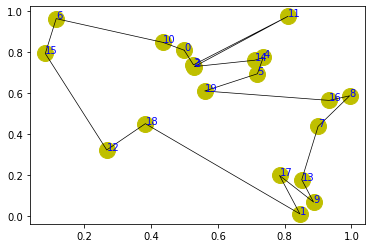

step:1240/5000, actic loss:-0.987, critic loss:0.895, L:5.312, 0min2sec
step:1241/5000, actic loss:-0.986, critic loss:0.894, L:5.312, 0min2sec
step:1242/5000, actic loss:-0.985, critic loss:0.894, L:5.311, 0min2sec
step:1243/5000, actic loss:-0.985, critic loss:0.893, L:5.310, 0min2sec
step:1244/5000, actic loss:-0.984, critic loss:0.893, L:5.309, 0min2sec
distance:4.425
tensor([ 4, 12,  6, 10, 14, 15,  9,  8,  2, 16,  5,  0,  1, 17, 19, 18,  3, 13,
         7, 11])


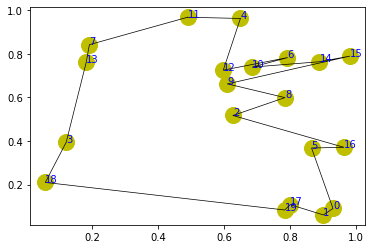

step:1245/5000, actic loss:-0.983, critic loss:0.892, L:5.309, 0min2sec
step:1246/5000, actic loss:-0.982, critic loss:0.892, L:5.308, 0min3sec
step:1247/5000, actic loss:-0.981, critic loss:0.891, L:5.307, 0min1sec
step:1248/5000, actic loss:-0.981, critic loss:0.890, L:5.306, 0min2sec
step:1249/5000, actic loss:-0.980, critic loss:0.890, L:5.306, 0min2sec
distance:3.938
tensor([18, 17,  0,  6,  4, 13,  7, 10,  9, 15, 12,  8,  2, 19,  1, 11, 14,  3,
         5, 16])


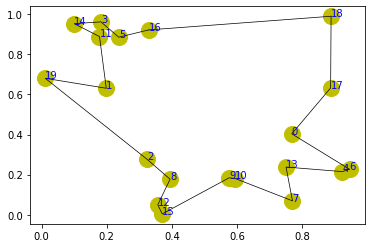

step:1250/5000, actic loss:-0.980, critic loss:0.889, L:5.305, 0min2sec
step:1251/5000, actic loss:-0.979, critic loss:0.889, L:5.304, 0min2sec
step:1252/5000, actic loss:-0.978, critic loss:0.888, L:5.304, 0min2sec
step:1253/5000, actic loss:-0.977, critic loss:0.888, L:5.303, 0min2sec
step:1254/5000, actic loss:-0.976, critic loss:0.887, L:5.302, 0min1sec
distance:3.925
tensor([ 9,  0, 11,  8, 14, 12, 19, 13, 16,  5, 15, 18,  2,  7,  3,  1,  4, 10,
         6, 17])


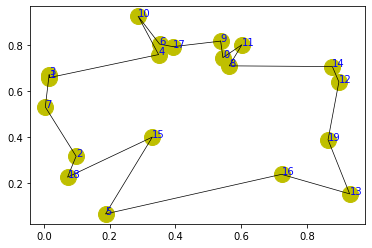

step:1255/5000, actic loss:-0.975, critic loss:0.887, L:5.301, 0min2sec
step:1256/5000, actic loss:-0.974, critic loss:0.886, L:5.301, 0min2sec
step:1257/5000, actic loss:-0.974, critic loss:0.886, L:5.300, 0min2sec
step:1258/5000, actic loss:-0.973, critic loss:0.885, L:5.299, 0min2sec
step:1259/5000, actic loss:-0.973, critic loss:0.885, L:5.298, 0min3sec
distance:4.143
tensor([14, 15, 11,  1, 13,  0,  8,  5, 16, 18,  9, 10,  7,  2,  6, 17, 19,  4,
        12,  3])


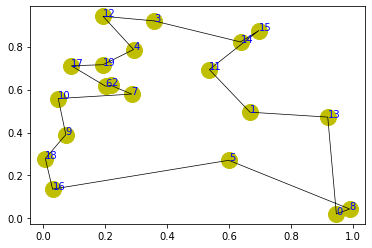

step:1260/5000, actic loss:-0.972, critic loss:0.884, L:5.298, 0min3sec
step:1261/5000, actic loss:-0.971, critic loss:0.884, L:5.297, 0min2sec
step:1262/5000, actic loss:-0.970, critic loss:0.883, L:5.296, 0min2sec
step:1263/5000, actic loss:-0.969, critic loss:0.883, L:5.296, 0min2sec
step:1264/5000, actic loss:-0.968, critic loss:0.882, L:5.295, 0min2sec
distance:4.358
tensor([ 8,  7, 10, 16,  1,  3, 11, 12,  0, 15, 13, 17, 18,  5,  4, 14,  6,  9,
        19,  2])


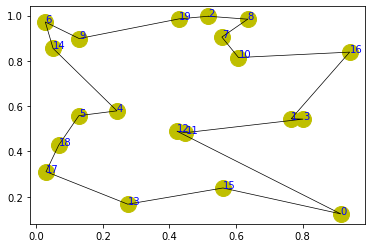

step:1265/5000, actic loss:-0.967, critic loss:0.882, L:5.294, 0min2sec
step:1266/5000, actic loss:-0.967, critic loss:0.881, L:5.294, 0min2sec
step:1267/5000, actic loss:-0.967, critic loss:0.881, L:5.293, 0min2sec
step:1268/5000, actic loss:-0.966, critic loss:0.880, L:5.292, 0min2sec
step:1269/5000, actic loss:-0.966, critic loss:0.880, L:5.292, 0min2sec
distance:4.095
tensor([ 1, 17,  9,  6,  8, 16, 18,  2, 10,  7, 19, 11, 13, 14,  5,  0,  3,  4,
        12, 15])


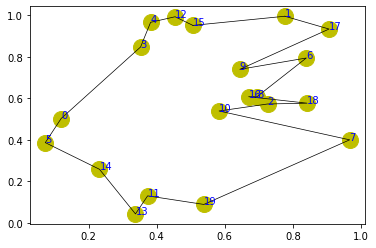

step:1270/5000, actic loss:-0.964, critic loss:0.879, L:5.291, 0min2sec
step:1271/5000, actic loss:-0.963, critic loss:0.879, L:5.290, 0min2sec
step:1272/5000, actic loss:-0.962, critic loss:0.878, L:5.290, 0min2sec
step:1273/5000, actic loss:-0.962, critic loss:0.878, L:5.289, 0min2sec
step:1274/5000, actic loss:-0.961, critic loss:0.877, L:5.288, 0min2sec
distance:3.852
tensor([16, 12,  1,  9, 11, 14,  0, 19, 17, 15, 10,  3,  2, 18,  7,  4,  5,  6,
         8, 13])


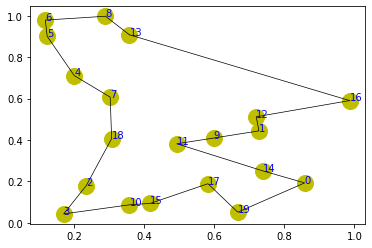

step:1275/5000, actic loss:-0.961, critic loss:0.877, L:5.287, 0min2sec
step:1276/5000, actic loss:-0.960, critic loss:0.876, L:5.287, 0min2sec
step:1277/5000, actic loss:-0.959, critic loss:0.876, L:5.286, 0min2sec
step:1278/5000, actic loss:-0.958, critic loss:0.875, L:5.285, 0min2sec
step:1279/5000, actic loss:-0.957, critic loss:0.875, L:5.285, 0min2sec
distance:4.086
tensor([ 3,  9,  1,  4, 17, 11, 14, 15,  2,  7,  0, 19, 12, 13, 16, 18,  6,  5,
        10,  8])


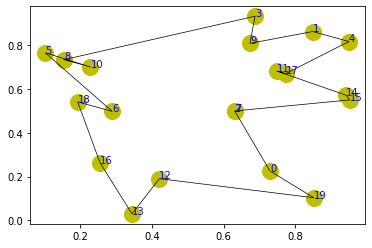

step:1280/5000, actic loss:-0.956, critic loss:0.874, L:5.284, 0min2sec
step:1281/5000, actic loss:-0.956, critic loss:0.873, L:5.283, 0min2sec
step:1282/5000, actic loss:-0.956, critic loss:0.873, L:5.282, 0min2sec
step:1283/5000, actic loss:-0.955, critic loss:0.872, L:5.282, 0min2sec
step:1284/5000, actic loss:-0.954, critic loss:0.872, L:5.281, 0min2sec
distance:4.992
tensor([14, 10,  5, 15,  6, 17,  0,  4,  7,  8, 11,  2, 16,  3,  9, 19, 18,  1,
        13, 12])


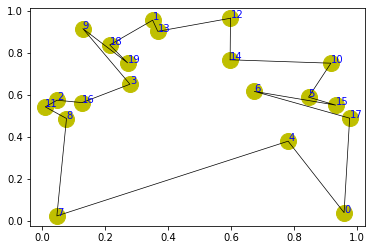

step:1285/5000, actic loss:-0.953, critic loss:0.871, L:5.280, 0min4sec
step:1286/5000, actic loss:-0.953, critic loss:0.871, L:5.279, 0min2sec
step:1287/5000, actic loss:-0.952, critic loss:0.870, L:5.279, 0min2sec
step:1288/5000, actic loss:-0.952, critic loss:0.870, L:5.278, 0min2sec
step:1289/5000, actic loss:-0.951, critic loss:0.869, L:5.277, 0min2sec
distance:4.380
tensor([13,  9, 18,  7,  6,  5, 11,  4, 12,  1, 10, 16,  0,  8, 19, 14, 17,  2,
        15,  3])


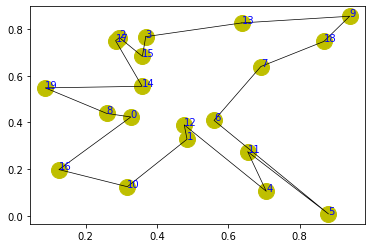

step:1290/5000, actic loss:-0.950, critic loss:0.869, L:5.276, 0min3sec
step:1291/5000, actic loss:-0.949, critic loss:0.868, L:5.276, 0min2sec
step:1292/5000, actic loss:-0.948, critic loss:0.868, L:5.275, 0min2sec
step:1293/5000, actic loss:-0.948, critic loss:0.867, L:5.274, 0min2sec
step:1294/5000, actic loss:-0.948, critic loss:0.867, L:5.273, 0min2sec
distance:3.848
tensor([ 4, 18, 19, 17, 12, 15, 13,  2,  3, 10,  9,  1,  5, 14,  7,  0,  8, 16,
         6, 11])


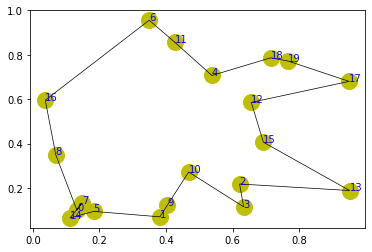

step:1295/5000, actic loss:-0.947, critic loss:0.866, L:5.273, 0min4sec
step:1296/5000, actic loss:-0.947, critic loss:0.866, L:5.272, 0min2sec
step:1297/5000, actic loss:-0.945, critic loss:0.865, L:5.271, 0min2sec
step:1298/5000, actic loss:-0.944, critic loss:0.865, L:5.271, 0min3sec
step:1299/5000, actic loss:-0.943, critic loss:0.864, L:5.270, 0min2sec
distance:4.662
tensor([14,  9,  1, 19,  8,  7, 16, 17, 13, 10, 11,  3,  5,  6,  4, 15, 18,  2,
        12,  0])


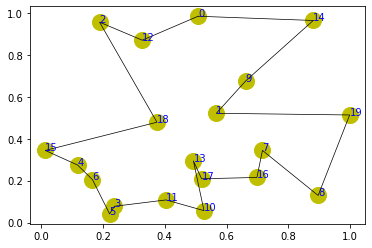

step:1300/5000, actic loss:-0.942, critic loss:0.864, L:5.269, 0min2sec
step:1301/5000, actic loss:-0.941, critic loss:0.863, L:5.269, 0min2sec
step:1302/5000, actic loss:-0.941, critic loss:0.863, L:5.268, 0min2sec
step:1303/5000, actic loss:-0.940, critic loss:0.862, L:5.267, 0min3sec
step:1304/5000, actic loss:-0.939, critic loss:0.862, L:5.267, 0min2sec
distance:4.207
tensor([ 9, 14,  5,  4, 12, 13, 11,  2,  6, 15,  0, 18,  3, 17,  1, 19,  8, 16,
         7, 10])


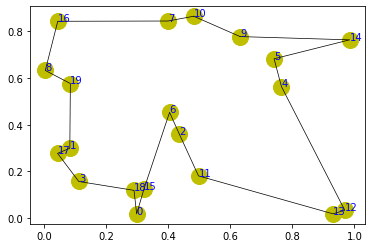

step:1305/5000, actic loss:-0.939, critic loss:0.861, L:5.266, 0min2sec
step:1306/5000, actic loss:-0.938, critic loss:0.861, L:5.265, 0min3sec
step:1307/5000, actic loss:-0.937, critic loss:0.861, L:5.265, 0min3sec
step:1308/5000, actic loss:-0.937, critic loss:0.860, L:5.264, 0min2sec
step:1309/5000, actic loss:-0.937, critic loss:0.860, L:5.263, 0min3sec
distance:4.480
tensor([11,  2, 14,  8,  7,  3, 13, 17,  6, 15, 16,  1,  0, 19,  4, 18,  5, 12,
         9, 10])


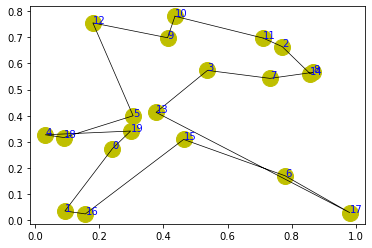

step:1310/5000, actic loss:-0.936, critic loss:0.859, L:5.263, 0min2sec
step:1311/5000, actic loss:-0.935, critic loss:0.859, L:5.262, 0min3sec
step:1312/5000, actic loss:-0.935, critic loss:0.858, L:5.261, 0min2sec
step:1313/5000, actic loss:-0.934, critic loss:0.858, L:5.261, 0min2sec
step:1314/5000, actic loss:-0.933, critic loss:0.857, L:5.260, 0min3sec
distance:4.726
tensor([ 3, 14, 17, 13, 10, 11,  8, 12,  5,  2,  0, 19,  7,  9, 15, 16, 18,  4,
         1,  6])


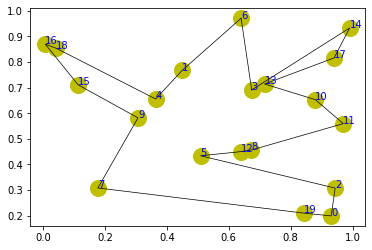

step:1315/5000, actic loss:-0.933, critic loss:0.857, L:5.259, 0min3sec
step:1316/5000, actic loss:-0.932, critic loss:0.856, L:5.259, 0min2sec
step:1317/5000, actic loss:-0.931, critic loss:0.856, L:5.258, 0min2sec
step:1318/5000, actic loss:-0.931, critic loss:0.855, L:5.257, 0min2sec
step:1319/5000, actic loss:-0.930, critic loss:0.855, L:5.257, 0min3sec
distance:4.464
tensor([12, 17, 14,  9, 15,  5,  7, 18, 16, 11,  1,  3, 10,  4,  2,  0, 19,  6,
        13,  8])


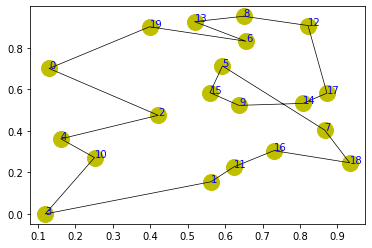

step:1320/5000, actic loss:-0.929, critic loss:0.854, L:5.256, 0min3sec
step:1321/5000, actic loss:-0.929, critic loss:0.854, L:5.255, 0min2sec
step:1322/5000, actic loss:-0.928, critic loss:0.853, L:5.255, 0min2sec
step:1323/5000, actic loss:-0.927, critic loss:0.853, L:5.254, 0min3sec
step:1324/5000, actic loss:-0.927, critic loss:0.852, L:5.253, 0min2sec
distance:4.953
tensor([ 7,  9, 14, 17,  3,  6,  5,  0,  1,  8, 13, 11, 10,  4, 18, 16,  2, 15,
        12, 19])


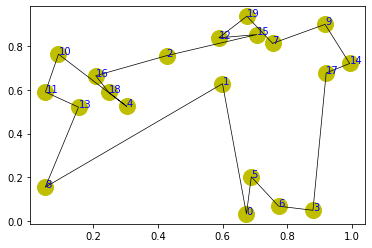

step:1325/5000, actic loss:-0.926, critic loss:0.852, L:5.252, 0min3sec
step:1326/5000, actic loss:-0.925, critic loss:0.851, L:5.252, 0min2sec
step:1327/5000, actic loss:-0.925, critic loss:0.851, L:5.251, 0min3sec
step:1328/5000, actic loss:-0.924, critic loss:0.850, L:5.250, 0min2sec
step:1329/5000, actic loss:-0.924, critic loss:0.850, L:5.250, 0min4sec
distance:5.014
tensor([15, 12,  9,  6, 14, 11,  0,  8, 19, 16,  2,  7, 10, 17,  3, 18,  1,  4,
         5, 13])


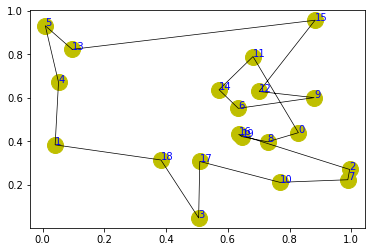

step:1330/5000, actic loss:-0.923, critic loss:0.849, L:5.249, 0min4sec
step:1331/5000, actic loss:-0.922, critic loss:0.849, L:5.248, 0min2sec
step:1332/5000, actic loss:-0.921, critic loss:0.848, L:5.248, 0min2sec
step:1333/5000, actic loss:-0.921, critic loss:0.848, L:5.247, 0min2sec
step:1334/5000, actic loss:-0.921, critic loss:0.847, L:5.246, 0min2sec
distance:3.982
tensor([12,  8, 19,  7,  3, 17,  4, 18, 16, 14,  5, 10, 11, 13,  2, 15,  0,  1,
         9,  6])


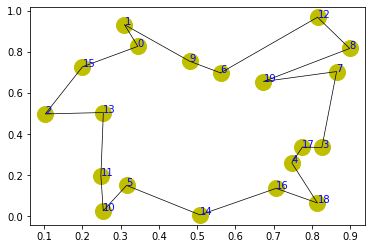

step:1335/5000, actic loss:-0.920, critic loss:0.847, L:5.246, 0min3sec
step:1336/5000, actic loss:-0.919, critic loss:0.846, L:5.245, 0min2sec
step:1337/5000, actic loss:-0.918, critic loss:0.846, L:5.245, 0min2sec
step:1338/5000, actic loss:-0.918, critic loss:0.845, L:5.244, 0min2sec
step:1339/5000, actic loss:-0.917, critic loss:0.845, L:5.243, 0min2sec
distance:3.939
tensor([ 5,  9, 14,  3, 11,  6,  0, 13, 16,  4, 12,  8, 15, 19,  7, 17,  1,  2,
        10, 18])


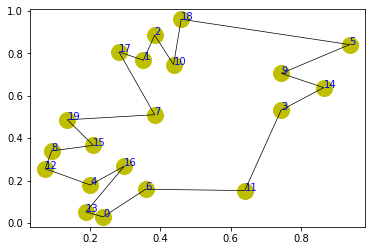

step:1340/5000, actic loss:-0.917, critic loss:0.844, L:5.243, 0min4sec
step:1341/5000, actic loss:-0.916, critic loss:0.844, L:5.242, 0min3sec
step:1342/5000, actic loss:-0.916, critic loss:0.844, L:5.242, 0min3sec
step:1343/5000, actic loss:-0.915, critic loss:0.843, L:5.241, 0min2sec
step:1344/5000, actic loss:-0.914, critic loss:0.843, L:5.240, 0min2sec
distance:4.799
tensor([19, 10,  0,  5, 13, 14,  4,  8,  7, 17, 15, 12, 18,  2,  1, 16,  6, 11,
         9,  3])


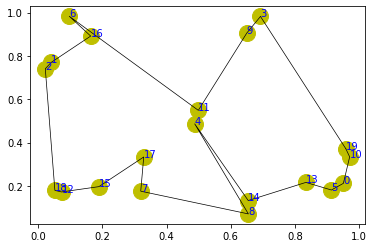

step:1345/5000, actic loss:-0.914, critic loss:0.842, L:5.240, 0min2sec
step:1346/5000, actic loss:-0.914, critic loss:0.842, L:5.239, 0min2sec
step:1347/5000, actic loss:-0.913, critic loss:0.841, L:5.238, 0min2sec
step:1348/5000, actic loss:-0.913, critic loss:0.841, L:5.238, 0min2sec
step:1349/5000, actic loss:-0.912, critic loss:0.840, L:5.237, 0min3sec
distance:4.344
tensor([12, 15,  8, 10, 13, 18,  1, 14, 17,  4,  6, 16, 11,  2,  7, 19,  0,  5,
         3,  9])


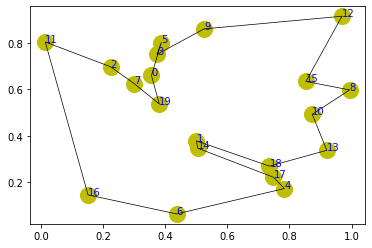

step:1350/5000, actic loss:-0.911, critic loss:0.840, L:5.237, 0min4sec
step:1351/5000, actic loss:-0.910, critic loss:0.840, L:5.236, 0min3sec
step:1352/5000, actic loss:-0.909, critic loss:0.839, L:5.236, 0min2sec
step:1353/5000, actic loss:-0.909, critic loss:0.839, L:5.235, 0min2sec
step:1354/5000, actic loss:-0.909, critic loss:0.838, L:5.234, 0min3sec
distance:5.392
tensor([ 8, 12,  4,  9, 17, 18,  5,  1, 10, 14, 16, 13,  2,  0,  3,  7, 15,  6,
        19, 11])


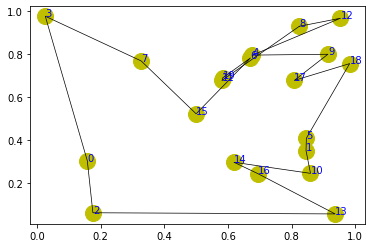

step:1355/5000, actic loss:-0.908, critic loss:0.838, L:5.234, 0min2sec
step:1356/5000, actic loss:-0.907, critic loss:0.837, L:5.233, 0min3sec
step:1357/5000, actic loss:-0.906, critic loss:0.837, L:5.233, 0min4sec
step:1358/5000, actic loss:-0.906, critic loss:0.836, L:5.232, 0min3sec
step:1359/5000, actic loss:-0.905, critic loss:0.836, L:5.232, 0min2sec
distance:4.369
tensor([ 7, 16,  6,  4, 15, 10,  0,  5, 18,  3, 17,  8, 13, 12, 19, 14, 11,  1,
         2,  9])


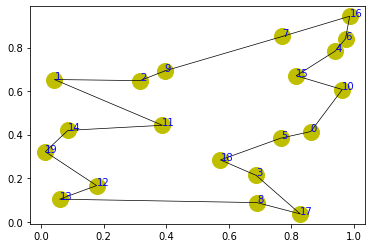

step:1360/5000, actic loss:-0.905, critic loss:0.835, L:5.231, 0min3sec
step:1361/5000, actic loss:-0.904, critic loss:0.835, L:5.230, 0min2sec
step:1362/5000, actic loss:-0.904, critic loss:0.835, L:5.229, 0min2sec
step:1363/5000, actic loss:-0.903, critic loss:0.834, L:5.229, 0min1sec
step:1364/5000, actic loss:-0.902, critic loss:0.834, L:5.228, 0min2sec
distance:4.058
tensor([ 0, 16,  1, 12, 14,  9, 10, 18,  4,  7, 11,  3, 15, 17, 13,  2,  5,  6,
         8, 19])


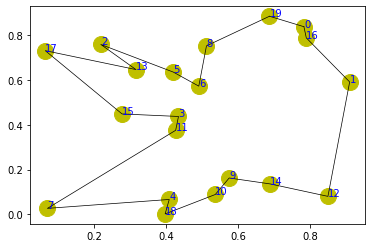

step:1365/5000, actic loss:-0.902, critic loss:0.833, L:5.227, 0min2sec
step:1366/5000, actic loss:-0.901, critic loss:0.833, L:5.227, 0min3sec
step:1367/5000, actic loss:-0.900, critic loss:0.832, L:5.226, 0min1sec
step:1368/5000, actic loss:-0.900, critic loss:0.832, L:5.225, 0min2sec
step:1369/5000, actic loss:-0.899, critic loss:0.831, L:5.225, 0min2sec
distance:3.564
tensor([ 8,  6, 16, 11, 13,  2, 14,  0, 17,  7,  1, 18, 15, 12,  3,  4,  5,  9,
        19, 10])


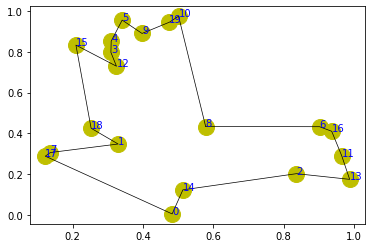

step:1370/5000, actic loss:-0.898, critic loss:0.831, L:5.224, 0min4sec
step:1371/5000, actic loss:-0.897, critic loss:0.830, L:5.223, 0min1sec
step:1372/5000, actic loss:-0.897, critic loss:0.830, L:5.223, 0min0sec
step:1373/5000, actic loss:-0.897, critic loss:0.829, L:5.222, 0min5sec
step:1374/5000, actic loss:-0.896, critic loss:0.829, L:5.221, 0min0sec
distance:3.918
tensor([16,  2, 13,  8, 18,  6, 14, 19,  9, 10, 12, 15,  5, 11,  0,  4,  1, 17,
         3,  7])


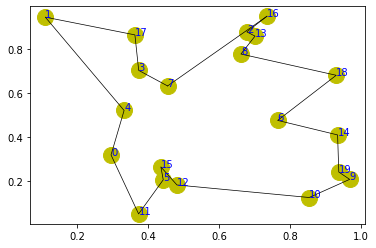

step:1375/5000, actic loss:-0.895, critic loss:0.828, L:5.221, 0min1sec
step:1376/5000, actic loss:-0.895, critic loss:0.828, L:5.220, 0min1sec
step:1377/5000, actic loss:-0.895, critic loss:0.827, L:5.219, 0min1sec
step:1378/5000, actic loss:-0.894, critic loss:0.827, L:5.219, 0min1sec
step:1379/5000, actic loss:-0.893, critic loss:0.826, L:5.218, 0min1sec
distance:3.759
tensor([ 6,  9, 15,  2,  4, 19, 18, 11, 12,  1,  3,  0, 17, 13,  7,  8,  5, 14,
        16, 10])


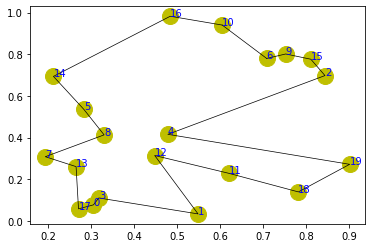

step:1380/5000, actic loss:-0.893, critic loss:0.826, L:5.217, 0min1sec
step:1381/5000, actic loss:-0.892, critic loss:0.825, L:5.217, 0min1sec
step:1382/5000, actic loss:-0.892, critic loss:0.825, L:5.216, 0min0sec
step:1383/5000, actic loss:-0.891, critic loss:0.825, L:5.215, 0min1sec
step:1384/5000, actic loss:-0.890, critic loss:0.824, L:5.215, 0min1sec
distance:4.709
tensor([15,  2, 12,  0, 13, 18,  5, 11, 17, 16,  3,  9,  7,  6, 14, 10,  1,  4,
         8, 19])


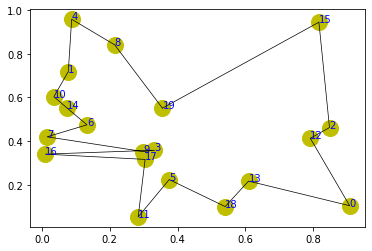

step:1385/5000, actic loss:-0.890, critic loss:0.824, L:5.214, 0min1sec
step:1386/5000, actic loss:-0.889, critic loss:0.823, L:5.213, 0min1sec
step:1387/5000, actic loss:-0.889, critic loss:0.823, L:5.213, 0min1sec
step:1388/5000, actic loss:-0.888, critic loss:0.822, L:5.212, 0min1sec
step:1389/5000, actic loss:-0.888, critic loss:0.822, L:5.212, 0min1sec
distance:4.798
tensor([11, 19,  1,  8,  2,  9,  6, 10,  3,  7,  0, 13,  4, 16, 18, 15, 17, 12,
         5, 14])


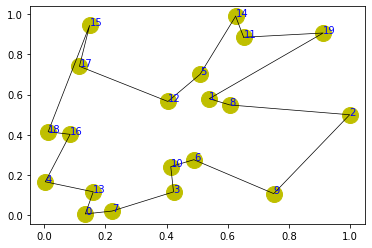

step:1390/5000, actic loss:-0.887, critic loss:0.821, L:5.211, 0min1sec
step:1391/5000, actic loss:-0.886, critic loss:0.821, L:5.210, 0min1sec
step:1392/5000, actic loss:-0.885, critic loss:0.820, L:5.210, 0min1sec
step:1393/5000, actic loss:-0.885, critic loss:0.820, L:5.209, 0min1sec
step:1394/5000, actic loss:-0.884, critic loss:0.820, L:5.209, 0min1sec
distance:4.721
tensor([ 9,  7,  8, 14,  5, 16,  0, 12, 13,  3, 11, 18, 17,  2,  4,  6, 19, 10,
        15,  1])


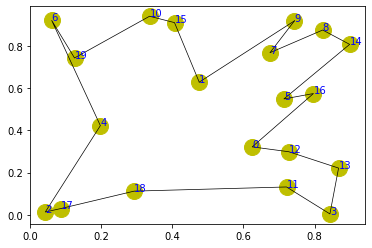

step:1395/5000, actic loss:-0.884, critic loss:0.819, L:5.208, 0min1sec
step:1396/5000, actic loss:-0.883, critic loss:0.819, L:5.207, 0min1sec
step:1397/5000, actic loss:-0.883, critic loss:0.818, L:5.207, 0min1sec
step:1398/5000, actic loss:-0.882, critic loss:0.818, L:5.206, 0min1sec
step:1399/5000, actic loss:-0.881, critic loss:0.817, L:5.206, 0min1sec
distance:3.629
tensor([ 7, 15, 14,  6, 16,  5, 19, 11,  8,  4,  3,  0, 12,  9,  1, 13,  2, 17,
        18, 10])


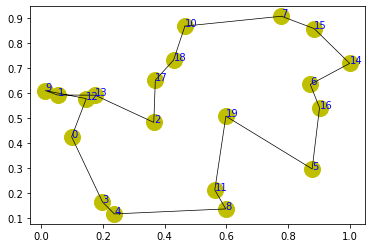

step:1400/5000, actic loss:-0.880, critic loss:0.817, L:5.205, 0min1sec
step:1401/5000, actic loss:-0.879, critic loss:0.817, L:5.205, 0min0sec
step:1402/5000, actic loss:-0.879, critic loss:0.816, L:5.204, 0min1sec
step:1403/5000, actic loss:-0.878, critic loss:0.816, L:5.204, 0min1sec
step:1404/5000, actic loss:-0.878, critic loss:0.815, L:5.203, 0min1sec
distance:3.803
tensor([19, 13,  3, 18, 10,  9, 17,  1,  5, 14, 12,  0, 15,  2,  6, 11,  7,  4,
         8, 16])


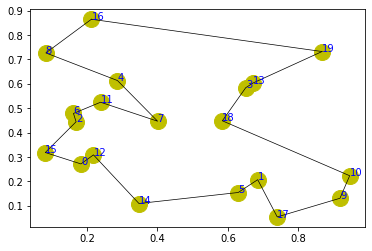

step:1405/5000, actic loss:-0.877, critic loss:0.815, L:5.202, 0min1sec
step:1406/5000, actic loss:-0.877, critic loss:0.815, L:5.202, 0min1sec
step:1407/5000, actic loss:-0.876, critic loss:0.814, L:5.201, 0min1sec
step:1408/5000, actic loss:-0.875, critic loss:0.814, L:5.201, 0min1sec
step:1409/5000, actic loss:-0.874, critic loss:0.813, L:5.200, 0min1sec
distance:4.599
tensor([16,  2,  5, 18, 13,  1,  4, 17,  7,  3, 11, 15,  0, 14, 10, 12,  8,  9,
        19,  6])


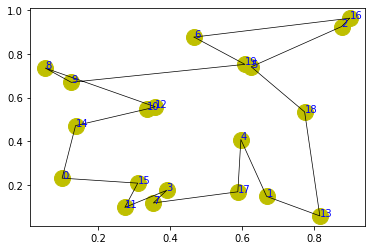

step:1410/5000, actic loss:-0.874, critic loss:0.813, L:5.200, 0min2sec
step:1411/5000, actic loss:-0.873, critic loss:0.812, L:5.199, 0min1sec
step:1412/5000, actic loss:-0.873, critic loss:0.812, L:5.198, 0min1sec
step:1413/5000, actic loss:-0.872, critic loss:0.811, L:5.198, 0min1sec
step:1414/5000, actic loss:-0.871, critic loss:0.811, L:5.197, 0min1sec
distance:4.303
tensor([ 9, 18, 14,  4, 16, 17,  6, 13, 10, 11,  0,  8,  1, 15,  2,  3,  7, 19,
         5, 12])


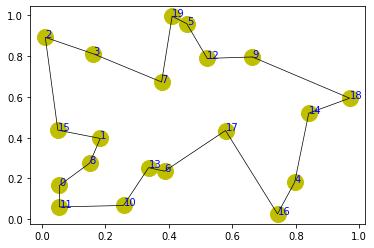

step:1415/5000, actic loss:-0.871, critic loss:0.811, L:5.197, 0min1sec
step:1416/5000, actic loss:-0.870, critic loss:0.810, L:5.196, 0min1sec
step:1417/5000, actic loss:-0.869, critic loss:0.810, L:5.196, 0min1sec
step:1418/5000, actic loss:-0.869, critic loss:0.809, L:5.195, 0min1sec
step:1419/5000, actic loss:-0.869, critic loss:0.809, L:5.194, 0min1sec
distance:4.858
tensor([15, 10, 13, 11,  4,  9,  3, 16,  0, 17,  2,  6, 18, 14, 12,  5,  7,  8,
        19,  1])


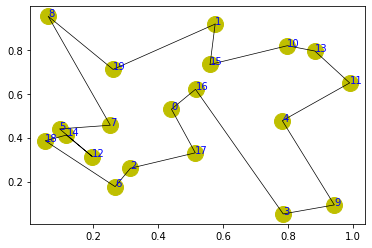

step:1420/5000, actic loss:-0.868, critic loss:0.808, L:5.194, 0min1sec
step:1421/5000, actic loss:-0.867, critic loss:0.808, L:5.193, 0min1sec
step:1422/5000, actic loss:-0.867, critic loss:0.807, L:5.193, 0min1sec
step:1423/5000, actic loss:-0.866, critic loss:0.807, L:5.192, 0min1sec
step:1424/5000, actic loss:-0.865, critic loss:0.807, L:5.191, 0min1sec
distance:4.874
tensor([18,  9, 12,  7,  3, 14, 13,  8, 15, 16,  0,  2, 19,  4,  1,  5, 10, 11,
         6, 17])


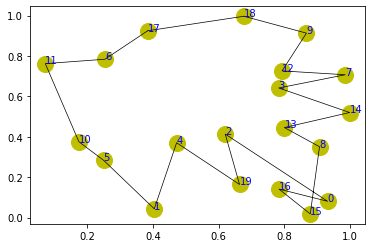

step:1425/5000, actic loss:-0.865, critic loss:0.806, L:5.191, 0min1sec
step:1426/5000, actic loss:-0.864, critic loss:0.806, L:5.190, 0min1sec
step:1427/5000, actic loss:-0.864, critic loss:0.805, L:5.190, 0min1sec
step:1428/5000, actic loss:-0.863, critic loss:0.805, L:5.189, 0min1sec
step:1429/5000, actic loss:-0.863, critic loss:0.804, L:5.188, 0min1sec
distance:4.711
tensor([ 5, 19, 12, 15,  9,  1, 14,  3,  4, 17,  7,  6, 18, 11, 10,  8,  2,  0,
        13, 16])


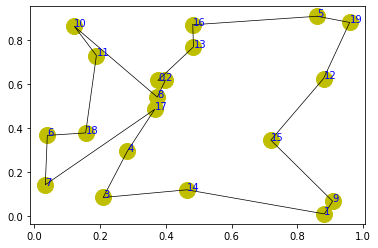

step:1430/5000, actic loss:-0.862, critic loss:0.804, L:5.188, 0min1sec
step:1431/5000, actic loss:-0.861, critic loss:0.803, L:5.187, 0min1sec
step:1432/5000, actic loss:-0.861, critic loss:0.803, L:5.187, 0min1sec
step:1433/5000, actic loss:-0.860, critic loss:0.803, L:5.186, 0min1sec
step:1434/5000, actic loss:-0.860, critic loss:0.802, L:5.185, 0min1sec
distance:4.166
tensor([11, 14,  2,  7,  1, 12,  8,  4,  6, 13, 18,  3,  9, 15, 16, 17,  5, 10,
         0, 19])


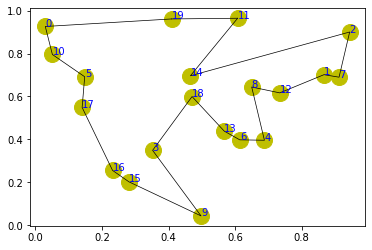

step:1435/5000, actic loss:-0.859, critic loss:0.802, L:5.185, 0min1sec
step:1436/5000, actic loss:-0.858, critic loss:0.801, L:5.184, 0min1sec
step:1437/5000, actic loss:-0.858, critic loss:0.801, L:5.184, 0min1sec
step:1438/5000, actic loss:-0.857, critic loss:0.800, L:5.183, 0min1sec
step:1439/5000, actic loss:-0.857, critic loss:0.800, L:5.182, 0min2sec
distance:4.559
tensor([ 1, 11, 19,  5,  4, 17, 18, 14, 16,  0, 13, 10,  9,  7,  6,  3,  8, 15,
         2, 12])


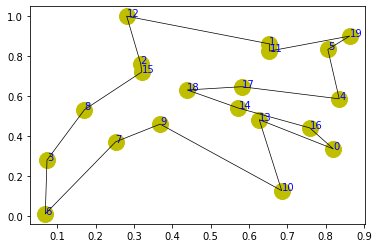

step:1440/5000, actic loss:-0.856, critic loss:0.799, L:5.182, 0min2sec
step:1441/5000, actic loss:-0.856, critic loss:0.799, L:5.181, 0min1sec
step:1442/5000, actic loss:-0.855, critic loss:0.799, L:5.181, 0min2sec
step:1443/5000, actic loss:-0.855, critic loss:0.798, L:5.180, 0min2sec
step:1444/5000, actic loss:-0.854, critic loss:0.798, L:5.180, 0min1sec
distance:5.324
tensor([ 2, 16, 15,  4, 12,  9, 18, 17, 14,  0,  6,  1,  3,  8, 13, 10, 19,  7,
         5, 11])


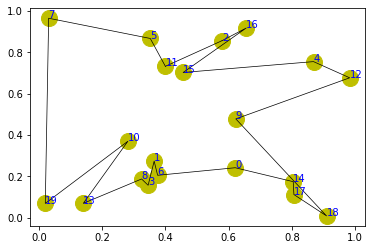

step:1445/5000, actic loss:-0.853, critic loss:0.797, L:5.179, 0min1sec
step:1446/5000, actic loss:-0.853, critic loss:0.797, L:5.179, 0min2sec
step:1447/5000, actic loss:-0.852, critic loss:0.796, L:5.178, 0min1sec
step:1448/5000, actic loss:-0.852, critic loss:0.796, L:5.177, 0min2sec
step:1449/5000, actic loss:-0.851, critic loss:0.796, L:5.177, 0min2sec
distance:4.844
tensor([ 0,  2,  8, 12, 16,  4, 11,  6, 19, 13, 18,  1, 15, 14, 10,  3,  5,  9,
         7, 17])


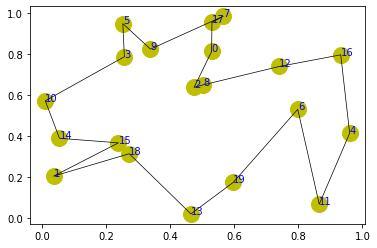

step:1450/5000, actic loss:-0.851, critic loss:0.795, L:5.176, 0min2sec
step:1451/5000, actic loss:-0.850, critic loss:0.795, L:5.176, 0min1sec
step:1452/5000, actic loss:-0.849, critic loss:0.794, L:5.175, 0min1sec
step:1453/5000, actic loss:-0.849, critic loss:0.794, L:5.175, 0min2sec
step:1454/5000, actic loss:-0.848, critic loss:0.794, L:5.174, 0min1sec
distance:3.652
tensor([16,  4,  1, 19,  8,  3, 17,  5, 12,  0, 10, 13, 18, 11, 15,  7,  9,  2,
        14,  6])


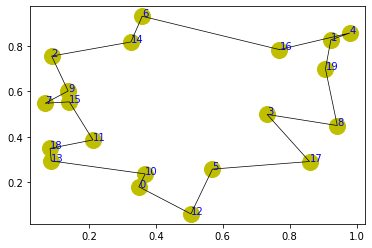

step:1455/5000, actic loss:-0.848, critic loss:0.793, L:5.173, 0min1sec
step:1456/5000, actic loss:-0.848, critic loss:0.793, L:5.173, 0min1sec
step:1457/5000, actic loss:-0.847, critic loss:0.792, L:5.172, 0min1sec
step:1458/5000, actic loss:-0.847, critic loss:0.792, L:5.171, 0min1sec
step:1459/5000, actic loss:-0.846, critic loss:0.792, L:5.171, 0min2sec
distance:4.854
tensor([16, 13,  9,  8, 15,  4,  0,  6,  1,  2, 17, 14, 10,  3, 11, 18, 19,  7,
         5, 12])


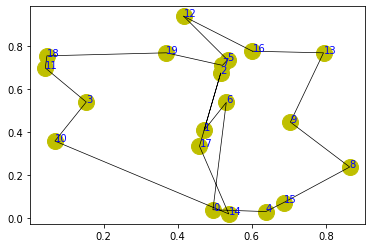

step:1460/5000, actic loss:-0.845, critic loss:0.791, L:5.170, 0min2sec
step:1461/5000, actic loss:-0.844, critic loss:0.791, L:5.170, 0min1sec
step:1462/5000, actic loss:-0.844, critic loss:0.790, L:5.169, 0min1sec
step:1463/5000, actic loss:-0.843, critic loss:0.790, L:5.168, 0min1sec
step:1464/5000, actic loss:-0.843, critic loss:0.790, L:5.168, 0min1sec
distance:4.094
tensor([ 5, 13, 16,  6, 18, 12, 19,  3, 14,  4,  9, 15, 10, 11,  0,  8,  1, 17,
         2,  7])


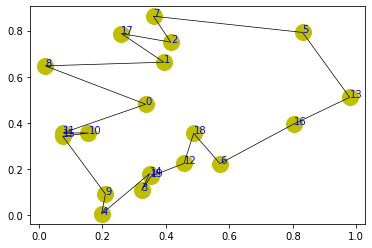

step:1465/5000, actic loss:-0.842, critic loss:0.789, L:5.167, 0min1sec
step:1466/5000, actic loss:-0.841, critic loss:0.789, L:5.166, 0min1sec
step:1467/5000, actic loss:-0.841, critic loss:0.788, L:5.166, 0min1sec
step:1468/5000, actic loss:-0.841, critic loss:0.788, L:5.165, 0min1sec
step:1469/5000, actic loss:-0.840, critic loss:0.787, L:5.165, 0min1sec
distance:5.124
tensor([ 0,  6,  1,  4, 13, 14, 18, 19, 15,  3, 12,  8,  9,  5, 17, 11, 10,  2,
         7, 16])


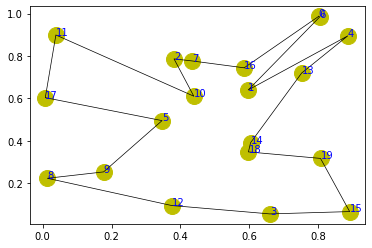

step:1470/5000, actic loss:-0.840, critic loss:0.787, L:5.164, 0min1sec
step:1471/5000, actic loss:-0.839, critic loss:0.787, L:5.164, 0min1sec
step:1472/5000, actic loss:-0.838, critic loss:0.786, L:5.163, 0min2sec
step:1473/5000, actic loss:-0.838, critic loss:0.786, L:5.163, 0min2sec
step:1474/5000, actic loss:-0.838, critic loss:0.786, L:5.163, 0min2sec
distance:5.458
tensor([14, 11, 16,  6,  7, 10,  3,  2, 12,  4,  9, 13,  5, 15, 19, 17, 18,  1,
         8,  0])


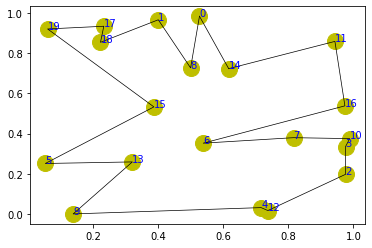

step:1475/5000, actic loss:-0.837, critic loss:0.785, L:5.162, 0min2sec
step:1476/5000, actic loss:-0.837, critic loss:0.785, L:5.161, 0min2sec
step:1477/5000, actic loss:-0.836, critic loss:0.785, L:5.161, 0min2sec
step:1478/5000, actic loss:-0.835, critic loss:0.784, L:5.161, 0min2sec
step:1479/5000, actic loss:-0.835, critic loss:0.784, L:5.160, 0min1sec
distance:4.280
tensor([17, 19, 14,  7, 15, 10, 18,  4,  3, 16, 13,  5,  6, 12, 11,  2,  9,  1,
         8,  0])


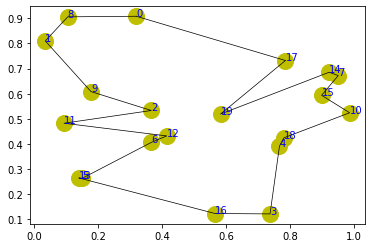

step:1480/5000, actic loss:-0.834, critic loss:0.783, L:5.159, 0min2sec
step:1481/5000, actic loss:-0.834, critic loss:0.783, L:5.159, 0min1sec
step:1482/5000, actic loss:-0.833, critic loss:0.783, L:5.159, 0min2sec
step:1483/5000, actic loss:-0.833, critic loss:0.782, L:5.158, 0min2sec
step:1484/5000, actic loss:-0.832, critic loss:0.782, L:5.157, 0min1sec
distance:4.051
tensor([12, 14, 15, 18, 17,  6,  8,  7, 10,  1, 16,  5,  9, 13, 11, 19,  3,  4,
         2,  0])


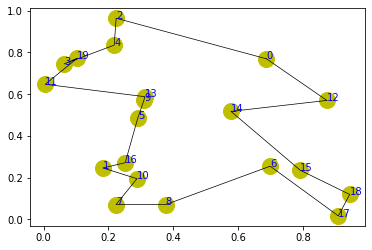

step:1485/5000, actic loss:-0.832, critic loss:0.782, L:5.157, 0min3sec
step:1486/5000, actic loss:-0.832, critic loss:0.781, L:5.157, 0min2sec
step:1487/5000, actic loss:-0.831, critic loss:0.781, L:5.156, 0min2sec
step:1488/5000, actic loss:-0.831, critic loss:0.780, L:5.156, 0min2sec
step:1489/5000, actic loss:-0.830, critic loss:0.780, L:5.155, 0min2sec
distance:4.278
tensor([ 0, 15, 11,  9, 19, 16, 10, 17,  4,  7, 14, 12,  5,  8,  3,  1,  2, 18,
        13,  6])


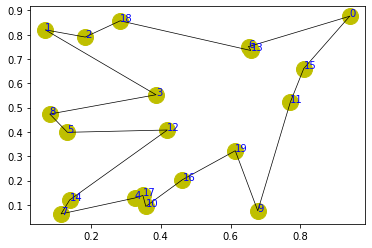

step:1490/5000, actic loss:-0.830, critic loss:0.780, L:5.155, 0min3sec
step:1491/5000, actic loss:-0.829, critic loss:0.779, L:5.155, 0min2sec
step:1492/5000, actic loss:-0.829, critic loss:0.779, L:5.154, 0min2sec
step:1493/5000, actic loss:-0.828, critic loss:0.779, L:5.154, 0min1sec
step:1494/5000, actic loss:-0.827, critic loss:0.778, L:5.153, 0min2sec
distance:3.140
tensor([ 1, 10, 18,  9,  6, 11,  5, 16,  0, 17,  2, 19, 12, 13,  8, 14,  3, 15,
         4,  7])


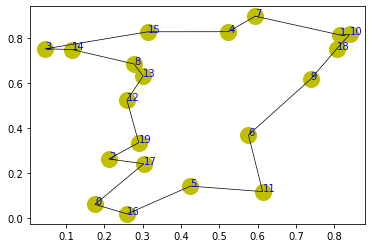

step:1495/5000, actic loss:-0.826, critic loss:0.778, L:5.153, 0min3sec
step:1496/5000, actic loss:-0.826, critic loss:0.778, L:5.152, 0min2sec
step:1497/5000, actic loss:-0.826, critic loss:0.777, L:5.152, 0min2sec
step:1498/5000, actic loss:-0.826, critic loss:0.777, L:5.152, 0min2sec
step:1499/5000, actic loss:-0.825, critic loss:0.776, L:5.151, 0min2sec
distance:4.821
tensor([12,  1, 16,  2,  0,  4,  9, 11,  3, 18,  7, 13, 19, 15, 14,  5,  8, 10,
         6, 17])


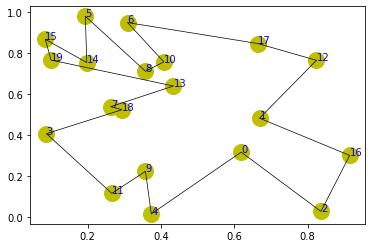

step:1500/5000, actic loss:-0.824, critic loss:0.776, L:5.150, 0min2sec
step:1501/5000, actic loss:-0.823, critic loss:0.776, L:5.150, 0min2sec
step:1502/5000, actic loss:-0.823, critic loss:0.775, L:5.149, 0min2sec
step:1503/5000, actic loss:-0.823, critic loss:0.775, L:5.149, 0min1sec
step:1504/5000, actic loss:-0.822, critic loss:0.775, L:5.148, 0min1sec
distance:3.524
tensor([10, 12, 18,  8,  2, 17, 15,  6, 14, 13,  1,  3,  9,  4,  0, 19, 11,  7,
         5, 16])


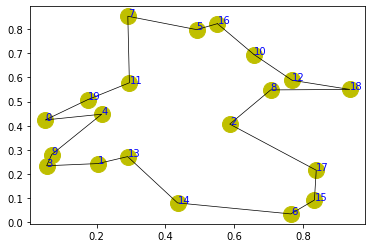

step:1505/5000, actic loss:-0.822, critic loss:0.774, L:5.148, 0min3sec
step:1506/5000, actic loss:-0.821, critic loss:0.774, L:5.147, 0min2sec
step:1507/5000, actic loss:-0.820, critic loss:0.773, L:5.147, 0min2sec
step:1508/5000, actic loss:-0.820, critic loss:0.773, L:5.146, 0min2sec
step:1509/5000, actic loss:-0.820, critic loss:0.773, L:5.146, 0min3sec
distance:4.800
tensor([ 1, 15,  4, 13,  8, 19,  3,  6, 17, 14, 11, 16,  9, 18,  0,  7, 12,  5,
        10,  2])


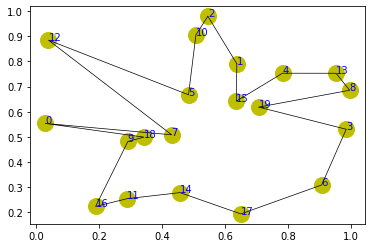

step:1510/5000, actic loss:-0.819, critic loss:0.772, L:5.145, 0min2sec
step:1511/5000, actic loss:-0.818, critic loss:0.772, L:5.144, 0min1sec
step:1512/5000, actic loss:-0.818, critic loss:0.772, L:5.144, 0min1sec
step:1513/5000, actic loss:-0.817, critic loss:0.771, L:5.143, 0min2sec
step:1514/5000, actic loss:-0.817, critic loss:0.771, L:5.143, 0min1sec
distance:4.635
tensor([ 5,  1, 15,  9, 16,  6, 10, 14,  3,  8,  0, 18, 12, 19,  4, 11,  7,  2,
        13, 17])


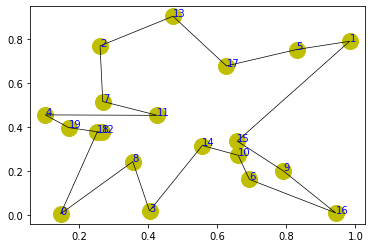

step:1515/5000, actic loss:-0.817, critic loss:0.770, L:5.142, 0min2sec
step:1516/5000, actic loss:-0.816, critic loss:0.770, L:5.142, 0min1sec
step:1517/5000, actic loss:-0.816, critic loss:0.770, L:5.141, 0min2sec
step:1518/5000, actic loss:-0.815, critic loss:0.769, L:5.141, 0min1sec
step:1519/5000, actic loss:-0.815, critic loss:0.769, L:5.140, 0min2sec
distance:5.302
tensor([ 2, 10, 11,  7,  8, 18,  4,  5,  3,  0, 13, 16, 17, 19,  1,  9,  6, 14,
        12, 15])


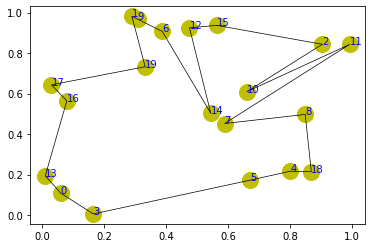

step:1520/5000, actic loss:-0.814, critic loss:0.769, L:5.140, 0min1sec
step:1521/5000, actic loss:-0.814, critic loss:0.768, L:5.139, 0min1sec
step:1522/5000, actic loss:-0.813, critic loss:0.768, L:5.139, 0min2sec
step:1523/5000, actic loss:-0.813, critic loss:0.767, L:5.139, 0min1sec
step:1524/5000, actic loss:-0.812, critic loss:0.767, L:5.138, 0min2sec
distance:5.069
tensor([ 9,  0, 13, 12, 19, 10, 14,  1,  8,  5,  4,  2, 15, 16, 11,  3,  7,  6,
        18, 17])


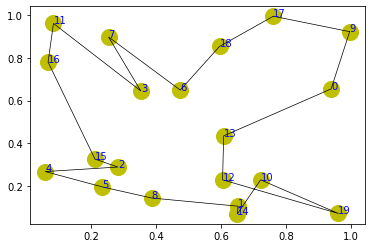

step:1525/5000, actic loss:-0.812, critic loss:0.767, L:5.138, 0min2sec
step:1526/5000, actic loss:-0.811, critic loss:0.766, L:5.137, 0min1sec
step:1527/5000, actic loss:-0.811, critic loss:0.766, L:5.137, 0min1sec
step:1528/5000, actic loss:-0.811, critic loss:0.766, L:5.136, 0min2sec
step:1529/5000, actic loss:-0.810, critic loss:0.765, L:5.136, 0min1sec
distance:3.972
tensor([16, 17,  2,  0,  7,  3, 18,  9, 19,  1, 11,  6, 14,  4,  8,  5, 15, 13,
        10, 12])


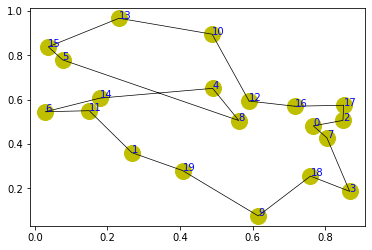

step:1530/5000, actic loss:-0.809, critic loss:0.765, L:5.136, 0min2sec
step:1531/5000, actic loss:-0.809, critic loss:0.765, L:5.135, 0min1sec
step:1532/5000, actic loss:-0.808, critic loss:0.764, L:5.135, 0min1sec
step:1533/5000, actic loss:-0.808, critic loss:0.764, L:5.135, 0min2sec
step:1534/5000, actic loss:-0.808, critic loss:0.764, L:5.134, 0min3sec
distance:4.466
tensor([11,  4,  7,  3, 15,  5, 16, 13,  1,  9, 12,  6,  8, 10, 18, 17,  2, 19,
        14,  0])


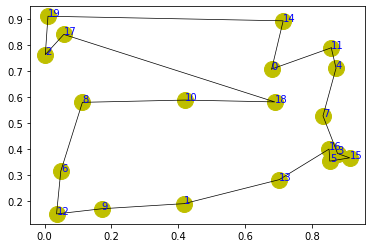

step:1535/5000, actic loss:-0.807, critic loss:0.763, L:5.134, 0min2sec
step:1536/5000, actic loss:-0.807, critic loss:0.763, L:5.134, 0min1sec
step:1537/5000, actic loss:-0.806, critic loss:0.763, L:5.133, 0min2sec
step:1538/5000, actic loss:-0.805, critic loss:0.763, L:5.133, 0min2sec
step:1539/5000, actic loss:-0.805, critic loss:0.762, L:5.132, 0min2sec
distance:4.134
tensor([11,  1, 12,  8,  5, 19, 17,  9,  0,  4, 16,  3, 13, 14,  6,  2,  7, 15,
        10, 18])


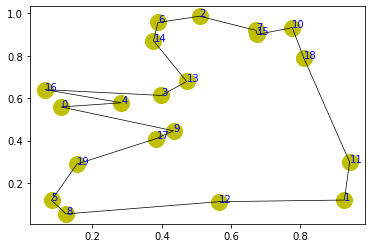

step:1540/5000, actic loss:-0.805, critic loss:0.762, L:5.132, 0min2sec
step:1541/5000, actic loss:-0.804, critic loss:0.762, L:5.132, 0min1sec
step:1542/5000, actic loss:-0.803, critic loss:0.761, L:5.131, 0min2sec
step:1543/5000, actic loss:-0.803, critic loss:0.761, L:5.131, 0min1sec
step:1544/5000, actic loss:-0.802, critic loss:0.760, L:5.130, 0min2sec
distance:4.313
tensor([10,  6, 12, 11, 16,  7, 13, 19,  8, 18,  2,  3, 17, 15, 14,  4,  9,  5,
         1,  0])


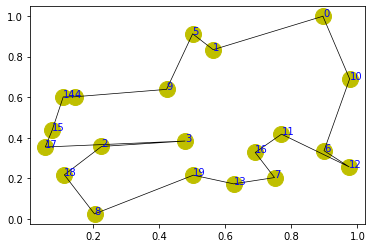

step:1545/5000, actic loss:-0.802, critic loss:0.760, L:5.130, 0min2sec
step:1546/5000, actic loss:-0.801, critic loss:0.760, L:5.129, 0min3sec
step:1547/5000, actic loss:-0.801, critic loss:0.759, L:5.129, 0min2sec
step:1548/5000, actic loss:-0.801, critic loss:0.759, L:5.129, 0min3sec
step:1549/5000, actic loss:-0.801, critic loss:0.759, L:5.128, 0min2sec
distance:4.188
tensor([ 1, 11,  6,  5, 13,  3, 12,  8,  7,  2, 15,  4, 14, 19, 16,  9,  0, 10,
        18, 17])


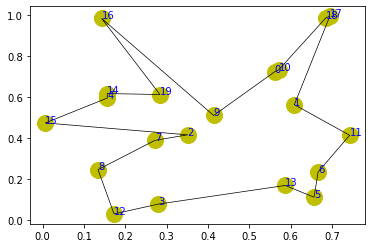

step:1550/5000, actic loss:-0.800, critic loss:0.758, L:5.128, 0min3sec
step:1551/5000, actic loss:-0.799, critic loss:0.758, L:5.127, 0min2sec
step:1552/5000, actic loss:-0.799, critic loss:0.758, L:5.127, 0min2sec
step:1553/5000, actic loss:-0.798, critic loss:0.757, L:5.126, 0min2sec
step:1554/5000, actic loss:-0.798, critic loss:0.757, L:5.126, 0min1sec
distance:3.932
tensor([15, 14, 10,  2,  7, 17, 13, 19,  0, 16,  5,  1,  6,  4,  9,  8, 18, 12,
        11,  3])


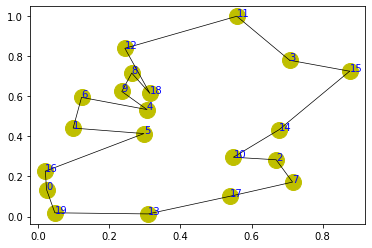

step:1555/5000, actic loss:-0.798, critic loss:0.757, L:5.125, 0min2sec
step:1556/5000, actic loss:-0.797, critic loss:0.756, L:5.125, 0min2sec
step:1557/5000, actic loss:-0.796, critic loss:0.756, L:5.125, 0min2sec
step:1558/5000, actic loss:-0.796, critic loss:0.756, L:5.124, 0min3sec
step:1559/5000, actic loss:-0.795, critic loss:0.756, L:5.124, 0min2sec
distance:3.812
tensor([11,  9, 13,  6,  5,  2,  3, 12,  4, 17, 14,  7, 10,  8, 18, 15,  1, 16,
        19,  0])


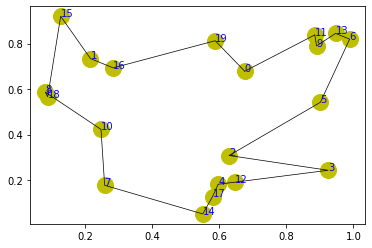

step:1560/5000, actic loss:-0.794, critic loss:0.755, L:5.124, 0min2sec
step:1561/5000, actic loss:-0.794, critic loss:0.755, L:5.123, 0min2sec
step:1562/5000, actic loss:-0.794, critic loss:0.755, L:5.123, 0min3sec
step:1563/5000, actic loss:-0.793, critic loss:0.754, L:5.122, 0min2sec
step:1564/5000, actic loss:-0.793, critic loss:0.754, L:5.122, 0min2sec
distance:3.743
tensor([17,  6,  9,  3,  1,  7,  4, 13,  8, 18, 11, 15, 12,  0, 10,  2, 14, 16,
        19,  5])


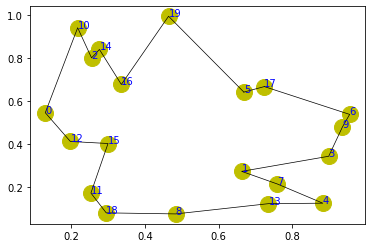

step:1565/5000, actic loss:-0.793, critic loss:0.754, L:5.122, 0min2sec
step:1566/5000, actic loss:-0.792, critic loss:0.754, L:5.121, 0min1sec
step:1567/5000, actic loss:-0.791, critic loss:0.753, L:5.121, 0min2sec
step:1568/5000, actic loss:-0.790, critic loss:0.753, L:5.120, 0min1sec
step:1569/5000, actic loss:-0.790, critic loss:0.753, L:5.120, 0min1sec
distance:4.147
tensor([ 3,  9, 16,  4, 17, 13,  5,  1, 11, 14, 18,  6, 10, 12,  2, 15,  7,  8,
         0, 19])


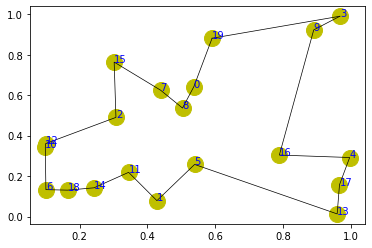

step:1570/5000, actic loss:-0.790, critic loss:0.752, L:5.120, 0min2sec
step:1571/5000, actic loss:-0.790, critic loss:0.752, L:5.119, 0min3sec
step:1572/5000, actic loss:-0.789, critic loss:0.752, L:5.119, 0min2sec
step:1573/5000, actic loss:-0.788, critic loss:0.751, L:5.118, 0min2sec
step:1574/5000, actic loss:-0.787, critic loss:0.751, L:5.118, 0min2sec
distance:3.834
tensor([16, 15, 17,  8, 18,  6,  3,  9, 19,  0, 11,  5, 13, 12, 14,  1,  2,  7,
         4, 10])


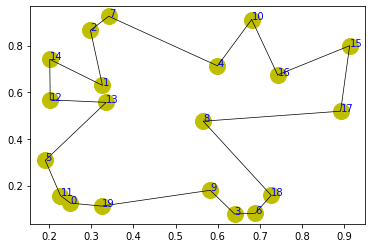

step:1575/5000, actic loss:-0.787, critic loss:0.751, L:5.117, 0min2sec
step:1576/5000, actic loss:-0.786, critic loss:0.750, L:5.117, 0min3sec
step:1577/5000, actic loss:-0.785, critic loss:0.750, L:5.116, 0min2sec
step:1578/5000, actic loss:-0.785, critic loss:0.750, L:5.116, 0min4sec
step:1579/5000, actic loss:-0.785, critic loss:0.750, L:5.115, 0min3sec
distance:5.763
tensor([11, 16, 14, 18,  1,  9,  4,  8, 13, 10, 19,  7,  3, 17, 12,  0, 15,  2,
         6,  5])


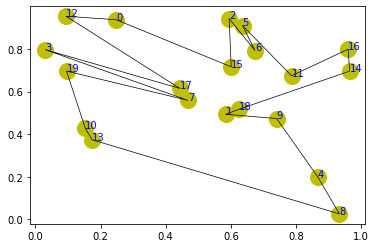

step:1580/5000, actic loss:-0.785, critic loss:0.750, L:5.115, 0min3sec
step:1581/5000, actic loss:-0.786, critic loss:0.749, L:5.114, 0min3sec
step:1582/5000, actic loss:-0.785, critic loss:0.749, L:5.114, 0min3sec
step:1583/5000, actic loss:-0.785, critic loss:0.749, L:5.113, 0min3sec
step:1584/5000, actic loss:-0.784, critic loss:0.748, L:5.113, 0min1sec
distance:3.725
tensor([ 9,  0,  6, 13,  1, 19, 18, 10, 16, 11,  4, 14,  8, 12,  3, 15, 17,  5,
         7,  2])


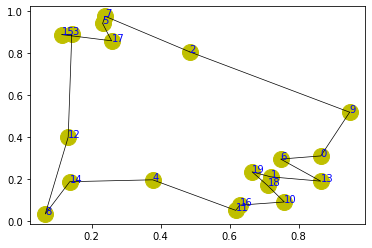

step:1585/5000, actic loss:-0.783, critic loss:0.748, L:5.112, 0min1sec
step:1586/5000, actic loss:-0.783, critic loss:0.748, L:5.112, 0min2sec
step:1587/5000, actic loss:-0.782, critic loss:0.747, L:5.111, 0min1sec
step:1588/5000, actic loss:-0.782, critic loss:0.747, L:5.111, 0min2sec
step:1589/5000, actic loss:-0.782, critic loss:0.747, L:5.110, 0min1sec
distance:4.188
tensor([18,  7, 11,  5, 19, 15,  1, 13,  9, 12, 14,  3,  8,  2, 17,  6, 16, 10,
         0,  4])


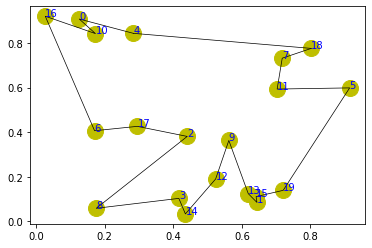

step:1590/5000, actic loss:-0.781, critic loss:0.746, L:5.110, 0min2sec
step:1591/5000, actic loss:-0.781, critic loss:0.746, L:5.110, 0min2sec
step:1592/5000, actic loss:-0.781, critic loss:0.746, L:5.109, 0min2sec
step:1593/5000, actic loss:-0.780, critic loss:0.746, L:5.109, 0min1sec
step:1594/5000, actic loss:-0.780, critic loss:0.745, L:5.108, 0min1sec
distance:4.440
tensor([ 4,  9,  5,  8, 11,  7, 16, 17,  1, 18, 19, 10,  6, 14, 15,  3, 13,  0,
         2, 12])


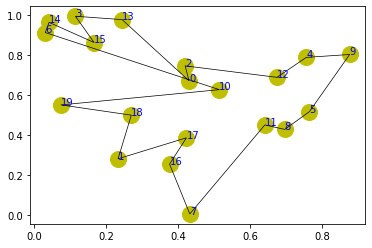

step:1595/5000, actic loss:-0.779, critic loss:0.745, L:5.108, 0min2sec
step:1596/5000, actic loss:-0.779, critic loss:0.745, L:5.107, 0min2sec
step:1597/5000, actic loss:-0.779, critic loss:0.744, L:5.107, 0min2sec
step:1598/5000, actic loss:-0.778, critic loss:0.744, L:5.106, 0min3sec
step:1599/5000, actic loss:-0.777, critic loss:0.744, L:5.106, 0min3sec
distance:5.211
tensor([ 4,  5, 17,  0,  7,  8,  1, 18,  9, 15,  2, 11, 16, 19,  6,  3, 12, 10,
        14, 13])


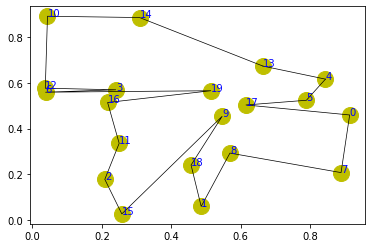

step:1600/5000, actic loss:-0.777, critic loss:0.743, L:5.106, 0min4sec
step:1601/5000, actic loss:-0.776, critic loss:0.743, L:5.105, 0min3sec
step:1602/5000, actic loss:-0.776, critic loss:0.743, L:5.105, 0min2sec
step:1603/5000, actic loss:-0.775, critic loss:0.742, L:5.105, 0min1sec
step:1604/5000, actic loss:-0.775, critic loss:0.742, L:5.104, 0min1sec
distance:4.320
tensor([ 2, 14,  7, 18,  1,  9, 11, 12,  8, 17,  6,  3,  0, 15,  4, 10,  5, 19,
        13, 16])


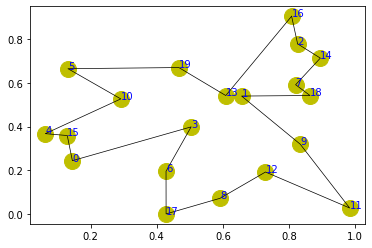

step:1605/5000, actic loss:-0.775, critic loss:0.742, L:5.104, 0min3sec
step:1606/5000, actic loss:-0.774, critic loss:0.741, L:5.103, 0min3sec
step:1607/5000, actic loss:-0.774, critic loss:0.741, L:5.103, 0min3sec
step:1608/5000, actic loss:-0.773, critic loss:0.741, L:5.102, 0min2sec
step:1609/5000, actic loss:-0.773, critic loss:0.740, L:5.102, 0min1sec
distance:5.032
tensor([ 5,  8,  1, 13,  6,  7, 11, 12, 16,  3, 19, 14,  9, 10, 18,  0, 17, 15,
         2,  4])


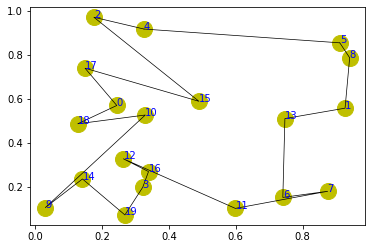

step:1610/5000, actic loss:-0.772, critic loss:0.740, L:5.101, 0min3sec
step:1611/5000, actic loss:-0.772, critic loss:0.740, L:5.101, 0min2sec
step:1612/5000, actic loss:-0.772, critic loss:0.739, L:5.100, 0min2sec
step:1613/5000, actic loss:-0.771, critic loss:0.739, L:5.100, 0min3sec
step:1614/5000, actic loss:-0.771, critic loss:0.739, L:5.100, 0min3sec
distance:4.873
tensor([16, 14,  9,  8, 10, 19,  4, 17, 12,  6, 11, 15,  0,  1, 18,  7, 13,  3,
         2,  5])


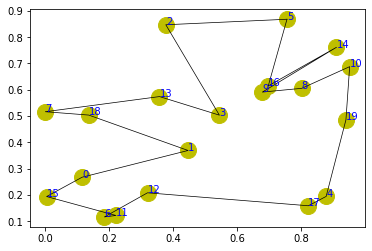

step:1615/5000, actic loss:-0.770, critic loss:0.738, L:5.099, 0min5sec
step:1616/5000, actic loss:-0.770, critic loss:0.738, L:5.099, 0min3sec
step:1617/5000, actic loss:-0.769, critic loss:0.738, L:5.098, 0min2sec
step:1618/5000, actic loss:-0.769, critic loss:0.737, L:5.098, 0min2sec
step:1619/5000, actic loss:-0.769, critic loss:0.737, L:5.097, 0min2sec
distance:3.886
tensor([ 8, 19,  2, 15,  5, 14, 10,  0,  7, 12,  3, 13, 18,  6,  1,  4, 16,  9,
        11, 17])


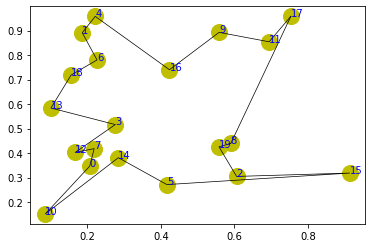

step:1620/5000, actic loss:-0.768, critic loss:0.737, L:5.097, 0min3sec
step:1621/5000, actic loss:-0.767, critic loss:0.736, L:5.096, 0min2sec
step:1622/5000, actic loss:-0.767, critic loss:0.736, L:5.096, 0min2sec
step:1623/5000, actic loss:-0.766, critic loss:0.736, L:5.095, 0min3sec
step:1624/5000, actic loss:-0.766, critic loss:0.735, L:5.095, 0min3sec
distance:4.453
tensor([ 4,  5,  6,  2, 14, 11, 13, 10,  8,  7, 12,  3,  1, 15, 19, 17, 18, 16,
         0,  9])


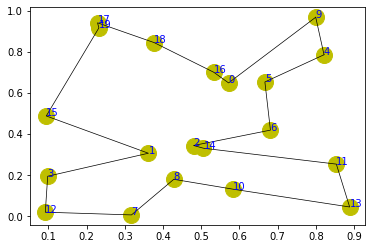

step:1625/5000, actic loss:-0.766, critic loss:0.735, L:5.094, 0min4sec
step:1626/5000, actic loss:-0.766, critic loss:0.735, L:5.094, 0min2sec
step:1627/5000, actic loss:-0.765, critic loss:0.734, L:5.093, 0min3sec
step:1628/5000, actic loss:-0.765, critic loss:0.734, L:5.093, 0min2sec
step:1629/5000, actic loss:-0.764, critic loss:0.734, L:5.093, 0min2sec
distance:4.149
tensor([14, 12, 16,  8,  9,  4,  1,  7,  5,  3, 19, 13,  6, 11, 17, 15,  0, 18,
        10,  2])


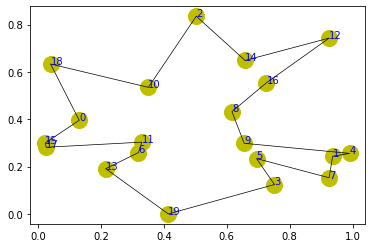

step:1630/5000, actic loss:-0.763, critic loss:0.733, L:5.092, 0min4sec
step:1631/5000, actic loss:-0.762, critic loss:0.733, L:5.092, 0min2sec
step:1632/5000, actic loss:-0.762, critic loss:0.733, L:5.091, 0min2sec
step:1633/5000, actic loss:-0.762, critic loss:0.732, L:5.091, 0min2sec
step:1634/5000, actic loss:-0.761, critic loss:0.732, L:5.090, 0min2sec
distance:4.709
tensor([13, 17, 16,  5,  2,  0,  4, 18, 15,  9,  7,  6, 11, 14,  1, 12, 10,  3,
         8, 19])


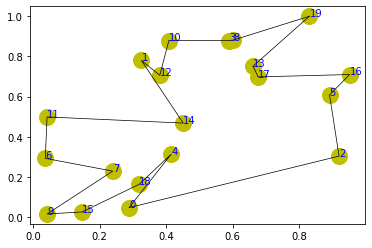

step:1635/5000, actic loss:-0.761, critic loss:0.732, L:5.090, 0min2sec
step:1636/5000, actic loss:-0.760, critic loss:0.731, L:5.089, 0min2sec
step:1637/5000, actic loss:-0.760, critic loss:0.731, L:5.089, 0min3sec
step:1638/5000, actic loss:-0.759, critic loss:0.731, L:5.088, 0min2sec
step:1639/5000, actic loss:-0.759, critic loss:0.730, L:5.088, 0min3sec
distance:4.192
tensor([11, 16,  4, 18,  0,  2,  6,  8, 14,  1, 12, 19, 17, 10, 15,  3, 13,  7,
         5,  9])


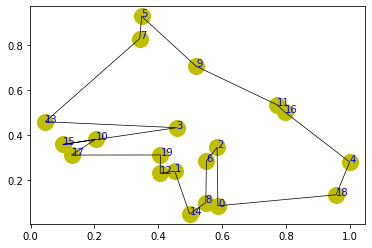

step:1640/5000, actic loss:-0.759, critic loss:0.730, L:5.087, 0min3sec
step:1641/5000, actic loss:-0.758, critic loss:0.730, L:5.087, 0min2sec
step:1642/5000, actic loss:-0.758, critic loss:0.729, L:5.086, 0min1sec
step:1643/5000, actic loss:-0.757, critic loss:0.729, L:5.086, 0min2sec
step:1644/5000, actic loss:-0.757, critic loss:0.729, L:5.086, 0min2sec
distance:4.427
tensor([ 7, 11,  0, 17,  2, 13,  9,  6, 12, 18,  4,  1,  8, 16,  5, 15, 10, 19,
         3, 14])


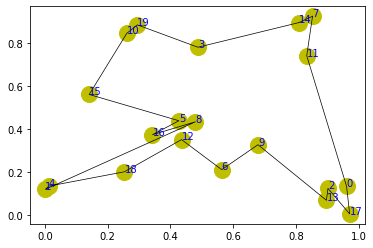

step:1645/5000, actic loss:-0.757, critic loss:0.729, L:5.085, 0min3sec
step:1646/5000, actic loss:-0.757, critic loss:0.728, L:5.085, 0min2sec
step:1647/5000, actic loss:-0.756, critic loss:0.728, L:5.084, 0min4sec
step:1648/5000, actic loss:-0.755, critic loss:0.728, L:5.084, 0min3sec
step:1649/5000, actic loss:-0.755, critic loss:0.727, L:5.084, 0min2sec
distance:4.280
tensor([16,  8,  2, 19, 18, 15,  5,  6, 10, 11, 17, 13,  1, 14,  3,  4,  0,  9,
        12,  7])


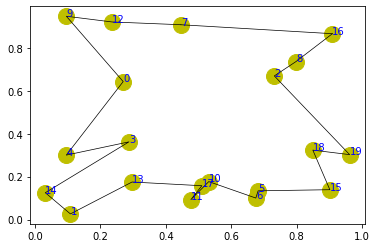

step:1650/5000, actic loss:-0.754, critic loss:0.727, L:5.083, 0min2sec
step:1651/5000, actic loss:-0.754, critic loss:0.727, L:5.083, 0min2sec
step:1652/5000, actic loss:-0.754, critic loss:0.727, L:5.083, 0min2sec
step:1653/5000, actic loss:-0.754, critic loss:0.726, L:5.082, 0min3sec
step:1654/5000, actic loss:-0.753, critic loss:0.726, L:5.082, 0min2sec
distance:4.146
tensor([18, 17,  1, 15,  0, 11, 10,  9,  5,  2,  4, 14, 19, 16,  3, 13,  6,  8,
        12,  7])


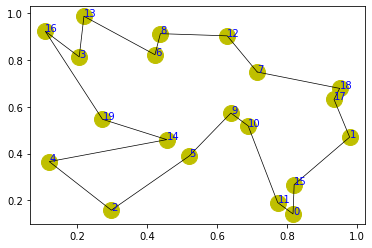

step:1655/5000, actic loss:-0.753, critic loss:0.726, L:5.082, 0min3sec
step:1656/5000, actic loss:-0.752, critic loss:0.726, L:5.082, 0min2sec
step:1657/5000, actic loss:-0.751, critic loss:0.725, L:5.082, 0min2sec
step:1658/5000, actic loss:-0.751, critic loss:0.725, L:5.081, 0min2sec
step:1659/5000, actic loss:-0.751, critic loss:0.725, L:5.081, 0min2sec
distance:4.924
tensor([ 4,  6, 12, 17, 14,  3,  9, 10,  5, 13,  7, 15,  1, 11, 18,  2,  8, 16,
        19,  0])


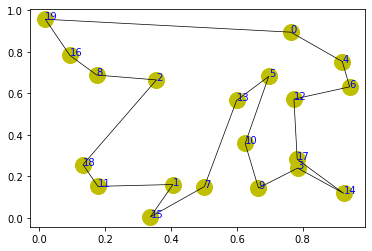

step:1660/5000, actic loss:-0.751, critic loss:0.725, L:5.081, 0min2sec
step:1661/5000, actic loss:-0.750, critic loss:0.724, L:5.081, 0min2sec
step:1662/5000, actic loss:-0.750, critic loss:0.724, L:5.080, 0min3sec
step:1663/5000, actic loss:-0.749, critic loss:0.724, L:5.080, 0min3sec
step:1664/5000, actic loss:-0.748, critic loss:0.724, L:5.080, 0min2sec
distance:4.277
tensor([17, 11, 10, 13,  1,  3,  9, 12, 15, 19,  8,  2, 16, 18,  5,  4, 14,  0,
         7,  6])


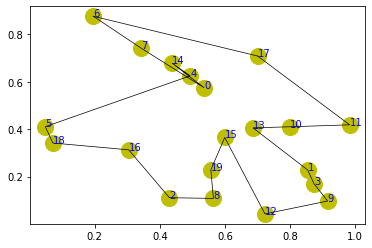

step:1665/5000, actic loss:-0.748, critic loss:0.723, L:5.079, 0min3sec
step:1666/5000, actic loss:-0.748, critic loss:0.723, L:5.079, 0min2sec
step:1667/5000, actic loss:-0.747, critic loss:0.723, L:5.079, 0min2sec
step:1668/5000, actic loss:-0.747, critic loss:0.722, L:5.078, 0min2sec
step:1669/5000, actic loss:-0.746, critic loss:0.722, L:5.078, 0min2sec
distance:5.500
tensor([ 1, 13, 17, 14,  3,  4,  8, 15, 11,  9,  5,  0, 12, 10,  7,  6, 16, 18,
         2, 19])


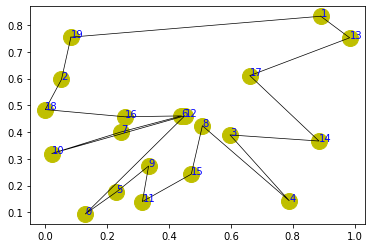

step:1670/5000, actic loss:-0.746, critic loss:0.722, L:5.077, 0min5sec
step:1671/5000, actic loss:-0.746, critic loss:0.721, L:5.077, 0min3sec
step:1672/5000, actic loss:-0.745, critic loss:0.721, L:5.076, 0min3sec
step:1673/5000, actic loss:-0.745, critic loss:0.721, L:5.076, 0min4sec
step:1674/5000, actic loss:-0.745, critic loss:0.721, L:5.075, 0min3sec
distance:4.146
tensor([ 2, 13, 17, 19,  9, 14, 15, 18, 10, 16,  1,  0, 11,  6,  7,  5, 12,  8,
         4,  3])


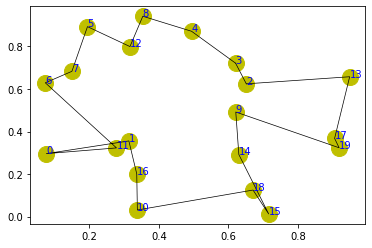

step:1675/5000, actic loss:-0.744, critic loss:0.720, L:5.075, 0min4sec
step:1676/5000, actic loss:-0.743, critic loss:0.720, L:5.075, 0min4sec
step:1677/5000, actic loss:-0.742, critic loss:0.720, L:5.074, 0min3sec
step:1678/5000, actic loss:-0.742, critic loss:0.719, L:5.074, 0min4sec
step:1679/5000, actic loss:-0.741, critic loss:0.719, L:5.073, 0min3sec
distance:4.535
tensor([15, 18,  4,  0,  5, 17, 12, 14, 16,  8,  1,  2, 19, 10,  6, 11,  9, 13,
         3,  7])


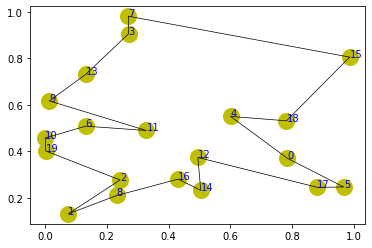

step:1680/5000, actic loss:-0.741, critic loss:0.719, L:5.073, 0min2sec
step:1681/5000, actic loss:-0.741, critic loss:0.719, L:5.072, 0min3sec
step:1682/5000, actic loss:-0.741, critic loss:0.718, L:5.072, 0min2sec
step:1683/5000, actic loss:-0.741, critic loss:0.718, L:5.071, 0min3sec
step:1684/5000, actic loss:-0.741, critic loss:0.718, L:5.071, 0min2sec
distance:4.453
tensor([ 2, 17, 14, 13,  0, 18,  7,  8,  5, 11, 10, 12,  9, 19,  1, 16,  6, 15,
         4,  3])


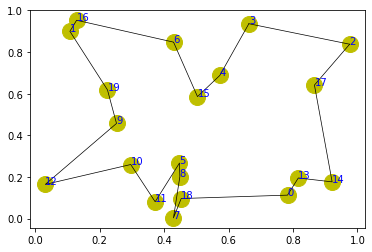

step:1685/5000, actic loss:-0.740, critic loss:0.717, L:5.070, 0min3sec
step:1686/5000, actic loss:-0.740, critic loss:0.717, L:5.070, 0min3sec
step:1687/5000, actic loss:-0.739, critic loss:0.717, L:5.069, 0min2sec
step:1688/5000, actic loss:-0.738, critic loss:0.716, L:5.069, 0min2sec
step:1689/5000, actic loss:-0.738, critic loss:0.716, L:5.069, 0min6sec
distance:4.300
tensor([17,  9, 15,  2, 19, 12,  4, 14,  0, 13,  6, 18, 16,  7,  3, 11,  5,  8,
         1, 10])


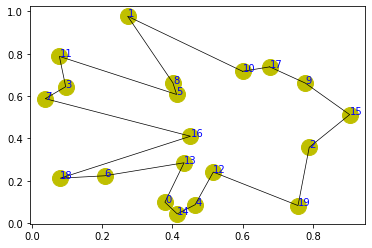

step:1690/5000, actic loss:-0.738, critic loss:0.716, L:5.068, 0min3sec
step:1691/5000, actic loss:-0.737, critic loss:0.716, L:5.068, 0min2sec
step:1692/5000, actic loss:-0.737, critic loss:0.715, L:5.067, 0min2sec
step:1693/5000, actic loss:-0.737, critic loss:0.715, L:5.067, 0min3sec
step:1694/5000, actic loss:-0.736, critic loss:0.715, L:5.066, 0min2sec
distance:4.177
tensor([11,  9,  3,  8, 13,  5,  0, 15, 16,  6, 18,  4, 12,  2,  1, 10, 17, 14,
         7, 19])


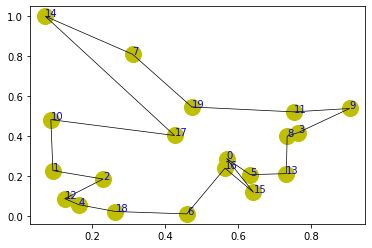

step:1695/5000, actic loss:-0.735, critic loss:0.714, L:5.066, 0min3sec
step:1696/5000, actic loss:-0.735, critic loss:0.714, L:5.066, 0min3sec
step:1697/5000, actic loss:-0.734, critic loss:0.714, L:5.065, 0min4sec
step:1698/5000, actic loss:-0.734, critic loss:0.714, L:5.065, 0min3sec
step:1699/5000, actic loss:-0.733, critic loss:0.713, L:5.064, 0min3sec
distance:5.424
tensor([18, 14, 11, 13,  0,  5,  9,  6,  4,  2,  3, 12,  8, 16,  7,  1, 19, 17,
        10, 15])


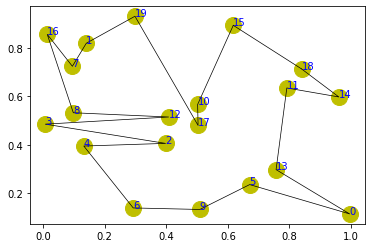

step:1700/5000, actic loss:-0.734, critic loss:0.713, L:5.064, 0min4sec
step:1701/5000, actic loss:-0.734, critic loss:0.713, L:5.064, 0min3sec
step:1702/5000, actic loss:-0.734, critic loss:0.713, L:5.064, 0min3sec
step:1703/5000, actic loss:-0.733, critic loss:0.713, L:5.063, 0min6sec
step:1704/5000, actic loss:-0.733, critic loss:0.712, L:5.063, 0min4sec
distance:5.020
tensor([18, 15,  9, 19,  5, 16, 11, 10,  1,  7,  4, 17,  8, 14,  0,  2,  3,  6,
        12, 13])


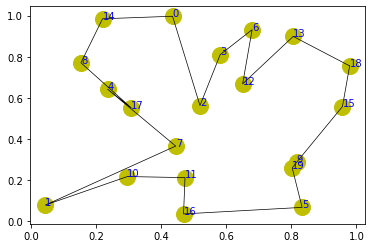

step:1705/5000, actic loss:-0.732, critic loss:0.712, L:5.063, 0min5sec
step:1706/5000, actic loss:-0.731, critic loss:0.712, L:5.062, 0min4sec
step:1707/5000, actic loss:-0.730, critic loss:0.712, L:5.062, 0min3sec
step:1708/5000, actic loss:-0.730, critic loss:0.712, L:5.062, 0min3sec
step:1709/5000, actic loss:-0.730, critic loss:0.711, L:5.062, 0min3sec
distance:4.333
tensor([15, 18,  0,  8, 19,  3, 14,  6, 13,  1, 17, 12,  5, 11,  4, 10, 16,  2,
         9,  7])


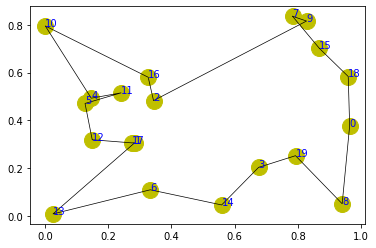

step:1710/5000, actic loss:-0.730, critic loss:0.711, L:5.062, 0min2sec
step:1711/5000, actic loss:-0.729, critic loss:0.711, L:5.062, 0min3sec
step:1712/5000, actic loss:-0.729, critic loss:0.711, L:5.061, 0min3sec
step:1713/5000, actic loss:-0.728, critic loss:0.710, L:5.061, 0min3sec
step:1714/5000, actic loss:-0.728, critic loss:0.710, L:5.061, 0min2sec
distance:5.463
tensor([ 7, 12,  0, 10, 15, 13, 19,  4,  8,  1, 14, 18,  9,  5,  3, 17, 16,  2,
        11,  6])


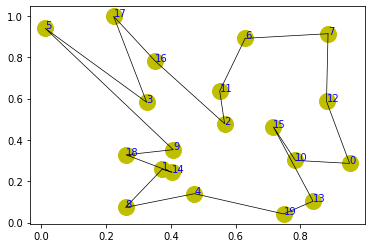

step:1715/5000, actic loss:-0.727, critic loss:0.710, L:5.061, 0min3sec
step:1716/5000, actic loss:-0.727, critic loss:0.710, L:5.061, 0min4sec
step:1717/5000, actic loss:-0.726, critic loss:0.710, L:5.061, 0min7sec
step:1718/5000, actic loss:-0.726, critic loss:0.709, L:5.060, 0min4sec
step:1719/5000, actic loss:-0.726, critic loss:0.709, L:5.060, 0min2sec
distance:5.747
tensor([ 7, 18, 10, 17,  1,  5,  2, 15, 13, 14, 12, 11,  8,  9, 19,  6, 16,  4,
         3,  0])


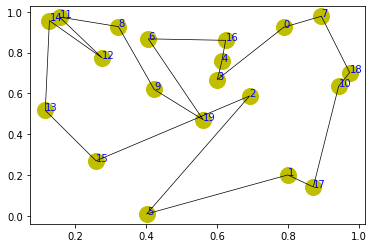

step:1720/5000, actic loss:-0.725, critic loss:0.709, L:5.060, 0min3sec
step:1721/5000, actic loss:-0.725, critic loss:0.708, L:5.059, 0min3sec
step:1722/5000, actic loss:-0.724, critic loss:0.708, L:5.059, 0min0sec
step:1723/5000, actic loss:-0.724, critic loss:0.708, L:5.059, 0min0sec
step:1724/5000, actic loss:-0.724, critic loss:0.708, L:5.058, 0min0sec
distance:4.624
tensor([13,  7, 10,  5,  8, 16, 17, 12, 11, 18,  3,  6,  9,  0,  4,  2, 14, 19,
         1, 15])


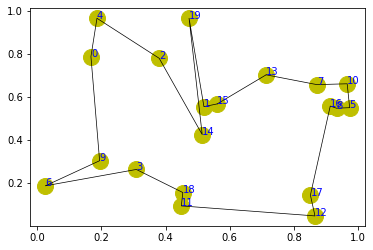

step:1725/5000, actic loss:-0.723, critic loss:0.707, L:5.058, 0min0sec
step:1726/5000, actic loss:-0.723, critic loss:0.707, L:5.058, 0min0sec
step:1727/5000, actic loss:-0.722, critic loss:0.707, L:5.057, 0min0sec
step:1728/5000, actic loss:-0.722, critic loss:0.707, L:5.057, 0min0sec
step:1729/5000, actic loss:-0.722, critic loss:0.706, L:5.057, 0min0sec
distance:4.828
tensor([ 9,  8, 11,  1,  4,  5, 13, 18, 14,  0, 10, 16,  6,  2,  3, 12, 19, 17,
        15,  7])


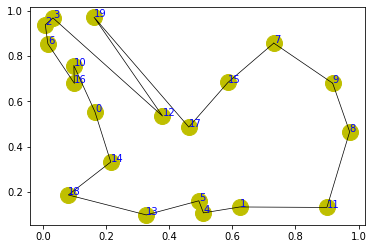

step:1730/5000, actic loss:-0.721, critic loss:0.706, L:5.056, 0min1sec
step:1731/5000, actic loss:-0.721, critic loss:0.706, L:5.056, 0min0sec
step:1732/5000, actic loss:-0.720, critic loss:0.705, L:5.056, 0min0sec
step:1733/5000, actic loss:-0.720, critic loss:0.705, L:5.056, 0min0sec
step:1734/5000, actic loss:-0.720, critic loss:0.705, L:5.055, 0min0sec
distance:4.246
tensor([ 6, 12, 14,  3,  2, 11,  0, 15,  9,  4, 18, 19, 13, 17,  1,  8,  7, 10,
        16,  5])


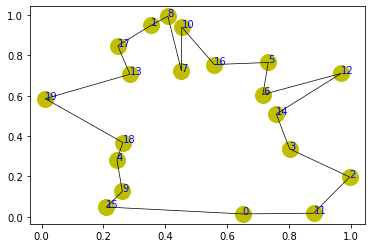

step:1735/5000, actic loss:-0.719, critic loss:0.705, L:5.055, 0min0sec
step:1736/5000, actic loss:-0.719, critic loss:0.704, L:5.055, 0min0sec
step:1737/5000, actic loss:-0.719, critic loss:0.704, L:5.054, 0min0sec
step:1738/5000, actic loss:-0.718, critic loss:0.704, L:5.054, 0min0sec
step:1739/5000, actic loss:-0.718, critic loss:0.704, L:5.054, 0min0sec
distance:3.808
tensor([ 0,  5, 12, 17, 13,  7, 14, 19, 16,  2, 10,  8,  6,  3, 18, 15,  1,  4,
        11,  9])


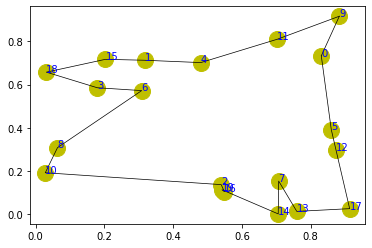

step:1740/5000, actic loss:-0.718, critic loss:0.703, L:5.053, 0min0sec
step:1741/5000, actic loss:-0.717, critic loss:0.703, L:5.053, 0min0sec
step:1742/5000, actic loss:-0.717, critic loss:0.703, L:5.053, 0min0sec
step:1743/5000, actic loss:-0.717, critic loss:0.702, L:5.052, 0min0sec
step:1744/5000, actic loss:-0.717, critic loss:0.702, L:5.052, 0min0sec
distance:4.236
tensor([16, 14, 19,  6, 10, 11,  3,  9, 13,  2,  5, 15,  8, 18, 17,  0, 12,  7,
         4,  1])


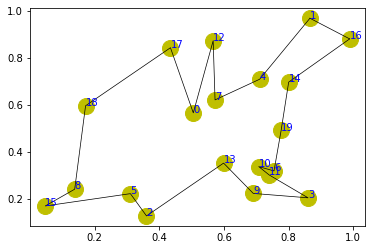

step:1745/5000, actic loss:-0.716, critic loss:0.702, L:5.052, 0min0sec
step:1746/5000, actic loss:-0.715, critic loss:0.702, L:5.051, 0min0sec
step:1747/5000, actic loss:-0.715, critic loss:0.701, L:5.051, 0min1sec
step:1748/5000, actic loss:-0.715, critic loss:0.701, L:5.050, 0min0sec
step:1749/5000, actic loss:-0.715, critic loss:0.701, L:5.050, 0min0sec
distance:4.333
tensor([16, 10,  7,  9, 11,  3, 13,  5, 14, 12,  6, 17, 15, 19,  1,  2,  8,  4,
        18,  0])


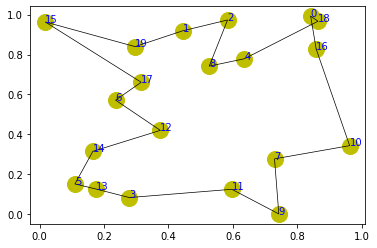

step:1750/5000, actic loss:-0.714, critic loss:0.701, L:5.050, 0min1sec
step:1751/5000, actic loss:-0.714, critic loss:0.700, L:5.049, 0min1sec
step:1752/5000, actic loss:-0.714, critic loss:0.700, L:5.049, 0min0sec
step:1753/5000, actic loss:-0.712, critic loss:0.700, L:5.049, 0min0sec
step:1754/5000, actic loss:-0.711, critic loss:0.700, L:5.048, 0min0sec
distance:4.380
tensor([ 9, 12,  0, 15, 14, 13,  5,  4,  3,  8,  6, 16, 10, 19, 17,  2,  7, 11,
        18,  1])


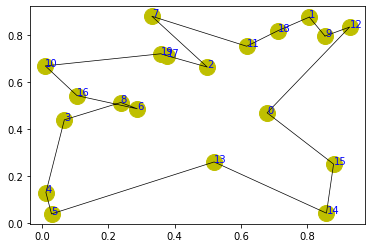

step:1755/5000, actic loss:-0.711, critic loss:0.699, L:5.048, 0min1sec
step:1756/5000, actic loss:-0.710, critic loss:0.699, L:5.048, 0min2sec
step:1757/5000, actic loss:-0.710, critic loss:0.699, L:5.047, 0min1sec
step:1758/5000, actic loss:-0.710, critic loss:0.699, L:5.047, 0min0sec
step:1759/5000, actic loss:-0.709, critic loss:0.698, L:5.046, 0min0sec
distance:3.979
tensor([ 1, 18,  6,  3,  8,  2, 12, 15,  5,  7,  4, 19, 14,  9, 11, 16, 10, 13,
         0, 17])


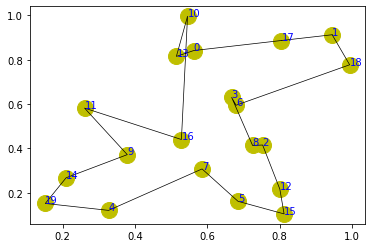

step:1760/5000, actic loss:-0.709, critic loss:0.698, L:5.046, 0min0sec
step:1761/5000, actic loss:-0.709, critic loss:0.698, L:5.046, 0min0sec
step:1762/5000, actic loss:-0.708, critic loss:0.697, L:5.045, 0min0sec
step:1763/5000, actic loss:-0.708, critic loss:0.697, L:5.045, 0min0sec
step:1764/5000, actic loss:-0.707, critic loss:0.697, L:5.044, 0min0sec
distance:4.717
tensor([ 0,  3,  2, 16, 10,  7, 19, 15, 18,  8,  5, 12, 13, 17, 14,  6,  1,  9,
         4, 11])


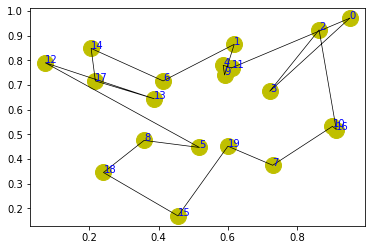

step:1765/5000, actic loss:-0.707, critic loss:0.696, L:5.044, 0min0sec
step:1766/5000, actic loss:-0.707, critic loss:0.696, L:5.044, 0min1sec
step:1767/5000, actic loss:-0.707, critic loss:0.696, L:5.043, 0min0sec
step:1768/5000, actic loss:-0.706, critic loss:0.696, L:5.043, 0min1sec
step:1769/5000, actic loss:-0.705, critic loss:0.695, L:5.043, 0min0sec
distance:4.355
tensor([14,  7,  1,  9,  3, 15, 11,  4, 10, 19, 13, 18, 16,  0,  6, 12,  5, 17,
         8,  2])


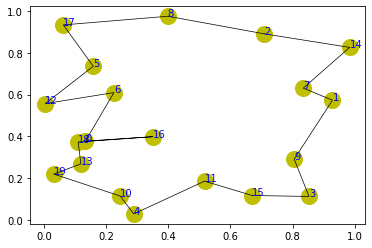

step:1770/5000, actic loss:-0.705, critic loss:0.695, L:5.042, 0min0sec
step:1771/5000, actic loss:-0.705, critic loss:0.695, L:5.042, 0min0sec
step:1772/5000, actic loss:-0.705, critic loss:0.694, L:5.042, 0min0sec
step:1773/5000, actic loss:-0.704, critic loss:0.694, L:5.041, 0min0sec
step:1774/5000, actic loss:-0.704, critic loss:0.694, L:5.041, 0min0sec
distance:5.078
tensor([11, 17, 14, 16, 10,  9, 12,  2,  1,  8,  0, 18,  6, 15,  5, 19,  3,  7,
         4, 13])


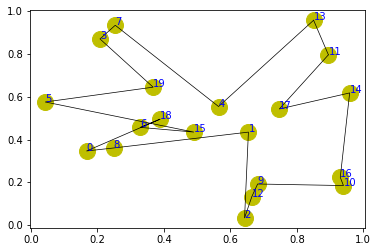

step:1775/5000, actic loss:-0.703, critic loss:0.694, L:5.041, 0min0sec
step:1776/5000, actic loss:-0.703, critic loss:0.693, L:5.040, 0min0sec
step:1777/5000, actic loss:-0.702, critic loss:0.693, L:5.040, 0min1sec
step:1778/5000, actic loss:-0.703, critic loss:0.693, L:5.040, 0min0sec
step:1779/5000, actic loss:-0.703, critic loss:0.693, L:5.039, 0min0sec
distance:4.418
tensor([ 4,  1,  5, 19, 14, 15,  7,  8, 18,  6, 13, 11, 12, 16,  3,  0, 10,  2,
         9, 17])


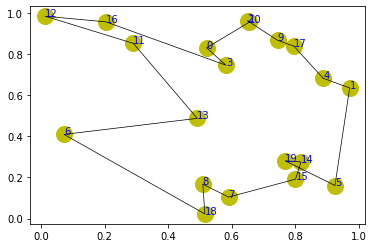

step:1780/5000, actic loss:-0.703, critic loss:0.692, L:5.039, 0min0sec
step:1781/5000, actic loss:-0.702, critic loss:0.692, L:5.039, 0min0sec
step:1782/5000, actic loss:-0.701, critic loss:0.692, L:5.038, 0min0sec
step:1783/5000, actic loss:-0.701, critic loss:0.692, L:5.038, 0min0sec
step:1784/5000, actic loss:-0.700, critic loss:0.691, L:5.038, 0min0sec
distance:3.605
tensor([ 9, 11,  8, 18,  4,  1,  2, 15, 12,  3, 16, 10,  6, 14, 19,  0, 13, 17,
         7,  5])


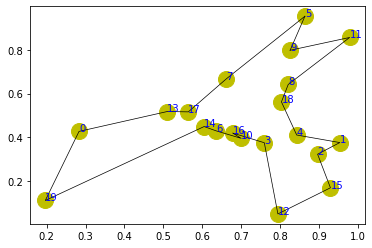

step:1785/5000, actic loss:-0.700, critic loss:0.691, L:5.037, 0min1sec
step:1786/5000, actic loss:-0.700, critic loss:0.691, L:5.037, 0min1sec
step:1787/5000, actic loss:-0.701, critic loss:0.691, L:5.037, 0min0sec
step:1788/5000, actic loss:-0.701, critic loss:0.691, L:5.037, 0min0sec
step:1789/5000, actic loss:-0.700, critic loss:0.690, L:5.036, 0min0sec
distance:4.033
tensor([ 4, 15,  9,  1, 13, 14, 10,  7,  6,  3, 12, 19,  5,  8,  2, 11, 16, 17,
        18,  0])


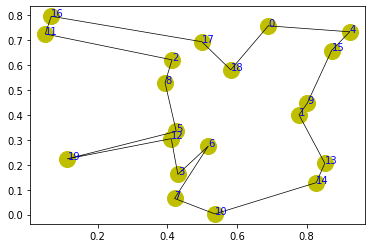

step:1790/5000, actic loss:-0.699, critic loss:0.690, L:5.036, 0min0sec
step:1791/5000, actic loss:-0.699, critic loss:0.690, L:5.036, 0min0sec
step:1792/5000, actic loss:-0.699, critic loss:0.690, L:5.035, 0min0sec
step:1793/5000, actic loss:-0.698, critic loss:0.689, L:5.035, 0min1sec
step:1794/5000, actic loss:-0.698, critic loss:0.689, L:5.035, 0min1sec
distance:4.783
tensor([14,  9, 10,  7, 12, 17, 13, 18,  4, 19,  0,  2,  5, 15,  1, 16,  6,  8,
        11,  3])


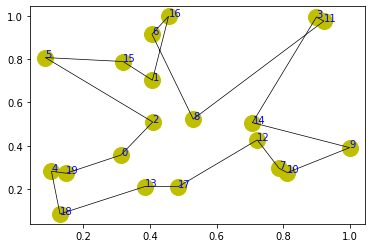

step:1795/5000, actic loss:-0.697, critic loss:0.689, L:5.034, 0min1sec
step:1796/5000, actic loss:-0.697, critic loss:0.689, L:5.034, 0min0sec
step:1797/5000, actic loss:-0.696, critic loss:0.688, L:5.034, 0min0sec
step:1798/5000, actic loss:-0.696, critic loss:0.688, L:5.033, 0min0sec
step:1799/5000, actic loss:-0.696, critic loss:0.688, L:5.033, 0min0sec
distance:4.195
tensor([ 4, 13, 12, 18,  9,  7, 11, 15, 10,  2,  8,  3,  0,  5, 17,  1,  6, 16,
        19, 14])


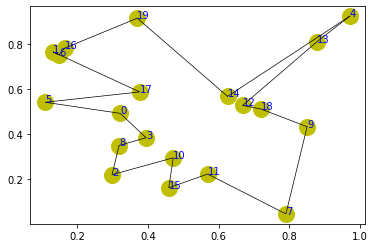

step:1800/5000, actic loss:-0.696, critic loss:0.688, L:5.033, 0min0sec
step:1801/5000, actic loss:-0.696, critic loss:0.687, L:5.032, 0min0sec
step:1802/5000, actic loss:-0.695, critic loss:0.687, L:5.032, 0min0sec
step:1803/5000, actic loss:-0.694, critic loss:0.687, L:5.032, 0min0sec
step:1804/5000, actic loss:-0.693, critic loss:0.687, L:5.031, 0min0sec
distance:4.780
tensor([ 3,  1, 12,  4, 16, 14, 11, 10, 18,  7,  6,  9, 15, 19,  2,  8,  0, 17,
         5, 13])


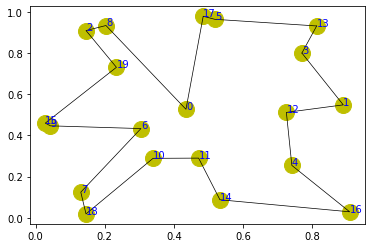

step:1805/5000, actic loss:-0.693, critic loss:0.686, L:5.031, 0min0sec
step:1806/5000, actic loss:-0.692, critic loss:0.686, L:5.031, 0min0sec
step:1807/5000, actic loss:-0.692, critic loss:0.686, L:5.030, 0min0sec
step:1808/5000, actic loss:-0.692, critic loss:0.685, L:5.030, 0min0sec
step:1809/5000, actic loss:-0.692, critic loss:0.685, L:5.029, 0min0sec
distance:4.613
tensor([ 2,  6, 18,  5, 14, 12,  4,  8, 15,  3,  7, 19, 17,  9,  0, 13, 16, 10,
        11,  1])


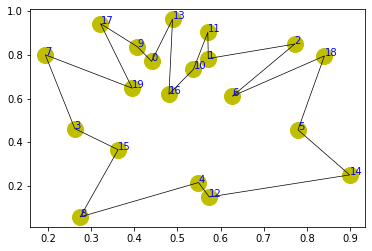

step:1810/5000, actic loss:-0.692, critic loss:0.685, L:5.029, 0min0sec
step:1811/5000, actic loss:-0.691, critic loss:0.685, L:5.029, 0min0sec
step:1812/5000, actic loss:-0.691, critic loss:0.684, L:5.028, 0min0sec
step:1813/5000, actic loss:-0.690, critic loss:0.684, L:5.028, 0min0sec
step:1814/5000, actic loss:-0.689, critic loss:0.684, L:5.027, 0min0sec
distance:4.333
tensor([ 3, 14,  9, 15,  8, 19,  1,  6,  4,  5, 10,  0,  7, 11, 17,  2, 13, 18,
        16, 12])


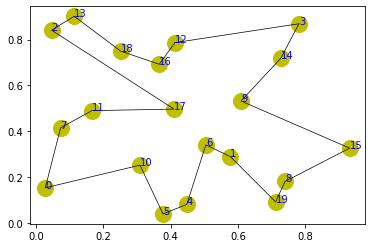

step:1815/5000, actic loss:-0.689, critic loss:0.684, L:5.027, 0min0sec
step:1816/5000, actic loss:-0.689, critic loss:0.683, L:5.027, 0min1sec
step:1817/5000, actic loss:-0.689, critic loss:0.683, L:5.026, 0min1sec
step:1818/5000, actic loss:-0.688, critic loss:0.683, L:5.026, 0min1sec
step:1819/5000, actic loss:-0.688, critic loss:0.682, L:5.025, 0min1sec
distance:4.038
tensor([ 1,  5,  0,  8,  3,  6, 13,  7,  9, 12, 17, 16, 15,  4,  2, 19, 14, 10,
        11, 18])


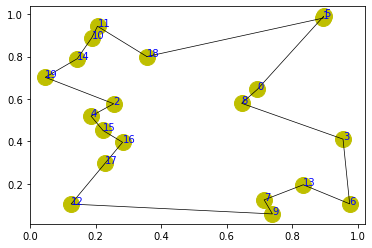

step:1820/5000, actic loss:-0.688, critic loss:0.682, L:5.025, 0min1sec
step:1821/5000, actic loss:-0.687, critic loss:0.682, L:5.025, 0min0sec
step:1822/5000, actic loss:-0.687, critic loss:0.682, L:5.024, 0min1sec
step:1823/5000, actic loss:-0.687, critic loss:0.681, L:5.024, 0min1sec
step:1824/5000, actic loss:-0.687, critic loss:0.681, L:5.024, 0min1sec
distance:4.432
tensor([ 9, 13,  0,  5, 15,  1,  8, 18, 17, 19, 16, 11,  6,  4,  3, 10,  7, 14,
        12,  2])


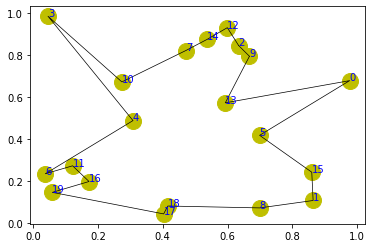

step:1825/5000, actic loss:-0.686, critic loss:0.681, L:5.024, 0min0sec
step:1826/5000, actic loss:-0.686, critic loss:0.681, L:5.023, 0min0sec
step:1827/5000, actic loss:-0.685, critic loss:0.680, L:5.023, 0min0sec
step:1828/5000, actic loss:-0.685, critic loss:0.680, L:5.023, 0min0sec
step:1829/5000, actic loss:-0.684, critic loss:0.680, L:5.022, 0min0sec
distance:5.354
tensor([12,  6, 11, 19, 10,  0,  2,  8, 16, 15, 18, 14,  1,  9,  3,  4, 17,  7,
        13,  5])


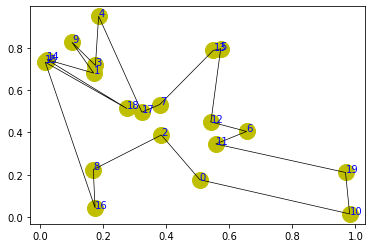

step:1830/5000, actic loss:-0.684, critic loss:0.680, L:5.022, 0min1sec
step:1831/5000, actic loss:-0.684, critic loss:0.679, L:5.022, 0min1sec
step:1832/5000, actic loss:-0.683, critic loss:0.679, L:5.022, 0min0sec
step:1833/5000, actic loss:-0.683, critic loss:0.679, L:5.021, 0min0sec
step:1834/5000, actic loss:-0.683, critic loss:0.679, L:5.021, 0min0sec
distance:4.087
tensor([ 4, 15,  1, 16,  0, 14,  9,  5, 12, 19, 13, 10,  6,  7, 18,  8,  2,  3,
        11, 17])


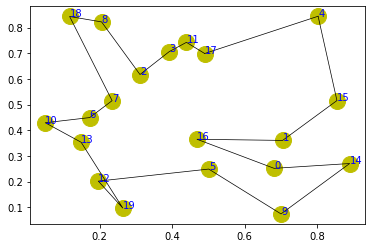

step:1835/5000, actic loss:-0.682, critic loss:0.678, L:5.021, 0min1sec
step:1836/5000, actic loss:-0.682, critic loss:0.678, L:5.020, 0min0sec
step:1837/5000, actic loss:-0.681, critic loss:0.678, L:5.020, 0min0sec
step:1838/5000, actic loss:-0.680, critic loss:0.678, L:5.020, 0min0sec
step:1839/5000, actic loss:-0.680, critic loss:0.677, L:5.019, 0min0sec
distance:4.149
tensor([ 1, 14,  5, 19, 17,  9,  0,  4, 10,  8, 13, 16,  6, 15,  3,  2,  7, 12,
        18, 11])


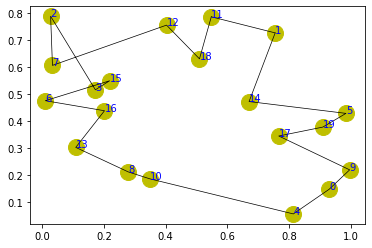

step:1840/5000, actic loss:-0.681, critic loss:0.677, L:5.019, 0min0sec
step:1841/5000, actic loss:-0.681, critic loss:0.677, L:5.019, 0min0sec
step:1842/5000, actic loss:-0.681, critic loss:0.677, L:5.018, 0min0sec
step:1843/5000, actic loss:-0.681, critic loss:0.677, L:5.018, 0min0sec
step:1844/5000, actic loss:-0.680, critic loss:0.676, L:5.018, 0min0sec
distance:3.967
tensor([ 9,  3, 10, 13, 19,  0,  4, 14,  5, 15, 17,  1,  6, 16, 18,  2,  8, 11,
        12,  7])


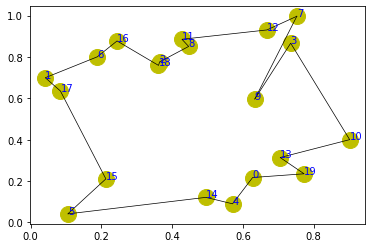

step:1845/5000, actic loss:-0.679, critic loss:0.676, L:5.017, 0min0sec
step:1846/5000, actic loss:-0.679, critic loss:0.676, L:5.017, 0min0sec
step:1847/5000, actic loss:-0.678, critic loss:0.676, L:5.017, 0min0sec
step:1848/5000, actic loss:-0.678, critic loss:0.675, L:5.016, 0min0sec
step:1849/5000, actic loss:-0.678, critic loss:0.675, L:5.016, 0min0sec
distance:4.400
tensor([15,  9, 18,  8,  3, 11,  4, 17,  7,  1, 19,  0, 10, 13,  2, 16, 12,  6,
         5, 14])


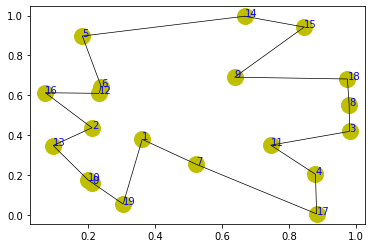

step:1850/5000, actic loss:-0.678, critic loss:0.675, L:5.016, 0min0sec
step:1851/5000, actic loss:-0.677, critic loss:0.675, L:5.015, 0min0sec
step:1852/5000, actic loss:-0.677, critic loss:0.674, L:5.015, 0min1sec
step:1853/5000, actic loss:-0.676, critic loss:0.674, L:5.015, 0min0sec
step:1854/5000, actic loss:-0.676, critic loss:0.674, L:5.014, 0min1sec
distance:3.435
tensor([16, 17, 18, 15,  7,  6,  0, 12, 14,  4,  5,  2,  9,  1,  3, 13, 19, 11,
         8, 10])


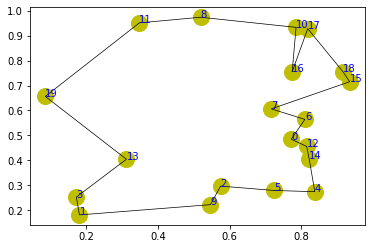

step:1855/5000, actic loss:-0.675, critic loss:0.674, L:5.014, 0min1sec
step:1856/5000, actic loss:-0.675, critic loss:0.673, L:5.014, 0min0sec
step:1857/5000, actic loss:-0.675, critic loss:0.673, L:5.013, 0min0sec
step:1858/5000, actic loss:-0.675, critic loss:0.673, L:5.013, 0min0sec
step:1859/5000, actic loss:-0.675, critic loss:0.673, L:5.013, 0min0sec
distance:4.182
tensor([15, 19, 14, 10,  8,  9,  6,  3, 12, 16, 18,  7,  4, 11, 17,  2, 13,  0,
         1,  5])


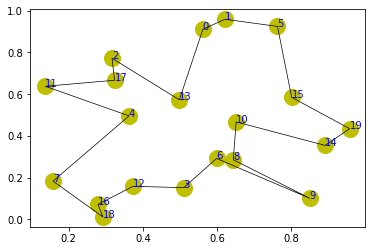

step:1860/5000, actic loss:-0.674, critic loss:0.672, L:5.012, 0min0sec
step:1861/5000, actic loss:-0.674, critic loss:0.672, L:5.012, 0min0sec
step:1862/5000, actic loss:-0.673, critic loss:0.672, L:5.012, 0min1sec
step:1863/5000, actic loss:-0.673, critic loss:0.672, L:5.011, 0min1sec
step:1864/5000, actic loss:-0.673, critic loss:0.671, L:5.011, 0min0sec
distance:3.874
tensor([10, 16,  6, 14,  5,  7,  4,  3,  2,  1, 11,  8, 15,  0, 19,  9, 13, 12,
        17, 18])


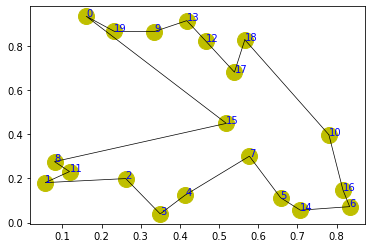

step:1865/5000, actic loss:-0.672, critic loss:0.671, L:5.011, 0min1sec
step:1866/5000, actic loss:-0.672, critic loss:0.671, L:5.010, 0min0sec
step:1867/5000, actic loss:-0.672, critic loss:0.671, L:5.010, 0min0sec
step:1868/5000, actic loss:-0.671, critic loss:0.670, L:5.010, 0min0sec
step:1869/5000, actic loss:-0.671, critic loss:0.670, L:5.009, 0min0sec
distance:4.763
tensor([16,  7,  5, 13, 19,  6,  1, 10,  2,  9,  8, 17, 12, 14,  4, 18, 11,  3,
         0, 15])


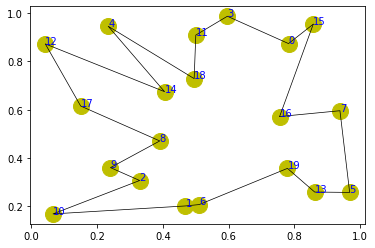

step:1870/5000, actic loss:-0.671, critic loss:0.670, L:5.009, 0min1sec
step:1871/5000, actic loss:-0.671, critic loss:0.670, L:5.009, 0min1sec
step:1872/5000, actic loss:-0.671, critic loss:0.669, L:5.008, 0min0sec
step:1873/5000, actic loss:-0.670, critic loss:0.669, L:5.008, 0min0sec
step:1874/5000, actic loss:-0.670, critic loss:0.669, L:5.008, 0min0sec
distance:4.262
tensor([ 6,  2, 13, 16, 15,  5,  8,  1, 10, 17,  3,  9, 18, 14, 11,  0, 12, 19,
         4,  7])


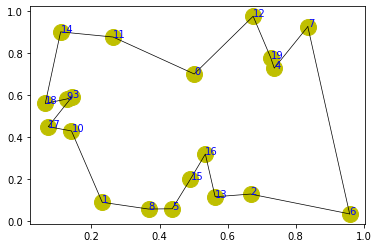

step:1875/5000, actic loss:-0.669, critic loss:0.669, L:5.007, 0min0sec
step:1876/5000, actic loss:-0.669, critic loss:0.668, L:5.007, 0min0sec
step:1877/5000, actic loss:-0.669, critic loss:0.668, L:5.007, 0min0sec
step:1878/5000, actic loss:-0.669, critic loss:0.668, L:5.007, 0min0sec
step:1879/5000, actic loss:-0.669, critic loss:0.668, L:5.007, 0min0sec
distance:5.345
tensor([ 8,  9, 15, 19,  0, 18,  1, 17,  5, 10, 11, 14,  7,  4,  3, 16,  2,  6,
        13, 12])


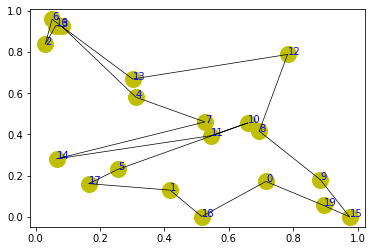

step:1880/5000, actic loss:-0.668, critic loss:0.668, L:5.006, 0min0sec
step:1881/5000, actic loss:-0.668, critic loss:0.667, L:5.006, 0min0sec
step:1882/5000, actic loss:-0.668, critic loss:0.667, L:5.006, 0min0sec
step:1883/5000, actic loss:-0.668, critic loss:0.667, L:5.006, 0min0sec
step:1884/5000, actic loss:-0.667, critic loss:0.667, L:5.006, 0min0sec
distance:4.797
tensor([ 7, 14,  8,  6, 15, 10, 18, 17, 16,  1,  3,  5,  2,  9,  0, 19, 12, 13,
         4, 11])


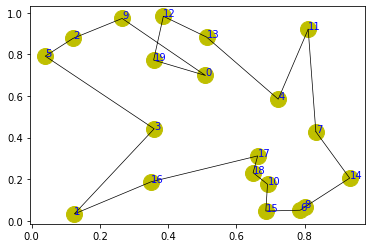

step:1885/5000, actic loss:-0.667, critic loss:0.666, L:5.006, 0min0sec
step:1886/5000, actic loss:-0.667, critic loss:0.666, L:5.005, 0min0sec
step:1887/5000, actic loss:-0.666, critic loss:0.666, L:5.005, 0min0sec
step:1888/5000, actic loss:-0.665, critic loss:0.666, L:5.005, 0min0sec
step:1889/5000, actic loss:-0.664, critic loss:0.666, L:5.005, 0min0sec
distance:5.326
tensor([ 4,  5, 15,  2,  6, 17,  7, 12, 10,  3, 14,  0,  8, 13, 19, 16,  1, 11,
         9, 18])


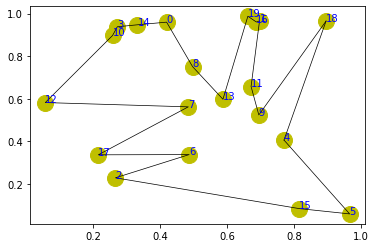

step:1890/5000, actic loss:-0.664, critic loss:0.665, L:5.005, 0min0sec
step:1891/5000, actic loss:-0.665, critic loss:0.665, L:5.005, 0min0sec
step:1892/5000, actic loss:-0.665, critic loss:0.665, L:5.004, 0min0sec
step:1893/5000, actic loss:-0.664, critic loss:0.665, L:5.004, 0min0sec
step:1894/5000, actic loss:-0.664, critic loss:0.665, L:5.004, 0min0sec
distance:4.388
tensor([ 2, 14,  5,  8,  1, 16, 12,  7, 15, 18, 11, 19,  3,  0,  9,  4, 17,  6,
        13, 10])


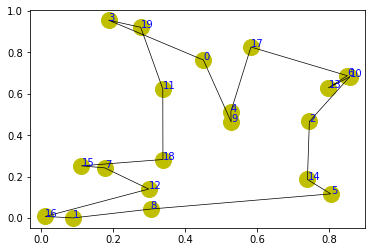

step:1895/5000, actic loss:-0.663, critic loss:0.664, L:5.004, 0min0sec
step:1896/5000, actic loss:-0.663, critic loss:0.664, L:5.003, 0min0sec
step:1897/5000, actic loss:-0.663, critic loss:0.664, L:5.003, 0min0sec
step:1898/5000, actic loss:-0.663, critic loss:0.664, L:5.003, 0min1sec
step:1899/5000, actic loss:-0.662, critic loss:0.663, L:5.003, 0min0sec
distance:4.837
tensor([ 8, 16,  1,  2, 15, 13, 14, 18,  7,  3, 12, 10,  6, 11, 17,  9,  4,  0,
         5, 19])


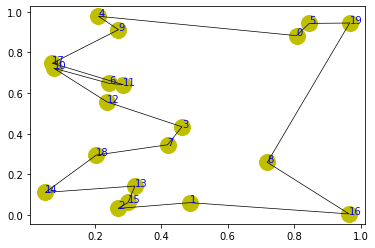

step:1900/5000, actic loss:-0.662, critic loss:0.663, L:5.002, 0min1sec
step:1901/5000, actic loss:-0.662, critic loss:0.663, L:5.002, 0min0sec
step:1902/5000, actic loss:-0.662, critic loss:0.663, L:5.002, 0min0sec
step:1903/5000, actic loss:-0.662, critic loss:0.662, L:5.002, 0min0sec
step:1904/5000, actic loss:-0.661, critic loss:0.662, L:5.001, 0min0sec
distance:4.680
tensor([14, 15, 12, 10,  5,  2, 19,  4, 17, 11, 16, 13,  9,  7,  0,  3, 18,  1,
         6,  8])


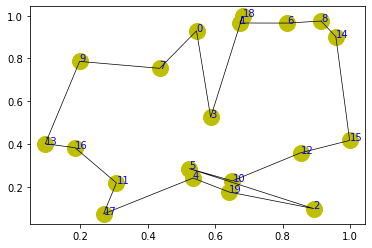

step:1905/5000, actic loss:-0.660, critic loss:0.662, L:5.001, 0min1sec
step:1906/5000, actic loss:-0.660, critic loss:0.662, L:5.001, 0min0sec
step:1907/5000, actic loss:-0.659, critic loss:0.662, L:5.000, 0min0sec
step:1908/5000, actic loss:-0.659, critic loss:0.661, L:5.000, 0min0sec
step:1909/5000, actic loss:-0.659, critic loss:0.661, L:5.000, 0min0sec
distance:3.939
tensor([18, 17,  7,  1,  0,  8, 15, 10, 16, 14, 11,  6, 12,  4, 19, 13,  3,  9,
         5,  2])


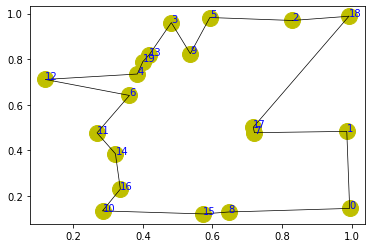

step:1910/5000, actic loss:-0.659, critic loss:0.661, L:4.999, 0min1sec
step:1911/5000, actic loss:-0.659, critic loss:0.661, L:4.999, 0min0sec
step:1912/5000, actic loss:-0.658, critic loss:0.661, L:4.999, 0min1sec
step:1913/5000, actic loss:-0.658, critic loss:0.660, L:4.998, 0min1sec
step:1914/5000, actic loss:-0.657, critic loss:0.660, L:4.998, 0min0sec
distance:4.400
tensor([ 9, 13,  2, 12, 19,  8,  7, 16, 11,  1,  4, 14,  6,  3, 15,  5, 17,  0,
        18, 10])


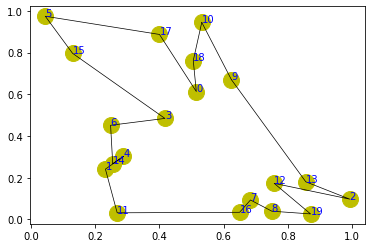

step:1915/5000, actic loss:-0.657, critic loss:0.660, L:4.998, 0min0sec
step:1916/5000, actic loss:-0.656, critic loss:0.660, L:4.997, 0min0sec
step:1917/5000, actic loss:-0.656, critic loss:0.659, L:4.997, 0min0sec
step:1918/5000, actic loss:-0.656, critic loss:0.659, L:4.997, 0min0sec
step:1919/5000, actic loss:-0.656, critic loss:0.659, L:4.996, 0min0sec
distance:3.894
tensor([ 4, 13,  6, 11,  9,  7, 15,  3, 14, 10, 17,  0, 12, 19, 16,  1,  5, 18,
         2,  8])


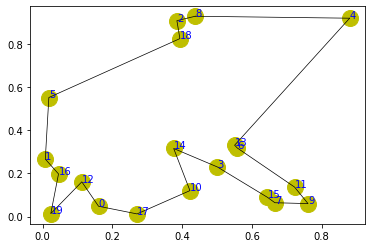

step:1920/5000, actic loss:-0.655, critic loss:0.658, L:4.996, 0min1sec
step:1921/5000, actic loss:-0.655, critic loss:0.658, L:4.996, 0min0sec
step:1922/5000, actic loss:-0.655, critic loss:0.658, L:4.995, 0min0sec
step:1923/5000, actic loss:-0.655, critic loss:0.658, L:4.995, 0min0sec
step:1924/5000, actic loss:-0.654, critic loss:0.657, L:4.995, 0min0sec
distance:4.166
tensor([15,  9,  8, 17, 19,  6,  1, 16,  3, 12, 13, 11,  2, 18,  0, 14,  4, 10,
         5,  7])


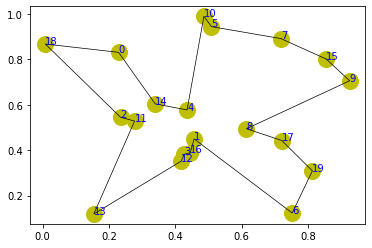

step:1925/5000, actic loss:-0.654, critic loss:0.657, L:4.994, 0min0sec
step:1926/5000, actic loss:-0.654, critic loss:0.657, L:4.994, 0min0sec
step:1927/5000, actic loss:-0.653, critic loss:0.657, L:4.993, 0min0sec
step:1928/5000, actic loss:-0.653, critic loss:0.656, L:4.993, 0min0sec
step:1929/5000, actic loss:-0.653, critic loss:0.656, L:4.993, 0min0sec
distance:4.258
tensor([ 5,  0, 19, 13,  6, 12,  2, 10,  9, 14, 16, 11, 17, 15, 18,  8,  3,  4,
         7,  1])


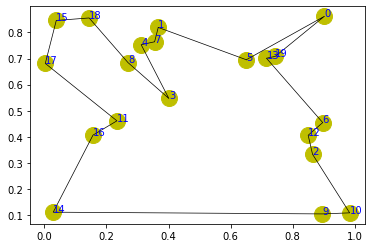

step:1930/5000, actic loss:-0.652, critic loss:0.656, L:4.992, 0min0sec
step:1931/5000, actic loss:-0.652, critic loss:0.656, L:4.992, 0min0sec
step:1932/5000, actic loss:-0.652, critic loss:0.655, L:4.992, 0min0sec
step:1933/5000, actic loss:-0.651, critic loss:0.655, L:4.991, 0min0sec
step:1934/5000, actic loss:-0.651, critic loss:0.655, L:4.991, 0min0sec
distance:5.009
tensor([ 5, 18, 19, 16, 13, 11,  4, 17,  2, 15,  9,  3,  6,  8, 14,  0,  1, 12,
        10,  7])


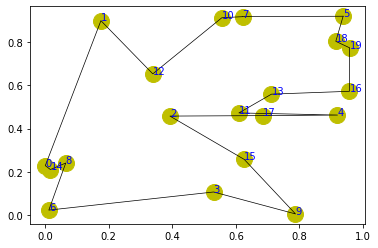

step:1935/5000, actic loss:-0.650, critic loss:0.655, L:4.991, 0min0sec
step:1936/5000, actic loss:-0.650, critic loss:0.654, L:4.990, 0min0sec
step:1937/5000, actic loss:-0.650, critic loss:0.654, L:4.990, 0min0sec
step:1938/5000, actic loss:-0.650, critic loss:0.654, L:4.990, 0min0sec
step:1939/5000, actic loss:-0.649, critic loss:0.654, L:4.989, 0min0sec
distance:4.445
tensor([10,  2, 11,  4,  3,  7,  5,  8, 17,  9,  0, 19, 13, 14, 18, 16, 15, 12,
         1,  6])


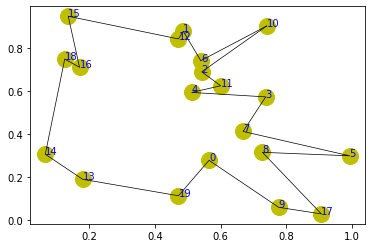

step:1940/5000, actic loss:-0.649, critic loss:0.653, L:4.989, 0min0sec
step:1941/5000, actic loss:-0.648, critic loss:0.653, L:4.989, 0min0sec
step:1942/5000, actic loss:-0.648, critic loss:0.653, L:4.988, 0min1sec
step:1943/5000, actic loss:-0.648, critic loss:0.653, L:4.988, 0min0sec
step:1944/5000, actic loss:-0.647, critic loss:0.652, L:4.988, 0min0sec
distance:4.907
tensor([ 5, 14, 11, 12, 15,  7,  9, 13,  3,  0,  6, 10, 19,  8,  1, 17, 16, 18,
         4,  2])


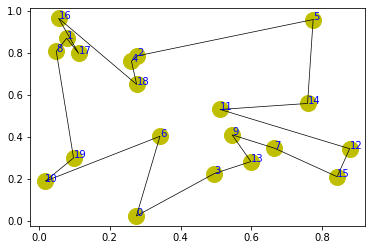

step:1945/5000, actic loss:-0.647, critic loss:0.652, L:4.987, 0min0sec
step:1946/5000, actic loss:-0.647, critic loss:0.652, L:4.987, 0min0sec
step:1947/5000, actic loss:-0.646, critic loss:0.652, L:4.987, 0min0sec
step:1948/5000, actic loss:-0.646, critic loss:0.651, L:4.986, 0min0sec
step:1949/5000, actic loss:-0.645, critic loss:0.651, L:4.986, 0min0sec
distance:4.894
tensor([ 3, 19,  9,  4,  0,  6,  2, 11,  7,  8, 17, 18, 13, 12, 10, 15, 14, 16,
         1,  5])


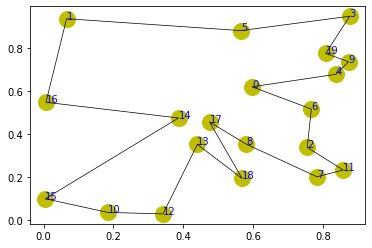

step:1950/5000, actic loss:-0.645, critic loss:0.651, L:4.986, 0min1sec
step:1951/5000, actic loss:-0.645, critic loss:0.651, L:4.985, 0min0sec
step:1952/5000, actic loss:-0.645, critic loss:0.650, L:4.985, 0min0sec
step:1953/5000, actic loss:-0.645, critic loss:0.650, L:4.985, 0min0sec
step:1954/5000, actic loss:-0.644, critic loss:0.650, L:4.984, 0min0sec
distance:3.826
tensor([ 0, 16, 17, 13,  1,  3, 11, 10,  2,  7, 19, 14,  8, 12, 18,  9,  5,  6,
         4, 15])


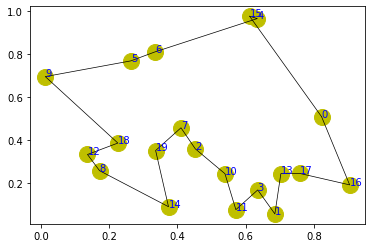

step:1955/5000, actic loss:-0.644, critic loss:0.650, L:4.984, 0min0sec
step:1956/5000, actic loss:-0.644, critic loss:0.649, L:4.983, 0min0sec
step:1957/5000, actic loss:-0.643, critic loss:0.649, L:4.983, 0min0sec
step:1958/5000, actic loss:-0.643, critic loss:0.649, L:4.983, 0min0sec
step:1959/5000, actic loss:-0.643, critic loss:0.649, L:4.983, 0min0sec
distance:4.709
tensor([18,  4, 12, 16,  1,  8, 19,  0, 11, 13,  2,  3, 14, 15, 17,  6, 10,  5,
         9,  7])


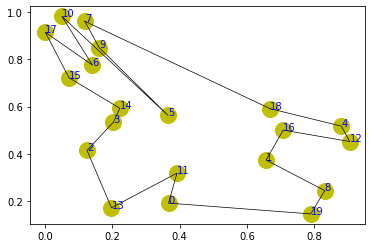

step:1960/5000, actic loss:-0.642, critic loss:0.648, L:4.982, 0min1sec
step:1961/5000, actic loss:-0.642, critic loss:0.648, L:4.982, 0min0sec
step:1962/5000, actic loss:-0.642, critic loss:0.648, L:4.982, 0min0sec
step:1963/5000, actic loss:-0.642, critic loss:0.648, L:4.981, 0min0sec
step:1964/5000, actic loss:-0.641, critic loss:0.647, L:4.981, 0min0sec
distance:3.732
tensor([19,  3,  9,  8, 15, 18, 17,  6, 16, 11,  1, 13,  7,  2, 10, 12,  5, 14,
         0,  4])


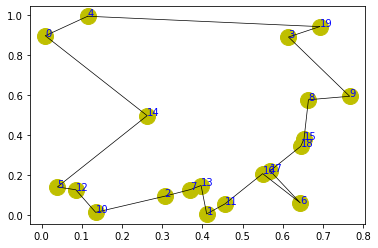

step:1965/5000, actic loss:-0.641, critic loss:0.647, L:4.981, 0min0sec
step:1966/5000, actic loss:-0.641, critic loss:0.647, L:4.980, 0min0sec
step:1967/5000, actic loss:-0.640, critic loss:0.647, L:4.980, 0min0sec
step:1968/5000, actic loss:-0.640, critic loss:0.646, L:4.980, 0min0sec
step:1969/5000, actic loss:-0.640, critic loss:0.646, L:4.979, 0min0sec
distance:4.374
tensor([15, 10, 14, 16, 17,  8, 11, 13, 18,  3,  7, 19,  9,  6,  5, 12,  2,  4,
         1,  0])


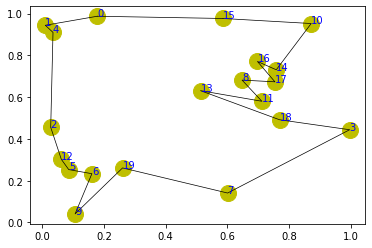

step:1970/5000, actic loss:-0.640, critic loss:0.646, L:4.979, 0min0sec
step:1971/5000, actic loss:-0.639, critic loss:0.646, L:4.979, 0min0sec
step:1972/5000, actic loss:-0.639, critic loss:0.645, L:4.978, 0min0sec
step:1973/5000, actic loss:-0.639, critic loss:0.645, L:4.978, 0min0sec
step:1974/5000, actic loss:-0.639, critic loss:0.645, L:4.978, 0min0sec
distance:3.980
tensor([13,  2,  6, 11,  8, 14, 10,  5, 12, 17,  7,  9,  4, 19,  3, 15,  1, 16,
         0, 18])


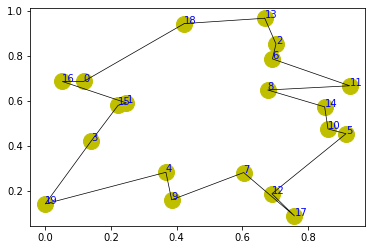

step:1975/5000, actic loss:-0.638, critic loss:0.645, L:4.977, 0min0sec
step:1976/5000, actic loss:-0.638, critic loss:0.644, L:4.977, 0min0sec
step:1977/5000, actic loss:-0.638, critic loss:0.644, L:4.977, 0min0sec
step:1978/5000, actic loss:-0.637, critic loss:0.644, L:4.976, 0min0sec
step:1979/5000, actic loss:-0.637, critic loss:0.644, L:4.976, 0min0sec
distance:4.631
tensor([ 9,  7, 11, 12,  5,  6, 10, 18,  4, 13,  0,  1, 17, 16,  2, 14, 19,  8,
        15,  3])


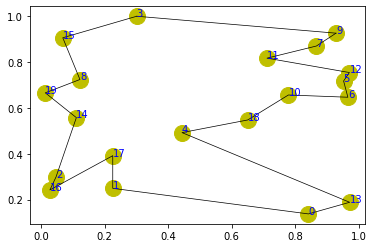

step:1980/5000, actic loss:-0.636, critic loss:0.644, L:4.976, 0min0sec
step:1981/5000, actic loss:-0.637, critic loss:0.643, L:4.975, 0min0sec
step:1982/5000, actic loss:-0.637, critic loss:0.643, L:4.975, 0min0sec
step:1983/5000, actic loss:-0.637, critic loss:0.643, L:4.975, 0min0sec
step:1984/5000, actic loss:-0.637, critic loss:0.643, L:4.975, 0min0sec
distance:4.201
tensor([ 8,  9,  4, 15, 16, 14, 10,  5, 18,  0, 13,  2, 17,  7,  1, 19, 11,  3,
         6, 12])


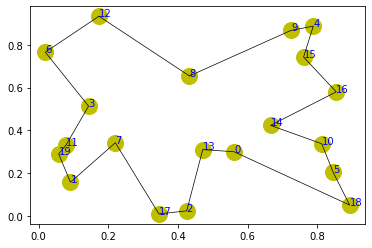

step:1985/5000, actic loss:-0.636, critic loss:0.642, L:4.974, 0min0sec
step:1986/5000, actic loss:-0.635, critic loss:0.642, L:4.974, 0min0sec
step:1987/5000, actic loss:-0.635, critic loss:0.642, L:4.974, 0min0sec
step:1988/5000, actic loss:-0.634, critic loss:0.642, L:4.973, 0min0sec
step:1989/5000, actic loss:-0.634, critic loss:0.642, L:4.973, 0min0sec
distance:5.366
tensor([13,  9, 11, 18, 15,  6,  1, 12, 17, 19,  3, 10, 16,  2,  4,  7,  8, 14,
         5,  0])


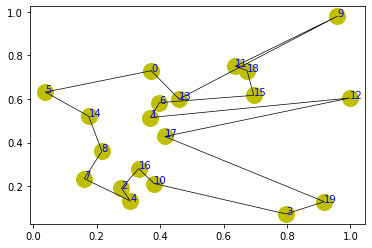

step:1990/5000, actic loss:-0.634, critic loss:0.641, L:4.973, 0min0sec
step:1991/5000, actic loss:-0.634, critic loss:0.641, L:4.973, 0min0sec
step:1992/5000, actic loss:-0.634, critic loss:0.641, L:4.972, 0min0sec
step:1993/5000, actic loss:-0.633, critic loss:0.641, L:4.972, 0min0sec
step:1994/5000, actic loss:-0.633, critic loss:0.640, L:4.972, 0min0sec
distance:4.596
tensor([ 0, 18, 12,  6,  3, 17, 15,  7, 14,  1, 11,  8,  4,  5, 13, 16, 10,  9,
        19,  2])


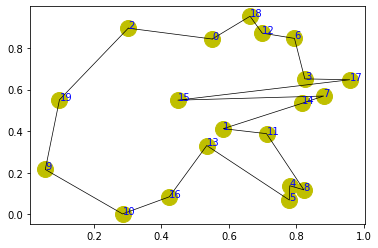

step:1995/5000, actic loss:-0.632, critic loss:0.640, L:4.971, 0min0sec
step:1996/5000, actic loss:-0.632, critic loss:0.640, L:4.971, 0min0sec
step:1997/5000, actic loss:-0.632, critic loss:0.640, L:4.971, 0min0sec
step:1998/5000, actic loss:-0.632, critic loss:0.640, L:4.970, 0min0sec
step:1999/5000, actic loss:-0.632, critic loss:0.639, L:4.970, 0min0sec
distance:4.472
tensor([ 7, 18,  2, 15,  0,  4, 19, 16, 10, 13, 17,  5, 12,  9, 11,  6,  8, 14,
         3,  1])


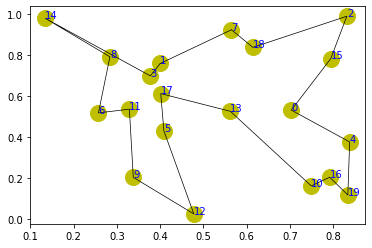

step:2000/5000, actic loss:-0.632, critic loss:0.639, L:4.970, 0min0sec
step:2001/5000, actic loss:-0.632, critic loss:0.639, L:4.969, 0min0sec
step:2002/5000, actic loss:-0.631, critic loss:0.639, L:4.969, 0min0sec
step:2003/5000, actic loss:-0.631, critic loss:0.638, L:4.969, 0min0sec
step:2004/5000, actic loss:-0.631, critic loss:0.638, L:4.969, 0min0sec
distance:4.325
tensor([10,  5,  6,  8, 17,  7, 16,  0, 19, 12, 15,  4,  9, 13, 14,  3, 18,  1,
         2, 11])


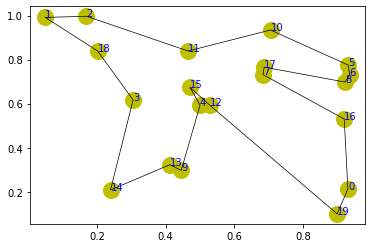

step:2005/5000, actic loss:-0.630, critic loss:0.638, L:4.968, 0min0sec
step:2006/5000, actic loss:-0.630, critic loss:0.638, L:4.968, 0min0sec
step:2007/5000, actic loss:-0.630, critic loss:0.637, L:4.968, 0min0sec
step:2008/5000, actic loss:-0.630, critic loss:0.637, L:4.968, 0min0sec
step:2009/5000, actic loss:-0.629, critic loss:0.637, L:4.967, 0min0sec
distance:5.124
tensor([19, 16, 15,  2,  4,  3, 10,  7,  8,  9, 18, 17, 11, 13, 12,  6,  5,  0,
         1, 14])


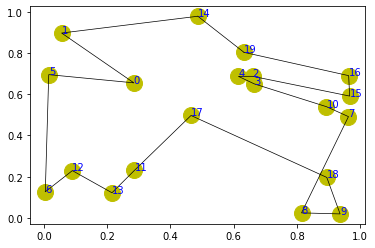

step:2010/5000, actic loss:-0.629, critic loss:0.637, L:4.967, 0min0sec
step:2011/5000, actic loss:-0.629, critic loss:0.637, L:4.967, 0min0sec
step:2012/5000, actic loss:-0.628, critic loss:0.636, L:4.967, 0min0sec
step:2013/5000, actic loss:-0.628, critic loss:0.636, L:4.967, 0min0sec
step:2014/5000, actic loss:-0.628, critic loss:0.636, L:4.966, 0min0sec
distance:5.217
tensor([14, 15,  8,  9, 19, 16,  0,  3, 18,  6, 11,  2,  4, 12,  7, 10, 17, 13,
         1,  5])


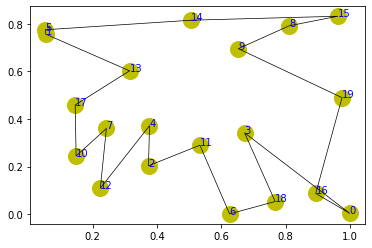

step:2015/5000, actic loss:-0.628, critic loss:0.636, L:4.966, 0min0sec
step:2016/5000, actic loss:-0.627, critic loss:0.635, L:4.966, 0min0sec
step:2017/5000, actic loss:-0.627, critic loss:0.635, L:4.965, 0min0sec
step:2018/5000, actic loss:-0.627, critic loss:0.635, L:4.965, 0min0sec
step:2019/5000, actic loss:-0.626, critic loss:0.635, L:4.965, 0min0sec
distance:5.606
tensor([ 5, 18,  3,  7,  1, 14,  6,  9,  8, 17,  0, 19, 15, 16, 13, 11, 12,  2,
         4, 10])


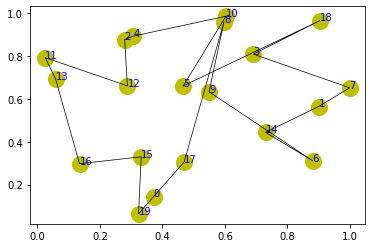

step:2020/5000, actic loss:-0.626, critic loss:0.635, L:4.965, 0min0sec
step:2021/5000, actic loss:-0.626, critic loss:0.634, L:4.964, 0min0sec
step:2022/5000, actic loss:-0.625, critic loss:0.634, L:4.964, 0min0sec
step:2023/5000, actic loss:-0.625, critic loss:0.634, L:4.964, 0min0sec
step:2024/5000, actic loss:-0.625, critic loss:0.634, L:4.963, 0min0sec
distance:4.679
tensor([ 7,  6, 15,  3,  8, 12, 17,  0, 13,  9,  2, 19, 14, 10,  5, 18, 16,  4,
        11,  1])


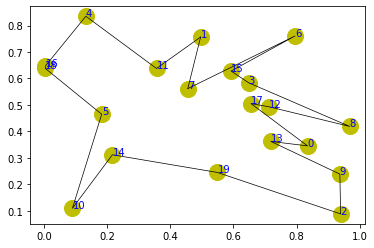

step:2025/5000, actic loss:-0.625, critic loss:0.633, L:4.963, 0min0sec
step:2026/5000, actic loss:-0.624, critic loss:0.633, L:4.963, 0min0sec
step:2027/5000, actic loss:-0.624, critic loss:0.633, L:4.963, 0min0sec
step:2028/5000, actic loss:-0.624, critic loss:0.633, L:4.962, 0min0sec
step:2029/5000, actic loss:-0.624, critic loss:0.633, L:4.962, 0min0sec
distance:4.831
tensor([14,  1, 17,  5,  3,  7, 11,  2, 18, 13,  4, 10, 15, 12,  0, 16,  6, 19,
         9,  8])


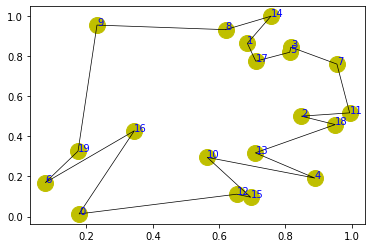

step:2030/5000, actic loss:-0.623, critic loss:0.632, L:4.962, 0min0sec
step:2031/5000, actic loss:-0.623, critic loss:0.632, L:4.961, 0min0sec
step:2032/5000, actic loss:-0.623, critic loss:0.632, L:4.961, 0min0sec
step:2033/5000, actic loss:-0.622, critic loss:0.632, L:4.961, 0min0sec
step:2034/5000, actic loss:-0.622, critic loss:0.631, L:4.961, 0min0sec
distance:4.651
tensor([ 2,  0,  8, 19, 18, 17, 14,  7, 12,  5,  6,  4, 10, 11,  3,  9, 15, 13,
        16,  1])


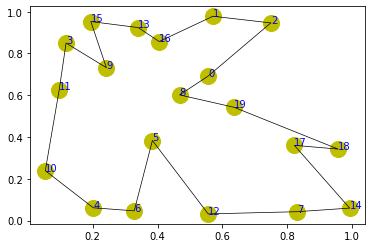

step:2035/5000, actic loss:-0.622, critic loss:0.631, L:4.960, 0min0sec
step:2036/5000, actic loss:-0.622, critic loss:0.631, L:4.960, 0min0sec
step:2037/5000, actic loss:-0.621, critic loss:0.631, L:4.960, 0min0sec
step:2038/5000, actic loss:-0.621, critic loss:0.630, L:4.959, 0min0sec
step:2039/5000, actic loss:-0.621, critic loss:0.630, L:4.959, 0min0sec
distance:4.313
tensor([17,  2,  3,  1,  6,  4, 13, 18, 12,  8, 16, 14,  9, 10, 19,  0, 11,  5,
        15,  7])


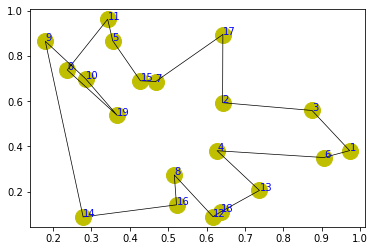

step:2040/5000, actic loss:-0.620, critic loss:0.630, L:4.959, 0min1sec
step:2041/5000, actic loss:-0.620, critic loss:0.630, L:4.958, 0min0sec
step:2042/5000, actic loss:-0.620, critic loss:0.629, L:4.958, 0min0sec
step:2043/5000, actic loss:-0.619, critic loss:0.629, L:4.958, 0min0sec
step:2044/5000, actic loss:-0.619, critic loss:0.629, L:4.958, 0min0sec
distance:5.231
tensor([15,  8, 13, 17, 14, 19, 11,  4, 16,  3,  9,  6,  7,  0, 12,  2,  1, 18,
        10,  5])


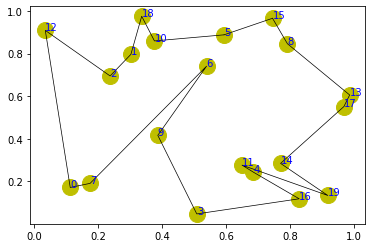

step:2045/5000, actic loss:-0.619, critic loss:0.629, L:4.957, 0min0sec
step:2046/5000, actic loss:-0.618, critic loss:0.629, L:4.957, 0min0sec
step:2047/5000, actic loss:-0.618, critic loss:0.628, L:4.957, 0min0sec
step:2048/5000, actic loss:-0.618, critic loss:0.628, L:4.956, 0min0sec
step:2049/5000, actic loss:-0.617, critic loss:0.628, L:4.956, 0min0sec
distance:5.048
tensor([ 3, 13,  4,  9, 15, 19,  6, 10,  2, 12, 18,  8,  7,  5, 14,  0,  1, 11,
        17, 16])


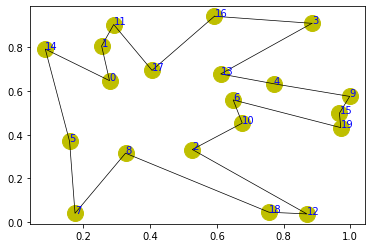

step:2050/5000, actic loss:-0.617, critic loss:0.628, L:4.956, 0min0sec
step:2051/5000, actic loss:-0.617, critic loss:0.627, L:4.955, 0min0sec
step:2052/5000, actic loss:-0.617, critic loss:0.627, L:4.955, 0min0sec
step:2053/5000, actic loss:-0.616, critic loss:0.627, L:4.955, 0min0sec
step:2054/5000, actic loss:-0.616, critic loss:0.627, L:4.955, 0min0sec
distance:4.606
tensor([17,  7, 12,  3, 13, 18, 15,  9,  4, 16, 19, 10, 11, 14,  8,  0,  2,  1,
         6,  5])


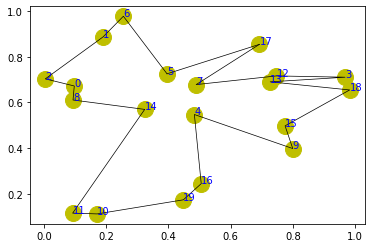

step:2055/5000, actic loss:-0.616, critic loss:0.626, L:4.954, 0min0sec
step:2056/5000, actic loss:-0.615, critic loss:0.626, L:4.954, 0min0sec
step:2057/5000, actic loss:-0.615, critic loss:0.626, L:4.954, 0min0sec
step:2058/5000, actic loss:-0.615, critic loss:0.626, L:4.953, 0min0sec
step:2059/5000, actic loss:-0.615, critic loss:0.625, L:4.953, 0min0sec
distance:4.247
tensor([ 7,  4, 16, 13,  5,  3,  0,  6, 19, 12, 11, 18,  9, 17, 15,  2, 10,  8,
         1, 14])


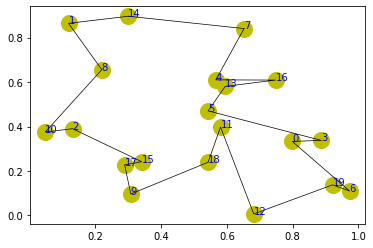

step:2060/5000, actic loss:-0.614, critic loss:0.625, L:4.953, 0min0sec
step:2061/5000, actic loss:-0.614, critic loss:0.625, L:4.952, 0min0sec
step:2062/5000, actic loss:-0.614, critic loss:0.625, L:4.952, 0min0sec
step:2063/5000, actic loss:-0.613, critic loss:0.625, L:4.952, 0min0sec
step:2064/5000, actic loss:-0.613, critic loss:0.624, L:4.951, 0min0sec
distance:4.210
tensor([16, 19,  1,  4, 14, 13, 15,  0,  3, 17, 11,  5,  6,  2,  7,  9, 18,  8,
        12, 10])


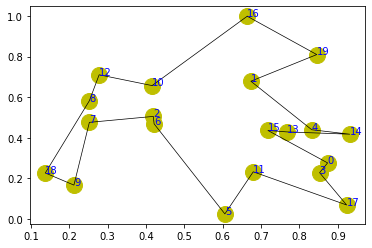

step:2065/5000, actic loss:-0.613, critic loss:0.624, L:4.951, 0min0sec
step:2066/5000, actic loss:-0.613, critic loss:0.624, L:4.951, 0min0sec
step:2067/5000, actic loss:-0.612, critic loss:0.624, L:4.950, 0min0sec
step:2068/5000, actic loss:-0.612, critic loss:0.623, L:4.950, 0min0sec
step:2069/5000, actic loss:-0.612, critic loss:0.623, L:4.950, 0min0sec
distance:4.187
tensor([11,  6,  3, 14,  0,  8, 16,  4,  2, 18, 10, 17,  1,  5,  7, 15, 13, 12,
         9, 19])


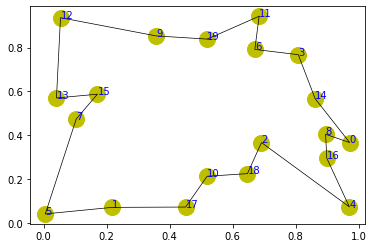

step:2070/5000, actic loss:-0.612, critic loss:0.623, L:4.949, 0min0sec
step:2071/5000, actic loss:-0.611, critic loss:0.623, L:4.949, 0min0sec
step:2072/5000, actic loss:-0.611, critic loss:0.623, L:4.949, 0min0sec
step:2073/5000, actic loss:-0.611, critic loss:0.622, L:4.949, 0min0sec
step:2074/5000, actic loss:-0.610, critic loss:0.622, L:4.948, 0min0sec
distance:3.642
tensor([11, 13, 16,  2,  4,  7, 18, 19, 10,  0,  1, 15,  8, 12, 14,  6,  5,  9,
         3, 17])


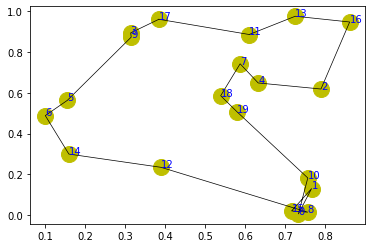

step:2075/5000, actic loss:-0.610, critic loss:0.622, L:4.948, 0min0sec
step:2076/5000, actic loss:-0.610, critic loss:0.622, L:4.948, 0min0sec
step:2077/5000, actic loss:-0.610, critic loss:0.621, L:4.947, 0min0sec
step:2078/5000, actic loss:-0.609, critic loss:0.621, L:4.947, 0min0sec
step:2079/5000, actic loss:-0.609, critic loss:0.621, L:4.947, 0min0sec
distance:4.362
tensor([14,  1,  8, 12, 17, 11, 16, 18,  5,  3,  2,  6, 19, 13,  0,  7,  9, 10,
        15,  4])


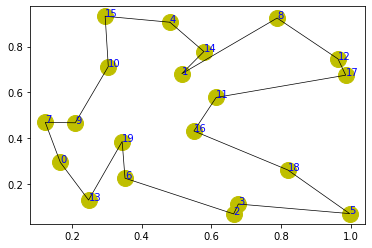

step:2080/5000, actic loss:-0.609, critic loss:0.621, L:4.946, 0min0sec
step:2081/5000, actic loss:-0.609, critic loss:0.620, L:4.946, 0min0sec
step:2082/5000, actic loss:-0.608, critic loss:0.620, L:4.946, 0min0sec
step:2083/5000, actic loss:-0.608, critic loss:0.620, L:4.946, 0min0sec
step:2084/5000, actic loss:-0.608, critic loss:0.620, L:4.945, 0min0sec
distance:4.738
tensor([11,  0, 10, 13, 18, 12,  4, 19,  7, 14,  6,  2,  5,  3,  8,  1, 17, 15,
        16,  9])


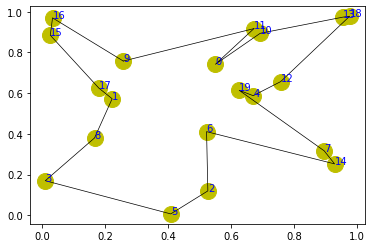

step:2085/5000, actic loss:-0.607, critic loss:0.620, L:4.945, 0min0sec
step:2086/5000, actic loss:-0.607, critic loss:0.619, L:4.945, 0min0sec
step:2087/5000, actic loss:-0.607, critic loss:0.619, L:4.944, 0min0sec
step:2088/5000, actic loss:-0.606, critic loss:0.619, L:4.944, 0min0sec
step:2089/5000, actic loss:-0.606, critic loss:0.619, L:4.944, 0min0sec
distance:3.940
tensor([ 2,  9,  7, 14, 17,  6,  0, 15,  1, 16,  8, 13,  3, 19, 12, 10,  4, 11,
        18,  5])


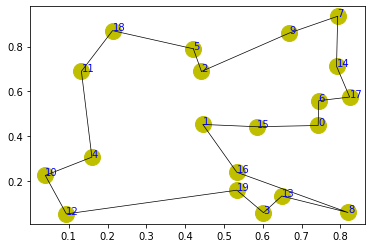

step:2090/5000, actic loss:-0.606, critic loss:0.619, L:4.943, 0min0sec
step:2091/5000, actic loss:-0.606, critic loss:0.618, L:4.943, 0min0sec
step:2092/5000, actic loss:-0.606, critic loss:0.618, L:4.943, 0min0sec
step:2093/5000, actic loss:-0.606, critic loss:0.618, L:4.943, 0min0sec
step:2094/5000, actic loss:-0.605, critic loss:0.618, L:4.942, 0min0sec
distance:3.155
tensor([10,  0,  3, 16, 17, 11, 12,  4,  2,  5, 19, 15,  9,  7,  1,  6, 18,  8,
        14, 13])


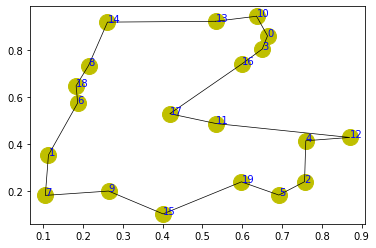

step:2095/5000, actic loss:-0.605, critic loss:0.618, L:4.942, 0min0sec
step:2096/5000, actic loss:-0.605, critic loss:0.617, L:4.942, 0min0sec
step:2097/5000, actic loss:-0.604, critic loss:0.617, L:4.941, 0min0sec
step:2098/5000, actic loss:-0.604, critic loss:0.617, L:4.941, 0min0sec
step:2099/5000, actic loss:-0.604, critic loss:0.617, L:4.941, 0min0sec
distance:3.950
tensor([10,  0, 15, 19, 14,  8,  4, 13, 17,  2, 18,  7, 11,  9,  5, 12,  6,  1,
         3, 16])


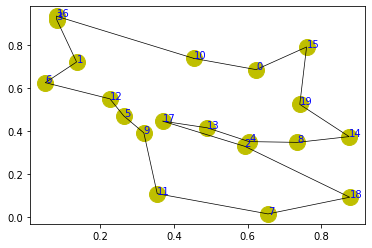

step:2100/5000, actic loss:-0.604, critic loss:0.616, L:4.941, 0min0sec
step:2101/5000, actic loss:-0.603, critic loss:0.616, L:4.940, 0min0sec
step:2102/5000, actic loss:-0.603, critic loss:0.616, L:4.940, 0min0sec
step:2103/5000, actic loss:-0.603, critic loss:0.616, L:4.940, 0min0sec
step:2104/5000, actic loss:-0.603, critic loss:0.615, L:4.940, 0min0sec
distance:4.307
tensor([14, 13,  5,  4, 10, 19,  9,  0, 11,  1,  8, 12, 15, 18, 16,  7,  3,  6,
        17,  2])


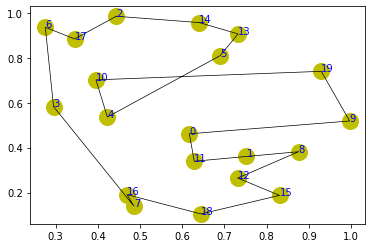

step:2105/5000, actic loss:-0.602, critic loss:0.615, L:4.939, 0min0sec
step:2106/5000, actic loss:-0.602, critic loss:0.615, L:4.939, 0min0sec
step:2107/5000, actic loss:-0.602, critic loss:0.615, L:4.939, 0min0sec
step:2108/5000, actic loss:-0.602, critic loss:0.615, L:4.939, 0min0sec
step:2109/5000, actic loss:-0.601, critic loss:0.614, L:4.938, 0min0sec
distance:5.330
tensor([ 4,  7,  9,  0, 16, 13,  6,  2, 15, 14, 17,  3, 19, 10, 18, 11,  1,  5,
         8, 12])


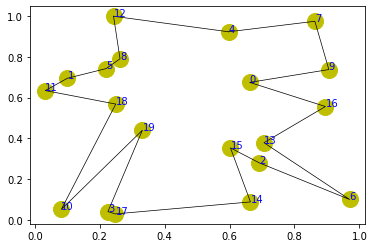

step:2110/5000, actic loss:-0.601, critic loss:0.614, L:4.938, 0min0sec
step:2111/5000, actic loss:-0.601, critic loss:0.614, L:4.938, 0min0sec
step:2112/5000, actic loss:-0.601, critic loss:0.614, L:4.938, 0min0sec
step:2113/5000, actic loss:-0.601, critic loss:0.614, L:4.937, 0min0sec
step:2114/5000, actic loss:-0.600, critic loss:0.614, L:4.937, 0min0sec
distance:4.003
tensor([ 1, 10,  9,  7, 13,  6, 19,  4, 15, 17, 11, 14, 12,  3,  0,  2,  5, 18,
        16,  8])


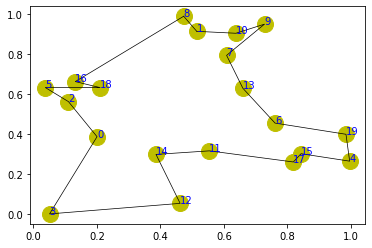

step:2115/5000, actic loss:-0.599, critic loss:0.613, L:4.937, 0min0sec
step:2116/5000, actic loss:-0.599, critic loss:0.613, L:4.937, 0min0sec
step:2117/5000, actic loss:-0.599, critic loss:0.613, L:4.936, 0min0sec
step:2118/5000, actic loss:-0.599, critic loss:0.613, L:4.936, 0min0sec
step:2119/5000, actic loss:-0.599, critic loss:0.613, L:4.936, 0min0sec
distance:4.270
tensor([14,  1, 11, 19,  4, 15, 10, 18,  0,  7,  2, 17,  6, 12,  5,  3, 16,  9,
        13,  8])


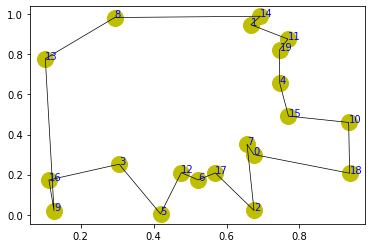

step:2120/5000, actic loss:-0.598, critic loss:0.612, L:4.936, 0min0sec
step:2121/5000, actic loss:-0.598, critic loss:0.612, L:4.935, 0min0sec
step:2122/5000, actic loss:-0.598, critic loss:0.612, L:4.935, 0min0sec
step:2123/5000, actic loss:-0.597, critic loss:0.612, L:4.935, 0min0sec
step:2124/5000, actic loss:-0.597, critic loss:0.611, L:4.935, 0min0sec
distance:4.224
tensor([ 9,  7,  4, 10, 15,  8, 19,  0, 17, 13,  5, 11,  6,  1, 14,  2, 12, 16,
         3, 18])


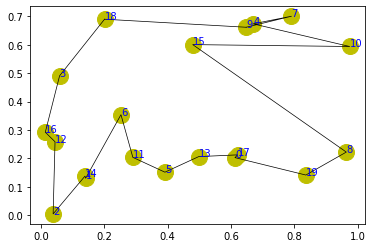

step:2125/5000, actic loss:-0.597, critic loss:0.611, L:4.934, 0min0sec
step:2126/5000, actic loss:-0.597, critic loss:0.611, L:4.934, 0min0sec
step:2127/5000, actic loss:-0.597, critic loss:0.611, L:4.934, 0min0sec
step:2128/5000, actic loss:-0.596, critic loss:0.611, L:4.934, 0min0sec
step:2129/5000, actic loss:-0.596, critic loss:0.610, L:4.933, 0min0sec
distance:3.733
tensor([ 2, 13, 10,  6,  1, 11, 14,  7,  9,  5, 17,  4, 18, 16,  8, 19, 15,  3,
         0, 12])


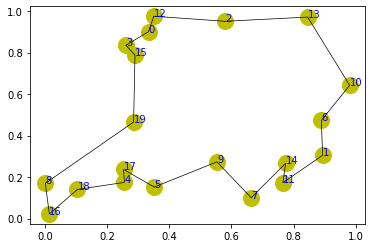

step:2130/5000, actic loss:-0.595, critic loss:0.610, L:4.933, 0min0sec
step:2131/5000, actic loss:-0.595, critic loss:0.610, L:4.933, 0min0sec
step:2132/5000, actic loss:-0.595, critic loss:0.610, L:4.932, 0min0sec
step:2133/5000, actic loss:-0.595, critic loss:0.610, L:4.932, 0min0sec
step:2134/5000, actic loss:-0.595, critic loss:0.609, L:4.932, 0min0sec
distance:4.658
tensor([ 7, 10, 19, 14,  6, 11, 16, 17,  5,  2,  9,  4,  8,  3,  1, 15, 13, 12,
        18,  0])


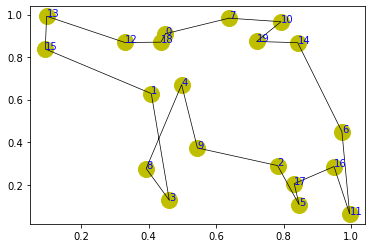

step:2135/5000, actic loss:-0.595, critic loss:0.609, L:4.932, 0min0sec
step:2136/5000, actic loss:-0.595, critic loss:0.609, L:4.931, 0min0sec
step:2137/5000, actic loss:-0.594, critic loss:0.609, L:4.931, 0min0sec
step:2138/5000, actic loss:-0.594, critic loss:0.609, L:4.931, 0min0sec
step:2139/5000, actic loss:-0.594, critic loss:0.608, L:4.931, 0min0sec
distance:4.502
tensor([ 9, 13,  6,  0, 15, 14,  5, 12,  3, 10, 17,  1, 18, 19,  4,  8,  7,  2,
        11, 16])


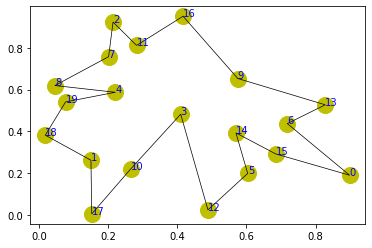

step:2140/5000, actic loss:-0.594, critic loss:0.608, L:4.930, 0min0sec
step:2141/5000, actic loss:-0.594, critic loss:0.608, L:4.930, 0min0sec
step:2142/5000, actic loss:-0.593, critic loss:0.608, L:4.930, 0min0sec
step:2143/5000, actic loss:-0.593, critic loss:0.608, L:4.930, 0min0sec
step:2144/5000, actic loss:-0.593, critic loss:0.607, L:4.929, 0min0sec
distance:4.824
tensor([19, 16,  9, 18,  0, 14, 10, 15,  3,  7,  6,  1, 17,  4,  5, 12,  2,  8,
        11, 13])


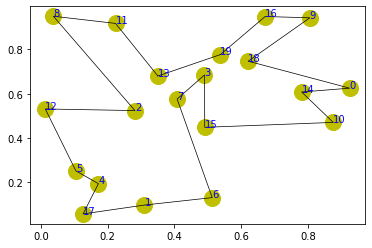

step:2145/5000, actic loss:-0.593, critic loss:0.607, L:4.929, 0min0sec
step:2146/5000, actic loss:-0.592, critic loss:0.607, L:4.929, 0min0sec
step:2147/5000, actic loss:-0.592, critic loss:0.607, L:4.928, 0min0sec
step:2148/5000, actic loss:-0.592, critic loss:0.607, L:4.928, 0min0sec
step:2149/5000, actic loss:-0.592, critic loss:0.606, L:4.928, 0min0sec
distance:4.232
tensor([19,  9,  5,  6,  2,  1, 10,  3, 16,  0,  7,  8, 15, 18, 13, 17, 11, 14,
        12,  4])


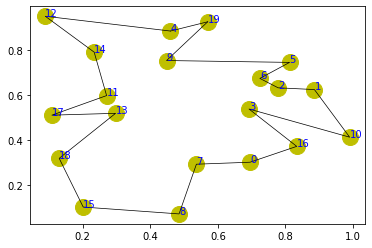

step:2150/5000, actic loss:-0.591, critic loss:0.606, L:4.928, 0min0sec
step:2151/5000, actic loss:-0.591, critic loss:0.606, L:4.927, 0min0sec
step:2152/5000, actic loss:-0.591, critic loss:0.606, L:4.927, 0min0sec
step:2153/5000, actic loss:-0.591, critic loss:0.605, L:4.927, 0min0sec
step:2154/5000, actic loss:-0.590, critic loss:0.605, L:4.927, 0min0sec
distance:4.442
tensor([ 7, 18,  0,  6, 10, 11,  9, 17,  1, 19, 13,  5, 15,  2,  4, 14, 16, 12,
         3,  8])


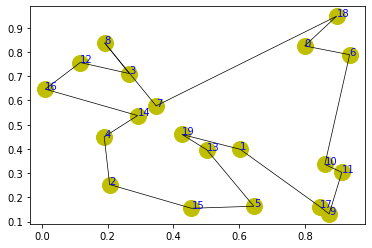

step:2155/5000, actic loss:-0.590, critic loss:0.605, L:4.926, 0min0sec
step:2156/5000, actic loss:-0.590, critic loss:0.605, L:4.926, 0min0sec
step:2157/5000, actic loss:-0.590, critic loss:0.605, L:4.926, 0min0sec
step:2158/5000, actic loss:-0.589, critic loss:0.604, L:4.925, 0min0sec
step:2159/5000, actic loss:-0.589, critic loss:0.604, L:4.925, 0min0sec
distance:4.154
tensor([19,  8,  7, 14, 13, 12, 18,  5, 17, 10,  1,  0,  4,  9,  3, 15,  2, 16,
        11,  6])


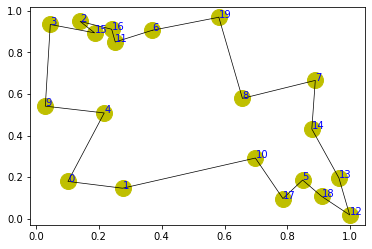

step:2160/5000, actic loss:-0.589, critic loss:0.604, L:4.925, 0min0sec
step:2161/5000, actic loss:-0.589, critic loss:0.604, L:4.925, 0min0sec
step:2162/5000, actic loss:-0.588, critic loss:0.604, L:4.924, 0min0sec
step:2163/5000, actic loss:-0.588, critic loss:0.603, L:4.924, 0min0sec
step:2164/5000, actic loss:-0.588, critic loss:0.603, L:4.924, 0min0sec
distance:4.252
tensor([ 0,  5,  1, 19, 16, 17,  6, 14,  7, 13,  8,  4,  9, 12, 18,  2, 11, 15,
        10,  3])


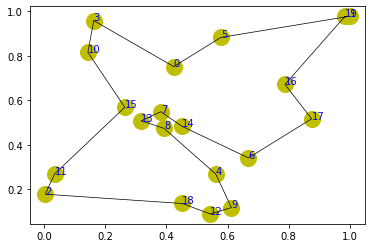

step:2165/5000, actic loss:-0.588, critic loss:0.603, L:4.924, 0min0sec
step:2166/5000, actic loss:-0.588, critic loss:0.603, L:4.923, 0min0sec
step:2167/5000, actic loss:-0.588, critic loss:0.603, L:4.923, 0min0sec
step:2168/5000, actic loss:-0.587, critic loss:0.602, L:4.923, 0min0sec
step:2169/5000, actic loss:-0.587, critic loss:0.602, L:4.923, 0min0sec
distance:4.120
tensor([ 4, 18,  2,  3, 19,  0,  6,  9,  1, 14, 12, 15, 17, 10, 16,  7,  5,  8,
        13, 11])


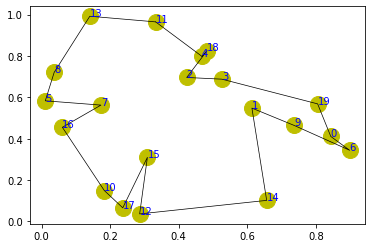

step:2170/5000, actic loss:-0.587, critic loss:0.602, L:4.923, 0min0sec
step:2171/5000, actic loss:-0.587, critic loss:0.602, L:4.922, 0min0sec
step:2172/5000, actic loss:-0.587, critic loss:0.601, L:4.922, 0min0sec
step:2173/5000, actic loss:-0.586, critic loss:0.601, L:4.922, 0min0sec
step:2174/5000, actic loss:-0.586, critic loss:0.601, L:4.922, 0min0sec
distance:5.343
tensor([16, 19,  8,  1,  4, 11,  9,  2, 18,  7,  5,  3, 12, 14, 15,  6,  0, 10,
        13, 17])


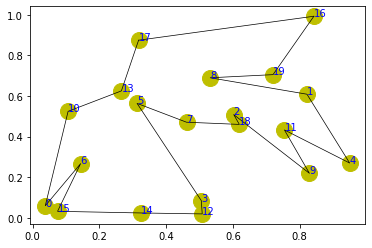

step:2175/5000, actic loss:-0.587, critic loss:0.601, L:4.921, 0min0sec
step:2176/5000, actic loss:-0.587, critic loss:0.601, L:4.921, 0min0sec
step:2177/5000, actic loss:-0.586, critic loss:0.601, L:4.921, 0min0sec
step:2178/5000, actic loss:-0.586, critic loss:0.600, L:4.921, 0min0sec
step:2179/5000, actic loss:-0.586, critic loss:0.600, L:4.920, 0min0sec
distance:4.036
tensor([19,  6,  3,  2, 11,  0, 16, 14,  9, 18,  1,  7, 15, 10, 12,  5,  8, 13,
         4, 17])


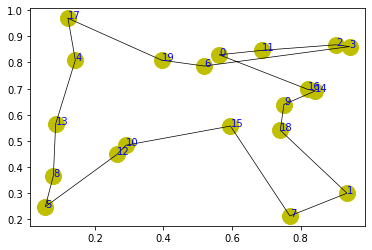

step:2180/5000, actic loss:-0.585, critic loss:0.600, L:4.920, 0min0sec
step:2181/5000, actic loss:-0.585, critic loss:0.600, L:4.920, 0min0sec
step:2182/5000, actic loss:-0.585, critic loss:0.600, L:4.920, 0min0sec
step:2183/5000, actic loss:-0.585, critic loss:0.599, L:4.920, 0min0sec
step:2184/5000, actic loss:-0.584, critic loss:0.599, L:4.919, 0min0sec
distance:4.807
tensor([ 8,  3, 19,  6,  9, 16, 15, 12,  7, 17,  0,  1, 18, 13, 11, 10,  5, 14,
         4,  2])


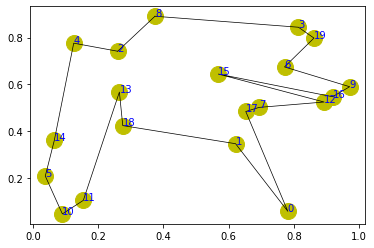

step:2185/5000, actic loss:-0.584, critic loss:0.599, L:4.919, 0min0sec
step:2186/5000, actic loss:-0.584, critic loss:0.599, L:4.919, 0min0sec
step:2187/5000, actic loss:-0.584, critic loss:0.599, L:4.919, 0min0sec
step:2188/5000, actic loss:-0.584, critic loss:0.598, L:4.919, 0min0sec
step:2189/5000, actic loss:-0.584, critic loss:0.598, L:4.918, 0min0sec
distance:4.899
tensor([19, 12,  6, 18,  0,  9, 11, 16, 14, 13,  8, 15,  4,  7,  5, 10,  2,  3,
        17,  1])


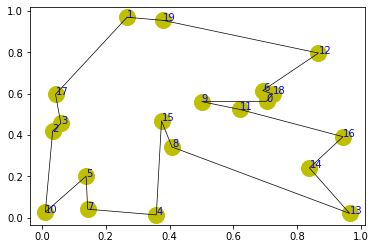

step:2190/5000, actic loss:-0.584, critic loss:0.598, L:4.918, 0min0sec
step:2191/5000, actic loss:-0.583, critic loss:0.598, L:4.918, 0min0sec
step:2192/5000, actic loss:-0.583, critic loss:0.598, L:4.918, 0min0sec
step:2193/5000, actic loss:-0.583, critic loss:0.597, L:4.917, 0min0sec
step:2194/5000, actic loss:-0.583, critic loss:0.597, L:4.917, 0min0sec
distance:4.441
tensor([13, 19,  5, 10, 12, 16,  8,  1,  9,  7,  3, 11,  4,  2, 15,  6, 17, 14,
         0, 18])


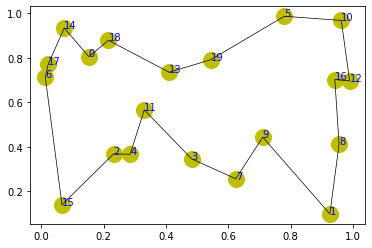

step:2195/5000, actic loss:-0.582, critic loss:0.597, L:4.917, 0min0sec
step:2196/5000, actic loss:-0.582, critic loss:0.597, L:4.917, 0min0sec
step:2197/5000, actic loss:-0.582, critic loss:0.597, L:4.916, 0min0sec
step:2198/5000, actic loss:-0.582, critic loss:0.596, L:4.916, 0min0sec
step:2199/5000, actic loss:-0.582, critic loss:0.596, L:4.916, 0min0sec
distance:4.422
tensor([13, 14,  6, 18,  7,  4, 19, 11,  0, 15,  8,  9,  5,  1, 10, 16,  2, 17,
        12,  3])


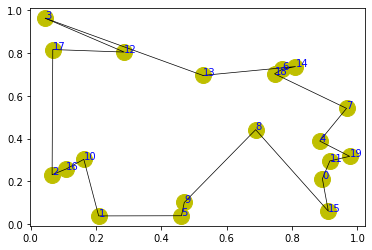

step:2200/5000, actic loss:-0.581, critic loss:0.596, L:4.916, 0min0sec
step:2201/5000, actic loss:-0.581, critic loss:0.596, L:4.915, 0min0sec
step:2202/5000, actic loss:-0.581, critic loss:0.596, L:4.915, 0min0sec
step:2203/5000, actic loss:-0.581, critic loss:0.595, L:4.915, 0min0sec
step:2204/5000, actic loss:-0.580, critic loss:0.595, L:4.915, 0min0sec
distance:4.754
tensor([ 5, 16,  7, 17, 13,  1,  9,  3,  6,  0, 19,  8, 14, 12, 10, 18,  4, 15,
         2, 11])


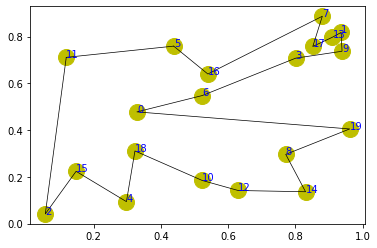

step:2205/5000, actic loss:-0.580, critic loss:0.595, L:4.915, 0min0sec
step:2206/5000, actic loss:-0.580, critic loss:0.595, L:4.914, 0min0sec
step:2207/5000, actic loss:-0.579, critic loss:0.595, L:4.914, 0min0sec
step:2208/5000, actic loss:-0.579, critic loss:0.595, L:4.914, 0min0sec
step:2209/5000, actic loss:-0.579, critic loss:0.594, L:4.914, 0min0sec
distance:4.455
tensor([ 3, 11,  2,  0, 17, 13, 18,  1, 16,  4,  6, 10,  8, 14, 15,  9,  7, 12,
         5, 19])


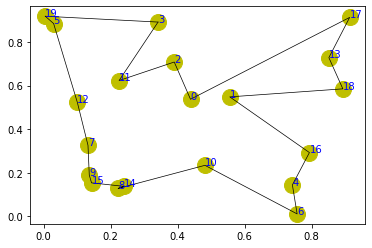

step:2210/5000, actic loss:-0.579, critic loss:0.594, L:4.914, 0min0sec
step:2211/5000, actic loss:-0.579, critic loss:0.594, L:4.914, 0min0sec
step:2212/5000, actic loss:-0.579, critic loss:0.594, L:4.913, 0min0sec
step:2213/5000, actic loss:-0.579, critic loss:0.594, L:4.913, 0min0sec
step:2214/5000, actic loss:-0.578, critic loss:0.594, L:4.913, 0min0sec
distance:3.887
tensor([ 7,  5,  3, 15,  9, 19,  6, 10, 17, 14,  8, 18,  1,  2,  4, 16, 13, 11,
        12,  0])


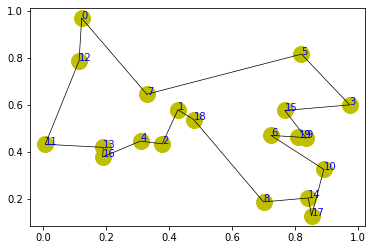

step:2215/5000, actic loss:-0.578, critic loss:0.593, L:4.913, 0min0sec
step:2216/5000, actic loss:-0.578, critic loss:0.593, L:4.912, 0min0sec
step:2217/5000, actic loss:-0.578, critic loss:0.593, L:4.912, 0min0sec
step:2218/5000, actic loss:-0.577, critic loss:0.593, L:4.912, 0min0sec
step:2219/5000, actic loss:-0.577, critic loss:0.593, L:4.912, 0min0sec
distance:4.550
tensor([14, 13, 12,  5, 19,  3,  1,  9, 16,  4,  2, 10, 17,  0,  6, 15,  8,  7,
        18, 11])


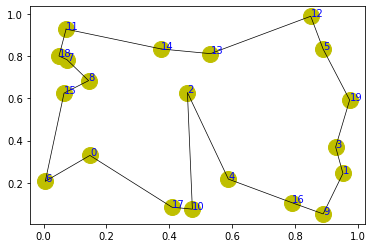

step:2220/5000, actic loss:-0.577, critic loss:0.592, L:4.912, 0min0sec
step:2221/5000, actic loss:-0.577, critic loss:0.592, L:4.911, 0min0sec
step:2222/5000, actic loss:-0.577, critic loss:0.592, L:4.911, 0min0sec
step:2223/5000, actic loss:-0.576, critic loss:0.592, L:4.911, 0min0sec
step:2224/5000, actic loss:-0.576, critic loss:0.592, L:4.911, 0min0sec
distance:3.763
tensor([ 2, 15,  3,  8,  6, 14, 11,  7, 17,  9, 19,  1,  0, 10,  5, 12, 18, 16,
        13,  4])


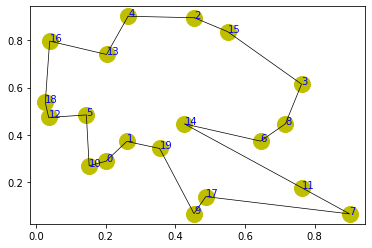

step:2225/5000, actic loss:-0.576, critic loss:0.591, L:4.911, 0min0sec
step:2226/5000, actic loss:-0.576, critic loss:0.591, L:4.910, 0min0sec
step:2227/5000, actic loss:-0.576, critic loss:0.591, L:4.910, 0min0sec
step:2228/5000, actic loss:-0.576, critic loss:0.591, L:4.910, 0min0sec
step:2229/5000, actic loss:-0.576, critic loss:0.591, L:4.910, 0min0sec
distance:4.096
tensor([ 6,  2, 11, 18, 15,  4,  0, 12, 17,  9, 10,  3,  7, 16, 19,  5, 14,  8,
        13,  1])


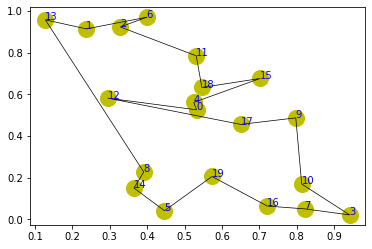

step:2230/5000, actic loss:-0.575, critic loss:0.590, L:4.909, 0min0sec
step:2231/5000, actic loss:-0.575, critic loss:0.590, L:4.909, 0min0sec
step:2232/5000, actic loss:-0.575, critic loss:0.590, L:4.909, 0min0sec
step:2233/5000, actic loss:-0.575, critic loss:0.590, L:4.908, 0min0sec
step:2234/5000, actic loss:-0.575, critic loss:0.590, L:4.908, 0min0sec
distance:4.223
tensor([ 0, 12,  4, 18,  8,  7,  2,  9, 13, 17, 15,  3, 19,  1, 16,  5, 11,  6,
        10, 14])


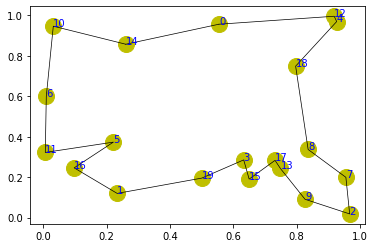

step:2235/5000, actic loss:-0.574, critic loss:0.589, L:4.908, 0min0sec
step:2236/5000, actic loss:-0.574, critic loss:0.589, L:4.908, 0min0sec
step:2237/5000, actic loss:-0.574, critic loss:0.589, L:4.907, 0min0sec
step:2238/5000, actic loss:-0.574, critic loss:0.589, L:4.907, 0min0sec
step:2239/5000, actic loss:-0.574, critic loss:0.589, L:4.907, 0min0sec
distance:4.359
tensor([12, 15,  1, 17,  3,  5,  4, 19, 11,  6,  2,  9,  8, 13, 18,  0,  7, 10,
        14, 16])


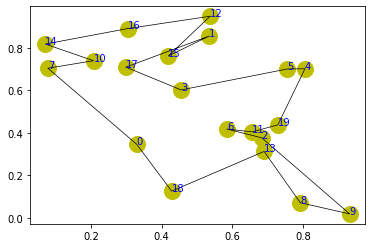

step:2240/5000, actic loss:-0.574, critic loss:0.589, L:4.907, 0min0sec
step:2241/5000, actic loss:-0.574, critic loss:0.588, L:4.906, 0min0sec
step:2242/5000, actic loss:-0.574, critic loss:0.588, L:4.906, 0min0sec
step:2243/5000, actic loss:-0.573, critic loss:0.588, L:4.906, 0min0sec
step:2244/5000, actic loss:-0.573, critic loss:0.588, L:4.906, 0min0sec
distance:3.651
tensor([16,  3,  4, 14, 10, 11,  9,  0,  6,  5, 18, 13, 15,  1,  7,  2, 19, 12,
         8, 17])


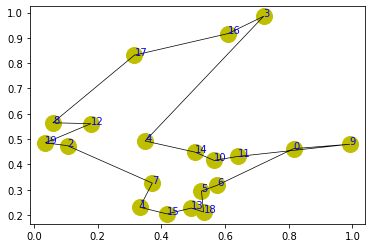

step:2245/5000, actic loss:-0.573, critic loss:0.588, L:4.905, 0min0sec
step:2246/5000, actic loss:-0.572, critic loss:0.588, L:4.905, 0min0sec
step:2247/5000, actic loss:-0.572, critic loss:0.587, L:4.905, 0min0sec
step:2248/5000, actic loss:-0.572, critic loss:0.587, L:4.905, 0min0sec
step:2249/5000, actic loss:-0.572, critic loss:0.587, L:4.904, 0min0sec
distance:4.603
tensor([10, 18, 12,  5, 11, 15,  7, 17, 13,  9,  2,  4,  8, 14,  3, 19,  1,  6,
        16,  0])


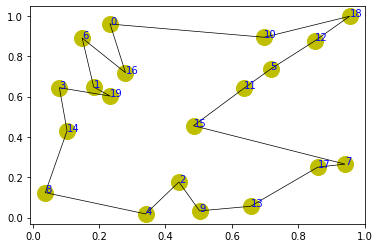

step:2250/5000, actic loss:-0.572, critic loss:0.587, L:4.904, 0min0sec
step:2251/5000, actic loss:-0.571, critic loss:0.587, L:4.904, 0min0sec
step:2252/5000, actic loss:-0.571, critic loss:0.586, L:4.904, 0min0sec
step:2253/5000, actic loss:-0.571, critic loss:0.586, L:4.903, 0min0sec
step:2254/5000, actic loss:-0.571, critic loss:0.586, L:4.903, 0min1sec
distance:4.976
tensor([ 6,  7,  3,  0, 19,  8, 16,  9,  1, 10, 17,  5,  4,  2, 15, 14, 13, 12,
        18, 11])


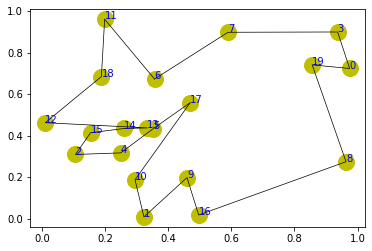

step:2255/5000, actic loss:-0.571, critic loss:0.586, L:4.903, 0min1sec
step:2256/5000, actic loss:-0.570, critic loss:0.586, L:4.903, 0min0sec
step:2257/5000, actic loss:-0.570, critic loss:0.586, L:4.903, 0min0sec
step:2258/5000, actic loss:-0.570, critic loss:0.585, L:4.902, 0min0sec
step:2259/5000, actic loss:-0.570, critic loss:0.585, L:4.902, 0min0sec
distance:5.120
tensor([ 4, 14,  8, 15,  1,  7, 18,  2,  3,  5, 12,  9, 17, 13, 16, 19,  0,  6,
        11, 10])


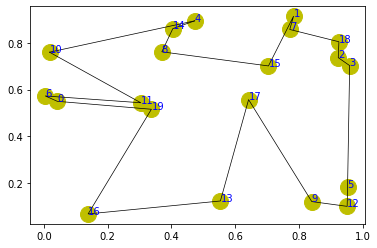

step:2260/5000, actic loss:-0.570, critic loss:0.585, L:4.902, 0min0sec
step:2261/5000, actic loss:-0.569, critic loss:0.585, L:4.902, 0min0sec
step:2262/5000, actic loss:-0.569, critic loss:0.585, L:4.901, 0min0sec
step:2263/5000, actic loss:-0.569, critic loss:0.584, L:4.901, 0min0sec
step:2264/5000, actic loss:-0.569, critic loss:0.584, L:4.901, 0min0sec
distance:4.215
tensor([13, 14, 17,  0, 11, 15, 16,  6,  9,  5, 19,  3, 10,  1,  4,  2,  7,  8,
        18, 12])


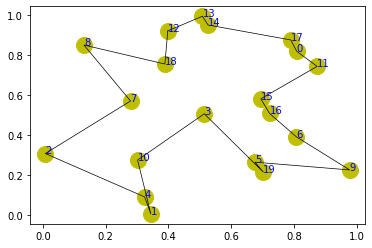

step:2265/5000, actic loss:-0.568, critic loss:0.584, L:4.901, 0min0sec
step:2266/5000, actic loss:-0.568, critic loss:0.584, L:4.900, 0min0sec
step:2267/5000, actic loss:-0.568, critic loss:0.584, L:4.900, 0min0sec
step:2268/5000, actic loss:-0.568, critic loss:0.583, L:4.900, 0min0sec
step:2269/5000, actic loss:-0.568, critic loss:0.583, L:4.899, 0min0sec
distance:4.130
tensor([ 5, 16,  0,  7, 14, 11, 10,  8, 17,  9,  2, 19,  1,  3, 18, 12,  4, 15,
        13,  6])


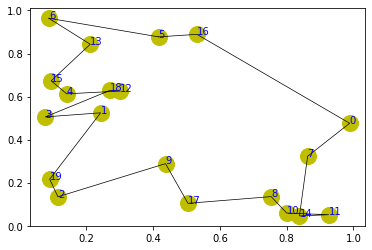

step:2270/5000, actic loss:-0.568, critic loss:0.583, L:4.899, 0min0sec
step:2271/5000, actic loss:-0.567, critic loss:0.583, L:4.899, 0min0sec
step:2272/5000, actic loss:-0.567, critic loss:0.583, L:4.899, 0min0sec
step:2273/5000, actic loss:-0.566, critic loss:0.582, L:4.898, 0min0sec
step:2274/5000, actic loss:-0.566, critic loss:0.582, L:4.898, 0min0sec
distance:4.767
tensor([ 8,  5, 15,  2,  3, 13,  0, 16, 19,  1, 11, 10,  9, 17, 12, 18, 14,  6,
         7,  4])


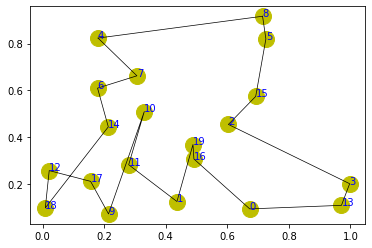

step:2275/5000, actic loss:-0.566, critic loss:0.582, L:4.898, 0min0sec
step:2276/5000, actic loss:-0.566, critic loss:0.582, L:4.898, 0min0sec
step:2277/5000, actic loss:-0.566, critic loss:0.582, L:4.897, 0min0sec
step:2278/5000, actic loss:-0.566, critic loss:0.581, L:4.897, 0min0sec
step:2279/5000, actic loss:-0.565, critic loss:0.581, L:4.897, 0min0sec
distance:4.207
tensor([12,  5,  3, 11, 14,  9, 15, 19, 10, 18,  1, 13,  6,  7, 16,  0,  4,  2,
         8, 17])


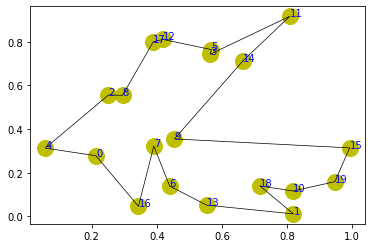

step:2280/5000, actic loss:-0.565, critic loss:0.581, L:4.897, 0min0sec
step:2281/5000, actic loss:-0.565, critic loss:0.581, L:4.896, 0min0sec
step:2282/5000, actic loss:-0.564, critic loss:0.581, L:4.896, 0min0sec
step:2283/5000, actic loss:-0.564, critic loss:0.581, L:4.896, 0min0sec
step:2284/5000, actic loss:-0.564, critic loss:0.580, L:4.896, 0min0sec
distance:4.649
tensor([12, 17, 11, 19,  6,  9, 13,  0,  8, 15,  4, 10,  5,  7,  3, 14, 18,  1,
        16,  2])


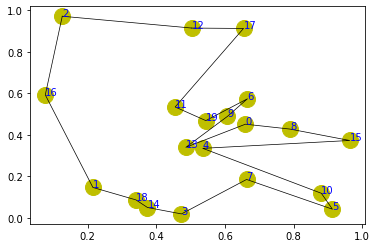

step:2285/5000, actic loss:-0.564, critic loss:0.580, L:4.895, 0min0sec
step:2286/5000, actic loss:-0.564, critic loss:0.580, L:4.895, 0min0sec
step:2287/5000, actic loss:-0.563, critic loss:0.580, L:4.895, 0min0sec
step:2288/5000, actic loss:-0.563, critic loss:0.580, L:4.895, 0min0sec
step:2289/5000, actic loss:-0.562, critic loss:0.580, L:4.894, 0min0sec
distance:5.129
tensor([12, 18,  1,  5, 17,  9,  6,  7, 11,  2,  3,  8,  4, 10,  0, 13, 16, 19,
        14, 15])


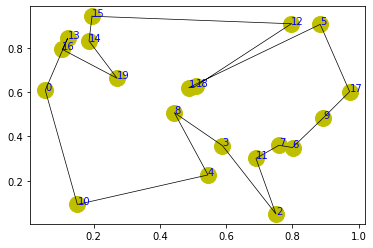

step:2290/5000, actic loss:-0.562, critic loss:0.579, L:4.894, 0min0sec
step:2291/5000, actic loss:-0.562, critic loss:0.579, L:4.894, 0min0sec
step:2292/5000, actic loss:-0.562, critic loss:0.579, L:4.894, 0min0sec
step:2293/5000, actic loss:-0.562, critic loss:0.579, L:4.893, 0min0sec
step:2294/5000, actic loss:-0.562, critic loss:0.579, L:4.893, 0min0sec
distance:4.188
tensor([ 4,  1,  2, 14, 17, 15, 12, 18, 11,  9, 16, 10,  0, 19,  3,  7,  8, 13,
         6,  5])


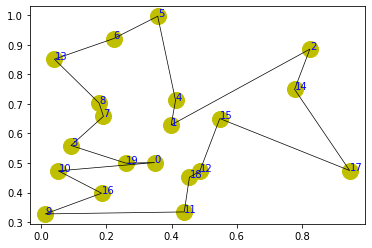

step:2295/5000, actic loss:-0.563, critic loss:0.579, L:4.893, 0min0sec
step:2296/5000, actic loss:-0.562, critic loss:0.578, L:4.893, 0min0sec
step:2297/5000, actic loss:-0.562, critic loss:0.578, L:4.893, 0min0sec
step:2298/5000, actic loss:-0.561, critic loss:0.578, L:4.892, 0min0sec
step:2299/5000, actic loss:-0.560, critic loss:0.578, L:4.892, 0min0sec
distance:5.030
tensor([18, 14, 17, 15, 12,  1,  5, 16,  3,  8, 11, 10,  9,  7, 19,  4, 13,  2,
         0,  6])


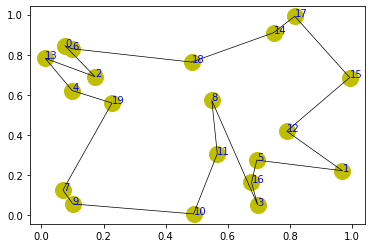

step:2300/5000, actic loss:-0.560, critic loss:0.578, L:4.892, 0min0sec
step:2301/5000, actic loss:-0.559, critic loss:0.578, L:4.892, 0min0sec
step:2302/5000, actic loss:-0.559, critic loss:0.578, L:4.892, 0min0sec
step:2303/5000, actic loss:-0.559, critic loss:0.578, L:4.891, 0min0sec
step:2304/5000, actic loss:-0.559, critic loss:0.577, L:4.891, 0min0sec
distance:4.503
tensor([ 2, 19,  5,  6, 11, 13, 17,  0,  7, 14,  9, 15,  4, 16, 18,  3, 12,  1,
         8, 10])


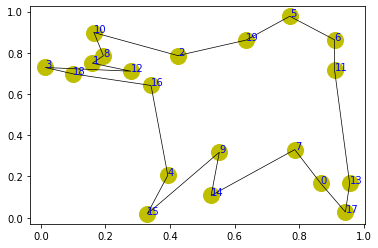

step:2305/5000, actic loss:-0.559, critic loss:0.577, L:4.891, 0min0sec
step:2306/5000, actic loss:-0.558, critic loss:0.577, L:4.891, 0min0sec
step:2307/5000, actic loss:-0.558, critic loss:0.577, L:4.891, 0min0sec
step:2308/5000, actic loss:-0.558, critic loss:0.577, L:4.890, 0min0sec
step:2309/5000, actic loss:-0.558, critic loss:0.576, L:4.890, 0min0sec
distance:5.140
tensor([ 9,  1,  8, 19, 17,  7, 10, 15,  2, 12,  4, 14, 11, 13, 18, 16,  6,  3,
         0,  5])


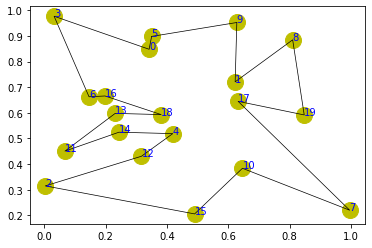

step:2310/5000, actic loss:-0.557, critic loss:0.576, L:4.890, 0min0sec
step:2311/5000, actic loss:-0.557, critic loss:0.576, L:4.890, 0min0sec
step:2312/5000, actic loss:-0.557, critic loss:0.576, L:4.889, 0min0sec
step:2313/5000, actic loss:-0.557, critic loss:0.576, L:4.889, 0min0sec
step:2314/5000, actic loss:-0.556, critic loss:0.576, L:4.889, 0min0sec
distance:4.241
tensor([16, 13,  3,  9, 14,  4,  6, 15, 18, 12,  0, 19,  7,  1,  8, 17,  2, 11,
         5, 10])


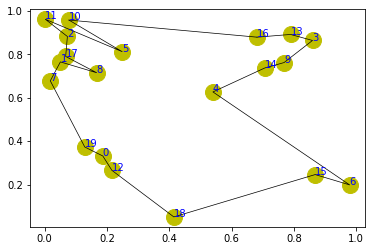

step:2315/5000, actic loss:-0.556, critic loss:0.575, L:4.889, 0min0sec
step:2316/5000, actic loss:-0.556, critic loss:0.575, L:4.888, 0min0sec
step:2317/5000, actic loss:-0.556, critic loss:0.575, L:4.888, 0min0sec
step:2318/5000, actic loss:-0.556, critic loss:0.575, L:4.888, 0min0sec
step:2319/5000, actic loss:-0.555, critic loss:0.575, L:4.888, 0min0sec
distance:4.598
tensor([ 0,  7, 13, 10, 12, 19, 14,  4, 17, 18,  8,  6,  5,  2,  3,  1, 15, 11,
        16,  9])


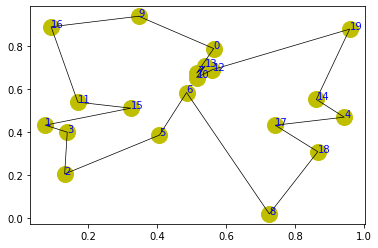

step:2320/5000, actic loss:-0.555, critic loss:0.574, L:4.887, 0min0sec
step:2321/5000, actic loss:-0.555, critic loss:0.574, L:4.887, 0min0sec
step:2322/5000, actic loss:-0.555, critic loss:0.574, L:4.887, 0min0sec
step:2323/5000, actic loss:-0.554, critic loss:0.574, L:4.887, 0min0sec
step:2324/5000, actic loss:-0.555, critic loss:0.574, L:4.886, 0min0sec
distance:4.434
tensor([ 0,  6,  1,  2,  8, 13, 18,  3, 19, 10,  5, 12, 14,  4, 11, 15, 17, 16,
         9,  7])


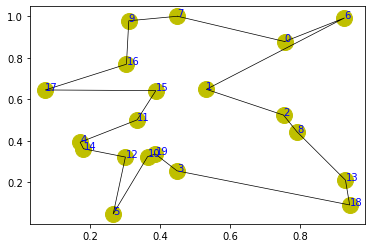

step:2325/5000, actic loss:-0.554, critic loss:0.574, L:4.886, 0min0sec
step:2326/5000, actic loss:-0.554, critic loss:0.573, L:4.886, 0min0sec
step:2327/5000, actic loss:-0.554, critic loss:0.573, L:4.886, 0min0sec
step:2328/5000, actic loss:-0.553, critic loss:0.573, L:4.886, 0min0sec
step:2329/5000, actic loss:-0.553, critic loss:0.573, L:4.886, 0min0sec
distance:4.353
tensor([ 3,  8, 15,  4, 16, 18, 17,  7,  2, 14,  6,  5,  9,  0, 10,  1, 12, 13,
        19, 11])


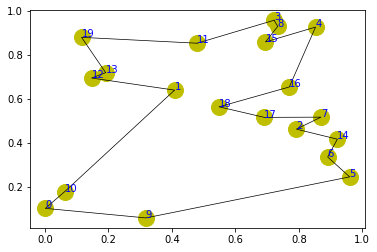

step:2330/5000, actic loss:-0.553, critic loss:0.573, L:4.885, 0min0sec
step:2331/5000, actic loss:-0.553, critic loss:0.573, L:4.885, 0min0sec
step:2332/5000, actic loss:-0.553, critic loss:0.572, L:4.885, 0min0sec
step:2333/5000, actic loss:-0.553, critic loss:0.572, L:4.885, 0min0sec
step:2334/5000, actic loss:-0.552, critic loss:0.572, L:4.884, 0min0sec
distance:4.598
tensor([ 0,  5,  6,  4, 10, 13,  2,  9,  1, 17,  8, 15, 18,  7, 14, 19, 11, 12,
         3, 16])


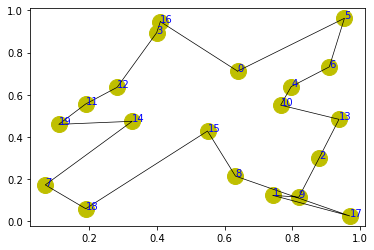

step:2335/5000, actic loss:-0.552, critic loss:0.572, L:4.884, 0min1sec
step:2336/5000, actic loss:-0.551, critic loss:0.572, L:4.884, 0min0sec
step:2337/5000, actic loss:-0.551, critic loss:0.571, L:4.884, 0min0sec
step:2338/5000, actic loss:-0.551, critic loss:0.571, L:4.883, 0min0sec
step:2339/5000, actic loss:-0.551, critic loss:0.571, L:4.883, 0min0sec
distance:3.557
tensor([ 4, 13,  5,  7, 12, 19,  1,  2, 11,  0, 18, 16,  6,  3, 15, 14,  8, 10,
        17,  9])


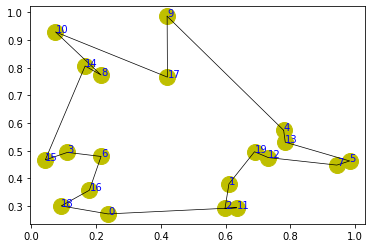

step:2340/5000, actic loss:-0.551, critic loss:0.571, L:4.883, 0min0sec
step:2341/5000, actic loss:-0.551, critic loss:0.571, L:4.883, 0min0sec
step:2342/5000, actic loss:-0.551, critic loss:0.571, L:4.883, 0min0sec
step:2343/5000, actic loss:-0.550, critic loss:0.570, L:4.882, 0min0sec
step:2344/5000, actic loss:-0.550, critic loss:0.570, L:4.882, 0min0sec
distance:3.900
tensor([ 3,  4, 18, 10, 15,  5, 12, 19, 14,  1, 11,  2, 16, 17,  9,  0,  8,  6,
         7, 13])


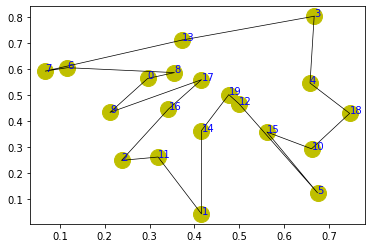

step:2345/5000, actic loss:-0.550, critic loss:0.570, L:4.882, 0min0sec
step:2346/5000, actic loss:-0.549, critic loss:0.570, L:4.882, 0min0sec
step:2347/5000, actic loss:-0.549, critic loss:0.570, L:4.881, 0min0sec
step:2348/5000, actic loss:-0.549, critic loss:0.570, L:4.881, 0min0sec
step:2349/5000, actic loss:-0.549, critic loss:0.569, L:4.881, 0min0sec
distance:4.386
tensor([ 3, 13, 17,  0, 11,  7, 19,  4,  2,  1, 18, 16,  8, 15, 12, 14,  9, 10,
         6,  5])


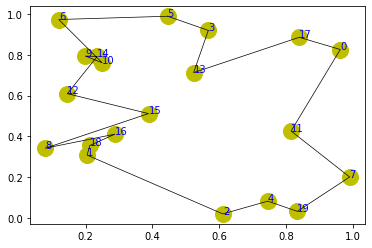

step:2350/5000, actic loss:-0.549, critic loss:0.569, L:4.881, 0min0sec
step:2351/5000, actic loss:-0.548, critic loss:0.569, L:4.880, 0min0sec
step:2352/5000, actic loss:-0.548, critic loss:0.569, L:4.880, 0min0sec
step:2353/5000, actic loss:-0.548, critic loss:0.569, L:4.880, 0min0sec
step:2354/5000, actic loss:-0.548, critic loss:0.568, L:4.880, 0min0sec
distance:4.090
tensor([17,  3,  2,  5,  0, 12,  9,  7, 13,  8, 11, 14,  6, 15, 16, 10, 18, 19,
         4,  1])


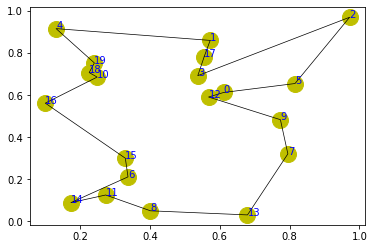

step:2355/5000, actic loss:-0.548, critic loss:0.568, L:4.879, 0min0sec
step:2356/5000, actic loss:-0.548, critic loss:0.568, L:4.879, 0min0sec
step:2357/5000, actic loss:-0.548, critic loss:0.568, L:4.879, 0min0sec
step:2358/5000, actic loss:-0.547, critic loss:0.568, L:4.879, 0min0sec
step:2359/5000, actic loss:-0.547, critic loss:0.568, L:4.878, 0min0sec
distance:4.413
tensor([14,  3, 10, 19, 16,  5, 11,  7,  0, 18,  9,  6,  4,  1, 13, 15, 17,  8,
         2, 12])


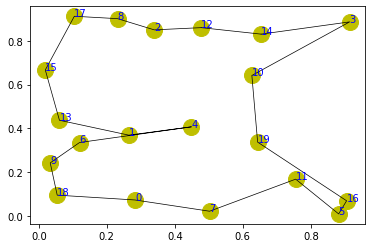

step:2360/5000, actic loss:-0.547, critic loss:0.567, L:4.878, 0min0sec
step:2361/5000, actic loss:-0.546, critic loss:0.567, L:4.878, 0min0sec
step:2362/5000, actic loss:-0.546, critic loss:0.567, L:4.878, 0min0sec
step:2363/5000, actic loss:-0.546, critic loss:0.567, L:4.877, 0min0sec
step:2364/5000, actic loss:-0.546, critic loss:0.567, L:4.877, 0min0sec
distance:4.366
tensor([ 9, 16,  8,  4, 13, 18, 11,  2,  3, 15, 17,  7,  1, 14,  0, 19,  5, 12,
         6, 10])


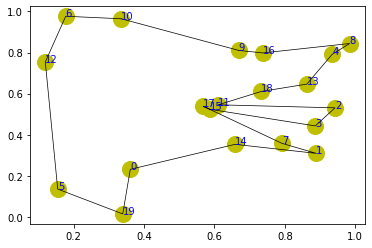

step:2365/5000, actic loss:-0.546, critic loss:0.567, L:4.877, 0min0sec
step:2366/5000, actic loss:-0.545, critic loss:0.566, L:4.877, 0min0sec
step:2367/5000, actic loss:-0.545, critic loss:0.566, L:4.876, 0min0sec
step:2368/5000, actic loss:-0.545, critic loss:0.566, L:4.876, 0min0sec
step:2369/5000, actic loss:-0.545, critic loss:0.566, L:4.876, 0min0sec
distance:4.652
tensor([ 9,  7,  6, 19, 16,  0,  8, 13, 12,  4, 15,  2,  1, 18,  5, 14,  3, 17,
        11, 10])


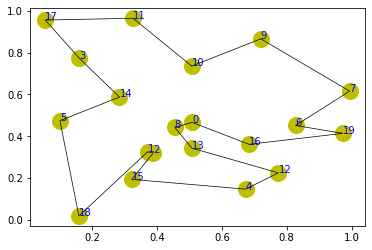

step:2370/5000, actic loss:-0.544, critic loss:0.566, L:4.876, 0min0sec
step:2371/5000, actic loss:-0.544, critic loss:0.566, L:4.876, 0min0sec
step:2372/5000, actic loss:-0.544, critic loss:0.565, L:4.875, 0min0sec
step:2373/5000, actic loss:-0.544, critic loss:0.565, L:4.875, 0min0sec
step:2374/5000, actic loss:-0.544, critic loss:0.565, L:4.875, 0min0sec
distance:3.572
tensor([ 4, 12,  5, 10,  7, 13,  2, 18,  9,  3,  1, 15, 17,  6,  8, 19, 16,  0,
        11, 14])


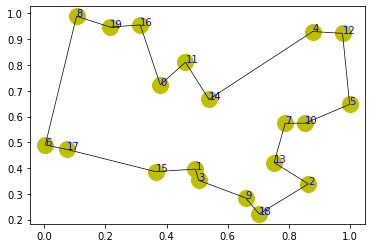

step:2375/5000, actic loss:-0.544, critic loss:0.565, L:4.875, 0min0sec
step:2376/5000, actic loss:-0.543, critic loss:0.565, L:4.874, 0min0sec
step:2377/5000, actic loss:-0.543, critic loss:0.564, L:4.874, 0min0sec
step:2378/5000, actic loss:-0.543, critic loss:0.564, L:4.874, 0min0sec
step:2379/5000, actic loss:-0.543, critic loss:0.564, L:4.874, 0min0sec
distance:3.348
tensor([10,  2,  5,  8,  3, 19, 18, 14,  0, 15,  6,  9,  7, 12, 13,  4,  1, 11,
        17, 16])


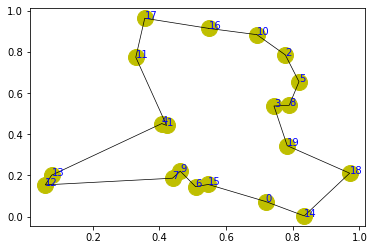

step:2380/5000, actic loss:-0.543, critic loss:0.564, L:4.873, 0min0sec
step:2381/5000, actic loss:-0.542, critic loss:0.564, L:4.873, 0min0sec
step:2382/5000, actic loss:-0.542, critic loss:0.564, L:4.873, 0min0sec
step:2383/5000, actic loss:-0.542, critic loss:0.563, L:4.873, 0min0sec
step:2384/5000, actic loss:-0.542, critic loss:0.563, L:4.872, 0min0sec
distance:4.402
tensor([12, 19,  0, 11,  2,  8,  6,  1, 15, 14,  9, 17, 13, 18,  5,  4, 10,  3,
         7, 16])


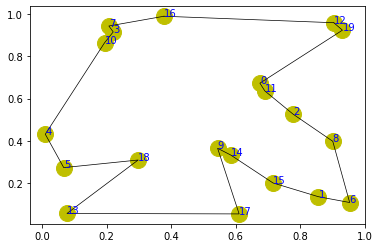

step:2385/5000, actic loss:-0.542, critic loss:0.563, L:4.872, 0min0sec
step:2386/5000, actic loss:-0.541, critic loss:0.563, L:4.872, 0min0sec
step:2387/5000, actic loss:-0.541, critic loss:0.563, L:4.872, 0min0sec
step:2388/5000, actic loss:-0.541, critic loss:0.563, L:4.871, 0min1sec
step:2389/5000, actic loss:-0.541, critic loss:0.562, L:4.871, 0min0sec
distance:5.878
tensor([ 4,  0,  2, 18, 13, 15, 11,  9,  7,  6,  5, 10, 17, 14,  8,  1, 19, 16,
        12,  3])


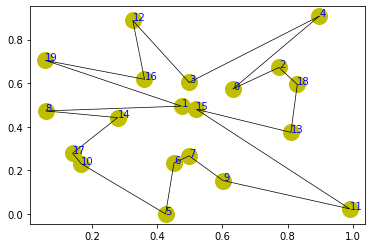

step:2390/5000, actic loss:-0.541, critic loss:0.562, L:4.871, 0min1sec
step:2391/5000, actic loss:-0.540, critic loss:0.562, L:4.871, 0min0sec
step:2392/5000, actic loss:-0.540, critic loss:0.562, L:4.870, 0min0sec
step:2393/5000, actic loss:-0.540, critic loss:0.562, L:4.870, 0min0sec
step:2394/5000, actic loss:-0.540, critic loss:0.561, L:4.870, 0min0sec
distance:4.837
tensor([ 7,  5, 18,  0,  2, 17,  4, 13, 14,  1, 12, 19,  6, 10, 11,  8, 15,  3,
        16,  9])


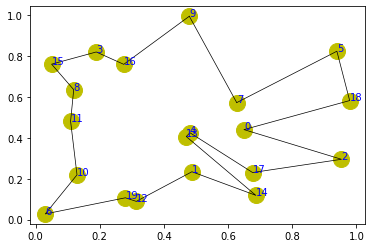

step:2395/5000, actic loss:-0.540, critic loss:0.561, L:4.870, 0min0sec
step:2396/5000, actic loss:-0.539, critic loss:0.561, L:4.869, 0min0sec
step:2397/5000, actic loss:-0.539, critic loss:0.561, L:4.869, 0min0sec
step:2398/5000, actic loss:-0.539, critic loss:0.561, L:4.869, 0min0sec
step:2399/5000, actic loss:-0.539, critic loss:0.561, L:4.869, 0min0sec
distance:4.185
tensor([19, 15,  5, 17, 13, 18,  3,  2,  0, 16,  8,  9, 11, 12,  1,  6,  4, 14,
         7, 10])


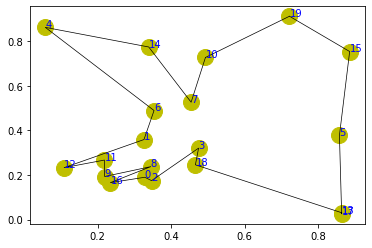

step:2400/5000, actic loss:-0.539, critic loss:0.560, L:4.869, 0min0sec
step:2401/5000, actic loss:-0.538, critic loss:0.560, L:4.868, 0min0sec
step:2402/5000, actic loss:-0.538, critic loss:0.560, L:4.868, 0min0sec
step:2403/5000, actic loss:-0.538, critic loss:0.560, L:4.868, 0min0sec
step:2404/5000, actic loss:-0.538, critic loss:0.560, L:4.868, 0min0sec
distance:4.921
tensor([ 2, 14, 17,  6, 12,  1, 10, 13, 16,  5,  7,  9,  3, 15,  8, 11, 18,  0,
         4, 19])


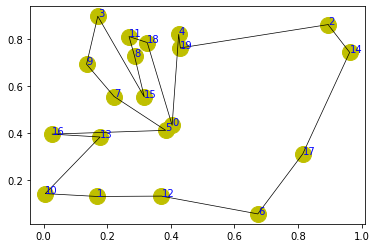

step:2405/5000, actic loss:-0.537, critic loss:0.560, L:4.868, 0min0sec
step:2406/5000, actic loss:-0.538, critic loss:0.559, L:4.867, 0min0sec
step:2407/5000, actic loss:-0.538, critic loss:0.559, L:4.867, 0min0sec
step:2408/5000, actic loss:-0.537, critic loss:0.559, L:4.867, 0min0sec
step:2409/5000, actic loss:-0.537, critic loss:0.559, L:4.867, 0min0sec
distance:4.613
tensor([ 7,  9, 13, 14, 11, 10,  3, 15, 19, 16,  8,  5, 18, 12,  2,  6,  1,  4,
        17,  0])


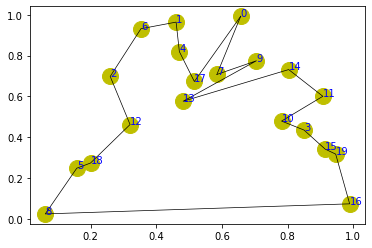

step:2410/5000, actic loss:-0.537, critic loss:0.559, L:4.867, 0min0sec
step:2411/5000, actic loss:-0.537, critic loss:0.559, L:4.866, 0min0sec
step:2412/5000, actic loss:-0.536, critic loss:0.558, L:4.866, 0min0sec
step:2413/5000, actic loss:-0.536, critic loss:0.558, L:4.866, 0min0sec
step:2414/5000, actic loss:-0.536, critic loss:0.558, L:4.866, 0min0sec
distance:4.297
tensor([17, 14,  7, 16,  4,  9, 15,  8, 12,  5,  0,  2,  1, 11, 13, 10, 19, 18,
         3,  6])


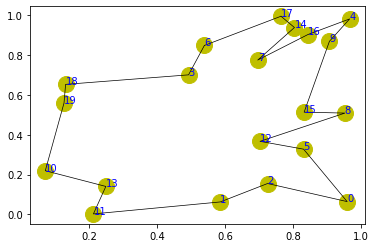

step:2415/5000, actic loss:-0.536, critic loss:0.558, L:4.865, 0min1sec
step:2416/5000, actic loss:-0.536, critic loss:0.558, L:4.865, 0min0sec
step:2417/5000, actic loss:-0.535, critic loss:0.558, L:4.865, 0min0sec
step:2418/5000, actic loss:-0.535, critic loss:0.557, L:4.865, 0min0sec
step:2419/5000, actic loss:-0.535, critic loss:0.557, L:4.865, 0min0sec
distance:3.555
tensor([17, 11,  5, 16,  3, 18,  2,  9,  0,  6,  8, 13, 14,  1,  7, 15,  4, 12,
        10, 19])


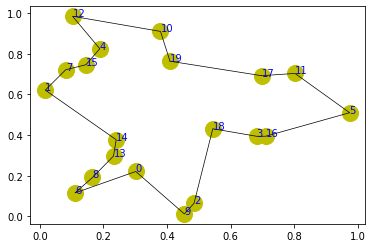

step:2420/5000, actic loss:-0.535, critic loss:0.557, L:4.864, 0min0sec
step:2421/5000, actic loss:-0.534, critic loss:0.557, L:4.864, 0min0sec
step:2422/5000, actic loss:-0.534, critic loss:0.557, L:4.864, 0min0sec
step:2423/5000, actic loss:-0.534, critic loss:0.557, L:4.864, 0min0sec
step:2424/5000, actic loss:-0.534, critic loss:0.556, L:4.863, 0min0sec
distance:3.836
tensor([17, 10,  1,  6,  4,  9,  0,  2,  5, 19, 14, 18, 13, 12, 15,  8,  7,  3,
        11, 16])


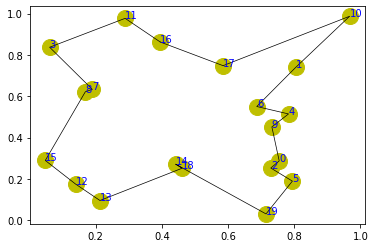

step:2425/5000, actic loss:-0.534, critic loss:0.556, L:4.863, 0min0sec
step:2426/5000, actic loss:-0.533, critic loss:0.556, L:4.863, 0min0sec
step:2427/5000, actic loss:-0.533, critic loss:0.556, L:4.863, 0min0sec
step:2428/5000, actic loss:-0.533, critic loss:0.556, L:4.863, 0min0sec
step:2429/5000, actic loss:-0.533, critic loss:0.555, L:4.862, 0min0sec
distance:4.462
tensor([ 2,  6,  4,  5, 11, 15, 14,  9,  3,  7,  0, 13, 18, 12,  1, 17, 10, 19,
        16,  8])


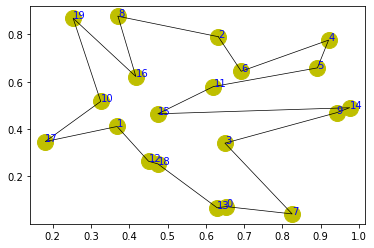

step:2430/5000, actic loss:-0.533, critic loss:0.555, L:4.862, 0min0sec
step:2431/5000, actic loss:-0.532, critic loss:0.555, L:4.862, 0min0sec
step:2432/5000, actic loss:-0.532, critic loss:0.555, L:4.862, 0min0sec
step:2433/5000, actic loss:-0.532, critic loss:0.555, L:4.861, 0min0sec
step:2434/5000, actic loss:-0.532, critic loss:0.555, L:4.861, 0min0sec
distance:4.595
tensor([13, 18, 12, 19,  7,  6,  0,  4,  2, 10,  9,  3,  1,  8, 15, 17,  5, 11,
        14, 16])


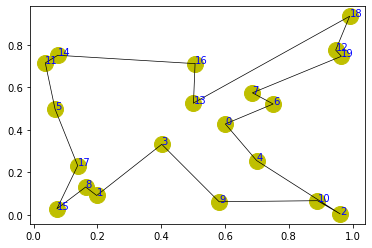

step:2435/5000, actic loss:-0.532, critic loss:0.554, L:4.861, 0min0sec
step:2436/5000, actic loss:-0.531, critic loss:0.554, L:4.861, 0min0sec
step:2437/5000, actic loss:-0.531, critic loss:0.554, L:4.861, 0min0sec
step:2438/5000, actic loss:-0.531, critic loss:0.554, L:4.860, 0min0sec
step:2439/5000, actic loss:-0.531, critic loss:0.554, L:4.860, 0min0sec
distance:3.932
tensor([12, 11,  2,  7,  6, 16,  5,  3,  9, 17, 10, 14,  1, 15, 19,  8, 18,  0,
         4, 13])


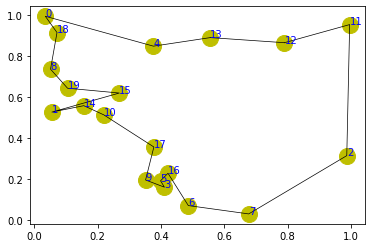

step:2440/5000, actic loss:-0.531, critic loss:0.554, L:4.860, 0min0sec
step:2441/5000, actic loss:-0.530, critic loss:0.553, L:4.860, 0min0sec
step:2442/5000, actic loss:-0.530, critic loss:0.553, L:4.859, 0min0sec
step:2443/5000, actic loss:-0.530, critic loss:0.553, L:4.859, 0min0sec
step:2444/5000, actic loss:-0.530, critic loss:0.553, L:4.859, 0min0sec
distance:5.029
tensor([17,  9,  1, 11, 13,  2,  3, 18, 19,  0,  4, 12,  6,  5, 15, 14,  7, 10,
        16,  8])


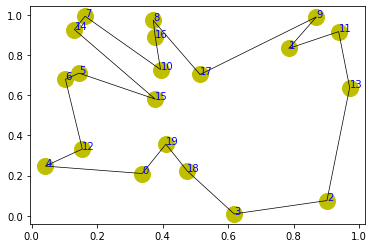

step:2445/5000, actic loss:-0.530, critic loss:0.553, L:4.859, 0min0sec
step:2446/5000, actic loss:-0.529, critic loss:0.553, L:4.858, 0min0sec
step:2447/5000, actic loss:-0.529, critic loss:0.552, L:4.858, 0min0sec
step:2448/5000, actic loss:-0.529, critic loss:0.552, L:4.858, 0min0sec
step:2449/5000, actic loss:-0.529, critic loss:0.552, L:4.858, 0min0sec
distance:4.161
tensor([14, 19, 11,  8, 13,  3, 15, 16,  5,  1, 18,  4,  0, 12,  6, 17,  7, 10,
         9,  2])


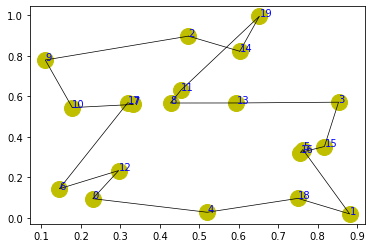

step:2450/5000, actic loss:-0.529, critic loss:0.552, L:4.858, 0min0sec
step:2451/5000, actic loss:-0.528, critic loss:0.552, L:4.857, 0min0sec
step:2452/5000, actic loss:-0.528, critic loss:0.552, L:4.857, 0min0sec
step:2453/5000, actic loss:-0.528, critic loss:0.551, L:4.857, 0min0sec
step:2454/5000, actic loss:-0.528, critic loss:0.551, L:4.856, 0min0sec
distance:3.794
tensor([ 3, 14,  8, 15,  6, 18, 12,  2, 10,  0, 17, 13,  4,  5, 19,  9,  7, 16,
         1, 11])


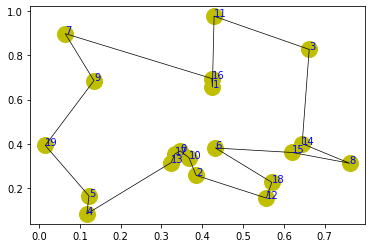

step:2455/5000, actic loss:-0.528, critic loss:0.551, L:4.856, 0min0sec
step:2456/5000, actic loss:-0.528, critic loss:0.551, L:4.856, 0min0sec
step:2457/5000, actic loss:-0.528, critic loss:0.551, L:4.856, 0min0sec
step:2458/5000, actic loss:-0.527, critic loss:0.550, L:4.856, 0min0sec
step:2459/5000, actic loss:-0.527, critic loss:0.550, L:4.855, 0min0sec
distance:4.061
tensor([11,  8, 19,  2, 17,  4,  5,  6, 12,  0, 16,  7, 15, 10,  1, 18, 14,  9,
        13,  3])


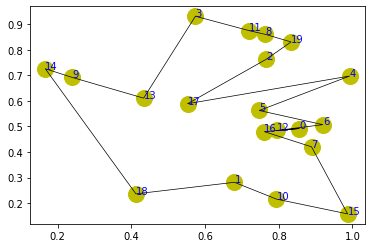

step:2460/5000, actic loss:-0.527, critic loss:0.550, L:4.855, 0min0sec
step:2461/5000, actic loss:-0.526, critic loss:0.550, L:4.855, 0min0sec
step:2462/5000, actic loss:-0.526, critic loss:0.550, L:4.855, 0min0sec
step:2463/5000, actic loss:-0.526, critic loss:0.550, L:4.854, 0min0sec
step:2464/5000, actic loss:-0.526, critic loss:0.550, L:4.854, 0min0sec
distance:4.118
tensor([ 0,  7, 13,  9, 12,  4, 19,  2,  6, 14,  1, 10,  5, 15, 17, 16, 18,  3,
        11,  8])


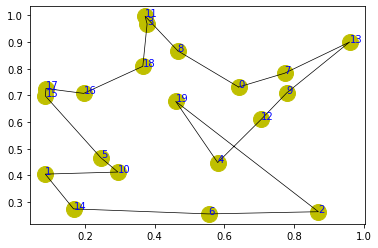

step:2465/5000, actic loss:-0.526, critic loss:0.549, L:4.854, 0min1sec
step:2466/5000, actic loss:-0.526, critic loss:0.549, L:4.854, 0min0sec
step:2467/5000, actic loss:-0.525, critic loss:0.549, L:4.853, 0min0sec
step:2468/5000, actic loss:-0.525, critic loss:0.549, L:4.853, 0min0sec
step:2469/5000, actic loss:-0.525, critic loss:0.549, L:4.853, 0min0sec
distance:3.878
tensor([ 7,  1, 12,  0, 14,  9,  8, 16, 11,  5, 13, 19,  3, 18,  6, 17, 15, 10,
         4,  2])


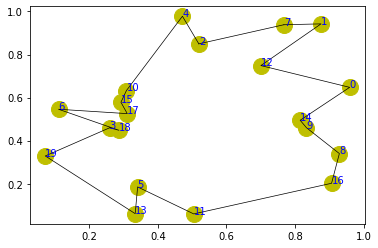

step:2470/5000, actic loss:-0.525, critic loss:0.549, L:4.853, 0min0sec
step:2471/5000, actic loss:-0.525, critic loss:0.548, L:4.852, 0min0sec
step:2472/5000, actic loss:-0.525, critic loss:0.548, L:4.852, 0min0sec
step:2473/5000, actic loss:-0.524, critic loss:0.548, L:4.852, 0min0sec
step:2474/5000, actic loss:-0.524, critic loss:0.548, L:4.852, 0min0sec
distance:4.285
tensor([11,  3, 18,  5, 12, 17, 13,  7, 15,  9,  2, 10,  4,  1,  6, 16, 14,  8,
         0, 19])


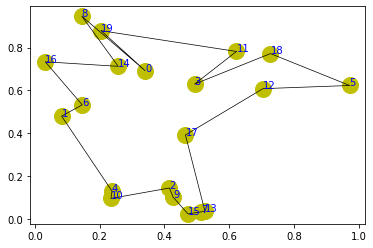

step:2475/5000, actic loss:-0.524, critic loss:0.548, L:4.851, 0min0sec
step:2476/5000, actic loss:-0.524, critic loss:0.548, L:4.851, 0min0sec
step:2477/5000, actic loss:-0.524, critic loss:0.547, L:4.851, 0min0sec
step:2478/5000, actic loss:-0.523, critic loss:0.547, L:4.851, 0min0sec
step:2479/5000, actic loss:-0.523, critic loss:0.547, L:4.850, 0min0sec
distance:4.080
tensor([ 0, 16,  3,  8, 18, 12,  1, 10, 11,  4, 17,  9, 19,  6, 13, 14, 15,  7,
         2,  5])


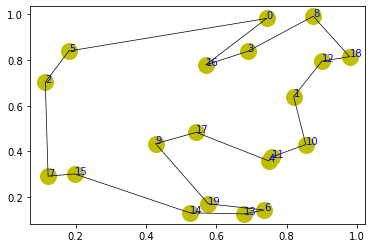

step:2480/5000, actic loss:-0.523, critic loss:0.547, L:4.850, 0min0sec
step:2481/5000, actic loss:-0.523, critic loss:0.547, L:4.850, 0min0sec
step:2482/5000, actic loss:-0.523, critic loss:0.546, L:4.850, 0min0sec
step:2483/5000, actic loss:-0.523, critic loss:0.546, L:4.849, 0min0sec
step:2484/5000, actic loss:-0.522, critic loss:0.546, L:4.849, 0min0sec
distance:4.836
tensor([10, 13,  4, 11, 16,  3,  9, 19, 15, 17,  2, 14,  1,  0,  7,  5,  6, 12,
         8, 18])


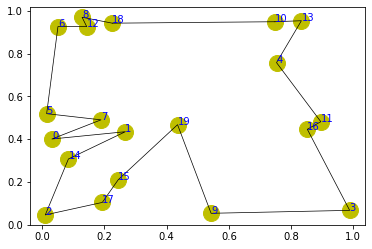

step:2485/5000, actic loss:-0.522, critic loss:0.546, L:4.849, 0min0sec
step:2486/5000, actic loss:-0.522, critic loss:0.546, L:4.849, 0min0sec
step:2487/5000, actic loss:-0.522, critic loss:0.546, L:4.848, 0min0sec
step:2488/5000, actic loss:-0.522, critic loss:0.545, L:4.848, 0min0sec
step:2489/5000, actic loss:-0.521, critic loss:0.545, L:4.848, 0min0sec
distance:4.718
tensor([13, 14, 18,  5,  3,  2, 17,  1, 11,  7,  4,  0, 15, 10, 16,  6, 12,  8,
         9, 19])


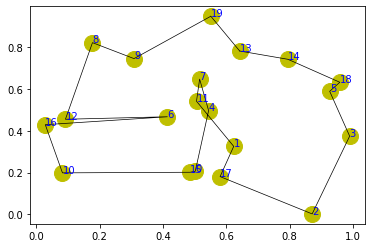

step:2490/5000, actic loss:-0.521, critic loss:0.545, L:4.848, 0min0sec
step:2491/5000, actic loss:-0.521, critic loss:0.545, L:4.848, 0min0sec
step:2492/5000, actic loss:-0.521, critic loss:0.545, L:4.847, 0min0sec
step:2493/5000, actic loss:-0.521, critic loss:0.545, L:4.847, 0min0sec
step:2494/5000, actic loss:-0.520, critic loss:0.544, L:4.847, 0min0sec
distance:3.605
tensor([ 2,  5,  6, 14, 17,  1, 11,  8,  7, 18, 19, 10,  0,  9,  4, 12,  3, 13,
        15, 16])


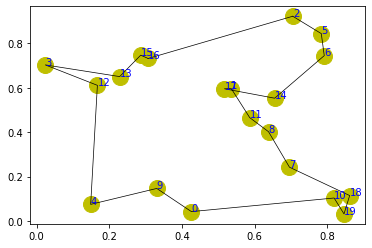

step:2495/5000, actic loss:-0.520, critic loss:0.544, L:4.847, 0min0sec
step:2496/5000, actic loss:-0.520, critic loss:0.544, L:4.846, 0min0sec
step:2497/5000, actic loss:-0.520, critic loss:0.544, L:4.846, 0min0sec
step:2498/5000, actic loss:-0.520, critic loss:0.544, L:4.846, 0min0sec
step:2499/5000, actic loss:-0.519, critic loss:0.544, L:4.846, 0min0sec
distance:4.962
tensor([13,  6, 14, 11,  9, 16, 19,  4,  3,  0,  2, 10,  7, 17,  5, 15, 12, 18,
         1,  8])


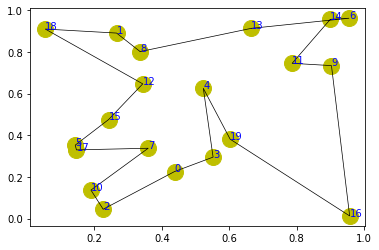

step:2500/5000, actic loss:-0.519, critic loss:0.544, L:4.845, 0min0sec
step:2501/5000, actic loss:-0.519, critic loss:0.543, L:4.845, 0min0sec
step:2502/5000, actic loss:-0.519, critic loss:0.543, L:4.845, 0min0sec
step:2503/5000, actic loss:-0.519, critic loss:0.543, L:4.845, 0min0sec
step:2504/5000, actic loss:-0.519, critic loss:0.543, L:4.845, 0min0sec
distance:4.418
tensor([17,  7, 11,  1, 13, 12,  3, 19,  9, 18,  6,  2,  0, 14,  4,  5, 10, 15,
         8, 16])


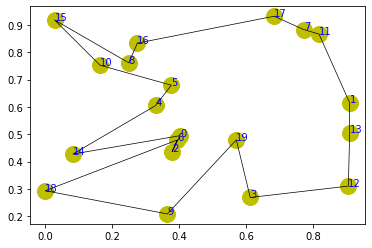

step:2505/5000, actic loss:-0.519, critic loss:0.543, L:4.844, 0min0sec
step:2506/5000, actic loss:-0.519, critic loss:0.543, L:4.844, 0min0sec
step:2507/5000, actic loss:-0.518, critic loss:0.542, L:4.844, 0min0sec
step:2508/5000, actic loss:-0.518, critic loss:0.542, L:4.844, 0min0sec
step:2509/5000, actic loss:-0.518, critic loss:0.542, L:4.844, 0min0sec
distance:4.164
tensor([11, 17, 19, 12,  0,  8, 18,  7,  9,  4,  2,  3,  6, 14, 15,  5, 13,  1,
        10, 16])


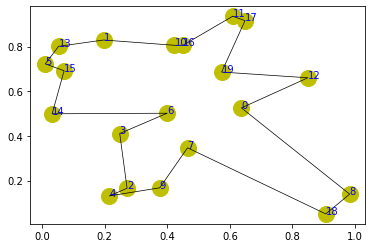

step:2510/5000, actic loss:-0.518, critic loss:0.542, L:4.843, 0min0sec
step:2511/5000, actic loss:-0.518, critic loss:0.542, L:4.843, 0min0sec
step:2512/5000, actic loss:-0.518, critic loss:0.542, L:4.843, 0min0sec
step:2513/5000, actic loss:-0.517, critic loss:0.541, L:4.843, 0min0sec
step:2514/5000, actic loss:-0.517, critic loss:0.541, L:4.842, 0min0sec
distance:4.850
tensor([13,  6, 11, 15, 16,  0, 18,  3,  7,  1, 12, 14,  2, 17,  4,  9, 10,  8,
        19,  5])


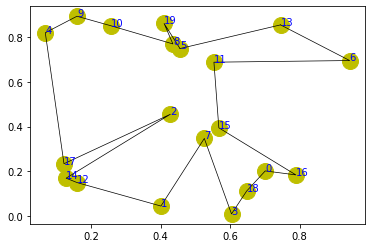

step:2515/5000, actic loss:-0.517, critic loss:0.541, L:4.842, 0min0sec
step:2516/5000, actic loss:-0.517, critic loss:0.541, L:4.842, 0min0sec
step:2517/5000, actic loss:-0.517, critic loss:0.541, L:4.842, 0min0sec
step:2518/5000, actic loss:-0.517, critic loss:0.541, L:4.842, 0min0sec
step:2519/5000, actic loss:-0.516, critic loss:0.541, L:4.841, 0min0sec
distance:4.308
tensor([ 1, 17, 18, 13,  0, 14, 16, 10, 12,  2,  3,  6, 19, 11,  4, 15,  8,  9,
         7,  5])


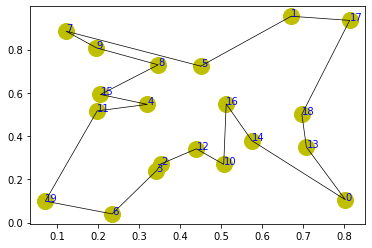

step:2520/5000, actic loss:-0.516, critic loss:0.540, L:4.841, 0min0sec
step:2521/5000, actic loss:-0.516, critic loss:0.540, L:4.841, 0min0sec
step:2522/5000, actic loss:-0.516, critic loss:0.540, L:4.841, 0min0sec
step:2523/5000, actic loss:-0.515, critic loss:0.540, L:4.841, 0min0sec
step:2524/5000, actic loss:-0.515, critic loss:0.540, L:4.840, 0min0sec
distance:3.680
tensor([12, 19,  7, 15, 11,  2,  3,  8,  4,  5, 14, 18,  1, 10, 16,  0,  9, 17,
         6, 13])


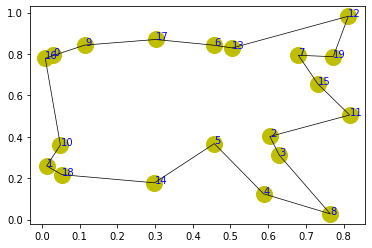

step:2525/5000, actic loss:-0.515, critic loss:0.540, L:4.840, 0min0sec
step:2526/5000, actic loss:-0.515, critic loss:0.540, L:4.840, 0min0sec
step:2527/5000, actic loss:-0.515, critic loss:0.539, L:4.840, 0min0sec
step:2528/5000, actic loss:-0.515, critic loss:0.539, L:4.839, 0min0sec
step:2529/5000, actic loss:-0.515, critic loss:0.539, L:4.839, 0min0sec
distance:4.335
tensor([ 4, 17,  3,  1,  6, 15,  8, 18, 13,  9, 16,  5, 19,  7, 10, 14, 11,  0,
         2, 12])


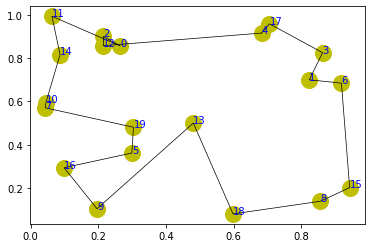

step:2530/5000, actic loss:-0.514, critic loss:0.539, L:4.839, 0min0sec
step:2531/5000, actic loss:-0.514, critic loss:0.539, L:4.839, 0min0sec
step:2532/5000, actic loss:-0.514, critic loss:0.539, L:4.839, 0min0sec
step:2533/5000, actic loss:-0.514, critic loss:0.538, L:4.838, 0min0sec
step:2534/5000, actic loss:-0.514, critic loss:0.538, L:4.838, 0min0sec
distance:5.005
tensor([17,  4,  1,  5, 19, 16, 15,  7, 12, 14,  8, 18,  9,  6, 13,  0,  3, 10,
         2, 11])


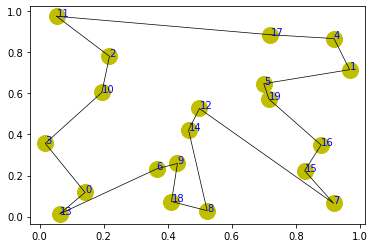

step:2535/5000, actic loss:-0.514, critic loss:0.538, L:4.838, 0min0sec
step:2536/5000, actic loss:-0.514, critic loss:0.538, L:4.838, 0min1sec
step:2537/5000, actic loss:-0.513, critic loss:0.538, L:4.837, 0min0sec
step:2538/5000, actic loss:-0.513, critic loss:0.538, L:4.837, 0min0sec
step:2539/5000, actic loss:-0.513, critic loss:0.537, L:4.837, 0min0sec
distance:4.110
tensor([16,  3, 17,  2, 15, 19,  9, 18,  6,  5, 12,  4,  0, 10,  7, 11, 14, 13,
         8,  1])


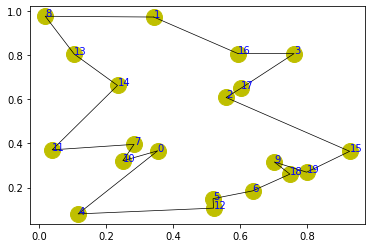

step:2540/5000, actic loss:-0.512, critic loss:0.537, L:4.837, 0min0sec
step:2541/5000, actic loss:-0.512, critic loss:0.537, L:4.837, 0min0sec
step:2542/5000, actic loss:-0.512, critic loss:0.537, L:4.836, 0min0sec
step:2543/5000, actic loss:-0.512, critic loss:0.537, L:4.836, 0min0sec
step:2544/5000, actic loss:-0.512, critic loss:0.537, L:4.836, 0min0sec
distance:4.126
tensor([ 1, 19,  7, 15, 10, 11, 14,  6,  4, 18,  2,  5, 13,  8, 12,  3,  9,  0,
        17, 16])


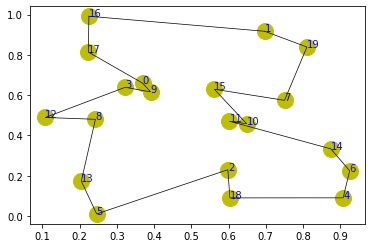

step:2545/5000, actic loss:-0.512, critic loss:0.537, L:4.836, 0min0sec
step:2546/5000, actic loss:-0.511, critic loss:0.536, L:4.836, 0min0sec
step:2547/5000, actic loss:-0.511, critic loss:0.536, L:4.835, 0min0sec
step:2548/5000, actic loss:-0.511, critic loss:0.536, L:4.835, 0min0sec
step:2549/5000, actic loss:-0.511, critic loss:0.536, L:4.835, 0min0sec
distance:4.816
tensor([ 6, 16,  7,  2, 17, 18, 11, 14,  3,  4,  9,  1, 13,  5, 12,  0, 15, 10,
        19,  8])


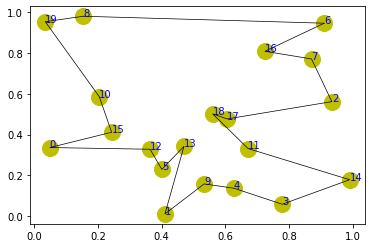

step:2550/5000, actic loss:-0.511, critic loss:0.536, L:4.835, 0min0sec
step:2551/5000, actic loss:-0.510, critic loss:0.536, L:4.835, 0min0sec
step:2552/5000, actic loss:-0.510, critic loss:0.535, L:4.834, 0min0sec
step:2553/5000, actic loss:-0.510, critic loss:0.535, L:4.834, 0min0sec
step:2554/5000, actic loss:-0.510, critic loss:0.535, L:4.834, 0min0sec
distance:3.854
tensor([ 4, 18, 13,  1,  2,  0, 17,  6, 11, 19,  8, 16, 12, 15,  5,  3,  7,  9,
        10, 14])


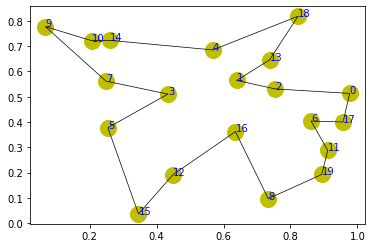

step:2555/5000, actic loss:-0.510, critic loss:0.535, L:4.834, 0min0sec
step:2556/5000, actic loss:-0.509, critic loss:0.535, L:4.833, 0min0sec
step:2557/5000, actic loss:-0.509, critic loss:0.535, L:4.833, 0min0sec
step:2558/5000, actic loss:-0.509, critic loss:0.534, L:4.833, 0min0sec
step:2559/5000, actic loss:-0.509, critic loss:0.534, L:4.833, 0min0sec
distance:5.249
tensor([ 1, 11,  7,  2, 15,  9, 12,  5,  6,  3, 18,  4,  8, 14, 17, 16, 19, 10,
        13,  0])


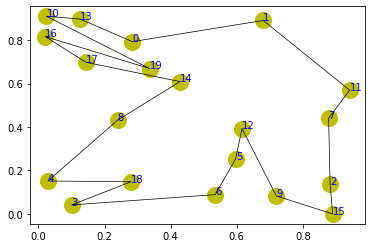

step:2560/5000, actic loss:-0.509, critic loss:0.534, L:4.832, 0min0sec
step:2561/5000, actic loss:-0.509, critic loss:0.534, L:4.832, 0min0sec
step:2562/5000, actic loss:-0.508, critic loss:0.534, L:4.832, 0min0sec
step:2563/5000, actic loss:-0.508, critic loss:0.534, L:4.832, 0min0sec
step:2564/5000, actic loss:-0.508, critic loss:0.533, L:4.832, 0min0sec
distance:3.132
tensor([ 5,  9,  2, 15, 18, 14,  0,  3,  6,  4, 12,  7, 17,  8, 19,  1, 16, 10,
        13, 11])


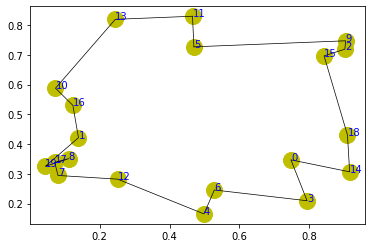

step:2565/5000, actic loss:-0.508, critic loss:0.533, L:4.831, 0min0sec
step:2566/5000, actic loss:-0.508, critic loss:0.533, L:4.831, 0min0sec
step:2567/5000, actic loss:-0.507, critic loss:0.533, L:4.831, 0min0sec
step:2568/5000, actic loss:-0.507, critic loss:0.533, L:4.831, 0min0sec
step:2569/5000, actic loss:-0.507, critic loss:0.533, L:4.830, 0min0sec
distance:4.456
tensor([19, 16, 15,  7, 10, 17,  0, 12,  2,  9,  5,  1, 11,  3,  8, 14, 18,  4,
        13,  6])


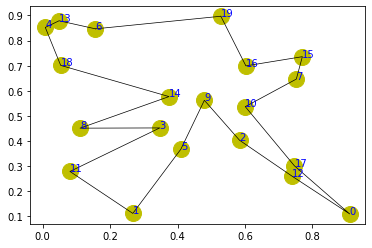

step:2570/5000, actic loss:-0.507, critic loss:0.532, L:4.830, 0min0sec
step:2571/5000, actic loss:-0.507, critic loss:0.532, L:4.830, 0min0sec
step:2572/5000, actic loss:-0.507, critic loss:0.532, L:4.830, 0min0sec
step:2573/5000, actic loss:-0.506, critic loss:0.532, L:4.830, 0min0sec
step:2574/5000, actic loss:-0.506, critic loss:0.532, L:4.829, 0min0sec
distance:4.509
tensor([ 2,  8, 12, 11,  6, 18,  5,  7,  0, 14, 13, 10,  9,  1, 19, 16, 17,  4,
        15,  3])


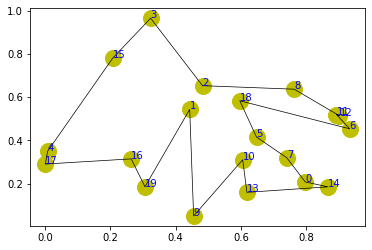

step:2575/5000, actic loss:-0.506, critic loss:0.532, L:4.829, 0min0sec
step:2576/5000, actic loss:-0.506, critic loss:0.532, L:4.829, 0min0sec
step:2577/5000, actic loss:-0.506, critic loss:0.531, L:4.829, 0min0sec
step:2578/5000, actic loss:-0.505, critic loss:0.531, L:4.829, 0min0sec
step:2579/5000, actic loss:-0.505, critic loss:0.531, L:4.828, 0min0sec
distance:4.925
tensor([16, 13,  3,  9, 10,  6,  8,  1,  7, 15, 12,  4, 18,  5, 19, 14,  0, 17,
         2, 11])


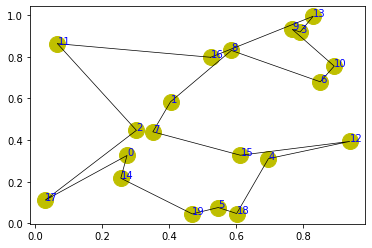

step:2580/5000, actic loss:-0.505, critic loss:0.531, L:4.828, 0min0sec
step:2581/5000, actic loss:-0.505, critic loss:0.531, L:4.828, 0min0sec
step:2582/5000, actic loss:-0.505, critic loss:0.531, L:4.828, 0min0sec
step:2583/5000, actic loss:-0.505, critic loss:0.530, L:4.828, 0min0sec
step:2584/5000, actic loss:-0.504, critic loss:0.530, L:4.827, 0min0sec
distance:5.378
tensor([14, 15, 10, 19,  3, 11, 17, 13,  5,  7,  0,  4,  8,  6,  2, 16, 18,  9,
         1, 12])


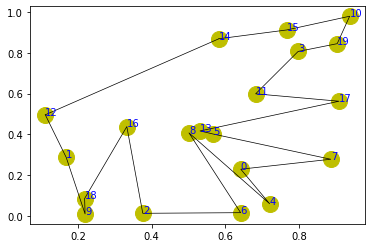

step:2585/5000, actic loss:-0.504, critic loss:0.530, L:4.827, 0min0sec
step:2586/5000, actic loss:-0.504, critic loss:0.530, L:4.827, 0min0sec
step:2587/5000, actic loss:-0.504, critic loss:0.530, L:4.827, 0min0sec
step:2588/5000, actic loss:-0.504, critic loss:0.530, L:4.827, 0min0sec
step:2589/5000, actic loss:-0.503, critic loss:0.530, L:4.826, 0min0sec
distance:4.455
tensor([ 4, 12,  8,  3, 13,  5, 16,  9, 11, 19,  7, 10, 14,  0, 18, 17,  6, 15,
         1,  2])


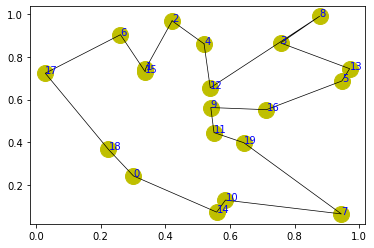

step:2590/5000, actic loss:-0.503, critic loss:0.529, L:4.826, 0min0sec
step:2591/5000, actic loss:-0.503, critic loss:0.529, L:4.826, 0min0sec
step:2592/5000, actic loss:-0.503, critic loss:0.529, L:4.826, 0min0sec
step:2593/5000, actic loss:-0.503, critic loss:0.529, L:4.826, 0min0sec
step:2594/5000, actic loss:-0.502, critic loss:0.529, L:4.825, 0min0sec
distance:4.029
tensor([12, 11,  4,  6,  5, 16,  3, 17,  8, 18, 13, 19, 14, 10,  1, 15,  7,  9,
         2,  0])


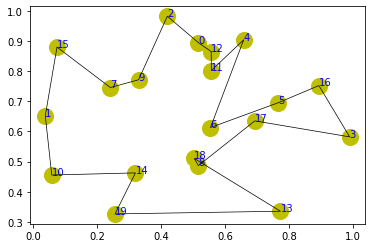

step:2595/5000, actic loss:-0.502, critic loss:0.529, L:4.825, 0min0sec
step:2596/5000, actic loss:-0.502, critic loss:0.528, L:4.825, 0min0sec
step:2597/5000, actic loss:-0.502, critic loss:0.528, L:4.825, 0min0sec
step:2598/5000, actic loss:-0.502, critic loss:0.528, L:4.825, 0min0sec
step:2599/5000, actic loss:-0.501, critic loss:0.528, L:4.824, 0min0sec
distance:4.068
tensor([16,  4,  8,  5,  9,  3, 13, 19,  7, 10, 15,  1,  0, 17, 18,  2, 11, 14,
        12,  6])


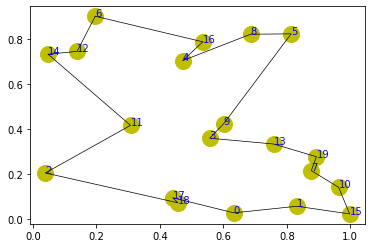

step:2600/5000, actic loss:-0.501, critic loss:0.528, L:4.824, 0min0sec
step:2601/5000, actic loss:-0.501, critic loss:0.528, L:4.824, 0min0sec
step:2602/5000, actic loss:-0.501, critic loss:0.528, L:4.824, 0min0sec
step:2603/5000, actic loss:-0.501, critic loss:0.527, L:4.823, 0min0sec
step:2604/5000, actic loss:-0.500, critic loss:0.527, L:4.823, 0min0sec
distance:4.369
tensor([19, 14,  4,  7,  0,  9, 17, 10,  2,  8,  6,  3, 15, 13,  5,  1, 11, 12,
        16, 18])


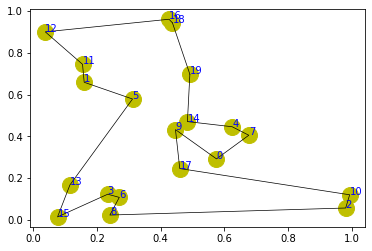

step:2605/5000, actic loss:-0.500, critic loss:0.527, L:4.823, 0min0sec
step:2606/5000, actic loss:-0.500, critic loss:0.527, L:4.823, 0min0sec
step:2607/5000, actic loss:-0.500, critic loss:0.527, L:4.823, 0min0sec
step:2608/5000, actic loss:-0.500, critic loss:0.527, L:4.822, 0min0sec
step:2609/5000, actic loss:-0.499, critic loss:0.526, L:4.822, 0min0sec
distance:4.581
tensor([13,  1, 14,  6, 16,  4,  2, 17,  5, 15, 18,  0, 10,  8, 11,  7,  9, 12,
        19,  3])


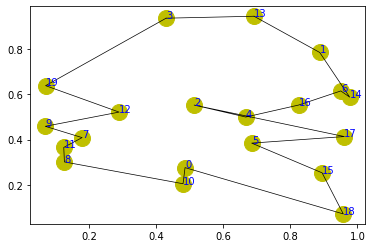

step:2610/5000, actic loss:-0.499, critic loss:0.526, L:4.822, 0min0sec
step:2611/5000, actic loss:-0.499, critic loss:0.526, L:4.822, 0min0sec
step:2612/5000, actic loss:-0.499, critic loss:0.526, L:4.822, 0min0sec
step:2613/5000, actic loss:-0.499, critic loss:0.526, L:4.821, 0min0sec
step:2614/5000, actic loss:-0.499, critic loss:0.526, L:4.821, 0min0sec
distance:4.480
tensor([10,  3, 13,  7, 14,  6,  2, 11, 19,  5,  4, 18,  1, 12, 17, 15,  8,  9,
         0, 16])


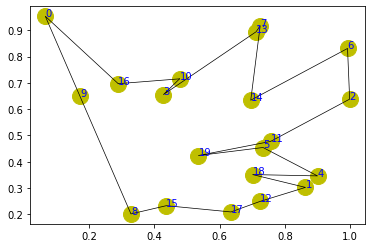

step:2615/5000, actic loss:-0.499, critic loss:0.526, L:4.821, 0min0sec
step:2616/5000, actic loss:-0.498, critic loss:0.525, L:4.821, 0min0sec
step:2617/5000, actic loss:-0.498, critic loss:0.525, L:4.821, 0min0sec
step:2618/5000, actic loss:-0.498, critic loss:0.525, L:4.821, 0min0sec
step:2619/5000, actic loss:-0.498, critic loss:0.525, L:4.820, 0min0sec
distance:4.526
tensor([11,  4, 16,  0,  9, 14,  7,  3, 19,  2,  8, 10,  5, 15,  6,  1, 17, 12,
        13, 18])


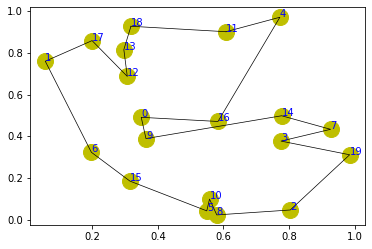

step:2620/5000, actic loss:-0.498, critic loss:0.525, L:4.820, 0min0sec
step:2621/5000, actic loss:-0.498, critic loss:0.525, L:4.820, 0min0sec
step:2622/5000, actic loss:-0.497, critic loss:0.525, L:4.820, 0min0sec
step:2623/5000, actic loss:-0.497, critic loss:0.525, L:4.820, 0min0sec
step:2624/5000, actic loss:-0.497, critic loss:0.524, L:4.820, 0min0sec
distance:4.029
tensor([ 6,  7, 10, 12,  8,  5, 13,  1,  2,  0,  3,  4, 19, 14, 15,  9, 17, 11,
        18, 16])


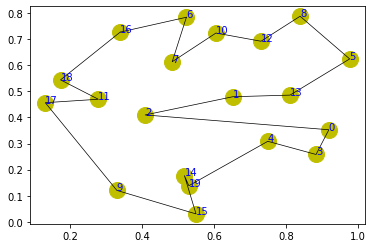

step:2625/5000, actic loss:-0.497, critic loss:0.524, L:4.820, 0min0sec
step:2626/5000, actic loss:-0.496, critic loss:0.524, L:4.819, 0min0sec
step:2627/5000, actic loss:-0.496, critic loss:0.524, L:4.819, 0min0sec
step:2628/5000, actic loss:-0.496, critic loss:0.524, L:4.819, 0min0sec
step:2629/5000, actic loss:-0.496, critic loss:0.524, L:4.819, 0min0sec
distance:4.349
tensor([18, 11,  5,  4,  6,  8, 10,  2,  1, 16,  9,  7, 17, 19, 15, 14,  0, 12,
        13,  3])


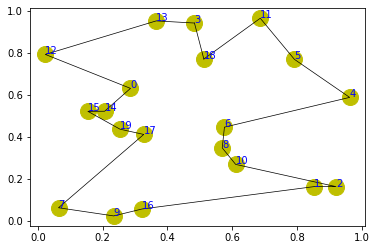

step:2630/5000, actic loss:-0.496, critic loss:0.524, L:4.819, 0min0sec
step:2631/5000, actic loss:-0.496, critic loss:0.524, L:4.819, 0min0sec
step:2632/5000, actic loss:-0.496, critic loss:0.523, L:4.818, 0min0sec
step:2633/5000, actic loss:-0.496, critic loss:0.523, L:4.818, 0min0sec
step:2634/5000, actic loss:-0.495, critic loss:0.523, L:4.818, 0min0sec
distance:4.626
tensor([10,  4,  0,  6, 11, 18,  5, 12, 13,  1, 17,  7,  2, 15, 16, 14,  9, 19,
         8,  3])


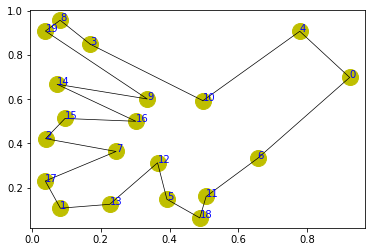

step:2635/5000, actic loss:-0.495, critic loss:0.523, L:4.818, 0min0sec
step:2636/5000, actic loss:-0.494, critic loss:0.523, L:4.818, 0min0sec
step:2637/5000, actic loss:-0.494, critic loss:0.523, L:4.817, 0min0sec
step:2638/5000, actic loss:-0.494, critic loss:0.523, L:4.817, 0min0sec
step:2639/5000, actic loss:-0.494, critic loss:0.522, L:4.817, 0min0sec
distance:4.081
tensor([15, 13, 14,  3,  9, 18,  4, 10,  1,  7, 19,  5,  8, 12,  0, 11, 17,  2,
        16,  6])


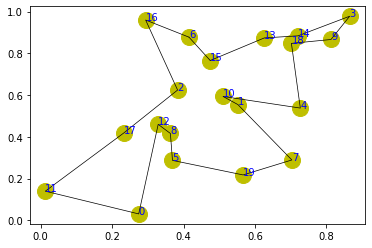

step:2640/5000, actic loss:-0.494, critic loss:0.522, L:4.817, 0min0sec
step:2641/5000, actic loss:-0.494, critic loss:0.522, L:4.817, 0min0sec
step:2642/5000, actic loss:-0.494, critic loss:0.522, L:4.816, 0min0sec
step:2643/5000, actic loss:-0.494, critic loss:0.522, L:4.816, 0min0sec
step:2644/5000, actic loss:-0.493, critic loss:0.522, L:4.816, 0min0sec
distance:4.185
tensor([19,  1, 12, 18,  7, 10, 14,  5,  9, 11, 13,  2,  6,  0, 15, 16,  8,  4,
        17,  3])


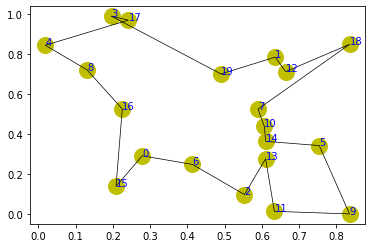

step:2645/5000, actic loss:-0.493, critic loss:0.522, L:4.816, 0min0sec
step:2646/5000, actic loss:-0.493, critic loss:0.522, L:4.816, 0min0sec
step:2647/5000, actic loss:-0.493, critic loss:0.521, L:4.815, 0min0sec
step:2648/5000, actic loss:-0.493, critic loss:0.521, L:4.815, 0min0sec
step:2649/5000, actic loss:-0.493, critic loss:0.521, L:4.815, 0min0sec
distance:3.969
tensor([ 9, 18, 12,  5, 15,  1,  0,  8,  2,  7,  4, 14, 11, 13, 10, 19,  6, 17,
         3, 16])


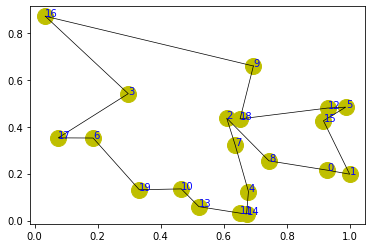

step:2650/5000, actic loss:-0.492, critic loss:0.521, L:4.815, 0min0sec
step:2651/5000, actic loss:-0.492, critic loss:0.521, L:4.814, 0min0sec
step:2652/5000, actic loss:-0.492, critic loss:0.521, L:4.814, 0min0sec
step:2653/5000, actic loss:-0.492, critic loss:0.520, L:4.814, 0min0sec
step:2654/5000, actic loss:-0.492, critic loss:0.520, L:4.814, 0min0sec
distance:3.572
tensor([ 9, 15,  7, 19,  0,  6, 13,  3, 16, 12, 10,  2, 14, 17,  4, 18,  8, 11,
         5,  1])


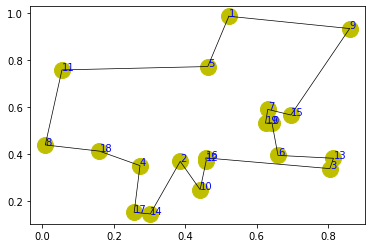

step:2655/5000, actic loss:-0.492, critic loss:0.520, L:4.814, 0min0sec
step:2656/5000, actic loss:-0.491, critic loss:0.520, L:4.813, 0min0sec
step:2657/5000, actic loss:-0.491, critic loss:0.520, L:4.813, 0min0sec
step:2658/5000, actic loss:-0.491, critic loss:0.520, L:4.813, 0min0sec
step:2659/5000, actic loss:-0.491, critic loss:0.520, L:4.813, 0min0sec
distance:4.144
tensor([ 6, 14, 10,  8,  1,  4, 18,  3, 11,  5, 12, 13, 15, 16,  2,  0,  7, 17,
         9, 19])


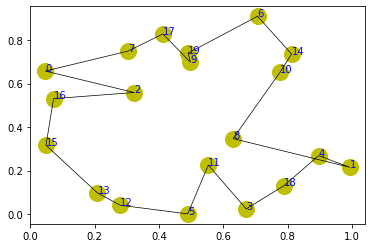

step:2660/5000, actic loss:-0.491, critic loss:0.519, L:4.813, 0min0sec
step:2661/5000, actic loss:-0.491, critic loss:0.519, L:4.812, 0min0sec
step:2662/5000, actic loss:-0.490, critic loss:0.519, L:4.812, 0min0sec
step:2663/5000, actic loss:-0.490, critic loss:0.519, L:4.812, 0min0sec
step:2664/5000, actic loss:-0.490, critic loss:0.519, L:4.812, 0min0sec
distance:4.188
tensor([15,  4,  9,  2,  6,  5, 19,  3, 17, 16,  7, 13, 11,  8, 18,  1, 10, 14,
         0, 12])


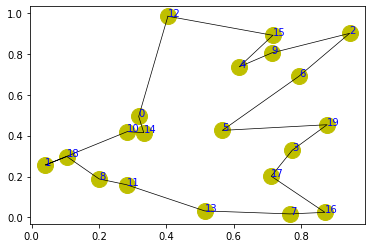

step:2665/5000, actic loss:-0.490, critic loss:0.519, L:4.812, 0min0sec
step:2666/5000, actic loss:-0.490, critic loss:0.519, L:4.811, 0min0sec
step:2667/5000, actic loss:-0.490, critic loss:0.518, L:4.811, 0min0sec
step:2668/5000, actic loss:-0.489, critic loss:0.518, L:4.811, 0min0sec
step:2669/5000, actic loss:-0.489, critic loss:0.518, L:4.811, 0min0sec
distance:4.230
tensor([ 1, 11, 14,  6, 15,  9,  4, 17,  8,  3,  0,  5, 19, 10,  2, 12, 16,  7,
        13, 18])


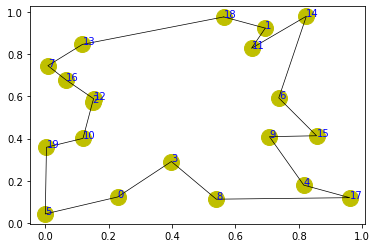

step:2670/5000, actic loss:-0.489, critic loss:0.518, L:4.811, 0min1sec
step:2671/5000, actic loss:-0.489, critic loss:0.518, L:4.810, 0min0sec
step:2672/5000, actic loss:-0.489, critic loss:0.518, L:4.810, 0min0sec
step:2673/5000, actic loss:-0.489, critic loss:0.518, L:4.810, 0min0sec
step:2674/5000, actic loss:-0.489, critic loss:0.517, L:4.810, 0min0sec
distance:4.030
tensor([12, 10, 15,  0, 19, 18, 17, 13, 14,  6,  9,  3,  1, 16,  4,  7,  8, 11,
         5,  2])


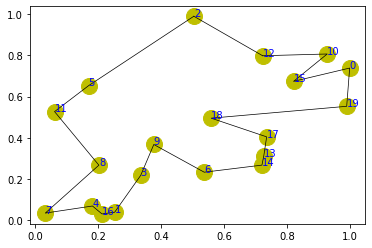

step:2675/5000, actic loss:-0.489, critic loss:0.517, L:4.810, 0min0sec
step:2676/5000, actic loss:-0.488, critic loss:0.517, L:4.809, 0min0sec
step:2677/5000, actic loss:-0.488, critic loss:0.517, L:4.809, 0min0sec
step:2678/5000, actic loss:-0.488, critic loss:0.517, L:4.809, 0min0sec
step:2679/5000, actic loss:-0.488, critic loss:0.517, L:4.809, 0min0sec
distance:3.818
tensor([13, 19,  1,  8, 14, 18,  9, 11, 17,  6,  4,  7, 15,  5,  2,  0, 10,  3,
        12, 16])


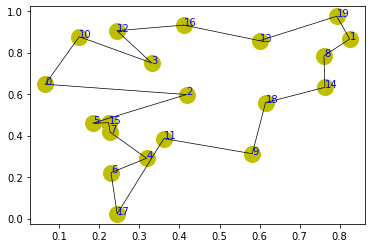

step:2680/5000, actic loss:-0.488, critic loss:0.517, L:4.809, 0min0sec
step:2681/5000, actic loss:-0.487, critic loss:0.516, L:4.808, 0min0sec
step:2682/5000, actic loss:-0.487, critic loss:0.516, L:4.808, 0min0sec
step:2683/5000, actic loss:-0.487, critic loss:0.516, L:4.808, 0min0sec
step:2684/5000, actic loss:-0.487, critic loss:0.516, L:4.808, 0min0sec
distance:3.762
tensor([19, 11,  9,  1,  8,  7,  0, 12,  6,  3,  5, 16, 14,  2, 17, 18,  4, 13,
        10, 15])


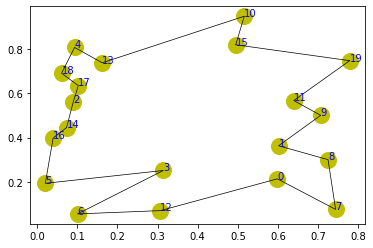

step:2685/5000, actic loss:-0.487, critic loss:0.516, L:4.808, 0min0sec
step:2686/5000, actic loss:-0.487, critic loss:0.516, L:4.807, 0min0sec
step:2687/5000, actic loss:-0.487, critic loss:0.516, L:4.807, 0min0sec
step:2688/5000, actic loss:-0.486, critic loss:0.515, L:4.807, 0min0sec
step:2689/5000, actic loss:-0.486, critic loss:0.515, L:4.807, 0min0sec
distance:3.823
tensor([ 4,  0,  9, 18,  7, 13, 14,  2,  6, 17, 16, 11,  8, 19,  5,  1, 15, 10,
         3, 12])


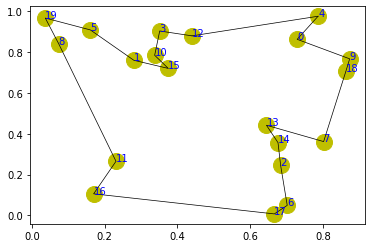

step:2690/5000, actic loss:-0.486, critic loss:0.515, L:4.807, 0min0sec
step:2691/5000, actic loss:-0.486, critic loss:0.515, L:4.806, 0min0sec
step:2692/5000, actic loss:-0.486, critic loss:0.515, L:4.806, 0min0sec
step:2693/5000, actic loss:-0.486, critic loss:0.515, L:4.806, 0min0sec
step:2694/5000, actic loss:-0.486, critic loss:0.514, L:4.806, 0min0sec
distance:4.223
tensor([17, 14,  1, 11,  2, 13,  3,  9,  0, 19, 18,  6, 15,  5, 10,  8,  7,  4,
        12, 16])


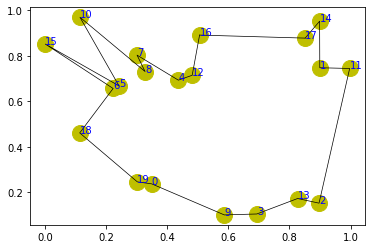

step:2695/5000, actic loss:-0.485, critic loss:0.514, L:4.805, 0min0sec
step:2696/5000, actic loss:-0.485, critic loss:0.514, L:4.805, 0min0sec
step:2697/5000, actic loss:-0.485, critic loss:0.514, L:4.805, 0min0sec
step:2698/5000, actic loss:-0.485, critic loss:0.514, L:4.805, 0min0sec
step:2699/5000, actic loss:-0.485, critic loss:0.514, L:4.805, 0min0sec
distance:4.423
tensor([14, 11,  3,  1, 19,  4, 18, 16, 17,  9, 12, 13, 10,  0,  5, 15,  2,  6,
         8,  7])


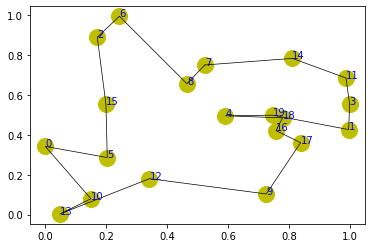

step:2700/5000, actic loss:-0.485, critic loss:0.514, L:4.804, 0min0sec
step:2701/5000, actic loss:-0.484, critic loss:0.513, L:4.804, 0min0sec
step:2702/5000, actic loss:-0.484, critic loss:0.513, L:4.804, 0min0sec
step:2703/5000, actic loss:-0.484, critic loss:0.513, L:4.804, 0min0sec
step:2704/5000, actic loss:-0.484, critic loss:0.513, L:4.804, 0min0sec
distance:4.694
tensor([19, 14, 18,  5,  1, 17, 10, 12, 13,  2,  3,  4, 11,  7,  6, 16,  0,  8,
        15,  9])


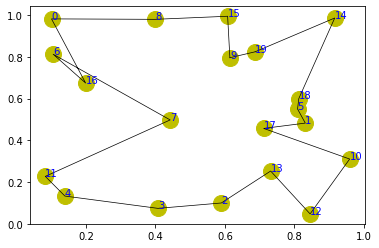

step:2705/5000, actic loss:-0.484, critic loss:0.513, L:4.803, 0min0sec
step:2706/5000, actic loss:-0.484, critic loss:0.513, L:4.803, 0min0sec
step:2707/5000, actic loss:-0.484, critic loss:0.513, L:4.803, 0min0sec
step:2708/5000, actic loss:-0.483, critic loss:0.512, L:4.803, 0min0sec
step:2709/5000, actic loss:-0.483, critic loss:0.512, L:4.803, 0min0sec
distance:4.380
tensor([ 5,  2, 15,  4,  1, 19, 17, 14, 13, 11,  3, 18,  8, 16,  6,  0,  9,  7,
        10, 12])


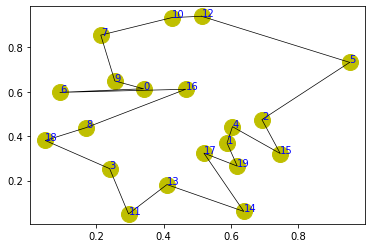

step:2710/5000, actic loss:-0.483, critic loss:0.512, L:4.802, 0min0sec
step:2711/5000, actic loss:-0.483, critic loss:0.512, L:4.802, 0min0sec
step:2712/5000, actic loss:-0.483, critic loss:0.512, L:4.802, 0min0sec
step:2713/5000, actic loss:-0.483, critic loss:0.512, L:4.802, 0min0sec
step:2714/5000, actic loss:-0.483, critic loss:0.512, L:4.802, 0min0sec
distance:4.700
tensor([14, 15,  9, 18, 12,  0,  8, 19,  4,  5,  3, 17, 10,  1,  2, 13, 11,  7,
        16,  6])


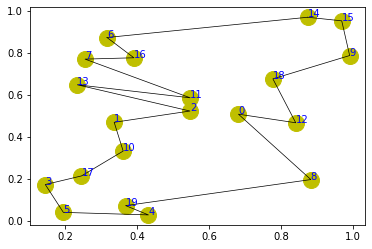

step:2715/5000, actic loss:-0.482, critic loss:0.512, L:4.802, 0min0sec
step:2716/5000, actic loss:-0.482, critic loss:0.511, L:4.802, 0min0sec
step:2717/5000, actic loss:-0.482, critic loss:0.511, L:4.801, 0min0sec
step:2718/5000, actic loss:-0.482, critic loss:0.511, L:4.801, 0min0sec
step:2719/5000, actic loss:-0.482, critic loss:0.511, L:4.801, 0min0sec
distance:4.467
tensor([ 2, 10, 14, 16,  4,  7,  3, 19, 18,  0, 17,  1,  8,  6, 15, 12,  9,  5,
        11, 13])


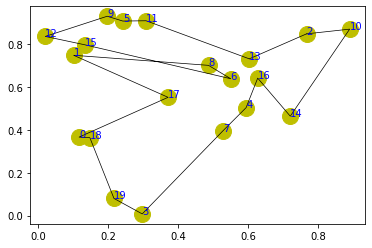

step:2720/5000, actic loss:-0.482, critic loss:0.511, L:4.801, 0min0sec
step:2721/5000, actic loss:-0.482, critic loss:0.511, L:4.801, 0min0sec
step:2722/5000, actic loss:-0.481, critic loss:0.511, L:4.801, 0min0sec
step:2723/5000, actic loss:-0.481, critic loss:0.511, L:4.800, 0min0sec
step:2724/5000, actic loss:-0.481, critic loss:0.510, L:4.800, 0min0sec
distance:3.867
tensor([ 6,  3, 15, 12, 14, 19, 18,  4, 11, 10,  9,  0,  8,  2,  1, 17,  5, 16,
         7, 13])


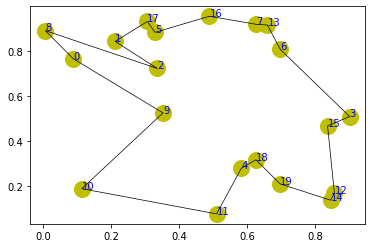

step:2725/5000, actic loss:-0.481, critic loss:0.510, L:4.800, 0min0sec
step:2726/5000, actic loss:-0.481, critic loss:0.510, L:4.800, 0min0sec
step:2727/5000, actic loss:-0.481, critic loss:0.510, L:4.800, 0min0sec
step:2728/5000, actic loss:-0.481, critic loss:0.510, L:4.800, 0min0sec
step:2729/5000, actic loss:-0.481, critic loss:0.510, L:4.799, 0min0sec
distance:3.777
tensor([ 1,  2, 16,  7, 18, 19, 15, 13,  0, 17,  8, 10, 12, 14,  3, 11,  6,  5,
         9,  4])


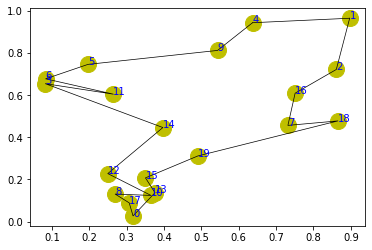

step:2730/5000, actic loss:-0.480, critic loss:0.510, L:4.799, 0min0sec
step:2731/5000, actic loss:-0.480, critic loss:0.509, L:4.799, 0min0sec
step:2732/5000, actic loss:-0.480, critic loss:0.509, L:4.799, 0min0sec
step:2733/5000, actic loss:-0.480, critic loss:0.509, L:4.799, 0min0sec
step:2734/5000, actic loss:-0.480, critic loss:0.509, L:4.798, 0min0sec
distance:4.822
tensor([10,  1,  4,  8, 12,  7, 14,  5,  3, 18,  6,  2, 15, 19, 11,  0, 16, 17,
        13,  9])


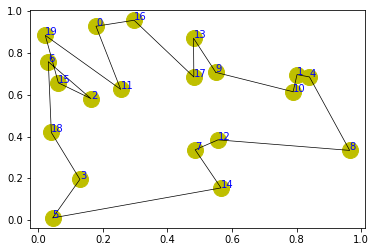

step:2735/5000, actic loss:-0.480, critic loss:0.509, L:4.798, 0min0sec
step:2736/5000, actic loss:-0.480, critic loss:0.509, L:4.798, 0min0sec
step:2737/5000, actic loss:-0.479, critic loss:0.509, L:4.798, 0min0sec
step:2738/5000, actic loss:-0.479, critic loss:0.509, L:4.798, 0min0sec
step:2739/5000, actic loss:-0.479, critic loss:0.508, L:4.798, 0min0sec
distance:3.743
tensor([19, 16, 15,  5,  4,  0,  1, 12, 17,  3,  6,  8, 11,  9, 10,  7, 13, 18,
         2, 14])


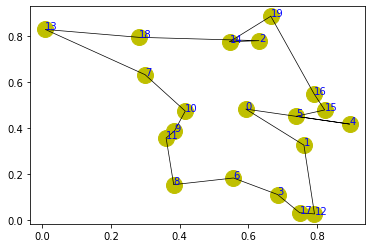

step:2740/5000, actic loss:-0.479, critic loss:0.508, L:4.797, 0min0sec
step:2741/5000, actic loss:-0.478, critic loss:0.508, L:4.797, 0min0sec
step:2742/5000, actic loss:-0.478, critic loss:0.508, L:4.797, 0min0sec
step:2743/5000, actic loss:-0.478, critic loss:0.508, L:4.797, 0min0sec
step:2744/5000, actic loss:-0.478, critic loss:0.508, L:4.797, 0min0sec
distance:3.255
tensor([12, 11, 13, 10,  7,  0, 19,  2,  5,  6, 15,  4,  8, 18,  1,  3, 17,  9,
        16, 14])


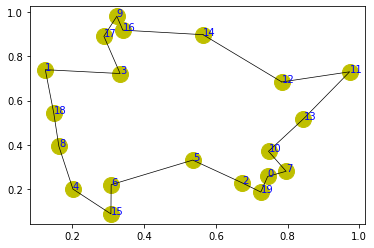

step:2745/5000, actic loss:-0.478, critic loss:0.508, L:4.796, 0min0sec
step:2746/5000, actic loss:-0.478, critic loss:0.507, L:4.796, 0min0sec
step:2747/5000, actic loss:-0.477, critic loss:0.507, L:4.796, 0min0sec
step:2748/5000, actic loss:-0.477, critic loss:0.507, L:4.796, 0min0sec
step:2749/5000, actic loss:-0.477, critic loss:0.507, L:4.796, 0min0sec
distance:4.265
tensor([16, 10,  3,  2, 11,  8,  5, 17,  7, 14, 15, 19, 12,  6,  9, 13,  1, 18,
         4,  0])


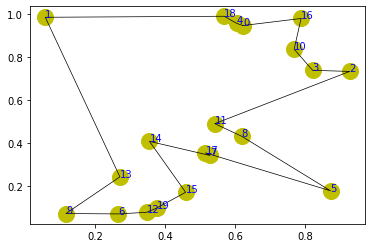

step:2750/5000, actic loss:-0.477, critic loss:0.507, L:4.795, 0min0sec
step:2751/5000, actic loss:-0.477, critic loss:0.507, L:4.795, 0min0sec
step:2752/5000, actic loss:-0.477, critic loss:0.507, L:4.795, 0min0sec
step:2753/5000, actic loss:-0.476, critic loss:0.506, L:4.795, 0min0sec
step:2754/5000, actic loss:-0.476, critic loss:0.506, L:4.795, 0min0sec
distance:4.588
tensor([ 2,  5, 13,  4, 14, 10,  7, 18,  3, 11, 16, 17,  1,  0, 19, 12, 15,  8,
         6,  9])


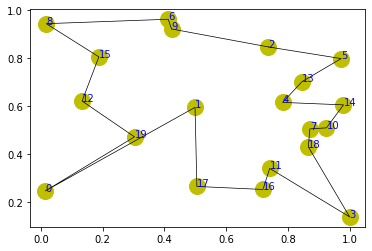

step:2755/5000, actic loss:-0.476, critic loss:0.506, L:4.795, 0min0sec
step:2756/5000, actic loss:-0.476, critic loss:0.506, L:4.794, 0min0sec
step:2757/5000, actic loss:-0.476, critic loss:0.506, L:4.794, 0min0sec
step:2758/5000, actic loss:-0.476, critic loss:0.506, L:4.794, 0min0sec
step:2759/5000, actic loss:-0.476, critic loss:0.506, L:4.794, 0min0sec
distance:3.798
tensor([ 0, 12,  9,  4, 19,  7, 15,  1, 13, 14,  2,  3, 10, 11,  5,  6,  8, 18,
        16, 17])


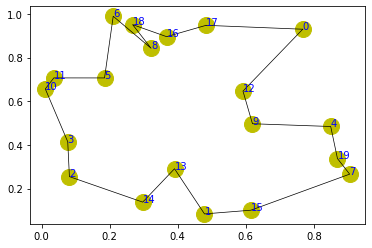

step:2760/5000, actic loss:-0.475, critic loss:0.505, L:4.794, 0min0sec
step:2761/5000, actic loss:-0.475, critic loss:0.505, L:4.793, 0min0sec
step:2762/5000, actic loss:-0.475, critic loss:0.505, L:4.793, 0min0sec
step:2763/5000, actic loss:-0.475, critic loss:0.505, L:4.793, 0min0sec
step:2764/5000, actic loss:-0.475, critic loss:0.505, L:4.793, 0min0sec
distance:4.487
tensor([ 4,  6, 10,  2, 18, 13,  9, 14,  5,  7, 17, 16, 19,  8,  1, 15,  3, 11,
        12,  0])


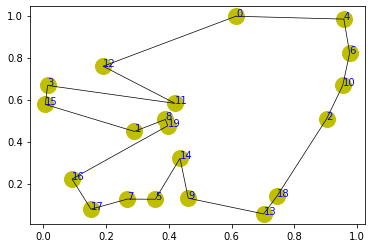

step:2765/5000, actic loss:-0.475, critic loss:0.505, L:4.793, 0min0sec
step:2766/5000, actic loss:-0.474, critic loss:0.505, L:4.792, 0min0sec
step:2767/5000, actic loss:-0.474, critic loss:0.505, L:4.792, 0min0sec
step:2768/5000, actic loss:-0.474, critic loss:0.504, L:4.792, 0min0sec
step:2769/5000, actic loss:-0.474, critic loss:0.504, L:4.792, 0min0sec
distance:5.210
tensor([ 1,  8, 10,  9, 17, 19,  0,  4, 13, 15,  5,  3, 16, 12, 11, 14,  6,  7,
        18,  2])


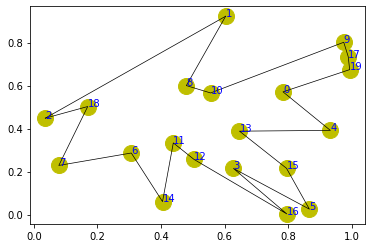

step:2770/5000, actic loss:-0.474, critic loss:0.504, L:4.792, 0min0sec
step:2771/5000, actic loss:-0.474, critic loss:0.504, L:4.792, 0min0sec
step:2772/5000, actic loss:-0.474, critic loss:0.504, L:4.791, 0min0sec
step:2773/5000, actic loss:-0.473, critic loss:0.504, L:4.791, 0min0sec
step:2774/5000, actic loss:-0.473, critic loss:0.504, L:4.791, 0min0sec
distance:4.907
tensor([ 9, 12, 17, 13, 16,  6, 11, 19, 18,  3, 14,  1,  7, 10,  5,  4,  0,  2,
         8, 15])


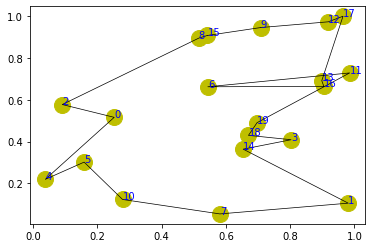

step:2775/5000, actic loss:-0.473, critic loss:0.504, L:4.791, 0min0sec
step:2776/5000, actic loss:-0.473, critic loss:0.503, L:4.791, 0min0sec
step:2777/5000, actic loss:-0.473, critic loss:0.503, L:4.790, 0min0sec
step:2778/5000, actic loss:-0.473, critic loss:0.503, L:4.790, 0min0sec
step:2779/5000, actic loss:-0.473, critic loss:0.503, L:4.790, 0min0sec
distance:3.608
tensor([16,  7,  5,  8, 19,  1,  0,  3, 15, 14, 10, 17,  6,  2, 18,  4, 11,  9,
        13, 12])


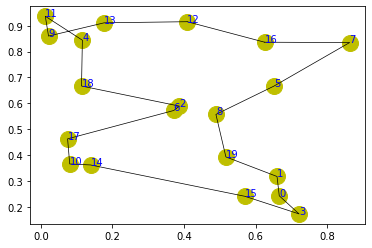

step:2780/5000, actic loss:-0.472, critic loss:0.503, L:4.790, 0min0sec
step:2781/5000, actic loss:-0.472, critic loss:0.503, L:4.790, 0min0sec
step:2782/5000, actic loss:-0.472, critic loss:0.503, L:4.790, 0min0sec
step:2783/5000, actic loss:-0.472, critic loss:0.502, L:4.789, 0min0sec
step:2784/5000, actic loss:-0.472, critic loss:0.502, L:4.789, 0min0sec
distance:4.346
tensor([10,  5,  7, 16,  0,  2, 14, 17,  8,  9,  4,  3, 11,  1,  6, 15, 13, 18,
        12, 19])


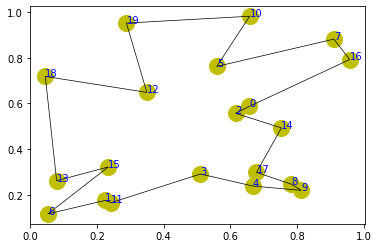

step:2785/5000, actic loss:-0.472, critic loss:0.502, L:4.789, 0min0sec
step:2786/5000, actic loss:-0.472, critic loss:0.502, L:4.789, 0min0sec
step:2787/5000, actic loss:-0.472, critic loss:0.502, L:4.789, 0min0sec
step:2788/5000, actic loss:-0.472, critic loss:0.502, L:4.788, 0min0sec
step:2789/5000, actic loss:-0.471, critic loss:0.502, L:4.788, 0min0sec
distance:4.888
tensor([ 4,  6,  3, 17, 14, 16, 18,  8, 15, 11,  0, 10,  2,  7,  1,  5,  9, 13,
        12, 19])


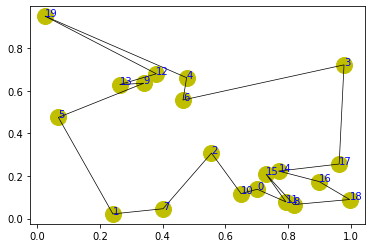

step:2790/5000, actic loss:-0.471, critic loss:0.501, L:4.788, 0min0sec
step:2791/5000, actic loss:-0.471, critic loss:0.501, L:4.788, 0min0sec
step:2792/5000, actic loss:-0.471, critic loss:0.501, L:4.788, 0min0sec
step:2793/5000, actic loss:-0.470, critic loss:0.501, L:4.787, 0min0sec
step:2794/5000, actic loss:-0.470, critic loss:0.501, L:4.787, 0min0sec
distance:4.465
tensor([ 8,  9,  6, 18,  0,  2, 14, 11,  3,  1, 17, 16, 12,  4,  7, 15, 19, 10,
         5, 13])


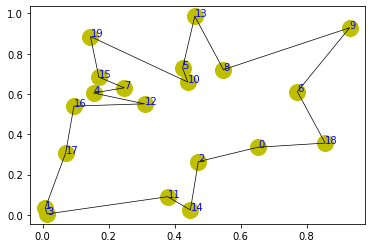

step:2795/5000, actic loss:-0.470, critic loss:0.501, L:4.787, 0min0sec
step:2796/5000, actic loss:-0.470, critic loss:0.501, L:4.787, 0min0sec
step:2797/5000, actic loss:-0.470, critic loss:0.501, L:4.787, 0min0sec
step:2798/5000, actic loss:-0.470, critic loss:0.500, L:4.787, 0min0sec
step:2799/5000, actic loss:-0.470, critic loss:0.500, L:4.786, 0min0sec
distance:4.607
tensor([16,  8,  5,  7, 10,  0,  6,  2, 12, 19, 18, 11, 15,  4,  3,  1, 17,  9,
        13, 14])


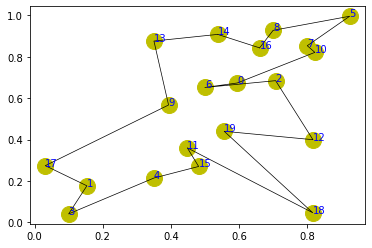

step:2800/5000, actic loss:-0.469, critic loss:0.500, L:4.786, 0min0sec
step:2801/5000, actic loss:-0.469, critic loss:0.500, L:4.786, 0min0sec
step:2802/5000, actic loss:-0.469, critic loss:0.500, L:4.786, 0min0sec
step:2803/5000, actic loss:-0.469, critic loss:0.500, L:4.786, 0min0sec
step:2804/5000, actic loss:-0.469, critic loss:0.500, L:4.786, 0min0sec
distance:3.545
tensor([12, 16, 11,  6, 18,  5,  4,  2,  3,  9, 10, 14, 17,  1, 15,  7, 19,  0,
         8, 13])


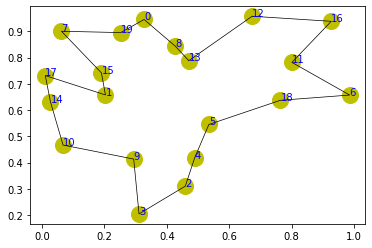

step:2805/5000, actic loss:-0.469, critic loss:0.499, L:4.785, 0min0sec
step:2806/5000, actic loss:-0.468, critic loss:0.499, L:4.785, 0min0sec
step:2807/5000, actic loss:-0.468, critic loss:0.499, L:4.785, 0min0sec
step:2808/5000, actic loss:-0.468, critic loss:0.499, L:4.785, 0min0sec
step:2809/5000, actic loss:-0.468, critic loss:0.499, L:4.785, 0min0sec
distance:4.551
tensor([ 7,  1, 16,  2,  8, 14,  5, 15,  9,  6, 17, 11, 19, 12, 13, 10,  3, 18,
         0,  4])


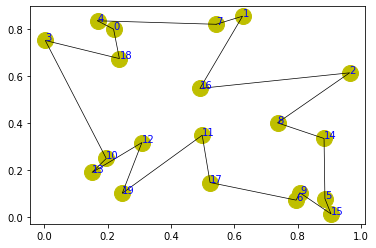

step:2810/5000, actic loss:-0.468, critic loss:0.499, L:4.784, 0min0sec
step:2811/5000, actic loss:-0.468, critic loss:0.499, L:4.784, 0min0sec
step:2812/5000, actic loss:-0.468, critic loss:0.498, L:4.784, 0min0sec
step:2813/5000, actic loss:-0.467, critic loss:0.498, L:4.784, 0min0sec
step:2814/5000, actic loss:-0.467, critic loss:0.498, L:4.784, 0min0sec
distance:3.687
tensor([18, 15, 14, 13, 16,  4,  5,  8, 10, 11,  2,  6,  0,  3,  1, 17, 19,  9,
        12,  7])


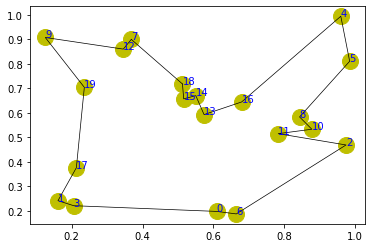

step:2815/5000, actic loss:-0.467, critic loss:0.498, L:4.784, 0min0sec
step:2816/5000, actic loss:-0.467, critic loss:0.498, L:4.783, 0min0sec
step:2817/5000, actic loss:-0.467, critic loss:0.498, L:4.783, 0min0sec
step:2818/5000, actic loss:-0.467, critic loss:0.498, L:4.783, 0min0sec
step:2819/5000, actic loss:-0.467, critic loss:0.498, L:4.783, 0min0sec
distance:4.373
tensor([14,  7, 11, 12,  4, 13,  6,  1,  8, 10, 18, 19, 16,  5,  0, 15,  9, 17,
         2,  3])


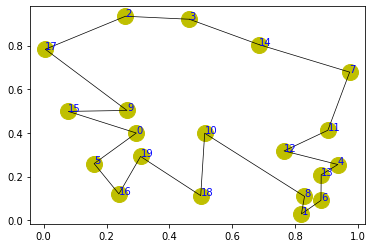

step:2820/5000, actic loss:-0.466, critic loss:0.497, L:4.783, 0min0sec
step:2821/5000, actic loss:-0.466, critic loss:0.497, L:4.783, 0min0sec
step:2822/5000, actic loss:-0.466, critic loss:0.497, L:4.782, 0min0sec
step:2823/5000, actic loss:-0.466, critic loss:0.497, L:4.782, 0min0sec
step:2824/5000, actic loss:-0.466, critic loss:0.497, L:4.782, 0min0sec
distance:4.637
tensor([16, 15,  2, 12, 13, 18, 14,  0,  6,  9, 17,  5, 10,  3,  8, 11, 19,  4,
         1,  7])


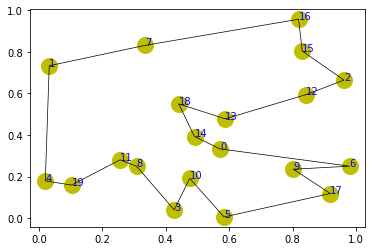

step:2825/5000, actic loss:-0.466, critic loss:0.497, L:4.782, 0min0sec
step:2826/5000, actic loss:-0.465, critic loss:0.497, L:4.782, 0min0sec
step:2827/5000, actic loss:-0.465, critic loss:0.496, L:4.781, 0min0sec
step:2828/5000, actic loss:-0.465, critic loss:0.496, L:4.781, 0min0sec
step:2829/5000, actic loss:-0.465, critic loss:0.496, L:4.781, 0min0sec
distance:4.635
tensor([ 0, 10, 16,  1, 15,  7,  4, 19, 12,  2,  5,  9, 14, 18, 17,  3, 13,  6,
         8, 11])


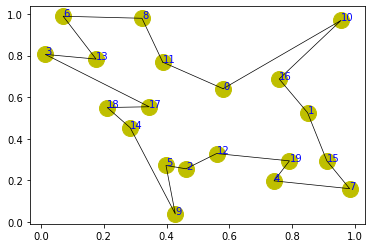

step:2830/5000, actic loss:-0.465, critic loss:0.496, L:4.781, 0min0sec
step:2831/5000, actic loss:-0.465, critic loss:0.496, L:4.781, 0min0sec
step:2832/5000, actic loss:-0.465, critic loss:0.496, L:4.780, 0min0sec
step:2833/5000, actic loss:-0.465, critic loss:0.496, L:4.780, 0min0sec
step:2834/5000, actic loss:-0.464, critic loss:0.496, L:4.780, 0min0sec
distance:3.925
tensor([ 6, 15,  2,  4, 17,  5,  7,  8,  9, 12, 18, 13, 14, 10, 19, 11,  1,  3,
         0, 16])


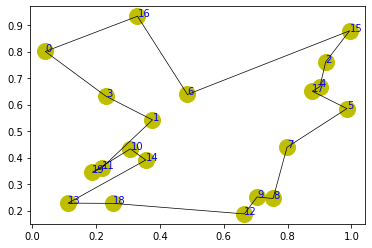

step:2835/5000, actic loss:-0.464, critic loss:0.496, L:4.780, 0min0sec
step:2836/5000, actic loss:-0.464, critic loss:0.495, L:4.780, 0min0sec
step:2837/5000, actic loss:-0.464, critic loss:0.495, L:4.780, 0min0sec
step:2838/5000, actic loss:-0.464, critic loss:0.495, L:4.779, 0min0sec
step:2839/5000, actic loss:-0.464, critic loss:0.495, L:4.779, 0min0sec
distance:4.191
tensor([ 5,  7, 19,  3, 15, 10,  8, 16, 18,  6,  4, 17,  1,  9, 12,  0, 11, 14,
         2, 13])


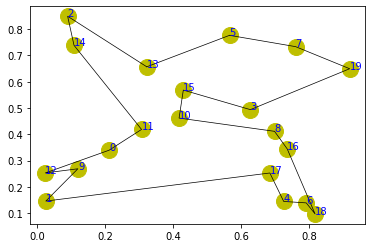

step:2840/5000, actic loss:-0.463, critic loss:0.495, L:4.779, 0min0sec
step:2841/5000, actic loss:-0.463, critic loss:0.495, L:4.779, 0min0sec
step:2842/5000, actic loss:-0.463, critic loss:0.495, L:4.779, 0min0sec
step:2843/5000, actic loss:-0.463, critic loss:0.495, L:4.778, 0min0sec
step:2844/5000, actic loss:-0.463, critic loss:0.494, L:4.778, 0min0sec
distance:4.926
tensor([ 5, 11,  0, 17,  4,  2,  9, 16,  7,  3, 14, 18,  8,  1, 10, 13, 15, 12,
        19,  6])


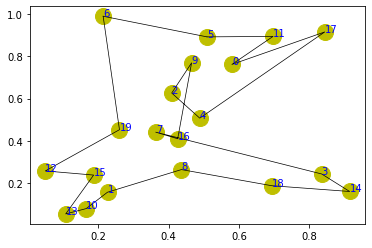

step:2845/5000, actic loss:-0.462, critic loss:0.494, L:4.778, 0min0sec
step:2846/5000, actic loss:-0.462, critic loss:0.494, L:4.778, 0min0sec
step:2847/5000, actic loss:-0.462, critic loss:0.494, L:4.778, 0min0sec
step:2848/5000, actic loss:-0.462, critic loss:0.494, L:4.777, 0min0sec
step:2849/5000, actic loss:-0.462, critic loss:0.494, L:4.777, 0min0sec
distance:4.353
tensor([10,  7, 15, 16,  0, 11,  3, 14,  2, 12, 18, 13,  1, 17,  4,  5,  6,  9,
        19,  8])


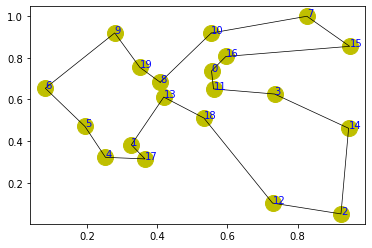

step:2850/5000, actic loss:-0.462, critic loss:0.494, L:4.777, 0min0sec
step:2851/5000, actic loss:-0.462, critic loss:0.494, L:4.777, 0min0sec
step:2852/5000, actic loss:-0.462, critic loss:0.493, L:4.777, 0min0sec
step:2853/5000, actic loss:-0.461, critic loss:0.493, L:4.776, 0min0sec
step:2854/5000, actic loss:-0.461, critic loss:0.493, L:4.776, 0min0sec
distance:4.397
tensor([ 6, 19,  4, 13,  8, 16, 10, 14,  5,  0,  7, 12, 18,  1, 17, 15, 11,  9,
         2,  3])


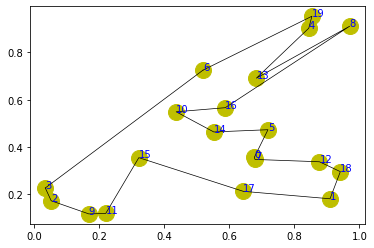

step:2855/5000, actic loss:-0.461, critic loss:0.493, L:4.776, 0min0sec
step:2856/5000, actic loss:-0.461, critic loss:0.493, L:4.776, 0min0sec
step:2857/5000, actic loss:-0.461, critic loss:0.493, L:4.776, 0min0sec
step:2858/5000, actic loss:-0.461, critic loss:0.493, L:4.776, 0min0sec
step:2859/5000, actic loss:-0.461, critic loss:0.492, L:4.775, 0min0sec
distance:4.295
tensor([18,  4,  2, 19,  0,  6, 10,  8, 17, 13, 11,  3,  9, 16,  7, 15, 12,  1,
         5, 14])


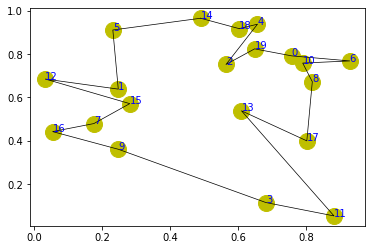

step:2860/5000, actic loss:-0.460, critic loss:0.492, L:4.775, 0min0sec
step:2861/5000, actic loss:-0.460, critic loss:0.492, L:4.775, 0min0sec
step:2862/5000, actic loss:-0.460, critic loss:0.492, L:4.775, 0min0sec
step:2863/5000, actic loss:-0.460, critic loss:0.492, L:4.775, 0min0sec
step:2864/5000, actic loss:-0.460, critic loss:0.492, L:4.774, 0min0sec
distance:3.555
tensor([ 1, 13, 14, 17,  3, 19,  2,  6, 11,  8, 12, 16,  0, 10,  4, 15,  5, 18,
         7,  9])


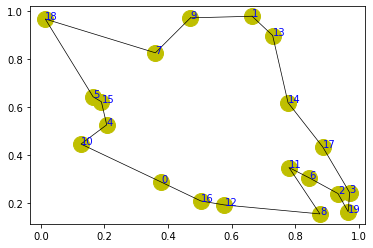

step:2865/5000, actic loss:-0.460, critic loss:0.492, L:4.774, 0min0sec
step:2866/5000, actic loss:-0.460, critic loss:0.492, L:4.774, 0min0sec
step:2867/5000, actic loss:-0.459, critic loss:0.491, L:4.774, 0min0sec
step:2868/5000, actic loss:-0.459, critic loss:0.491, L:4.774, 0min0sec
step:2869/5000, actic loss:-0.459, critic loss:0.491, L:4.773, 0min0sec
distance:4.289
tensor([ 5, 11, 14, 13, 18,  3, 10, 17,  6,  9,  0,  4, 15,  1, 16, 12,  7,  8,
         2, 19])


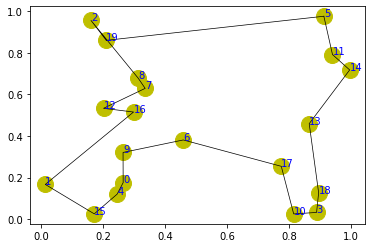

step:2870/5000, actic loss:-0.459, critic loss:0.491, L:4.773, 0min0sec
step:2871/5000, actic loss:-0.459, critic loss:0.491, L:4.773, 0min0sec
step:2872/5000, actic loss:-0.459, critic loss:0.491, L:4.773, 0min0sec
step:2873/5000, actic loss:-0.459, critic loss:0.491, L:4.773, 0min0sec
step:2874/5000, actic loss:-0.459, critic loss:0.491, L:4.772, 0min0sec
distance:4.306
tensor([19,  6, 15, 16,  8, 12, 14,  3,  1, 10,  9,  0,  7, 13, 17, 18, 11,  4,
         2,  5])


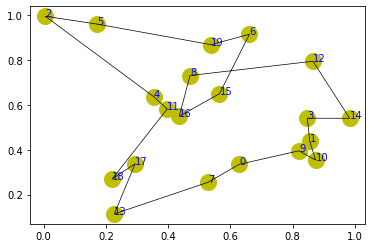

step:2875/5000, actic loss:-0.459, critic loss:0.490, L:4.772, 0min0sec
step:2876/5000, actic loss:-0.459, critic loss:0.490, L:4.772, 0min0sec
step:2877/5000, actic loss:-0.459, critic loss:0.490, L:4.772, 0min0sec
step:2878/5000, actic loss:-0.458, critic loss:0.490, L:4.772, 0min0sec
step:2879/5000, actic loss:-0.458, critic loss:0.490, L:4.771, 0min0sec
distance:4.384
tensor([ 9,  1, 18, 10,  7,  5, 16, 11,  8,  6,  4,  2, 14, 17, 19, 12,  3, 15,
        13,  0])


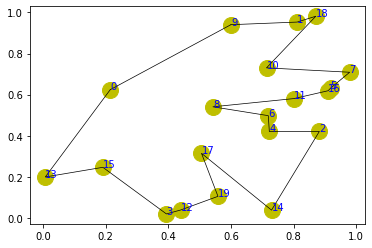

step:2880/5000, actic loss:-0.458, critic loss:0.490, L:4.771, 0min0sec
step:2881/5000, actic loss:-0.458, critic loss:0.490, L:4.771, 0min0sec
step:2882/5000, actic loss:-0.458, critic loss:0.490, L:4.771, 0min0sec
step:2883/5000, actic loss:-0.457, critic loss:0.489, L:4.771, 0min0sec
step:2884/5000, actic loss:-0.457, critic loss:0.489, L:4.770, 0min0sec
distance:5.449
tensor([11, 12, 10,  4,  6,  5,  8, 19,  3, 13, 15,  7,  2, 14, 17,  0,  9, 16,
         1, 18])


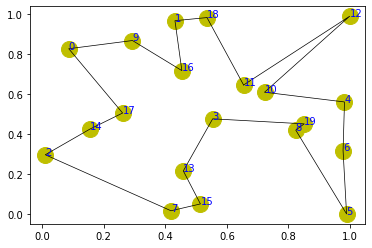

step:2885/5000, actic loss:-0.457, critic loss:0.489, L:4.770, 0min1sec
step:2886/5000, actic loss:-0.457, critic loss:0.489, L:4.770, 0min0sec
step:2887/5000, actic loss:-0.457, critic loss:0.489, L:4.770, 0min0sec
step:2888/5000, actic loss:-0.457, critic loss:0.489, L:4.770, 0min0sec
step:2889/5000, actic loss:-0.457, critic loss:0.489, L:4.770, 0min0sec
distance:4.087
tensor([19,  6,  0,  4,  8,  5,  9,  3,  2, 17, 10, 16, 11, 13,  1, 15,  7, 12,
        14, 18])


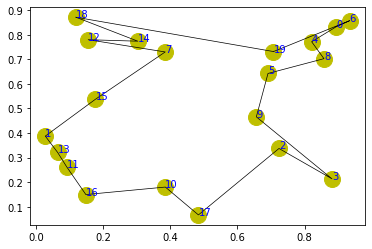

step:2890/5000, actic loss:-0.457, critic loss:0.489, L:4.769, 0min0sec
step:2891/5000, actic loss:-0.457, critic loss:0.488, L:4.769, 0min0sec
step:2892/5000, actic loss:-0.456, critic loss:0.488, L:4.769, 0min0sec
step:2893/5000, actic loss:-0.456, critic loss:0.488, L:4.769, 0min0sec
step:2894/5000, actic loss:-0.456, critic loss:0.488, L:4.769, 0min0sec
distance:4.286
tensor([18,  7, 14,  3, 12, 16,  0,  2,  1,  4,  8, 15, 13, 11,  5,  9, 10, 17,
         6, 19])


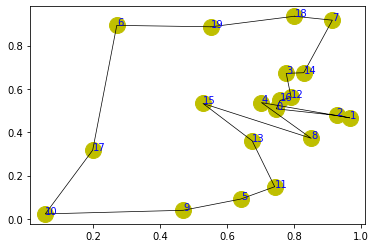

step:2895/5000, actic loss:-0.456, critic loss:0.488, L:4.769, 0min0sec
step:2896/5000, actic loss:-0.456, critic loss:0.488, L:4.769, 0min0sec
step:2897/5000, actic loss:-0.456, critic loss:0.488, L:4.769, 0min0sec
step:2898/5000, actic loss:-0.456, critic loss:0.488, L:4.768, 0min0sec
step:2899/5000, actic loss:-0.455, critic loss:0.487, L:4.768, 0min0sec
distance:3.957
tensor([ 4, 18,  5,  1,  3, 11,  7,  0, 14, 15, 19, 10,  6,  9,  2, 17,  8, 13,
        16, 12])


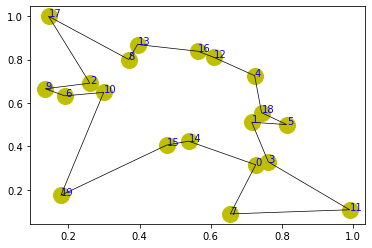

step:2900/5000, actic loss:-0.455, critic loss:0.487, L:4.768, 0min0sec
step:2901/5000, actic loss:-0.455, critic loss:0.487, L:4.768, 0min0sec
step:2902/5000, actic loss:-0.455, critic loss:0.487, L:4.768, 0min0sec
step:2903/5000, actic loss:-0.455, critic loss:0.487, L:4.768, 0min0sec
step:2904/5000, actic loss:-0.455, critic loss:0.487, L:4.767, 0min0sec
distance:4.755
tensor([12, 10,  6,  5,  7, 14, 18, 11, 13, 19, 16,  4,  0,  3,  2, 15, 17,  9,
         8,  1])


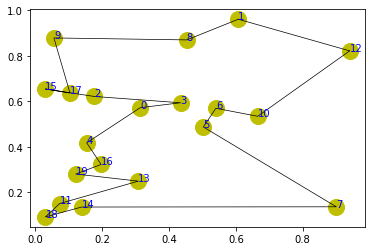

step:2905/5000, actic loss:-0.455, critic loss:0.487, L:4.767, 0min0sec
step:2906/5000, actic loss:-0.455, critic loss:0.487, L:4.767, 0min0sec
step:2907/5000, actic loss:-0.454, critic loss:0.486, L:4.767, 0min0sec
step:2908/5000, actic loss:-0.454, critic loss:0.486, L:4.767, 0min0sec
step:2909/5000, actic loss:-0.454, critic loss:0.486, L:4.766, 0min0sec
distance:4.050
tensor([11, 14, 17,  3, 19, 15, 10,  4, 12,  9,  2, 16, 18,  7,  8,  0,  1, 13,
         5,  6])


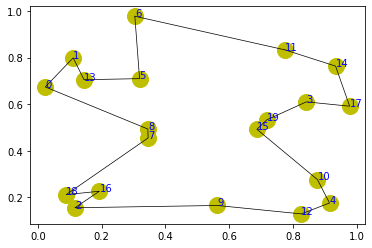

step:2910/5000, actic loss:-0.454, critic loss:0.486, L:4.766, 0min0sec
step:2911/5000, actic loss:-0.454, critic loss:0.486, L:4.766, 0min0sec
step:2912/5000, actic loss:-0.454, critic loss:0.486, L:4.766, 0min0sec
step:2913/5000, actic loss:-0.454, critic loss:0.486, L:4.766, 0min0sec
step:2914/5000, actic loss:-0.454, critic loss:0.486, L:4.766, 0min0sec
distance:3.760
tensor([ 9, 16, 14,  6, 17, 10, 13,  4,  3,  8, 18,  1,  2, 12,  5, 11, 19,  0,
        15,  7])


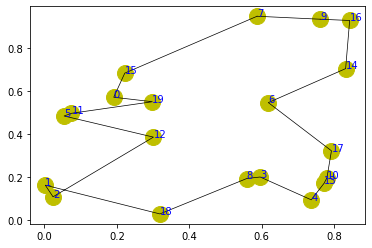

step:2915/5000, actic loss:-0.453, critic loss:0.485, L:4.765, 0min0sec
step:2916/5000, actic loss:-0.453, critic loss:0.485, L:4.765, 0min0sec
step:2917/5000, actic loss:-0.453, critic loss:0.485, L:4.765, 0min0sec
step:2918/5000, actic loss:-0.453, critic loss:0.485, L:4.765, 0min0sec
step:2919/5000, actic loss:-0.453, critic loss:0.485, L:4.765, 0min0sec
distance:4.896
tensor([ 4, 15,  6, 11, 12,  2,  5, 17, 19,  0, 18, 14,  7,  3, 16,  1,  9,  8,
        10, 13])


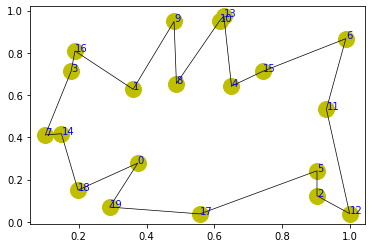

step:2920/5000, actic loss:-0.453, critic loss:0.485, L:4.764, 0min0sec
step:2921/5000, actic loss:-0.453, critic loss:0.485, L:4.764, 0min0sec
step:2922/5000, actic loss:-0.452, critic loss:0.485, L:4.764, 0min0sec
step:2923/5000, actic loss:-0.452, critic loss:0.484, L:4.764, 0min0sec
step:2924/5000, actic loss:-0.452, critic loss:0.484, L:4.764, 0min0sec
distance:3.851
tensor([ 6, 15, 18,  4, 16, 10,  7,  1, 14,  3, 12, 11,  2,  5,  0, 19, 17, 13,
         9,  8])


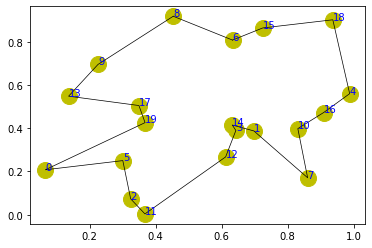

step:2925/5000, actic loss:-0.452, critic loss:0.484, L:4.764, 0min0sec
step:2926/5000, actic loss:-0.452, critic loss:0.484, L:4.763, 0min0sec
step:2927/5000, actic loss:-0.452, critic loss:0.484, L:4.763, 0min0sec
step:2928/5000, actic loss:-0.452, critic loss:0.484, L:4.763, 0min0sec
step:2929/5000, actic loss:-0.451, critic loss:0.484, L:4.763, 0min0sec
distance:3.783
tensor([10, 12, 16, 14,  9,  8, 17, 13,  0,  5, 18,  7, 15, 11,  2,  6, 19,  1,
         3,  4])


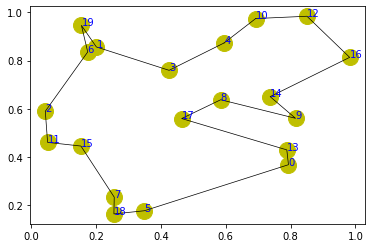

step:2930/5000, actic loss:-0.451, critic loss:0.484, L:4.763, 0min0sec
step:2931/5000, actic loss:-0.451, critic loss:0.483, L:4.762, 0min0sec
step:2932/5000, actic loss:-0.451, critic loss:0.483, L:4.762, 0min0sec
step:2933/5000, actic loss:-0.451, critic loss:0.483, L:4.762, 0min0sec
step:2934/5000, actic loss:-0.451, critic loss:0.483, L:4.762, 0min0sec
distance:4.748
tensor([ 4, 13, 18,  7,  9, 15, 16, 10,  5, 17,  0,  1, 12,  3, 11,  6, 19, 14,
         2,  8])


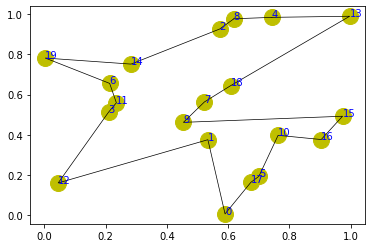

step:2935/5000, actic loss:-0.451, critic loss:0.483, L:4.762, 0min0sec
step:2936/5000, actic loss:-0.450, critic loss:0.483, L:4.762, 0min0sec
step:2937/5000, actic loss:-0.450, critic loss:0.483, L:4.761, 0min0sec
step:2938/5000, actic loss:-0.450, critic loss:0.482, L:4.761, 0min0sec
step:2939/5000, actic loss:-0.450, critic loss:0.482, L:4.761, 0min0sec
distance:4.254
tensor([15,  7, 14, 18,  0, 13,  1,  3, 19,  4, 12,  6,  2,  8, 10,  9,  5, 11,
        17, 16])


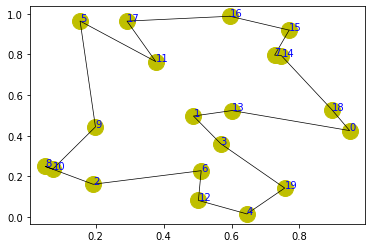

step:2940/5000, actic loss:-0.450, critic loss:0.482, L:4.761, 0min0sec
step:2941/5000, actic loss:-0.450, critic loss:0.482, L:4.761, 0min0sec
step:2942/5000, actic loss:-0.450, critic loss:0.482, L:4.761, 0min0sec
step:2943/5000, actic loss:-0.450, critic loss:0.482, L:4.760, 0min0sec
step:2944/5000, actic loss:-0.449, critic loss:0.482, L:4.760, 0min0sec
distance:4.825
tensor([ 1,  6, 17, 18, 15,  5, 12, 13,  7, 19,  2,  3,  4,  0, 11, 10, 16,  8,
        14,  9])


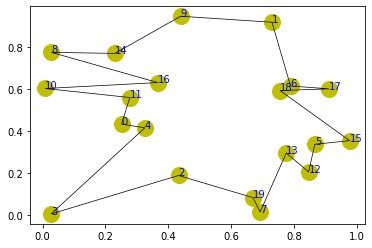

step:2945/5000, actic loss:-0.449, critic loss:0.482, L:4.760, 0min0sec
step:2946/5000, actic loss:-0.449, critic loss:0.481, L:4.760, 0min0sec
step:2947/5000, actic loss:-0.449, critic loss:0.481, L:4.760, 0min0sec
step:2948/5000, actic loss:-0.449, critic loss:0.481, L:4.760, 0min0sec
step:2949/5000, actic loss:-0.449, critic loss:0.481, L:4.760, 0min0sec
distance:4.703
tensor([ 3,  9,  0, 14,  2,  6,  1, 18,  5,  8, 10,  7, 17, 15, 13, 11, 16, 12,
        19,  4])


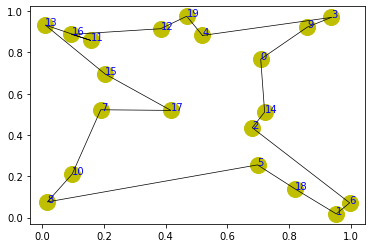

step:2950/5000, actic loss:-0.449, critic loss:0.481, L:4.759, 0min0sec
step:2951/5000, actic loss:-0.449, critic loss:0.481, L:4.759, 0min0sec
step:2952/5000, actic loss:-0.449, critic loss:0.481, L:4.759, 0min0sec
step:2953/5000, actic loss:-0.449, critic loss:0.481, L:4.759, 0min0sec
step:2954/5000, actic loss:-0.448, critic loss:0.481, L:4.759, 0min0sec
distance:4.823
tensor([19, 12,  7,  5,  2,  4,  1, 14, 10, 18, 17,  8,  3,  0,  9, 11, 16, 13,
        15,  6])


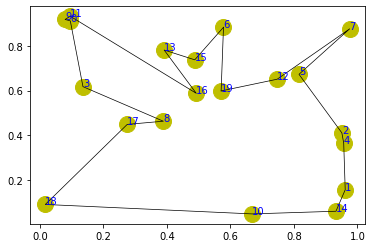

step:2955/5000, actic loss:-0.448, critic loss:0.480, L:4.759, 0min0sec
step:2956/5000, actic loss:-0.448, critic loss:0.480, L:4.758, 0min0sec
step:2957/5000, actic loss:-0.448, critic loss:0.480, L:4.758, 0min0sec
step:2958/5000, actic loss:-0.448, critic loss:0.480, L:4.758, 0min0sec
step:2959/5000, actic loss:-0.448, critic loss:0.480, L:4.758, 0min0sec
distance:4.693
tensor([ 3,  4,  8,  7,  1,  0, 18, 10, 15,  9, 14, 16, 12,  5, 19, 17, 13,  2,
         6, 11])


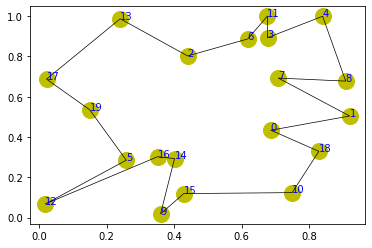

step:2960/5000, actic loss:-0.448, critic loss:0.480, L:4.758, 0min0sec
step:2961/5000, actic loss:-0.448, critic loss:0.480, L:4.757, 0min0sec
step:2962/5000, actic loss:-0.447, critic loss:0.480, L:4.757, 0min0sec
step:2963/5000, actic loss:-0.447, critic loss:0.479, L:4.757, 0min0sec
step:2964/5000, actic loss:-0.447, critic loss:0.479, L:4.757, 0min0sec
distance:4.514
tensor([15,  7, 11,  5, 12,  1,  9, 13,  6, 10, 16,  4,  3, 14,  8, 19,  0, 17,
         2, 18])


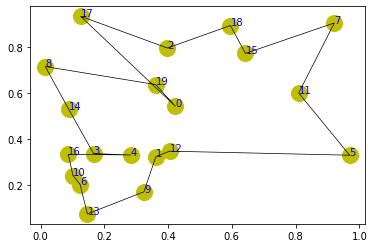

step:2965/5000, actic loss:-0.447, critic loss:0.479, L:4.757, 0min1sec
step:2966/5000, actic loss:-0.447, critic loss:0.479, L:4.757, 0min0sec
step:2967/5000, actic loss:-0.447, critic loss:0.479, L:4.756, 0min0sec
step:2968/5000, actic loss:-0.447, critic loss:0.479, L:4.756, 0min0sec
step:2969/5000, actic loss:-0.447, critic loss:0.479, L:4.756, 0min0sec
distance:4.828
tensor([19, 13,  0,  7, 10, 15, 18,  1,  5,  9, 17, 12,  6,  8, 16, 14,  2,  4,
        11,  3])


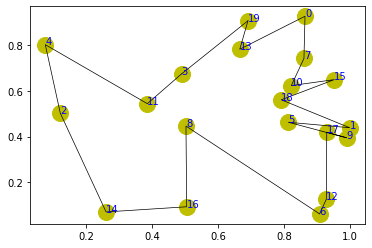

step:2970/5000, actic loss:-0.447, critic loss:0.479, L:4.756, 0min1sec
step:2971/5000, actic loss:-0.446, critic loss:0.479, L:4.756, 0min0sec
step:2972/5000, actic loss:-0.446, critic loss:0.478, L:4.756, 0min0sec
step:2973/5000, actic loss:-0.446, critic loss:0.478, L:4.755, 0min0sec
step:2974/5000, actic loss:-0.446, critic loss:0.478, L:4.755, 0min0sec
distance:4.117
tensor([ 7,  6, 17,  9, 19,  8,  4, 15, 11, 16,  5, 10, 14, 12,  2,  3,  0, 13,
         1, 18])


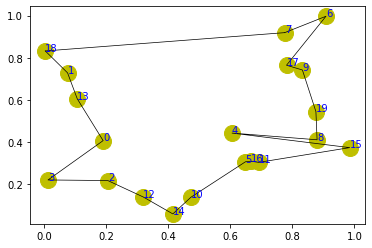

step:2975/5000, actic loss:-0.446, critic loss:0.478, L:4.755, 0min0sec
step:2976/5000, actic loss:-0.446, critic loss:0.478, L:4.755, 0min0sec
step:2977/5000, actic loss:-0.446, critic loss:0.478, L:4.755, 0min0sec
step:2978/5000, actic loss:-0.446, critic loss:0.478, L:4.755, 0min0sec
step:2979/5000, actic loss:-0.446, critic loss:0.478, L:4.754, 0min0sec
distance:4.899
tensor([ 8,  6, 17, 12, 15,  0, 18,  9, 10,  7, 13,  1, 19,  3,  2,  4, 14, 11,
        16,  5])


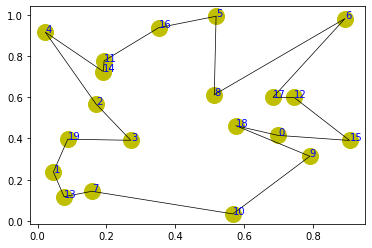

step:2980/5000, actic loss:-0.445, critic loss:0.477, L:4.754, 0min0sec
step:2981/5000, actic loss:-0.445, critic loss:0.477, L:4.754, 0min0sec
step:2982/5000, actic loss:-0.445, critic loss:0.477, L:4.754, 0min0sec
step:2983/5000, actic loss:-0.445, critic loss:0.477, L:4.754, 0min0sec
step:2984/5000, actic loss:-0.445, critic loss:0.477, L:4.754, 0min0sec
distance:4.373
tensor([19, 18,  0, 10, 13,  7,  3, 11, 16,  9,  2, 15, 14,  6,  4,  5,  1, 17,
         8, 12])


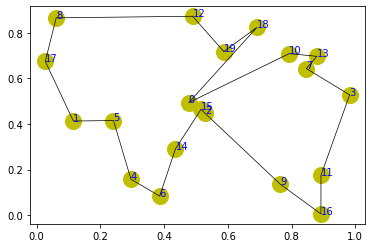

step:2985/5000, actic loss:-0.445, critic loss:0.477, L:4.754, 0min0sec
step:2986/5000, actic loss:-0.444, critic loss:0.477, L:4.753, 0min0sec
step:2987/5000, actic loss:-0.444, critic loss:0.477, L:4.753, 0min0sec
step:2988/5000, actic loss:-0.444, critic loss:0.477, L:4.753, 0min0sec
step:2989/5000, actic loss:-0.444, critic loss:0.476, L:4.753, 0min0sec
distance:3.792
tensor([14,  1, 13, 18,  7,  9, 11,  2,  4, 12, 16, 17, 15,  0,  5, 19,  8,  6,
        10,  3])


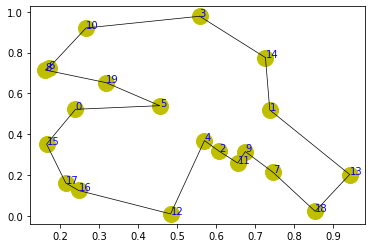

step:2990/5000, actic loss:-0.444, critic loss:0.476, L:4.753, 0min0sec
step:2991/5000, actic loss:-0.444, critic loss:0.476, L:4.753, 0min0sec
step:2992/5000, actic loss:-0.444, critic loss:0.476, L:4.753, 0min0sec
step:2993/5000, actic loss:-0.444, critic loss:0.476, L:4.752, 0min0sec
step:2994/5000, actic loss:-0.443, critic loss:0.476, L:4.752, 0min0sec
distance:3.889
tensor([13, 12, 16, 19, 11, 15, 10, 17, 18,  3,  4,  0,  6,  7,  8,  9,  2,  1,
         5, 14])


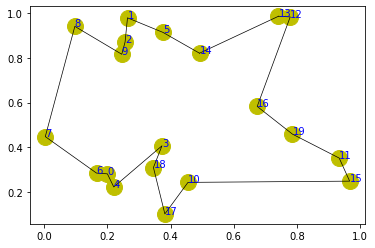

step:2995/5000, actic loss:-0.443, critic loss:0.476, L:4.752, 0min0sec
step:2996/5000, actic loss:-0.444, critic loss:0.476, L:4.752, 0min0sec
step:2997/5000, actic loss:-0.444, critic loss:0.476, L:4.752, 0min0sec
step:2998/5000, actic loss:-0.443, critic loss:0.475, L:4.752, 0min0sec
step:2999/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
distance:4.392
tensor([16,  8,  3, 11, 19,  4,  7, 13, 12, 18, 15,  9,  2, 10,  1,  5, 17, 14,
         6,  0])


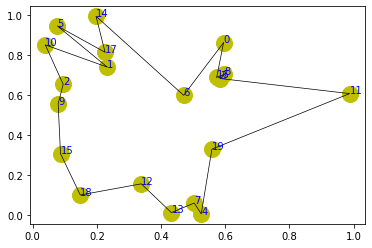

step:3000/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
step:3001/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
step:3002/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
step:3003/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
step:3004/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
distance:4.662
tensor([ 0, 14,  4,  3,  6, 15,  7, 10,  8, 17, 13,  9,  2, 12,  5, 19, 11, 16,
         1, 18])


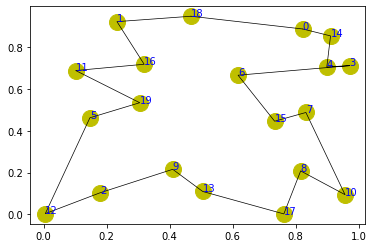

step:3005/5000, actic loss:-0.443, critic loss:0.475, L:4.751, 0min0sec
step:3006/5000, actic loss:-0.442, critic loss:0.475, L:4.750, 0min0sec
step:3007/5000, actic loss:-0.442, critic loss:0.474, L:4.750, 0min0sec
step:3008/5000, actic loss:-0.442, critic loss:0.474, L:4.750, 0min0sec
step:3009/5000, actic loss:-0.442, critic loss:0.474, L:4.750, 0min0sec
distance:3.875
tensor([ 9, 13,  2,  6, 14,  5,  7, 11,  4, 17, 16, 12, 15,  8,  3, 18, 19, 10,
         0,  1])


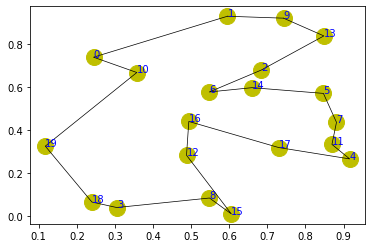

step:3010/5000, actic loss:-0.442, critic loss:0.474, L:4.750, 0min0sec
step:3011/5000, actic loss:-0.442, critic loss:0.474, L:4.750, 0min0sec
step:3012/5000, actic loss:-0.442, critic loss:0.474, L:4.750, 0min0sec
step:3013/5000, actic loss:-0.442, critic loss:0.474, L:4.749, 0min0sec
step:3014/5000, actic loss:-0.441, critic loss:0.474, L:4.749, 0min0sec
distance:3.186
tensor([ 9,  7, 10, 13,  6,  3,  8,  0, 16,  5, 11,  1,  2,  4, 19, 18, 15, 12,
        17, 14])


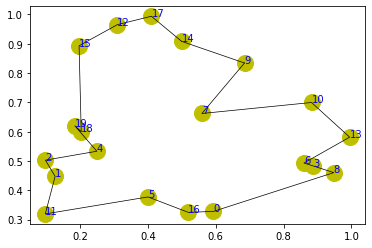

step:3015/5000, actic loss:-0.441, critic loss:0.473, L:4.749, 0min0sec
step:3016/5000, actic loss:-0.441, critic loss:0.473, L:4.749, 0min0sec
step:3017/5000, actic loss:-0.441, critic loss:0.473, L:4.749, 0min0sec
step:3018/5000, actic loss:-0.441, critic loss:0.473, L:4.749, 0min0sec
step:3019/5000, actic loss:-0.441, critic loss:0.473, L:4.749, 0min0sec
distance:3.828
tensor([12,  2,  9,  0, 16,  1, 18, 13,  7,  3, 10, 17,  6,  5, 15, 19, 11,  4,
         8, 14])


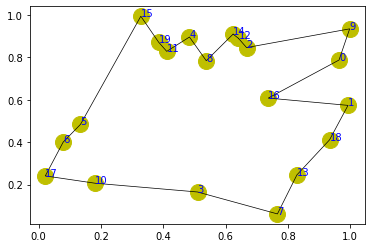

step:3020/5000, actic loss:-0.441, critic loss:0.473, L:4.748, 0min0sec
step:3021/5000, actic loss:-0.441, critic loss:0.473, L:4.748, 0min0sec
step:3022/5000, actic loss:-0.440, critic loss:0.473, L:4.748, 0min0sec
step:3023/5000, actic loss:-0.440, critic loss:0.473, L:4.748, 0min0sec
step:3024/5000, actic loss:-0.440, critic loss:0.472, L:4.748, 0min0sec
distance:3.853
tensor([10,  7,  9, 19,  5, 14, 17, 13,  0, 12,  3,  2, 11, 18,  4,  1, 15,  6,
         8, 16])


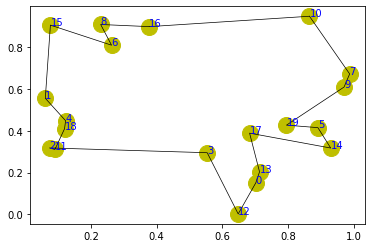

step:3025/5000, actic loss:-0.440, critic loss:0.472, L:4.748, 0min0sec
step:3026/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
step:3027/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
step:3028/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
step:3029/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
distance:4.626
tensor([10,  5, 19, 16,  4,  2,  9, 18, 17,  1,  7,  3,  0,  6, 11,  8, 14, 13,
        15, 12])


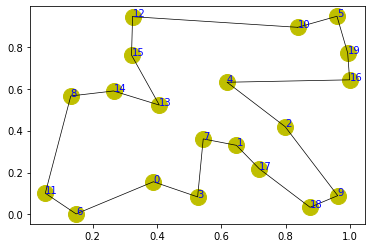

step:3030/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
step:3031/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
step:3032/5000, actic loss:-0.440, critic loss:0.472, L:4.747, 0min0sec
step:3033/5000, actic loss:-0.439, critic loss:0.471, L:4.746, 0min0sec
step:3034/5000, actic loss:-0.439, critic loss:0.471, L:4.746, 0min0sec
distance:4.322
tensor([ 6,  8, 11, 16,  0, 17,  5,  2, 12,  9,  3, 19, 13, 18,  4,  1,  7, 15,
        14, 10])


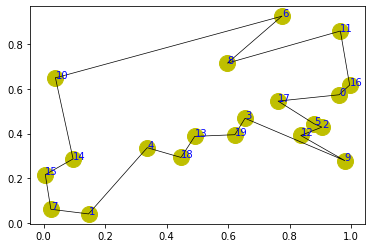

step:3035/5000, actic loss:-0.439, critic loss:0.471, L:4.746, 0min0sec
step:3036/5000, actic loss:-0.438, critic loss:0.471, L:4.746, 0min0sec
step:3037/5000, actic loss:-0.438, critic loss:0.471, L:4.746, 0min0sec
step:3038/5000, actic loss:-0.438, critic loss:0.471, L:4.746, 0min0sec
step:3039/5000, actic loss:-0.438, critic loss:0.471, L:4.746, 0min0sec
distance:4.660
tensor([16,  5, 18,  6, 12, 15,  7, 17,  3,  2, 14,  4, 13,  9, 11,  8,  1,  0,
        19, 10])


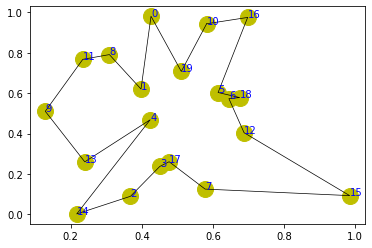

step:3040/5000, actic loss:-0.438, critic loss:0.471, L:4.745, 0min0sec
step:3041/5000, actic loss:-0.438, critic loss:0.471, L:4.745, 0min0sec
step:3042/5000, actic loss:-0.438, critic loss:0.470, L:4.745, 0min0sec
step:3043/5000, actic loss:-0.438, critic loss:0.470, L:4.745, 0min0sec
step:3044/5000, actic loss:-0.438, critic loss:0.470, L:4.745, 0min0sec
distance:4.065
tensor([ 9,  4, 18,  1,  6, 14, 11, 16,  0, 10, 12, 15, 13, 17,  8, 19,  7,  5,
         2,  3])


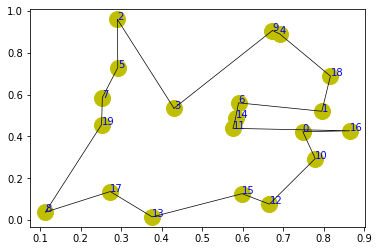

step:3045/5000, actic loss:-0.437, critic loss:0.470, L:4.745, 0min0sec
step:3046/5000, actic loss:-0.437, critic loss:0.470, L:4.744, 0min0sec
step:3047/5000, actic loss:-0.437, critic loss:0.470, L:4.744, 0min0sec
step:3048/5000, actic loss:-0.437, critic loss:0.470, L:4.744, 0min0sec
step:3049/5000, actic loss:-0.437, critic loss:0.470, L:4.744, 0min0sec
distance:3.872
tensor([12, 10,  7, 11, 15,  8,  3,  0,  5, 13, 16,  4, 14, 19,  6,  9,  1, 18,
         2, 17])


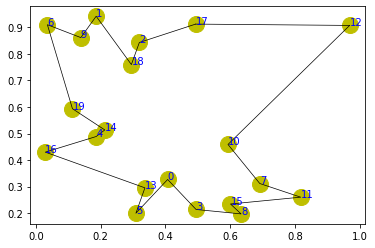

step:3050/5000, actic loss:-0.437, critic loss:0.470, L:4.744, 0min0sec
step:3051/5000, actic loss:-0.437, critic loss:0.469, L:4.744, 0min0sec
step:3052/5000, actic loss:-0.436, critic loss:0.469, L:4.744, 0min0sec
step:3053/5000, actic loss:-0.436, critic loss:0.469, L:4.743, 0min0sec
step:3054/5000, actic loss:-0.436, critic loss:0.469, L:4.743, 0min0sec
distance:3.881
tensor([ 2,  8,  4, 15, 13, 12,  7, 14,  1,  0, 16,  5,  9, 17, 19, 18, 11,  6,
         3, 10])


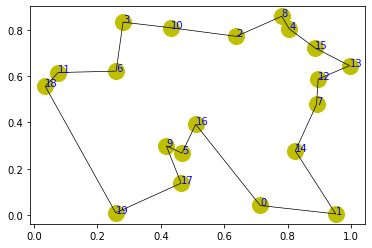

step:3055/5000, actic loss:-0.436, critic loss:0.469, L:4.743, 0min0sec
step:3056/5000, actic loss:-0.436, critic loss:0.469, L:4.743, 0min0sec
step:3057/5000, actic loss:-0.436, critic loss:0.469, L:4.743, 0min0sec
step:3058/5000, actic loss:-0.436, critic loss:0.469, L:4.743, 0min0sec
step:3059/5000, actic loss:-0.436, critic loss:0.468, L:4.742, 0min0sec
distance:4.557
tensor([ 7,  5, 10,  4,  1, 14, 18,  6, 12, 19, 16, 13, 11, 15,  3,  8, 17,  2,
         9,  0])


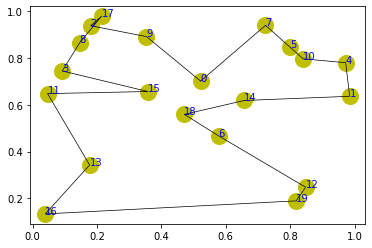

step:3060/5000, actic loss:-0.436, critic loss:0.468, L:4.742, 0min0sec
step:3061/5000, actic loss:-0.435, critic loss:0.468, L:4.742, 0min0sec
step:3062/5000, actic loss:-0.435, critic loss:0.468, L:4.742, 0min0sec
step:3063/5000, actic loss:-0.435, critic loss:0.468, L:4.742, 0min0sec
step:3064/5000, actic loss:-0.435, critic loss:0.468, L:4.742, 0min0sec
distance:4.009
tensor([ 5,  7,  3, 12, 11, 10, 18,  2,  1,  8, 15, 14, 19, 13,  6,  4, 17,  0,
        16,  9])


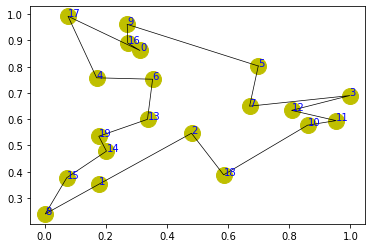

step:3065/5000, actic loss:-0.435, critic loss:0.468, L:4.741, 0min0sec
step:3066/5000, actic loss:-0.435, critic loss:0.468, L:4.741, 0min0sec
step:3067/5000, actic loss:-0.435, critic loss:0.468, L:4.741, 0min0sec
step:3068/5000, actic loss:-0.434, critic loss:0.467, L:4.741, 0min0sec
step:3069/5000, actic loss:-0.434, critic loss:0.467, L:4.741, 0min0sec
distance:4.924
tensor([13,  1,  0,  6,  5, 15, 12,  7, 11, 10,  3, 19, 14,  9,  8, 18,  2, 17,
        16,  4])


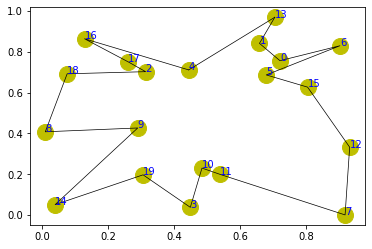

step:3070/5000, actic loss:-0.434, critic loss:0.467, L:4.741, 0min0sec
step:3071/5000, actic loss:-0.434, critic loss:0.467, L:4.740, 0min0sec
step:3072/5000, actic loss:-0.434, critic loss:0.467, L:4.740, 0min0sec
step:3073/5000, actic loss:-0.434, critic loss:0.467, L:4.740, 0min0sec
step:3074/5000, actic loss:-0.434, critic loss:0.467, L:4.740, 0min0sec
distance:3.522
tensor([ 9, 11, 13,  8,  3, 14,  6,  4,  1,  7, 10, 18, 12, 16,  5, 17, 15, 19,
         2,  0])


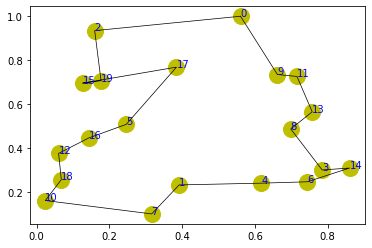

step:3075/5000, actic loss:-0.434, critic loss:0.467, L:4.740, 0min0sec
step:3076/5000, actic loss:-0.434, critic loss:0.466, L:4.740, 0min0sec
step:3077/5000, actic loss:-0.434, critic loss:0.466, L:4.739, 0min0sec
step:3078/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
step:3079/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
distance:3.836
tensor([14,  6,  8, 18, 16, 12, 10, 15, 19, 13,  2,  4, 17,  5,  7,  0,  3,  9,
        11,  1])


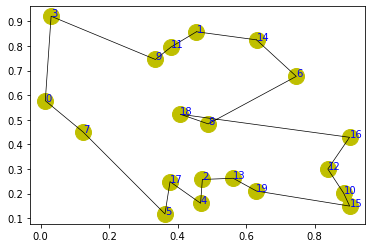

step:3080/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
step:3081/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
step:3082/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
step:3083/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
step:3084/5000, actic loss:-0.433, critic loss:0.466, L:4.739, 0min0sec
distance:4.626
tensor([ 6, 11, 17,  0, 10,  3, 15,  9, 18,  2,  4,  7,  1, 19, 12, 16,  8,  5,
        13, 14])


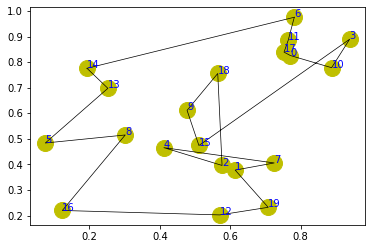

step:3085/5000, actic loss:-0.433, critic loss:0.466, L:4.738, 0min0sec
step:3086/5000, actic loss:-0.433, critic loss:0.465, L:4.738, 0min0sec
step:3087/5000, actic loss:-0.432, critic loss:0.465, L:4.738, 0min0sec
step:3088/5000, actic loss:-0.432, critic loss:0.465, L:4.738, 0min0sec
step:3089/5000, actic loss:-0.432, critic loss:0.465, L:4.738, 0min0sec
distance:4.348
tensor([ 9,  3, 13,  6,  1,  5, 11, 17,  8, 19, 10,  2, 14,  4, 16, 18,  0, 12,
        15,  7])


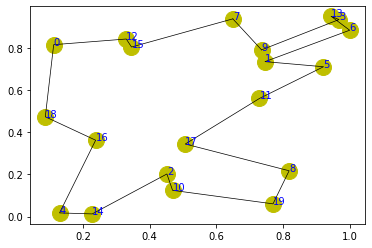

step:3090/5000, actic loss:-0.432, critic loss:0.465, L:4.738, 0min0sec
step:3091/5000, actic loss:-0.432, critic loss:0.465, L:4.738, 0min0sec
step:3092/5000, actic loss:-0.432, critic loss:0.465, L:4.738, 0min0sec
step:3093/5000, actic loss:-0.432, critic loss:0.465, L:4.737, 0min0sec
step:3094/5000, actic loss:-0.432, critic loss:0.465, L:4.737, 0min1sec
distance:4.382
tensor([ 1,  8, 11, 12,  0, 13,  2,  9,  7,  5,  3,  4, 10, 19, 16,  6, 14, 18,
        15, 17])


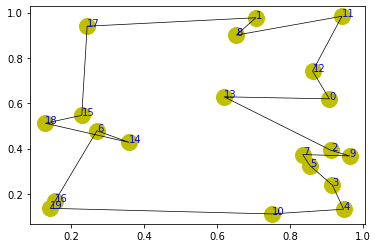

step:3095/5000, actic loss:-0.432, critic loss:0.464, L:4.737, 0min1sec
step:3096/5000, actic loss:-0.431, critic loss:0.464, L:4.737, 0min0sec
step:3097/5000, actic loss:-0.431, critic loss:0.464, L:4.737, 0min0sec
step:3098/5000, actic loss:-0.431, critic loss:0.464, L:4.737, 0min0sec
step:3099/5000, actic loss:-0.431, critic loss:0.464, L:4.737, 0min0sec
distance:3.718
tensor([16, 17,  2, 10,  7, 18, 14,  6,  8, 15,  5,  3, 11,  1, 19,  9,  0, 12,
         4, 13])


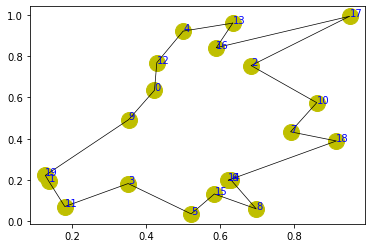

step:3100/5000, actic loss:-0.431, critic loss:0.464, L:4.737, 0min0sec
step:3101/5000, actic loss:-0.431, critic loss:0.464, L:4.736, 0min0sec
step:3102/5000, actic loss:-0.431, critic loss:0.464, L:4.736, 0min0sec
step:3103/5000, actic loss:-0.431, critic loss:0.464, L:4.736, 0min0sec
step:3104/5000, actic loss:-0.430, critic loss:0.463, L:4.736, 0min0sec
distance:5.023
tensor([13, 12, 10, 17,  1,  7,  3, 16,  9,  6, 19,  5,  2,  0, 15,  8,  4, 18,
        11, 14])


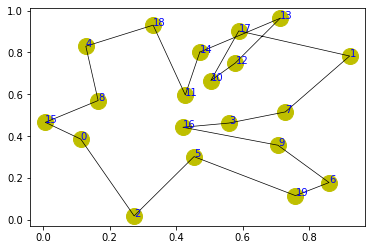

step:3105/5000, actic loss:-0.430, critic loss:0.463, L:4.736, 0min0sec
step:3106/5000, actic loss:-0.430, critic loss:0.463, L:4.736, 0min0sec
step:3107/5000, actic loss:-0.430, critic loss:0.463, L:4.735, 0min0sec
step:3108/5000, actic loss:-0.430, critic loss:0.463, L:4.735, 0min0sec
step:3109/5000, actic loss:-0.430, critic loss:0.463, L:4.735, 0min0sec
distance:4.866
tensor([ 7,  0,  1, 11,  8, 14,  9, 18, 17, 13, 19,  3,  6, 12, 10,  2, 15, 16,
         4,  5])


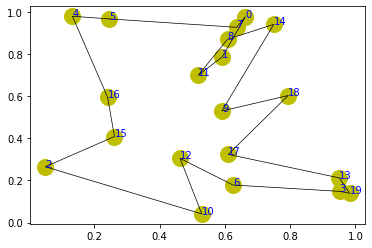

step:3110/5000, actic loss:-0.430, critic loss:0.463, L:4.735, 0min0sec
step:3111/5000, actic loss:-0.430, critic loss:0.463, L:4.735, 0min0sec
step:3112/5000, actic loss:-0.430, critic loss:0.463, L:4.735, 0min0sec
step:3113/5000, actic loss:-0.429, critic loss:0.462, L:4.735, 0min0sec
step:3114/5000, actic loss:-0.429, critic loss:0.462, L:4.734, 0min0sec
distance:3.962
tensor([13, 10,  9, 16,  6,  4,  5, 12, 17,  3,  7,  0, 19, 14, 11, 15,  2, 18,
         1,  8])


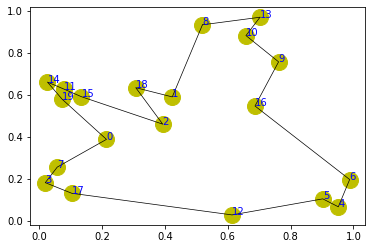

step:3115/5000, actic loss:-0.429, critic loss:0.462, L:4.734, 0min0sec
step:3116/5000, actic loss:-0.429, critic loss:0.462, L:4.734, 0min0sec
step:3117/5000, actic loss:-0.429, critic loss:0.462, L:4.734, 0min0sec
step:3118/5000, actic loss:-0.429, critic loss:0.462, L:4.734, 0min0sec
step:3119/5000, actic loss:-0.429, critic loss:0.462, L:4.734, 0min0sec
distance:5.383
tensor([ 9,  5,  6, 15, 12,  2,  4, 16, 14,  0, 19, 10, 13,  8, 11, 17,  1,  3,
         7, 18])


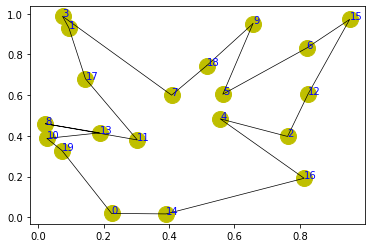

step:3120/5000, actic loss:-0.428, critic loss:0.462, L:4.734, 0min0sec
step:3121/5000, actic loss:-0.428, critic loss:0.462, L:4.733, 0min0sec
step:3122/5000, actic loss:-0.428, critic loss:0.461, L:4.733, 0min0sec
step:3123/5000, actic loss:-0.428, critic loss:0.461, L:4.733, 0min0sec
step:3124/5000, actic loss:-0.428, critic loss:0.461, L:4.733, 0min0sec
distance:3.746
tensor([ 9, 11,  6, 19,  7, 17,  8, 16,  1, 14, 13,  5,  4, 18,  2,  0, 10,  3,
        12, 15])


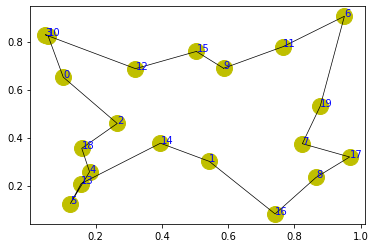

step:3125/5000, actic loss:-0.428, critic loss:0.461, L:4.733, 0min0sec
step:3126/5000, actic loss:-0.428, critic loss:0.461, L:4.733, 0min0sec
step:3127/5000, actic loss:-0.428, critic loss:0.461, L:4.732, 0min0sec
step:3128/5000, actic loss:-0.427, critic loss:0.461, L:4.732, 0min0sec
step:3129/5000, actic loss:-0.427, critic loss:0.461, L:4.732, 0min0sec
distance:4.159
tensor([19, 17,  9,  8, 13,  3, 16,  6,  5,  4, 14,  0, 12, 15,  1,  2, 11, 18,
        10,  7])


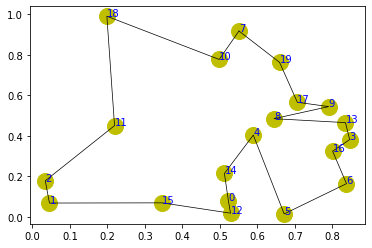

step:3130/5000, actic loss:-0.427, critic loss:0.461, L:4.732, 0min0sec
step:3131/5000, actic loss:-0.427, critic loss:0.460, L:4.732, 0min0sec
step:3132/5000, actic loss:-0.427, critic loss:0.460, L:4.732, 0min0sec
step:3133/5000, actic loss:-0.427, critic loss:0.460, L:4.732, 0min0sec
step:3134/5000, actic loss:-0.427, critic loss:0.460, L:4.731, 0min0sec
distance:4.237
tensor([ 1, 19, 14, 11,  9,  0, 12, 17,  5, 18,  4, 15, 13,  3, 16,  8,  6,  7,
         2, 10])


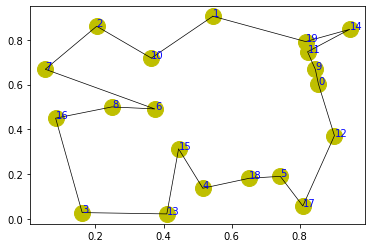

step:3135/5000, actic loss:-0.427, critic loss:0.460, L:4.731, 0min0sec
step:3136/5000, actic loss:-0.426, critic loss:0.460, L:4.731, 0min0sec
step:3137/5000, actic loss:-0.426, critic loss:0.460, L:4.731, 0min0sec
step:3138/5000, actic loss:-0.426, critic loss:0.460, L:4.731, 0min0sec
step:3139/5000, actic loss:-0.426, critic loss:0.460, L:4.731, 0min0sec
distance:3.805
tensor([ 8,  7, 16, 19,  4, 12,  0, 18, 17, 14,  3,  9,  6,  2,  5, 15,  1, 13,
        11, 10])


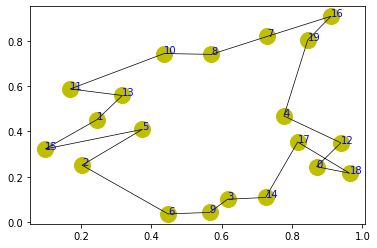

step:3140/5000, actic loss:-0.426, critic loss:0.460, L:4.730, 0min0sec
step:3141/5000, actic loss:-0.426, critic loss:0.459, L:4.730, 0min0sec
step:3142/5000, actic loss:-0.426, critic loss:0.459, L:4.730, 0min0sec
step:3143/5000, actic loss:-0.426, critic loss:0.459, L:4.730, 0min0sec
step:3144/5000, actic loss:-0.425, critic loss:0.459, L:4.730, 0min0sec
distance:4.950
tensor([14, 19,  7, 15,  0,  9, 10,  3,  1, 16,  5,  2, 17, 11, 12,  6, 18,  4,
        13,  8])


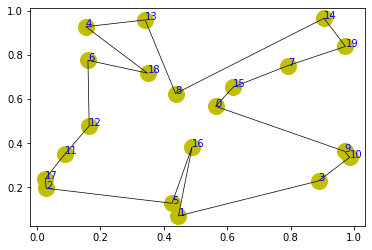

step:3145/5000, actic loss:-0.425, critic loss:0.459, L:4.730, 0min0sec
step:3146/5000, actic loss:-0.425, critic loss:0.459, L:4.730, 0min0sec
step:3147/5000, actic loss:-0.425, critic loss:0.459, L:4.729, 0min0sec
step:3148/5000, actic loss:-0.425, critic loss:0.459, L:4.729, 0min0sec
step:3149/5000, actic loss:-0.425, critic loss:0.459, L:4.729, 0min0sec
distance:4.261
tensor([16,  2,  4, 13, 10,  5,  7,  3, 15,  8,  1, 11, 19,  6, 14, 17, 12,  0,
         9, 18])


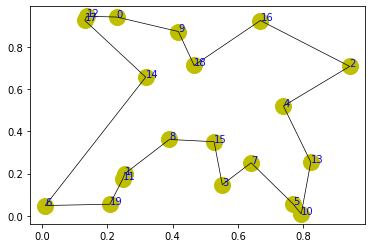

step:3150/5000, actic loss:-0.425, critic loss:0.458, L:4.729, 0min0sec
step:3151/5000, actic loss:-0.425, critic loss:0.458, L:4.729, 0min0sec
step:3152/5000, actic loss:-0.425, critic loss:0.458, L:4.729, 0min0sec
step:3153/5000, actic loss:-0.424, critic loss:0.458, L:4.729, 0min0sec
step:3154/5000, actic loss:-0.424, critic loss:0.458, L:4.728, 0min0sec
distance:4.045
tensor([ 3, 19,  1, 16,  5, 13, 10,  7, 17, 15,  9, 14, 11,  2,  0, 12,  4, 18,
         8,  6])


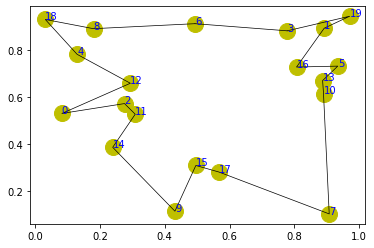

step:3155/5000, actic loss:-0.424, critic loss:0.458, L:4.728, 0min0sec
step:3156/5000, actic loss:-0.424, critic loss:0.458, L:4.728, 0min0sec
step:3157/5000, actic loss:-0.424, critic loss:0.458, L:4.728, 0min0sec
step:3158/5000, actic loss:-0.424, critic loss:0.458, L:4.728, 0min0sec
step:3159/5000, actic loss:-0.424, critic loss:0.457, L:4.728, 0min0sec
distance:4.335
tensor([13, 11,  9,  3,  8,  6, 10, 14, 18,  7, 19, 15, 16,  2,  5, 17,  1, 12,
         4,  0])


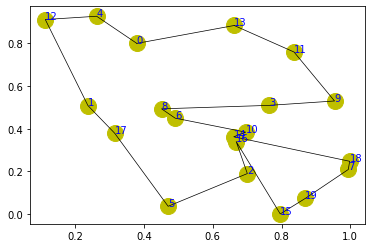

step:3160/5000, actic loss:-0.424, critic loss:0.457, L:4.727, 0min0sec
step:3161/5000, actic loss:-0.424, critic loss:0.457, L:4.727, 0min0sec
step:3162/5000, actic loss:-0.423, critic loss:0.457, L:4.727, 0min0sec
step:3163/5000, actic loss:-0.423, critic loss:0.457, L:4.727, 0min0sec
step:3164/5000, actic loss:-0.423, critic loss:0.457, L:4.727, 0min0sec
distance:3.968
tensor([14, 10,  5,  3, 15, 16, 13,  6,  0, 12,  4, 11,  7, 17, 19,  8,  9,  2,
         1, 18])


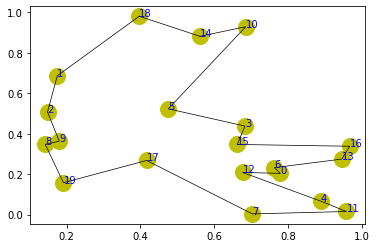

step:3165/5000, actic loss:-0.423, critic loss:0.457, L:4.727, 0min1sec
step:3166/5000, actic loss:-0.423, critic loss:0.457, L:4.727, 0min0sec
step:3167/5000, actic loss:-0.423, critic loss:0.457, L:4.727, 0min0sec
step:3168/5000, actic loss:-0.423, critic loss:0.456, L:4.726, 0min0sec
step:3169/5000, actic loss:-0.423, critic loss:0.456, L:4.726, 0min0sec
distance:4.270
tensor([17,  4,  7, 13, 12,  2, 16, 19, 18,  1, 11,  3,  9,  5,  6,  0, 14,  8,
        15, 10])


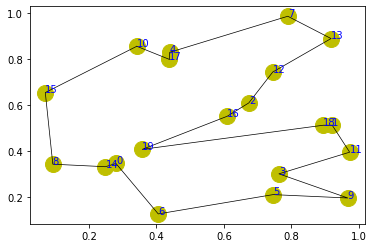

step:3170/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min0sec
step:3171/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min1sec
step:3172/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min0sec
step:3173/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min0sec
step:3174/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min0sec
distance:3.998
tensor([ 9, 13, 12, 18,  3, 19, 16,  6, 10,  8,  5, 14,  2,  4, 11, 15,  1, 17,
         7,  0])


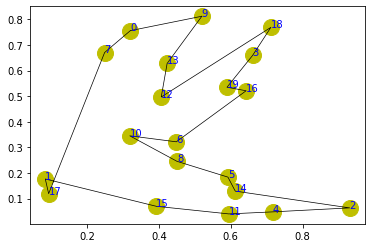

step:3175/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min0sec
step:3176/5000, actic loss:-0.422, critic loss:0.456, L:4.726, 0min0sec
step:3177/5000, actic loss:-0.421, critic loss:0.456, L:4.726, 0min0sec
step:3178/5000, actic loss:-0.421, critic loss:0.455, L:4.726, 0min0sec
step:3179/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
distance:4.593
tensor([18,  3,  0,  8, 19,  6,  7, 12, 14,  4,  2, 11, 16,  9,  1, 17,  5, 15,
        13, 10])


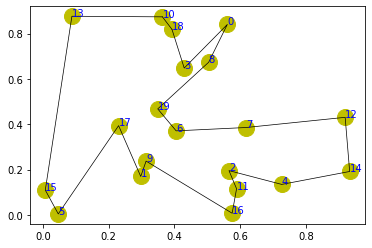

step:3180/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
step:3181/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
step:3182/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
step:3183/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
step:3184/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
distance:4.313
tensor([ 4,  6, 18,  7, 13,  3,  2, 15, 17,  0, 10, 19, 16,  9, 11, 12,  1,  8,
         5, 14])


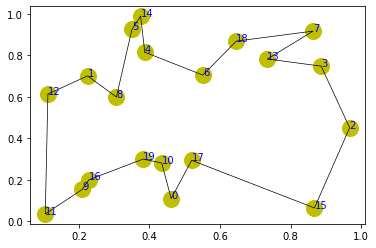

step:3185/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
step:3186/5000, actic loss:-0.421, critic loss:0.455, L:4.725, 0min0sec
step:3187/5000, actic loss:-0.420, critic loss:0.455, L:4.724, 0min0sec
step:3188/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
step:3189/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
distance:4.097
tensor([ 9, 17,  0,  3,  2, 14, 12,  4, 18, 11,  6, 10, 15,  5, 13, 16,  7, 19,
         1,  8])


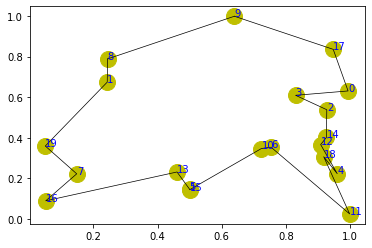

step:3190/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
step:3191/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
step:3192/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
step:3193/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
step:3194/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
distance:4.631
tensor([18, 12, 15,  1, 19, 16,  0,  3,  9,  6, 13,  4,  2,  8, 17, 14,  7,  5,
        11, 10])


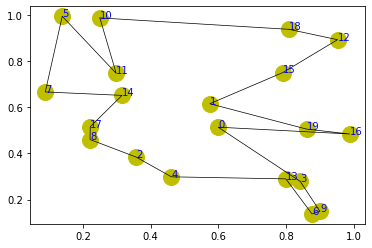

step:3195/5000, actic loss:-0.420, critic loss:0.454, L:4.724, 0min0sec
step:3196/5000, actic loss:-0.419, critic loss:0.454, L:4.723, 0min0sec
step:3197/5000, actic loss:-0.419, critic loss:0.454, L:4.723, 0min0sec
step:3198/5000, actic loss:-0.419, critic loss:0.454, L:4.723, 0min0sec
step:3199/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
distance:3.824
tensor([14,  5,  8, 18, 13,  7, 11, 10,  6,  1,  0,  3,  9,  4, 15, 19, 16,  2,
        17, 12])


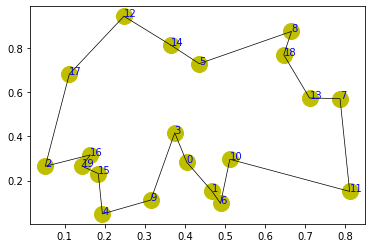

step:3200/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
step:3201/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
step:3202/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
step:3203/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
step:3204/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
distance:4.338
tensor([ 2, 17, 19,  3, 11, 15, 10,  6, 14,  4,  1,  7, 13,  9, 18,  8,  5,  0,
        12, 16])


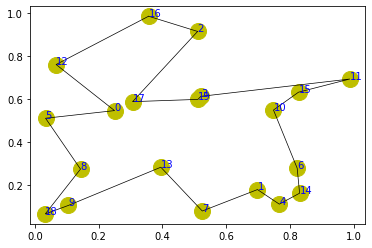

step:3205/5000, actic loss:-0.419, critic loss:0.453, L:4.723, 0min0sec
step:3206/5000, actic loss:-0.419, critic loss:0.453, L:4.722, 0min0sec
step:3207/5000, actic loss:-0.418, critic loss:0.453, L:4.722, 0min0sec
step:3208/5000, actic loss:-0.418, critic loss:0.453, L:4.722, 0min0sec
step:3209/5000, actic loss:-0.418, critic loss:0.452, L:4.722, 0min0sec
distance:5.024
tensor([12,  6,  7,  9,  3,  4, 11, 13, 19, 10, 15,  5, 14, 18, 17,  2,  1, 16,
         8,  0])


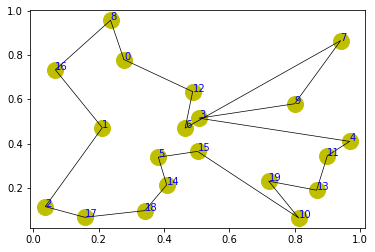

step:3210/5000, actic loss:-0.418, critic loss:0.452, L:4.722, 0min0sec
step:3211/5000, actic loss:-0.418, critic loss:0.452, L:4.722, 0min0sec
step:3212/5000, actic loss:-0.418, critic loss:0.452, L:4.722, 0min0sec
step:3213/5000, actic loss:-0.418, critic loss:0.452, L:4.722, 0min0sec
step:3214/5000, actic loss:-0.417, critic loss:0.452, L:4.722, 0min0sec
distance:4.089
tensor([10, 16,  8,  5,  0, 14,  9, 13,  6,  1, 19,  4,  2,  7, 15, 11,  3, 12,
        18, 17])


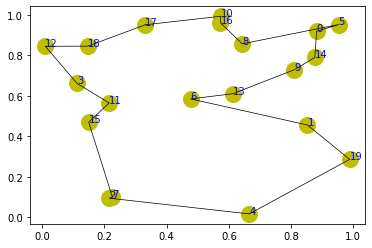

step:3215/5000, actic loss:-0.417, critic loss:0.452, L:4.722, 0min0sec
step:3216/5000, actic loss:-0.417, critic loss:0.452, L:4.721, 0min0sec
step:3217/5000, actic loss:-0.417, critic loss:0.452, L:4.721, 0min0sec
step:3218/5000, actic loss:-0.417, critic loss:0.452, L:4.721, 0min0sec
step:3219/5000, actic loss:-0.417, critic loss:0.451, L:4.721, 0min0sec
distance:4.329
tensor([11, 12,  3, 10, 19, 18,  2,  7,  9, 15, 17, 13,  0,  4, 16, 14,  5,  1,
         6,  8])


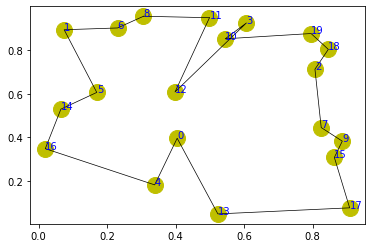

step:3220/5000, actic loss:-0.417, critic loss:0.451, L:4.721, 0min0sec
step:3221/5000, actic loss:-0.416, critic loss:0.451, L:4.721, 0min0sec
step:3222/5000, actic loss:-0.416, critic loss:0.451, L:4.721, 0min0sec
step:3223/5000, actic loss:-0.416, critic loss:0.451, L:4.721, 0min0sec
step:3224/5000, actic loss:-0.416, critic loss:0.451, L:4.720, 0min0sec
distance:3.867
tensor([ 9, 16, 12, 14, 11,  7,  8,  2,  6, 18,  4,  1,  5, 19, 15, 10, 17,  0,
         3, 13])


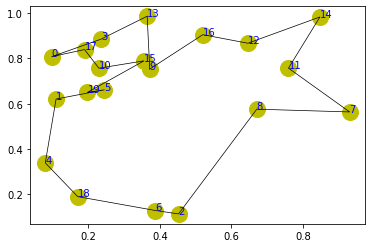

step:3225/5000, actic loss:-0.416, critic loss:0.451, L:4.720, 0min0sec
step:3226/5000, actic loss:-0.416, critic loss:0.451, L:4.720, 0min0sec
step:3227/5000, actic loss:-0.416, critic loss:0.451, L:4.720, 0min0sec
step:3228/5000, actic loss:-0.416, critic loss:0.451, L:4.720, 0min0sec
step:3229/5000, actic loss:-0.416, critic loss:0.451, L:4.720, 0min0sec
distance:4.830
tensor([16,  6,  8, 13, 14,  2,  5,  7, 17,  1,  0, 18, 10, 15,  3, 12, 19,  4,
        11,  9])


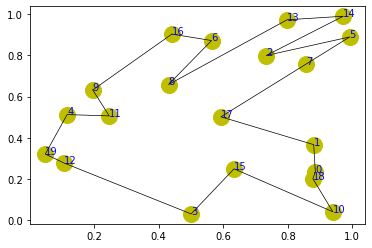

step:3230/5000, actic loss:-0.416, critic loss:0.450, L:4.720, 0min0sec
step:3231/5000, actic loss:-0.415, critic loss:0.450, L:4.720, 0min0sec
step:3232/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
step:3233/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
step:3234/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
distance:3.900
tensor([ 7, 17, 10, 19, 13, 12,  1,  6, 18, 16,  0,  2, 15,  3, 14,  5,  9,  8,
        11,  4])


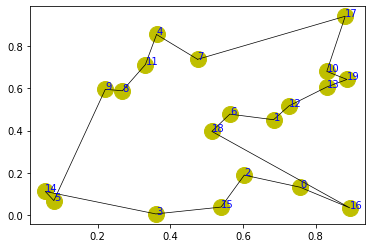

step:3235/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
step:3236/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
step:3237/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
step:3238/5000, actic loss:-0.415, critic loss:0.450, L:4.719, 0min0sec
step:3239/5000, actic loss:-0.415, critic loss:0.449, L:4.718, 0min0sec
distance:4.772
tensor([ 9, 15,  5, 16,  0,  6,  3, 14, 13, 19, 18, 10,  4,  7, 11, 17,  2,  1,
         8, 12])


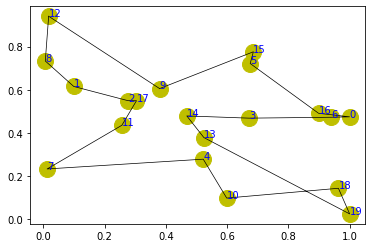

step:3240/5000, actic loss:-0.415, critic loss:0.449, L:4.718, 0min0sec
step:3241/5000, actic loss:-0.414, critic loss:0.449, L:4.718, 0min0sec
step:3242/5000, actic loss:-0.414, critic loss:0.449, L:4.718, 0min0sec
step:3243/5000, actic loss:-0.414, critic loss:0.449, L:4.718, 0min0sec
step:3244/5000, actic loss:-0.414, critic loss:0.449, L:4.718, 0min0sec
distance:3.974
tensor([19, 12, 17, 11,  0,  9,  5,  2,  8, 16, 15, 14,  3, 13,  7,  6,  4, 18,
         1, 10])


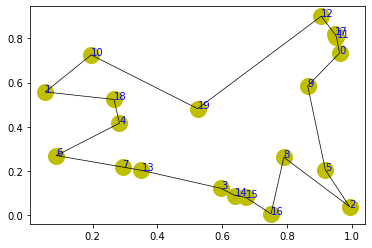

step:3245/5000, actic loss:-0.414, critic loss:0.449, L:4.718, 0min0sec
step:3246/5000, actic loss:-0.414, critic loss:0.449, L:4.717, 0min0sec
step:3247/5000, actic loss:-0.414, critic loss:0.449, L:4.717, 0min0sec
step:3248/5000, actic loss:-0.414, critic loss:0.449, L:4.717, 0min0sec
step:3249/5000, actic loss:-0.414, critic loss:0.448, L:4.717, 0min0sec
distance:4.031
tensor([13, 10, 11,  9, 14, 15,  2,  6,  4, 16,  7,  1, 17, 19, 18,  5,  8, 12,
         0,  3])


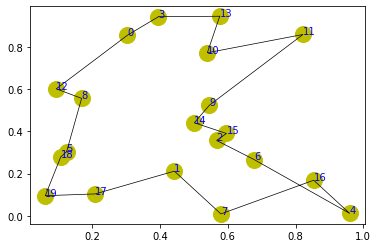

step:3250/5000, actic loss:-0.414, critic loss:0.448, L:4.717, 0min0sec
step:3251/5000, actic loss:-0.413, critic loss:0.448, L:4.717, 0min0sec
step:3252/5000, actic loss:-0.413, critic loss:0.448, L:4.717, 0min0sec
step:3253/5000, actic loss:-0.413, critic loss:0.448, L:4.717, 0min0sec
step:3254/5000, actic loss:-0.413, critic loss:0.448, L:4.716, 0min0sec
distance:4.998
tensor([ 2, 12,  8,  3,  5,  0, 19, 11, 17, 18,  1,  6, 13, 15,  9, 16,  7, 14,
         4, 10])


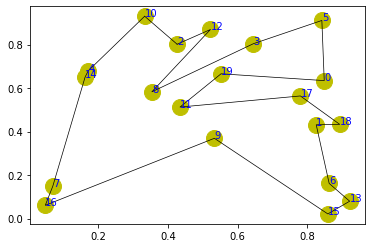

step:3255/5000, actic loss:-0.413, critic loss:0.448, L:4.716, 0min0sec
step:3256/5000, actic loss:-0.413, critic loss:0.448, L:4.716, 0min0sec
step:3257/5000, actic loss:-0.413, critic loss:0.448, L:4.716, 0min0sec
step:3258/5000, actic loss:-0.413, critic loss:0.447, L:4.716, 0min0sec
step:3259/5000, actic loss:-0.413, critic loss:0.447, L:4.716, 0min0sec
distance:4.619
tensor([16, 18,  7, 12, 14,  1, 11,  5,  9, 13,  0, 10, 17,  8,  3, 15,  6,  4,
         2, 19])


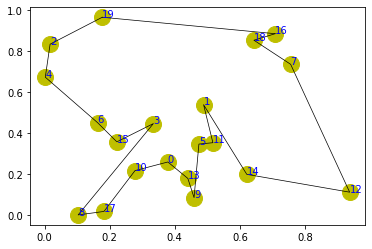

step:3260/5000, actic loss:-0.413, critic loss:0.447, L:4.716, 0min0sec
step:3261/5000, actic loss:-0.412, critic loss:0.447, L:4.716, 0min0sec
step:3262/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
step:3263/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
step:3264/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
distance:4.285
tensor([12,  3,  7, 19,  6,  0, 11,  2, 15, 16,  4, 14, 18,  9, 10, 13, 17,  5,
         8,  1])


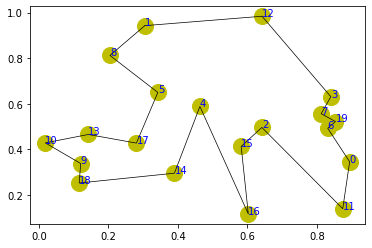

step:3265/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
step:3266/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
step:3267/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
step:3268/5000, actic loss:-0.412, critic loss:0.447, L:4.715, 0min0sec
step:3269/5000, actic loss:-0.412, critic loss:0.446, L:4.715, 0min0sec
distance:3.772
tensor([14,  7,  6,  4, 17, 16, 18,  0, 15,  9, 13, 10, 11,  8,  3,  1,  2,  5,
        12, 19])


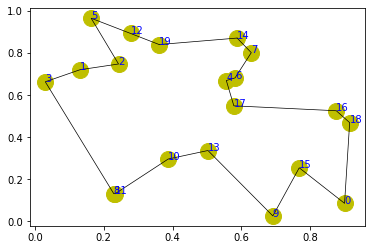

step:3270/5000, actic loss:-0.412, critic loss:0.446, L:4.714, 0min0sec
step:3271/5000, actic loss:-0.411, critic loss:0.446, L:4.714, 0min0sec
step:3272/5000, actic loss:-0.411, critic loss:0.446, L:4.714, 0min0sec
step:3273/5000, actic loss:-0.411, critic loss:0.446, L:4.714, 0min0sec
step:3274/5000, actic loss:-0.411, critic loss:0.446, L:4.714, 0min0sec
distance:3.573
tensor([ 1, 10,  3,  8, 16, 14,  4, 15, 19, 11,  5, 17,  2, 18,  9,  7,  6,  0,
        13, 12])


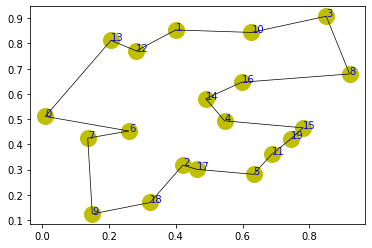

step:3275/5000, actic loss:-0.411, critic loss:0.446, L:4.714, 0min0sec
step:3276/5000, actic loss:-0.411, critic loss:0.446, L:4.714, 0min0sec
step:3277/5000, actic loss:-0.411, critic loss:0.446, L:4.713, 0min0sec
step:3278/5000, actic loss:-0.411, critic loss:0.446, L:4.713, 0min0sec
step:3279/5000, actic loss:-0.410, critic loss:0.445, L:4.713, 0min0sec
distance:4.392
tensor([15,  2, 18, 10,  4,  0, 11,  7, 17, 12,  1,  6, 14, 19,  8,  3, 13,  5,
         9, 16])


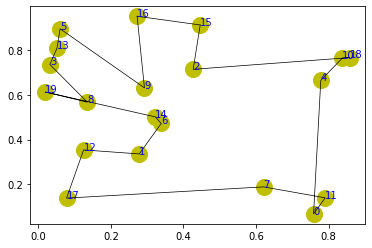

step:3280/5000, actic loss:-0.410, critic loss:0.445, L:4.713, 0min0sec
step:3281/5000, actic loss:-0.410, critic loss:0.445, L:4.713, 0min0sec
step:3282/5000, actic loss:-0.410, critic loss:0.445, L:4.713, 0min0sec
step:3283/5000, actic loss:-0.410, critic loss:0.445, L:4.713, 0min0sec
step:3284/5000, actic loss:-0.410, critic loss:0.445, L:4.713, 0min0sec
distance:4.390
tensor([ 6, 17,  0, 18,  3,  4,  1,  9,  5,  8, 12,  2, 11,  7, 19, 15, 14, 16,
        13, 10])


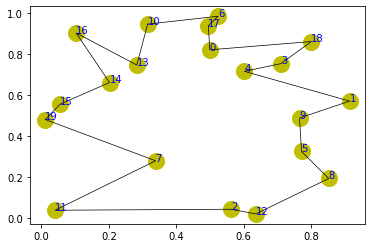

step:3285/5000, actic loss:-0.410, critic loss:0.445, L:4.712, 0min0sec
step:3286/5000, actic loss:-0.410, critic loss:0.445, L:4.712, 0min0sec
step:3287/5000, actic loss:-0.410, critic loss:0.445, L:4.712, 0min0sec
step:3288/5000, actic loss:-0.410, critic loss:0.445, L:4.712, 0min0sec
step:3289/5000, actic loss:-0.410, critic loss:0.444, L:4.712, 0min0sec
distance:4.116
tensor([15,  2, 14,  8, 13, 19,  1,  7,  0,  3, 11,  9, 10, 12, 16,  4, 18, 17,
         5,  6])


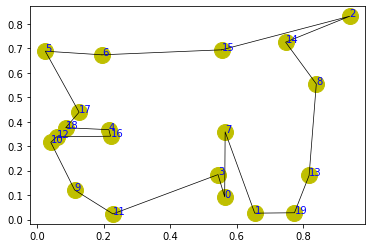

step:3290/5000, actic loss:-0.410, critic loss:0.444, L:4.712, 0min0sec
step:3291/5000, actic loss:-0.409, critic loss:0.444, L:4.712, 0min0sec
step:3292/5000, actic loss:-0.409, critic loss:0.444, L:4.711, 0min0sec
step:3293/5000, actic loss:-0.409, critic loss:0.444, L:4.711, 0min0sec
step:3294/5000, actic loss:-0.409, critic loss:0.444, L:4.711, 0min0sec
distance:3.850
tensor([19, 10,  9,  6, 14, 16, 18, 12,  0,  3,  8, 17, 13, 11,  5,  7,  2,  1,
        15,  4])


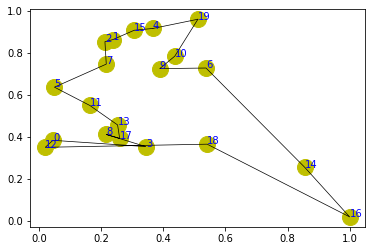

step:3295/5000, actic loss:-0.409, critic loss:0.444, L:4.711, 0min0sec
step:3296/5000, actic loss:-0.409, critic loss:0.444, L:4.711, 0min0sec
step:3297/5000, actic loss:-0.409, critic loss:0.444, L:4.711, 0min0sec
step:3298/5000, actic loss:-0.409, critic loss:0.443, L:4.711, 0min0sec
step:3299/5000, actic loss:-0.409, critic loss:0.443, L:4.711, 0min0sec
distance:3.786
tensor([16,  8,  2,  1, 15, 19, 11,  7, 13,  9,  3, 10,  5,  6, 14, 18,  0,  4,
        17, 12])


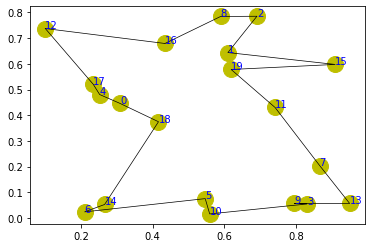

step:3300/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3301/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3302/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3303/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3304/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
distance:4.510
tensor([ 3,  7, 11,  9,  8,  5,  4, 13,  6,  0, 12,  1,  2, 16, 17, 14, 10, 19,
        18, 15])


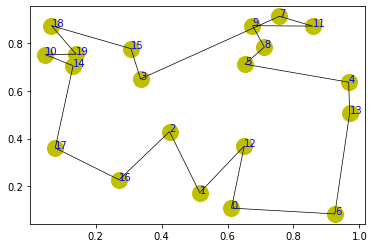

step:3305/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3306/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3307/5000, actic loss:-0.408, critic loss:0.443, L:4.710, 0min0sec
step:3308/5000, actic loss:-0.408, critic loss:0.442, L:4.710, 0min0sec
step:3309/5000, actic loss:-0.408, critic loss:0.442, L:4.709, 0min0sec
distance:4.319
tensor([14, 10, 12,  6,  9,  7, 15, 13, 16,  2,  3,  8, 17,  0,  5, 19, 18,  4,
         1, 11])


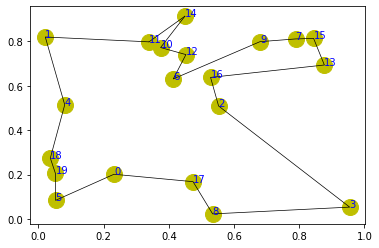

step:3310/5000, actic loss:-0.407, critic loss:0.442, L:4.709, 0min0sec
step:3311/5000, actic loss:-0.407, critic loss:0.442, L:4.709, 0min0sec
step:3312/5000, actic loss:-0.407, critic loss:0.442, L:4.709, 0min0sec
step:3313/5000, actic loss:-0.407, critic loss:0.442, L:4.709, 0min0sec
step:3314/5000, actic loss:-0.407, critic loss:0.442, L:4.709, 0min0sec
distance:4.415
tensor([16, 19, 10,  3, 13, 14, 18, 15,  2, 12, 17,  7, 11,  0,  8,  1,  4,  9,
         6,  5])


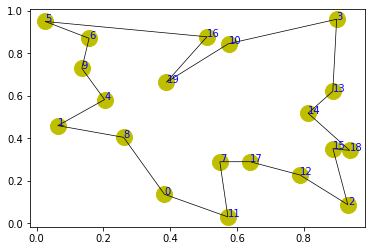

step:3315/5000, actic loss:-0.407, critic loss:0.442, L:4.709, 0min0sec
step:3316/5000, actic loss:-0.407, critic loss:0.442, L:4.708, 0min0sec
step:3317/5000, actic loss:-0.407, critic loss:0.442, L:4.708, 0min0sec
step:3318/5000, actic loss:-0.407, critic loss:0.442, L:4.708, 0min0sec
step:3319/5000, actic loss:-0.406, critic loss:0.441, L:4.708, 0min0sec
distance:4.189
tensor([19, 10,  5,  2, 18,  7,  4, 14,  1, 15,  8,  6, 12, 16,  3,  9,  0, 11,
        13, 17])


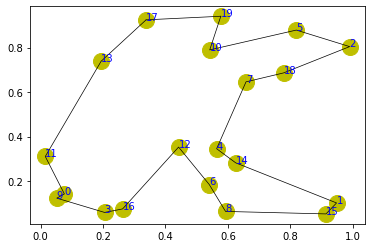

step:3320/5000, actic loss:-0.406, critic loss:0.441, L:4.708, 0min0sec
step:3321/5000, actic loss:-0.406, critic loss:0.441, L:4.708, 0min0sec
step:3322/5000, actic loss:-0.406, critic loss:0.441, L:4.708, 0min0sec
step:3323/5000, actic loss:-0.406, critic loss:0.441, L:4.708, 0min0sec
step:3324/5000, actic loss:-0.406, critic loss:0.441, L:4.707, 0min0sec
distance:3.924
tensor([17,  1,  9, 16, 13,  5,  0, 19, 18, 14,  8, 11,  4, 12, 15,  3,  6,  2,
        10,  7])


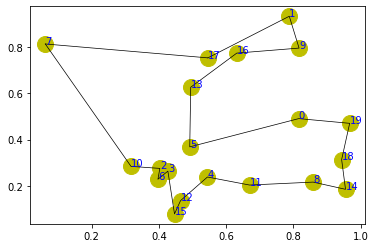

step:3325/5000, actic loss:-0.406, critic loss:0.441, L:4.707, 0min0sec
step:3326/5000, actic loss:-0.406, critic loss:0.441, L:4.707, 0min0sec
step:3327/5000, actic loss:-0.406, critic loss:0.441, L:4.707, 0min0sec
step:3328/5000, actic loss:-0.405, critic loss:0.441, L:4.707, 0min0sec
step:3329/5000, actic loss:-0.405, critic loss:0.440, L:4.707, 0min0sec
distance:4.746
tensor([19, 13,  5,  7,  2,  8, 14,  6,  0, 16,  4,  9,  1, 15, 11, 10, 12, 18,
        17,  3])


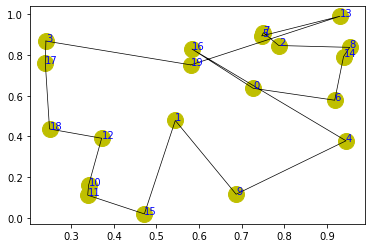

step:3330/5000, actic loss:-0.405, critic loss:0.440, L:4.707, 0min0sec
step:3331/5000, actic loss:-0.405, critic loss:0.440, L:4.706, 0min0sec
step:3332/5000, actic loss:-0.405, critic loss:0.440, L:4.706, 0min0sec
step:3333/5000, actic loss:-0.405, critic loss:0.440, L:4.706, 0min0sec
step:3334/5000, actic loss:-0.405, critic loss:0.440, L:4.706, 0min0sec
distance:3.915
tensor([ 6, 15, 12,  1,  2,  9, 13,  7, 19,  0,  8, 18, 10,  3,  5,  4, 14, 11,
        17, 16])


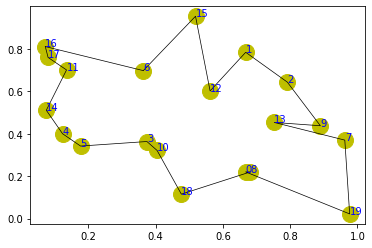

step:3335/5000, actic loss:-0.405, critic loss:0.440, L:4.706, 0min0sec
step:3336/5000, actic loss:-0.405, critic loss:0.440, L:4.706, 0min0sec
step:3337/5000, actic loss:-0.404, critic loss:0.440, L:4.706, 0min0sec
step:3338/5000, actic loss:-0.404, critic loss:0.440, L:4.706, 0min0sec
step:3339/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
distance:3.627
tensor([ 1, 18,  5, 14,  7,  0,  6, 10,  8, 12, 17, 19,  9,  3, 13, 11,  2,  4,
        16, 15])


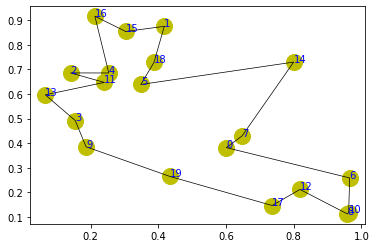

step:3340/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
step:3341/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
step:3342/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
step:3343/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
step:3344/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
distance:4.958
tensor([ 9,  4, 10,  2, 13,  1,  0, 12, 17,  7, 18,  3, 19, 14,  8, 15, 11,  5,
         6, 16])


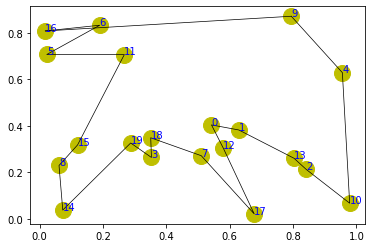

step:3345/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
step:3346/5000, actic loss:-0.404, critic loss:0.439, L:4.705, 0min0sec
step:3347/5000, actic loss:-0.403, critic loss:0.439, L:4.704, 0min0sec
step:3348/5000, actic loss:-0.403, critic loss:0.439, L:4.704, 0min0sec
step:3349/5000, actic loss:-0.403, critic loss:0.438, L:4.704, 0min0sec
distance:3.939
tensor([ 8,  5,  1, 16,  6,  0,  2,  7, 10, 15, 11, 17, 14,  9,  3, 12, 19,  4,
        13, 18])


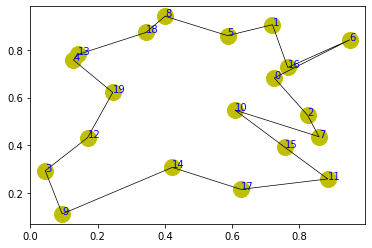

step:3350/5000, actic loss:-0.403, critic loss:0.438, L:4.704, 0min0sec
step:3351/5000, actic loss:-0.403, critic loss:0.438, L:4.704, 0min0sec
step:3352/5000, actic loss:-0.403, critic loss:0.438, L:4.704, 0min0sec
step:3353/5000, actic loss:-0.403, critic loss:0.438, L:4.704, 0min0sec
step:3354/5000, actic loss:-0.403, critic loss:0.438, L:4.703, 0min0sec
distance:4.834
tensor([14,  4,  1,  8, 16,  5, 17,  2,  0, 18, 19,  9, 12,  7, 13, 10,  3,  6,
        15, 11])


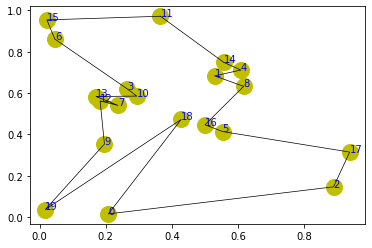

step:3355/5000, actic loss:-0.403, critic loss:0.438, L:4.703, 0min0sec
step:3356/5000, actic loss:-0.402, critic loss:0.438, L:4.703, 0min0sec
step:3357/5000, actic loss:-0.402, critic loss:0.438, L:4.703, 0min0sec
step:3358/5000, actic loss:-0.402, critic loss:0.438, L:4.703, 0min0sec
step:3359/5000, actic loss:-0.402, critic loss:0.437, L:4.703, 0min0sec
distance:4.351
tensor([17,  6,  9,  8,  2,  0, 11, 10, 12, 19,  7, 15, 14,  4, 13,  3,  5,  1,
        16, 18])


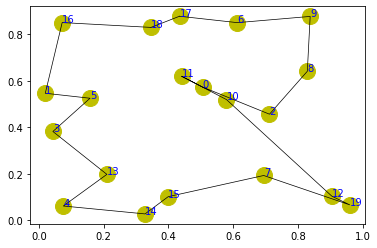

step:3360/5000, actic loss:-0.402, critic loss:0.437, L:4.703, 0min0sec
step:3361/5000, actic loss:-0.402, critic loss:0.437, L:4.702, 0min0sec
step:3362/5000, actic loss:-0.402, critic loss:0.437, L:4.702, 0min0sec
step:3363/5000, actic loss:-0.402, critic loss:0.437, L:4.702, 0min0sec
step:3364/5000, actic loss:-0.402, critic loss:0.437, L:4.702, 0min0sec
distance:4.444
tensor([13, 11,  1,  4, 19,  3, 14,  6, 18,  0,  7, 12, 15,  5,  2, 17,  8, 16,
         9, 10])


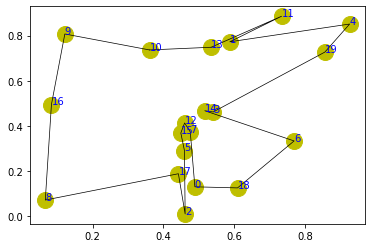

step:3365/5000, actic loss:-0.401, critic loss:0.437, L:4.702, 0min0sec
step:3366/5000, actic loss:-0.401, critic loss:0.437, L:4.702, 0min0sec
step:3367/5000, actic loss:-0.401, critic loss:0.437, L:4.702, 0min0sec
step:3368/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
step:3369/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
distance:4.016
tensor([ 6, 18, 10, 17,  1,  9, 13,  5, 11,  4, 19,  3, 16, 12,  8, 14,  2,  0,
        15,  7])


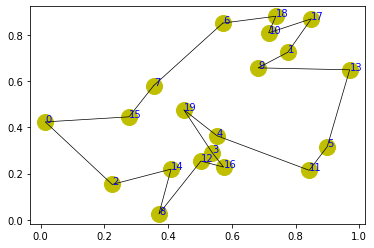

step:3370/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
step:3371/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
step:3372/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
step:3373/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
step:3374/5000, actic loss:-0.401, critic loss:0.436, L:4.701, 0min0sec
distance:4.326
tensor([ 1,  6,  3, 16,  5, 15, 13, 12,  4, 19,  0, 14,  8, 11, 10, 17, 18,  2,
         9,  7])


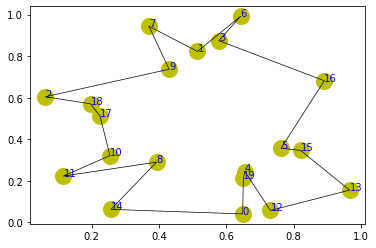

step:3375/5000, actic loss:-0.400, critic loss:0.436, L:4.700, 0min0sec
step:3376/5000, actic loss:-0.400, critic loss:0.436, L:4.700, 0min0sec
step:3377/5000, actic loss:-0.400, critic loss:0.436, L:4.700, 0min0sec
step:3378/5000, actic loss:-0.400, critic loss:0.435, L:4.700, 0min0sec
step:3379/5000, actic loss:-0.400, critic loss:0.435, L:4.700, 0min0sec
distance:3.522
tensor([16, 12,  2, 14,  0,  1, 10, 11,  5,  9,  3, 19,  8, 13,  4,  6,  7, 15,
        18, 17])


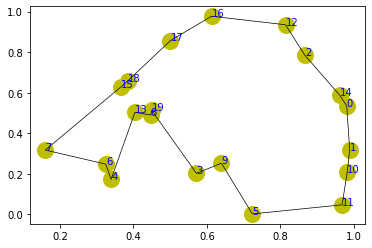

step:3380/5000, actic loss:-0.400, critic loss:0.435, L:4.700, 0min0sec
step:3381/5000, actic loss:-0.400, critic loss:0.435, L:4.700, 0min0sec
step:3382/5000, actic loss:-0.400, critic loss:0.435, L:4.699, 0min0sec
step:3383/5000, actic loss:-0.400, critic loss:0.435, L:4.699, 0min0sec
step:3384/5000, actic loss:-0.400, critic loss:0.435, L:4.699, 0min0sec
distance:4.664
tensor([ 4, 15,  0, 11, 18, 16, 10,  1,  7, 12, 14,  5,  8,  3, 17,  9,  6, 19,
         2, 13])


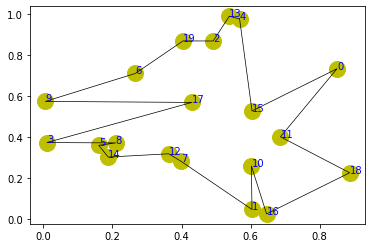

step:3385/5000, actic loss:-0.399, critic loss:0.435, L:4.699, 0min0sec
step:3386/5000, actic loss:-0.399, critic loss:0.435, L:4.699, 0min0sec
step:3387/5000, actic loss:-0.399, critic loss:0.435, L:4.699, 0min0sec
step:3388/5000, actic loss:-0.399, critic loss:0.434, L:4.699, 0min0sec
step:3389/5000, actic loss:-0.399, critic loss:0.434, L:4.698, 0min0sec
distance:4.759
tensor([10, 13,  1,  2,  5,  4,  0, 12, 11,  7, 14, 16, 15,  6,  9, 19,  3, 18,
         8, 17])


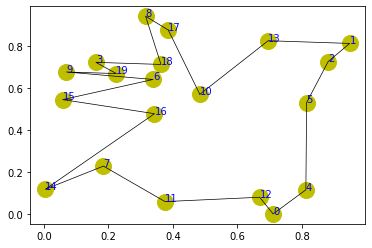

step:3390/5000, actic loss:-0.399, critic loss:0.434, L:4.698, 0min0sec
step:3391/5000, actic loss:-0.399, critic loss:0.434, L:4.698, 0min0sec
step:3392/5000, actic loss:-0.399, critic loss:0.434, L:4.698, 0min0sec
step:3393/5000, actic loss:-0.399, critic loss:0.434, L:4.698, 0min0sec
step:3394/5000, actic loss:-0.398, critic loss:0.434, L:4.698, 0min0sec
distance:3.952
tensor([ 0,  6,  2, 14, 13,  7,  4,  3, 16,  5, 10,  1, 12, 15, 19,  8, 18, 17,
        11,  9])


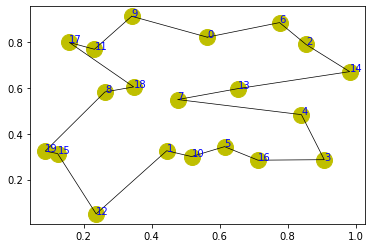

step:3395/5000, actic loss:-0.398, critic loss:0.434, L:4.698, 0min0sec
step:3396/5000, actic loss:-0.398, critic loss:0.434, L:4.697, 0min0sec
step:3397/5000, actic loss:-0.398, critic loss:0.434, L:4.697, 0min0sec
step:3398/5000, actic loss:-0.398, critic loss:0.434, L:4.697, 0min0sec
step:3399/5000, actic loss:-0.398, critic loss:0.433, L:4.697, 0min0sec
distance:4.636
tensor([ 6,  0,  1, 19, 14, 17,  4,  2,  5, 13, 11,  7, 10, 16, 12,  8,  9,  3,
        15, 18])


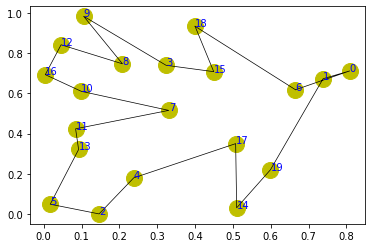

step:3400/5000, actic loss:-0.398, critic loss:0.433, L:4.697, 0min0sec
step:3401/5000, actic loss:-0.398, critic loss:0.433, L:4.697, 0min0sec
step:3402/5000, actic loss:-0.398, critic loss:0.433, L:4.697, 0min0sec
step:3403/5000, actic loss:-0.398, critic loss:0.433, L:4.697, 0min0sec
step:3404/5000, actic loss:-0.397, critic loss:0.433, L:4.696, 0min0sec
distance:4.410
tensor([12,  8,  3,  5, 10,  9,  7, 15, 13, 17,  1,  2, 18, 11,  6,  0,  4, 16,
        14, 19])


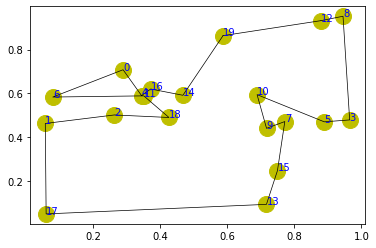

step:3405/5000, actic loss:-0.397, critic loss:0.433, L:4.696, 0min0sec
step:3406/5000, actic loss:-0.397, critic loss:0.433, L:4.696, 0min0sec
step:3407/5000, actic loss:-0.397, critic loss:0.433, L:4.696, 0min0sec
step:3408/5000, actic loss:-0.397, critic loss:0.433, L:4.696, 0min0sec
step:3409/5000, actic loss:-0.397, critic loss:0.432, L:4.696, 0min0sec
distance:4.592
tensor([11, 17, 18, 12,  0,  1,  7, 16,  6,  8, 10,  9, 13, 15, 14, 19,  4,  5,
         3,  2])


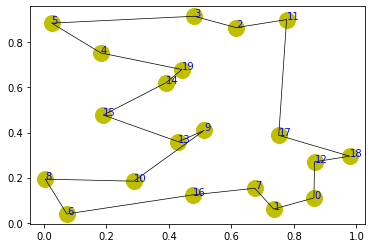

step:3410/5000, actic loss:-0.397, critic loss:0.432, L:4.696, 0min0sec
step:3411/5000, actic loss:-0.397, critic loss:0.432, L:4.695, 0min0sec
step:3412/5000, actic loss:-0.397, critic loss:0.432, L:4.695, 0min0sec
step:3413/5000, actic loss:-0.397, critic loss:0.432, L:4.695, 0min0sec
step:3414/5000, actic loss:-0.397, critic loss:0.432, L:4.695, 0min0sec
distance:4.040
tensor([17,  3, 15,  7,  2, 11,  1, 12, 18, 10, 16,  6, 19,  4,  9,  5,  8, 14,
        13,  0])


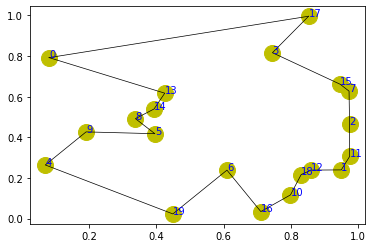

step:3415/5000, actic loss:-0.396, critic loss:0.432, L:4.695, 0min0sec
step:3416/5000, actic loss:-0.396, critic loss:0.432, L:4.695, 0min0sec
step:3417/5000, actic loss:-0.396, critic loss:0.432, L:4.695, 0min0sec
step:3418/5000, actic loss:-0.396, critic loss:0.432, L:4.695, 0min0sec
step:3419/5000, actic loss:-0.396, critic loss:0.432, L:4.695, 0min0sec
distance:4.178
tensor([ 2, 18, 10,  8,  4,  9,  0,  7, 14, 19, 11, 15, 13, 16,  3, 12,  1,  5,
         6, 17])


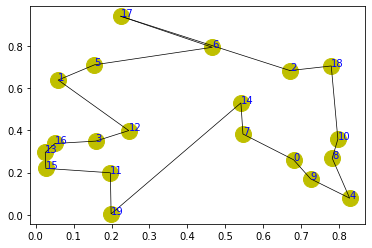

step:3420/5000, actic loss:-0.396, critic loss:0.431, L:4.694, 0min0sec
step:3421/5000, actic loss:-0.396, critic loss:0.431, L:4.694, 0min0sec
step:3422/5000, actic loss:-0.396, critic loss:0.431, L:4.694, 0min0sec
step:3423/5000, actic loss:-0.396, critic loss:0.431, L:4.694, 0min0sec
step:3424/5000, actic loss:-0.396, critic loss:0.431, L:4.694, 0min0sec
distance:4.389
tensor([13,  7, 18, 10, 16, 19, 14, 11,  9,  6, 17,  1,  0,  5, 15, 12,  3,  8,
         2,  4])


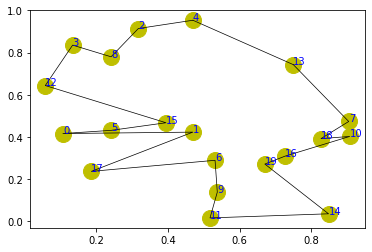

step:3425/5000, actic loss:-0.395, critic loss:0.431, L:4.694, 0min0sec
step:3426/5000, actic loss:-0.395, critic loss:0.431, L:4.694, 0min0sec
step:3427/5000, actic loss:-0.395, critic loss:0.431, L:4.694, 0min0sec
step:3428/5000, actic loss:-0.395, critic loss:0.431, L:4.694, 0min0sec
step:3429/5000, actic loss:-0.395, critic loss:0.431, L:4.693, 0min0sec
distance:3.938
tensor([ 0,  5, 19, 17,  6, 10, 12, 13, 15, 11,  1,  9,  2,  7,  3,  8, 18, 14,
        16,  4])


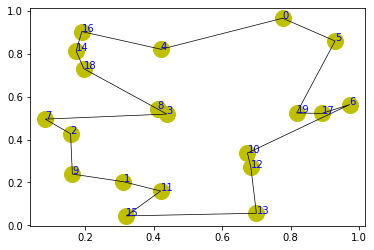

step:3430/5000, actic loss:-0.395, critic loss:0.431, L:4.693, 0min0sec
step:3431/5000, actic loss:-0.395, critic loss:0.431, L:4.693, 0min0sec
step:3432/5000, actic loss:-0.395, critic loss:0.431, L:4.693, 0min0sec
step:3433/5000, actic loss:-0.395, critic loss:0.430, L:4.693, 0min0sec
step:3434/5000, actic loss:-0.395, critic loss:0.430, L:4.693, 0min0sec
distance:4.162
tensor([10,  1, 12, 11, 16,  2, 15, 14,  6, 17, 13,  8,  7,  9,  0, 18,  5, 19,
         4,  3])


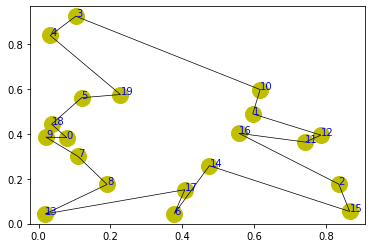

step:3435/5000, actic loss:-0.395, critic loss:0.430, L:4.693, 0min0sec
step:3436/5000, actic loss:-0.395, critic loss:0.430, L:4.693, 0min0sec
step:3437/5000, actic loss:-0.395, critic loss:0.430, L:4.693, 0min0sec
step:3438/5000, actic loss:-0.395, critic loss:0.430, L:4.693, 0min0sec
step:3439/5000, actic loss:-0.395, critic loss:0.430, L:4.692, 0min0sec
distance:3.538
tensor([ 9, 11, 15, 18,  2,  7,  4, 19,  6, 16,  1, 14,  3,  8, 10,  0, 17, 12,
         5, 13])


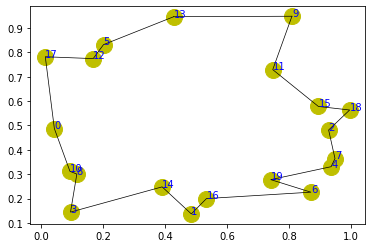

step:3440/5000, actic loss:-0.394, critic loss:0.430, L:4.692, 0min0sec
step:3441/5000, actic loss:-0.394, critic loss:0.430, L:4.692, 0min0sec
step:3442/5000, actic loss:-0.394, critic loss:0.430, L:4.692, 0min0sec
step:3443/5000, actic loss:-0.394, critic loss:0.430, L:4.692, 0min0sec
step:3444/5000, actic loss:-0.394, critic loss:0.430, L:4.692, 0min0sec
distance:4.596
tensor([ 2, 13,  1, 12,  0, 15,  8, 17, 11,  6,  9,  5, 16, 14,  3, 19,  7, 18,
        10,  4])


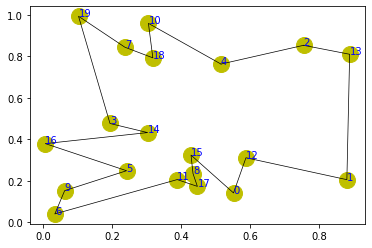

step:3445/5000, actic loss:-0.394, critic loss:0.430, L:4.692, 0min0sec
step:3446/5000, actic loss:-0.394, critic loss:0.429, L:4.692, 0min0sec
step:3447/5000, actic loss:-0.394, critic loss:0.429, L:4.692, 0min0sec
step:3448/5000, actic loss:-0.394, critic loss:0.429, L:4.691, 0min0sec
step:3449/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
distance:4.189
tensor([ 0, 19, 18, 13,  2,  9, 17, 12,  8,  7,  6, 10,  1, 15, 11,  4, 14, 16,
         5,  3])


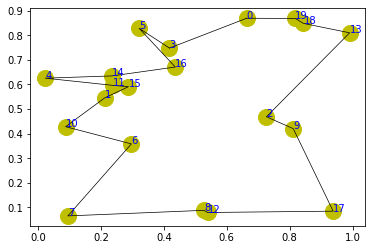

step:3450/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
step:3451/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
step:3452/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
step:3453/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
step:3454/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
distance:4.413
tensor([ 6,  8,  9, 18,  2,  4, 19, 14, 10,  7, 11, 12,  5,  1, 16,  0, 17,  3,
        15, 13])


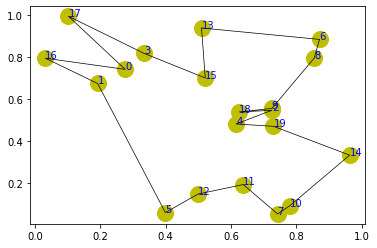

step:3455/5000, actic loss:-0.393, critic loss:0.429, L:4.691, 0min0sec
step:3456/5000, actic loss:-0.393, critic loss:0.429, L:4.690, 0min0sec
step:3457/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3458/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3459/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
distance:3.995
tensor([ 6,  7, 11,  0,  4,  9, 14,  1, 19, 15, 12,  2, 17,  5, 18,  3,  8, 10,
        13, 16])


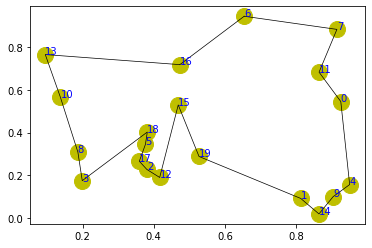

step:3460/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3461/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3462/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3463/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3464/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
distance:4.298
tensor([11,  5,  4,  6, 12, 17,  3, 15, 14,  2,  8, 18, 13,  1, 16, 10,  9, 19,
         7,  0])


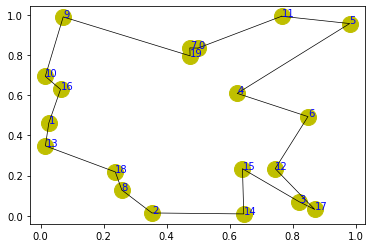

step:3465/5000, actic loss:-0.392, critic loss:0.428, L:4.690, 0min0sec
step:3466/5000, actic loss:-0.391, critic loss:0.428, L:4.689, 0min0sec
step:3467/5000, actic loss:-0.391, critic loss:0.428, L:4.689, 0min0sec
step:3468/5000, actic loss:-0.391, critic loss:0.427, L:4.689, 0min0sec
step:3469/5000, actic loss:-0.391, critic loss:0.427, L:4.689, 0min0sec
distance:4.837
tensor([ 9, 11,  8,  1, 14, 17,  4, 10,  2,  7,  6, 15, 18, 16, 13,  3, 12, 19,
         0,  5])


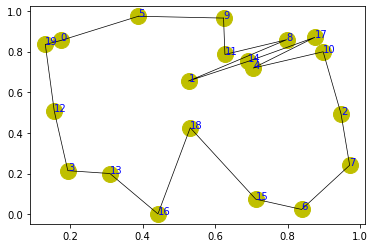

step:3470/5000, actic loss:-0.391, critic loss:0.427, L:4.689, 0min0sec
step:3471/5000, actic loss:-0.391, critic loss:0.427, L:4.689, 0min0sec
step:3472/5000, actic loss:-0.391, critic loss:0.427, L:4.689, 0min0sec
step:3473/5000, actic loss:-0.391, critic loss:0.427, L:4.688, 0min0sec
step:3474/5000, actic loss:-0.391, critic loss:0.427, L:4.688, 0min0sec
distance:4.721
tensor([ 7, 14,  2,  6,  0,  4, 18,  8, 15, 12, 11, 16, 10, 17, 13, 19,  3,  1,
         5,  9])


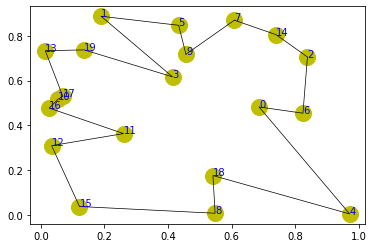

step:3475/5000, actic loss:-0.391, critic loss:0.427, L:4.688, 0min0sec
step:3476/5000, actic loss:-0.391, critic loss:0.427, L:4.688, 0min0sec
step:3477/5000, actic loss:-0.391, critic loss:0.427, L:4.688, 0min0sec
step:3478/5000, actic loss:-0.390, critic loss:0.427, L:4.688, 0min0sec
step:3479/5000, actic loss:-0.390, critic loss:0.426, L:4.688, 0min0sec
distance:4.417
tensor([ 0, 13, 11, 15,  8,  5, 18, 19,  2, 12, 10,  7,  3,  9,  4, 16, 17,  1,
         6, 14])


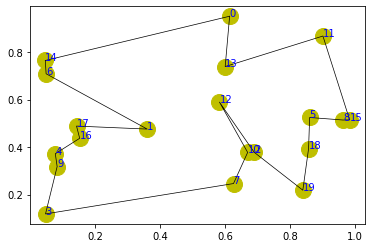

step:3480/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3481/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3482/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3483/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3484/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
distance:4.475
tensor([16, 14,  2, 11,  4, 13,  1,  8,  6,  5, 15,  7,  3,  0, 17, 12, 19, 18,
        10,  9])


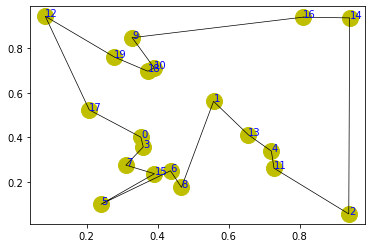

step:3485/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3486/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3487/5000, actic loss:-0.390, critic loss:0.426, L:4.687, 0min0sec
step:3488/5000, actic loss:-0.389, critic loss:0.426, L:4.686, 0min0sec
step:3489/5000, actic loss:-0.389, critic loss:0.425, L:4.686, 0min0sec
distance:3.656
tensor([ 2,  7, 15, 13, 11,  8,  3, 18, 17,  5,  1,  0, 10, 12, 19, 16, 14,  4,
         6,  9])


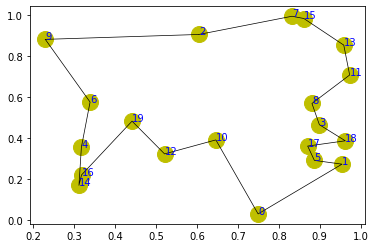

step:3490/5000, actic loss:-0.389, critic loss:0.425, L:4.686, 0min0sec
step:3491/5000, actic loss:-0.389, critic loss:0.425, L:4.686, 0min0sec
step:3492/5000, actic loss:-0.389, critic loss:0.425, L:4.686, 0min0sec
step:3493/5000, actic loss:-0.389, critic loss:0.425, L:4.686, 0min0sec
step:3494/5000, actic loss:-0.389, critic loss:0.425, L:4.686, 0min0sec
distance:4.241
tensor([18, 15, 10, 11, 17,  9,  5,  2,  1, 16,  0, 19,  3, 14,  8, 12,  7,  4,
        13,  6])


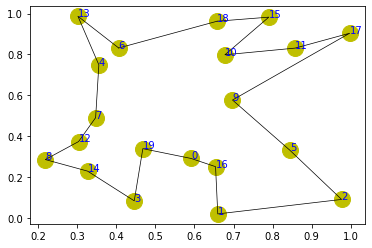

step:3495/5000, actic loss:-0.389, critic loss:0.425, L:4.685, 0min0sec
step:3496/5000, actic loss:-0.389, critic loss:0.425, L:4.685, 0min0sec
step:3497/5000, actic loss:-0.389, critic loss:0.425, L:4.685, 0min0sec
step:3498/5000, actic loss:-0.389, critic loss:0.425, L:4.685, 0min0sec
step:3499/5000, actic loss:-0.388, critic loss:0.424, L:4.685, 0min0sec
distance:4.440
tensor([15,  5, 19, 17,  1, 11,  2,  3, 14, 12,  0, 16,  7, 18, 13, 10,  4,  8,
         6,  9])


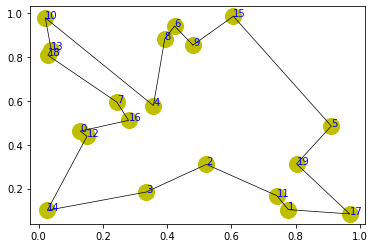

step:3500/5000, actic loss:-0.388, critic loss:0.424, L:4.685, 0min0sec
step:3501/5000, actic loss:-0.388, critic loss:0.424, L:4.685, 0min0sec
step:3502/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min0sec
step:3503/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min0sec
step:3504/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min0sec
distance:4.427
tensor([12, 10, 16,  2,  1,  5, 17,  7,  6, 15, 14,  8,  4,  3, 18, 19, 11, 13,
         9,  0])


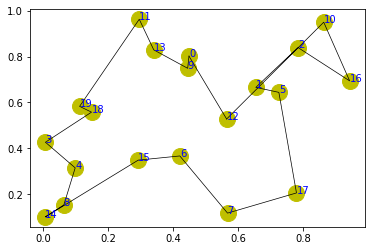

step:3505/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min1sec
step:3506/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min0sec
step:3507/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min0sec
step:3508/5000, actic loss:-0.388, critic loss:0.424, L:4.684, 0min0sec
step:3509/5000, actic loss:-0.387, critic loss:0.424, L:4.683, 0min0sec
distance:4.695
tensor([ 9,  1,  3, 13,  2,  7,  8,  6,  0,  4,  5, 14, 11, 18, 12, 15, 16, 17,
        10, 19])


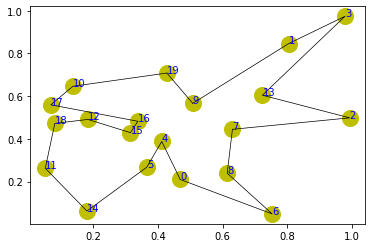

step:3510/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
step:3511/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
step:3512/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
step:3513/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
step:3514/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
distance:4.001
tensor([ 2,  4,  1,  6, 15,  7,  8, 13,  3, 16, 11, 14, 19,  0,  9, 18, 12,  5,
        17, 10])


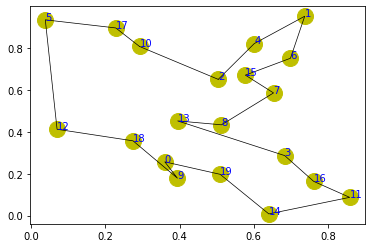

step:3515/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
step:3516/5000, actic loss:-0.387, critic loss:0.423, L:4.683, 0min0sec
step:3517/5000, actic loss:-0.387, critic loss:0.423, L:4.682, 0min0sec
step:3518/5000, actic loss:-0.387, critic loss:0.423, L:4.682, 0min0sec
step:3519/5000, actic loss:-0.387, critic loss:0.423, L:4.682, 0min0sec
distance:4.577
tensor([19, 17, 18,  5,  8,  2,  3,  4,  0, 10,  7, 15, 13, 12, 11,  9,  1,  6,
        16, 14])


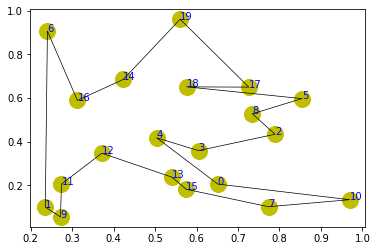

step:3520/5000, actic loss:-0.386, critic loss:0.423, L:4.682, 0min0sec
step:3521/5000, actic loss:-0.386, critic loss:0.422, L:4.682, 0min0sec
step:3522/5000, actic loss:-0.386, critic loss:0.422, L:4.682, 0min0sec
step:3523/5000, actic loss:-0.386, critic loss:0.422, L:4.682, 0min0sec
step:3524/5000, actic loss:-0.386, critic loss:0.422, L:4.682, 0min0sec
distance:4.313
tensor([ 2, 19, 13,  3,  4, 10, 15, 12, 14, 16,  1,  8,  6,  0,  9, 11,  5,  7,
        18, 17])


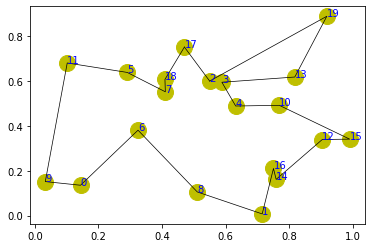

step:3525/5000, actic loss:-0.386, critic loss:0.422, L:4.681, 0min0sec
step:3526/5000, actic loss:-0.386, critic loss:0.422, L:4.681, 0min0sec
step:3527/5000, actic loss:-0.386, critic loss:0.422, L:4.681, 0min0sec
step:3528/5000, actic loss:-0.386, critic loss:0.422, L:4.681, 0min0sec
step:3529/5000, actic loss:-0.386, critic loss:0.422, L:4.681, 0min0sec
distance:4.184
tensor([ 8, 14, 19,  9, 17,  2, 15, 10,  3, 12,  5,  6, 16,  4,  1,  0, 11, 13,
         7, 18])


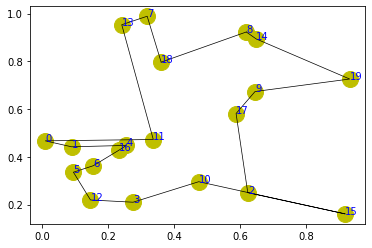

step:3530/5000, actic loss:-0.385, critic loss:0.422, L:4.681, 0min0sec
step:3531/5000, actic loss:-0.385, critic loss:0.422, L:4.681, 0min0sec
step:3532/5000, actic loss:-0.385, critic loss:0.421, L:4.681, 0min0sec
step:3533/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
step:3534/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
distance:3.850
tensor([ 0, 18,  3, 12, 14, 15, 11, 17,  4, 19,  7, 13,  5, 16,  1,  8,  6,  2,
         9, 10])


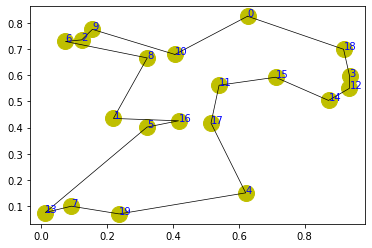

step:3535/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
step:3536/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
step:3537/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
step:3538/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
step:3539/5000, actic loss:-0.385, critic loss:0.421, L:4.680, 0min0sec
distance:4.030
tensor([ 9,  2, 10,  0,  8, 12, 16, 15,  6, 19,  4,  3, 13, 17,  5, 18,  7, 11,
         1, 14])


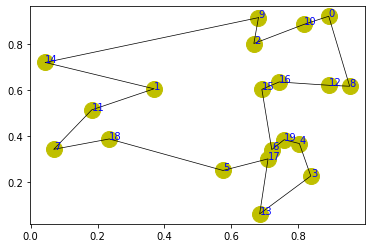

step:3540/5000, actic loss:-0.385, critic loss:0.421, L:4.679, 0min0sec
step:3541/5000, actic loss:-0.385, critic loss:0.421, L:4.679, 0min0sec
step:3542/5000, actic loss:-0.384, critic loss:0.421, L:4.679, 0min0sec
step:3543/5000, actic loss:-0.384, critic loss:0.420, L:4.679, 0min0sec
step:3544/5000, actic loss:-0.384, critic loss:0.420, L:4.679, 0min0sec
distance:3.854
tensor([11,  5,  0,  7, 14, 19, 16, 10, 13,  3, 15,  9,  1, 17,  8,  2, 18,  4,
        12,  6])


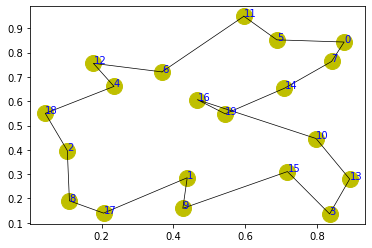

step:3545/5000, actic loss:-0.384, critic loss:0.420, L:4.679, 0min0sec
step:3546/5000, actic loss:-0.384, critic loss:0.420, L:4.679, 0min0sec
step:3547/5000, actic loss:-0.384, critic loss:0.420, L:4.678, 0min0sec
step:3548/5000, actic loss:-0.384, critic loss:0.420, L:4.678, 0min0sec
step:3549/5000, actic loss:-0.384, critic loss:0.420, L:4.678, 0min0sec
distance:4.963
tensor([11, 15,  8, 14, 13, 16,  1, 10,  6, 12,  4,  7, 17,  2, 19,  3,  5, 18,
         0,  9])


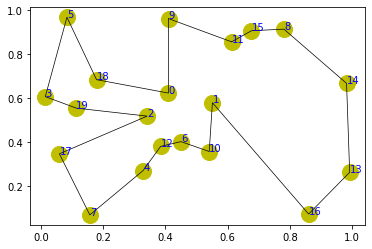

step:3550/5000, actic loss:-0.384, critic loss:0.420, L:4.678, 0min0sec
step:3551/5000, actic loss:-0.384, critic loss:0.420, L:4.678, 0min0sec
step:3552/5000, actic loss:-0.384, critic loss:0.420, L:4.678, 0min0sec
step:3553/5000, actic loss:-0.384, critic loss:0.419, L:4.678, 0min0sec
step:3554/5000, actic loss:-0.383, critic loss:0.419, L:4.678, 0min0sec
distance:4.837
tensor([19, 18,  9, 13, 11, 16,  0,  2,  7, 15, 14, 12,  6,  8,  1,  3, 10, 17,
         4,  5])


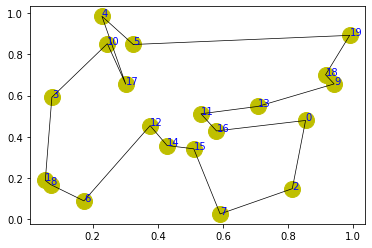

step:3555/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
step:3556/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
step:3557/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
step:3558/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
step:3559/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
distance:4.076
tensor([ 0, 17,  4,  8,  2, 10,  1, 18, 13, 15, 12,  5, 14,  3, 11, 19,  9, 16,
         7,  6])


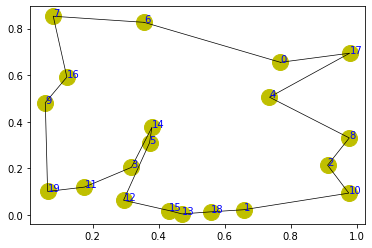

step:3560/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
step:3561/5000, actic loss:-0.383, critic loss:0.419, L:4.677, 0min0sec
step:3562/5000, actic loss:-0.383, critic loss:0.419, L:4.676, 0min0sec
step:3563/5000, actic loss:-0.383, critic loss:0.419, L:4.676, 0min0sec
step:3564/5000, actic loss:-0.382, critic loss:0.419, L:4.676, 0min0sec
distance:4.012
tensor([ 7,  2,  3,  0, 18,  5,  8, 10, 13, 17, 15,  4,  9, 11,  6,  1, 14, 16,
        19, 12])


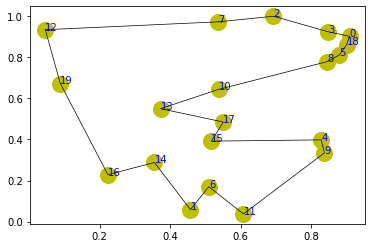

step:3565/5000, actic loss:-0.382, critic loss:0.418, L:4.676, 0min0sec
step:3566/5000, actic loss:-0.382, critic loss:0.418, L:4.676, 0min0sec
step:3567/5000, actic loss:-0.382, critic loss:0.418, L:4.676, 0min0sec
step:3568/5000, actic loss:-0.382, critic loss:0.418, L:4.676, 0min0sec
step:3569/5000, actic loss:-0.382, critic loss:0.418, L:4.676, 0min0sec
distance:4.671
tensor([18,  8, 17,  6, 19,  5, 14, 11,  9,  1, 13, 16,  2,  3, 15,  4,  0,  7,
        10, 12])


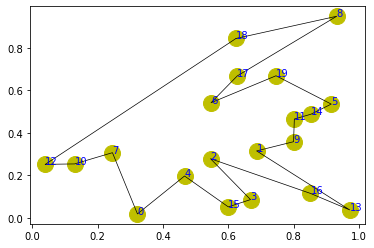

step:3570/5000, actic loss:-0.382, critic loss:0.418, L:4.676, 0min0sec
step:3571/5000, actic loss:-0.382, critic loss:0.418, L:4.675, 0min0sec
step:3572/5000, actic loss:-0.382, critic loss:0.418, L:4.675, 0min0sec
step:3573/5000, actic loss:-0.382, critic loss:0.418, L:4.675, 0min0sec
step:3574/5000, actic loss:-0.381, critic loss:0.418, L:4.675, 0min0sec
distance:4.072
tensor([ 4,  9, 10,  5,  2, 17,  0, 11,  1,  3, 16,  8, 13, 14, 12, 18,  6, 19,
        15,  7])


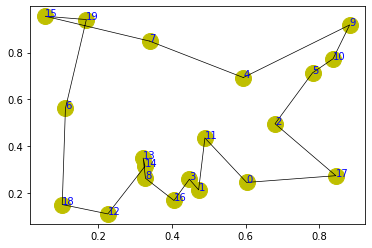

step:3575/5000, actic loss:-0.381, critic loss:0.418, L:4.675, 0min0sec
step:3576/5000, actic loss:-0.381, critic loss:0.418, L:4.675, 0min0sec
step:3577/5000, actic loss:-0.381, critic loss:0.417, L:4.675, 0min0sec
step:3578/5000, actic loss:-0.381, critic loss:0.417, L:4.675, 0min0sec
step:3579/5000, actic loss:-0.381, critic loss:0.417, L:4.675, 0min0sec
distance:4.408
tensor([12,  3,  6, 17, 13,  1,  2,  7, 10,  8,  9,  4, 19, 15, 14, 11,  0,  5,
        16, 18])


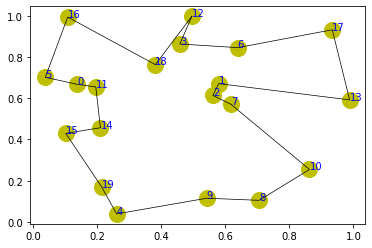

step:3580/5000, actic loss:-0.381, critic loss:0.417, L:4.675, 0min0sec
step:3581/5000, actic loss:-0.381, critic loss:0.417, L:4.674, 0min0sec
step:3582/5000, actic loss:-0.381, critic loss:0.417, L:4.674, 0min0sec
step:3583/5000, actic loss:-0.381, critic loss:0.417, L:4.674, 0min0sec
step:3584/5000, actic loss:-0.381, critic loss:0.417, L:4.674, 0min0sec
distance:4.621
tensor([ 9, 10, 17,  6,  0, 12, 19, 11, 14,  7,  3,  8,  4,  5, 18, 13,  2, 15,
        16,  1])


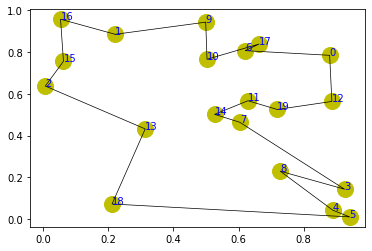

step:3585/5000, actic loss:-0.381, critic loss:0.417, L:4.674, 0min0sec
step:3586/5000, actic loss:-0.380, critic loss:0.417, L:4.674, 0min0sec
step:3587/5000, actic loss:-0.380, critic loss:0.417, L:4.674, 0min0sec
step:3588/5000, actic loss:-0.380, critic loss:0.417, L:4.674, 0min0sec
step:3589/5000, actic loss:-0.380, critic loss:0.416, L:4.674, 0min0sec
distance:4.598
tensor([14,  4,  3, 12, 10,  0, 16,  9, 11,  6,  1, 13,  2,  5, 19,  7,  8, 18,
        15, 17])


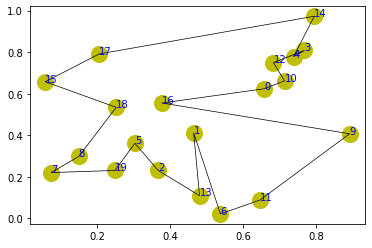

step:3590/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3591/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3592/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3593/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3594/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
distance:3.772
tensor([11, 13, 12,  2,  6,  7,  4, 15,  8,  3,  0, 19, 18, 10,  1,  5, 17,  9,
        16, 14])


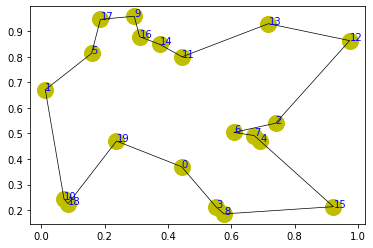

step:3595/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3596/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3597/5000, actic loss:-0.380, critic loss:0.416, L:4.673, 0min0sec
step:3598/5000, actic loss:-0.379, critic loss:0.416, L:4.673, 0min0sec
step:3599/5000, actic loss:-0.379, critic loss:0.416, L:4.672, 0min0sec
distance:3.734
tensor([19,  8,  6,  0,  2, 14,  4, 11,  9,  5, 10, 16,  1, 18, 17, 15,  3, 12,
         7, 13])


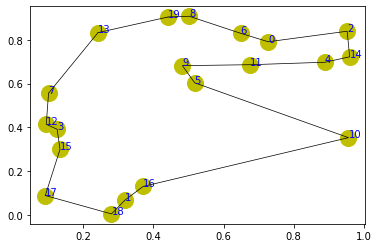

step:3600/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
step:3601/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
step:3602/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
step:3603/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
step:3604/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
distance:4.403
tensor([ 8, 15, 13, 12,  5,  6, 19,  0, 10, 11, 18, 16, 17,  1,  9,  7,  3,  4,
         2, 14])


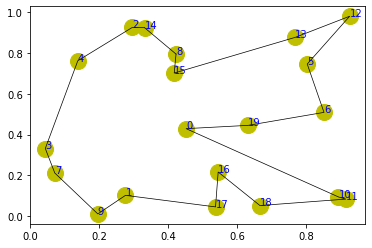

step:3605/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
step:3606/5000, actic loss:-0.379, critic loss:0.415, L:4.672, 0min0sec
step:3607/5000, actic loss:-0.379, critic loss:0.415, L:4.671, 0min0sec
step:3608/5000, actic loss:-0.378, critic loss:0.415, L:4.671, 0min0sec
step:3609/5000, actic loss:-0.378, critic loss:0.415, L:4.671, 0min0sec
distance:4.159
tensor([ 6, 11, 14, 12,  8, 15,  3, 17, 19,  1, 16, 18,  0,  7, 10,  2, 13,  5,
         9,  4])


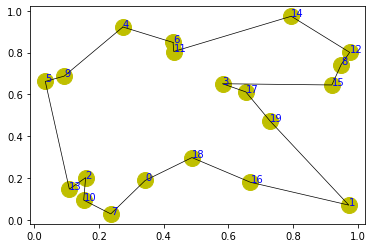

step:3610/5000, actic loss:-0.378, critic loss:0.415, L:4.671, 0min0sec
step:3611/5000, actic loss:-0.378, critic loss:0.414, L:4.671, 0min0sec
step:3612/5000, actic loss:-0.378, critic loss:0.414, L:4.671, 0min0sec
step:3613/5000, actic loss:-0.378, critic loss:0.414, L:4.671, 0min0sec
step:3614/5000, actic loss:-0.378, critic loss:0.414, L:4.671, 0min0sec
distance:3.592
tensor([12,  7,  8, 18, 14, 10, 19,  0, 15, 16,  9,  4, 11,  6,  1,  3,  2, 13,
        17,  5])


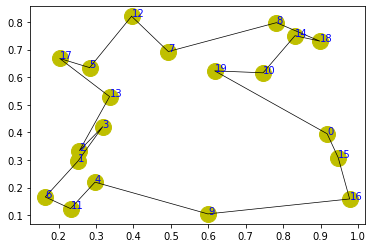

step:3615/5000, actic loss:-0.378, critic loss:0.414, L:4.670, 0min0sec
step:3616/5000, actic loss:-0.378, critic loss:0.414, L:4.670, 0min0sec
step:3617/5000, actic loss:-0.378, critic loss:0.414, L:4.670, 0min0sec
step:3618/5000, actic loss:-0.378, critic loss:0.414, L:4.670, 0min0sec
step:3619/5000, actic loss:-0.377, critic loss:0.414, L:4.670, 0min0sec
distance:4.508
tensor([ 5, 12,  4, 16,  2, 13, 10, 11,  1, 17, 18, 19, 15,  9,  6,  0,  8, 14,
         3,  7])


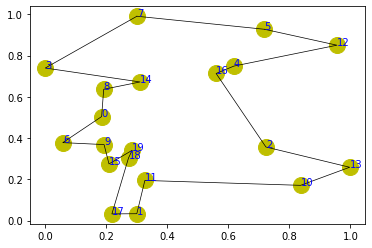

step:3620/5000, actic loss:-0.377, critic loss:0.414, L:4.670, 0min0sec
step:3621/5000, actic loss:-0.377, critic loss:0.414, L:4.670, 0min0sec
step:3622/5000, actic loss:-0.377, critic loss:0.414, L:4.670, 0min0sec
step:3623/5000, actic loss:-0.377, critic loss:0.413, L:4.669, 0min0sec
step:3624/5000, actic loss:-0.377, critic loss:0.413, L:4.669, 0min0sec
distance:4.032
tensor([ 2, 12, 15,  3, 17,  4, 11,  9,  8,  5, 16,  7, 14,  1,  6, 18, 10, 19,
         0, 13])


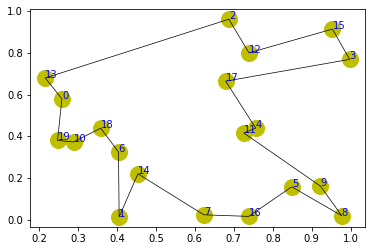

step:3625/5000, actic loss:-0.377, critic loss:0.413, L:4.669, 0min0sec
step:3626/5000, actic loss:-0.377, critic loss:0.413, L:4.669, 0min0sec
step:3627/5000, actic loss:-0.377, critic loss:0.413, L:4.669, 0min0sec
step:3628/5000, actic loss:-0.377, critic loss:0.413, L:4.669, 0min0sec
step:3629/5000, actic loss:-0.376, critic loss:0.413, L:4.669, 0min0sec
distance:3.907
tensor([18,  3, 13,  7, 10, 12,  1,  5,  2, 16, 14, 17,  9, 19, 11, 15,  8,  0,
         4,  6])


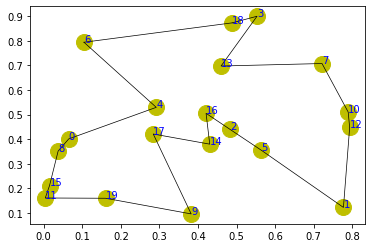

step:3630/5000, actic loss:-0.376, critic loss:0.413, L:4.669, 0min0sec
step:3631/5000, actic loss:-0.376, critic loss:0.413, L:4.668, 0min0sec
step:3632/5000, actic loss:-0.376, critic loss:0.413, L:4.668, 0min0sec
step:3633/5000, actic loss:-0.376, critic loss:0.413, L:4.668, 0min0sec
step:3634/5000, actic loss:-0.376, critic loss:0.413, L:4.668, 0min0sec
distance:3.900
tensor([ 3, 19, 13, 11,  2, 10,  8,  1,  4,  0, 17,  9, 16,  5, 18, 14,  7, 15,
         6, 12])


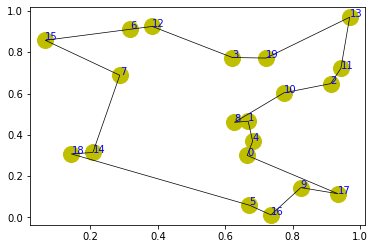

step:3635/5000, actic loss:-0.376, critic loss:0.412, L:4.668, 0min0sec
step:3636/5000, actic loss:-0.376, critic loss:0.412, L:4.668, 0min0sec
step:3637/5000, actic loss:-0.376, critic loss:0.412, L:4.668, 0min0sec
step:3638/5000, actic loss:-0.376, critic loss:0.412, L:4.668, 0min0sec
step:3639/5000, actic loss:-0.376, critic loss:0.412, L:4.668, 0min0sec
distance:3.811
tensor([ 2, 16, 19, 15, 10,  7,  6, 14,  3, 18, 11,  4, 12,  9,  0,  1,  5,  8,
        13, 17])


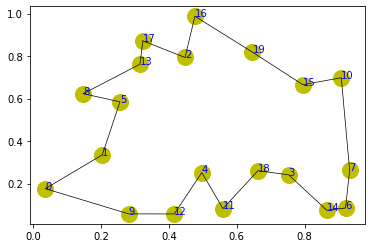

step:3640/5000, actic loss:-0.376, critic loss:0.412, L:4.667, 0min0sec
step:3641/5000, actic loss:-0.376, critic loss:0.412, L:4.667, 0min0sec
step:3642/5000, actic loss:-0.376, critic loss:0.412, L:4.667, 0min0sec
step:3643/5000, actic loss:-0.375, critic loss:0.412, L:4.667, 0min0sec
step:3644/5000, actic loss:-0.375, critic loss:0.412, L:4.667, 0min0sec
distance:3.842
tensor([15, 10, 13, 17,  1, 11, 14,  9, 18, 19,  2,  8,  5,  6,  7,  0, 16, 12,
         4,  3])


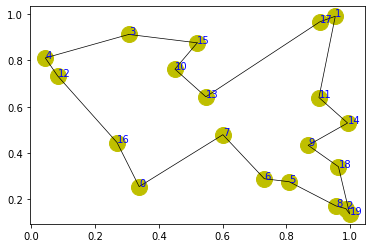

step:3645/5000, actic loss:-0.375, critic loss:0.412, L:4.667, 0min0sec
step:3646/5000, actic loss:-0.375, critic loss:0.412, L:4.667, 0min0sec
step:3647/5000, actic loss:-0.375, critic loss:0.412, L:4.667, 0min0sec
step:3648/5000, actic loss:-0.375, critic loss:0.411, L:4.666, 0min0sec
step:3649/5000, actic loss:-0.375, critic loss:0.411, L:4.666, 0min0sec
distance:3.575
tensor([10, 16, 14,  1,  3,  7, 19,  0,  8,  5, 15, 12, 18,  9,  6, 17,  2,  4,
        11, 13])


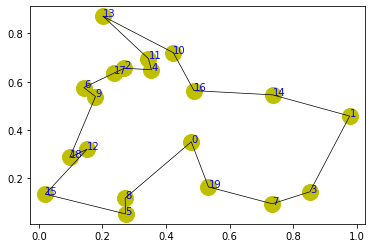

step:3650/5000, actic loss:-0.375, critic loss:0.411, L:4.666, 0min0sec
step:3651/5000, actic loss:-0.375, critic loss:0.411, L:4.666, 0min0sec
step:3652/5000, actic loss:-0.374, critic loss:0.411, L:4.666, 0min0sec
step:3653/5000, actic loss:-0.374, critic loss:0.411, L:4.666, 0min0sec
step:3654/5000, actic loss:-0.374, critic loss:0.411, L:4.666, 0min0sec
distance:4.456
tensor([ 3,  6,  9,  4, 16,  5,  0, 12, 18, 17,  2,  8, 10, 15, 14, 11,  1,  7,
        19, 13])


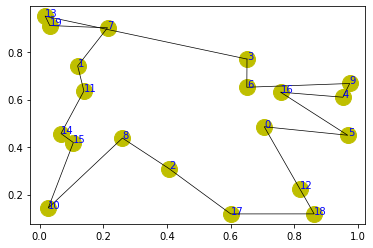

step:3655/5000, actic loss:-0.374, critic loss:0.411, L:4.666, 0min0sec
step:3656/5000, actic loss:-0.374, critic loss:0.411, L:4.665, 0min0sec
step:3657/5000, actic loss:-0.374, critic loss:0.411, L:4.665, 0min0sec
step:3658/5000, actic loss:-0.374, critic loss:0.411, L:4.665, 0min0sec
step:3659/5000, actic loss:-0.374, critic loss:0.410, L:4.665, 0min0sec
distance:3.909
tensor([ 5, 12, 17,  9, 16, 13, 19,  1, 14, 11,  3,  7, 18,  0,  2, 15,  4,  6,
        10,  8])


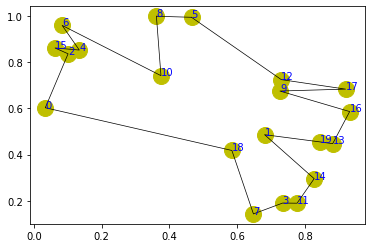

step:3660/5000, actic loss:-0.374, critic loss:0.410, L:4.665, 0min0sec
step:3661/5000, actic loss:-0.374, critic loss:0.410, L:4.665, 0min0sec
step:3662/5000, actic loss:-0.374, critic loss:0.410, L:4.665, 0min0sec
step:3663/5000, actic loss:-0.373, critic loss:0.410, L:4.665, 0min0sec
step:3664/5000, actic loss:-0.373, critic loss:0.410, L:4.665, 0min0sec
distance:4.512
tensor([ 8, 10, 17,  4, 11, 18, 15,  0, 12,  9, 19,  6,  1, 13, 14,  5, 16,  3,
         2,  7])


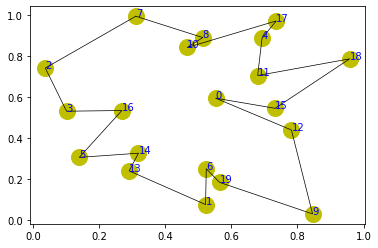

step:3665/5000, actic loss:-0.373, critic loss:0.410, L:4.664, 0min0sec
step:3666/5000, actic loss:-0.373, critic loss:0.410, L:4.664, 0min0sec
step:3667/5000, actic loss:-0.373, critic loss:0.410, L:4.664, 0min0sec
step:3668/5000, actic loss:-0.373, critic loss:0.410, L:4.664, 0min0sec
step:3669/5000, actic loss:-0.373, critic loss:0.410, L:4.664, 0min0sec
distance:3.674
tensor([14, 17, 10,  6, 18,  3, 15, 19, 13,  0,  4,  7,  2,  5,  1,  9, 12,  8,
        11, 16])


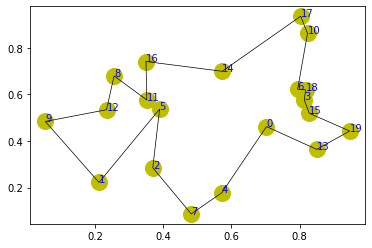

step:3670/5000, actic loss:-0.373, critic loss:0.410, L:4.664, 0min0sec
step:3671/5000, actic loss:-0.373, critic loss:0.409, L:4.664, 0min0sec
step:3672/5000, actic loss:-0.373, critic loss:0.409, L:4.664, 0min0sec
step:3673/5000, actic loss:-0.373, critic loss:0.409, L:4.663, 0min0sec
step:3674/5000, actic loss:-0.373, critic loss:0.409, L:4.663, 0min0sec
distance:4.576
tensor([18, 19, 10, 15,  7,  9,  5,  0,  8,  4, 16,  2,  1, 17, 12, 11,  3, 13,
        14,  6])


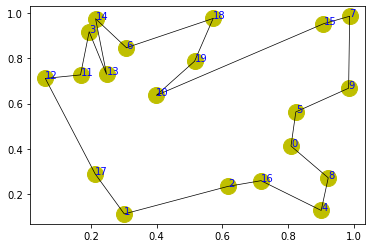

step:3675/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
step:3676/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
step:3677/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
step:3678/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
step:3679/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
distance:4.324
tensor([12,  6, 14,  0,  3,  5,  7,  8, 18,  4, 10, 15, 19,  2, 16,  1, 11, 17,
         9, 13])


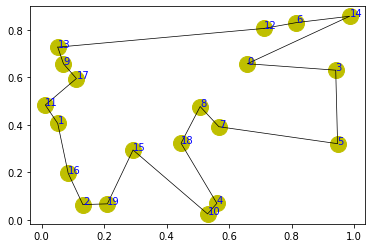

step:3680/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
step:3681/5000, actic loss:-0.372, critic loss:0.409, L:4.663, 0min0sec
step:3682/5000, actic loss:-0.372, critic loss:0.409, L:4.662, 0min0sec
step:3683/5000, actic loss:-0.372, critic loss:0.408, L:4.662, 0min0sec
step:3684/5000, actic loss:-0.372, critic loss:0.408, L:4.662, 0min0sec
distance:4.486
tensor([19,  8,  1,  0, 15, 12, 13, 11,  5,  2,  3,  7,  4,  6, 17, 16, 18, 14,
        10,  9])


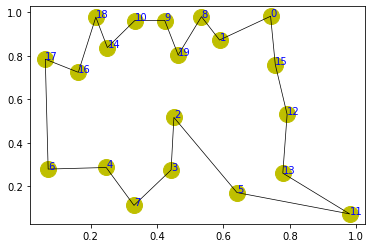

step:3685/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
step:3686/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
step:3687/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
step:3688/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
step:3689/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
distance:4.164
tensor([ 1, 14, 16, 13,  0,  6, 19,  7,  2, 17, 12,  3, 18, 10,  9,  8,  5, 15,
         4, 11])


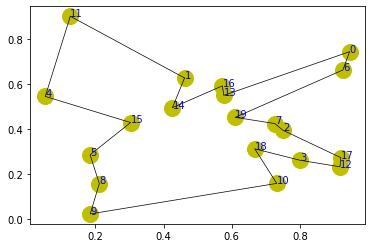

step:3690/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
step:3691/5000, actic loss:-0.371, critic loss:0.408, L:4.662, 0min0sec
step:3692/5000, actic loss:-0.371, critic loss:0.408, L:4.661, 0min0sec
step:3693/5000, actic loss:-0.371, critic loss:0.408, L:4.661, 0min0sec
step:3694/5000, actic loss:-0.371, critic loss:0.408, L:4.661, 0min0sec
distance:5.627
tensor([ 7,  1, 17, 14, 16, 10,  8,  9, 13, 11,  3,  0,  2, 15, 18,  6, 19,  4,
         5, 12])


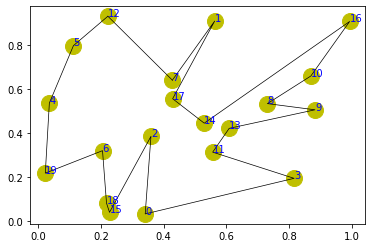

step:3695/5000, actic loss:-0.371, critic loss:0.408, L:4.661, 0min0sec
step:3696/5000, actic loss:-0.371, critic loss:0.407, L:4.661, 0min0sec
step:3697/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
step:3698/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
step:3699/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
distance:4.173
tensor([14, 10,  4,  0,  5,  3,  7, 18, 16, 12, 15,  1,  8, 11, 19, 13,  2,  6,
         9, 17])


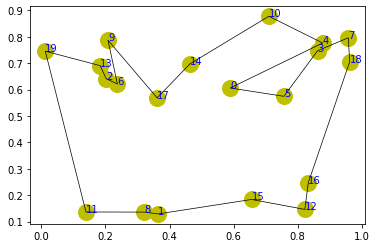

step:3700/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
step:3701/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
step:3702/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
step:3703/5000, actic loss:-0.370, critic loss:0.407, L:4.661, 0min0sec
step:3704/5000, actic loss:-0.370, critic loss:0.407, L:4.660, 0min0sec
distance:3.947
tensor([ 9, 12, 18, 14, 17,  5, 16, 13,  2,  3,  0,  6, 15, 19, 10,  7, 11,  4,
         8,  1])


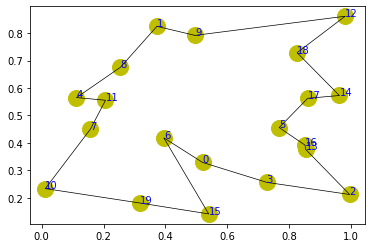

step:3705/5000, actic loss:-0.370, critic loss:0.407, L:4.660, 0min0sec
step:3706/5000, actic loss:-0.370, critic loss:0.407, L:4.660, 0min0sec
step:3707/5000, actic loss:-0.370, critic loss:0.407, L:4.660, 0min0sec
step:3708/5000, actic loss:-0.370, critic loss:0.407, L:4.660, 0min0sec
step:3709/5000, actic loss:-0.370, critic loss:0.407, L:4.660, 0min0sec
distance:5.093
tensor([ 0,  5,  1,  8,  9, 17,  4, 11, 15, 10,  2, 19, 12, 14,  7, 18, 16, 13,
         6,  3])


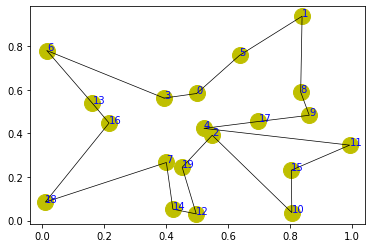

step:3710/5000, actic loss:-0.369, critic loss:0.406, L:4.660, 0min0sec
step:3711/5000, actic loss:-0.369, critic loss:0.406, L:4.660, 0min0sec
step:3712/5000, actic loss:-0.369, critic loss:0.406, L:4.660, 0min0sec
step:3713/5000, actic loss:-0.369, critic loss:0.406, L:4.660, 0min0sec
step:3714/5000, actic loss:-0.369, critic loss:0.406, L:4.659, 0min0sec
distance:4.178
tensor([11,  1,  4,  5, 14,  2, 18,  8,  9, 12, 16,  0, 13, 15, 10,  7,  6, 17,
         3, 19])


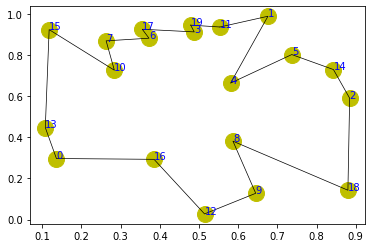

step:3715/5000, actic loss:-0.369, critic loss:0.406, L:4.659, 0min0sec
step:3716/5000, actic loss:-0.369, critic loss:0.406, L:4.659, 0min0sec
step:3717/5000, actic loss:-0.369, critic loss:0.406, L:4.659, 0min0sec
step:3718/5000, actic loss:-0.369, critic loss:0.406, L:4.659, 0min0sec
step:3719/5000, actic loss:-0.369, critic loss:0.406, L:4.659, 0min0sec
distance:4.346
tensor([14, 15,  6, 16, 18, 13,  1,  7,  8,  4, 19,  2,  9, 17,  0,  5, 11,  3,
        12, 10])


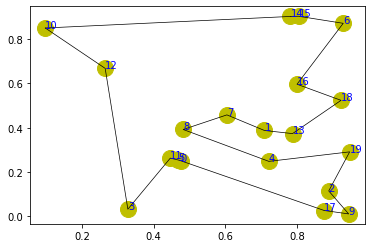

step:3720/5000, actic loss:-0.368, critic loss:0.406, L:4.659, 0min0sec
step:3721/5000, actic loss:-0.368, critic loss:0.406, L:4.659, 0min0sec
step:3722/5000, actic loss:-0.368, critic loss:0.406, L:4.659, 0min0sec
step:3723/5000, actic loss:-0.368, critic loss:0.405, L:4.658, 0min0sec
step:3724/5000, actic loss:-0.368, critic loss:0.405, L:4.658, 0min0sec
distance:4.653
tensor([ 0, 13, 19,  2,  8,  5, 14, 16,  6, 12, 17, 11,  3,  7, 10,  1, 15,  4,
        18,  9])


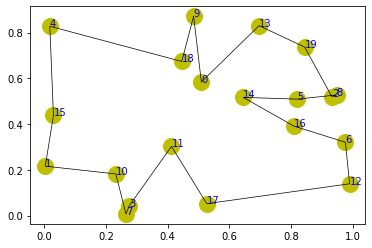

step:3725/5000, actic loss:-0.368, critic loss:0.405, L:4.658, 0min0sec
step:3726/5000, actic loss:-0.368, critic loss:0.405, L:4.658, 0min0sec
step:3727/5000, actic loss:-0.368, critic loss:0.405, L:4.658, 0min0sec
step:3728/5000, actic loss:-0.368, critic loss:0.405, L:4.658, 0min0sec
step:3729/5000, actic loss:-0.367, critic loss:0.405, L:4.658, 0min0sec
distance:4.221
tensor([19, 11,  6,  8,  9,  7,  5,  4, 12, 13, 17, 18,  0,  3, 16, 10,  2, 15,
        14,  1])


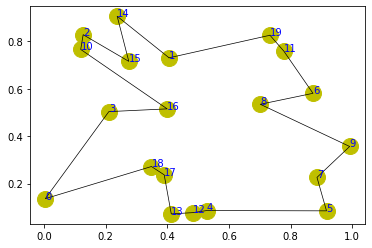

step:3730/5000, actic loss:-0.367, critic loss:0.405, L:4.658, 0min0sec
step:3731/5000, actic loss:-0.367, critic loss:0.405, L:4.658, 0min0sec
step:3732/5000, actic loss:-0.367, critic loss:0.405, L:4.657, 0min0sec
step:3733/5000, actic loss:-0.367, critic loss:0.405, L:4.657, 0min0sec
step:3734/5000, actic loss:-0.367, critic loss:0.405, L:4.657, 0min0sec
distance:4.516
tensor([ 4,  8, 19,  3, 13, 12,  5,  9, 10, 18,  1,  7,  0, 11,  2,  6, 15, 14,
        17, 16])


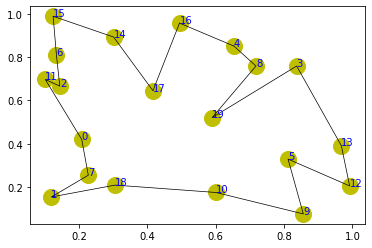

step:3735/5000, actic loss:-0.367, critic loss:0.405, L:4.657, 0min0sec
step:3736/5000, actic loss:-0.367, critic loss:0.404, L:4.657, 0min0sec
step:3737/5000, actic loss:-0.367, critic loss:0.404, L:4.657, 0min0sec
step:3738/5000, actic loss:-0.367, critic loss:0.404, L:4.657, 0min0sec
step:3739/5000, actic loss:-0.367, critic loss:0.404, L:4.657, 0min0sec
distance:4.066
tensor([19, 13,  4,  0, 14,  2, 12,  8,  3,  1, 16, 18,  6, 17, 10,  5, 15,  7,
        11,  9])


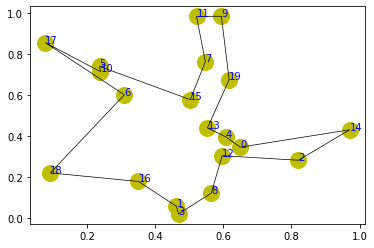

step:3740/5000, actic loss:-0.367, critic loss:0.404, L:4.657, 0min0sec
step:3741/5000, actic loss:-0.367, critic loss:0.404, L:4.657, 0min0sec
step:3742/5000, actic loss:-0.367, critic loss:0.404, L:4.656, 0min0sec
step:3743/5000, actic loss:-0.366, critic loss:0.404, L:4.656, 0min0sec
step:3744/5000, actic loss:-0.366, critic loss:0.404, L:4.656, 0min0sec
distance:4.837
tensor([ 3,  2, 12,  0,  1, 15, 13,  9, 19,  7, 14, 10, 11,  4, 16, 18,  8,  5,
        17,  6])


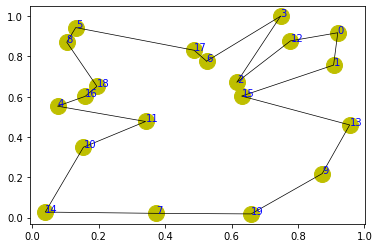

step:3745/5000, actic loss:-0.366, critic loss:0.404, L:4.656, 0min0sec
step:3746/5000, actic loss:-0.366, critic loss:0.404, L:4.656, 0min0sec
step:3747/5000, actic loss:-0.366, critic loss:0.404, L:4.656, 0min0sec
step:3748/5000, actic loss:-0.366, critic loss:0.403, L:4.656, 0min0sec
step:3749/5000, actic loss:-0.366, critic loss:0.403, L:4.656, 0min0sec
distance:3.440
tensor([ 4, 12, 10,  7, 14,  8, 15, 11,  3, 13, 18,  9, 16,  0,  6,  5,  1, 17,
         2, 19])


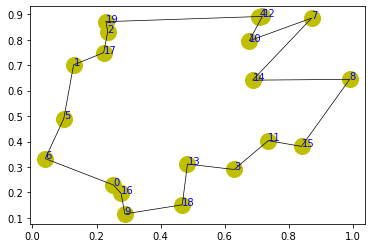

step:3750/5000, actic loss:-0.366, critic loss:0.403, L:4.656, 0min0sec
step:3751/5000, actic loss:-0.366, critic loss:0.403, L:4.655, 0min0sec
step:3752/5000, actic loss:-0.366, critic loss:0.403, L:4.655, 0min0sec
step:3753/5000, actic loss:-0.366, critic loss:0.403, L:4.655, 0min0sec
step:3754/5000, actic loss:-0.366, critic loss:0.403, L:4.655, 0min0sec
distance:3.960
tensor([11, 18,  4,  1, 13,  9,  6,  7,  8, 15, 14, 17, 12,  5, 19,  2, 16, 10,
         0,  3])


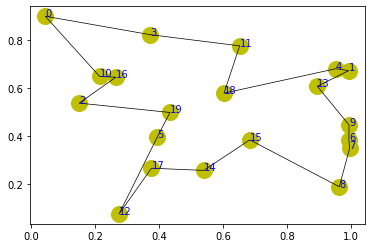

step:3755/5000, actic loss:-0.365, critic loss:0.403, L:4.655, 0min0sec
step:3756/5000, actic loss:-0.365, critic loss:0.403, L:4.655, 0min0sec
step:3757/5000, actic loss:-0.365, critic loss:0.403, L:4.655, 0min0sec
step:3758/5000, actic loss:-0.365, critic loss:0.403, L:4.655, 0min0sec
step:3759/5000, actic loss:-0.365, critic loss:0.403, L:4.654, 0min0sec
distance:3.957
tensor([ 3, 15,  5, 17,  1,  6, 18, 12, 13,  2,  7, 11, 10, 16, 14,  4,  8, 19,
         9,  0])


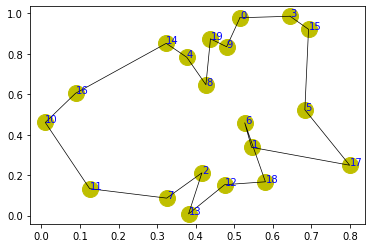

step:3760/5000, actic loss:-0.365, critic loss:0.403, L:4.654, 0min0sec
step:3761/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
step:3762/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
step:3763/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
step:3764/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
distance:3.936
tensor([ 5,  1,  0,  3,  2,  8, 16, 19,  6,  4, 15, 18,  9,  7, 13, 11, 14, 10,
        17, 12])


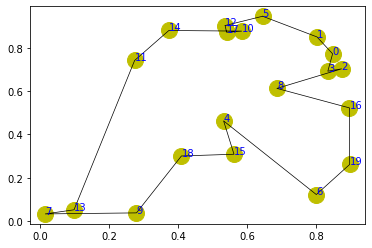

step:3765/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
step:3766/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
step:3767/5000, actic loss:-0.365, critic loss:0.402, L:4.654, 0min0sec
step:3768/5000, actic loss:-0.364, critic loss:0.402, L:4.653, 0min0sec
step:3769/5000, actic loss:-0.364, critic loss:0.402, L:4.653, 0min0sec
distance:4.539
tensor([17, 16,  6,  2, 10,  5, 19, 18,  8,  0,  7,  4,  1, 13, 15,  3, 14, 11,
         9, 12])


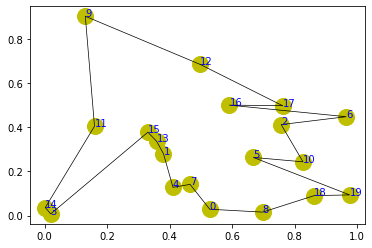

step:3770/5000, actic loss:-0.364, critic loss:0.402, L:4.653, 0min0sec
step:3771/5000, actic loss:-0.364, critic loss:0.402, L:4.653, 0min0sec
step:3772/5000, actic loss:-0.364, critic loss:0.402, L:4.653, 0min0sec
step:3773/5000, actic loss:-0.364, critic loss:0.401, L:4.653, 0min0sec
step:3774/5000, actic loss:-0.364, critic loss:0.401, L:4.653, 0min0sec
distance:3.756
tensor([16, 14,  9, 10, 15,  3,  4,  1,  0,  5,  8, 18, 13, 12,  7, 17, 19, 11,
         6,  2])


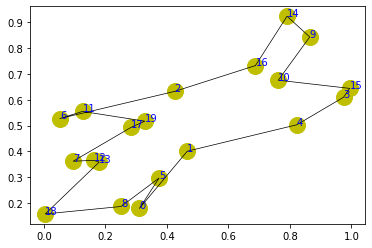

step:3775/5000, actic loss:-0.364, critic loss:0.401, L:4.653, 0min0sec
step:3776/5000, actic loss:-0.364, critic loss:0.401, L:4.653, 0min0sec
step:3777/5000, actic loss:-0.364, critic loss:0.401, L:4.653, 0min0sec
step:3778/5000, actic loss:-0.364, critic loss:0.401, L:4.652, 0min0sec
step:3779/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
distance:4.196
tensor([12,  3,  5,  2,  9, 17, 14,  6, 10,  0, 19, 16,  7, 15,  8,  1, 13, 18,
         4, 11])


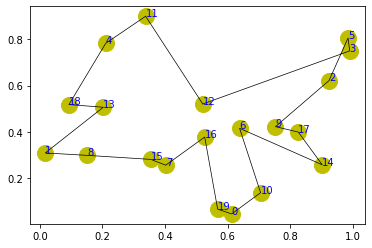

step:3780/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
step:3781/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
step:3782/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
step:3783/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
step:3784/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
distance:4.079
tensor([ 0,  1,  8,  4, 15,  6,  3, 17, 13,  5, 11,  2, 16, 10, 14, 19,  7, 18,
        12,  9])


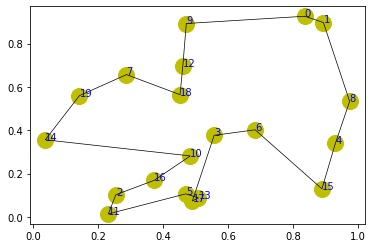

step:3785/5000, actic loss:-0.363, critic loss:0.401, L:4.652, 0min0sec
step:3786/5000, actic loss:-0.363, critic loss:0.400, L:4.652, 0min0sec
step:3787/5000, actic loss:-0.363, critic loss:0.400, L:4.652, 0min0sec
step:3788/5000, actic loss:-0.363, critic loss:0.400, L:4.651, 0min0sec
step:3789/5000, actic loss:-0.363, critic loss:0.400, L:4.651, 0min0sec
distance:4.226
tensor([15,  2, 12, 16,  7, 19,  4,  8,  3, 18,  6,  9, 17,  5,  0, 13, 10,  1,
        14, 11])


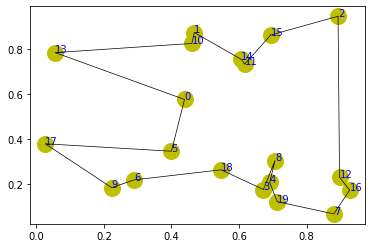

step:3790/5000, actic loss:-0.363, critic loss:0.400, L:4.651, 0min0sec
step:3791/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3792/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3793/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3794/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
distance:3.803
tensor([14,  5,  3, 18, 10, 12,  8, 15,  9, 13, 16,  2,  7, 19,  1,  6, 11, 17,
         0,  4])


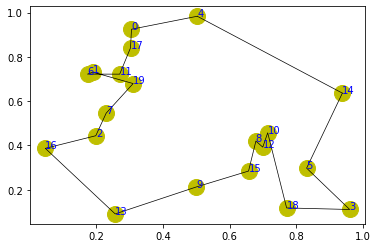

step:3795/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3796/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3797/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3798/5000, actic loss:-0.362, critic loss:0.400, L:4.651, 0min0sec
step:3799/5000, actic loss:-0.362, critic loss:0.400, L:4.650, 0min0sec
distance:4.717
tensor([ 9, 18,  6, 11,  5,  7, 10, 14, 12,  1,  8,  0,  4, 15,  2, 16, 17,  3,
        13, 19])


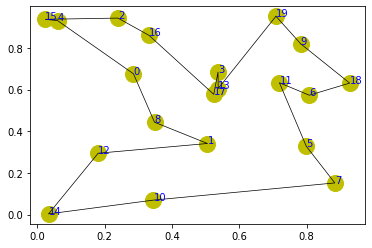

step:3800/5000, actic loss:-0.362, critic loss:0.400, L:4.650, 0min0sec
step:3801/5000, actic loss:-0.362, critic loss:0.399, L:4.650, 0min0sec
step:3802/5000, actic loss:-0.362, critic loss:0.399, L:4.650, 0min0sec
step:3803/5000, actic loss:-0.362, critic loss:0.399, L:4.650, 0min0sec
step:3804/5000, actic loss:-0.362, critic loss:0.399, L:4.650, 0min0sec
distance:3.862
tensor([ 8,  7, 15,  0, 19,  4, 18, 13,  2, 11, 16, 17,  6, 14,  9, 12,  5, 10,
         1,  3])


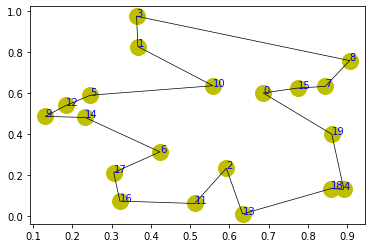

step:3805/5000, actic loss:-0.362, critic loss:0.399, L:4.650, 0min0sec
step:3806/5000, actic loss:-0.362, critic loss:0.399, L:4.650, 0min0sec
step:3807/5000, actic loss:-0.361, critic loss:0.399, L:4.650, 0min0sec
step:3808/5000, actic loss:-0.361, critic loss:0.399, L:4.650, 0min0sec
step:3809/5000, actic loss:-0.361, critic loss:0.399, L:4.650, 0min0sec
distance:4.150
tensor([ 7, 19, 12, 18, 17,  9,  8,  1,  5, 11, 14, 10, 15, 16,  2,  0,  6, 13,
         4,  3])


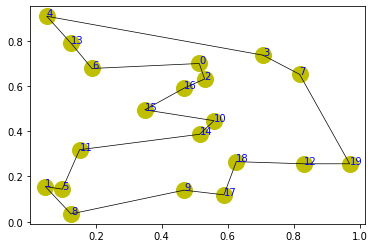

step:3810/5000, actic loss:-0.361, critic loss:0.399, L:4.650, 0min0sec
step:3811/5000, actic loss:-0.361, critic loss:0.399, L:4.649, 0min0sec
step:3812/5000, actic loss:-0.361, critic loss:0.399, L:4.649, 0min0sec
step:3813/5000, actic loss:-0.361, critic loss:0.399, L:4.649, 0min0sec
step:3814/5000, actic loss:-0.361, critic loss:0.399, L:4.649, 0min0sec
distance:4.525
tensor([17,  3, 12,  7, 19, 14, 10,  1,  5,  8, 11,  0, 13,  2,  6,  4, 18, 15,
        16,  9])


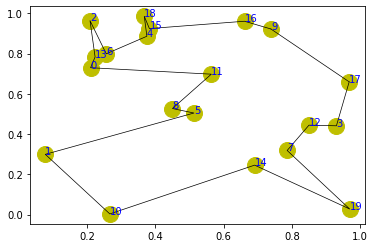

step:3815/5000, actic loss:-0.361, critic loss:0.398, L:4.649, 0min0sec
step:3816/5000, actic loss:-0.361, critic loss:0.398, L:4.649, 0min0sec
step:3817/5000, actic loss:-0.361, critic loss:0.398, L:4.649, 0min0sec
step:3818/5000, actic loss:-0.361, critic loss:0.398, L:4.649, 0min0sec
step:3819/5000, actic loss:-0.361, critic loss:0.398, L:4.649, 0min0sec
distance:5.160
tensor([ 2,  1,  5,  3, 12,  9,  0, 13, 17, 16, 18,  6, 10,  7, 14,  8, 15, 11,
        19,  4])


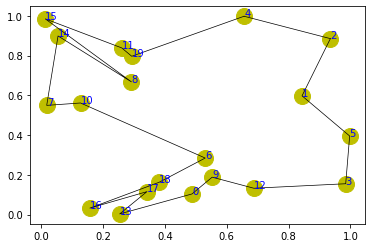

step:3820/5000, actic loss:-0.361, critic loss:0.398, L:4.649, 0min0sec
step:3821/5000, actic loss:-0.360, critic loss:0.398, L:4.649, 0min0sec
step:3822/5000, actic loss:-0.360, critic loss:0.398, L:4.649, 0min0sec
step:3823/5000, actic loss:-0.360, critic loss:0.398, L:4.649, 0min0sec
step:3824/5000, actic loss:-0.360, critic loss:0.398, L:4.648, 0min0sec
distance:3.768
tensor([ 7, 12, 18, 10,  2,  3,  8, 11, 14,  5, 15,  4,  1, 17, 13,  9, 16,  6,
        19,  0])


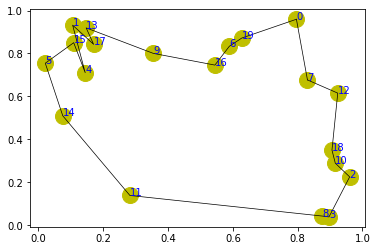

step:3825/5000, actic loss:-0.360, critic loss:0.398, L:4.648, 0min0sec
step:3826/5000, actic loss:-0.360, critic loss:0.398, L:4.648, 0min0sec
step:3827/5000, actic loss:-0.360, critic loss:0.398, L:4.648, 0min0sec
step:3828/5000, actic loss:-0.360, critic loss:0.398, L:4.648, 0min0sec
step:3829/5000, actic loss:-0.360, critic loss:0.398, L:4.648, 0min0sec
distance:4.123
tensor([ 7, 18, 14,  4, 10,  0,  6,  2,  1, 16, 19,  9, 15,  8, 13,  3, 17, 11,
        12,  5])


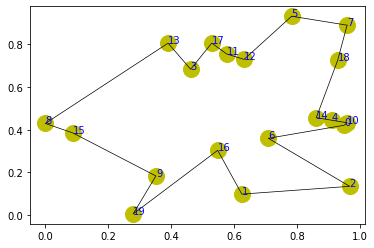

step:3830/5000, actic loss:-0.360, critic loss:0.397, L:4.648, 0min0sec
step:3831/5000, actic loss:-0.360, critic loss:0.397, L:4.648, 0min0sec
step:3832/5000, actic loss:-0.360, critic loss:0.397, L:4.648, 0min0sec
step:3833/5000, actic loss:-0.359, critic loss:0.397, L:4.648, 0min0sec
step:3834/5000, actic loss:-0.359, critic loss:0.397, L:4.648, 0min0sec
distance:4.477
tensor([18,  1,  0,  5, 11, 15, 12,  2, 13, 17, 19,  8,  4,  7,  9, 16,  3, 14,
        10,  6])


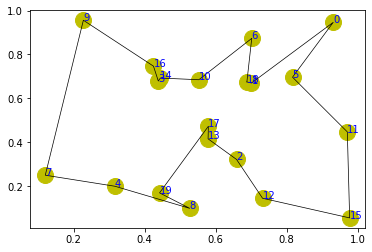

step:3835/5000, actic loss:-0.359, critic loss:0.397, L:4.648, 0min0sec
step:3836/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3837/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3838/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3839/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
distance:4.250
tensor([ 6,  0,  5, 12, 10,  3, 18,  2, 14,  7, 15, 13, 16, 19,  9,  8, 11, 17,
         4,  1])


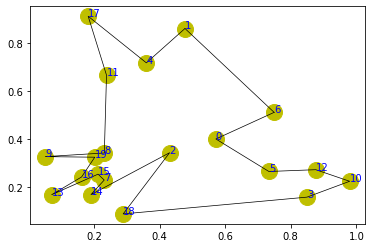

step:3840/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3841/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3842/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3843/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
step:3844/5000, actic loss:-0.359, critic loss:0.397, L:4.647, 0min0sec
distance:4.895
tensor([10,  0, 19,  1, 15, 13,  8, 16,  6,  5,  7,  3,  4,  2, 12, 11, 18, 17,
         9, 14])


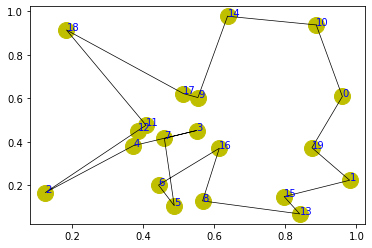

step:3845/5000, actic loss:-0.358, critic loss:0.397, L:4.647, 0min0sec
step:3846/5000, actic loss:-0.358, critic loss:0.396, L:4.647, 0min0sec
step:3847/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3848/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3849/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
distance:3.342
tensor([13, 12,  8,  1,  6,  9,  0, 16, 14, 17,  3,  7, 19,  5,  4,  2, 18, 11,
        10, 15])


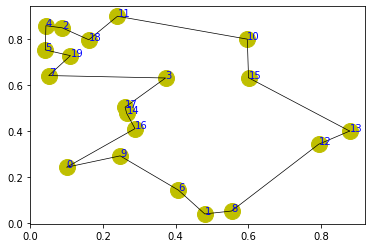

step:3850/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3851/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3852/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3853/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3854/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
distance:4.292
tensor([ 2,  9, 11, 14, 17,  5,  7,  6,  8, 15, 19, 12, 13, 16, 18,  4,  3, 10,
         0,  1])


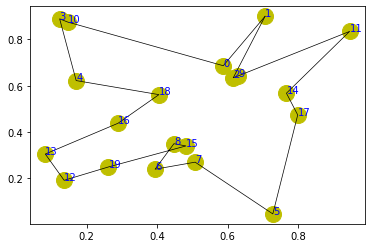

step:3855/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3856/5000, actic loss:-0.358, critic loss:0.396, L:4.646, 0min0sec
step:3857/5000, actic loss:-0.358, critic loss:0.396, L:4.645, 0min0sec
step:3858/5000, actic loss:-0.357, critic loss:0.396, L:4.645, 0min0sec
step:3859/5000, actic loss:-0.357, critic loss:0.396, L:4.645, 0min0sec
distance:4.537
tensor([17,  0,  9, 11, 19, 12,  3,  7, 14, 18, 16,  8,  1, 13,  2, 10,  4, 15,
         5,  6])


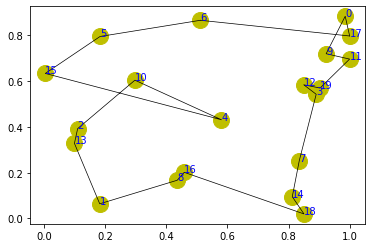

step:3860/5000, actic loss:-0.357, critic loss:0.396, L:4.645, 0min0sec
step:3861/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
step:3862/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
step:3863/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
step:3864/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
distance:4.633
tensor([10,  0, 13, 17, 15,  4, 11,  6, 18,  8,  1,  3, 16, 12, 14,  9,  7,  2,
        19,  5])


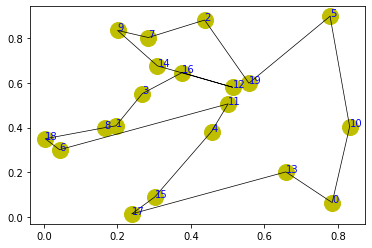

step:3865/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
step:3866/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
step:3867/5000, actic loss:-0.357, critic loss:0.395, L:4.645, 0min0sec
step:3868/5000, actic loss:-0.357, critic loss:0.395, L:4.644, 0min0sec
step:3869/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
distance:3.952
tensor([13, 14, 17, 10,  7,  6,  0,  2, 18, 11,  9, 15,  3,  5,  8, 12, 19, 16,
         1,  4])


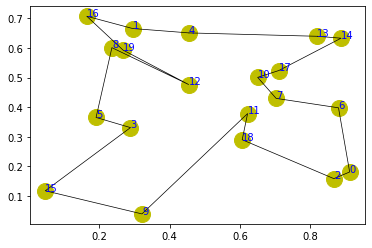

step:3870/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
step:3871/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
step:3872/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
step:3873/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
step:3874/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
distance:4.428
tensor([ 1, 12, 14,  6,  9, 15, 17,  7,  2, 18,  8,  4, 11, 13, 19, 16, 10,  3,
         5,  0])


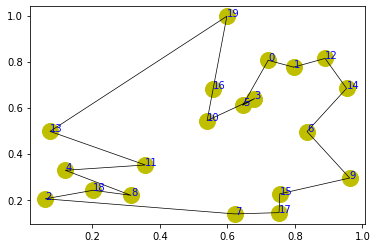

step:3875/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
step:3876/5000, actic loss:-0.356, critic loss:0.395, L:4.644, 0min0sec
step:3877/5000, actic loss:-0.356, critic loss:0.394, L:4.644, 0min0sec
step:3878/5000, actic loss:-0.356, critic loss:0.394, L:4.644, 0min0sec
step:3879/5000, actic loss:-0.356, critic loss:0.394, L:4.644, 0min0sec
distance:4.479
tensor([19, 15, 10, 16, 17,  9, 14,  3,  6,  4,  8, 11, 13,  2, 12,  7,  1,  0,
         5, 18])


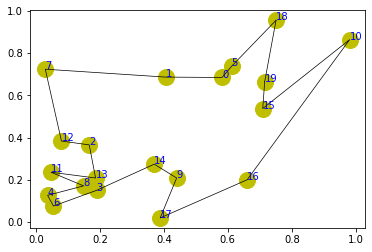

step:3880/5000, actic loss:-0.356, critic loss:0.394, L:4.644, 0min0sec
step:3881/5000, actic loss:-0.356, critic loss:0.394, L:4.644, 0min0sec
step:3882/5000, actic loss:-0.356, critic loss:0.394, L:4.644, 0min0sec
step:3883/5000, actic loss:-0.356, critic loss:0.394, L:4.643, 0min0sec
step:3884/5000, actic loss:-0.356, critic loss:0.394, L:4.643, 0min0sec
distance:4.544
tensor([11,  6,  8, 19, 10,  0, 16,  2, 17, 14,  7, 12,  1, 18, 15, 13,  4,  5,
         3,  9])


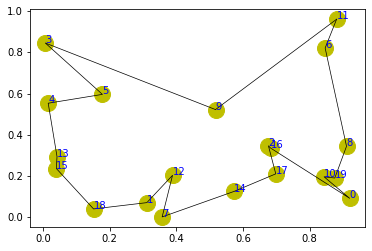

step:3885/5000, actic loss:-0.356, critic loss:0.394, L:4.643, 0min0sec
step:3886/5000, actic loss:-0.356, critic loss:0.394, L:4.643, 0min0sec
step:3887/5000, actic loss:-0.355, critic loss:0.394, L:4.643, 0min0sec
step:3888/5000, actic loss:-0.355, critic loss:0.394, L:4.643, 0min0sec
step:3889/5000, actic loss:-0.355, critic loss:0.394, L:4.643, 0min0sec
distance:4.534
tensor([ 0, 15,  8,  9, 17,  5, 19, 18,  2, 14, 10, 16,  4,  1, 11,  7,  6,  3,
        12, 13])


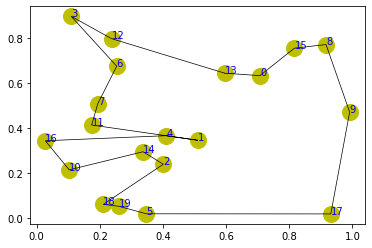

step:3890/5000, actic loss:-0.355, critic loss:0.394, L:4.643, 0min0sec
step:3891/5000, actic loss:-0.355, critic loss:0.393, L:4.643, 0min0sec
step:3892/5000, actic loss:-0.355, critic loss:0.393, L:4.643, 0min0sec
step:3893/5000, actic loss:-0.355, critic loss:0.393, L:4.643, 0min0sec
step:3894/5000, actic loss:-0.355, critic loss:0.393, L:4.643, 0min0sec
distance:4.544
tensor([15,  1,  3, 13,  6, 11,  9,  2, 18, 14,  5,  7, 10,  8, 19, 17, 12,  0,
        16,  4])


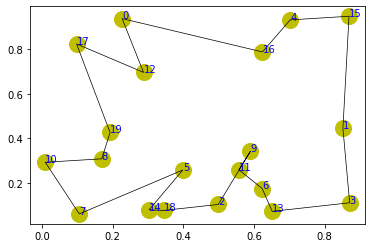

step:3895/5000, actic loss:-0.355, critic loss:0.393, L:4.642, 0min0sec
step:3896/5000, actic loss:-0.355, critic loss:0.393, L:4.642, 0min0sec
step:3897/5000, actic loss:-0.355, critic loss:0.393, L:4.642, 0min0sec
step:3898/5000, actic loss:-0.355, critic loss:0.393, L:4.642, 0min0sec
step:3899/5000, actic loss:-0.355, critic loss:0.393, L:4.642, 0min0sec
distance:4.419
tensor([ 8,  2, 12, 14, 19,  3,  4,  7, 11,  9, 15, 10, 17,  5, 18,  6,  1,  0,
        13, 16])


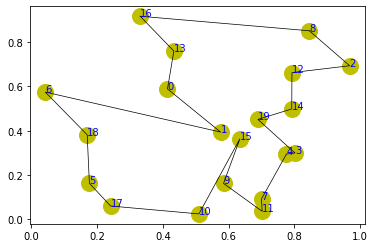

step:3900/5000, actic loss:-0.355, critic loss:0.393, L:4.642, 0min0sec
step:3901/5000, actic loss:-0.354, critic loss:0.393, L:4.642, 0min0sec
step:3902/5000, actic loss:-0.354, critic loss:0.393, L:4.642, 0min0sec
step:3903/5000, actic loss:-0.354, critic loss:0.393, L:4.642, 0min0sec
step:3904/5000, actic loss:-0.354, critic loss:0.393, L:4.642, 0min0sec
distance:4.010
tensor([ 4,  8, 10, 12,  1,  6,  3, 15, 14, 16,  0, 18, 17,  5, 19,  2,  9, 13,
        11,  7])


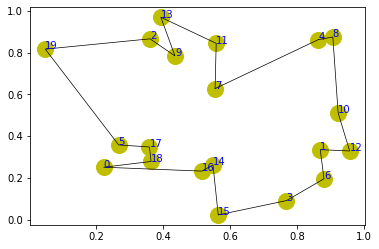

step:3905/5000, actic loss:-0.354, critic loss:0.393, L:4.642, 0min0sec
step:3906/5000, actic loss:-0.354, critic loss:0.393, L:4.642, 0min0sec
step:3907/5000, actic loss:-0.354, critic loss:0.392, L:4.642, 0min0sec
step:3908/5000, actic loss:-0.354, critic loss:0.392, L:4.642, 0min0sec
step:3909/5000, actic loss:-0.354, critic loss:0.392, L:4.642, 0min0sec
distance:4.017
tensor([ 4,  7,  8, 16, 15, 17,  1, 18, 13, 19, 14,  9,  2, 10, 11,  5,  0,  6,
        12,  3])


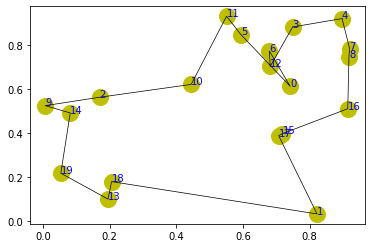

step:3910/5000, actic loss:-0.354, critic loss:0.392, L:4.641, 0min0sec
step:3911/5000, actic loss:-0.354, critic loss:0.392, L:4.641, 0min0sec
step:3912/5000, actic loss:-0.354, critic loss:0.392, L:4.641, 0min0sec
step:3913/5000, actic loss:-0.354, critic loss:0.392, L:4.641, 0min0sec
step:3914/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
distance:5.235
tensor([ 4, 11,  7,  2, 17,  6,  9, 16, 15, 18,  3, 14, 13,  8,  1,  0, 19, 10,
         5, 12])


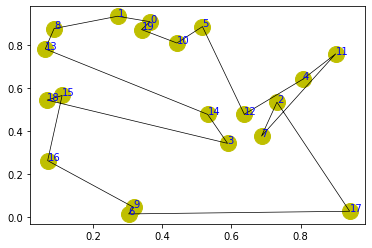

step:3915/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3916/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3917/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3918/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3919/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
distance:4.461
tensor([ 2, 12, 15, 18, 10,  8,  3, 14, 13,  4, 19, 17,  0,  1, 16,  6,  7,  5,
        11,  9])


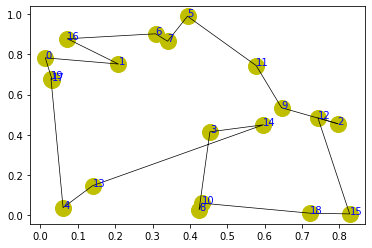

step:3920/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3921/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3922/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3923/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3924/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
distance:4.389
tensor([13, 14,  2,  7, 11,  9,  1, 10,  5,  8,  6, 15, 17, 16, 12, 18,  0,  3,
         4, 19])


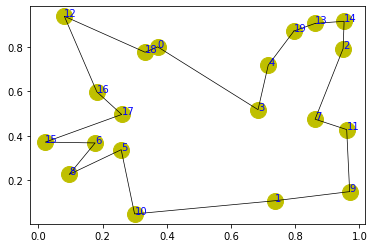

step:3925/5000, actic loss:-0.353, critic loss:0.392, L:4.641, 0min0sec
step:3926/5000, actic loss:-0.353, critic loss:0.391, L:4.641, 0min0sec
step:3927/5000, actic loss:-0.353, critic loss:0.391, L:4.641, 0min0sec
step:3928/5000, actic loss:-0.352, critic loss:0.391, L:4.641, 0min0sec
step:3929/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
distance:4.867
tensor([11, 13,  3,  7,  8, 10,  4, 15,  9, 16,  1, 14,  0,  5, 12, 17,  2,  6,
        18, 19])


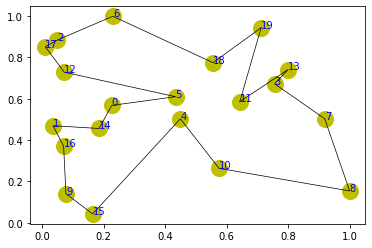

step:3930/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3931/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3932/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3933/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3934/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
distance:4.661
tensor([19,  7, 15, 11,  2, 10, 14,  3, 13,  6, 17,  4,  1, 16,  9,  5, 18,  0,
        12,  8])


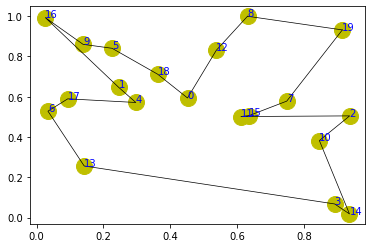

step:3935/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3936/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3937/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3938/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
step:3939/5000, actic loss:-0.352, critic loss:0.391, L:4.640, 0min0sec
distance:4.434
tensor([ 4, 16, 10,  1,  2, 11,  6,  7,  9, 14,  8,  5, 15, 12, 19, 18, 13,  3,
        17,  0])


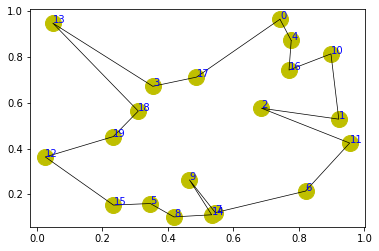

step:3940/5000, actic loss:-0.352, critic loss:0.390, L:4.639, 0min0sec
step:3941/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3942/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3943/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3944/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
distance:4.385
tensor([ 5, 13,  9,  8, 19,  4,  2, 16, 17,  1, 10,  7, 15, 12, 11, 14,  0, 18,
         6,  3])


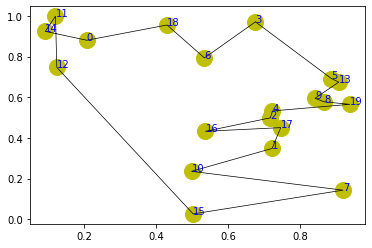

step:3945/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3946/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3947/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3948/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3949/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
distance:4.440
tensor([13,  5,  2,  6, 11, 17,  8,  9, 15,  1, 12,  3, 19, 16, 10, 14,  4,  7,
        18,  0])


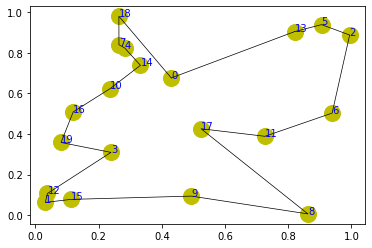

step:3950/5000, actic loss:-0.351, critic loss:0.390, L:4.639, 0min0sec
step:3951/5000, actic loss:-0.351, critic loss:0.390, L:4.638, 0min0sec
step:3952/5000, actic loss:-0.351, critic loss:0.390, L:4.638, 0min0sec
step:3953/5000, actic loss:-0.351, critic loss:0.390, L:4.638, 0min0sec
step:3954/5000, actic loss:-0.350, critic loss:0.389, L:4.638, 0min0sec
distance:3.641
tensor([12,  3, 11, 10,  5,  7,  9, 19, 15, 16,  2, 14,  8, 17,  6, 13, 18,  4,
         1,  0])


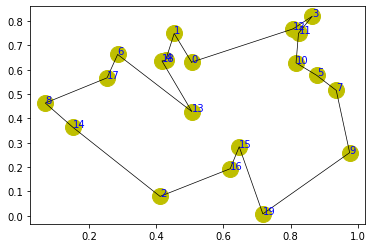

step:3955/5000, actic loss:-0.350, critic loss:0.389, L:4.638, 0min0sec
step:3956/5000, actic loss:-0.350, critic loss:0.389, L:4.638, 0min0sec
step:3957/5000, actic loss:-0.350, critic loss:0.389, L:4.638, 0min0sec
step:3958/5000, actic loss:-0.350, critic loss:0.389, L:4.638, 0min0sec
step:3959/5000, actic loss:-0.350, critic loss:0.389, L:4.638, 0min0sec
distance:4.246
tensor([14,  8, 10,  3,  7,  2,  6, 18, 11, 12,  5, 19,  0,  1,  4,  9, 17, 13,
        15, 16])


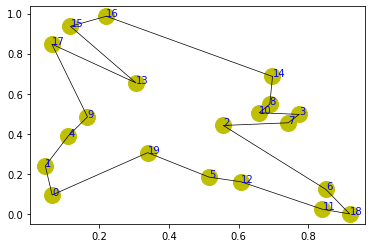

step:3960/5000, actic loss:-0.350, critic loss:0.389, L:4.637, 0min0sec
step:3961/5000, actic loss:-0.350, critic loss:0.389, L:4.637, 0min0sec
step:3962/5000, actic loss:-0.350, critic loss:0.389, L:4.637, 0min0sec
step:3963/5000, actic loss:-0.350, critic loss:0.389, L:4.637, 0min0sec
step:3964/5000, actic loss:-0.350, critic loss:0.389, L:4.637, 0min0sec
distance:4.400
tensor([13,  9,  0, 17, 12, 19,  4,  6, 11, 15,  2,  5, 10,  7, 18,  1, 14,  3,
        16,  8])


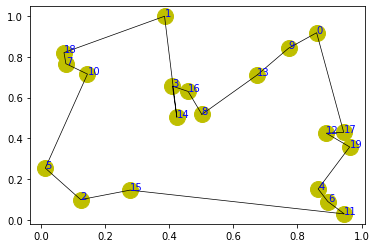

step:3965/5000, actic loss:-0.350, critic loss:0.389, L:4.637, 0min0sec
step:3966/5000, actic loss:-0.349, critic loss:0.389, L:4.637, 0min0sec
step:3967/5000, actic loss:-0.349, critic loss:0.389, L:4.637, 0min0sec
step:3968/5000, actic loss:-0.349, critic loss:0.388, L:4.637, 0min0sec
step:3969/5000, actic loss:-0.349, critic loss:0.388, L:4.637, 0min0sec
distance:4.740
tensor([ 9,  5,  2, 16,  7, 19,  6,  3, 13,  8, 10, 15, 18,  0, 17, 12,  4,  1,
        11, 14])


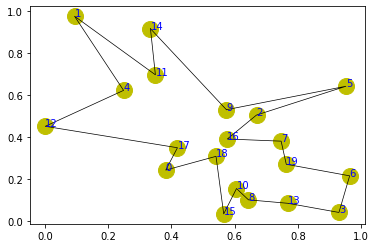

step:3970/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3971/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3972/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3973/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3974/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
distance:4.330
tensor([ 7, 16, 13,  8, 10,  2, 15, 11, 12,  1,  6, 14,  5, 17,  4,  0, 19,  9,
         3, 18])


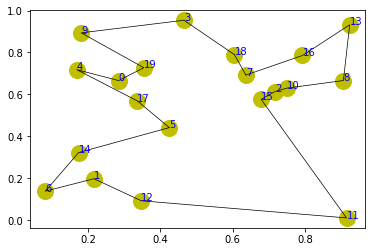

step:3975/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3976/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3977/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3978/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
step:3979/5000, actic loss:-0.349, critic loss:0.388, L:4.636, 0min0sec
distance:3.810
tensor([ 4, 13,  9,  0,  8,  3, 12, 19,  5, 16,  1, 10, 11,  7,  2, 18, 17,  6,
        14, 15])


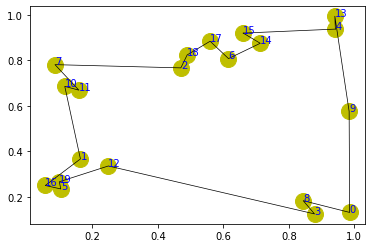

step:3980/5000, actic loss:-0.348, critic loss:0.388, L:4.635, 0min0sec
step:3981/5000, actic loss:-0.348, critic loss:0.388, L:4.635, 0min0sec
step:3982/5000, actic loss:-0.348, critic loss:0.388, L:4.635, 0min0sec
step:3983/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
step:3984/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
distance:4.029
tensor([14,  2, 17,  5,  4, 15, 11,  1, 16,  6, 10, 12, 13,  0,  8,  3,  7, 18,
         9, 19])


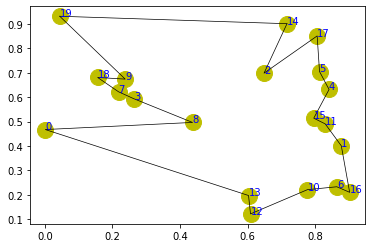

step:3985/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
step:3986/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
step:3987/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
step:3988/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
step:3989/5000, actic loss:-0.348, critic loss:0.387, L:4.635, 0min0sec
distance:4.256
tensor([ 4,  1,  2, 17, 11,  3,  8, 18, 12, 16, 14,  6,  9, 13,  7,  5, 10, 15,
         0, 19])


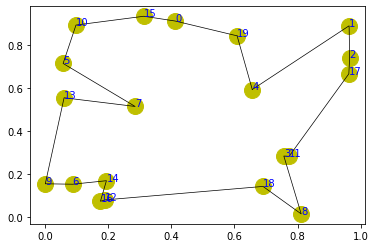

step:3990/5000, actic loss:-0.348, critic loss:0.387, L:4.634, 0min0sec
step:3991/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
step:3992/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
step:3993/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
step:3994/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
distance:4.713
tensor([17,  0, 12,  4, 14,  7,  8,  2, 16, 10,  9,  1, 19, 13,  3,  5, 18, 11,
        15,  6])


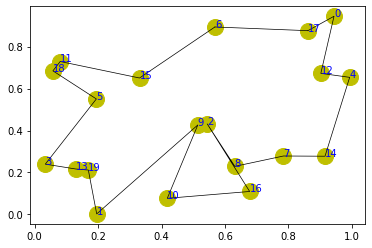

step:3995/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
step:3996/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
step:3997/5000, actic loss:-0.347, critic loss:0.387, L:4.634, 0min0sec
step:3998/5000, actic loss:-0.347, critic loss:0.386, L:4.634, 0min0sec
step:3999/5000, actic loss:-0.347, critic loss:0.386, L:4.634, 0min0sec
distance:4.504
tensor([10, 14, 15,  3,  7,  6, 11,  5, 19, 17, 18, 13,  9, 12,  2,  4,  1,  8,
         0, 16])


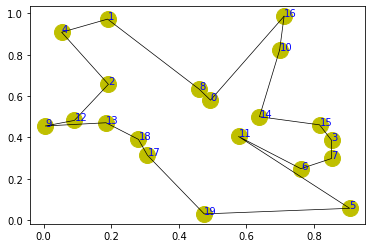

step:4000/5000, actic loss:-0.347, critic loss:0.386, L:4.633, 0min0sec
step:4001/5000, actic loss:-0.347, critic loss:0.386, L:4.633, 0min0sec
step:4002/5000, actic loss:-0.347, critic loss:0.386, L:4.633, 0min0sec
step:4003/5000, actic loss:-0.347, critic loss:0.386, L:4.633, 0min0sec
step:4004/5000, actic loss:-0.347, critic loss:0.386, L:4.633, 0min0sec
distance:4.091
tensor([ 5,  9, 16,  0,  7,  4, 18, 17,  6,  8,  1,  3, 10, 15, 14,  2, 12, 11,
        13, 19])


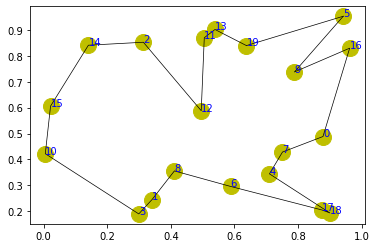

step:4005/5000, actic loss:-0.346, critic loss:0.386, L:4.633, 0min0sec
step:4006/5000, actic loss:-0.346, critic loss:0.386, L:4.633, 0min0sec
step:4007/5000, actic loss:-0.346, critic loss:0.386, L:4.633, 0min0sec
step:4008/5000, actic loss:-0.346, critic loss:0.386, L:4.633, 0min0sec
step:4009/5000, actic loss:-0.346, critic loss:0.386, L:4.633, 0min0sec
distance:4.796
tensor([18,  3, 11, 12,  8, 10,  7,  4, 19,  0,  2, 16, 14, 13, 17,  9,  1,  6,
        15,  5])


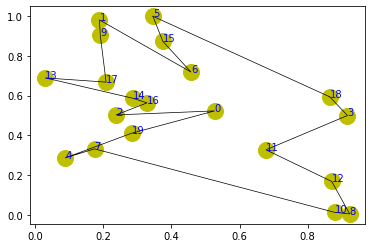

step:4010/5000, actic loss:-0.346, critic loss:0.386, L:4.632, 0min0sec
step:4011/5000, actic loss:-0.346, critic loss:0.386, L:4.632, 0min0sec
step:4012/5000, actic loss:-0.346, critic loss:0.385, L:4.632, 0min0sec
step:4013/5000, actic loss:-0.346, critic loss:0.385, L:4.632, 0min0sec
step:4014/5000, actic loss:-0.346, critic loss:0.385, L:4.632, 0min0sec
distance:4.581
tensor([ 7, 14, 10, 15,  0,  8, 16,  3, 17,  2, 13, 12,  5, 11,  9, 18,  4,  1,
        19,  6])


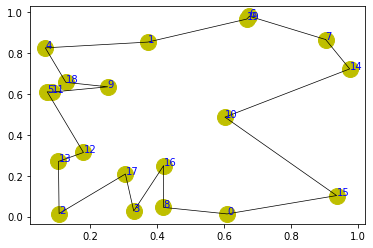

step:4015/5000, actic loss:-0.346, critic loss:0.385, L:4.632, 0min0sec
step:4016/5000, actic loss:-0.345, critic loss:0.385, L:4.632, 0min0sec
step:4017/5000, actic loss:-0.345, critic loss:0.385, L:4.632, 0min0sec
step:4018/5000, actic loss:-0.345, critic loss:0.385, L:4.632, 0min0sec
step:4019/5000, actic loss:-0.345, critic loss:0.385, L:4.632, 0min0sec
distance:4.891
tensor([ 0,  9, 12,  5, 16,  8, 17,  6, 10, 13,  3, 15,  2,  4,  7, 14, 18,  1,
        11, 19])


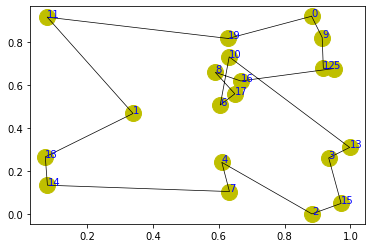

step:4020/5000, actic loss:-0.345, critic loss:0.385, L:4.631, 0min0sec
step:4021/5000, actic loss:-0.345, critic loss:0.385, L:4.631, 0min0sec
step:4022/5000, actic loss:-0.345, critic loss:0.385, L:4.631, 0min0sec
step:4023/5000, actic loss:-0.345, critic loss:0.385, L:4.631, 0min0sec
step:4024/5000, actic loss:-0.345, critic loss:0.385, L:4.631, 0min0sec
distance:3.920
tensor([18,  1,  5,  7, 16, 19,  8, 10,  4,  0, 12, 14,  9, 17,  3,  2, 13, 15,
        11,  6])


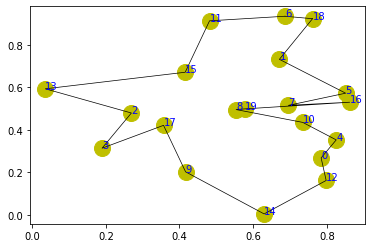

step:4025/5000, actic loss:-0.345, critic loss:0.385, L:4.631, 0min0sec
step:4026/5000, actic loss:-0.345, critic loss:0.384, L:4.631, 0min0sec
step:4027/5000, actic loss:-0.345, critic loss:0.384, L:4.631, 0min0sec
step:4028/5000, actic loss:-0.345, critic loss:0.384, L:4.631, 0min0sec
step:4029/5000, actic loss:-0.344, critic loss:0.384, L:4.631, 0min0sec
distance:4.036
tensor([16,  3, 11, 19,  9,  2, 12,  5, 18,  7, 10,  0,  1, 13, 15,  4,  8, 17,
         6, 14])


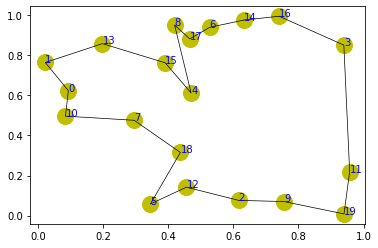

step:4030/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4031/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4032/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4033/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4034/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
distance:3.963
tensor([ 4, 12,  9, 17,  5, 19,  3, 14,  6, 15,  0,  2,  7,  1, 18, 16, 13,  8,
        11, 10])


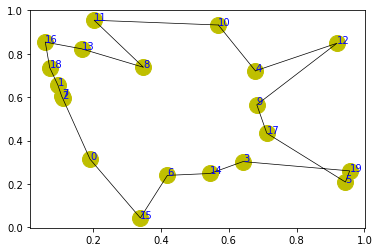

step:4035/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4036/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4037/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4038/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
step:4039/5000, actic loss:-0.344, critic loss:0.384, L:4.630, 0min0sec
distance:3.859
tensor([19,  3,  0,  2, 15,  6,  5,  8, 16, 10, 18, 11,  9, 14,  7, 17, 13,  1,
        12,  4])


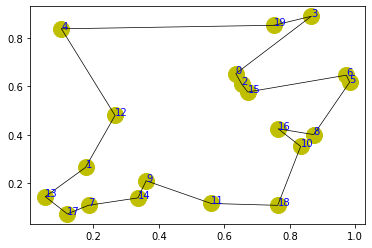

step:4040/5000, actic loss:-0.344, critic loss:0.383, L:4.630, 0min0sec
step:4041/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4042/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4043/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4044/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
distance:4.294
tensor([19, 14,  0,  6,  4,  8, 18, 15, 17,  3, 13,  7, 11,  1, 12,  9,  5,  2,
        10, 16])


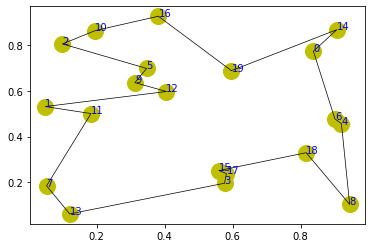

step:4045/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4046/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4047/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4048/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4049/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
distance:4.931
tensor([11, 12,  4,  2, 15, 17,  9,  1,  0, 10,  3,  8,  7, 14,  6, 13,  5, 19,
        18, 16])


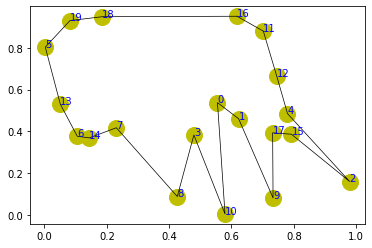

step:4050/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4051/5000, actic loss:-0.343, critic loss:0.383, L:4.629, 0min0sec
step:4052/5000, actic loss:-0.343, critic loss:0.383, L:4.628, 0min0sec
step:4053/5000, actic loss:-0.343, critic loss:0.383, L:4.628, 0min0sec
step:4054/5000, actic loss:-0.343, critic loss:0.383, L:4.628, 0min0sec
distance:3.563
tensor([16,  5, 17, 13,  1, 19,  8, 14, 18,  6, 11, 10,  4, 15,  2,  0,  3,  7,
         9, 12])


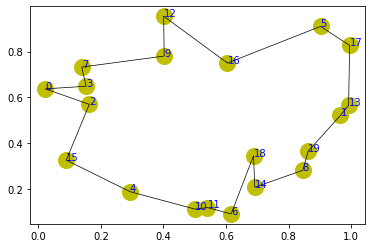

step:4055/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
step:4056/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
step:4057/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
step:4058/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
step:4059/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
distance:4.038
tensor([15,  7,  4,  5,  2,  6, 11, 12, 17, 10,  9, 16, 18,  0, 19, 14,  3,  1,
         8, 13])


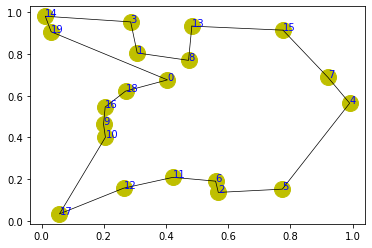

step:4060/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
step:4061/5000, actic loss:-0.342, critic loss:0.382, L:4.628, 0min0sec
step:4062/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
step:4063/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
step:4064/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
distance:4.643
tensor([18,  6,  7, 10,  0, 14,  4,  3,  9,  8, 11,  5, 13, 16, 19, 12, 15,  1,
        17,  2])


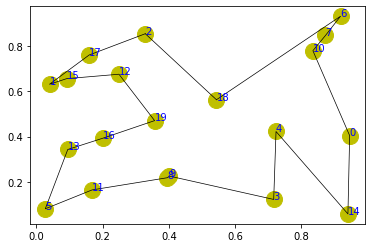

step:4065/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
step:4066/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
step:4067/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
step:4068/5000, actic loss:-0.342, critic loss:0.382, L:4.627, 0min0sec
step:4069/5000, actic loss:-0.341, critic loss:0.381, L:4.627, 0min0sec
distance:4.213
tensor([13,  7,  3, 18,  0,  9,  1, 19,  5,  8, 17,  2, 16, 12, 10, 15,  6, 14,
        11,  4])


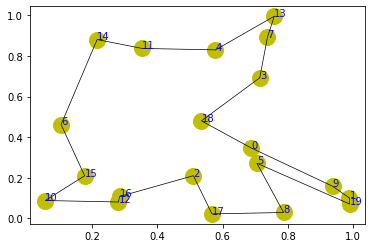

step:4070/5000, actic loss:-0.341, critic loss:0.381, L:4.627, 0min0sec
step:4071/5000, actic loss:-0.341, critic loss:0.381, L:4.627, 0min0sec
step:4072/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4073/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4074/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
distance:4.111
tensor([10,  0, 13,  6, 14,  2,  8,  3, 16, 17,  5,  4, 19, 12, 15, 18,  1, 11,
         9,  7])


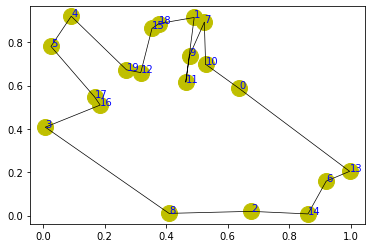

step:4075/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4076/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4077/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4078/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4079/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
distance:4.310
tensor([16,  3, 19,  8,  1, 10, 17,  4,  5,  0,  2, 15, 14,  6, 11, 18,  7, 12,
         9, 13])


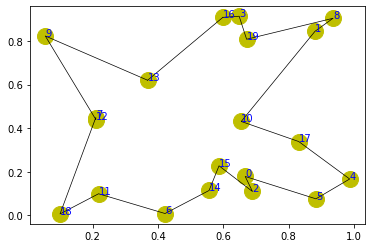

step:4080/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4081/5000, actic loss:-0.341, critic loss:0.381, L:4.626, 0min0sec
step:4082/5000, actic loss:-0.340, critic loss:0.381, L:4.625, 0min0sec
step:4083/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4084/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
distance:3.238
tensor([16, 18,  0, 17,  6, 19, 11,  3,  7, 14, 13, 15,  4, 10,  8,  9,  2, 12,
         5,  1])


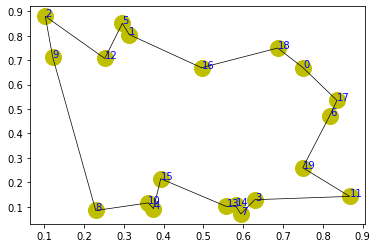

step:4085/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4086/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4087/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4088/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4089/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
distance:4.541
tensor([16,  5,  3,  4,  6, 10, 18, 11,  2, 14,  0, 15, 17,  8, 13,  9, 12,  1,
         7, 19])


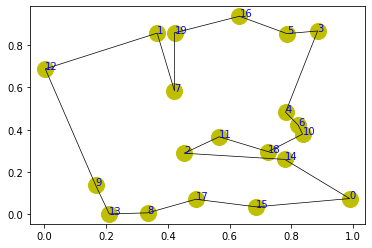

step:4090/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4091/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4092/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4093/5000, actic loss:-0.340, critic loss:0.380, L:4.625, 0min0sec
step:4094/5000, actic loss:-0.339, critic loss:0.380, L:4.625, 0min0sec
distance:4.138
tensor([17, 13, 14, 10,  0,  8,  3,  7, 19, 18,  2, 12,  4,  1,  6, 15, 11,  9,
         5, 16])


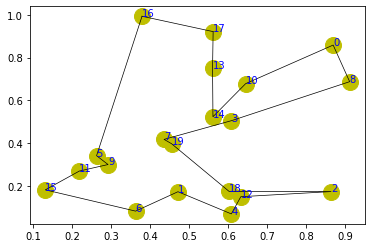

step:4095/5000, actic loss:-0.339, critic loss:0.380, L:4.624, 0min0sec
step:4096/5000, actic loss:-0.339, critic loss:0.380, L:4.624, 0min0sec
step:4097/5000, actic loss:-0.339, critic loss:0.380, L:4.624, 0min0sec
step:4098/5000, actic loss:-0.339, critic loss:0.380, L:4.624, 0min0sec
step:4099/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
distance:3.916
tensor([14,  9,  8, 11, 17, 19, 12, 18,  2,  7,  6,  3, 16,  5, 13,  0, 10,  1,
        15,  4])


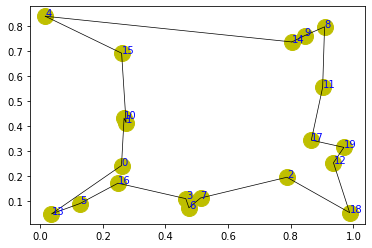

step:4100/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
step:4101/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
step:4102/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
step:4103/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
step:4104/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
distance:4.128
tensor([19,  4, 18, 12,  1,  0,  6, 14,  5, 11, 13,  3, 17,  9, 15,  8, 16, 10,
         7,  2])


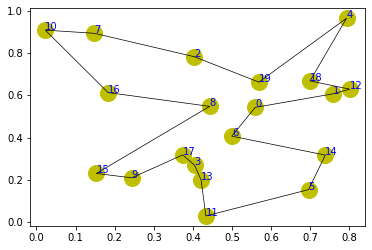

step:4105/5000, actic loss:-0.339, critic loss:0.379, L:4.624, 0min0sec
step:4106/5000, actic loss:-0.339, critic loss:0.379, L:4.623, 0min0sec
step:4107/5000, actic loss:-0.339, critic loss:0.379, L:4.623, 0min0sec
step:4108/5000, actic loss:-0.339, critic loss:0.379, L:4.623, 0min0sec
step:4109/5000, actic loss:-0.338, critic loss:0.379, L:4.623, 0min0sec
distance:3.512
tensor([ 3,  2,  0, 19,  6,  9,  8, 15, 11, 16, 14, 13,  1,  5,  7, 12, 10, 17,
        18,  4])


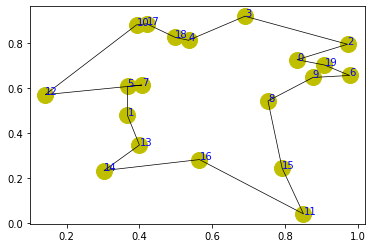

step:4110/5000, actic loss:-0.338, critic loss:0.379, L:4.623, 0min0sec
step:4111/5000, actic loss:-0.338, critic loss:0.379, L:4.623, 0min0sec
step:4112/5000, actic loss:-0.338, critic loss:0.379, L:4.623, 0min0sec
step:4113/5000, actic loss:-0.338, critic loss:0.379, L:4.623, 0min0sec
step:4114/5000, actic loss:-0.338, critic loss:0.378, L:4.623, 0min0sec
distance:3.629
tensor([ 3,  2,  9, 14, 19,  7,  0, 11, 17, 18,  8,  6, 12, 15,  1, 16, 10,  5,
         4, 13])


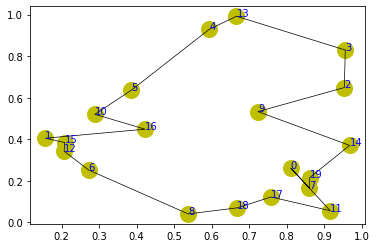

step:4115/5000, actic loss:-0.338, critic loss:0.378, L:4.623, 0min0sec
step:4116/5000, actic loss:-0.338, critic loss:0.378, L:4.623, 0min0sec
step:4117/5000, actic loss:-0.338, critic loss:0.378, L:4.622, 0min0sec
step:4118/5000, actic loss:-0.338, critic loss:0.378, L:4.622, 0min0sec
step:4119/5000, actic loss:-0.338, critic loss:0.378, L:4.622, 0min0sec
distance:4.184
tensor([15,  0, 16, 11, 10, 18, 19,  5,  8,  6, 17,  7,  3,  2, 13,  4, 14, 12,
         1,  9])


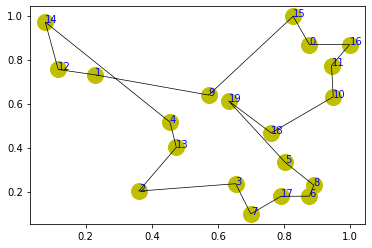

step:4120/5000, actic loss:-0.338, critic loss:0.378, L:4.622, 0min0sec
step:4121/5000, actic loss:-0.338, critic loss:0.378, L:4.622, 0min0sec
step:4122/5000, actic loss:-0.338, critic loss:0.378, L:4.622, 0min0sec
step:4123/5000, actic loss:-0.337, critic loss:0.378, L:4.622, 0min0sec
step:4124/5000, actic loss:-0.337, critic loss:0.378, L:4.622, 0min0sec
distance:3.939
tensor([ 4, 15, 19, 16,  8,  3, 13,  6, 14,  1, 10, 12,  5,  0, 18, 11,  2, 17,
         9,  7])


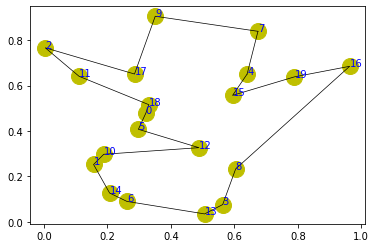

step:4125/5000, actic loss:-0.337, critic loss:0.378, L:4.622, 0min0sec
step:4126/5000, actic loss:-0.337, critic loss:0.378, L:4.622, 0min0sec
step:4127/5000, actic loss:-0.337, critic loss:0.378, L:4.622, 0min0sec
step:4128/5000, actic loss:-0.337, critic loss:0.378, L:4.622, 0min0sec
step:4129/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
distance:4.429
tensor([14,  4, 15, 11, 10,  6,  3,  1, 19, 18, 16,  2,  9,  8,  0, 13, 12,  5,
         7, 17])


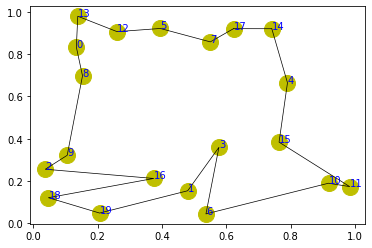

step:4130/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
step:4131/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
step:4132/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
step:4133/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
step:4134/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
distance:4.598
tensor([12,  0, 11, 16,  4, 14,  9, 18,  1, 17,  5,  8,  7,  6, 15,  2, 13, 19,
         3, 10])


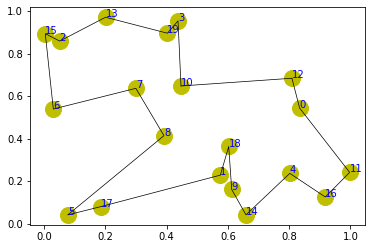

step:4135/5000, actic loss:-0.337, critic loss:0.377, L:4.621, 0min0sec
step:4136/5000, actic loss:-0.336, critic loss:0.377, L:4.621, 0min0sec
step:4137/5000, actic loss:-0.336, critic loss:0.377, L:4.621, 0min0sec
step:4138/5000, actic loss:-0.336, critic loss:0.377, L:4.621, 0min0sec
step:4139/5000, actic loss:-0.336, critic loss:0.377, L:4.621, 0min0sec
distance:4.263
tensor([ 2, 19, 15, 10,  9, 12,  3,  8,  5,  7,  6, 14, 18, 16, 13, 11,  0,  1,
        17,  4])


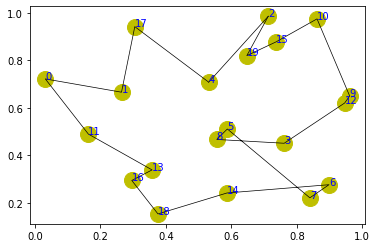

step:4140/5000, actic loss:-0.336, critic loss:0.377, L:4.621, 0min0sec
step:4141/5000, actic loss:-0.336, critic loss:0.377, L:4.620, 0min0sec
step:4142/5000, actic loss:-0.336, critic loss:0.377, L:4.620, 0min0sec
step:4143/5000, actic loss:-0.336, critic loss:0.377, L:4.620, 0min0sec
step:4144/5000, actic loss:-0.336, critic loss:0.377, L:4.620, 0min0sec
distance:4.677
tensor([ 7,  9,  2,  1, 15, 17, 12,  4, 16,  5,  6, 19,  0,  8, 18, 13, 14,  3,
        10, 11])


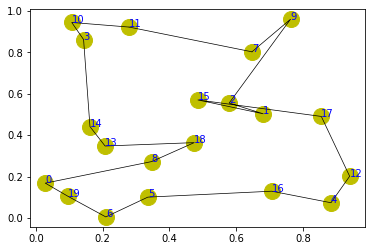

step:4145/5000, actic loss:-0.336, critic loss:0.376, L:4.620, 0min0sec
step:4146/5000, actic loss:-0.336, critic loss:0.376, L:4.620, 0min0sec
step:4147/5000, actic loss:-0.335, critic loss:0.376, L:4.620, 0min0sec
step:4148/5000, actic loss:-0.335, critic loss:0.376, L:4.620, 0min0sec
step:4149/5000, actic loss:-0.335, critic loss:0.376, L:4.620, 0min0sec
distance:5.453
tensor([ 1,  0,  8,  3, 11,  2,  4, 10, 13, 12,  6, 19, 15, 16,  9, 17,  7, 14,
         5, 18])


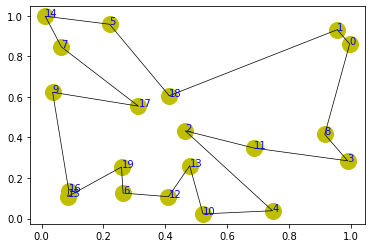

step:4150/5000, actic loss:-0.335, critic loss:0.376, L:4.620, 0min0sec
step:4151/5000, actic loss:-0.335, critic loss:0.376, L:4.620, 0min0sec
step:4152/5000, actic loss:-0.335, critic loss:0.376, L:4.620, 0min0sec
step:4153/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
step:4154/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
distance:3.700
tensor([18, 13, 19, 17,  5,  2, 10,  4,  0, 16, 11,  1, 12,  8,  3, 14,  7, 15,
         6,  9])


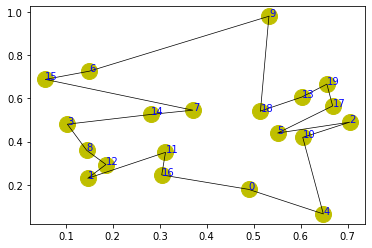

step:4155/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
step:4156/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
step:4157/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
step:4158/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
step:4159/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
distance:4.646
tensor([ 4,  8,  5, 13, 12, 19, 15,  6, 17,  1,  3,  2, 11, 14, 10, 18,  0,  7,
         9, 16])


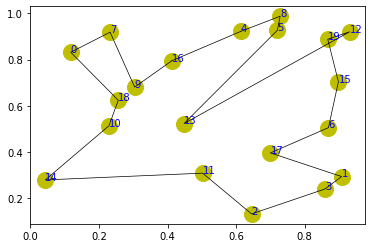

step:4160/5000, actic loss:-0.335, critic loss:0.376, L:4.619, 0min0sec
step:4161/5000, actic loss:-0.334, critic loss:0.376, L:4.619, 0min0sec
step:4162/5000, actic loss:-0.334, critic loss:0.376, L:4.619, 0min0sec
step:4163/5000, actic loss:-0.334, critic loss:0.376, L:4.619, 0min0sec
step:4164/5000, actic loss:-0.334, critic loss:0.376, L:4.619, 0min0sec
distance:4.461
tensor([17,  2,  0,  5, 19,  1,  6, 10, 13, 18, 11, 14, 12,  4,  3,  7, 16, 15,
         9,  8])


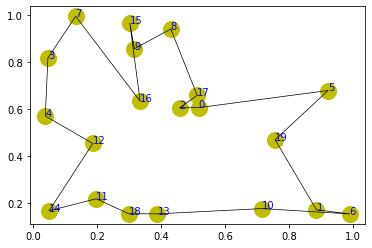

step:4165/5000, actic loss:-0.334, critic loss:0.375, L:4.619, 0min0sec
step:4166/5000, actic loss:-0.334, critic loss:0.375, L:4.619, 0min0sec
step:4167/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4168/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4169/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
distance:4.482
tensor([13, 14, 18, 17, 10,  2,  0, 11,  9,  5,  6, 12,  1,  3, 19, 16,  7,  8,
        15,  4])


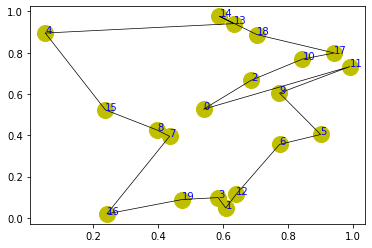

step:4170/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4171/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4172/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4173/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4174/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
distance:4.183
tensor([ 3,  8,  7, 14, 10,  5,  1,  0,  2, 15, 17, 12,  4, 16, 11,  9, 19, 18,
        13,  6])


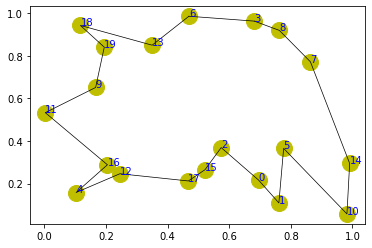

step:4175/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4176/5000, actic loss:-0.334, critic loss:0.375, L:4.618, 0min0sec
step:4177/5000, actic loss:-0.333, critic loss:0.375, L:4.618, 0min0sec
step:4178/5000, actic loss:-0.333, critic loss:0.375, L:4.617, 0min0sec
step:4179/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
distance:3.993
tensor([14,  5, 12,  9,  3,  8,  7, 15, 19, 11,  2,  1, 10,  0, 18, 17,  6,  4,
        13, 16])


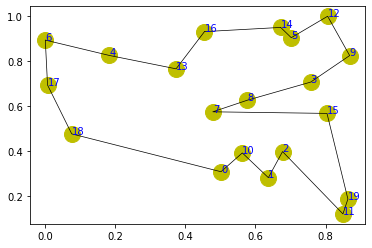

step:4180/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4181/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4182/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4183/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4184/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
distance:4.115
tensor([ 5,  6, 18,  8,  4, 13, 15,  2,  1, 14, 10, 12,  7,  9,  3, 19, 11, 17,
        16,  0])


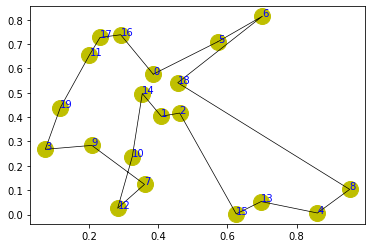

step:4185/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4186/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4187/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4188/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
step:4189/5000, actic loss:-0.333, critic loss:0.374, L:4.617, 0min0sec
distance:4.385
tensor([ 0,  5,  4, 12, 18, 13, 10, 19,  2,  1, 16, 17,  6,  8, 15,  3, 14, 11,
         7,  9])


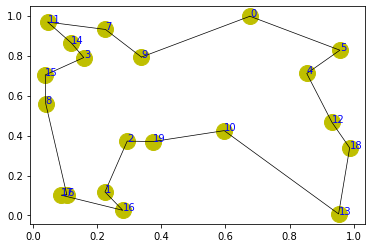

step:4190/5000, actic loss:-0.332, critic loss:0.374, L:4.616, 0min0sec
step:4191/5000, actic loss:-0.332, critic loss:0.374, L:4.616, 0min0sec
step:4192/5000, actic loss:-0.332, critic loss:0.374, L:4.616, 0min0sec
step:4193/5000, actic loss:-0.332, critic loss:0.374, L:4.616, 0min0sec
step:4194/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
distance:4.204
tensor([ 8, 17, 10, 15, 14,  6,  0,  5,  9, 18,  1,  2, 12,  3,  7, 19, 16, 11,
        13,  4])


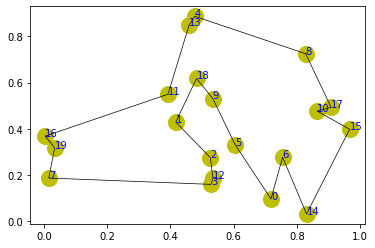

step:4195/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4196/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4197/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4198/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4199/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
distance:3.918
tensor([10,  4, 19,  8,  6, 13,  0,  1, 18, 16, 14, 12,  5, 11,  2, 15,  9,  3,
         7, 17])


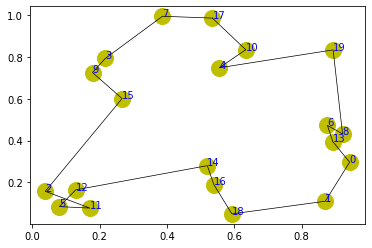

step:4200/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4201/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4202/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4203/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
step:4204/5000, actic loss:-0.332, critic loss:0.373, L:4.616, 0min0sec
distance:4.071
tensor([ 1, 13,  3, 17, 12,  0, 15, 19,  9,  6, 16, 18,  4,  7,  2, 11,  8, 14,
         5, 10])


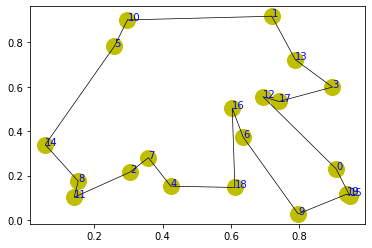

step:4205/5000, actic loss:-0.331, critic loss:0.373, L:4.615, 0min0sec
step:4206/5000, actic loss:-0.332, critic loss:0.373, L:4.615, 0min0sec
step:4207/5000, actic loss:-0.332, critic loss:0.373, L:4.615, 0min0sec
step:4208/5000, actic loss:-0.331, critic loss:0.373, L:4.615, 0min0sec
step:4209/5000, actic loss:-0.331, critic loss:0.373, L:4.615, 0min0sec
distance:4.598
tensor([ 3, 14,  1,  2, 18,  0, 15,  9, 19, 16,  5,  4, 11, 10, 12,  6,  7, 13,
         8, 17])


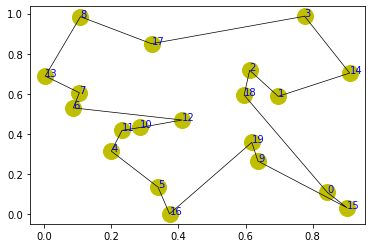

step:4210/5000, actic loss:-0.331, critic loss:0.373, L:4.615, 0min0sec
step:4211/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
step:4212/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
step:4213/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
step:4214/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
distance:4.578
tensor([ 2, 12,  6, 10, 15,  9, 18,  3, 11, 13,  1,  4,  8, 17,  5, 14,  7, 19,
         0, 16])


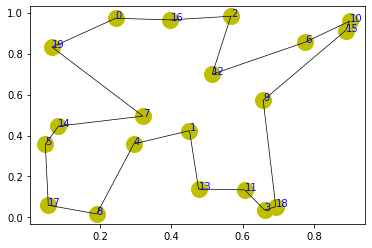

step:4215/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
step:4216/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
step:4217/5000, actic loss:-0.331, critic loss:0.372, L:4.615, 0min0sec
step:4218/5000, actic loss:-0.331, critic loss:0.372, L:4.614, 0min0sec
step:4219/5000, actic loss:-0.331, critic loss:0.372, L:4.614, 0min0sec
distance:4.684
tensor([17, 18,  6,  8, 13, 14,  9,  1, 19, 11, 10, 15,  5, 12,  3,  7,  0,  4,
         2, 16])


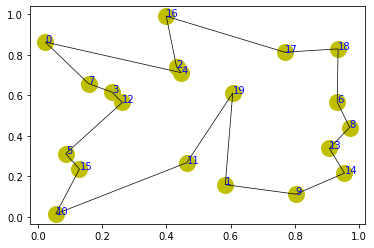

step:4220/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4221/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4222/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4223/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4224/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
distance:3.874
tensor([19,  4, 17, 14,  3,  6,  8,  9,  0, 10, 18,  1, 12, 15, 16,  2,  5, 13,
         7, 11])


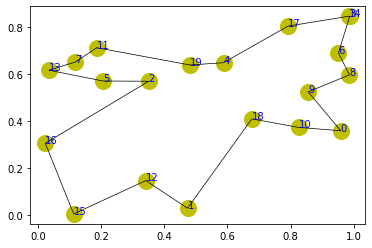

step:4225/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4226/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4227/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4228/5000, actic loss:-0.330, critic loss:0.372, L:4.614, 0min0sec
step:4229/5000, actic loss:-0.330, critic loss:0.371, L:4.614, 0min0sec
distance:3.929
tensor([ 9, 15, 17, 19, 10, 18,  7,  2, 16,  5, 11,  4,  8,  3, 13,  1, 14,  0,
        12,  6])


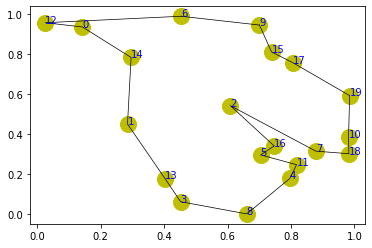

step:4230/5000, actic loss:-0.330, critic loss:0.371, L:4.614, 0min0sec
step:4231/5000, actic loss:-0.330, critic loss:0.371, L:4.613, 0min0sec
step:4232/5000, actic loss:-0.330, critic loss:0.371, L:4.613, 0min0sec
step:4233/5000, actic loss:-0.330, critic loss:0.371, L:4.613, 0min0sec
step:4234/5000, actic loss:-0.330, critic loss:0.371, L:4.613, 0min0sec
distance:5.021
tensor([14, 12, 10,  2,  5,  9,  3, 18,  0, 13,  6,  8,  1,  7, 19, 15,  4, 17,
        11, 16])


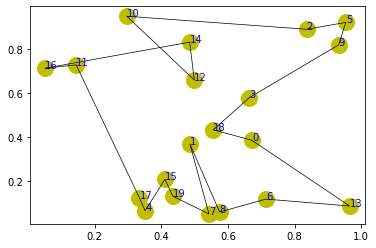

step:4235/5000, actic loss:-0.330, critic loss:0.371, L:4.613, 0min0sec
step:4236/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4237/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4238/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4239/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
distance:4.368
tensor([12,  4, 18, 13,  9, 19, 15, 14,  0,  6,  2,  8, 16,  3,  1,  5, 10, 11,
         7, 17])


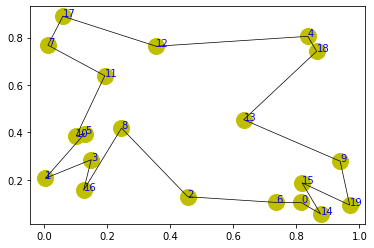

step:4240/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4241/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4242/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4243/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4244/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
distance:3.882
tensor([ 0, 12, 14, 13, 15, 19, 18,  4,  3,  2,  6, 10, 17,  5,  9, 16, 11,  1,
         7,  8])


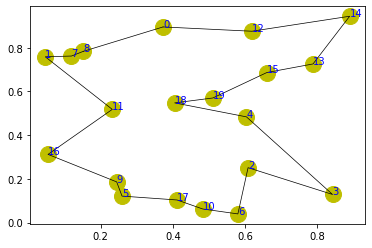

step:4245/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4246/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4247/5000, actic loss:-0.329, critic loss:0.371, L:4.613, 0min0sec
step:4248/5000, actic loss:-0.329, critic loss:0.370, L:4.613, 0min0sec
step:4249/5000, actic loss:-0.329, critic loss:0.370, L:4.613, 0min0sec
distance:5.082
tensor([ 5,  6,  3,  0,  2, 13,  7, 19,  9, 15, 14, 11, 10, 18, 12, 17, 16,  4,
         8,  1])


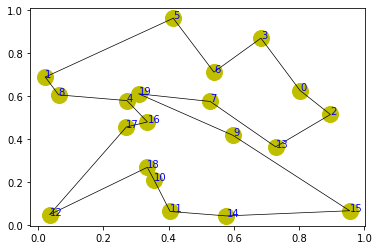

step:4250/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4251/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4252/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4253/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4254/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
distance:4.190
tensor([ 6, 18,  1, 14,  3, 13,  2, 15,  9, 16,  4, 19,  5, 17,  8, 11,  7,  0,
        10, 12])


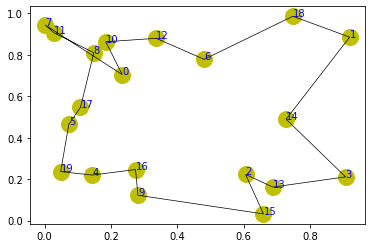

step:4255/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4256/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4257/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4258/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4259/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
distance:4.642
tensor([12,  7, 16,  1, 18, 13, 17,  0,  6,  4, 11,  3,  8,  2,  9, 15,  5, 14,
        19, 10])


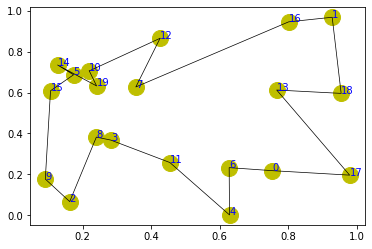

step:4260/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4261/5000, actic loss:-0.328, critic loss:0.370, L:4.612, 0min0sec
step:4262/5000, actic loss:-0.327, critic loss:0.370, L:4.612, 0min0sec
step:4263/5000, actic loss:-0.327, critic loss:0.370, L:4.611, 0min0sec
step:4264/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
distance:4.212
tensor([ 4, 19, 10, 16,  0, 12,  1,  3, 14, 15, 18,  6, 11, 13,  7,  2,  8,  5,
        17,  9])


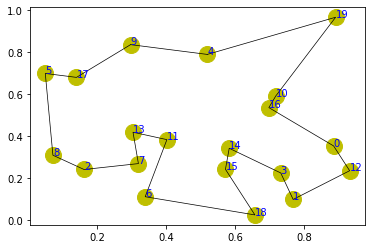

step:4265/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4266/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4267/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4268/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4269/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
distance:4.025
tensor([11,  8, 19,  2, 16, 18,  9, 10, 14,  3,  4,  6, 15,  1, 12,  7,  0, 17,
         5, 13])


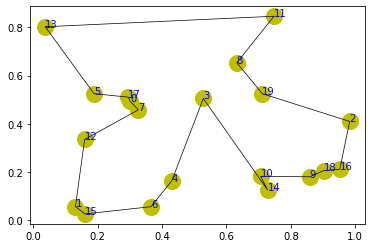

step:4270/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4271/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4272/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4273/5000, actic loss:-0.327, critic loss:0.369, L:4.611, 0min0sec
step:4274/5000, actic loss:-0.327, critic loss:0.369, L:4.610, 0min0sec
distance:4.034
tensor([ 4, 13,  9, 15,  3,  5, 17,  6, 18,  1, 10, 19, 14,  8,  0, 16,  7,  2,
        12, 11])


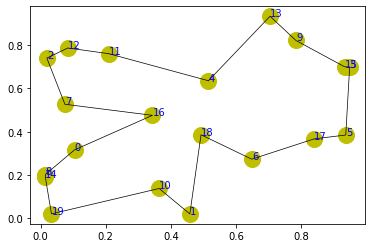

step:4275/5000, actic loss:-0.327, critic loss:0.369, L:4.610, 0min0sec
step:4276/5000, actic loss:-0.327, critic loss:0.369, L:4.610, 0min0sec
step:4277/5000, actic loss:-0.327, critic loss:0.369, L:4.610, 0min0sec
step:4278/5000, actic loss:-0.326, critic loss:0.369, L:4.610, 0min0sec
step:4279/5000, actic loss:-0.326, critic loss:0.369, L:4.610, 0min0sec
distance:4.805
tensor([ 0,  5, 19, 16, 11, 10, 17,  1,  9,  3,  7, 15, 12,  6,  4,  8,  2, 13,
        14, 18])


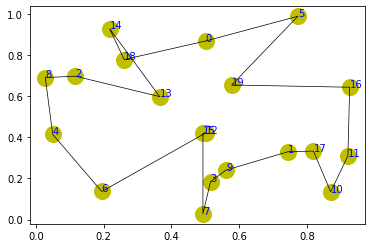

step:4280/5000, actic loss:-0.326, critic loss:0.368, L:4.610, 0min0sec
step:4281/5000, actic loss:-0.326, critic loss:0.368, L:4.610, 0min0sec
step:4282/5000, actic loss:-0.326, critic loss:0.368, L:4.610, 0min0sec
step:4283/5000, actic loss:-0.326, critic loss:0.368, L:4.610, 0min0sec
step:4284/5000, actic loss:-0.326, critic loss:0.368, L:4.610, 0min0sec
distance:4.103
tensor([ 0,  5,  1, 16, 10, 15, 14, 18,  8,  4, 11, 17,  3,  2,  6, 13, 19,  9,
         7, 12])


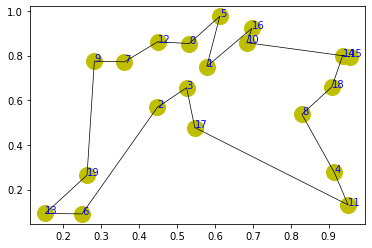

step:4285/5000, actic loss:-0.326, critic loss:0.368, L:4.609, 0min0sec
step:4286/5000, actic loss:-0.326, critic loss:0.368, L:4.609, 0min0sec
step:4287/5000, actic loss:-0.326, critic loss:0.368, L:4.609, 0min0sec
step:4288/5000, actic loss:-0.326, critic loss:0.368, L:4.609, 0min0sec
step:4289/5000, actic loss:-0.326, critic loss:0.368, L:4.609, 0min0sec
distance:4.518
tensor([ 7, 13, 19,  9,  2, 14, 18,  3, 17,  5, 12,  8, 16, 11,  4, 10, 15,  1,
         6,  0])


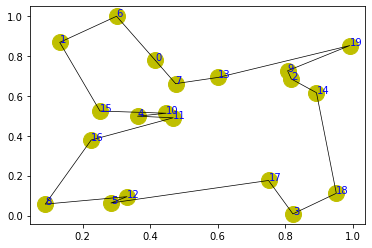

step:4290/5000, actic loss:-0.326, critic loss:0.368, L:4.609, 0min0sec
step:4291/5000, actic loss:-0.325, critic loss:0.368, L:4.609, 0min0sec
step:4292/5000, actic loss:-0.325, critic loss:0.368, L:4.609, 0min0sec
step:4293/5000, actic loss:-0.325, critic loss:0.368, L:4.609, 0min0sec
step:4294/5000, actic loss:-0.325, critic loss:0.368, L:4.609, 0min0sec
distance:3.453
tensor([10,  0, 19,  1, 16,  2, 17,  8,  6,  5, 12,  3,  7, 18, 11,  4, 14, 13,
         9, 15])


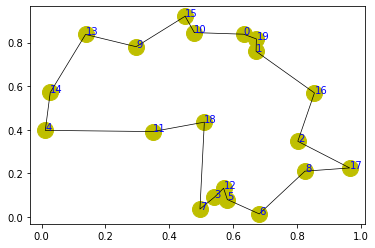

step:4295/5000, actic loss:-0.325, critic loss:0.368, L:4.608, 0min0sec
step:4296/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4297/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4298/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4299/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
distance:4.632
tensor([17,  7, 13,  2,  8,  3,  5, 19,  0, 14, 11, 16, 10,  6,  1, 12,  4, 18,
         9, 15])


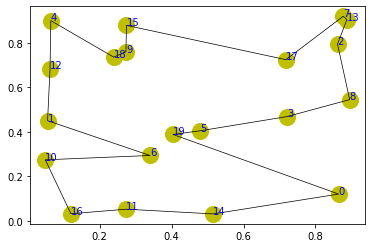

step:4300/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4301/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4302/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4303/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
step:4304/5000, actic loss:-0.325, critic loss:0.367, L:4.608, 0min0sec
distance:4.339
tensor([ 5,  1, 13,  7, 14, 16,  4,  6, 17,  2,  8, 12, 19,  0, 18, 11,  3,  9,
        10, 15])


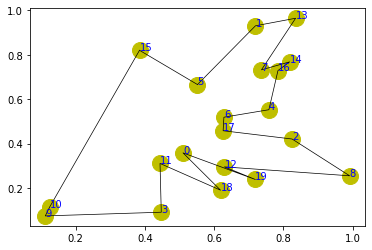

step:4305/5000, actic loss:-0.324, critic loss:0.367, L:4.608, 0min0sec
step:4306/5000, actic loss:-0.324, critic loss:0.367, L:4.608, 0min0sec
step:4307/5000, actic loss:-0.324, critic loss:0.367, L:4.607, 0min0sec
step:4308/5000, actic loss:-0.324, critic loss:0.367, L:4.607, 0min0sec
step:4309/5000, actic loss:-0.324, critic loss:0.367, L:4.607, 0min0sec
distance:3.907
tensor([10,  9,  4, 18,  1, 13, 19,  3, 11, 15,  6, 17, 14,  5,  7, 16, 12,  0,
         2,  8])


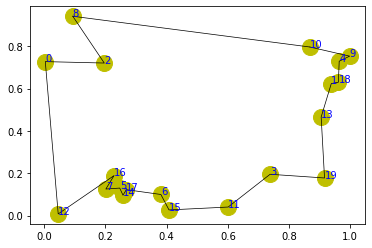

step:4310/5000, actic loss:-0.324, critic loss:0.367, L:4.607, 0min0sec
step:4311/5000, actic loss:-0.324, critic loss:0.367, L:4.607, 0min0sec
step:4312/5000, actic loss:-0.324, critic loss:0.366, L:4.607, 0min0sec
step:4313/5000, actic loss:-0.324, critic loss:0.366, L:4.607, 0min0sec
step:4314/5000, actic loss:-0.324, critic loss:0.366, L:4.607, 0min0sec
distance:4.374
tensor([19, 17, 10,  7,  3,  9,  4,  1,  2,  5, 16,  6, 14,  0,  8, 12, 13, 11,
        15, 18])


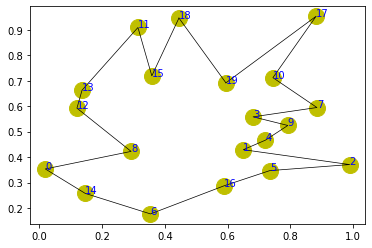

step:4315/5000, actic loss:-0.324, critic loss:0.366, L:4.607, 0min0sec
step:4316/5000, actic loss:-0.324, critic loss:0.366, L:4.607, 0min0sec
step:4317/5000, actic loss:-0.324, critic loss:0.366, L:4.607, 0min0sec
step:4318/5000, actic loss:-0.324, critic loss:0.366, L:4.606, 0min0sec
step:4319/5000, actic loss:-0.324, critic loss:0.366, L:4.606, 0min0sec
distance:4.039
tensor([13,  8, 10,  0,  1, 17, 16, 11,  6, 19, 14,  5,  4,  7, 12,  9,  3,  2,
        15, 18])


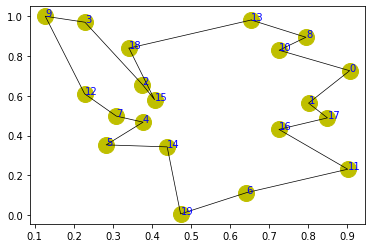

step:4320/5000, actic loss:-0.324, critic loss:0.366, L:4.606, 0min0sec
step:4321/5000, actic loss:-0.324, critic loss:0.366, L:4.606, 0min0sec
step:4322/5000, actic loss:-0.323, critic loss:0.366, L:4.606, 0min0sec
step:4323/5000, actic loss:-0.323, critic loss:0.366, L:4.606, 0min0sec
step:4324/5000, actic loss:-0.323, critic loss:0.366, L:4.606, 0min0sec
distance:5.280
tensor([ 8,  9, 15,  3, 18,  2,  6,  0, 12, 14, 13, 16, 10,  1,  7, 17,  4,  5,
        11, 19])


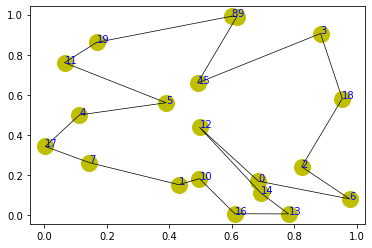

step:4325/5000, actic loss:-0.323, critic loss:0.366, L:4.606, 0min0sec
step:4326/5000, actic loss:-0.323, critic loss:0.366, L:4.606, 0min0sec
step:4327/5000, actic loss:-0.323, critic loss:0.366, L:4.606, 0min0sec
step:4328/5000, actic loss:-0.323, critic loss:0.365, L:4.606, 0min0sec
step:4329/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
distance:4.542
tensor([19, 10,  7,  5, 17, 13, 18, 16, 12,  0,  4,  1,  3,  6, 15, 11,  9,  2,
        14,  8])


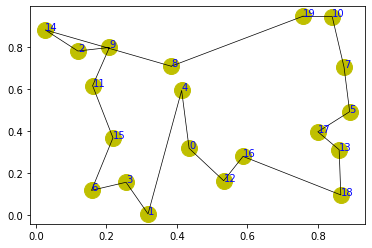

step:4330/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4331/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4332/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4333/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4334/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
distance:4.681
tensor([14,  6,  0,  5,  4, 16,  8,  7, 19, 10, 15, 11,  1,  9,  2, 13, 17, 18,
        12,  3])


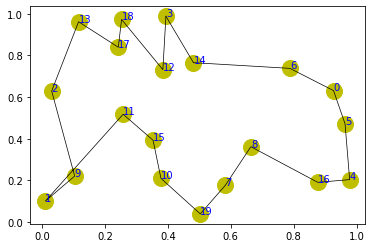

step:4335/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4336/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4337/5000, actic loss:-0.323, critic loss:0.365, L:4.605, 0min0sec
step:4338/5000, actic loss:-0.322, critic loss:0.365, L:4.605, 0min0sec
step:4339/5000, actic loss:-0.322, critic loss:0.365, L:4.605, 0min0sec
distance:3.407
tensor([10,  8,  7,  2, 18, 14, 11,  3,  1,  9, 16,  5, 13, 12, 19,  6,  4, 15,
         0, 17])


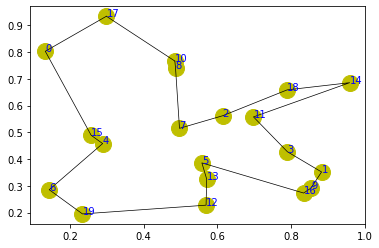

step:4340/5000, actic loss:-0.322, critic loss:0.365, L:4.605, 0min0sec
step:4341/5000, actic loss:-0.322, critic loss:0.365, L:4.604, 0min0sec
step:4342/5000, actic loss:-0.322, critic loss:0.365, L:4.604, 0min0sec
step:4343/5000, actic loss:-0.322, critic loss:0.365, L:4.604, 0min0sec
step:4344/5000, actic loss:-0.322, critic loss:0.365, L:4.604, 0min0sec
distance:4.257
tensor([ 6,  7,  1,  5,  4, 14,  0,  3, 13,  8, 17, 15, 19,  9, 16, 10, 18, 12,
        11,  2])


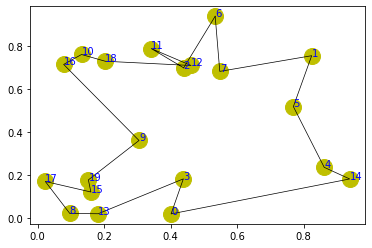

step:4345/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4346/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4347/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4348/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4349/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
distance:4.150
tensor([ 8, 17, 14,  1,  0, 19,  3, 16,  5, 11, 18, 13,  6, 10,  9, 15, 12,  2,
         4,  7])


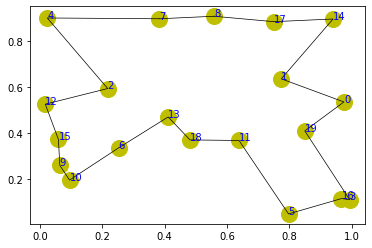

step:4350/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4351/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4352/5000, actic loss:-0.322, critic loss:0.364, L:4.604, 0min0sec
step:4353/5000, actic loss:-0.322, critic loss:0.364, L:4.603, 0min0sec
step:4354/5000, actic loss:-0.322, critic loss:0.364, L:4.603, 0min0sec
distance:4.024
tensor([ 6, 14,  5, 18,  4, 16,  3, 11,  7,  1,  8,  2, 15, 19, 10,  0,  9, 13,
        12, 17])


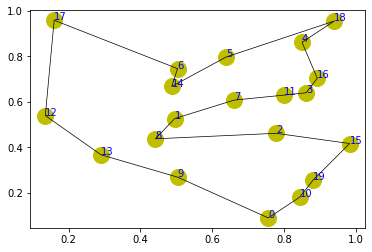

step:4355/5000, actic loss:-0.321, critic loss:0.364, L:4.603, 0min0sec
step:4356/5000, actic loss:-0.321, critic loss:0.364, L:4.603, 0min0sec
step:4357/5000, actic loss:-0.321, critic loss:0.364, L:4.603, 0min0sec
step:4358/5000, actic loss:-0.321, critic loss:0.364, L:4.603, 0min0sec
step:4359/5000, actic loss:-0.321, critic loss:0.364, L:4.603, 0min0sec
distance:4.546
tensor([ 3,  1, 13, 16,  5, 15,  9, 14,  4, 10, 12,  8, 17,  6, 19, 11,  7,  0,
        18,  2])


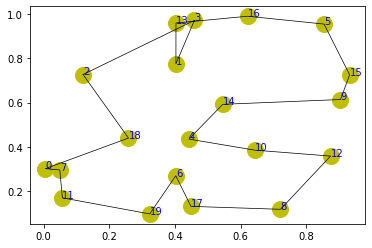

step:4360/5000, actic loss:-0.321, critic loss:0.364, L:4.603, 0min0sec
step:4361/5000, actic loss:-0.321, critic loss:0.363, L:4.603, 0min0sec
step:4362/5000, actic loss:-0.321, critic loss:0.363, L:4.603, 0min0sec
step:4363/5000, actic loss:-0.321, critic loss:0.363, L:4.603, 0min0sec
step:4364/5000, actic loss:-0.321, critic loss:0.363, L:4.603, 0min0sec
distance:4.373
tensor([ 2,  4,  3,  5,  7, 18, 12, 17, 15, 19, 13,  9, 16,  6,  1,  8, 10, 14,
         0, 11])


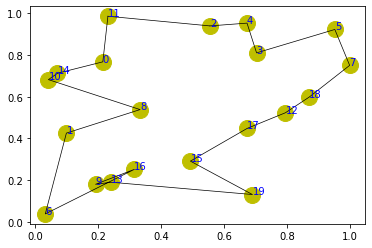

step:4365/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4366/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4367/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4368/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4369/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
distance:4.389
tensor([10, 12, 13, 16,  2, 18, 15, 14,  3,  9,  1,  8, 17,  6,  4,  5,  7, 19,
        11,  0])


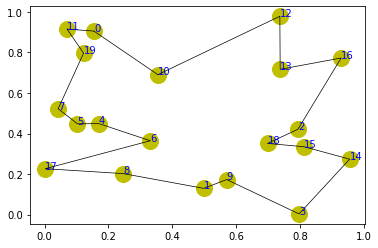

step:4370/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4371/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4372/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4373/5000, actic loss:-0.321, critic loss:0.363, L:4.602, 0min0sec
step:4374/5000, actic loss:-0.320, critic loss:0.363, L:4.602, 0min0sec
distance:4.668
tensor([ 5, 15, 12,  9,  0, 16, 11,  1,  3,  6,  2, 14, 17, 10, 19,  7, 13,  4,
         8, 18])


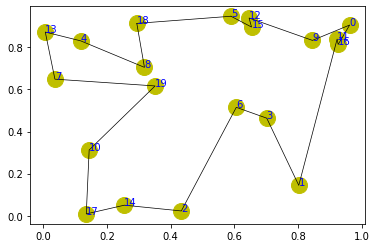

step:4375/5000, actic loss:-0.320, critic loss:0.363, L:4.602, 0min0sec
step:4376/5000, actic loss:-0.320, critic loss:0.363, L:4.601, 0min0sec
step:4377/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4378/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4379/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
distance:4.126
tensor([12,  5, 14,  3, 10, 19,  8, 18,  2,  6,  7,  4, 17, 16,  0, 15, 13,  1,
         9, 11])


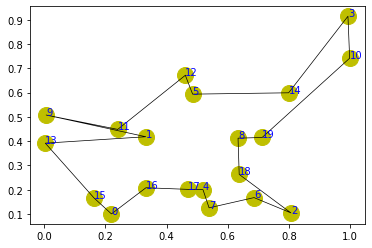

step:4380/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4381/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4382/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4383/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4384/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
distance:3.848
tensor([19,  5, 14, 11, 17, 12,  3, 10,  9,  1, 18,  4, 15, 13,  7, 16,  2,  0,
         6,  8])


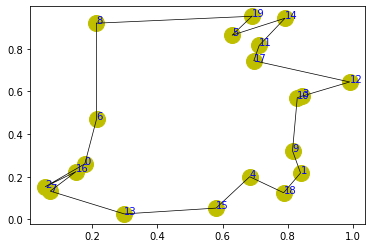

step:4385/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4386/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4387/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4388/5000, actic loss:-0.320, critic loss:0.362, L:4.601, 0min0sec
step:4389/5000, actic loss:-0.319, critic loss:0.362, L:4.600, 0min0sec
distance:4.557
tensor([16, 13,  9,  1, 12, 11, 17, 10,  2,  8,  6, 18,  3,  5, 19,  7,  0, 15,
        14,  4])


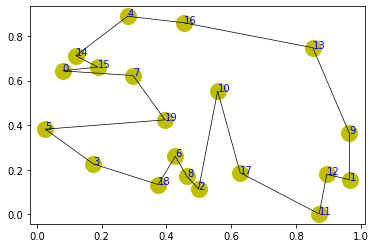

step:4390/5000, actic loss:-0.319, critic loss:0.362, L:4.600, 0min0sec
step:4391/5000, actic loss:-0.319, critic loss:0.362, L:4.600, 0min0sec
step:4392/5000, actic loss:-0.319, critic loss:0.362, L:4.600, 0min0sec
step:4393/5000, actic loss:-0.319, critic loss:0.362, L:4.600, 0min0sec
step:4394/5000, actic loss:-0.319, critic loss:0.361, L:4.600, 0min0sec
distance:4.058
tensor([ 9, 16,  0,  7,  4, 14, 12, 11, 17,  8, 19, 13,  2,  6,  1, 10, 18,  5,
        15,  3])


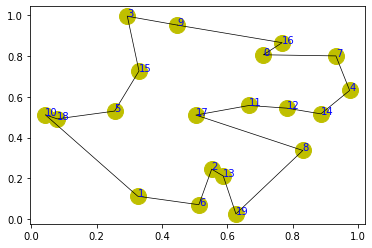

step:4395/5000, actic loss:-0.319, critic loss:0.361, L:4.600, 0min0sec
step:4396/5000, actic loss:-0.319, critic loss:0.361, L:4.600, 0min0sec
step:4397/5000, actic loss:-0.319, critic loss:0.361, L:4.600, 0min0sec
step:4398/5000, actic loss:-0.319, critic loss:0.361, L:4.600, 0min0sec
step:4399/5000, actic loss:-0.319, critic loss:0.361, L:4.600, 0min0sec
distance:3.794
tensor([13,  7,  3, 10,  0, 17, 11, 14,  9,  8, 15,  1,  4,  2,  5,  6, 19, 18,
        16, 12])


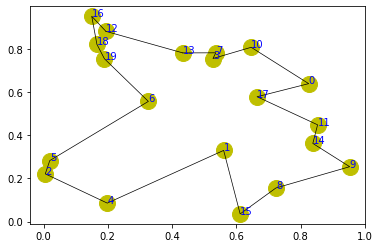

step:4400/5000, actic loss:-0.319, critic loss:0.361, L:4.599, 0min0sec
step:4401/5000, actic loss:-0.319, critic loss:0.361, L:4.599, 0min0sec
step:4402/5000, actic loss:-0.319, critic loss:0.361, L:4.599, 0min0sec
step:4403/5000, actic loss:-0.319, critic loss:0.361, L:4.599, 0min0sec
step:4404/5000, actic loss:-0.319, critic loss:0.361, L:4.599, 0min0sec
distance:4.485
tensor([ 5, 17, 18, 11,  9,  2, 13, 19,  8,  7,  0, 14, 16, 12,  6, 10,  4,  1,
        15,  3])


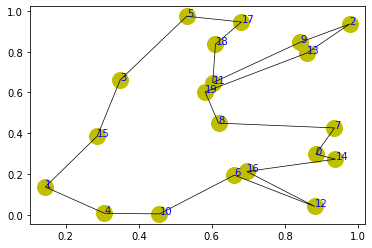

step:4405/5000, actic loss:-0.318, critic loss:0.361, L:4.599, 0min0sec
step:4406/5000, actic loss:-0.318, critic loss:0.361, L:4.599, 0min0sec
step:4407/5000, actic loss:-0.318, critic loss:0.361, L:4.599, 0min0sec
step:4408/5000, actic loss:-0.318, critic loss:0.361, L:4.599, 0min0sec
step:4409/5000, actic loss:-0.318, critic loss:0.361, L:4.599, 0min0sec
distance:5.438
tensor([ 4, 15,  7, 16,  0,  8, 11, 12, 13, 19,  5, 18,  1, 14, 17,  2,  3, 10,
         6,  9])


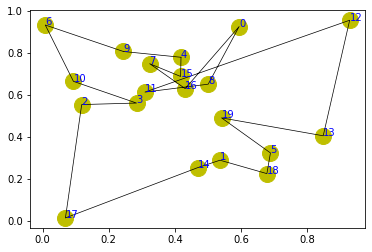

step:4410/5000, actic loss:-0.318, critic loss:0.360, L:4.599, 0min0sec
step:4411/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4412/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4413/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4414/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
distance:4.094
tensor([11, 12,  8, 17,  9, 16, 18,  7, 19,  6, 14,  4,  5,  1,  2,  3, 13, 15,
        10,  0])


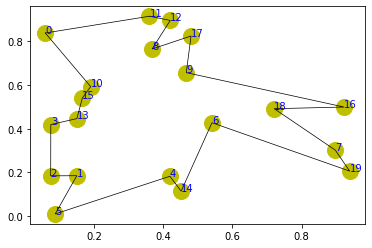

step:4415/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4416/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4417/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4418/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4419/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
distance:3.403
tensor([ 7, 17, 15, 10,  2,  4, 19, 14,  5, 13,  8,  9, 12, 11, 16, 18,  3,  1,
         0,  6])


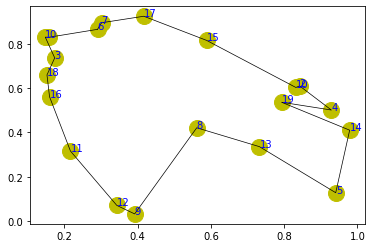

step:4420/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4421/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4422/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4423/5000, actic loss:-0.318, critic loss:0.360, L:4.598, 0min0sec
step:4424/5000, actic loss:-0.318, critic loss:0.360, L:4.597, 0min0sec
distance:4.564
tensor([11, 10,  6, 18, 19, 14, 13,  5, 12, 17,  4, 15,  8, 16,  7,  2,  1,  9,
         0,  3])


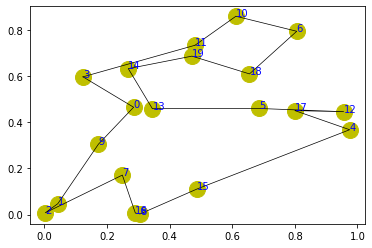

step:4425/5000, actic loss:-0.317, critic loss:0.360, L:4.597, 0min0sec
step:4426/5000, actic loss:-0.317, critic loss:0.360, L:4.597, 0min0sec
step:4427/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4428/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4429/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
distance:4.319
tensor([ 8,  4, 19,  7, 16,  0,  9, 17, 10,  3,  1, 15, 11, 14,  2,  5,  6, 13,
        18, 12])


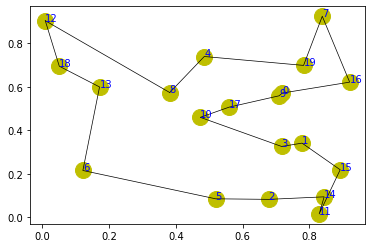

step:4430/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4431/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4432/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4433/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4434/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
distance:4.721
tensor([13, 12, 15, 14,  5,  1,  3,  8, 19,  6, 17, 10,  9,  7,  0, 18,  4,  2,
        11, 16])


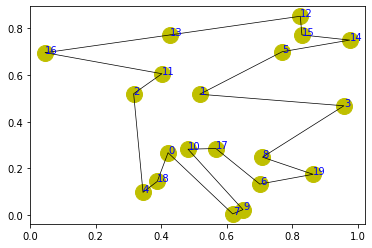

step:4435/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4436/5000, actic loss:-0.317, critic loss:0.359, L:4.597, 0min0sec
step:4437/5000, actic loss:-0.317, critic loss:0.359, L:4.596, 0min0sec
step:4438/5000, actic loss:-0.317, critic loss:0.359, L:4.596, 0min0sec
step:4439/5000, actic loss:-0.317, critic loss:0.359, L:4.596, 0min0sec
distance:4.387
tensor([17,  0, 12,  4,  6,  9, 10, 18,  5,  3,  7, 13, 16, 11, 19, 15,  8, 14,
         1,  2])


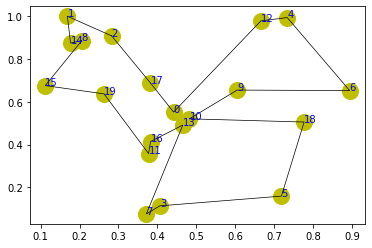

step:4440/5000, actic loss:-0.317, critic loss:0.359, L:4.596, 0min0sec
step:4441/5000, actic loss:-0.316, critic loss:0.359, L:4.596, 0min0sec
step:4442/5000, actic loss:-0.316, critic loss:0.359, L:4.596, 0min0sec
step:4443/5000, actic loss:-0.316, critic loss:0.358, L:4.596, 0min0sec
step:4444/5000, actic loss:-0.316, critic loss:0.358, L:4.596, 0min0sec
distance:3.778
tensor([18, 15,  0,  6,  5,  7, 11,  8, 17,  9,  3, 19,  4, 10,  1, 14,  2, 13,
        16, 12])


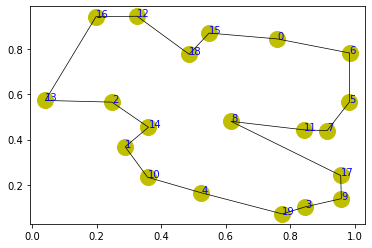

step:4445/5000, actic loss:-0.316, critic loss:0.358, L:4.596, 0min0sec
step:4446/5000, actic loss:-0.316, critic loss:0.358, L:4.596, 0min0sec
step:4447/5000, actic loss:-0.316, critic loss:0.358, L:4.596, 0min0sec
step:4448/5000, actic loss:-0.316, critic loss:0.358, L:4.596, 0min0sec
step:4449/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
distance:4.787
tensor([ 7,  5,  2,  6,  0, 19,  4,  8, 14, 10, 18, 12,  9, 15, 13,  1, 17, 16,
         3, 11])


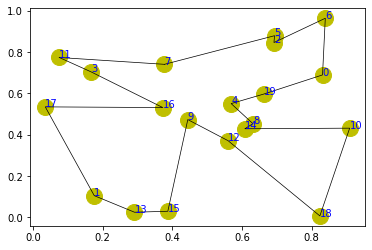

step:4450/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4451/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4452/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4453/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4454/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
distance:3.705
tensor([ 6, 16,  8,  2,  0, 13, 11,  7, 19,  5, 12,  3, 18, 14, 10, 15,  1,  4,
         9, 17])


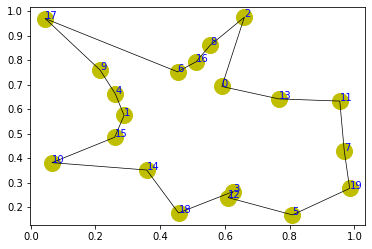

step:4455/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4456/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4457/5000, actic loss:-0.316, critic loss:0.358, L:4.595, 0min0sec
step:4458/5000, actic loss:-0.315, critic loss:0.358, L:4.595, 0min0sec
step:4459/5000, actic loss:-0.315, critic loss:0.358, L:4.595, 0min0sec
distance:4.150
tensor([ 4,  3, 10, 18, 14, 11,  8,  7,  1, 17,  0, 15, 12, 13, 16,  5,  6,  2,
         9, 19])


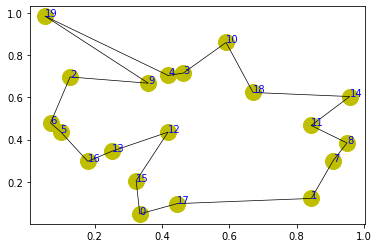

step:4460/5000, actic loss:-0.315, critic loss:0.357, L:4.595, 0min0sec
step:4461/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4462/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4463/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4464/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
distance:3.650
tensor([15,  0, 13, 17,  8,  5,  1,  9,  3, 10, 16,  2, 11, 12,  6,  7, 14,  4,
        18, 19])


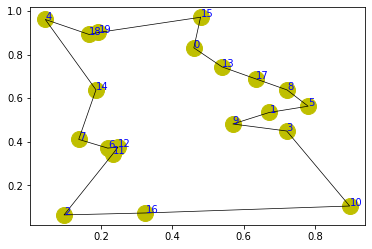

step:4465/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4466/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4467/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4468/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4469/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
distance:3.765
tensor([ 4,  9, 19,  6, 11, 10,  1, 16,  5, 18,  8, 14,  3, 13, 12,  7, 15,  0,
        17,  2])


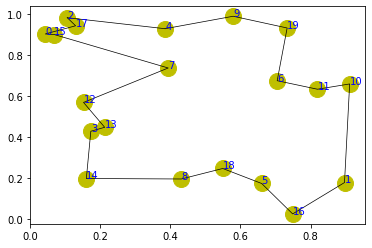

step:4470/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4471/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4472/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4473/5000, actic loss:-0.315, critic loss:0.357, L:4.594, 0min0sec
step:4474/5000, actic loss:-0.315, critic loss:0.357, L:4.593, 0min0sec
distance:4.007
tensor([ 9, 16,  6, 15, 14,  7, 12,  0, 13,  4, 10,  3, 19,  8,  2, 11,  1, 18,
        17,  5])


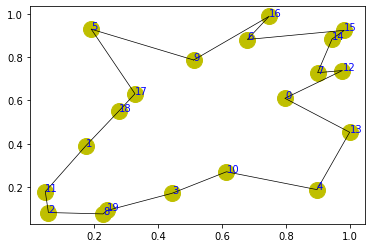

step:4475/5000, actic loss:-0.315, critic loss:0.357, L:4.593, 0min0sec
step:4476/5000, actic loss:-0.315, critic loss:0.357, L:4.593, 0min0sec
step:4477/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4478/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4479/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
distance:4.576
tensor([ 2,  4, 19,  0, 14,  8, 18,  6, 12,  7, 11,  1, 16,  5, 13, 17, 10,  3,
        15,  9])


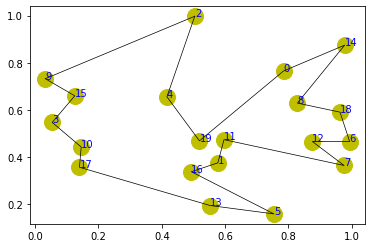

step:4480/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4481/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4482/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4483/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4484/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
distance:4.243
tensor([14, 12, 10,  1,  4,  0, 11, 13, 19,  8,  3,  7,  5, 17,  6,  2, 16,  9,
        15, 18])


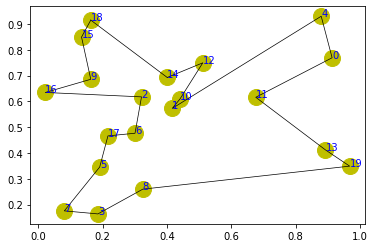

step:4485/5000, actic loss:-0.314, critic loss:0.356, L:4.593, 0min0sec
step:4486/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
step:4487/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
step:4488/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
step:4489/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
distance:4.193
tensor([ 0, 17, 15,  6, 14,  4,  2,  5,  3,  8, 16, 18, 12,  1, 10, 13, 11,  9,
        19,  7])


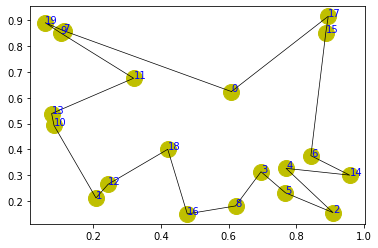

step:4490/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
step:4491/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
step:4492/5000, actic loss:-0.314, critic loss:0.356, L:4.592, 0min0sec
step:4493/5000, actic loss:-0.313, critic loss:0.356, L:4.592, 0min0sec
step:4494/5000, actic loss:-0.313, critic loss:0.356, L:4.592, 0min0sec
distance:4.382
tensor([16, 14, 15, 17,  7,  6,  5,  9,  0,  1, 13, 18, 10, 19,  2,  4, 12, 11,
         3,  8])


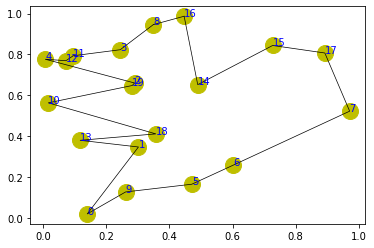

step:4495/5000, actic loss:-0.313, critic loss:0.355, L:4.592, 0min0sec
step:4496/5000, actic loss:-0.313, critic loss:0.355, L:4.592, 0min0sec
step:4497/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4498/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4499/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
distance:4.086
tensor([ 1, 10, 11, 12,  0, 17, 18,  2,  3, 16, 15,  4,  5, 13, 19,  6,  8, 14,
         9,  7])


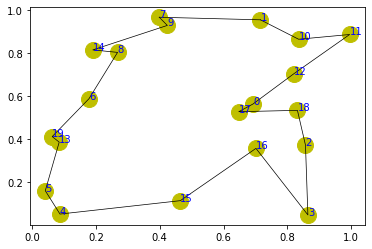

step:4500/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4501/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4502/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4503/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4504/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
distance:4.129
tensor([ 6, 17, 13, 10, 18, 15,  2,  1,  7, 12,  0,  9, 14,  3, 19, 16,  8,  5,
        11,  4])


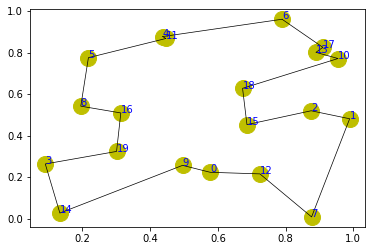

step:4505/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4506/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4507/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4508/5000, actic loss:-0.313, critic loss:0.355, L:4.591, 0min0sec
step:4509/5000, actic loss:-0.313, critic loss:0.355, L:4.590, 0min0sec
distance:4.122
tensor([ 7,  3,  8,  2, 12, 19,  4, 11, 10,  0, 16, 15, 17,  6,  9,  5, 14,  1,
        18, 13])


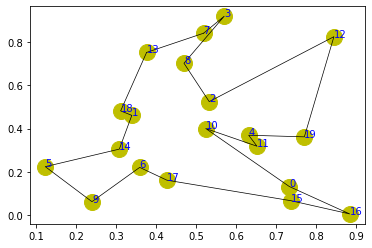

step:4510/5000, actic loss:-0.313, critic loss:0.355, L:4.590, 0min0sec
step:4511/5000, actic loss:-0.313, critic loss:0.355, L:4.590, 0min0sec
step:4512/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
step:4513/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
step:4514/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
distance:3.273
tensor([ 0, 15,  9,  1, 12, 19,  5,  7,  2, 17,  6,  4, 11, 10, 13, 14, 16, 18,
         8,  3])


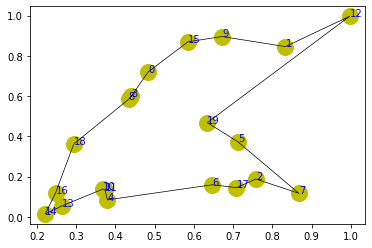

step:4515/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
step:4516/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
step:4517/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
step:4518/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
step:4519/5000, actic loss:-0.312, critic loss:0.354, L:4.590, 0min0sec
distance:4.318
tensor([13, 10,  5, 18,  3,  6,  9, 17,  1,  8, 14, 19, 12, 16,  4,  0, 11, 15,
         2,  7])


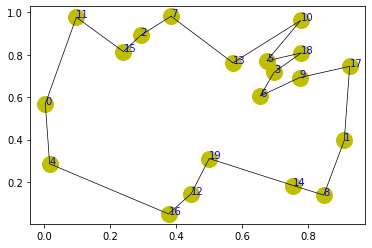

step:4520/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4521/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4522/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4523/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4524/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
distance:3.938
tensor([13,  2,  7, 18, 16,  3, 11, 14,  4,  8, 15, 12,  9,  6, 19, 10, 17,  5,
         0,  1])


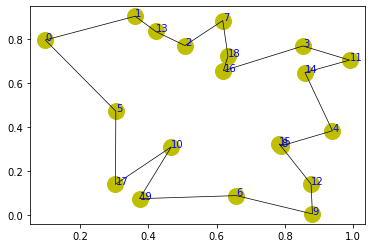

step:4525/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4526/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4527/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4528/5000, actic loss:-0.312, critic loss:0.354, L:4.589, 0min0sec
step:4529/5000, actic loss:-0.312, critic loss:0.353, L:4.589, 0min0sec
distance:3.438
tensor([10,  1, 13,  4,  8,  3, 15,  7,  6, 16,  9, 12, 14, 17,  5, 11, 18,  0,
         2, 19])


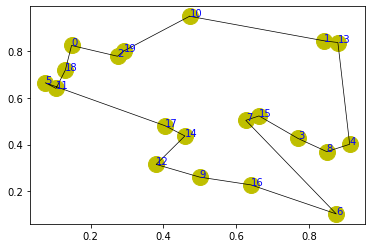

step:4530/5000, actic loss:-0.312, critic loss:0.353, L:4.588, 0min0sec
step:4531/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4532/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4533/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4534/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
distance:4.165
tensor([11,  8, 19, 14,  9,  6,  5, 10, 13, 17, 12, 15, 18,  0,  3,  7,  1,  2,
         4, 16])


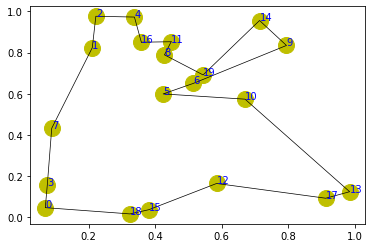

step:4535/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4536/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4537/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4538/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4539/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
distance:3.990
tensor([ 6, 19,  5,  3, 14, 10, 17,  4, 13, 12,  7, 11, 16,  9,  1,  2, 18,  0,
         8, 15])


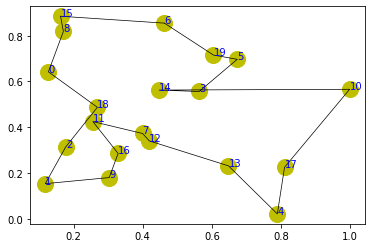

step:4540/5000, actic loss:-0.311, critic loss:0.353, L:4.588, 0min0sec
step:4541/5000, actic loss:-0.311, critic loss:0.353, L:4.587, 0min0sec
step:4542/5000, actic loss:-0.311, critic loss:0.353, L:4.587, 0min0sec
step:4543/5000, actic loss:-0.311, critic loss:0.353, L:4.587, 0min0sec
step:4544/5000, actic loss:-0.311, critic loss:0.353, L:4.587, 0min0sec
distance:4.076
tensor([13,  0, 14, 11,  1,  9, 16,  7,  2, 10, 15,  8,  6,  3, 19, 12,  5,  4,
        18, 17])


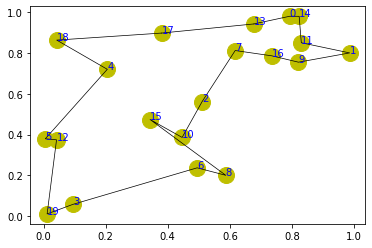

step:4545/5000, actic loss:-0.311, critic loss:0.352, L:4.587, 0min0sec
step:4546/5000, actic loss:-0.311, critic loss:0.352, L:4.587, 0min0sec
step:4547/5000, actic loss:-0.310, critic loss:0.352, L:4.587, 0min0sec
step:4548/5000, actic loss:-0.310, critic loss:0.352, L:4.587, 0min0sec
step:4549/5000, actic loss:-0.310, critic loss:0.352, L:4.587, 0min0sec
distance:4.414
tensor([14,  7,  6, 15, 16,  8, 13,  1,  5,  2,  0, 12, 19, 10,  4, 18,  3,  9,
        17, 11])


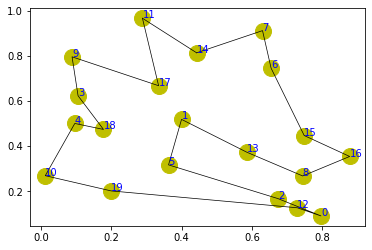

step:4550/5000, actic loss:-0.310, critic loss:0.352, L:4.587, 0min0sec
step:4551/5000, actic loss:-0.310, critic loss:0.352, L:4.587, 0min0sec
step:4552/5000, actic loss:-0.310, critic loss:0.352, L:4.587, 0min0sec
step:4553/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4554/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
distance:4.035
tensor([17,  3, 18, 16,  5,  2, 15,  4,  0,  8, 14, 12, 10,  7, 11, 13,  9,  6,
        19,  1])


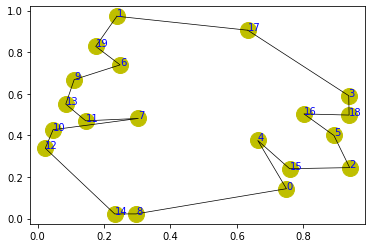

step:4555/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4556/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4557/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4558/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4559/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
distance:4.217
tensor([ 4,  5,  8,  9, 19, 14,  1, 10,  6, 12, 16, 13,  0, 18, 15, 11, 17,  2,
         3,  7])


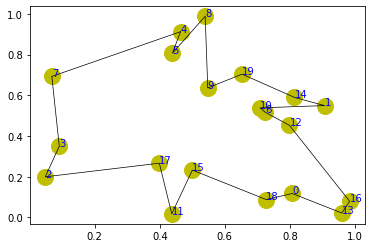

step:4560/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4561/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4562/5000, actic loss:-0.310, critic loss:0.352, L:4.586, 0min0sec
step:4563/5000, actic loss:-0.309, critic loss:0.351, L:4.586, 0min0sec
step:4564/5000, actic loss:-0.309, critic loss:0.351, L:4.586, 0min0sec
distance:4.020
tensor([11, 13, 17,  5, 12,  8, 14,  3, 16, 10, 15,  1,  9,  4,  7,  2,  0,  6,
        19, 18])


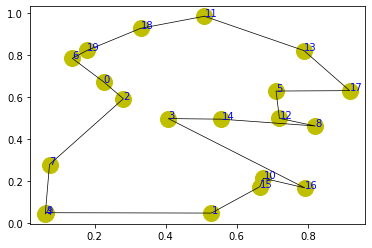

step:4565/5000, actic loss:-0.309, critic loss:0.351, L:4.586, 0min0sec
step:4566/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4567/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4568/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4569/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
distance:4.194
tensor([18, 14,  0, 12,  7, 11,  4, 17,  6,  8,  2,  9, 19,  3, 13, 15, 10,  5,
        16,  1])


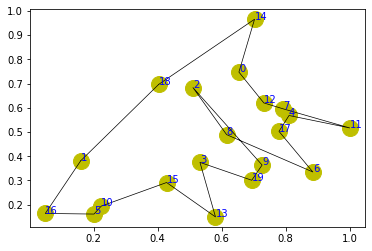

step:4570/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4571/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4572/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4573/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4574/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
distance:4.627
tensor([13,  0, 11,  7, 18,  4,  3,  6, 12,  8,  2, 17, 15, 19,  5, 14,  9, 16,
        10,  1])


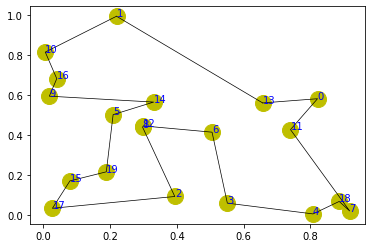

step:4575/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4576/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4577/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4578/5000, actic loss:-0.309, critic loss:0.351, L:4.585, 0min0sec
step:4579/5000, actic loss:-0.309, critic loss:0.351, L:4.584, 0min0sec
distance:4.157
tensor([ 1, 19, 11,  3,  7,  4, 13,  8, 12, 18, 17,  0, 10,  2,  6, 16, 14, 15,
         9,  5])


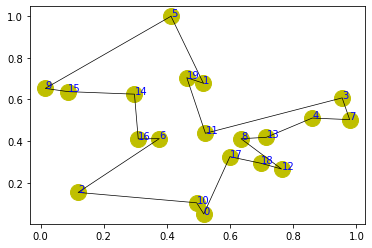

step:4580/5000, actic loss:-0.308, critic loss:0.351, L:4.584, 0min0sec
step:4581/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4582/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4583/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4584/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
distance:3.545
tensor([15,  3,  7, 12,  1,  0,  4,  8, 14,  2, 19, 16, 11,  9, 18,  5, 10, 13,
        17,  6])


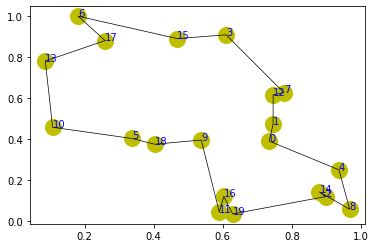

step:4585/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4586/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4587/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4588/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
step:4589/5000, actic loss:-0.308, critic loss:0.350, L:4.584, 0min0sec
distance:3.885
tensor([ 6,  2, 17, 15,  0,  1,  5,  8, 19, 13, 18,  3,  9, 12,  4, 10,  7, 16,
        11, 14])


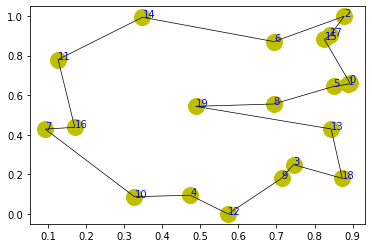

step:4590/5000, actic loss:-0.308, critic loss:0.350, L:4.583, 0min0sec
step:4591/5000, actic loss:-0.308, critic loss:0.350, L:4.583, 0min0sec
step:4592/5000, actic loss:-0.308, critic loss:0.350, L:4.583, 0min0sec
step:4593/5000, actic loss:-0.308, critic loss:0.350, L:4.583, 0min0sec
step:4594/5000, actic loss:-0.308, critic loss:0.350, L:4.583, 0min0sec
distance:3.813
tensor([13, 18,  9,  6, 14,  8,  5,  4, 19,  2,  3, 15, 10,  7, 11,  0, 12, 16,
         1, 17])


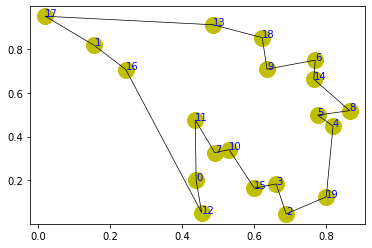

step:4595/5000, actic loss:-0.308, critic loss:0.350, L:4.583, 0min0sec
step:4596/5000, actic loss:-0.307, critic loss:0.350, L:4.583, 0min0sec
step:4597/5000, actic loss:-0.307, critic loss:0.350, L:4.583, 0min0sec
step:4598/5000, actic loss:-0.307, critic loss:0.349, L:4.583, 0min0sec
step:4599/5000, actic loss:-0.307, critic loss:0.349, L:4.583, 0min0sec
distance:3.644
tensor([17, 10,  8, 12,  0, 19, 14,  1, 16, 13, 11, 18, 15,  2,  9,  7,  3,  4,
         5,  6])


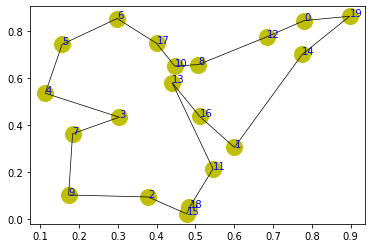

step:4600/5000, actic loss:-0.307, critic loss:0.349, L:4.583, 0min0sec
step:4601/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4602/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4603/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4604/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
distance:4.052
tensor([16, 15, 14, 10,  3,  1, 11,  9,  0,  8, 17,  5,  2, 13, 12,  7, 19, 18,
         4,  6])


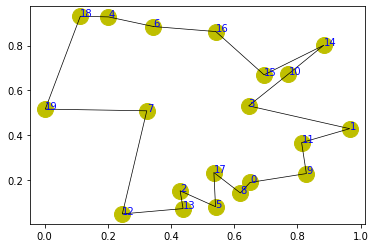

step:4605/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4606/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4607/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4608/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4609/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
distance:3.940
tensor([ 4,  5, 18,  9,  7,  6, 17,  8,  0, 14, 16, 19, 10, 12,  1, 15, 11, 13,
         3,  2])


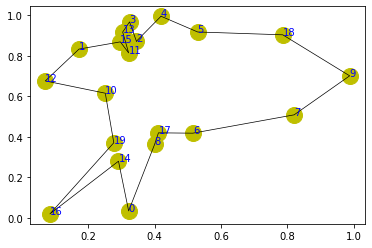

step:4610/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4611/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4612/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4613/5000, actic loss:-0.307, critic loss:0.349, L:4.582, 0min0sec
step:4614/5000, actic loss:-0.307, critic loss:0.349, L:4.581, 0min0sec
distance:4.310
tensor([12, 16, 11, 18, 15, 19, 14,  8,  2, 10,  6,  1,  3,  0,  5, 17,  7,  4,
         9, 13])


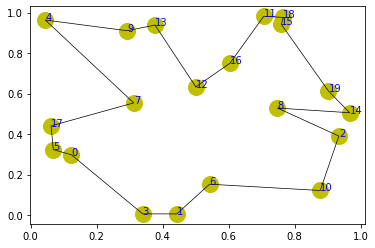

step:4615/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4616/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4617/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4618/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4619/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
distance:4.961
tensor([ 9,  7,  6,  0,  8, 17, 11, 13, 15, 14, 10, 16,  1,  3, 18,  2,  4, 12,
        19,  5])


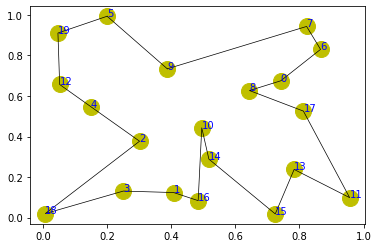

step:4620/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4621/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4622/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4623/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4624/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
distance:3.541
tensor([ 6, 12,  4, 17,  3,  1,  5, 13, 19, 18, 11,  7, 10,  2,  0, 14,  9, 16,
        15,  8])


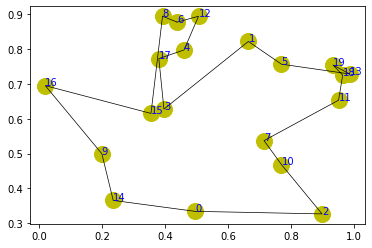

step:4625/5000, actic loss:-0.306, critic loss:0.348, L:4.581, 0min0sec
step:4626/5000, actic loss:-0.306, critic loss:0.348, L:4.580, 0min0sec
step:4627/5000, actic loss:-0.306, critic loss:0.348, L:4.580, 0min0sec
step:4628/5000, actic loss:-0.306, critic loss:0.348, L:4.580, 0min0sec
step:4629/5000, actic loss:-0.306, critic loss:0.348, L:4.580, 0min0sec
distance:3.444
tensor([18,  7, 16, 11, 15,  1, 13, 17,  8,  0,  2,  9,  3, 10, 12,  6,  4, 19,
         5, 14])


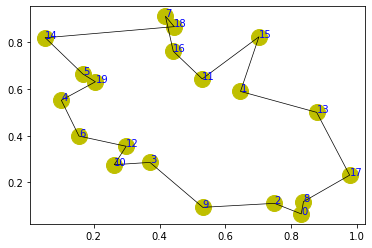

step:4630/5000, actic loss:-0.306, critic loss:0.348, L:4.580, 0min0sec
step:4631/5000, actic loss:-0.306, critic loss:0.348, L:4.580, 0min0sec
step:4632/5000, actic loss:-0.305, critic loss:0.348, L:4.580, 0min0sec
step:4633/5000, actic loss:-0.305, critic loss:0.347, L:4.580, 0min0sec
step:4634/5000, actic loss:-0.305, critic loss:0.347, L:4.580, 0min0sec
distance:5.057
tensor([ 4,  6, 19, 15, 12, 11, 14, 17, 10, 13,  7,  5, 16,  2,  0,  8,  9, 18,
         1,  3])


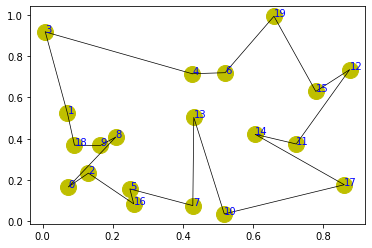

step:4635/5000, actic loss:-0.305, critic loss:0.347, L:4.580, 0min0sec
step:4636/5000, actic loss:-0.305, critic loss:0.347, L:4.580, 0min0sec
step:4637/5000, actic loss:-0.305, critic loss:0.347, L:4.580, 0min0sec
step:4638/5000, actic loss:-0.305, critic loss:0.347, L:4.580, 0min0sec
step:4639/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
distance:3.789
tensor([ 6,  5, 16, 19, 14,  2,  9, 10, 15, 13,  4,  0, 17, 11,  7,  1, 18,  3,
        12,  8])


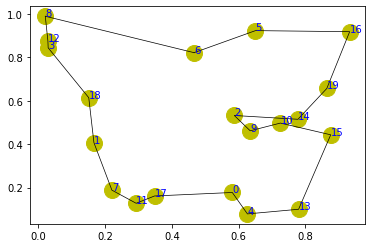

step:4640/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4641/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4642/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4643/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4644/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
distance:4.666
tensor([ 1, 15,  0,  4, 12,  2,  8,  6, 18, 14,  3, 16,  5, 11, 19, 13, 17, 10,
         7,  9])


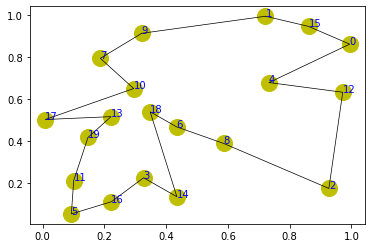

step:4645/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4646/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4647/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4648/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
step:4649/5000, actic loss:-0.305, critic loss:0.347, L:4.579, 0min0sec
distance:4.223
tensor([16,  5, 10, 19,  4, 17,  3, 11, 13,  8, 14, 12, 18,  2,  6,  9, 15,  7,
         1,  0])


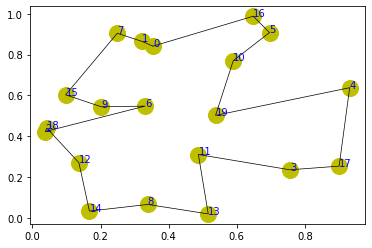

step:4650/5000, actic loss:-0.304, critic loss:0.347, L:4.579, 0min0sec
step:4651/5000, actic loss:-0.304, critic loss:0.346, L:4.579, 0min0sec
step:4652/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4653/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4654/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
distance:3.479
tensor([10,  3, 16, 15,  7, 14,  2,  6,  4, 19,  8,  9, 12, 17,  1,  0, 13, 18,
         5, 11])


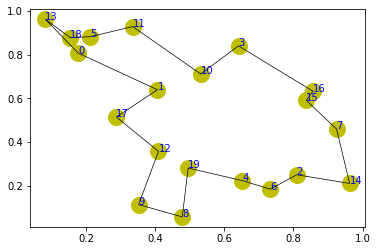

step:4655/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4656/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4657/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4658/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4659/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
distance:4.115
tensor([10, 19,  0,  7,  8, 11,  4,  2, 16, 13,  5, 15, 14, 17,  3,  6, 12,  1,
        18,  9])


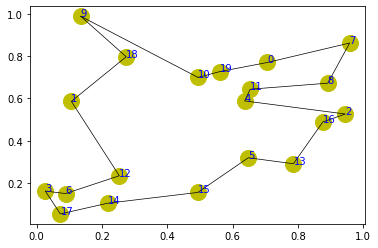

step:4660/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4661/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4662/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4663/5000, actic loss:-0.304, critic loss:0.346, L:4.578, 0min0sec
step:4664/5000, actic loss:-0.304, critic loss:0.346, L:4.577, 0min0sec
distance:4.121
tensor([16,  4, 19, 15,  9,  0,  8,  1,  2,  5, 17, 12, 14, 10,  7,  6, 18, 13,
        11,  3])


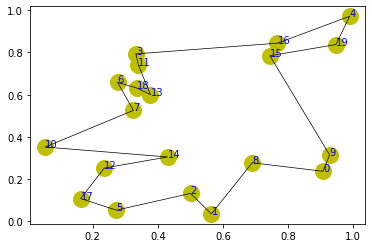

step:4665/5000, actic loss:-0.304, critic loss:0.346, L:4.577, 0min0sec
step:4666/5000, actic loss:-0.304, critic loss:0.346, L:4.577, 0min0sec
step:4667/5000, actic loss:-0.304, critic loss:0.346, L:4.577, 0min0sec
step:4668/5000, actic loss:-0.303, critic loss:0.346, L:4.577, 0min0sec
step:4669/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
distance:4.096
tensor([14,  3, 16, 13, 18,  6,  1,  8,  2,  9,  0, 10, 12,  7, 15, 17,  5,  4,
        11, 19])


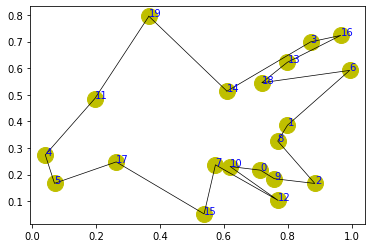

step:4670/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min1sec
step:4671/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
step:4672/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
step:4673/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
step:4674/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
distance:4.140
tensor([ 9, 13, 16, 10, 14, 17, 11, 12,  6,  1, 19,  4,  3,  7, 15,  5, 18,  0,
         2,  8])


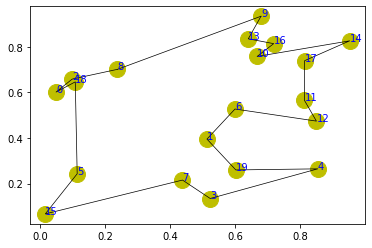

step:4675/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
step:4676/5000, actic loss:-0.303, critic loss:0.345, L:4.577, 0min0sec
step:4677/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
step:4678/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
step:4679/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
distance:4.719
tensor([ 8, 18, 17,  1,  9,  7,  5,  4,  2, 13,  0, 14,  6, 16, 12, 10, 15, 11,
        19,  3])


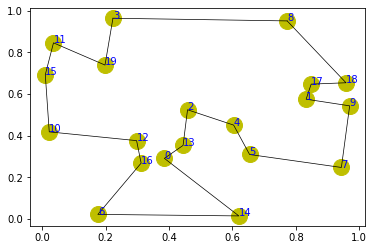

step:4680/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
step:4681/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
step:4682/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
step:4683/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
step:4684/5000, actic loss:-0.303, critic loss:0.345, L:4.576, 0min0sec
distance:4.394
tensor([ 5, 12, 16,  9,  2,  0, 10,  3,  8,  4, 11, 17, 18,  6,  7, 13,  1, 19,
        15, 14])


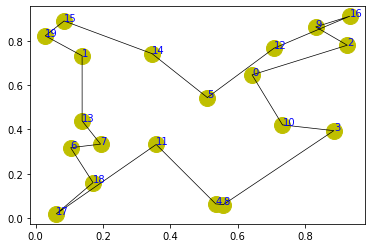

step:4685/5000, actic loss:-0.302, critic loss:0.345, L:4.576, 0min0sec
step:4686/5000, actic loss:-0.302, critic loss:0.345, L:4.576, 0min0sec
step:4687/5000, actic loss:-0.302, critic loss:0.345, L:4.576, 0min0sec
step:4688/5000, actic loss:-0.302, critic loss:0.345, L:4.576, 0min0sec
step:4689/5000, actic loss:-0.302, critic loss:0.345, L:4.575, 0min0sec
distance:4.388
tensor([ 6, 12, 10, 14, 19,  4,  7, 18, 17, 16,  0,  1,  3,  2, 13,  8,  9,  5,
        11, 15])


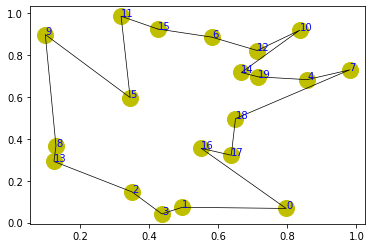

step:4690/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4691/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4692/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4693/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4694/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
distance:3.691
tensor([19,  0, 15,  5,  7,  4,  2, 12, 16, 11,  9, 10, 17, 14,  3, 13, 18,  8,
         6,  1])


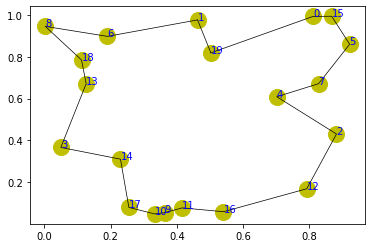

step:4695/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4696/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4697/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4698/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4699/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
distance:4.742
tensor([ 8,  0, 12, 11,  4, 18, 14, 13,  5,  3, 17, 15,  2,  7, 16,  6, 19,  9,
        10,  1])


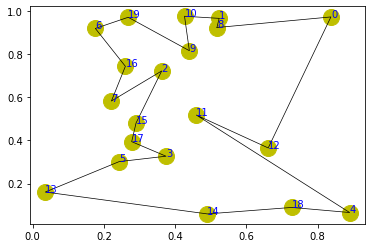

step:4700/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4701/5000, actic loss:-0.302, critic loss:0.344, L:4.575, 0min0sec
step:4702/5000, actic loss:-0.302, critic loss:0.344, L:4.574, 0min0sec
step:4703/5000, actic loss:-0.302, critic loss:0.344, L:4.574, 0min0sec
step:4704/5000, actic loss:-0.302, critic loss:0.344, L:4.574, 0min0sec
distance:3.702
tensor([16, 19,  9,  7, 11,  8,  1, 12, 10, 13, 18,  5,  2, 17,  3, 15,  6,  0,
         4, 14])


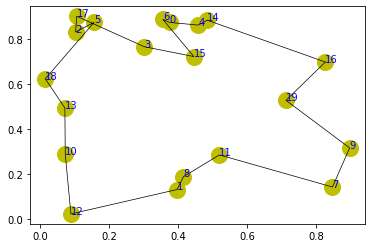

step:4705/5000, actic loss:-0.301, critic loss:0.344, L:4.574, 0min0sec
step:4706/5000, actic loss:-0.301, critic loss:0.344, L:4.574, 0min0sec
step:4707/5000, actic loss:-0.301, critic loss:0.344, L:4.574, 0min0sec
step:4708/5000, actic loss:-0.301, critic loss:0.344, L:4.574, 0min0sec
step:4709/5000, actic loss:-0.301, critic loss:0.343, L:4.574, 0min0sec
distance:4.381
tensor([11,  8, 14,  3,  2,  6, 12,  4, 18, 10,  9,  1, 13, 16,  0, 17, 19, 15,
         5,  7])


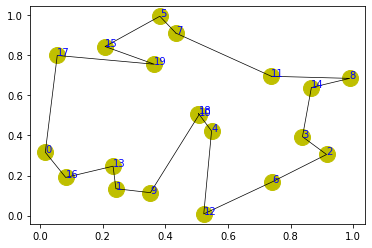

step:4710/5000, actic loss:-0.301, critic loss:0.343, L:4.574, 0min0sec
step:4711/5000, actic loss:-0.301, critic loss:0.343, L:4.574, 0min0sec
step:4712/5000, actic loss:-0.301, critic loss:0.343, L:4.574, 0min0sec
step:4713/5000, actic loss:-0.301, critic loss:0.343, L:4.574, 0min0sec
step:4714/5000, actic loss:-0.301, critic loss:0.343, L:4.574, 0min0sec
distance:3.780
tensor([18, 12,  8,  9,  1, 13, 19, 15,  0, 11,  5, 14,  3,  7,  6,  2,  4, 17,
        16, 10])


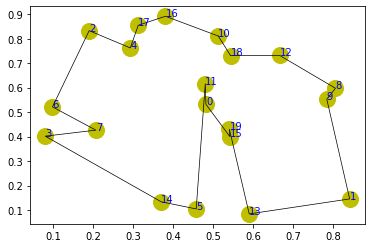

step:4715/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4716/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4717/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4718/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4719/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
distance:4.162
tensor([ 1, 17,  9,  2, 16, 12, 11,  3,  4,  6, 15, 19,  8, 18, 14,  5,  0, 13,
        10,  7])


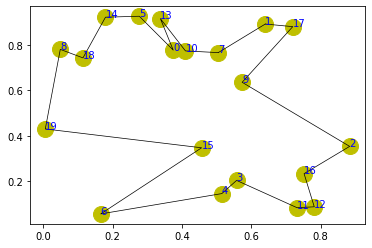

step:4720/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4721/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4722/5000, actic loss:-0.301, critic loss:0.343, L:4.573, 0min0sec
step:4723/5000, actic loss:-0.300, critic loss:0.343, L:4.573, 0min0sec
step:4724/5000, actic loss:-0.300, critic loss:0.343, L:4.573, 0min0sec
distance:4.555
tensor([12,  7, 13,  2,  6,  5, 10,  1,  0, 11, 16,  8, 17,  4, 19, 15,  9, 18,
         3, 14])


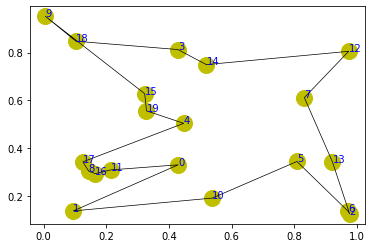

step:4725/5000, actic loss:-0.300, critic loss:0.343, L:4.573, 0min0sec
step:4726/5000, actic loss:-0.300, critic loss:0.343, L:4.573, 0min0sec
step:4727/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4728/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4729/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
distance:3.687
tensor([16, 17, 11, 12,  5,  4,  7,  9,  3, 14,  2,  0,  6, 13, 15,  1, 10, 18,
         8, 19])


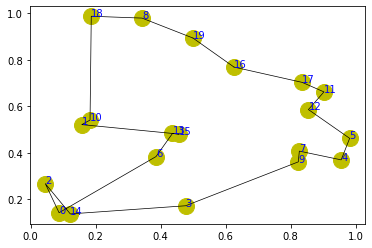

step:4730/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4731/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4732/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4733/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4734/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
distance:5.131
tensor([ 4, 19, 13,  9,  5,  3,  1,  8,  6, 18, 17,  2, 11, 14,  7, 10, 12, 15,
         0, 16])


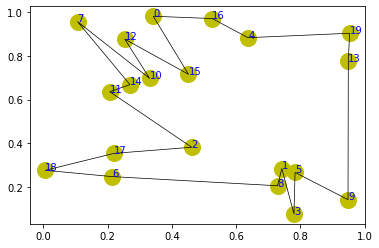

step:4735/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4736/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4737/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4738/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
step:4739/5000, actic loss:-0.300, critic loss:0.342, L:4.572, 0min0sec
distance:3.861
tensor([18,  2,  4, 14, 13,  5,  8, 11,  3,  1, 17, 10,  9, 15,  6, 16,  7, 12,
        19,  0])


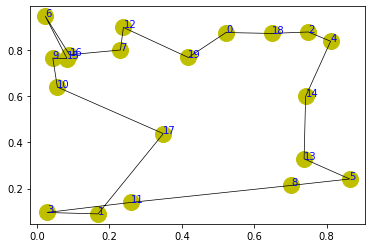

step:4740/5000, actic loss:-0.300, critic loss:0.342, L:4.571, 0min0sec
step:4741/5000, actic loss:-0.300, critic loss:0.342, L:4.571, 0min0sec
step:4742/5000, actic loss:-0.300, critic loss:0.342, L:4.571, 0min0sec
step:4743/5000, actic loss:-0.300, critic loss:0.342, L:4.571, 0min0sec
step:4744/5000, actic loss:-0.300, critic loss:0.342, L:4.571, 0min0sec
distance:3.984
tensor([15,  6, 16,  7, 12, 17, 18, 14, 19,  4, 13,  5,  8,  1, 11,  3, 10,  9,
         2,  0])


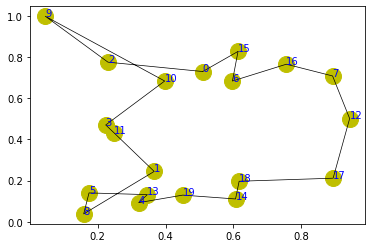

step:4745/5000, actic loss:-0.299, critic loss:0.342, L:4.571, 0min0sec
step:4746/5000, actic loss:-0.299, critic loss:0.342, L:4.571, 0min0sec
step:4747/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
step:4748/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
step:4749/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
distance:4.811
tensor([15,  7,  9,  1, 19,  2, 11, 14, 10,  3,  4, 13,  8,  0, 16,  5, 17, 18,
        12,  6])


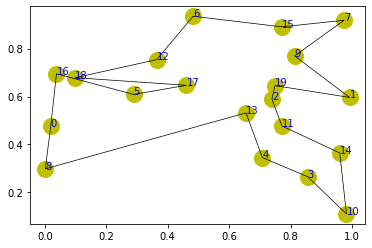

step:4750/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
step:4751/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
step:4752/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
step:4753/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
step:4754/5000, actic loss:-0.299, critic loss:0.341, L:4.571, 0min0sec
distance:4.283
tensor([ 4,  7,  3,  2,  8, 17, 18,  0, 10, 11, 15, 12,  9,  6, 16,  1, 14, 19,
         5, 13])


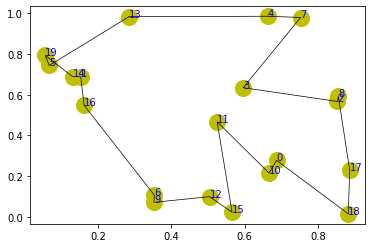

step:4755/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4756/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4757/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4758/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4759/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
distance:3.853
tensor([14, 10, 11, 18,  3,  0,  7, 19, 12, 17, 16,  9,  6,  1,  5, 15, 13,  4,
         8,  2])


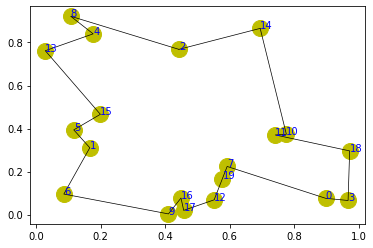

step:4760/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4761/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4762/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4763/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4764/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
distance:5.333
tensor([ 5, 17,  3, 18,  8,  0,  2,  6, 10, 12, 14, 15, 13, 16, 19,  7,  4,  9,
         1, 11])


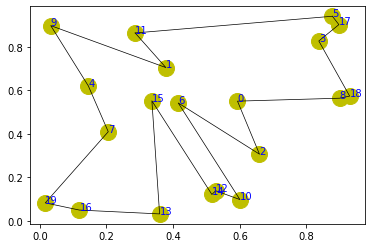

step:4765/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4766/5000, actic loss:-0.299, critic loss:0.341, L:4.570, 0min0sec
step:4767/5000, actic loss:-0.298, critic loss:0.340, L:4.570, 0min0sec
step:4768/5000, actic loss:-0.298, critic loss:0.340, L:4.570, 0min0sec
step:4769/5000, actic loss:-0.298, critic loss:0.340, L:4.570, 0min0sec
distance:3.952
tensor([ 2,  0, 19,  9,  7,  1, 18, 10, 13,  3, 17, 11, 15,  4,  8, 16, 12,  6,
         5, 14])


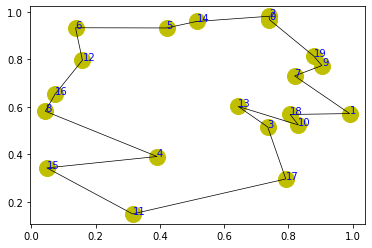

step:4770/5000, actic loss:-0.298, critic loss:0.340, L:4.570, 0min0sec
step:4771/5000, actic loss:-0.298, critic loss:0.340, L:4.570, 0min0sec
step:4772/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4773/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4774/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
distance:4.576
tensor([18,  5, 15,  0, 14, 11, 12, 16, 13,  3, 17,  7,  1,  9,  2,  6,  4, 10,
        19,  8])


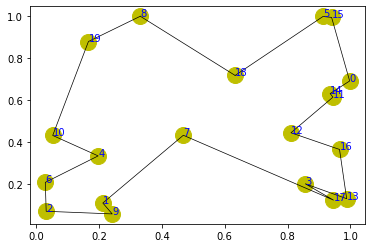

step:4775/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4776/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4777/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4778/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4779/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
distance:3.578
tensor([15, 19,  4, 17, 18,  8, 13, 12, 10,  2,  6, 14,  3,  7,  0, 16, 11,  5,
         9,  1])


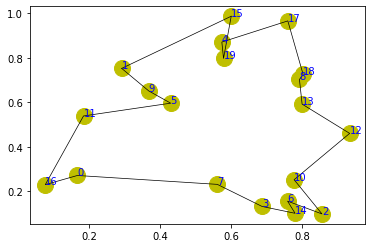

step:4780/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4781/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4782/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4783/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4784/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
distance:4.341
tensor([ 4, 19,  6,  3, 14,  8, 11, 16,  1,  7, 13, 12,  5, 10,  0,  2, 15, 18,
        17,  9])


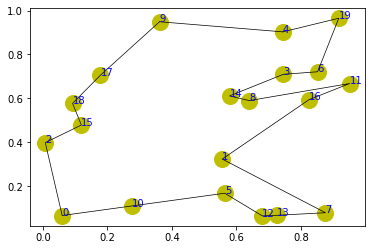

step:4785/5000, actic loss:-0.298, critic loss:0.340, L:4.569, 0min0sec
step:4786/5000, actic loss:-0.297, critic loss:0.340, L:4.568, 0min0sec
step:4787/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4788/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4789/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
distance:4.913
tensor([11, 12, 10,  0, 13,  3,  4, 19,  9, 18, 14,  8, 15,  7,  6,  5, 16,  1,
         2, 17])


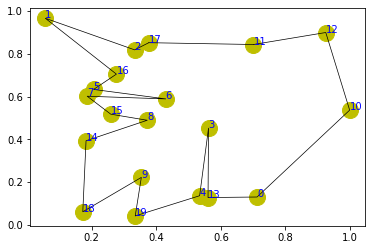

step:4790/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4791/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4792/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4793/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4794/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
distance:4.304
tensor([ 6, 19,  4,  7,  9,  3, 10,  8,  2,  1, 12,  0,  5, 18, 17, 16, 13, 15,
        14, 11])


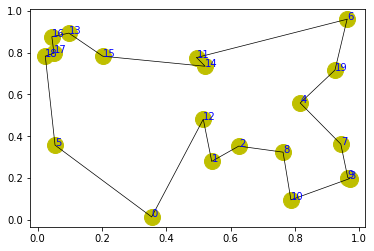

step:4795/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4796/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4797/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4798/5000, actic loss:-0.297, critic loss:0.339, L:4.568, 0min0sec
step:4799/5000, actic loss:-0.297, critic loss:0.339, L:4.567, 0min0sec
distance:3.844
tensor([ 1,  2,  0, 19,  5, 18, 13,  7,  4,  3,  6, 14,  8, 11, 17, 10, 15,  9,
        16, 12])


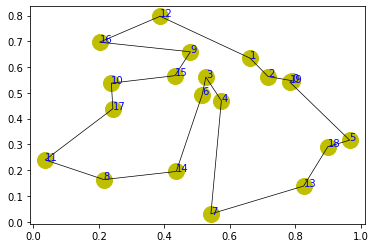

step:4800/5000, actic loss:-0.297, critic loss:0.339, L:4.567, 0min0sec
step:4801/5000, actic loss:-0.297, critic loss:0.339, L:4.567, 0min0sec
step:4802/5000, actic loss:-0.297, critic loss:0.339, L:4.567, 0min0sec
step:4803/5000, actic loss:-0.296, critic loss:0.339, L:4.567, 0min0sec
step:4804/5000, actic loss:-0.296, critic loss:0.339, L:4.567, 0min0sec
distance:3.728
tensor([11, 15, 16, 18, 10,  4,  1, 14,  7, 13, 12, 17,  5,  0,  9,  3,  2,  6,
         8, 19])


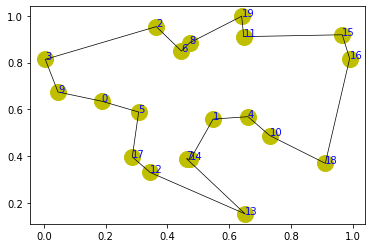

step:4805/5000, actic loss:-0.296, critic loss:0.339, L:4.567, 0min0sec
step:4806/5000, actic loss:-0.296, critic loss:0.339, L:4.567, 0min0sec
step:4807/5000, actic loss:-0.296, critic loss:0.339, L:4.567, 0min0sec
step:4808/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
step:4809/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
distance:4.483
tensor([ 1, 17,  6, 11, 12, 13, 14, 18, 16, 15,  2,  5,  7, 10,  9,  4,  0, 19,
         8,  3])


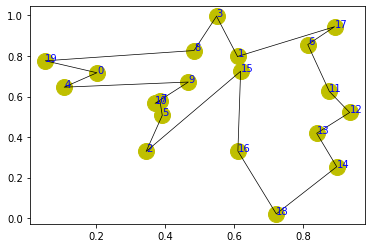

step:4810/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
step:4811/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
step:4812/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
step:4813/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
step:4814/5000, actic loss:-0.296, critic loss:0.338, L:4.567, 0min0sec
distance:4.411
tensor([ 2,  6,  9, 15, 12, 14, 11, 16, 18,  8, 10, 17,  7,  0,  1,  3,  5, 13,
        19,  4])


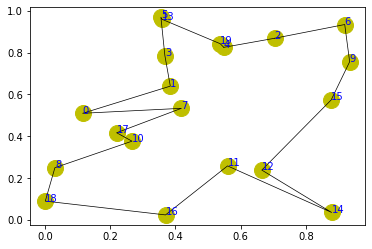

step:4815/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4816/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4817/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4818/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4819/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
distance:3.762
tensor([ 9,  3,  4, 12, 11, 10, 14,  1,  8, 13,  2,  7, 15, 16, 18, 17,  0, 19,
         5,  6])


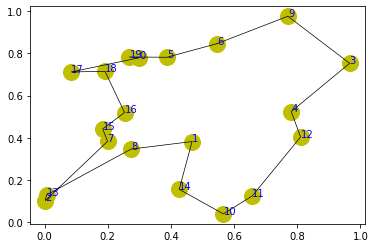

step:4820/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4821/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4822/5000, actic loss:-0.296, critic loss:0.338, L:4.566, 0min0sec
step:4823/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4824/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
distance:3.960
tensor([16, 18, 12,  5,  8,  2,  3, 17, 13, 15, 19,  4,  0,  7,  1, 14,  6,  9,
        10, 11])


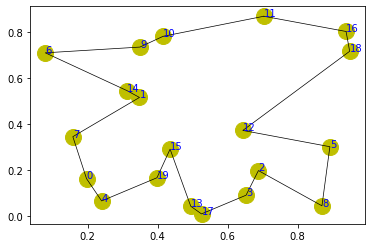

step:4825/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4826/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4827/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4828/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4829/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
distance:3.889
tensor([18,  8, 16,  4,  7, 12, 17, 15,  1,  3,  0,  5, 13, 19,  6, 11,  9, 10,
        14,  2])


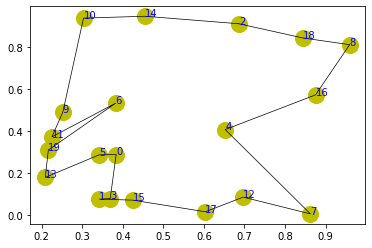

step:4830/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4831/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4832/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4833/5000, actic loss:-0.295, critic loss:0.338, L:4.566, 0min0sec
step:4834/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
distance:4.117
tensor([16,  9,  3,  0, 12,  2, 15, 19, 11, 14,  5,  7, 18, 10,  8,  1,  6, 13,
        17,  4])


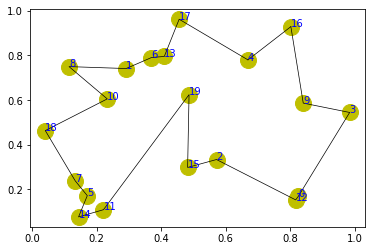

step:4835/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4836/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4837/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4838/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4839/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
distance:4.060
tensor([13,  0, 15,  2,  3, 11,  7, 18, 12, 16,  8, 10, 17,  1,  9,  6,  4,  5,
        19, 14])


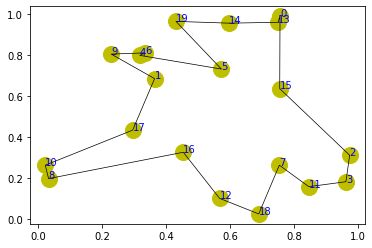

step:4840/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4841/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4842/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4843/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4844/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
distance:4.562
tensor([ 4, 17,  0, 19, 11, 16,  5,  6, 18,  3, 12, 13,  9, 15,  1,  2, 14,  7,
        10,  8])


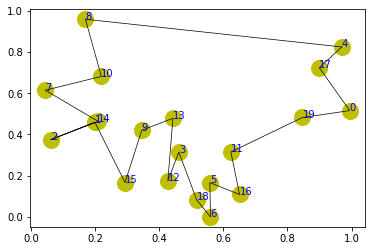

step:4845/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4846/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4847/5000, actic loss:-0.295, critic loss:0.337, L:4.565, 0min0sec
step:4848/5000, actic loss:-0.294, critic loss:0.337, L:4.565, 0min0sec
step:4849/5000, actic loss:-0.294, critic loss:0.337, L:4.565, 0min0sec
distance:3.978
tensor([14,  4, 13,  2,  0,  9, 18, 16, 11,  7,  1,  3, 12,  6, 10,  8, 19, 15,
        17,  5])


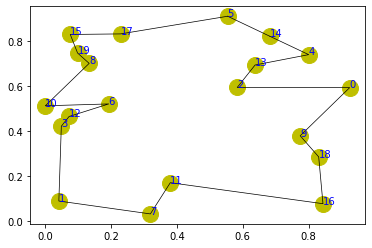

step:4850/5000, actic loss:-0.294, critic loss:0.337, L:4.564, 0min0sec
step:4851/5000, actic loss:-0.294, critic loss:0.337, L:4.564, 0min0sec
step:4852/5000, actic loss:-0.294, critic loss:0.337, L:4.564, 0min0sec
step:4853/5000, actic loss:-0.294, critic loss:0.337, L:4.564, 0min0sec
step:4854/5000, actic loss:-0.294, critic loss:0.337, L:4.564, 0min0sec
distance:4.217
tensor([11,  8,  3,  4, 14,  7,  2,  5, 19, 17, 10,  0,  6, 16,  9, 13,  1, 12,
        18, 15])


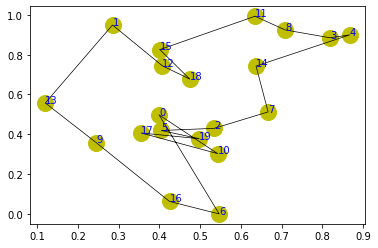

step:4855/5000, actic loss:-0.294, critic loss:0.337, L:4.564, 0min0sec
step:4856/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4857/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4858/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4859/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
distance:3.853
tensor([10,  2,  4, 19, 18,  7,  9, 13, 15,  0,  3,  6,  8,  1, 17, 11, 14, 12,
        16,  5])


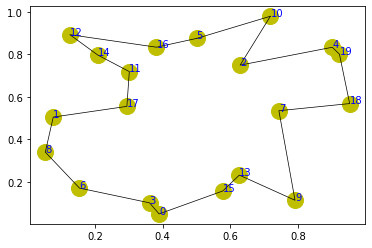

step:4860/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4861/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4862/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4863/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
step:4864/5000, actic loss:-0.294, critic loss:0.336, L:4.564, 0min0sec
distance:4.831
tensor([14, 10,  1, 16,  9,  0, 17,  4, 19,  8, 15, 11,  2, 13, 18, 12,  7,  5,
         6,  3])


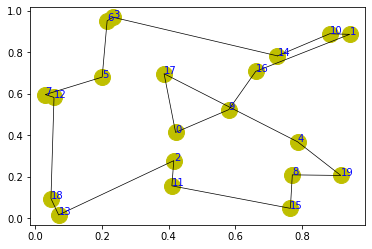

step:4865/5000, actic loss:-0.294, critic loss:0.336, L:4.563, 0min0sec
step:4866/5000, actic loss:-0.294, critic loss:0.336, L:4.563, 0min0sec
step:4867/5000, actic loss:-0.294, critic loss:0.336, L:4.563, 0min0sec
step:4868/5000, actic loss:-0.294, critic loss:0.336, L:4.563, 0min0sec
step:4869/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
distance:3.571
tensor([18,  5, 13,  3,  6,  7,  1, 17, 19, 11, 10, 15,  4, 12,  8,  2, 16, 14,
         9,  0])


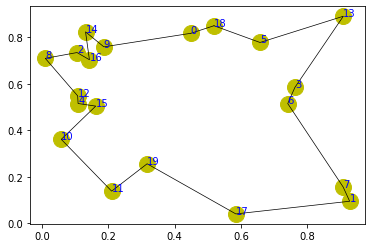

step:4870/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
step:4871/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
step:4872/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
step:4873/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
step:4874/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
distance:5.012
tensor([19,  7,  1,  0,  2, 10, 18,  4, 17,  3, 12,  6,  5,  8, 11, 16, 15, 13,
        14,  9])


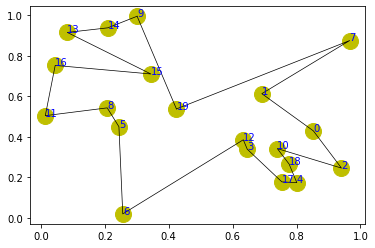

step:4875/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
step:4876/5000, actic loss:-0.293, critic loss:0.336, L:4.563, 0min0sec
step:4877/5000, actic loss:-0.293, critic loss:0.335, L:4.563, 0min0sec
step:4878/5000, actic loss:-0.293, critic loss:0.335, L:4.563, 0min0sec
step:4879/5000, actic loss:-0.293, critic loss:0.335, L:4.563, 0min0sec
distance:3.841
tensor([ 1,  7,  9, 14,  8, 13,  6, 17, 18, 12, 10,  4, 16, 11, 19,  5,  0,  2,
        15,  3])


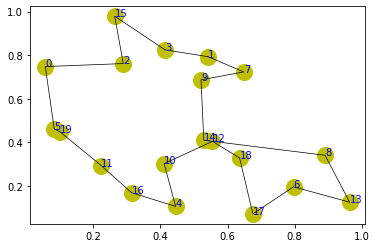

step:4880/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4881/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4882/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4883/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4884/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
distance:4.365
tensor([ 3, 14, 13, 12,  4,  1, 11,  2,  8, 19, 18,  0, 10, 15, 16, 17,  6,  5,
         7,  9])


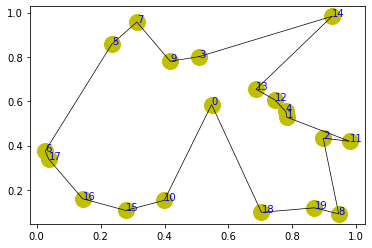

step:4885/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4886/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4887/5000, actic loss:-0.293, critic loss:0.335, L:4.562, 0min0sec
step:4888/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
step:4889/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
distance:3.846
tensor([ 8,  4, 14,  3, 18,  6,  9, 17, 13, 19, 15, 16, 10,  5,  1,  7,  2,  0,
        12, 11])


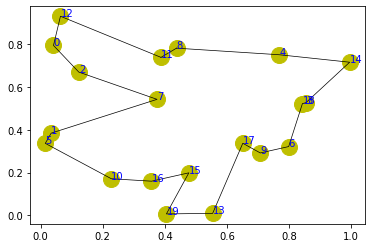

step:4890/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
step:4891/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
step:4892/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
step:4893/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
step:4894/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
distance:4.236
tensor([12, 11, 15,  7,  9, 19,  1, 16, 17, 10,  2,  6,  0,  4, 18,  8,  5,  3,
        13, 14])


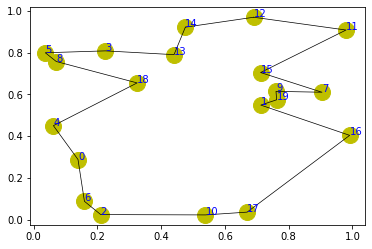

step:4895/5000, actic loss:-0.292, critic loss:0.335, L:4.562, 0min0sec
step:4896/5000, actic loss:-0.292, critic loss:0.335, L:4.561, 0min0sec
step:4897/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4898/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4899/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
distance:3.795
tensor([19,  5,  2, 12,  0, 11, 18, 14,  8, 13,  3, 10,  4,  6,  1,  9, 15, 17,
         7, 16])


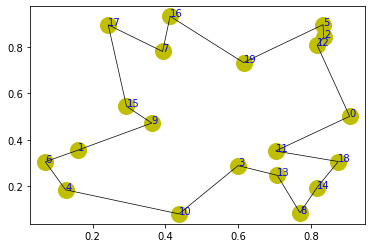

step:4900/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4901/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4902/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4903/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4904/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
distance:3.614
tensor([ 3, 16, 14, 11,  0,  4,  7, 18, 15,  1, 13, 12, 19,  2, 10,  9,  5, 17,
         8,  6])


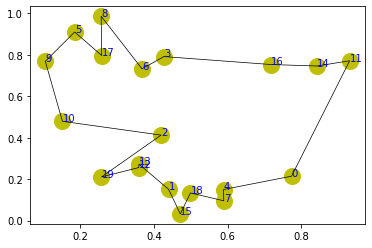

step:4905/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4906/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4907/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4908/5000, actic loss:-0.292, critic loss:0.334, L:4.561, 0min0sec
step:4909/5000, actic loss:-0.292, critic loss:0.334, L:4.560, 0min0sec
distance:5.056
tensor([ 0,  9, 18, 19,  3, 16,  4,  8, 11,  7, 13,  6, 14,  5, 10,  2, 12, 15,
         1, 17])


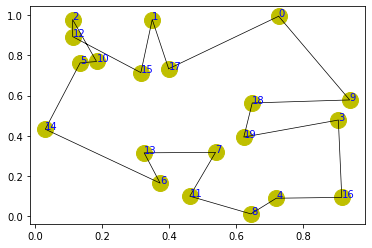

step:4910/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4911/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4912/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4913/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4914/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
distance:4.020
tensor([ 9,  0, 13, 14, 18, 11,  7,  8, 12, 19, 17, 15,  5,  1,  2,  3, 16,  6,
         4, 10])


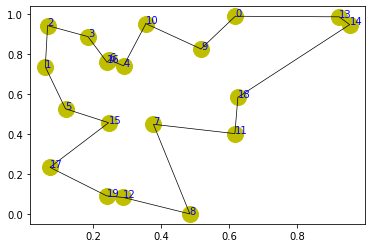

step:4915/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4916/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4917/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4918/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4919/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
distance:3.658
tensor([ 3,  0, 12,  5, 14, 10,  1, 19,  6,  9,  4, 15,  7, 16, 11,  2, 17,  8,
        13, 18])


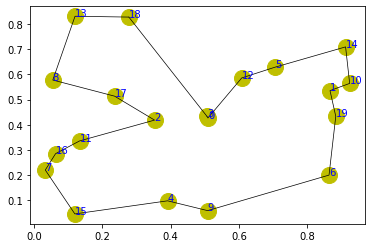

step:4920/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4921/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4922/5000, actic loss:-0.291, critic loss:0.334, L:4.560, 0min0sec
step:4923/5000, actic loss:-0.291, critic loss:0.333, L:4.559, 0min0sec
step:4924/5000, actic loss:-0.291, critic loss:0.333, L:4.559, 0min0sec
distance:3.947
tensor([18, 15,  4,  1, 16,  6, 14, 19, 13, 10,  8,  7,  5,  9, 12,  3, 11,  2,
         0, 17])


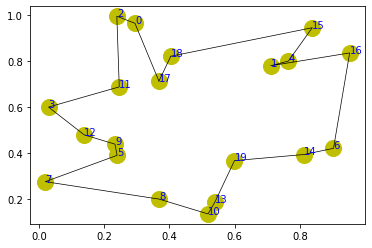

step:4925/5000, actic loss:-0.291, critic loss:0.333, L:4.559, 0min0sec
step:4926/5000, actic loss:-0.291, critic loss:0.333, L:4.559, 0min0sec
step:4927/5000, actic loss:-0.291, critic loss:0.333, L:4.559, 0min0sec
step:4928/5000, actic loss:-0.291, critic loss:0.333, L:4.559, 0min0sec
step:4929/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
distance:4.347
tensor([ 9,  1, 15, 11, 16, 13, 10, 18, 19,  5,  4, 17,  0,  6,  7,  8, 14,  2,
         3, 12])


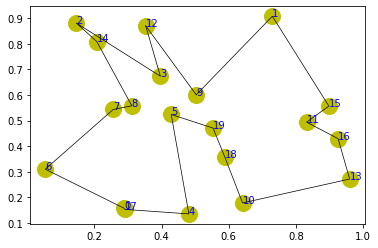

step:4930/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
step:4931/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
step:4932/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
step:4933/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
step:4934/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
distance:3.770
tensor([10, 18,  4, 19, 11, 13,  0,  1,  7, 12, 16,  5, 14,  2, 15,  8,  9,  6,
         3, 17])


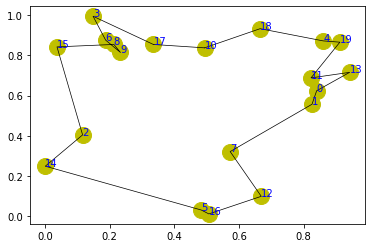

step:4935/5000, actic loss:-0.290, critic loss:0.333, L:4.559, 0min0sec
step:4936/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
step:4937/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
step:4938/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
step:4939/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
distance:4.419
tensor([12, 16,  1, 15,  3,  8,  4, 11, 18,  0,  2, 14, 13,  7, 19,  9, 17,  5,
         6, 10])


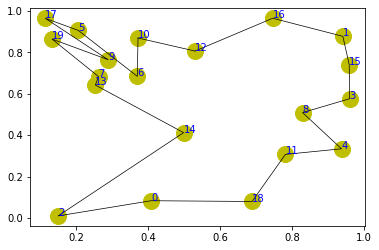

step:4940/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
step:4941/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
step:4942/5000, actic loss:-0.290, critic loss:0.333, L:4.558, 0min0sec
step:4943/5000, actic loss:-0.290, critic loss:0.332, L:4.558, 0min0sec
step:4944/5000, actic loss:-0.290, critic loss:0.332, L:4.558, 0min0sec
distance:4.097
tensor([13,  4, 18, 19,  5,  0, 14,  7,  6, 17, 12, 10,  2, 15,  8,  3,  1, 16,
        11,  9])


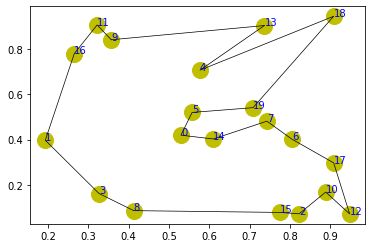

step:4945/5000, actic loss:-0.290, critic loss:0.332, L:4.558, 0min0sec
step:4946/5000, actic loss:-0.290, critic loss:0.332, L:4.558, 0min0sec
step:4947/5000, actic loss:-0.290, critic loss:0.332, L:4.558, 0min0sec
step:4948/5000, actic loss:-0.290, critic loss:0.332, L:4.558, 0min0sec
step:4949/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
distance:3.983
tensor([14,  2,  8, 15, 12, 18,  7,  4, 10,  9,  1, 11, 13, 19, 17, 16,  5,  6,
         3,  0])


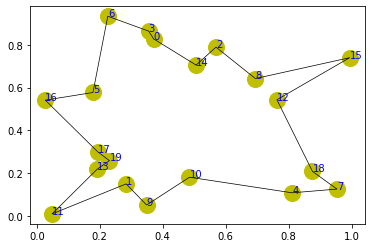

step:4950/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4951/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4952/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4953/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4954/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
distance:4.166
tensor([18,  5, 16, 15,  3,  4,  7,  9, 14, 12,  2, 11, 13,  0,  6, 10,  8, 19,
         1, 17])


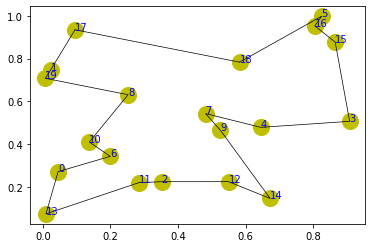

step:4955/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4956/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4957/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4958/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4959/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
distance:4.090
tensor([ 6,  4,  5, 17, 18, 15,  9,  2, 16,  7,  0, 10, 11, 12,  1, 14, 13, 19,
         8,  3])


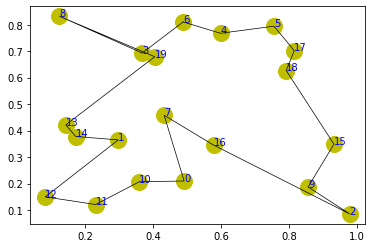

step:4960/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4961/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4962/5000, actic loss:-0.289, critic loss:0.332, L:4.557, 0min0sec
step:4963/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
step:4964/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
distance:4.072
tensor([19,  5, 14,  6, 13,  7, 17,  3, 18,  2, 12,  0,  8, 15,  1, 10, 16,  9,
         4, 11])


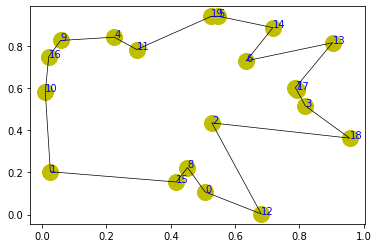

step:4965/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
step:4966/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
step:4967/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
step:4968/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
step:4969/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
distance:3.823
tensor([ 3,  7, 16, 19, 14, 15,  4, 13,  0,  1, 10, 12, 17,  2,  6,  5, 18,  8,
        11,  9])


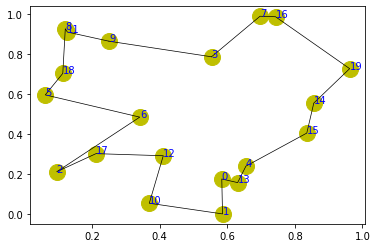

step:4970/5000, actic loss:-0.289, critic loss:0.331, L:4.556, 0min0sec
step:4971/5000, actic loss:-0.288, critic loss:0.331, L:4.556, 0min0sec
step:4972/5000, actic loss:-0.288, critic loss:0.331, L:4.556, 0min0sec
step:4973/5000, actic loss:-0.288, critic loss:0.331, L:4.556, 0min0sec
step:4974/5000, actic loss:-0.288, critic loss:0.331, L:4.556, 0min0sec
distance:3.617
tensor([19,  6,  4,  3,  1, 11, 18,  7,  5, 15,  9, 12, 14,  0, 16,  2, 13,  8,
        17, 10])


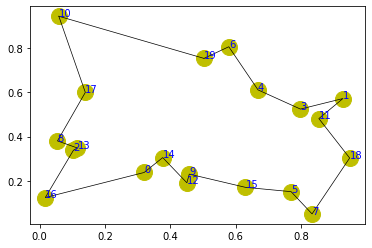

step:4975/5000, actic loss:-0.288, critic loss:0.331, L:4.556, 0min0sec
step:4976/5000, actic loss:-0.288, critic loss:0.331, L:4.556, 0min0sec
step:4977/5000, actic loss:-0.288, critic loss:0.331, L:4.555, 0min0sec
step:4978/5000, actic loss:-0.288, critic loss:0.331, L:4.555, 0min0sec
step:4979/5000, actic loss:-0.288, critic loss:0.331, L:4.555, 0min0sec
distance:4.878
tensor([ 2, 16, 17, 11, 12,  8, 10,  5,  3,  0,  1,  9, 18,  4, 15, 14, 19, 13,
         7,  6])


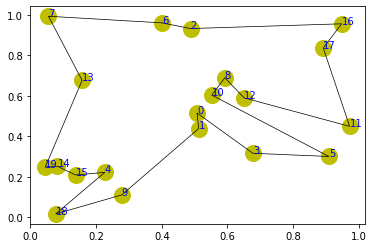

step:4980/5000, actic loss:-0.288, critic loss:0.331, L:4.555, 0min0sec
step:4981/5000, actic loss:-0.288, critic loss:0.331, L:4.555, 0min0sec
step:4982/5000, actic loss:-0.288, critic loss:0.331, L:4.555, 0min0sec
step:4983/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
step:4984/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
distance:3.576
tensor([ 1, 19, 11,  2, 17,  0,  3,  9, 10, 18, 14,  6,  8,  4,  5, 15,  7, 16,
        13, 12])


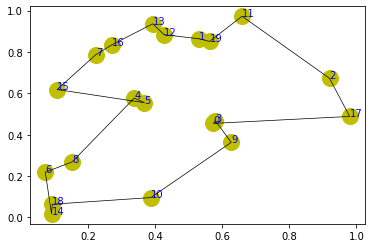

step:4985/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
step:4986/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
step:4987/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
step:4988/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
step:4989/5000, actic loss:-0.288, critic loss:0.330, L:4.555, 0min0sec
distance:4.441
tensor([ 2, 10,  1, 14,  8, 19, 12, 11, 13,  5, 15, 17,  6,  0,  7,  4, 18,  9,
         3, 16])


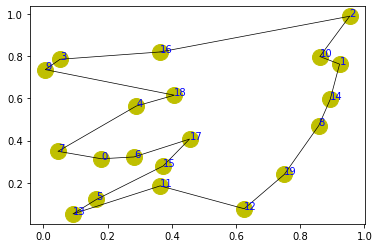

step:4990/5000, actic loss:-0.288, critic loss:0.330, L:4.554, 0min0sec
step:4991/5000, actic loss:-0.288, critic loss:0.330, L:4.554, 0min0sec
step:4992/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
step:4993/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
step:4994/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
distance:3.987
tensor([17, 14, 10,  0, 13, 18, 15,  4, 16, 11,  3,  9,  2,  6, 19,  1,  8,  7,
        12,  5])


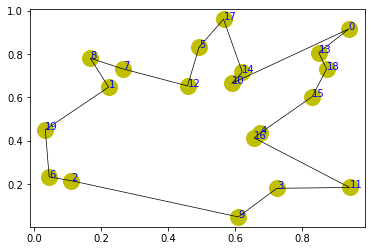

step:4995/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
step:4996/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
step:4997/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
step:4998/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
step:4999/5000, actic loss:-0.287, critic loss:0.330, L:4.554, 0min0sec
save model...


In [8]:
train_model(cfg, env)